This is pbaylies' StyleGAN Encoder and tutorial, ported to StyleGAN 2.
  
 * Note: make sure you're using the GPU runtime for this - see Runtime -> Change Runtime Type in Google Colab

In [1]:
!pip3 install --force tqdm==4.24.0
!pip3 install pillow
!pip3 install keras==2.2.4
!pip3 install dlib
!pip3 install requests
# !pip3 install opencv-python
!nvidia-smi

  Using cached https://files.pythonhosted.org/packages/7d/e6/19dfaff08fcbee7f3453e5b537e65a8364f1945f921a36d08be1e2ff3475/tqdm-4.24.0-py2.py3-none-any.whl
  Found existing installation: tqdm 4.24.0
    Uninstalling tqdm-4.24.0:
      Successfully uninstalled tqdm-4.24.0
You should consider upgrading via the 'pip install --upgrade pip' command.
You should consider upgrading via the 'pip install --upgrade pip' command.
You should consider upgrading via the 'pip install --upgrade pip' command.
You should consider upgrading via the 'pip install --upgrade pip' command.
You should consider upgrading via the 'pip install --upgrade pip' command.
Thu Sep  3 15:10:03 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 450.36.06    Driver Version: 450.36.06    CUDA Version: 11.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| 

In [2]:
import tensorflow as tf
tf.__version__

/usr/local/lib/python3.6/dist-packages/tensorflow/python/framework/dtypes.py:516: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/usr/local/lib/python3.6/dist-packages/tensorflow/python/framework/dtypes.py:517: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/usr/local/lib/python3.6/dist-packages/tensorflow/python/framework/dtypes.py:518: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/usr/local/lib/python3.6/dist-packages/tensorflow/python/framework/dtypes.py:519: FutureWarning: Passing (type, 1) or 

'1.14.0'

In [3]:
#!python train_resnet.py --help
#!python train_resnet.py --test_size 256 --batch_size 1024 --loop 1 --max_patience 1

In [4]:
# !mkdir aligned_images raw_images
# !wget -O raw_images/maman.png 'https://github.com/Amirhosein2c/amirhosein2c.github.io/raw/master/assets/img/maman.png'
# !wget -O raw_images/baba.png 'https://github.com/Amirhosein2c/amirhosein2c.github.io/raw/master/assets/img/baba.png'

['photo_2020-09-02_20-45-59.jpg', 'photo_2020-09-02_20-46-03.jpg', 'photo_2020-09-02_20-46-06.jpg', 'photo_2020-09-02_20-46-09.jpg', 'photo_2020-09-02_20-46-12.jpg', 'photo_2020-09-02_20-46-15.jpg', 'photo_2020-09-02_20-46-18.jpg', 'photo_2020-09-02_20-46-21.jpg', 'photo_2020-09-02_20-46-24.jpg', 'photo_2020-09-02_20-46-27.jpg', 'photo_2020-09-02_20-47-07.jpg', 'photo_2020-09-03_17-06-32.jpg', 'photo_2020-09-03_17-06-41.jpg', 'photo_2020-09-03_17-06-38.jpg', 'photo_2020-09-03_17-06-47.jpg', 'photo_2020-09-03_17-06-44.jpg', 'photo_2020-09-03_17-06-51.jpg']


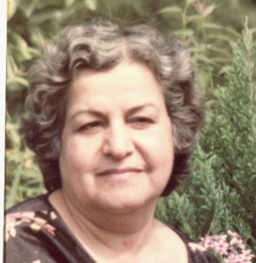

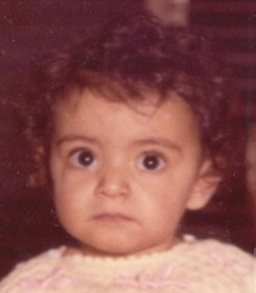

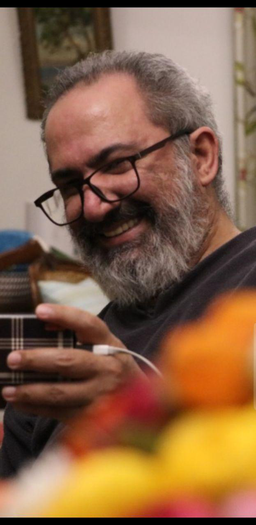

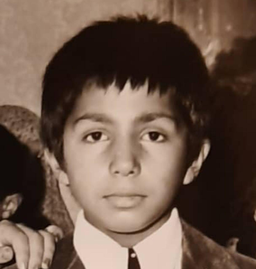

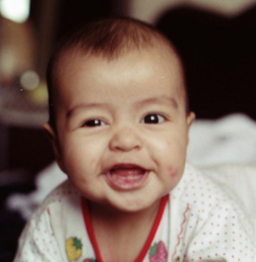

...

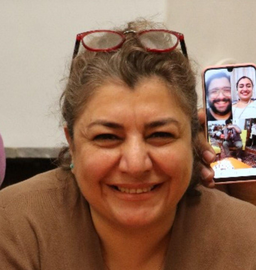

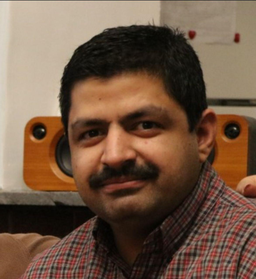

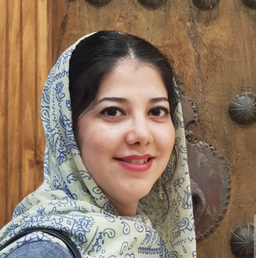

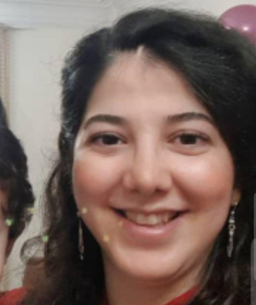

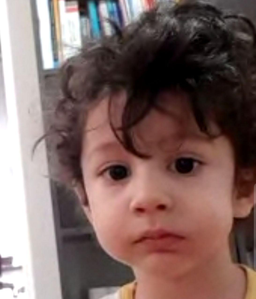

In [5]:
import PIL.Image
# img1 = PIL.Image.open('raw_images/maman.png')
# wpercent = (256/float(img1.size[0]))
# hsize = int((float(img1.size[1])*float(wpercent)))
# img1 = img1.resize((256,hsize), PIL.Image.LANCZOS)
# img2 = PIL.Image.open('raw_images/baba.png')
# wpercent = (256/float(img2.size[0]))
# hsize = int((float(img2.size[1])*float(wpercent)))
# img2 = img2.resize((256,hsize), PIL.Image.LANCZOS)
# display(img1,img2)

from os import listdir
from os.path import isfile, join
from PIL import ImageOps
from PIL import Image
imagesPath = './raw_images'
onlyfiles = [f for f in listdir(imagesPath) if isfile(join(imagesPath, f))]
print(onlyfiles)
for imagefile in onlyfiles:
    img = Image.open(join(imagesPath, imagefile))
    wpercent = (256/float(img.size[0]))
    hsize = int((float(img.size[1])*float(wpercent)))
    img = img.resize((256,hsize), PIL.Image.LANCZOS)
    display(img)

Now we need to get just the faces, cropped and aligned... fortunately, there's already a script for this!

In [6]:
!python3 align_images.py raw_images/ aligned_images/

Using TensorFlow backend.
/usr/local/lib/python3.6/dist-packages/tensorflow/python/framework/dtypes.py:516: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/usr/local/lib/python3.6/dist-packages/tensorflow/python/framework/dtypes.py:517: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/usr/local/lib/python3.6/dist-packages/tensorflow/python/framework/dtypes.py:518: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/usr/local/lib/python3.6/dist-packages/tensorflow/python/framework/dtypes.py:519: FutureWarn

['photo_2020-09-02_20-45-59_01.png', 'photo_2020-09-02_20-46-03_01.png', 'photo_2020-09-02_20-46-09_01.png', 'photo_2020-09-02_20-46-12_01.png', 'photo_2020-09-02_20-46-15_01.png', 'photo_2020-09-02_20-46-18_01.png', 'photo_2020-09-02_20-46-21_01.png', 'photo_2020-09-02_20-46-24_01.png', 'photo_2020-09-02_20-46-27_01.png', 'photo_2020-09-02_20-47-07_01.png', 'photo_2020-09-03_17-06-32_01.png', 'photo_2020-09-03_17-06-41_01.png', 'photo_2020-09-03_17-06-41_02.png', 'photo_2020-09-03_17-06-41_03.png', 'photo_2020-09-03_17-06-38_01.png', 'photo_2020-09-03_17-06-47_01.png', 'photo_2020-09-03_17-06-44_01.png', 'photo_2020-09-03_17-06-51_01.png']


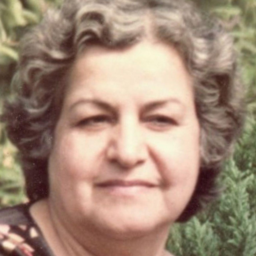

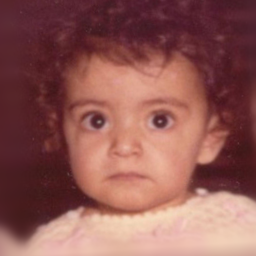

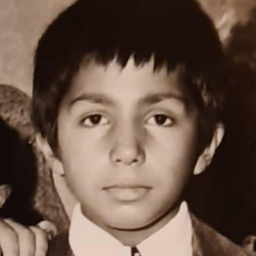

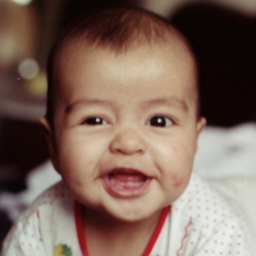

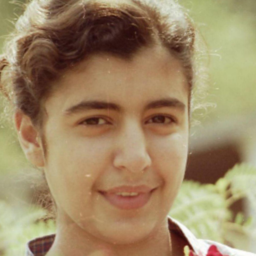

...

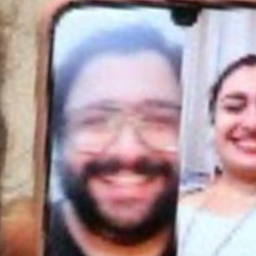

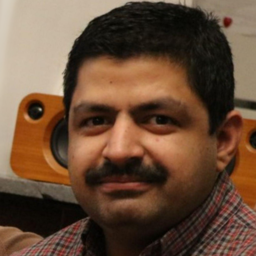

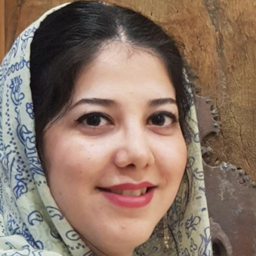

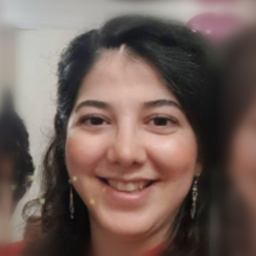

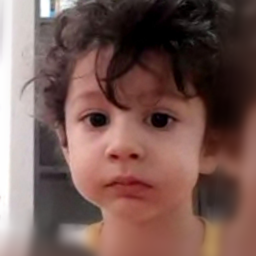

In [7]:
from os import listdir
from os.path import isfile, join
from PIL import ImageOps
from PIL import Image
imagesPath = './aligned_images'
onlyfiles = [f for f in listdir(imagesPath) if isfile(join(imagesPath, f))]
print(onlyfiles)
for imagefile in onlyfiles:
    img = Image.open(join(imagesPath, imagefile))
    img = img.resize((1024, 1024))
    img.save(join(imagesPath, imagefile), format="PNG", quality=100)
    display(img.resize((256,256)))

In [8]:
# display(PIL.Image.open('aligned_images/maman_01.png').resize((256,256)))
# display(PIL.Image.open('aligned_images/baba_01.png').resize((256,256)))

In [12]:
# !python3 encode_images.py aligned_images/ generated_images/ latent_representations/ \
#     --model_url ./networks/trypophobia.pkl \
#     --vgg_url=https://rolux.org/media/stylegan/vgg16_zhang_perceptual.pkl \
#     --lr=0.5 --iterations=3000 --use_l1_penalty=0.5 # \
# #     --output_video TRUE --video_frame_rate 60

# !python3 encode_images.py aligned_images/ generated_images/ latent_representations/ \
#     --model_url ./networks/trypophobia.pkl \
#     --vgg_url=https://rolux.org/media/stylegan/vgg16_zhang_perceptual.pkl \
#     --lr=0.75 --iterations=5000 --use_l1_penalty=0.75 # \
#     --output_video TRUE --video_frame_rate 60

!python3 encode_images.py aligned_images/ generated_images/ latent_representations/ \
    --model_url=http://d36zk2xti64re0.cloudfront.net/stylegan2/networks/stylegan2-ffhq-config-f.pkl \
    --vgg_url=https://rolux.org/media/stylegan/vgg16_zhang_perceptual.pkl \
    --lr=0.75 --iterations=3000 --use_l1_penalty=0.5 # \
#     --output_video TRUE --video_frame_rate 60

/usr/local/lib/python3.6/dist-packages/tensorflow/python/framework/dtypes.py:516: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/usr/local/lib/python3.6/dist-packages/tensorflow/python/framework/dtypes.py:517: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/usr/local/lib/python3.6/dist-packages/tensorflow/python/framework/dtypes.py:518: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/usr/local/lib/python3.6/dist-packages/tensorflow/python/framework/dtypes.py:519: FutureWarning: Passing (type, 1) or 

photo_2020-09-02_20-45-59_01: loss 212.5938; lr 0.7500:   0%| | 15/3000 [00:17<56:46,  1.14s/it]  
photo_2020-09-02_20-45-59_01: loss 200.1021; lr 0.7500:   0%| | 15/3000 [00:17<58:10,  1.17s/it]
photo_2020-09-02_20-45-59_01: loss 200.1021; lr 0.7500:   1%| | 16/3000 [00:17<54:31,  1.10s/it]
photo_2020-09-02_20-45-59_01: loss 194.0134; lr 0.7500:   1%| | 16/3000 [00:17<55:50,  1.12s/it]
photo_2020-09-02_20-45-59_01: loss 194.0134; lr 0.7500:   1%| | 17/3000 [00:17<52:32,  1.06s/it]
photo_2020-09-02_20-45-59_01: loss 193.4214; lr 0.7500:   1%| | 17/3000 [00:18<53:46,  1.08s/it]
photo_2020-09-02_20-45-59_01: loss 193.4214; lr 0.7500:   1%| | 18/3000 [00:18<50:46,  1.02s/it]
photo_2020-09-02_20-45-59_01: loss 187.7541; lr 0.7500:   1%| | 18/3000 [00:18<51:55,  1.04s/it]
photo_2020-09-02_20-45-59_01: loss 187.7541; lr 0.7500:   1%| | 19/3000 [00:18<49:10,  1.01it/s]
photo_2020-09-02_20-45-59_01: loss 191.8856; lr 0.7500:   1%| | 19/3000 [00:19<50:16,  1.01s/it]
photo_2020-09-02_20-45-59_01

photo_2020-09-02_20-45-59_01: loss 170.1869; lr 0.7500:   2%| | 56/3000 [00:34<30:11,  1.63it/s]
photo_2020-09-02_20-45-59_01: loss 175.0464; lr 0.7500:   2%| | 56/3000 [00:34<30:33,  1.61it/s]
photo_2020-09-02_20-45-59_01: loss 175.0464; lr 0.7500:   2%| | 57/3000 [00:34<30:00,  1.63it/s]
photo_2020-09-02_20-45-59_01: loss 167.9358; lr 0.7500:   2%| | 57/3000 [00:35<30:22,  1.61it/s]
photo_2020-09-02_20-45-59_01: loss 167.9358; lr 0.7500:   2%| | 58/3000 [00:35<29:50,  1.64it/s]
photo_2020-09-02_20-45-59_01: loss 169.8428; lr 0.7500:   2%| | 58/3000 [00:35<30:11,  1.62it/s]
photo_2020-09-02_20-45-59_01: loss 169.8428; lr 0.7500:   2%| | 59/3000 [00:35<29:40,  1.65it/s]
photo_2020-09-02_20-45-59_01: loss 168.0613; lr 0.7500:   2%| | 59/3000 [00:36<30:01,  1.63it/s]
photo_2020-09-02_20-45-59_01: loss 168.0613; lr 0.7500:   2%| | 60/3000 [00:36<29:31,  1.66it/s]
photo_2020-09-02_20-45-59_01: loss 162.5492; lr 0.7500:   2%| | 60/3000 [00:36<29:51,  1.64it/s]
photo_2020-09-02_20-45-59_01: 

photo_2020-09-02_20-45-59_01: loss 164.1495; lr 0.7500:   3%| | 97/3000 [00:51<25:50,  1.87it/s]
photo_2020-09-02_20-45-59_01: loss 163.1792; lr 0.7500:   3%| | 97/3000 [00:52<26:03,  1.86it/s]
photo_2020-09-02_20-45-59_01: loss 163.1792; lr 0.7500:   3%| | 98/3000 [00:52<25:47,  1.88it/s]
photo_2020-09-02_20-45-59_01: loss 159.1225; lr 0.7500:   3%| | 98/3000 [00:52<25:59,  1.86it/s]
photo_2020-09-02_20-45-59_01: loss 159.1225; lr 0.7500:   3%| | 99/3000 [00:52<25:43,  1.88it/s]
photo_2020-09-02_20-45-59_01: loss 165.2780; lr 0.7500:   3%| | 99/3000 [00:53<25:55,  1.87it/s]
photo_2020-09-02_20-45-59_01: loss 165.2780; lr 0.7500:   3%| | 100/3000 [00:53<25:39,  1.88it/s]
photo_2020-09-02_20-45-59_01: loss 160.7227; lr 0.7500:   3%| | 100/3000 [00:53<25:51,  1.87it/s]
photo_2020-09-02_20-45-59_01: loss 160.7227; lr 0.7500:   3%| | 101/3000 [00:53<25:35,  1.89it/s]
photo_2020-09-02_20-45-59_01: loss 162.0512; lr 0.7500:   3%| | 101/3000 [00:53<25:47,  1.87it/s]
photo_2020-09-02_20-45-59_

photo_2020-09-02_20-45-59_01: loss 154.7880; lr 0.6750:   5%| | 138/3000 [01:09<23:53,  2.00it/s]
photo_2020-09-02_20-45-59_01: loss 155.1908; lr 0.6750:   5%| | 138/3000 [01:09<24:01,  1.99it/s]
photo_2020-09-02_20-45-59_01: loss 155.1908; lr 0.6750:   5%| | 139/3000 [01:09<23:50,  2.00it/s]
photo_2020-09-02_20-45-59_01: loss 158.5003; lr 0.6750:   5%| | 139/3000 [01:09<23:59,  1.99it/s]
photo_2020-09-02_20-45-59_01: loss 158.5003; lr 0.6750:   5%| | 140/3000 [01:09<23:48,  2.00it/s]
photo_2020-09-02_20-45-59_01: loss 151.4809; lr 0.6750:   5%| | 140/3000 [01:10<23:57,  1.99it/s]
photo_2020-09-02_20-45-59_01: loss 151.4809; lr 0.6750:   5%| | 141/3000 [01:10<23:46,  2.00it/s]
photo_2020-09-02_20-45-59_01: loss 153.8268; lr 0.6750:   5%| | 141/3000 [01:10<23:55,  1.99it/s]
photo_2020-09-02_20-45-59_01: loss 153.8268; lr 0.6750:   5%| | 142/3000 [01:10<23:44,  2.01it/s]
photo_2020-09-02_20-45-59_01: loss 154.2799; lr 0.6750:   5%| | 142/3000 [01:11<23:52,  1.99it/s]
photo_2020-09-02_20-

photo_2020-09-02_20-45-59_01: loss 164.6435; lr 0.6750:   6%| | 179/3000 [01:26<22:41,  2.07it/s]
photo_2020-09-02_20-45-59_01: loss 152.3932; lr 0.6750:   6%| | 179/3000 [01:26<22:48,  2.06it/s]
photo_2020-09-02_20-45-59_01: loss 152.3932; lr 0.6750:   6%| | 180/3000 [01:26<22:40,  2.07it/s]
photo_2020-09-02_20-45-59_01: loss 155.1075; lr 0.6750:   6%| | 180/3000 [01:27<22:46,  2.06it/s]
photo_2020-09-02_20-45-59_01: loss 155.1075; lr 0.6750:   6%| | 181/3000 [01:27<22:38,  2.07it/s]
photo_2020-09-02_20-45-59_01: loss 148.0572; lr 0.6750:   6%| | 181/3000 [01:27<22:45,  2.06it/s]
photo_2020-09-02_20-45-59_01: loss 148.0572; lr 0.6750:   6%| | 182/3000 [01:27<22:37,  2.08it/s]
photo_2020-09-02_20-45-59_01: loss 162.0126; lr 0.6750:   6%| | 182/3000 [01:28<22:43,  2.07it/s]
photo_2020-09-02_20-45-59_01: loss 162.0126; lr 0.6750:   6%| | 183/3000 [01:28<22:35,  2.08it/s]
photo_2020-09-02_20-45-59_01: loss 152.3305; lr 0.6750:   6%| | 183/3000 [01:28<22:42,  2.07it/s]
photo_2020-09-02_20-

photo_2020-09-02_20-45-59_01: loss 152.8937; lr 0.6750:   7%| | 220/3000 [01:43<21:51,  2.12it/s]
photo_2020-09-02_20-45-59_01: loss 158.5222; lr 0.6750:   7%| | 220/3000 [01:44<21:56,  2.11it/s]
photo_2020-09-02_20-45-59_01: loss 158.5222; lr 0.6750:   7%| | 221/3000 [01:44<21:50,  2.12it/s]
photo_2020-09-02_20-45-59_01: loss 157.8895; lr 0.6750:   7%| | 221/3000 [01:44<21:55,  2.11it/s]
photo_2020-09-02_20-45-59_01: loss 157.8895; lr 0.6750:   7%| | 222/3000 [01:44<21:49,  2.12it/s]
photo_2020-09-02_20-45-59_01: loss 152.5090; lr 0.6750:   7%| | 222/3000 [01:45<21:54,  2.11it/s]
photo_2020-09-02_20-45-59_01: loss 152.5090; lr 0.6750:   7%| | 223/3000 [01:45<21:48,  2.12it/s]
photo_2020-09-02_20-45-59_01: loss 149.1285; lr 0.6750:   7%| | 223/3000 [01:45<21:53,  2.11it/s]
photo_2020-09-02_20-45-59_01: loss 149.1285; lr 0.6750:   7%| | 224/3000 [01:45<21:47,  2.12it/s]
photo_2020-09-02_20-45-59_01: loss 147.0133; lr 0.6750:   7%| | 224/3000 [01:45<21:52,  2.11it/s]
photo_2020-09-02_20-

photo_2020-09-02_20-45-59_01: loss 151.3915; lr 0.6075:   9%| | 261/3000 [02:01<21:11,  2.15it/s]
photo_2020-09-02_20-45-59_01: loss 153.3639; lr 0.6075:   9%| | 261/3000 [02:01<21:15,  2.15it/s]
photo_2020-09-02_20-45-59_01: loss 153.3639; lr 0.6075:   9%| | 262/3000 [02:01<21:10,  2.16it/s]
photo_2020-09-02_20-45-59_01: loss 151.4382; lr 0.6075:   9%| | 262/3000 [02:01<21:14,  2.15it/s]
photo_2020-09-02_20-45-59_01: loss 151.4382; lr 0.6075:   9%| | 263/3000 [02:01<21:09,  2.16it/s]
photo_2020-09-02_20-45-59_01: loss 149.4571; lr 0.6075:   9%| | 263/3000 [02:02<21:13,  2.15it/s]
photo_2020-09-02_20-45-59_01: loss 149.4571; lr 0.6075:   9%| | 264/3000 [02:02<21:08,  2.16it/s]
photo_2020-09-02_20-45-59_01: loss 147.7280; lr 0.6075:   9%| | 264/3000 [02:02<21:12,  2.15it/s]
photo_2020-09-02_20-45-59_01: loss 147.7280; lr 0.6075:   9%| | 265/3000 [02:02<21:07,  2.16it/s]
photo_2020-09-02_20-45-59_01: loss 148.9579; lr 0.6075:   9%| | 265/3000 [02:03<21:11,  2.15it/s]
photo_2020-09-02_20-

photo_2020-09-02_20-45-59_01: loss 144.9087; lr 0.6075:  10%| | 302/3000 [02:18<20:36,  2.18it/s]
photo_2020-09-02_20-45-59_01: loss 143.1352; lr 0.6075:  10%| | 302/3000 [02:18<20:40,  2.17it/s]
photo_2020-09-02_20-45-59_01: loss 143.1352; lr 0.6075:  10%| | 303/3000 [02:18<20:36,  2.18it/s]
photo_2020-09-02_20-45-59_01: loss 148.3475; lr 0.6075:  10%| | 303/3000 [02:19<20:39,  2.18it/s]
photo_2020-09-02_20-45-59_01: loss 148.3475; lr 0.6075:  10%| | 304/3000 [02:19<20:35,  2.18it/s]
photo_2020-09-02_20-45-59_01: loss 147.9750; lr 0.6075:  10%| | 304/3000 [02:19<20:39,  2.18it/s]
photo_2020-09-02_20-45-59_01: loss 147.9750; lr 0.6075:  10%| | 305/3000 [02:19<20:34,  2.18it/s]
photo_2020-09-02_20-45-59_01: loss 147.1415; lr 0.6075:  10%| | 305/3000 [02:20<20:38,  2.18it/s]
photo_2020-09-02_20-45-59_01: loss 147.1415; lr 0.6075:  10%| | 306/3000 [02:20<20:33,  2.18it/s]
photo_2020-09-02_20-45-59_01: loss 150.2520; lr 0.6075:  10%| | 306/3000 [02:20<20:37,  2.18it/s]
photo_2020-09-02_20-

photo_2020-09-02_20-45-59_01: loss 145.3985; lr 0.6075:  11%| | 343/3000 [02:35<20:07,  2.20it/s]
photo_2020-09-02_20-45-59_01: loss 148.3429; lr 0.6075:  11%| | 343/3000 [02:36<20:10,  2.20it/s]
photo_2020-09-02_20-45-59_01: loss 148.3429; lr 0.6075:  11%| | 344/3000 [02:36<20:06,  2.20it/s]
photo_2020-09-02_20-45-59_01: loss 146.0016; lr 0.6075:  11%| | 344/3000 [02:36<20:09,  2.20it/s]
photo_2020-09-02_20-45-59_01: loss 146.0016; lr 0.6075:  12%| | 345/3000 [02:36<20:05,  2.20it/s]
photo_2020-09-02_20-45-59_01: loss 146.6842; lr 0.6075:  12%| | 345/3000 [02:37<20:08,  2.20it/s]
photo_2020-09-02_20-45-59_01: loss 146.6842; lr 0.6075:  12%| | 346/3000 [02:37<20:04,  2.20it/s]
photo_2020-09-02_20-45-59_01: loss 153.6387; lr 0.6075:  12%| | 346/3000 [02:37<20:08,  2.20it/s]
photo_2020-09-02_20-45-59_01: loss 153.6387; lr 0.6075:  12%| | 347/3000 [02:37<20:04,  2.20it/s]
photo_2020-09-02_20-45-59_01: loss 156.0854; lr 0.6075:  12%| | 347/3000 [02:37<20:07,  2.20it/s]
photo_2020-09-02_20-

photo_2020-09-02_20-45-59_01: loss 146.6484; lr 0.5467:  13%|▏| 384/3000 [02:53<19:39,  2.22it/s]
photo_2020-09-02_20-45-59_01: loss 143.7945; lr 0.5467:  13%|▏| 384/3000 [02:53<19:42,  2.21it/s]
photo_2020-09-02_20-45-59_01: loss 143.7945; lr 0.5467:  13%|▏| 385/3000 [02:53<19:39,  2.22it/s]
photo_2020-09-02_20-45-59_01: loss 145.8828; lr 0.5467:  13%|▏| 385/3000 [02:54<19:41,  2.21it/s]
photo_2020-09-02_20-45-59_01: loss 145.8828; lr 0.5467:  13%|▏| 386/3000 [02:54<19:38,  2.22it/s]
photo_2020-09-02_20-45-59_01: loss 140.6724; lr 0.5467:  13%|▏| 386/3000 [02:54<19:41,  2.21it/s]
photo_2020-09-02_20-45-59_01: loss 140.6724; lr 0.5467:  13%|▏| 387/3000 [02:54<19:37,  2.22it/s]
photo_2020-09-02_20-45-59_01: loss 141.3818; lr 0.5467:  13%|▏| 387/3000 [02:54<19:40,  2.21it/s]
photo_2020-09-02_20-45-59_01: loss 141.3818; lr 0.5467:  13%|▏| 388/3000 [02:54<19:37,  2.22it/s]
photo_2020-09-02_20-45-59_01: loss 138.3404; lr 0.5467:  13%|▏| 388/3000 [02:55<19:39,  2.21it/s]
photo_2020-09-02_20-

photo_2020-09-02_20-45-59_01: loss 139.1691; lr 0.5467:  14%|▏| 425/3000 [03:10<19:14,  2.23it/s]
photo_2020-09-02_20-45-59_01: loss 151.4379; lr 0.5467:  14%|▏| 425/3000 [03:10<19:16,  2.23it/s]
photo_2020-09-02_20-45-59_01: loss 151.4379; lr 0.5467:  14%|▏| 426/3000 [03:10<19:13,  2.23it/s]
photo_2020-09-02_20-45-59_01: loss 146.7648; lr 0.5467:  14%|▏| 426/3000 [03:11<19:16,  2.23it/s]
photo_2020-09-02_20-45-59_01: loss 146.7648; lr 0.5467:  14%|▏| 427/3000 [03:11<19:12,  2.23it/s]
photo_2020-09-02_20-45-59_01: loss 139.2301; lr 0.5467:  14%|▏| 427/3000 [03:11<19:15,  2.23it/s]
photo_2020-09-02_20-45-59_01: loss 139.2301; lr 0.5467:  14%|▏| 428/3000 [03:11<19:12,  2.23it/s]
photo_2020-09-02_20-45-59_01: loss 144.3552; lr 0.5467:  14%|▏| 428/3000 [03:12<19:14,  2.23it/s]
photo_2020-09-02_20-45-59_01: loss 144.3552; lr 0.5467:  14%|▏| 429/3000 [03:12<19:11,  2.23it/s]
photo_2020-09-02_20-45-59_01: loss 147.7733; lr 0.5467:  14%|▏| 429/3000 [03:12<19:14,  2.23it/s]
photo_2020-09-02_20-

photo_2020-09-02_20-45-59_01: loss 146.8582; lr 0.5467:  16%|▏| 466/3000 [03:27<18:50,  2.24it/s]
photo_2020-09-02_20-45-59_01: loss 136.9133; lr 0.5467:  16%|▏| 466/3000 [03:28<18:52,  2.24it/s]
photo_2020-09-02_20-45-59_01: loss 136.9133; lr 0.5467:  16%|▏| 467/3000 [03:28<18:49,  2.24it/s]
photo_2020-09-02_20-45-59_01: loss 147.7393; lr 0.5467:  16%|▏| 467/3000 [03:28<18:51,  2.24it/s]
photo_2020-09-02_20-45-59_01: loss 147.7393; lr 0.5467:  16%|▏| 468/3000 [03:28<18:49,  2.24it/s]
photo_2020-09-02_20-45-59_01: loss 143.3724; lr 0.5467:  16%|▏| 468/3000 [03:29<18:51,  2.24it/s]
photo_2020-09-02_20-45-59_01: loss 143.3724; lr 0.5467:  16%|▏| 469/3000 [03:29<18:48,  2.24it/s]
photo_2020-09-02_20-45-59_01: loss 143.4719; lr 0.5467:  16%|▏| 469/3000 [03:29<18:50,  2.24it/s]
photo_2020-09-02_20-45-59_01: loss 143.4719; lr 0.5467:  16%|▏| 470/3000 [03:29<18:47,  2.24it/s]
photo_2020-09-02_20-45-59_01: loss 153.2567; lr 0.5467:  16%|▏| 470/3000 [03:29<18:50,  2.24it/s]
photo_2020-09-02_20-

photo_2020-09-02_20-45-59_01: loss 136.3320; lr 0.4921:  17%|▏| 507/3000 [03:45<18:27,  2.25it/s]
photo_2020-09-02_20-45-59_01: loss 136.7195; lr 0.4921:  17%|▏| 507/3000 [03:45<18:29,  2.25it/s]
photo_2020-09-02_20-45-59_01: loss 136.7195; lr 0.4921:  17%|▏| 508/3000 [03:45<18:26,  2.25it/s]
photo_2020-09-02_20-45-59_01: loss 133.8114; lr 0.4921:  17%|▏| 508/3000 [03:46<18:28,  2.25it/s]
photo_2020-09-02_20-45-59_01: loss 133.8114; lr 0.4921:  17%|▏| 509/3000 [03:46<18:26,  2.25it/s]
photo_2020-09-02_20-45-59_01: loss 137.3815; lr 0.4921:  17%|▏| 509/3000 [03:46<18:28,  2.25it/s]
photo_2020-09-02_20-45-59_01: loss 137.3815; lr 0.4921:  17%|▏| 510/3000 [03:46<18:25,  2.25it/s]
photo_2020-09-02_20-45-59_01: loss 143.8771; lr 0.4921:  17%|▏| 510/3000 [03:46<18:27,  2.25it/s]
photo_2020-09-02_20-45-59_01: loss 143.8771; lr 0.4921:  17%|▏| 511/3000 [03:46<18:25,  2.25it/s]
photo_2020-09-02_20-45-59_01: loss 134.9664; lr 0.4921:  17%|▏| 511/3000 [03:47<18:27,  2.25it/s]
photo_2020-09-02_20-

photo_2020-09-02_20-45-59_01: loss 138.4697; lr 0.4921:  18%|▏| 548/3000 [04:02<18:05,  2.26it/s]
photo_2020-09-02_20-45-59_01: loss 135.0470; lr 0.4921:  18%|▏| 548/3000 [04:02<18:07,  2.26it/s]
photo_2020-09-02_20-45-59_01: loss 135.0470; lr 0.4921:  18%|▏| 549/3000 [04:02<18:04,  2.26it/s]
photo_2020-09-02_20-45-59_01: loss 136.7513; lr 0.4921:  18%|▏| 549/3000 [04:03<18:06,  2.26it/s]
photo_2020-09-02_20-45-59_01: loss 136.7513; lr 0.4921:  18%|▏| 550/3000 [04:03<18:04,  2.26it/s]
photo_2020-09-02_20-45-59_01: loss 142.1840; lr 0.4921:  18%|▏| 550/3000 [04:03<18:06,  2.26it/s]
photo_2020-09-02_20-45-59_01: loss 142.1840; lr 0.4921:  18%|▏| 551/3000 [04:03<18:03,  2.26it/s]
photo_2020-09-02_20-45-59_01: loss 135.8382; lr 0.4921:  18%|▏| 551/3000 [04:04<18:05,  2.26it/s]
photo_2020-09-02_20-45-59_01: loss 135.8382; lr 0.4921:  18%|▏| 552/3000 [04:04<18:03,  2.26it/s]
photo_2020-09-02_20-45-59_01: loss 144.1347; lr 0.4921:  18%|▏| 552/3000 [04:04<18:05,  2.26it/s]
photo_2020-09-02_20-

photo_2020-09-02_20-45-59_01: loss 138.2837; lr 0.4921:  20%|▏| 589/3000 [04:19<17:43,  2.27it/s]
photo_2020-09-02_20-45-59_01: loss 142.7264; lr 0.4921:  20%|▏| 589/3000 [04:20<17:45,  2.26it/s]
photo_2020-09-02_20-45-59_01: loss 142.7264; lr 0.4921:  20%|▏| 590/3000 [04:20<17:43,  2.27it/s]
photo_2020-09-02_20-45-59_01: loss 136.6292; lr 0.4921:  20%|▏| 590/3000 [04:20<17:45,  2.26it/s]
photo_2020-09-02_20-45-59_01: loss 136.6292; lr 0.4921:  20%|▏| 591/3000 [04:20<17:42,  2.27it/s]
photo_2020-09-02_20-45-59_01: loss 139.2904; lr 0.4921:  20%|▏| 591/3000 [04:21<17:44,  2.26it/s]
photo_2020-09-02_20-45-59_01: loss 139.2904; lr 0.4921:  20%|▏| 592/3000 [04:21<17:42,  2.27it/s]
photo_2020-09-02_20-45-59_01: loss 140.0680; lr 0.4921:  20%|▏| 592/3000 [04:21<17:43,  2.26it/s]
photo_2020-09-02_20-45-59_01: loss 140.0680; lr 0.4921:  20%|▏| 593/3000 [04:21<17:41,  2.27it/s]
photo_2020-09-02_20-45-59_01: loss 136.3784; lr 0.4921:  20%|▏| 593/3000 [04:22<17:43,  2.26it/s]
photo_2020-09-02_20-

photo_2020-09-02_20-45-59_01: loss 139.5803; lr 0.4429:  21%|▏| 630/3000 [04:37<17:22,  2.27it/s]
photo_2020-09-02_20-45-59_01: loss 144.5872; lr 0.4429:  21%|▏| 630/3000 [04:37<17:24,  2.27it/s]
photo_2020-09-02_20-45-59_01: loss 144.5872; lr 0.4429:  21%|▏| 631/3000 [04:37<17:22,  2.27it/s]
photo_2020-09-02_20-45-59_01: loss 130.5616; lr 0.4429:  21%|▏| 631/3000 [04:38<17:24,  2.27it/s]
photo_2020-09-02_20-45-59_01: loss 130.5616; lr 0.4429:  21%|▏| 632/3000 [04:38<17:21,  2.27it/s]
photo_2020-09-02_20-45-59_01: loss 135.3007; lr 0.4429:  21%|▏| 632/3000 [04:38<17:23,  2.27it/s]
photo_2020-09-02_20-45-59_01: loss 135.3007; lr 0.4429:  21%|▏| 633/3000 [04:38<17:21,  2.27it/s]
photo_2020-09-02_20-45-59_01: loss 139.2506; lr 0.4429:  21%|▏| 633/3000 [04:38<17:23,  2.27it/s]
photo_2020-09-02_20-45-59_01: loss 139.2506; lr 0.4429:  21%|▏| 634/3000 [04:38<17:20,  2.27it/s]
photo_2020-09-02_20-45-59_01: loss 132.9930; lr 0.4429:  21%|▏| 634/3000 [04:39<17:22,  2.27it/s]
photo_2020-09-02_20-

photo_2020-09-02_20-45-59_01: loss 132.8691; lr 0.4429:  22%|▏| 671/3000 [04:54<17:02,  2.28it/s]
photo_2020-09-02_20-45-59_01: loss 132.2473; lr 0.4429:  22%|▏| 671/3000 [04:55<17:04,  2.27it/s]
photo_2020-09-02_20-45-59_01: loss 132.2473; lr 0.4429:  22%|▏| 672/3000 [04:55<17:02,  2.28it/s]
photo_2020-09-02_20-45-59_01: loss 132.7694; lr 0.4429:  22%|▏| 672/3000 [04:55<17:03,  2.27it/s]
photo_2020-09-02_20-45-59_01: loss 132.7694; lr 0.4429:  22%|▏| 673/3000 [04:55<17:01,  2.28it/s]
photo_2020-09-02_20-45-59_01: loss 135.2309; lr 0.4429:  22%|▏| 673/3000 [04:55<17:03,  2.27it/s]
photo_2020-09-02_20-45-59_01: loss 135.2309; lr 0.4429:  22%|▏| 674/3000 [04:55<17:01,  2.28it/s]
photo_2020-09-02_20-45-59_01: loss 138.4697; lr 0.4429:  22%|▏| 674/3000 [04:56<17:02,  2.27it/s]
photo_2020-09-02_20-45-59_01: loss 138.4697; lr 0.4429:  22%|▏| 675/3000 [04:56<17:00,  2.28it/s]
photo_2020-09-02_20-45-59_01: loss 138.0851; lr 0.4429:  22%|▏| 675/3000 [04:56<17:02,  2.27it/s]
photo_2020-09-02_20-

photo_2020-09-02_20-45-59_01: loss 128.9695; lr 0.4429:  24%|▏| 712/3000 [05:11<16:42,  2.28it/s]
photo_2020-09-02_20-45-59_01: loss 129.9841; lr 0.4429:  24%|▏| 712/3000 [05:12<16:43,  2.28it/s]
photo_2020-09-02_20-45-59_01: loss 129.9841; lr 0.4429:  24%|▏| 713/3000 [05:12<16:42,  2.28it/s]
photo_2020-09-02_20-45-59_01: loss 135.3700; lr 0.4429:  24%|▏| 713/3000 [05:12<16:43,  2.28it/s]
photo_2020-09-02_20-45-59_01: loss 135.3700; lr 0.4429:  24%|▏| 714/3000 [05:12<16:41,  2.28it/s]
photo_2020-09-02_20-45-59_01: loss 130.3627; lr 0.4429:  24%|▏| 714/3000 [05:13<16:42,  2.28it/s]
photo_2020-09-02_20-45-59_01: loss 130.3627; lr 0.4429:  24%|▏| 715/3000 [05:13<16:41,  2.28it/s]
photo_2020-09-02_20-45-59_01: loss 137.5875; lr 0.4429:  24%|▏| 715/3000 [05:13<16:42,  2.28it/s]
photo_2020-09-02_20-45-59_01: loss 137.5875; lr 0.4429:  24%|▏| 716/3000 [05:13<16:40,  2.28it/s]
photo_2020-09-02_20-45-59_01: loss 132.6566; lr 0.4429:  24%|▏| 716/3000 [05:14<16:41,  2.28it/s]
photo_2020-09-02_20-

photo_2020-09-02_20-45-59_01: loss 126.9928; lr 0.3986:  25%|▎| 753/3000 [05:29<16:22,  2.29it/s]
photo_2020-09-02_20-45-59_01: loss 130.8822; lr 0.3986:  25%|▎| 753/3000 [05:29<16:24,  2.28it/s]
photo_2020-09-02_20-45-59_01: loss 130.8822; lr 0.3986:  25%|▎| 754/3000 [05:29<16:22,  2.29it/s]
photo_2020-09-02_20-45-59_01: loss 132.5534; lr 0.3986:  25%|▎| 754/3000 [05:30<16:23,  2.28it/s]
photo_2020-09-02_20-45-59_01: loss 132.5534; lr 0.3986:  25%|▎| 755/3000 [05:30<16:21,  2.29it/s]
photo_2020-09-02_20-45-59_01: loss 127.9395; lr 0.3986:  25%|▎| 755/3000 [05:30<16:23,  2.28it/s]
photo_2020-09-02_20-45-59_01: loss 127.9395; lr 0.3986:  25%|▎| 756/3000 [05:30<16:21,  2.29it/s]
photo_2020-09-02_20-45-59_01: loss 129.8020; lr 0.3986:  25%|▎| 756/3000 [05:31<16:22,  2.28it/s]
photo_2020-09-02_20-45-59_01: loss 129.8020; lr 0.3986:  25%|▎| 757/3000 [05:31<16:20,  2.29it/s]
photo_2020-09-02_20-45-59_01: loss 128.3411; lr 0.3986:  25%|▎| 757/3000 [05:31<16:22,  2.28it/s]
photo_2020-09-02_20-

photo_2020-09-02_20-45-59_01: loss 130.1404; lr 0.3986:  26%|▎| 794/3000 [05:46<16:03,  2.29it/s]
photo_2020-09-02_20-45-59_01: loss 129.0578; lr 0.3986:  26%|▎| 794/3000 [05:47<16:04,  2.29it/s]
photo_2020-09-02_20-45-59_01: loss 129.0578; lr 0.3986:  26%|▎| 795/3000 [05:47<16:02,  2.29it/s]
photo_2020-09-02_20-45-59_01: loss 130.5048; lr 0.3986:  26%|▎| 795/3000 [05:47<16:03,  2.29it/s]
photo_2020-09-02_20-45-59_01: loss 130.5048; lr 0.3986:  27%|▎| 796/3000 [05:47<16:02,  2.29it/s]
photo_2020-09-02_20-45-59_01: loss 134.6024; lr 0.3986:  27%|▎| 796/3000 [05:47<16:03,  2.29it/s]
photo_2020-09-02_20-45-59_01: loss 134.6024; lr 0.3986:  27%|▎| 797/3000 [05:47<16:01,  2.29it/s]
photo_2020-09-02_20-45-59_01: loss 131.7605; lr 0.3986:  27%|▎| 797/3000 [05:48<16:03,  2.29it/s]
photo_2020-09-02_20-45-59_01: loss 131.7605; lr 0.3986:  27%|▎| 798/3000 [05:48<16:01,  2.29it/s]
photo_2020-09-02_20-45-59_01: loss 133.3662; lr 0.3986:  27%|▎| 798/3000 [05:48<16:02,  2.29it/s]
photo_2020-09-02_20-

photo_2020-09-02_20-45-59_01: loss 128.0144; lr 0.3986:  28%|▎| 835/3000 [06:04<15:43,  2.29it/s]
photo_2020-09-02_20-45-59_01: loss 127.8719; lr 0.3986:  28%|▎| 835/3000 [06:04<15:44,  2.29it/s]
photo_2020-09-02_20-45-59_01: loss 127.8719; lr 0.3986:  28%|▎| 836/3000 [06:04<15:43,  2.29it/s]
photo_2020-09-02_20-45-59_01: loss 130.0028; lr 0.3986:  28%|▎| 836/3000 [06:04<15:44,  2.29it/s]
photo_2020-09-02_20-45-59_01: loss 130.0028; lr 0.3986:  28%|▎| 837/3000 [06:04<15:42,  2.29it/s]
photo_2020-09-02_20-45-59_01: loss 124.6170; lr 0.3986:  28%|▎| 837/3000 [06:05<15:43,  2.29it/s]
photo_2020-09-02_20-45-59_01: loss 124.6170; lr 0.3986:  28%|▎| 838/3000 [06:05<15:42,  2.29it/s]
photo_2020-09-02_20-45-59_01: loss 130.5262; lr 0.3986:  28%|▎| 838/3000 [06:05<15:43,  2.29it/s]
photo_2020-09-02_20-45-59_01: loss 130.5262; lr 0.3986:  28%|▎| 839/3000 [06:05<15:41,  2.29it/s]
photo_2020-09-02_20-45-59_01: loss 134.6235; lr 0.3587:  28%|▎| 839/3000 [06:06<15:43,  2.29it/s]
photo_2020-09-02_20-

photo_2020-09-02_20-45-59_01: loss 127.6002; lr 0.3587:  29%|▎| 876/3000 [06:21<15:24,  2.30it/s]
photo_2020-09-02_20-45-59_01: loss 125.5839; lr 0.3587:  29%|▎| 876/3000 [06:21<15:25,  2.29it/s]
photo_2020-09-02_20-45-59_01: loss 125.5839; lr 0.3587:  29%|▎| 877/3000 [06:21<15:24,  2.30it/s]
photo_2020-09-02_20-45-59_01: loss 125.6185; lr 0.3587:  29%|▎| 877/3000 [06:22<15:25,  2.29it/s]
photo_2020-09-02_20-45-59_01: loss 125.6185; lr 0.3587:  29%|▎| 878/3000 [06:22<15:23,  2.30it/s]
photo_2020-09-02_20-45-59_01: loss 124.3768; lr 0.3587:  29%|▎| 878/3000 [06:22<15:24,  2.29it/s]
photo_2020-09-02_20-45-59_01: loss 124.3768; lr 0.3587:  29%|▎| 879/3000 [06:22<15:23,  2.30it/s]
photo_2020-09-02_20-45-59_01: loss 127.9658; lr 0.3587:  29%|▎| 879/3000 [06:23<15:24,  2.29it/s]
photo_2020-09-02_20-45-59_01: loss 127.9658; lr 0.3587:  29%|▎| 880/3000 [06:23<15:22,  2.30it/s]
photo_2020-09-02_20-45-59_01: loss 126.7278; lr 0.3587:  29%|▎| 880/3000 [06:23<15:23,  2.29it/s]
photo_2020-09-02_20-

photo_2020-09-02_20-45-59_01: loss 128.0337; lr 0.3587:  31%|▎| 917/3000 [06:38<15:05,  2.30it/s]
photo_2020-09-02_20-45-59_01: loss 131.1265; lr 0.3587:  31%|▎| 917/3000 [06:39<15:06,  2.30it/s]
photo_2020-09-02_20-45-59_01: loss 131.1265; lr 0.3587:  31%|▎| 918/3000 [06:39<15:05,  2.30it/s]
photo_2020-09-02_20-45-59_01: loss 127.9538; lr 0.3587:  31%|▎| 918/3000 [06:39<15:06,  2.30it/s]
photo_2020-09-02_20-45-59_01: loss 127.9538; lr 0.3587:  31%|▎| 919/3000 [06:39<15:04,  2.30it/s]
photo_2020-09-02_20-45-59_01: loss 126.5782; lr 0.3587:  31%|▎| 919/3000 [06:40<15:05,  2.30it/s]
photo_2020-09-02_20-45-59_01: loss 126.5782; lr 0.3587:  31%|▎| 920/3000 [06:40<15:04,  2.30it/s]
photo_2020-09-02_20-45-59_01: loss 125.3418; lr 0.3587:  31%|▎| 920/3000 [06:40<15:05,  2.30it/s]
photo_2020-09-02_20-45-59_01: loss 125.3418; lr 0.3587:  31%|▎| 921/3000 [06:40<15:03,  2.30it/s]
photo_2020-09-02_20-45-59_01: loss 127.1364; lr 0.3587:  31%|▎| 921/3000 [06:40<15:04,  2.30it/s]
photo_2020-09-02_20-

photo_2020-09-02_20-45-59_01: loss 124.1325; lr 0.3587:  32%|▎| 958/3000 [06:56<14:46,  2.30it/s]
photo_2020-09-02_20-45-59_01: loss 125.0672; lr 0.3587:  32%|▎| 958/3000 [06:56<14:47,  2.30it/s]
photo_2020-09-02_20-45-59_01: loss 125.0672; lr 0.3587:  32%|▎| 959/3000 [06:56<14:46,  2.30it/s]
photo_2020-09-02_20-45-59_01: loss 130.4082; lr 0.3229:  32%|▎| 959/3000 [06:56<14:47,  2.30it/s]
photo_2020-09-02_20-45-59_01: loss 130.4082; lr 0.3229:  32%|▎| 960/3000 [06:56<14:45,  2.30it/s]
photo_2020-09-02_20-45-59_01: loss 123.3760; lr 0.3229:  32%|▎| 960/3000 [06:57<14:46,  2.30it/s]
photo_2020-09-02_20-45-59_01: loss 123.3760; lr 0.3229:  32%|▎| 961/3000 [06:57<14:45,  2.30it/s]
photo_2020-09-02_20-45-59_01: loss 125.7750; lr 0.3229:  32%|▎| 961/3000 [06:57<14:46,  2.30it/s]
photo_2020-09-02_20-45-59_01: loss 125.7750; lr 0.3229:  32%|▎| 962/3000 [06:57<14:44,  2.30it/s]
photo_2020-09-02_20-45-59_01: loss 126.4778; lr 0.3229:  32%|▎| 962/3000 [06:58<14:45,  2.30it/s]
photo_2020-09-02_20-

photo_2020-09-02_20-45-59_01: loss 121.6222; lr 0.3229:  33%|▎| 999/3000 [07:13<14:28,  2.30it/s]
photo_2020-09-02_20-45-59_01: loss 121.9582; lr 0.3229:  33%|▎| 999/3000 [07:13<14:28,  2.30it/s]
photo_2020-09-02_20-45-59_01: loss 121.9582; lr 0.3229:  33%|▎| 1000/3000 [07:13<14:27,  2.30it/s]
photo_2020-09-02_20-45-59_01: loss 122.3926; lr 0.3229:  33%|▎| 1000/3000 [07:14<14:28,  2.30it/s]
photo_2020-09-02_20-45-59_01: loss 122.3926; lr 0.3229:  33%|▎| 1001/3000 [07:14<14:27,  2.31it/s]
photo_2020-09-02_20-45-59_01: loss 122.2779; lr 0.3229:  33%|▎| 1001/3000 [07:14<14:28,  2.30it/s]
photo_2020-09-02_20-45-59_01: loss 122.2779; lr 0.3229:  33%|▎| 1002/3000 [07:14<14:26,  2.31it/s]
photo_2020-09-02_20-45-59_01: loss 129.3442; lr 0.3229:  33%|▎| 1002/3000 [07:15<14:27,  2.30it/s]
photo_2020-09-02_20-45-59_01: loss 129.3442; lr 0.3229:  33%|▎| 1003/3000 [07:15<14:26,  2.31it/s]
photo_2020-09-02_20-45-59_01: loss 122.3011; lr 0.3229:  33%|▎| 1003/3000 [07:15<14:27,  2.30it/s]
photo_2020-0

photo_2020-09-02_20-45-59_01: loss 124.0221; lr 0.3229:  35%|▎| 1039/3000 [07:30<14:09,  2.31it/s]
photo_2020-09-02_20-45-59_01: loss 120.0391; lr 0.3229:  35%|▎| 1039/3000 [07:30<14:10,  2.30it/s]
photo_2020-09-02_20-45-59_01: loss 120.0391; lr 0.3229:  35%|▎| 1040/3000 [07:30<14:09,  2.31it/s]
photo_2020-09-02_20-45-59_01: loss 126.0466; lr 0.3229:  35%|▎| 1040/3000 [07:31<14:10,  2.31it/s]
photo_2020-09-02_20-45-59_01: loss 126.0466; lr 0.3229:  35%|▎| 1041/3000 [07:31<14:09,  2.31it/s]
photo_2020-09-02_20-45-59_01: loss 127.2397; lr 0.3229:  35%|▎| 1041/3000 [07:31<14:09,  2.31it/s]
photo_2020-09-02_20-45-59_01: loss 127.2397; lr 0.3229:  35%|▎| 1042/3000 [07:31<14:08,  2.31it/s]
photo_2020-09-02_20-45-59_01: loss 122.1179; lr 0.3229:  35%|▎| 1042/3000 [07:32<14:09,  2.31it/s]
photo_2020-09-02_20-45-59_01: loss 122.1179; lr 0.3229:  35%|▎| 1043/3000 [07:32<14:08,  2.31it/s]
photo_2020-09-02_20-45-59_01: loss 120.5301; lr 0.3229:  35%|▎| 1043/3000 [07:32<14:08,  2.31it/s]
photo_2020

photo_2020-09-02_20-45-59_01: loss 123.4694; lr 0.3229:  36%|▎| 1079/3000 [07:47<13:51,  2.31it/s]
photo_2020-09-02_20-45-59_01: loss 121.3601; lr 0.2906:  36%|▎| 1079/3000 [07:47<13:52,  2.31it/s]
photo_2020-09-02_20-45-59_01: loss 121.3601; lr 0.2906:  36%|▎| 1080/3000 [07:47<13:51,  2.31it/s]
photo_2020-09-02_20-45-59_01: loss 122.3624; lr 0.2906:  36%|▎| 1080/3000 [07:48<13:52,  2.31it/s]
photo_2020-09-02_20-45-59_01: loss 122.3624; lr 0.2906:  36%|▎| 1081/3000 [07:48<13:50,  2.31it/s]
photo_2020-09-02_20-45-59_01: loss 121.6979; lr 0.2906:  36%|▎| 1081/3000 [07:48<13:51,  2.31it/s]
photo_2020-09-02_20-45-59_01: loss 121.6979; lr 0.2906:  36%|▎| 1082/3000 [07:48<13:50,  2.31it/s]
photo_2020-09-02_20-45-59_01: loss 120.4117; lr 0.2906:  36%|▎| 1082/3000 [07:48<13:51,  2.31it/s]
photo_2020-09-02_20-45-59_01: loss 120.4117; lr 0.2906:  36%|▎| 1083/3000 [07:48<13:50,  2.31it/s]
photo_2020-09-02_20-45-59_01: loss 120.6284; lr 0.2906:  36%|▎| 1083/3000 [07:49<13:50,  2.31it/s]
photo_2020

photo_2020-09-02_20-45-59_01: loss 120.1339; lr 0.2906:  37%|▎| 1119/3000 [08:04<13:33,  2.31it/s]
photo_2020-09-02_20-45-59_01: loss 125.9590; lr 0.2906:  37%|▎| 1119/3000 [08:04<13:34,  2.31it/s]
photo_2020-09-02_20-45-59_01: loss 125.9590; lr 0.2906:  37%|▎| 1120/3000 [08:04<13:33,  2.31it/s]
photo_2020-09-02_20-45-59_01: loss 118.2073; lr 0.2906:  37%|▎| 1120/3000 [08:05<13:34,  2.31it/s]
photo_2020-09-02_20-45-59_01: loss 118.2073; lr 0.2906:  37%|▎| 1121/3000 [08:05<13:32,  2.31it/s]
photo_2020-09-02_20-45-59_01: loss 122.6847; lr 0.2906:  37%|▎| 1121/3000 [08:05<13:33,  2.31it/s]
photo_2020-09-02_20-45-59_01: loss 122.6847; lr 0.2906:  37%|▎| 1122/3000 [08:05<13:32,  2.31it/s]
photo_2020-09-02_20-45-59_01: loss 118.9543; lr 0.2906:  37%|▎| 1122/3000 [08:05<13:33,  2.31it/s]
photo_2020-09-02_20-45-59_01: loss 118.9543; lr 0.2906:  37%|▎| 1123/3000 [08:05<13:32,  2.31it/s]
photo_2020-09-02_20-45-59_01: loss 120.5658; lr 0.2906:  37%|▎| 1123/3000 [08:06<13:32,  2.31it/s]
photo_2020

photo_2020-09-02_20-45-59_01: loss 120.6672; lr 0.2906:  39%|▍| 1159/3000 [08:21<13:15,  2.31it/s]
photo_2020-09-02_20-45-59_01: loss 120.9332; lr 0.2906:  39%|▍| 1159/3000 [08:21<13:16,  2.31it/s]
photo_2020-09-02_20-45-59_01: loss 120.9332; lr 0.2906:  39%|▍| 1160/3000 [08:21<13:15,  2.31it/s]
photo_2020-09-02_20-45-59_01: loss 124.3810; lr 0.2906:  39%|▍| 1160/3000 [08:21<13:16,  2.31it/s]
photo_2020-09-02_20-45-59_01: loss 124.3810; lr 0.2906:  39%|▍| 1161/3000 [08:21<13:15,  2.31it/s]
photo_2020-09-02_20-45-59_01: loss 122.4291; lr 0.2906:  39%|▍| 1161/3000 [08:22<13:15,  2.31it/s]
photo_2020-09-02_20-45-59_01: loss 122.4291; lr 0.2906:  39%|▍| 1162/3000 [08:22<13:14,  2.31it/s]
photo_2020-09-02_20-45-59_01: loss 122.0900; lr 0.2906:  39%|▍| 1162/3000 [08:22<13:15,  2.31it/s]
photo_2020-09-02_20-45-59_01: loss 122.0900; lr 0.2906:  39%|▍| 1163/3000 [08:22<13:14,  2.31it/s]
photo_2020-09-02_20-45-59_01: loss 117.6955; lr 0.2906:  39%|▍| 1163/3000 [08:23<13:14,  2.31it/s]
photo_2020

photo_2020-09-02_20-45-59_01: loss 119.1098; lr 0.2906:  40%|▍| 1199/3000 [08:38<12:58,  2.31it/s]
photo_2020-09-02_20-45-59_01: loss 116.4387; lr 0.2615:  40%|▍| 1199/3000 [08:38<12:58,  2.31it/s]
photo_2020-09-02_20-45-59_01: loss 116.4387; lr 0.2615:  40%|▍| 1200/3000 [08:38<12:57,  2.31it/s]
photo_2020-09-02_20-45-59_01: loss 119.3030; lr 0.2615:  40%|▍| 1200/3000 [08:38<12:58,  2.31it/s]
photo_2020-09-02_20-45-59_01: loss 119.3030; lr 0.2615:  40%|▍| 1201/3000 [08:38<12:57,  2.31it/s]
photo_2020-09-02_20-45-59_01: loss 118.5690; lr 0.2615:  40%|▍| 1201/3000 [08:39<12:57,  2.31it/s]
photo_2020-09-02_20-45-59_01: loss 118.5690; lr 0.2615:  40%|▍| 1202/3000 [08:39<12:56,  2.31it/s]
photo_2020-09-02_20-45-59_01: loss 115.9240; lr 0.2615:  40%|▍| 1202/3000 [08:39<12:57,  2.31it/s]
photo_2020-09-02_20-45-59_01: loss 115.9240; lr 0.2615:  40%|▍| 1203/3000 [08:39<12:56,  2.31it/s]
photo_2020-09-02_20-45-59_01: loss 118.6697; lr 0.2615:  40%|▍| 1203/3000 [08:40<12:57,  2.31it/s]
photo_2020

photo_2020-09-02_20-45-59_01: loss 115.6111; lr 0.2615:  41%|▍| 1239/3000 [08:54<12:40,  2.32it/s]
photo_2020-09-02_20-45-59_01: loss 118.2579; lr 0.2615:  41%|▍| 1239/3000 [08:55<12:40,  2.31it/s]
photo_2020-09-02_20-45-59_01: loss 118.2579; lr 0.2615:  41%|▍| 1240/3000 [08:55<12:39,  2.32it/s]
photo_2020-09-02_20-45-59_01: loss 116.1555; lr 0.2615:  41%|▍| 1240/3000 [08:55<12:40,  2.31it/s]
photo_2020-09-02_20-45-59_01: loss 116.1555; lr 0.2615:  41%|▍| 1241/3000 [08:55<12:39,  2.32it/s]
photo_2020-09-02_20-45-59_01: loss 115.6626; lr 0.2615:  41%|▍| 1241/3000 [08:56<12:40,  2.31it/s]
photo_2020-09-02_20-45-59_01: loss 115.6626; lr 0.2615:  41%|▍| 1242/3000 [08:56<12:39,  2.32it/s]
photo_2020-09-02_20-45-59_01: loss 117.7590; lr 0.2615:  41%|▍| 1242/3000 [08:56<12:39,  2.31it/s]
photo_2020-09-02_20-45-59_01: loss 117.7590; lr 0.2615:  41%|▍| 1243/3000 [08:56<12:38,  2.32it/s]
photo_2020-09-02_20-45-59_01: loss 118.4145; lr 0.2615:  41%|▍| 1243/3000 [08:57<12:39,  2.31it/s]
photo_2020

photo_2020-09-02_20-45-59_01: loss 118.6888; lr 0.2615:  43%|▍| 1279/3000 [09:11<12:22,  2.32it/s]
photo_2020-09-02_20-45-59_01: loss 115.1092; lr 0.2615:  43%|▍| 1279/3000 [09:12<12:23,  2.32it/s]
photo_2020-09-02_20-45-59_01: loss 115.1092; lr 0.2615:  43%|▍| 1280/3000 [09:12<12:22,  2.32it/s]
photo_2020-09-02_20-45-59_01: loss 114.6287; lr 0.2615:  43%|▍| 1280/3000 [09:12<12:22,  2.32it/s]
photo_2020-09-02_20-45-59_01: loss 114.6287; lr 0.2615:  43%|▍| 1281/3000 [09:12<12:21,  2.32it/s]
photo_2020-09-02_20-45-59_01: loss 117.1604; lr 0.2615:  43%|▍| 1281/3000 [09:13<12:22,  2.32it/s]
photo_2020-09-02_20-45-59_01: loss 117.1604; lr 0.2615:  43%|▍| 1282/3000 [09:13<12:21,  2.32it/s]
photo_2020-09-02_20-45-59_01: loss 120.5597; lr 0.2615:  43%|▍| 1282/3000 [09:13<12:21,  2.32it/s]
photo_2020-09-02_20-45-59_01: loss 120.5597; lr 0.2615:  43%|▍| 1283/3000 [09:13<12:20,  2.32it/s]
photo_2020-09-02_20-45-59_01: loss 119.5680; lr 0.2615:  43%|▍| 1283/3000 [09:14<12:21,  2.32it/s]
photo_2020

photo_2020-09-02_20-45-59_01: loss 116.6626; lr 0.2615:  44%|▍| 1319/3000 [09:28<12:04,  2.32it/s]
photo_2020-09-02_20-45-59_01: loss 116.7131; lr 0.2354:  44%|▍| 1319/3000 [09:29<12:05,  2.32it/s]
photo_2020-09-02_20-45-59_01: loss 116.7131; lr 0.2354:  44%|▍| 1320/3000 [09:29<12:04,  2.32it/s]
photo_2020-09-02_20-45-59_01: loss 112.7652; lr 0.2354:  44%|▍| 1320/3000 [09:29<12:04,  2.32it/s]
photo_2020-09-02_20-45-59_01: loss 112.7652; lr 0.2354:  44%|▍| 1321/3000 [09:29<12:04,  2.32it/s]
photo_2020-09-02_20-45-59_01: loss 113.7839; lr 0.2354:  44%|▍| 1321/3000 [09:30<12:04,  2.32it/s]
photo_2020-09-02_20-45-59_01: loss 113.7839; lr 0.2354:  44%|▍| 1322/3000 [09:30<12:03,  2.32it/s]
photo_2020-09-02_20-45-59_01: loss 116.4195; lr 0.2354:  44%|▍| 1322/3000 [09:30<12:04,  2.32it/s]
photo_2020-09-02_20-45-59_01: loss 116.4195; lr 0.2354:  44%|▍| 1323/3000 [09:30<12:03,  2.32it/s]
photo_2020-09-02_20-45-59_01: loss 115.2276; lr 0.2354:  44%|▍| 1323/3000 [09:30<12:03,  2.32it/s]
photo_2020

photo_2020-09-02_20-45-59_01: loss 115.1031; lr 0.2354:  45%|▍| 1359/3000 [09:45<11:47,  2.32it/s]
photo_2020-09-02_20-45-59_01: loss 112.0527; lr 0.2354:  45%|▍| 1359/3000 [09:46<11:47,  2.32it/s]
photo_2020-09-02_20-45-59_01: loss 112.0527; lr 0.2354:  45%|▍| 1360/3000 [09:46<11:46,  2.32it/s]
photo_2020-09-02_20-45-59_01: loss 112.2834; lr 0.2354:  45%|▍| 1360/3000 [09:46<11:47,  2.32it/s]
photo_2020-09-02_20-45-59_01: loss 112.2834; lr 0.2354:  45%|▍| 1361/3000 [09:46<11:46,  2.32it/s]
photo_2020-09-02_20-45-59_01: loss 113.6793; lr 0.2354:  45%|▍| 1361/3000 [09:46<11:46,  2.32it/s]
photo_2020-09-02_20-45-59_01: loss 113.6793; lr 0.2354:  45%|▍| 1362/3000 [09:46<11:45,  2.32it/s]
photo_2020-09-02_20-45-59_01: loss 114.8050; lr 0.2354:  45%|▍| 1362/3000 [09:47<11:46,  2.32it/s]
photo_2020-09-02_20-45-59_01: loss 114.8050; lr 0.2354:  45%|▍| 1363/3000 [09:47<11:45,  2.32it/s]
photo_2020-09-02_20-45-59_01: loss 113.2365; lr 0.2354:  45%|▍| 1363/3000 [09:47<11:45,  2.32it/s]
photo_2020

photo_2020-09-02_20-45-59_01: loss 115.4166; lr 0.2354:  47%|▍| 1399/3000 [10:02<11:29,  2.32it/s]
photo_2020-09-02_20-45-59_01: loss 122.2224; lr 0.2354:  47%|▍| 1399/3000 [10:03<11:30,  2.32it/s]
photo_2020-09-02_20-45-59_01: loss 122.2224; lr 0.2354:  47%|▍| 1400/3000 [10:03<11:29,  2.32it/s]
photo_2020-09-02_20-45-59_01: loss 119.4128; lr 0.2354:  47%|▍| 1400/3000 [10:03<11:29,  2.32it/s]
photo_2020-09-02_20-45-59_01: loss 119.4128; lr 0.2354:  47%|▍| 1401/3000 [10:03<11:28,  2.32it/s]
photo_2020-09-02_20-45-59_01: loss 116.6471; lr 0.2354:  47%|▍| 1401/3000 [10:03<11:29,  2.32it/s]
photo_2020-09-02_20-45-59_01: loss 116.6471; lr 0.2354:  47%|▍| 1402/3000 [10:03<11:28,  2.32it/s]
photo_2020-09-02_20-45-59_01: loss 115.0320; lr 0.2354:  47%|▍| 1402/3000 [10:04<11:28,  2.32it/s]
photo_2020-09-02_20-45-59_01: loss 115.0320; lr 0.2354:  47%|▍| 1403/3000 [10:04<11:27,  2.32it/s]
photo_2020-09-02_20-45-59_01: loss 114.2547; lr 0.2354:  47%|▍| 1403/3000 [10:04<11:28,  2.32it/s]
photo_2020

photo_2020-09-02_20-45-59_01: loss 115.2693; lr 0.2354:  48%|▍| 1439/3000 [10:19<11:12,  2.32it/s]
photo_2020-09-02_20-45-59_01: loss 113.8870; lr 0.2118:  48%|▍| 1439/3000 [10:19<11:12,  2.32it/s]
photo_2020-09-02_20-45-59_01: loss 113.8870; lr 0.2118:  48%|▍| 1440/3000 [10:19<11:11,  2.32it/s]
photo_2020-09-02_20-45-59_01: loss 118.1827; lr 0.2118:  48%|▍| 1440/3000 [10:20<11:12,  2.32it/s]
photo_2020-09-02_20-45-59_01: loss 118.1827; lr 0.2118:  48%|▍| 1441/3000 [10:20<11:11,  2.32it/s]
photo_2020-09-02_20-45-59_01: loss 112.6604; lr 0.2118:  48%|▍| 1441/3000 [10:20<11:11,  2.32it/s]
photo_2020-09-02_20-45-59_01: loss 112.6604; lr 0.2118:  48%|▍| 1442/3000 [10:20<11:10,  2.32it/s]
photo_2020-09-02_20-45-59_01: loss 115.3766; lr 0.2118:  48%|▍| 1442/3000 [10:21<11:11,  2.32it/s]
photo_2020-09-02_20-45-59_01: loss 115.3766; lr 0.2118:  48%|▍| 1443/3000 [10:21<11:10,  2.32it/s]
photo_2020-09-02_20-45-59_01: loss 115.6525; lr 0.2118:  48%|▍| 1443/3000 [10:21<11:10,  2.32it/s]
photo_2020

photo_2020-09-02_20-45-59_01: loss 110.8893; lr 0.2118:  49%|▍| 1479/3000 [10:36<10:54,  2.32it/s]
photo_2020-09-02_20-45-59_01: loss 111.7604; lr 0.2118:  49%|▍| 1479/3000 [10:36<10:55,  2.32it/s]
photo_2020-09-02_20-45-59_01: loss 111.7604; lr 0.2118:  49%|▍| 1480/3000 [10:36<10:54,  2.32it/s]
photo_2020-09-02_20-45-59_01: loss 111.8253; lr 0.2118:  49%|▍| 1480/3000 [10:37<10:54,  2.32it/s]
photo_2020-09-02_20-45-59_01: loss 111.8253; lr 0.2118:  49%|▍| 1481/3000 [10:37<10:53,  2.32it/s]
photo_2020-09-02_20-45-59_01: loss 113.1385; lr 0.2118:  49%|▍| 1481/3000 [10:37<10:54,  2.32it/s]
photo_2020-09-02_20-45-59_01: loss 113.1385; lr 0.2118:  49%|▍| 1482/3000 [10:37<10:53,  2.32it/s]
photo_2020-09-02_20-45-59_01: loss 113.8791; lr 0.2118:  49%|▍| 1482/3000 [10:38<10:53,  2.32it/s]
photo_2020-09-02_20-45-59_01: loss 113.8791; lr 0.2118:  49%|▍| 1483/3000 [10:38<10:52,  2.32it/s]
photo_2020-09-02_20-45-59_01: loss 111.5539; lr 0.2118:  49%|▍| 1483/3000 [10:38<10:53,  2.32it/s]
photo_2020

photo_2020-09-02_20-45-59_01: loss 111.1328; lr 0.2118:  51%|▌| 1519/3000 [10:53<10:37,  2.32it/s]
photo_2020-09-02_20-45-59_01: loss 110.9833; lr 0.2118:  51%|▌| 1519/3000 [10:53<10:37,  2.32it/s]
photo_2020-09-02_20-45-59_01: loss 110.9833; lr 0.2118:  51%|▌| 1520/3000 [10:53<10:36,  2.32it/s]
photo_2020-09-02_20-45-59_01: loss 112.7574; lr 0.2118:  51%|▌| 1520/3000 [10:54<10:37,  2.32it/s]
photo_2020-09-02_20-45-59_01: loss 112.7574; lr 0.2118:  51%|▌| 1521/3000 [10:54<10:36,  2.32it/s]
photo_2020-09-02_20-45-59_01: loss 116.4314; lr 0.2118:  51%|▌| 1521/3000 [10:54<10:36,  2.32it/s]
photo_2020-09-02_20-45-59_01: loss 116.4314; lr 0.2118:  51%|▌| 1522/3000 [10:54<10:35,  2.32it/s]
photo_2020-09-02_20-45-59_01: loss 113.7404; lr 0.2118:  51%|▌| 1522/3000 [10:55<10:36,  2.32it/s]
photo_2020-09-02_20-45-59_01: loss 113.7404; lr 0.2118:  51%|▌| 1523/3000 [10:55<10:35,  2.32it/s]
photo_2020-09-02_20-45-59_01: loss 115.2291; lr 0.2118:  51%|▌| 1523/3000 [10:55<10:35,  2.32it/s]
photo_2020

photo_2020-09-02_20-45-59_01: loss 115.9532; lr 0.2118:  52%|▌| 1559/3000 [11:10<10:19,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 112.3211; lr 0.1906:  52%|▌| 1559/3000 [11:10<10:20,  2.32it/s]
photo_2020-09-02_20-45-59_01: loss 112.3211; lr 0.1906:  52%|▌| 1560/3000 [11:10<10:19,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 115.0899; lr 0.1906:  52%|▌| 1560/3000 [11:11<10:19,  2.32it/s]
photo_2020-09-02_20-45-59_01: loss 115.0899; lr 0.1906:  52%|▌| 1561/3000 [11:11<10:18,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 126.4858; lr 0.1906:  52%|▌| 1561/3000 [11:11<10:19,  2.32it/s]
photo_2020-09-02_20-45-59_01: loss 126.4858; lr 0.1906:  52%|▌| 1562/3000 [11:11<10:18,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 122.2973; lr 0.1906:  52%|▌| 1562/3000 [11:12<10:18,  2.32it/s]
photo_2020-09-02_20-45-59_01: loss 122.2973; lr 0.1906:  52%|▌| 1563/3000 [11:12<10:17,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 117.1604; lr 0.1906:  52%|▌| 1563/3000 [11:12<10:18,  2.32it/s]
photo_2020

photo_2020-09-02_20-45-59_01: loss 110.5404; lr 0.1906:  53%|▌| 1599/3000 [11:27<10:02,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 109.4304; lr 0.1906:  53%|▌| 1599/3000 [11:27<10:02,  2.32it/s]
photo_2020-09-02_20-45-59_01: loss 109.4304; lr 0.1906:  53%|▌| 1600/3000 [11:27<10:01,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 112.2418; lr 0.1906:  53%|▌| 1600/3000 [11:28<10:02,  2.32it/s]
photo_2020-09-02_20-45-59_01: loss 112.2418; lr 0.1906:  53%|▌| 1601/3000 [11:28<10:01,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 111.3188; lr 0.1906:  53%|▌| 1601/3000 [11:28<10:01,  2.32it/s]
photo_2020-09-02_20-45-59_01: loss 111.3188; lr 0.1906:  53%|▌| 1602/3000 [11:28<10:00,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 110.6333; lr 0.1906:  53%|▌| 1602/3000 [11:29<10:01,  2.32it/s]
photo_2020-09-02_20-45-59_01: loss 110.6333; lr 0.1906:  53%|▌| 1603/3000 [11:29<10:00,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 109.6850; lr 0.1906:  53%|▌| 1603/3000 [11:29<10:00,  2.32it/s]
photo_2020

photo_2020-09-02_20-45-59_01: loss 111.3397; lr 0.1906:  55%|▌| 1639/3000 [11:44<09:44,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 109.6125; lr 0.1906:  55%|▌| 1639/3000 [11:44<09:45,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 109.6125; lr 0.1906:  55%|▌| 1640/3000 [11:44<09:44,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 109.4704; lr 0.1906:  55%|▌| 1640/3000 [11:45<09:44,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 109.4704; lr 0.1906:  55%|▌| 1641/3000 [11:45<09:43,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 110.9757; lr 0.1906:  55%|▌| 1641/3000 [11:45<09:44,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 110.9757; lr 0.1906:  55%|▌| 1642/3000 [11:45<09:43,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 113.9163; lr 0.1906:  55%|▌| 1642/3000 [11:45<09:43,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 113.9163; lr 0.1906:  55%|▌| 1643/3000 [11:45<09:43,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 111.1050; lr 0.1906:  55%|▌| 1643/3000 [11:46<09:43,  2.33it/s]
photo_2020

photo_2020-09-02_20-45-59_01: loss 110.9968; lr 0.1906:  56%|▌| 1679/3000 [12:01<09:27,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 109.6854; lr 0.1716:  56%|▌| 1679/3000 [12:01<09:27,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 109.6854; lr 0.1716:  56%|▌| 1680/3000 [12:01<09:27,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 108.7773; lr 0.1716:  56%|▌| 1680/3000 [12:02<09:27,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 108.7773; lr 0.1716:  56%|▌| 1681/3000 [12:02<09:26,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 108.9267; lr 0.1716:  56%|▌| 1681/3000 [12:02<09:26,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 108.9267; lr 0.1716:  56%|▌| 1682/3000 [12:02<09:26,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 109.3169; lr 0.1716:  56%|▌| 1682/3000 [12:02<09:26,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 109.3169; lr 0.1716:  56%|▌| 1683/3000 [12:02<09:25,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 107.9217; lr 0.1716:  56%|▌| 1683/3000 [12:03<09:26,  2.33it/s]
photo_2020

photo_2020-09-02_20-45-59_01: loss 106.9978; lr 0.1716:  57%|▌| 1719/3000 [12:18<09:10,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 108.3024; lr 0.1716:  57%|▌| 1719/3000 [12:18<09:10,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 108.3024; lr 0.1716:  57%|▌| 1720/3000 [12:18<09:09,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 108.7986; lr 0.1716:  57%|▌| 1720/3000 [12:19<09:09,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 108.7986; lr 0.1716:  57%|▌| 1721/3000 [12:19<09:09,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 112.9745; lr 0.1716:  57%|▌| 1721/3000 [12:19<09:09,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 112.9745; lr 0.1716:  57%|▌| 1722/3000 [12:19<09:08,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 108.7419; lr 0.1716:  57%|▌| 1722/3000 [12:19<09:09,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 108.7419; lr 0.1716:  57%|▌| 1723/3000 [12:19<09:08,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 111.6962; lr 0.1716:  57%|▌| 1723/3000 [12:20<09:08,  2.33it/s]
photo_2020

photo_2020-09-02_20-45-59_01: loss 109.0325; lr 0.1716:  59%|▌| 1759/3000 [12:35<08:52,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 109.8033; lr 0.1716:  59%|▌| 1759/3000 [12:35<08:53,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 109.8033; lr 0.1716:  59%|▌| 1760/3000 [12:35<08:52,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 110.1670; lr 0.1716:  59%|▌| 1760/3000 [12:35<08:52,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 110.1670; lr 0.1716:  59%|▌| 1761/3000 [12:35<08:51,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 109.3764; lr 0.1716:  59%|▌| 1761/3000 [12:36<08:52,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 109.3764; lr 0.1716:  59%|▌| 1762/3000 [12:36<08:51,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 108.2127; lr 0.1716:  59%|▌| 1762/3000 [12:36<08:51,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 108.2127; lr 0.1716:  59%|▌| 1763/3000 [12:36<08:51,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 110.7478; lr 0.1716:  59%|▌| 1763/3000 [12:37<08:51,  2.33it/s]
photo_2020

photo_2020-09-02_20-45-59_01: loss 109.1291; lr 0.1716:  60%|▌| 1799/3000 [12:52<08:35,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 111.5210; lr 0.1544:  60%|▌| 1799/3000 [12:52<08:35,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 111.5210; lr 0.1544:  60%|▌| 1800/3000 [12:52<08:35,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 108.2136; lr 0.1544:  60%|▌| 1800/3000 [12:52<08:35,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 108.2136; lr 0.1544:  60%|▌| 1801/3000 [12:52<08:34,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 106.6322; lr 0.1544:  60%|▌| 1801/3000 [12:53<08:34,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 106.6322; lr 0.1544:  60%|▌| 1802/3000 [12:53<08:34,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 108.7679; lr 0.1544:  60%|▌| 1802/3000 [12:53<08:34,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 108.7679; lr 0.1544:  60%|▌| 1803/3000 [12:53<08:33,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 107.0077; lr 0.1544:  60%|▌| 1803/3000 [12:54<08:33,  2.33it/s]
photo_2020

photo_2020-09-02_20-45-59_01: loss 107.3547; lr 0.1544:  61%|▌| 1839/3000 [13:08<08:18,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 107.2135; lr 0.1544:  61%|▌| 1839/3000 [13:09<08:18,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 107.2135; lr 0.1544:  61%|▌| 1840/3000 [13:09<08:17,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 106.5360; lr 0.1544:  61%|▌| 1840/3000 [13:09<08:17,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 106.5360; lr 0.1544:  61%|▌| 1841/3000 [13:09<08:17,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 105.7265; lr 0.1544:  61%|▌| 1841/3000 [13:10<08:17,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 105.7265; lr 0.1544:  61%|▌| 1842/3000 [13:10<08:16,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 107.1685; lr 0.1544:  61%|▌| 1842/3000 [13:10<08:17,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 107.1685; lr 0.1544:  61%|▌| 1843/3000 [13:10<08:16,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 105.8979; lr 0.1544:  61%|▌| 1843/3000 [13:11<08:16,  2.33it/s]
photo_2020

photo_2020-09-02_20-45-59_01: loss 106.1483; lr 0.1544:  63%|▋| 1879/3000 [13:25<08:00,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 106.0129; lr 0.1544:  63%|▋| 1879/3000 [13:26<08:01,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 106.0129; lr 0.1544:  63%|▋| 1880/3000 [13:26<08:00,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 106.8613; lr 0.1544:  63%|▋| 1880/3000 [13:26<08:00,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 106.8613; lr 0.1544:  63%|▋| 1881/3000 [13:26<07:59,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 107.5108; lr 0.1544:  63%|▋| 1881/3000 [13:27<08:00,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 107.5108; lr 0.1544:  63%|▋| 1882/3000 [13:27<07:59,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 113.0661; lr 0.1544:  63%|▋| 1882/3000 [13:27<07:59,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 113.0661; lr 0.1544:  63%|▋| 1883/3000 [13:27<07:59,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 112.3106; lr 0.1544:  63%|▋| 1883/3000 [13:28<07:59,  2.33it/s]
photo_2020

photo_2020-09-02_20-45-59_01: loss 106.6118; lr 0.1544:  64%|▋| 1919/3000 [13:42<07:43,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 105.7436; lr 0.1390:  64%|▋| 1919/3000 [13:43<07:43,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 105.7436; lr 0.1390:  64%|▋| 1920/3000 [13:43<07:43,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 106.6418; lr 0.1390:  64%|▋| 1920/3000 [13:43<07:43,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 106.6418; lr 0.1390:  64%|▋| 1921/3000 [13:43<07:42,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 105.3640; lr 0.1390:  64%|▋| 1921/3000 [13:44<07:42,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 105.3640; lr 0.1390:  64%|▋| 1922/3000 [13:44<07:42,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 108.6945; lr 0.1390:  64%|▋| 1922/3000 [13:44<07:42,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 108.6945; lr 0.1390:  64%|▋| 1923/3000 [13:44<07:41,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 107.6442; lr 0.1390:  64%|▋| 1923/3000 [13:45<07:42,  2.33it/s]
photo_2020

photo_2020-09-02_20-45-59_01: loss 105.1657; lr 0.1390:  65%|▋| 1959/3000 [13:59<07:26,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 103.5082; lr 0.1390:  65%|▋| 1959/3000 [14:00<07:26,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 103.5082; lr 0.1390:  65%|▋| 1960/3000 [14:00<07:25,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 104.3091; lr 0.1390:  65%|▋| 1960/3000 [14:00<07:26,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 104.3091; lr 0.1390:  65%|▋| 1961/3000 [14:00<07:25,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 105.0232; lr 0.1390:  65%|▋| 1961/3000 [14:01<07:25,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 105.0232; lr 0.1390:  65%|▋| 1962/3000 [14:01<07:24,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 104.0135; lr 0.1390:  65%|▋| 1962/3000 [14:01<07:25,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 104.0135; lr 0.1390:  65%|▋| 1963/3000 [14:01<07:24,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 105.2716; lr 0.1390:  65%|▋| 1963/3000 [14:01<07:24,  2.33it/s]
photo_2020

photo_2020-09-02_20-45-59_01: loss 107.3364; lr 0.1390:  67%|▋| 1999/3000 [14:16<07:09,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 105.7479; lr 0.1390:  67%|▋| 1999/3000 [14:17<07:09,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 105.7479; lr 0.1390:  67%|▋| 2000/3000 [14:17<07:08,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 105.6440; lr 0.1390:  67%|▋| 2000/3000 [14:17<07:08,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 105.6440; lr 0.1390:  67%|▋| 2001/3000 [14:17<07:08,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 103.8809; lr 0.1390:  67%|▋| 2001/3000 [14:18<07:08,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 103.8809; lr 0.1390:  67%|▋| 2002/3000 [14:18<07:07,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 106.3335; lr 0.1390:  67%|▋| 2002/3000 [14:18<07:07,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 106.3335; lr 0.1390:  67%|▋| 2003/3000 [14:18<07:07,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 105.6738; lr 0.1390:  67%|▋| 2003/3000 [14:18<07:07,  2.33it/s]
photo_2020

photo_2020-09-02_20-45-59_01: loss 104.9989; lr 0.1390:  68%|▋| 2039/3000 [14:33<06:51,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 104.7482; lr 0.1251:  68%|▋| 2039/3000 [14:34<06:51,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 104.7482; lr 0.1251:  68%|▋| 2040/3000 [14:34<06:51,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 104.5279; lr 0.1251:  68%|▋| 2040/3000 [14:34<06:51,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 104.5279; lr 0.1251:  68%|▋| 2041/3000 [14:34<06:50,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 102.8963; lr 0.1251:  68%|▋| 2041/3000 [14:34<06:51,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 102.8963; lr 0.1251:  68%|▋| 2042/3000 [14:34<06:50,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 103.7331; lr 0.1251:  68%|▋| 2042/3000 [14:35<06:50,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 103.7331; lr 0.1251:  68%|▋| 2043/3000 [14:35<06:50,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 104.6730; lr 0.1251:  68%|▋| 2043/3000 [14:35<06:50,  2.33it/s]
photo_2020

photo_2020-09-02_20-45-59_01: loss 103.8187; lr 0.1251:  69%|▋| 2079/3000 [14:50<06:34,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 102.5308; lr 0.1251:  69%|▋| 2079/3000 [14:51<06:34,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 102.5308; lr 0.1251:  69%|▋| 2080/3000 [14:51<06:34,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 102.5871; lr 0.1251:  69%|▋| 2080/3000 [14:51<06:34,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 102.5871; lr 0.1251:  69%|▋| 2081/3000 [14:51<06:33,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 103.8989; lr 0.1251:  69%|▋| 2081/3000 [14:51<06:33,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 103.8989; lr 0.1251:  69%|▋| 2082/3000 [14:51<06:33,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 104.5032; lr 0.1251:  69%|▋| 2082/3000 [14:52<06:33,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 104.5032; lr 0.1251:  69%|▋| 2083/3000 [14:52<06:32,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 102.6711; lr 0.1251:  69%|▋| 2083/3000 [14:52<06:33,  2.33it/s]
photo_2020

photo_2020-09-02_20-45-59_01: loss 102.5424; lr 0.1251:  71%|▋| 2119/3000 [15:07<06:17,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 103.2481; lr 0.1251:  71%|▋| 2119/3000 [15:08<06:17,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 103.2481; lr 0.1251:  71%|▋| 2120/3000 [15:08<06:16,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 102.6213; lr 0.1251:  71%|▋| 2120/3000 [15:08<06:17,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 102.6213; lr 0.1251:  71%|▋| 2121/3000 [15:08<06:16,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 102.1188; lr 0.1251:  71%|▋| 2121/3000 [15:08<06:16,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 102.1188; lr 0.1251:  71%|▋| 2122/3000 [15:08<06:16,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 101.9818; lr 0.1251:  71%|▋| 2122/3000 [15:09<06:16,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 101.9818; lr 0.1251:  71%|▋| 2123/3000 [15:09<06:15,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 101.7859; lr 0.1251:  71%|▋| 2123/3000 [15:09<06:15,  2.33it/s]
photo_2020

photo_2020-09-02_20-45-59_01: loss 104.5375; lr 0.1251:  72%|▋| 2159/3000 [15:24<06:00,  2.34it/s]
photo_2020-09-02_20-45-59_01: loss 103.2613; lr 0.1126:  72%|▋| 2159/3000 [15:25<06:00,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 103.2613; lr 0.1126:  72%|▋| 2160/3000 [15:25<05:59,  2.34it/s]
photo_2020-09-02_20-45-59_01: loss 104.0929; lr 0.1126:  72%|▋| 2160/3000 [15:25<05:59,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 104.0929; lr 0.1126:  72%|▋| 2161/3000 [15:25<05:59,  2.34it/s]
photo_2020-09-02_20-45-59_01: loss 103.0026; lr 0.1126:  72%|▋| 2161/3000 [15:25<05:59,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 103.0026; lr 0.1126:  72%|▋| 2162/3000 [15:25<05:58,  2.34it/s]
photo_2020-09-02_20-45-59_01: loss 101.8282; lr 0.1126:  72%|▋| 2162/3000 [15:26<05:59,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 101.8282; lr 0.1126:  72%|▋| 2163/3000 [15:26<05:58,  2.34it/s]
photo_2020-09-02_20-45-59_01: loss 102.1485; lr 0.1126:  72%|▋| 2163/3000 [15:26<05:58,  2.33it/s]
photo_2020

photo_2020-09-02_20-45-59_01: loss 104.3402; lr 0.1126:  73%|▋| 2199/3000 [15:41<05:42,  2.34it/s]
photo_2020-09-02_20-45-59_01: loss 103.3182; lr 0.1126:  73%|▋| 2199/3000 [15:41<05:43,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 103.3182; lr 0.1126:  73%|▋| 2200/3000 [15:41<05:42,  2.34it/s]
photo_2020-09-02_20-45-59_01: loss 103.8438; lr 0.1126:  73%|▋| 2200/3000 [15:42<05:42,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 103.8438; lr 0.1126:  73%|▋| 2201/3000 [15:42<05:42,  2.34it/s]
photo_2020-09-02_20-45-59_01: loss 103.6654; lr 0.1126:  73%|▋| 2201/3000 [15:42<05:42,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 103.6654; lr 0.1126:  73%|▋| 2202/3000 [15:42<05:41,  2.34it/s]
photo_2020-09-02_20-45-59_01: loss 102.5321; lr 0.1126:  73%|▋| 2202/3000 [15:43<05:41,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 102.5321; lr 0.1126:  73%|▋| 2203/3000 [15:43<05:41,  2.34it/s]
photo_2020-09-02_20-45-59_01: loss 102.6817; lr 0.1126:  73%|▋| 2203/3000 [15:43<05:41,  2.33it/s]
photo_2020

photo_2020-09-02_20-45-59_01: loss 102.2491; lr 0.1126:  75%|▋| 2239/3000 [15:58<05:25,  2.34it/s]
photo_2020-09-02_20-45-59_01: loss 102.4689; lr 0.1126:  75%|▋| 2239/3000 [15:58<05:25,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 102.4689; lr 0.1126:  75%|▋| 2240/3000 [15:58<05:25,  2.34it/s]
photo_2020-09-02_20-45-59_01: loss 102.9010; lr 0.1126:  75%|▋| 2240/3000 [15:59<05:25,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 102.9010; lr 0.1126:  75%|▋| 2241/3000 [15:59<05:24,  2.34it/s]
photo_2020-09-02_20-45-59_01: loss 101.8402; lr 0.1126:  75%|▋| 2241/3000 [15:59<05:25,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 101.8402; lr 0.1126:  75%|▋| 2242/3000 [15:59<05:24,  2.34it/s]
photo_2020-09-02_20-45-59_01: loss 105.6173; lr 0.1126:  75%|▋| 2242/3000 [16:00<05:24,  2.33it/s]
photo_2020-09-02_20-45-59_01: loss 105.6173; lr 0.1126:  75%|▋| 2243/3000 [16:00<05:24,  2.34it/s]
photo_2020-09-02_20-45-59_01: loss 103.1436; lr 0.1126:  75%|▋| 2243/3000 [16:00<05:24,  2.33it/s]
photo_2020

photo_2020-09-02_20-45-59_01: loss 101.8832; lr 0.1126:  76%|▊| 2279/3000 [16:15<05:08,  2.34it/s]
photo_2020-09-02_20-45-59_01: loss 122.3719; lr 0.1013:  76%|▊| 2279/3000 [16:15<05:08,  2.34it/s]
photo_2020-09-02_20-45-59_01: loss 122.3719; lr 0.1013:  76%|▊| 2280/3000 [16:15<05:08,  2.34it/s]
photo_2020-09-02_20-45-59_01: loss 106.4099; lr 0.1013:  76%|▊| 2280/3000 [16:16<05:08,  2.34it/s]
photo_2020-09-02_20-45-59_01: loss 106.4099; lr 0.1013:  76%|▊| 2281/3000 [16:16<05:07,  2.34it/s]
photo_2020-09-02_20-45-59_01: loss 106.8423; lr 0.1013:  76%|▊| 2281/3000 [16:16<05:07,  2.34it/s]
photo_2020-09-02_20-45-59_01: loss 106.8423; lr 0.1013:  76%|▊| 2282/3000 [16:16<05:07,  2.34it/s]
photo_2020-09-02_20-45-59_01: loss 101.5372; lr 0.1013:  76%|▊| 2282/3000 [16:17<05:07,  2.34it/s]
photo_2020-09-02_20-45-59_01: loss 101.5372; lr 0.1013:  76%|▊| 2283/3000 [16:17<05:06,  2.34it/s]
photo_2020-09-02_20-45-59_01: loss 101.7217; lr 0.1013:  76%|▊| 2283/3000 [16:17<05:07,  2.34it/s]
photo_2020

photo_2020-09-02_20-45-59_01: loss 100.2301; lr 0.1013:  77%|▊| 2319/3000 [16:32<04:51,  2.34it/s]
photo_2020-09-02_20-45-59_01: loss 100.6062; lr 0.1013:  77%|▊| 2319/3000 [16:32<04:51,  2.34it/s]
photo_2020-09-02_20-45-59_01: loss 100.6062; lr 0.1013:  77%|▊| 2320/3000 [16:32<04:51,  2.34it/s]
photo_2020-09-02_20-45-59_01: loss 100.5743; lr 0.1013:  77%|▊| 2320/3000 [16:33<04:51,  2.34it/s]
photo_2020-09-02_20-45-59_01: loss 100.5743; lr 0.1013:  77%|▊| 2321/3000 [16:33<04:50,  2.34it/s]
photo_2020-09-02_20-45-59_01: loss 101.9033; lr 0.1013:  77%|▊| 2321/3000 [16:33<04:50,  2.34it/s]
photo_2020-09-02_20-45-59_01: loss 101.9033; lr 0.1013:  77%|▊| 2322/3000 [16:33<04:50,  2.34it/s]
photo_2020-09-02_20-45-59_01: loss 100.7303; lr 0.1013:  77%|▊| 2322/3000 [16:34<04:50,  2.34it/s]
photo_2020-09-02_20-45-59_01: loss 100.7303; lr 0.1013:  77%|▊| 2323/3000 [16:34<04:49,  2.34it/s]
photo_2020-09-02_20-45-59_01: loss 101.1783; lr 0.1013:  77%|▊| 2323/3000 [16:34<04:49,  2.34it/s]
photo_2020

photo_2020-09-02_20-45-59_01: loss 102.3412; lr 0.1013:  79%|▊| 2359/3000 [16:49<04:34,  2.34it/s]
photo_2020-09-02_20-45-59_01: loss 101.1033; lr 0.1013:  79%|▊| 2359/3000 [16:49<04:34,  2.34it/s]
photo_2020-09-02_20-45-59_01: loss 101.1033; lr 0.1013:  79%|▊| 2360/3000 [16:49<04:33,  2.34it/s]
photo_2020-09-02_20-45-59_01: loss 101.0508; lr 0.1013:  79%|▊| 2360/3000 [16:50<04:33,  2.34it/s]
photo_2020-09-02_20-45-59_01: loss 101.0508; lr 0.1013:  79%|▊| 2361/3000 [16:50<04:33,  2.34it/s]
photo_2020-09-02_20-45-59_01: loss 100.7314; lr 0.1013:  79%|▊| 2361/3000 [16:50<04:33,  2.34it/s]
photo_2020-09-02_20-45-59_01: loss 100.7314; lr 0.1013:  79%|▊| 2362/3000 [16:50<04:32,  2.34it/s]
photo_2020-09-02_20-45-59_01: loss 100.8234; lr 0.1013:  79%|▊| 2362/3000 [16:51<04:33,  2.34it/s]
photo_2020-09-02_20-45-59_01: loss 100.8234; lr 0.1013:  79%|▊| 2363/3000 [16:51<04:32,  2.34it/s]
photo_2020-09-02_20-45-59_01: loss 100.9214; lr 0.1013:  79%|▊| 2363/3000 [16:51<04:32,  2.34it/s]
photo_2020

photo_2020-09-02_20-45-59_01: loss 100.8838; lr 0.1013:  80%|▊| 2399/3000 [17:06<04:17,  2.34it/s]
photo_2020-09-02_20-45-59_01: loss 102.1256; lr 0.0912:  80%|▊| 2399/3000 [17:06<04:17,  2.34it/s]
photo_2020-09-02_20-45-59_01: loss 102.1256; lr 0.0912:  80%|▊| 2400/3000 [17:06<04:16,  2.34it/s]
photo_2020-09-02_20-45-59_01: loss 100.7045; lr 0.0912:  80%|▊| 2400/3000 [17:07<04:16,  2.34it/s]
photo_2020-09-02_20-45-59_01: loss 100.7045; lr 0.0912:  80%|▊| 2401/3000 [17:07<04:16,  2.34it/s]
photo_2020-09-02_20-45-59_01: loss 99.4870; lr 0.0912:  80%|▊| 2401/3000 [17:07<04:16,  2.34it/s] 
photo_2020-09-02_20-45-59_01: loss 99.4870; lr 0.0912:  80%|▊| 2402/3000 [17:07<04:15,  2.34it/s]
photo_2020-09-02_20-45-59_01: loss 99.2303; lr 0.0912:  80%|▊| 2402/3000 [17:07<04:15,  2.34it/s]
photo_2020-09-02_20-45-59_01: loss 99.2303; lr 0.0912:  80%|▊| 2403/3000 [17:08<04:15,  2.34it/s]
photo_2020-09-02_20-45-59_01: loss 99.4769; lr 0.0912:  80%|▊| 2403/3000 [17:08<04:15,  2.34it/s]
photo_2020-09-

photo_2020-09-02_20-45-59_01: loss 99.1554; lr 0.0912:  81%|▊| 2439/3000 [17:23<03:59,  2.34it/s]
photo_2020-09-02_20-45-59_01: loss 99.3049; lr 0.0912:  81%|▊| 2439/3000 [17:23<04:00,  2.34it/s]
photo_2020-09-02_20-45-59_01: loss 99.3049; lr 0.0912:  81%|▊| 2440/3000 [17:23<03:59,  2.34it/s]
photo_2020-09-02_20-45-59_01: loss 99.4575; lr 0.0912:  81%|▊| 2440/3000 [17:24<03:59,  2.34it/s]
photo_2020-09-02_20-45-59_01: loss 99.4575; lr 0.0912:  81%|▊| 2441/3000 [17:24<03:59,  2.34it/s]
photo_2020-09-02_20-45-59_01: loss 99.8777; lr 0.0912:  81%|▊| 2441/3000 [17:24<03:59,  2.34it/s]
photo_2020-09-02_20-45-59_01: loss 99.8777; lr 0.0912:  81%|▊| 2442/3000 [17:24<03:58,  2.34it/s]
photo_2020-09-02_20-45-59_01: loss 99.9883; lr 0.0912:  81%|▊| 2442/3000 [17:25<03:58,  2.34it/s]
photo_2020-09-02_20-45-59_01: loss 99.9883; lr 0.0912:  81%|▊| 2443/3000 [17:25<03:58,  2.34it/s]
photo_2020-09-02_20-45-59_01: loss 100.2101; lr 0.0912:  81%|▊| 2443/3000 [17:25<03:58,  2.34it/s]
photo_2020-09-02_20

photo_2020-09-02_20-45-59_01: loss 99.7656; lr 0.0912:  83%|▊| 2479/3000 [17:40<03:42,  2.34it/s]
photo_2020-09-02_20-45-59_01: loss 100.0457; lr 0.0912:  83%|▊| 2479/3000 [17:40<03:42,  2.34it/s]
photo_2020-09-02_20-45-59_01: loss 100.0457; lr 0.0912:  83%|▊| 2480/3000 [17:40<03:42,  2.34it/s]
photo_2020-09-02_20-45-59_01: loss 100.4250; lr 0.0912:  83%|▊| 2480/3000 [17:41<03:42,  2.34it/s]
photo_2020-09-02_20-45-59_01: loss 100.4250; lr 0.0912:  83%|▊| 2481/3000 [17:41<03:41,  2.34it/s]
photo_2020-09-02_20-45-59_01: loss 99.8482; lr 0.0912:  83%|▊| 2481/3000 [17:41<03:42,  2.34it/s] 
photo_2020-09-02_20-45-59_01: loss 99.8482; lr 0.0912:  83%|▊| 2482/3000 [17:41<03:41,  2.34it/s]
photo_2020-09-02_20-45-59_01: loss 99.5783; lr 0.0912:  83%|▊| 2482/3000 [17:41<03:41,  2.34it/s]
photo_2020-09-02_20-45-59_01: loss 99.5783; lr 0.0912:  83%|▊| 2483/3000 [17:41<03:41,  2.34it/s]
photo_2020-09-02_20-45-59_01: loss 101.0683; lr 0.0912:  83%|▊| 2483/3000 [17:42<03:41,  2.34it/s]
photo_2020-09-

photo_2020-09-02_20-45-59_01: loss 100.8343; lr 0.0912:  84%|▊| 2519/3000 [17:57<03:25,  2.34it/s]
photo_2020-09-02_20-45-59_01: loss 99.1718; lr 0.0821:  84%|▊| 2519/3000 [17:57<03:25,  2.34it/s] 
photo_2020-09-02_20-45-59_01: loss 99.1718; lr 0.0821:  84%|▊| 2520/3000 [17:57<03:25,  2.34it/s]
photo_2020-09-02_20-45-59_01: loss 98.7453; lr 0.0821:  84%|▊| 2520/3000 [17:58<03:25,  2.34it/s]
photo_2020-09-02_20-45-59_01: loss 98.7453; lr 0.0821:  84%|▊| 2521/3000 [17:58<03:24,  2.34it/s]
photo_2020-09-02_20-45-59_01: loss 99.4042; lr 0.0821:  84%|▊| 2521/3000 [17:58<03:24,  2.34it/s]
photo_2020-09-02_20-45-59_01: loss 99.4042; lr 0.0821:  84%|▊| 2522/3000 [17:58<03:24,  2.34it/s]
photo_2020-09-02_20-45-59_01: loss 99.2729; lr 0.0821:  84%|▊| 2522/3000 [17:58<03:24,  2.34it/s]
photo_2020-09-02_20-45-59_01: loss 99.2729; lr 0.0821:  84%|▊| 2523/3000 [17:58<03:23,  2.34it/s]
photo_2020-09-02_20-45-59_01: loss 98.7151; lr 0.0821:  84%|▊| 2523/3000 [17:59<03:24,  2.34it/s]
photo_2020-09-02_2

photo_2020-09-02_20-46-03_01: loss 168.2373; lr 0.7500:   0%| | 13/3000 [00:13<52:33,  1.06s/it]

photo_2020-09-02_20-46-03_01: loss 164.3018; lr 0.7500:   0%| | 13/3000 [00:14<54:09,  1.09s/it]

photo_2020-09-02_20-46-03_01: loss 164.3018; lr 0.7500:   0%| | 14/3000 [00:14<50:16,  1.01s/it]

photo_2020-09-02_20-46-03_01: loss 164.6707; lr 0.7500:   0%| | 14/3000 [00:14<51:46,  1.04s/it]

photo_2020-09-02_20-46-03_01: loss 164.6707; lr 0.7500:   0%| | 15/3000 [00:14<48:18,  1.03it/s]

photo_2020-09-02_20-46-03_01: loss 194.0427; lr 0.7500:   0%| | 15/3000 [00:14<49:43,  1.00it/s]

photo_2020-09-02_20-46-03_01: loss 194.0427; lr 0.7500:   1%| | 16/3000 [00:14<46:36,  1.07it/s]

photo_2020-09-02_20-46-03_01: loss 172.4904; lr 0.7500:   1%| | 16/3000 [00:15<47:54,  1.04it/s]

photo_2020-09-02_20-46-03_01: loss 172.4904; lr 0.7500:   1%| | 17/3000 [00:15<45:04,  1.10it/s]

photo_2020-09-02_20-46-03_01: loss 168.8967; lr 0.7500:   1%| | 17/3000 [00:15<46:17,  1.07it/s]

photo_2020-09-02_20-

photo_2020-09-02_20-46-03_01: loss 145.5952; lr 0.7500:   2%| | 52/3000 [00:30<28:33,  1.72it/s]

photo_2020-09-02_20-46-03_01: loss 139.8716; lr 0.7500:   2%| | 52/3000 [00:30<28:57,  1.70it/s]

photo_2020-09-02_20-46-03_01: loss 139.8716; lr 0.7500:   2%| | 53/3000 [00:30<28:24,  1.73it/s]

photo_2020-09-02_20-46-03_01: loss 140.3017; lr 0.7500:   2%| | 53/3000 [00:31<28:47,  1.71it/s]

photo_2020-09-02_20-46-03_01: loss 140.3017; lr 0.7500:   2%| | 54/3000 [00:31<28:15,  1.74it/s]

photo_2020-09-02_20-46-03_01: loss 134.7377; lr 0.7500:   2%| | 54/3000 [00:31<28:38,  1.71it/s]

photo_2020-09-02_20-46-03_01: loss 134.7377; lr 0.7500:   2%| | 55/3000 [00:31<28:06,  1.75it/s]

photo_2020-09-02_20-46-03_01: loss 140.9949; lr 0.7500:   2%| | 55/3000 [00:31<28:28,  1.72it/s]

photo_2020-09-02_20-46-03_01: loss 140.9949; lr 0.7500:   2%| | 56/3000 [00:31<27:57,  1.75it/s]

photo_2020-09-02_20-46-03_01: loss 133.1007; lr 0.7500:   2%| | 56/3000 [00:32<28:20,  1.73it/s]

photo_2020-09-02_20-

photo_2020-09-02_20-46-03_01: loss 132.4585; lr 0.7500:   3%| | 91/3000 [00:46<24:54,  1.95it/s]

photo_2020-09-02_20-46-03_01: loss 135.4359; lr 0.7500:   3%| | 91/3000 [00:47<25:07,  1.93it/s]

photo_2020-09-02_20-46-03_01: loss 135.4359; lr 0.7500:   3%| | 92/3000 [00:47<24:50,  1.95it/s]

photo_2020-09-02_20-46-03_01: loss 133.9693; lr 0.7500:   3%| | 92/3000 [00:47<25:04,  1.93it/s]

photo_2020-09-02_20-46-03_01: loss 133.9693; lr 0.7500:   3%| | 93/3000 [00:47<24:47,  1.95it/s]

photo_2020-09-02_20-46-03_01: loss 131.2936; lr 0.7500:   3%| | 93/3000 [00:48<25:00,  1.94it/s]

photo_2020-09-02_20-46-03_01: loss 131.2936; lr 0.7500:   3%| | 94/3000 [00:48<24:44,  1.96it/s]

photo_2020-09-02_20-46-03_01: loss 128.1372; lr 0.7500:   3%| | 94/3000 [00:48<24:57,  1.94it/s]

photo_2020-09-02_20-46-03_01: loss 128.1372; lr 0.7500:   3%| | 95/3000 [00:48<24:40,  1.96it/s]

photo_2020-09-02_20-46-03_01: loss 131.3622; lr 0.7500:   3%| | 95/3000 [00:48<24:53,  1.94it/s]

photo_2020-09-02_20-

photo_2020-09-02_20-46-03_01: loss 127.2032; lr 0.6750:   4%| | 130/3000 [01:03<23:17,  2.05it/s]

photo_2020-09-02_20-46-03_01: loss 120.3435; lr 0.6750:   4%| | 130/3000 [01:03<23:26,  2.04it/s]

photo_2020-09-02_20-46-03_01: loss 120.3435; lr 0.6750:   4%| | 131/3000 [01:03<23:15,  2.06it/s]

photo_2020-09-02_20-46-03_01: loss 126.7849; lr 0.6750:   4%| | 131/3000 [01:04<23:24,  2.04it/s]

photo_2020-09-02_20-46-03_01: loss 126.7849; lr 0.6750:   4%| | 132/3000 [01:04<23:13,  2.06it/s]

photo_2020-09-02_20-46-03_01: loss 125.5757; lr 0.6750:   4%| | 132/3000 [01:04<23:22,  2.04it/s]

photo_2020-09-02_20-46-03_01: loss 125.5757; lr 0.6750:   4%| | 133/3000 [01:04<23:11,  2.06it/s]

photo_2020-09-02_20-46-03_01: loss 127.2762; lr 0.6750:   4%| | 133/3000 [01:04<23:20,  2.05it/s]

photo_2020-09-02_20-46-03_01: loss 127.2762; lr 0.6750:   4%| | 134/3000 [01:04<23:09,  2.06it/s]

photo_2020-09-02_20-46-03_01: loss 122.3328; lr 0.6750:   4%| | 134/3000 [01:05<23:18,  2.05it/s]

photo_2020

photo_2020-09-02_20-46-03_01: loss 117.7485; lr 0.6750:   6%| | 169/3000 [01:19<22:17,  2.12it/s]

photo_2020-09-02_20-46-03_01: loss 118.8353; lr 0.6750:   6%| | 169/3000 [01:20<22:24,  2.11it/s]

photo_2020-09-02_20-46-03_01: loss 118.8353; lr 0.6750:   6%| | 170/3000 [01:20<22:15,  2.12it/s]

photo_2020-09-02_20-46-03_01: loss 124.5237; lr 0.6750:   6%| | 170/3000 [01:20<22:22,  2.11it/s]

photo_2020-09-02_20-46-03_01: loss 124.5237; lr 0.6750:   6%| | 171/3000 [01:20<22:14,  2.12it/s]

photo_2020-09-02_20-46-03_01: loss 121.0848; lr 0.6750:   6%| | 171/3000 [01:21<22:21,  2.11it/s]

photo_2020-09-02_20-46-03_01: loss 121.0848; lr 0.6750:   6%| | 172/3000 [01:21<22:13,  2.12it/s]

photo_2020-09-02_20-46-03_01: loss 130.1689; lr 0.6750:   6%| | 172/3000 [01:21<22:20,  2.11it/s]

photo_2020-09-02_20-46-03_01: loss 130.1689; lr 0.6750:   6%| | 173/3000 [01:21<22:12,  2.12it/s]

photo_2020-09-02_20-46-03_01: loss 124.0586; lr 0.6750:   6%| | 173/3000 [01:21<22:19,  2.11it/s]

photo_2020

photo_2020-09-02_20-46-03_01: loss 127.9948; lr 0.6750:   7%| | 208/3000 [01:36<21:33,  2.16it/s]

photo_2020-09-02_20-46-03_01: loss 120.3060; lr 0.6750:   7%| | 208/3000 [01:36<21:39,  2.15it/s]

photo_2020-09-02_20-46-03_01: loss 120.3060; lr 0.6750:   7%| | 209/3000 [01:36<21:32,  2.16it/s]

photo_2020-09-02_20-46-03_01: loss 122.3921; lr 0.6750:   7%| | 209/3000 [01:37<21:38,  2.15it/s]

photo_2020-09-02_20-46-03_01: loss 122.3921; lr 0.6750:   7%| | 210/3000 [01:37<21:31,  2.16it/s]

photo_2020-09-02_20-46-03_01: loss 126.8931; lr 0.6750:   7%| | 210/3000 [01:37<21:37,  2.15it/s]

photo_2020-09-02_20-46-03_01: loss 126.8931; lr 0.6750:   7%| | 211/3000 [01:37<21:30,  2.16it/s]

photo_2020-09-02_20-46-03_01: loss 122.7127; lr 0.6750:   7%| | 211/3000 [01:38<21:36,  2.15it/s]

photo_2020-09-02_20-46-03_01: loss 122.7127; lr 0.6750:   7%| | 212/3000 [01:38<21:29,  2.16it/s]

photo_2020-09-02_20-46-03_01: loss 125.5210; lr 0.6750:   7%| | 212/3000 [01:38<21:35,  2.15it/s]

photo_2020

photo_2020-09-02_20-46-03_01: loss 117.0601; lr 0.6075:   8%| | 247/3000 [01:52<20:57,  2.19it/s]

photo_2020-09-02_20-46-03_01: loss 121.8293; lr 0.6075:   8%| | 247/3000 [01:53<21:02,  2.18it/s]

photo_2020-09-02_20-46-03_01: loss 121.8293; lr 0.6075:   8%| | 248/3000 [01:53<20:56,  2.19it/s]

photo_2020-09-02_20-46-03_01: loss 129.0986; lr 0.6075:   8%| | 248/3000 [01:53<21:01,  2.18it/s]

photo_2020-09-02_20-46-03_01: loss 129.0986; lr 0.6075:   8%| | 249/3000 [01:53<20:56,  2.19it/s]

photo_2020-09-02_20-46-03_01: loss 116.9235; lr 0.6075:   8%| | 249/3000 [01:54<21:00,  2.18it/s]

photo_2020-09-02_20-46-03_01: loss 116.9235; lr 0.6075:   8%| | 250/3000 [01:54<20:55,  2.19it/s]

photo_2020-09-02_20-46-03_01: loss 119.7055; lr 0.6075:   8%| | 250/3000 [01:54<21:00,  2.18it/s]

photo_2020-09-02_20-46-03_01: loss 119.7055; lr 0.6075:   8%| | 251/3000 [01:54<20:54,  2.19it/s]

photo_2020-09-02_20-46-03_01: loss 118.6532; lr 0.6075:   8%| | 251/3000 [01:54<20:59,  2.18it/s]

photo_2020

photo_2020-09-02_20-46-03_01: loss 123.7991; lr 0.6075:  10%| | 286/3000 [02:09<20:27,  2.21it/s]

photo_2020-09-02_20-46-03_01: loss 117.9893; lr 0.6075:  10%| | 286/3000 [02:09<20:31,  2.20it/s]

photo_2020-09-02_20-46-03_01: loss 117.9893; lr 0.6075:  10%| | 287/3000 [02:09<20:26,  2.21it/s]

photo_2020-09-02_20-46-03_01: loss 121.4357; lr 0.6075:  10%| | 287/3000 [02:10<20:31,  2.20it/s]

photo_2020-09-02_20-46-03_01: loss 121.4357; lr 0.6075:  10%| | 288/3000 [02:10<20:26,  2.21it/s]

photo_2020-09-02_20-46-03_01: loss 119.1574; lr 0.6075:  10%| | 288/3000 [02:10<20:30,  2.20it/s]

photo_2020-09-02_20-46-03_01: loss 119.1574; lr 0.6075:  10%| | 289/3000 [02:10<20:25,  2.21it/s]

photo_2020-09-02_20-46-03_01: loss 113.9763; lr 0.6075:  10%| | 289/3000 [02:11<20:29,  2.20it/s]

photo_2020-09-02_20-46-03_01: loss 113.9763; lr 0.6075:  10%| | 290/3000 [02:11<20:25,  2.21it/s]

photo_2020-09-02_20-46-03_01: loss 117.4895; lr 0.6075:  10%| | 290/3000 [02:11<20:29,  2.21it/s]

photo_2020

photo_2020-09-02_20-46-03_01: loss 113.7661; lr 0.6075:  11%| | 325/3000 [02:25<20:00,  2.23it/s]

photo_2020-09-02_20-46-03_01: loss 127.2114; lr 0.6075:  11%| | 325/3000 [02:26<20:04,  2.22it/s]

photo_2020-09-02_20-46-03_01: loss 127.2114; lr 0.6075:  11%| | 326/3000 [02:26<20:00,  2.23it/s]

photo_2020-09-02_20-46-03_01: loss 116.2970; lr 0.6075:  11%| | 326/3000 [02:26<20:03,  2.22it/s]

photo_2020-09-02_20-46-03_01: loss 116.2970; lr 0.6075:  11%| | 327/3000 [02:26<19:59,  2.23it/s]

photo_2020-09-02_20-46-03_01: loss 121.3135; lr 0.6075:  11%| | 327/3000 [02:27<20:03,  2.22it/s]

photo_2020-09-02_20-46-03_01: loss 121.3135; lr 0.6075:  11%| | 328/3000 [02:27<19:58,  2.23it/s]

photo_2020-09-02_20-46-03_01: loss 123.1623; lr 0.6075:  11%| | 328/3000 [02:27<20:02,  2.22it/s]

photo_2020-09-02_20-46-03_01: loss 123.1623; lr 0.6075:  11%| | 329/3000 [02:27<19:58,  2.23it/s]

photo_2020-09-02_20-46-03_01: loss 122.0076; lr 0.6075:  11%| | 329/3000 [02:28<20:01,  2.22it/s]

photo_2020

photo_2020-09-02_20-46-03_01: loss 113.4395; lr 0.5467:  12%| | 364/3000 [02:42<19:35,  2.24it/s]

photo_2020-09-02_20-46-03_01: loss 117.4851; lr 0.5467:  12%| | 364/3000 [02:42<19:38,  2.24it/s]

photo_2020-09-02_20-46-03_01: loss 117.4851; lr 0.5467:  12%| | 365/3000 [02:42<19:35,  2.24it/s]

photo_2020-09-02_20-46-03_01: loss 116.4937; lr 0.5467:  12%| | 365/3000 [02:43<19:38,  2.24it/s]

photo_2020-09-02_20-46-03_01: loss 116.4937; lr 0.5467:  12%| | 366/3000 [02:43<19:34,  2.24it/s]

photo_2020-09-02_20-46-03_01: loss 111.6521; lr 0.5467:  12%| | 366/3000 [02:43<19:37,  2.24it/s]

photo_2020-09-02_20-46-03_01: loss 111.6521; lr 0.5467:  12%| | 367/3000 [02:43<19:34,  2.24it/s]

photo_2020-09-02_20-46-03_01: loss 113.3707; lr 0.5467:  12%| | 367/3000 [02:44<19:37,  2.24it/s]

photo_2020-09-02_20-46-03_01: loss 113.3707; lr 0.5467:  12%| | 368/3000 [02:44<19:33,  2.24it/s]

photo_2020-09-02_20-46-03_01: loss 115.6442; lr 0.5467:  12%| | 368/3000 [02:44<19:36,  2.24it/s]

photo_2020

photo_2020-09-02_20-46-03_01: loss 111.5809; lr 0.5467:  13%|▏| 403/3000 [02:58<19:12,  2.25it/s]

photo_2020-09-02_20-46-03_01: loss 116.3991; lr 0.5467:  13%|▏| 403/3000 [02:59<19:15,  2.25it/s]

photo_2020-09-02_20-46-03_01: loss 116.3991; lr 0.5467:  13%|▏| 404/3000 [02:59<19:12,  2.25it/s]

photo_2020-09-02_20-46-03_01: loss 115.2130; lr 0.5467:  13%|▏| 404/3000 [02:59<19:15,  2.25it/s]

photo_2020-09-02_20-46-03_01: loss 115.2130; lr 0.5467:  14%|▏| 405/3000 [02:59<19:11,  2.25it/s]

photo_2020-09-02_20-46-03_01: loss 116.6873; lr 0.5467:  14%|▏| 405/3000 [03:00<19:14,  2.25it/s]

photo_2020-09-02_20-46-03_01: loss 116.6873; lr 0.5467:  14%|▏| 406/3000 [03:00<19:11,  2.25it/s]

photo_2020-09-02_20-46-03_01: loss 118.1053; lr 0.5467:  14%|▏| 406/3000 [03:00<19:13,  2.25it/s]

photo_2020-09-02_20-46-03_01: loss 118.1053; lr 0.5467:  14%|▏| 407/3000 [03:00<19:10,  2.25it/s]

photo_2020-09-02_20-46-03_01: loss 117.1329; lr 0.5467:  14%|▏| 407/3000 [03:01<19:13,  2.25it/s]

photo_2020

photo_2020-09-02_20-46-03_01: loss 116.2565; lr 0.5467:  15%|▏| 442/3000 [03:15<18:50,  2.26it/s]

photo_2020-09-02_20-46-03_01: loss 118.6719; lr 0.5467:  15%|▏| 442/3000 [03:15<18:53,  2.26it/s]

photo_2020-09-02_20-46-03_01: loss 118.6719; lr 0.5467:  15%|▏| 443/3000 [03:15<18:50,  2.26it/s]

photo_2020-09-02_20-46-03_01: loss 117.2161; lr 0.5467:  15%|▏| 443/3000 [03:16<18:52,  2.26it/s]

photo_2020-09-02_20-46-03_01: loss 117.2161; lr 0.5467:  15%|▏| 444/3000 [03:16<18:49,  2.26it/s]

photo_2020-09-02_20-46-03_01: loss 118.6472; lr 0.5467:  15%|▏| 444/3000 [03:16<18:52,  2.26it/s]

photo_2020-09-02_20-46-03_01: loss 118.6472; lr 0.5467:  15%|▏| 445/3000 [03:16<18:49,  2.26it/s]

photo_2020-09-02_20-46-03_01: loss 124.8583; lr 0.5467:  15%|▏| 445/3000 [03:17<18:51,  2.26it/s]

photo_2020-09-02_20-46-03_01: loss 124.8583; lr 0.5467:  15%|▏| 446/3000 [03:17<18:48,  2.26it/s]

photo_2020-09-02_20-46-03_01: loss 114.5376; lr 0.5467:  15%|▏| 446/3000 [03:17<18:50,  2.26it/s]

photo_2020

photo_2020-09-02_20-46-03_01: loss 112.2676; lr 0.4921:  16%|▏| 481/3000 [03:31<18:29,  2.27it/s]

photo_2020-09-02_20-46-03_01: loss 116.2023; lr 0.4921:  16%|▏| 481/3000 [03:32<18:31,  2.27it/s]

photo_2020-09-02_20-46-03_01: loss 116.2023; lr 0.4921:  16%|▏| 482/3000 [03:32<18:28,  2.27it/s]

photo_2020-09-02_20-46-03_01: loss 116.4441; lr 0.4921:  16%|▏| 482/3000 [03:32<18:31,  2.27it/s]

photo_2020-09-02_20-46-03_01: loss 116.4441; lr 0.4921:  16%|▏| 483/3000 [03:32<18:28,  2.27it/s]

photo_2020-09-02_20-46-03_01: loss 110.4300; lr 0.4921:  16%|▏| 483/3000 [03:33<18:30,  2.27it/s]

photo_2020-09-02_20-46-03_01: loss 110.4300; lr 0.4921:  16%|▏| 484/3000 [03:33<18:27,  2.27it/s]

photo_2020-09-02_20-46-03_01: loss 112.2942; lr 0.4921:  16%|▏| 484/3000 [03:33<18:29,  2.27it/s]

photo_2020-09-02_20-46-03_01: loss 112.2942; lr 0.4921:  16%|▏| 485/3000 [03:33<18:27,  2.27it/s]

photo_2020-09-02_20-46-03_01: loss 116.6889; lr 0.4921:  16%|▏| 485/3000 [03:33<18:29,  2.27it/s]

photo_2020

photo_2020-09-02_20-46-03_01: loss 113.8611; lr 0.4921:  17%|▏| 520/3000 [03:48<18:09,  2.28it/s]

photo_2020-09-02_20-46-03_01: loss 115.7591; lr 0.4921:  17%|▏| 520/3000 [03:48<18:11,  2.27it/s]

photo_2020-09-02_20-46-03_01: loss 115.7591; lr 0.4921:  17%|▏| 521/3000 [03:48<18:08,  2.28it/s]

photo_2020-09-02_20-46-03_01: loss 112.6872; lr 0.4921:  17%|▏| 521/3000 [03:49<18:10,  2.27it/s]

photo_2020-09-02_20-46-03_01: loss 112.6872; lr 0.4921:  17%|▏| 522/3000 [03:49<18:07,  2.28it/s]

photo_2020-09-02_20-46-03_01: loss 108.2504; lr 0.4921:  17%|▏| 522/3000 [03:49<18:09,  2.27it/s]

photo_2020-09-02_20-46-03_01: loss 108.2504; lr 0.4921:  17%|▏| 523/3000 [03:49<18:07,  2.28it/s]

photo_2020-09-02_20-46-03_01: loss 114.7986; lr 0.4921:  17%|▏| 523/3000 [03:50<18:09,  2.27it/s]

photo_2020-09-02_20-46-03_01: loss 114.7986; lr 0.4921:  17%|▏| 524/3000 [03:50<18:06,  2.28it/s]

photo_2020-09-02_20-46-03_01: loss 112.8684; lr 0.4921:  17%|▏| 524/3000 [03:50<18:08,  2.27it/s]

photo_2020

photo_2020-09-02_20-46-03_01: loss 113.7195; lr 0.4921:  19%|▏| 559/3000 [04:04<17:49,  2.28it/s]

photo_2020-09-02_20-46-03_01: loss 114.0259; lr 0.4921:  19%|▏| 559/3000 [04:05<17:51,  2.28it/s]

photo_2020-09-02_20-46-03_01: loss 114.0259; lr 0.4921:  19%|▏| 560/3000 [04:05<17:48,  2.28it/s]

photo_2020-09-02_20-46-03_01: loss 107.8484; lr 0.4921:  19%|▏| 560/3000 [04:05<17:50,  2.28it/s]

photo_2020-09-02_20-46-03_01: loss 107.8484; lr 0.4921:  19%|▏| 561/3000 [04:05<17:48,  2.28it/s]

photo_2020-09-02_20-46-03_01: loss 108.9218; lr 0.4921:  19%|▏| 561/3000 [04:06<17:49,  2.28it/s]

photo_2020-09-02_20-46-03_01: loss 108.9218; lr 0.4921:  19%|▏| 562/3000 [04:06<17:47,  2.28it/s]

photo_2020-09-02_20-46-03_01: loss 110.4073; lr 0.4921:  19%|▏| 562/3000 [04:06<17:49,  2.28it/s]

photo_2020-09-02_20-46-03_01: loss 110.4073; lr 0.4921:  19%|▏| 563/3000 [04:06<17:47,  2.28it/s]

photo_2020-09-02_20-46-03_01: loss 113.6614; lr 0.4921:  19%|▏| 563/3000 [04:06<17:48,  2.28it/s]

photo_2020

photo_2020-09-02_20-46-03_01: loss 112.8536; lr 0.4921:  20%|▏| 598/3000 [04:21<17:29,  2.29it/s]

photo_2020-09-02_20-46-03_01: loss 117.1534; lr 0.4921:  20%|▏| 598/3000 [04:21<17:31,  2.28it/s]

photo_2020-09-02_20-46-03_01: loss 117.1534; lr 0.4921:  20%|▏| 599/3000 [04:21<17:29,  2.29it/s]

photo_2020-09-02_20-46-03_01: loss 112.0242; lr 0.4429:  20%|▏| 599/3000 [04:22<17:30,  2.28it/s]

photo_2020-09-02_20-46-03_01: loss 112.0242; lr 0.4429:  20%|▏| 600/3000 [04:22<17:28,  2.29it/s]

photo_2020-09-02_20-46-03_01: loss 108.4148; lr 0.4429:  20%|▏| 600/3000 [04:22<17:30,  2.28it/s]

photo_2020-09-02_20-46-03_01: loss 108.4148; lr 0.4429:  20%|▏| 601/3000 [04:22<17:28,  2.29it/s]

photo_2020-09-02_20-46-03_01: loss 107.6700; lr 0.4429:  20%|▏| 601/3000 [04:23<17:30,  2.28it/s]

photo_2020-09-02_20-46-03_01: loss 107.6700; lr 0.4429:  20%|▏| 602/3000 [04:23<17:27,  2.29it/s]

photo_2020-09-02_20-46-03_01: loss 108.7607; lr 0.4429:  20%|▏| 602/3000 [04:23<17:29,  2.28it/s]

photo_2020

photo_2020-09-02_20-46-03_01: loss 106.6138; lr 0.4429:  21%|▏| 637/3000 [04:37<17:10,  2.29it/s]

photo_2020-09-02_20-46-03_01: loss 111.5773; lr 0.4429:  21%|▏| 637/3000 [04:38<17:12,  2.29it/s]

photo_2020-09-02_20-46-03_01: loss 111.5773; lr 0.4429:  21%|▏| 638/3000 [04:38<17:10,  2.29it/s]

photo_2020-09-02_20-46-03_01: loss 107.9235; lr 0.4429:  21%|▏| 638/3000 [04:38<17:11,  2.29it/s]

photo_2020-09-02_20-46-03_01: loss 107.9235; lr 0.4429:  21%|▏| 639/3000 [04:38<17:09,  2.29it/s]

photo_2020-09-02_20-46-03_01: loss 107.5906; lr 0.4429:  21%|▏| 639/3000 [04:39<17:11,  2.29it/s]

photo_2020-09-02_20-46-03_01: loss 107.5906; lr 0.4429:  21%|▏| 640/3000 [04:39<17:09,  2.29it/s]

photo_2020-09-02_20-46-03_01: loss 107.5185; lr 0.4429:  21%|▏| 640/3000 [04:39<17:10,  2.29it/s]

photo_2020-09-02_20-46-03_01: loss 107.5185; lr 0.4429:  21%|▏| 641/3000 [04:39<17:08,  2.29it/s]

photo_2020-09-02_20-46-03_01: loss 109.8472; lr 0.4429:  21%|▏| 641/3000 [04:39<17:10,  2.29it/s]

photo_2020

photo_2020-09-02_20-46-03_01: loss 111.6814; lr 0.4429:  23%|▏| 676/3000 [04:54<16:52,  2.30it/s]

photo_2020-09-02_20-46-03_01: loss 106.6195; lr 0.4429:  23%|▏| 676/3000 [04:54<16:53,  2.29it/s]

photo_2020-09-02_20-46-03_01: loss 106.6195; lr 0.4429:  23%|▏| 677/3000 [04:54<16:51,  2.30it/s]

photo_2020-09-02_20-46-03_01: loss 106.7654; lr 0.4429:  23%|▏| 677/3000 [04:55<16:53,  2.29it/s]

photo_2020-09-02_20-46-03_01: loss 106.7654; lr 0.4429:  23%|▏| 678/3000 [04:55<16:51,  2.30it/s]

photo_2020-09-02_20-46-03_01: loss 102.9522; lr 0.4429:  23%|▏| 678/3000 [04:55<16:52,  2.29it/s]

photo_2020-09-02_20-46-03_01: loss 102.9522; lr 0.4429:  23%|▏| 679/3000 [04:55<16:50,  2.30it/s]

photo_2020-09-02_20-46-03_01: loss 105.3186; lr 0.4429:  23%|▏| 679/3000 [04:56<16:52,  2.29it/s]

photo_2020-09-02_20-46-03_01: loss 105.3186; lr 0.4429:  23%|▏| 680/3000 [04:56<16:50,  2.30it/s]

photo_2020-09-02_20-46-03_01: loss 110.3842; lr 0.4429:  23%|▏| 680/3000 [04:56<16:51,  2.29it/s]

photo_2020

photo_2020-09-02_20-46-03_01: loss 106.3723; lr 0.4429:  24%|▏| 715/3000 [05:10<16:33,  2.30it/s]

photo_2020-09-02_20-46-03_01: loss 113.0052; lr 0.4429:  24%|▏| 715/3000 [05:11<16:35,  2.30it/s]

photo_2020-09-02_20-46-03_01: loss 113.0052; lr 0.4429:  24%|▏| 716/3000 [05:11<16:33,  2.30it/s]

photo_2020-09-02_20-46-03_01: loss 108.4495; lr 0.4429:  24%|▏| 716/3000 [05:11<16:34,  2.30it/s]

photo_2020-09-02_20-46-03_01: loss 108.4495; lr 0.4429:  24%|▏| 717/3000 [05:11<16:32,  2.30it/s]

photo_2020-09-02_20-46-03_01: loss 110.6008; lr 0.4429:  24%|▏| 717/3000 [05:12<16:34,  2.30it/s]

photo_2020-09-02_20-46-03_01: loss 110.6008; lr 0.4429:  24%|▏| 718/3000 [05:12<16:32,  2.30it/s]

photo_2020-09-02_20-46-03_01: loss 110.3723; lr 0.4429:  24%|▏| 718/3000 [05:12<16:33,  2.30it/s]

photo_2020-09-02_20-46-03_01: loss 110.3723; lr 0.4429:  24%|▏| 719/3000 [05:12<16:31,  2.30it/s]

photo_2020-09-02_20-46-03_01: loss 105.9066; lr 0.3986:  24%|▏| 719/3000 [05:13<16:33,  2.30it/s]

photo_2020

photo_2020-09-02_20-46-03_01: loss 105.8972; lr 0.3986:  25%|▎| 754/3000 [05:27<16:15,  2.30it/s]

photo_2020-09-02_20-46-03_01: loss 103.5420; lr 0.3986:  25%|▎| 754/3000 [05:27<16:16,  2.30it/s]

photo_2020-09-02_20-46-03_01: loss 103.5420; lr 0.3986:  25%|▎| 755/3000 [05:27<16:15,  2.30it/s]

photo_2020-09-02_20-46-03_01: loss 105.3023; lr 0.3986:  25%|▎| 755/3000 [05:28<16:16,  2.30it/s]

photo_2020-09-02_20-46-03_01: loss 105.3023; lr 0.3986:  25%|▎| 756/3000 [05:28<16:14,  2.30it/s]

photo_2020-09-02_20-46-03_01: loss 103.5916; lr 0.3986:  25%|▎| 756/3000 [05:28<16:15,  2.30it/s]

photo_2020-09-02_20-46-03_01: loss 103.5916; lr 0.3986:  25%|▎| 757/3000 [05:28<16:14,  2.30it/s]

photo_2020-09-02_20-46-03_01: loss 104.8105; lr 0.3986:  25%|▎| 757/3000 [05:29<16:15,  2.30it/s]

photo_2020-09-02_20-46-03_01: loss 104.8105; lr 0.3986:  25%|▎| 758/3000 [05:29<16:13,  2.30it/s]

photo_2020-09-02_20-46-03_01: loss 105.7476; lr 0.3986:  25%|▎| 758/3000 [05:29<16:14,  2.30it/s]

photo_2020

photo_2020-09-02_20-46-03_01: loss 110.7104; lr 0.3986:  26%|▎| 793/3000 [05:43<15:57,  2.31it/s]

photo_2020-09-02_20-46-03_01: loss 107.5965; lr 0.3986:  26%|▎| 793/3000 [05:44<15:58,  2.30it/s]

photo_2020-09-02_20-46-03_01: loss 107.5965; lr 0.3986:  26%|▎| 794/3000 [05:44<15:56,  2.31it/s]

photo_2020-09-02_20-46-03_01: loss 102.8004; lr 0.3986:  26%|▎| 794/3000 [05:44<15:58,  2.30it/s]

photo_2020-09-02_20-46-03_01: loss 102.8004; lr 0.3986:  26%|▎| 795/3000 [05:44<15:56,  2.31it/s]

photo_2020-09-02_20-46-03_01: loss 104.5564; lr 0.3986:  26%|▎| 795/3000 [05:45<15:57,  2.30it/s]

photo_2020-09-02_20-46-03_01: loss 104.5564; lr 0.3986:  27%|▎| 796/3000 [05:45<15:55,  2.31it/s]

photo_2020-09-02_20-46-03_01: loss 103.7864; lr 0.3986:  27%|▎| 796/3000 [05:45<15:57,  2.30it/s]

photo_2020-09-02_20-46-03_01: loss 103.7864; lr 0.3986:  27%|▎| 797/3000 [05:45<15:55,  2.31it/s]

photo_2020-09-02_20-46-03_01: loss 112.5645; lr 0.3986:  27%|▎| 797/3000 [05:46<15:56,  2.30it/s]

photo_2020

photo_2020-09-02_20-46-03_01: loss 103.1030; lr 0.3986:  28%|▎| 832/3000 [06:00<15:39,  2.31it/s]

photo_2020-09-02_20-46-03_01: loss 103.9523; lr 0.3986:  28%|▎| 832/3000 [06:00<15:40,  2.31it/s]

photo_2020-09-02_20-46-03_01: loss 103.9523; lr 0.3986:  28%|▎| 833/3000 [06:00<15:38,  2.31it/s]

photo_2020-09-02_20-46-03_01: loss 107.2122; lr 0.3986:  28%|▎| 833/3000 [06:01<15:40,  2.31it/s]

photo_2020-09-02_20-46-03_01: loss 107.2122; lr 0.3986:  28%|▎| 834/3000 [06:01<15:38,  2.31it/s]

photo_2020-09-02_20-46-03_01: loss 105.9825; lr 0.3986:  28%|▎| 834/3000 [06:01<15:39,  2.31it/s]

photo_2020-09-02_20-46-03_01: loss 105.9825; lr 0.3986:  28%|▎| 835/3000 [06:01<15:38,  2.31it/s]

photo_2020-09-02_20-46-03_01: loss 103.0185; lr 0.3986:  28%|▎| 835/3000 [06:02<15:39,  2.31it/s]

photo_2020-09-02_20-46-03_01: loss 103.0185; lr 0.3986:  28%|▎| 836/3000 [06:02<15:37,  2.31it/s]

photo_2020-09-02_20-46-03_01: loss 104.9868; lr 0.3986:  28%|▎| 836/3000 [06:02<15:38,  2.31it/s]

photo_2020

photo_2020-09-02_20-46-03_01: loss 103.5456; lr 0.3587:  29%|▎| 871/3000 [06:17<15:21,  2.31it/s]

photo_2020-09-02_20-46-03_01: loss 104.4320; lr 0.3587:  29%|▎| 871/3000 [06:17<15:22,  2.31it/s]

photo_2020-09-02_20-46-03_01: loss 104.4320; lr 0.3587:  29%|▎| 872/3000 [06:17<15:21,  2.31it/s]

photo_2020-09-02_20-46-03_01: loss 101.2224; lr 0.3587:  29%|▎| 872/3000 [06:17<15:22,  2.31it/s]

photo_2020-09-02_20-46-03_01: loss 101.2224; lr 0.3587:  29%|▎| 873/3000 [06:17<15:20,  2.31it/s]

photo_2020-09-02_20-46-03_01: loss 102.9529; lr 0.3587:  29%|▎| 873/3000 [06:18<15:21,  2.31it/s]

photo_2020-09-02_20-46-03_01: loss 102.9529; lr 0.3587:  29%|▎| 874/3000 [06:18<15:20,  2.31it/s]

photo_2020-09-02_20-46-03_01: loss 104.8800; lr 0.3587:  29%|▎| 874/3000 [06:18<15:21,  2.31it/s]

photo_2020-09-02_20-46-03_01: loss 104.8800; lr 0.3587:  29%|▎| 875/3000 [06:18<15:19,  2.31it/s]

photo_2020-09-02_20-46-03_01: loss 102.1721; lr 0.3587:  29%|▎| 875/3000 [06:19<15:20,  2.31it/s]

photo_2020

photo_2020-09-02_20-46-03_01: loss 102.8066; lr 0.3587:  30%|▎| 910/3000 [06:33<15:03,  2.31it/s]

photo_2020-09-02_20-46-03_01: loss 100.5384; lr 0.3587:  30%|▎| 910/3000 [06:33<15:04,  2.31it/s]

photo_2020-09-02_20-46-03_01: loss 100.5384; lr 0.3587:  30%|▎| 911/3000 [06:33<15:03,  2.31it/s]

photo_2020-09-02_20-46-03_01: loss 105.1554; lr 0.3587:  30%|▎| 911/3000 [06:34<15:04,  2.31it/s]

photo_2020-09-02_20-46-03_01: loss 105.1554; lr 0.3587:  30%|▎| 912/3000 [06:34<15:02,  2.31it/s]

photo_2020-09-02_20-46-03_01: loss 100.8705; lr 0.3587:  30%|▎| 912/3000 [06:34<15:03,  2.31it/s]

photo_2020-09-02_20-46-03_01: loss 100.8705; lr 0.3587:  30%|▎| 913/3000 [06:34<15:02,  2.31it/s]

photo_2020-09-02_20-46-03_01: loss 105.4978; lr 0.3587:  30%|▎| 913/3000 [06:35<15:03,  2.31it/s]

photo_2020-09-02_20-46-03_01: loss 105.4978; lr 0.3587:  30%|▎| 914/3000 [06:35<15:01,  2.31it/s]

photo_2020-09-02_20-46-03_01: loss 102.7414; lr 0.3587:  30%|▎| 914/3000 [06:35<15:02,  2.31it/s]

photo_2020

photo_2020-09-02_20-46-03_01: loss 101.1739; lr 0.3587:  32%|▎| 949/3000 [06:50<14:46,  2.31it/s]

photo_2020-09-02_20-46-03_01: loss 102.6982; lr 0.3587:  32%|▎| 949/3000 [06:50<14:47,  2.31it/s]

photo_2020-09-02_20-46-03_01: loss 102.6982; lr 0.3587:  32%|▎| 950/3000 [06:50<14:45,  2.31it/s]

photo_2020-09-02_20-46-03_01: loss 103.2166; lr 0.3587:  32%|▎| 950/3000 [06:50<14:46,  2.31it/s]

photo_2020-09-02_20-46-03_01: loss 103.2166; lr 0.3587:  32%|▎| 951/3000 [06:50<14:45,  2.31it/s]

photo_2020-09-02_20-46-03_01: loss 101.4805; lr 0.3587:  32%|▎| 951/3000 [06:51<14:46,  2.31it/s]

photo_2020-09-02_20-46-03_01: loss 101.4805; lr 0.3587:  32%|▎| 952/3000 [06:51<14:45,  2.31it/s]

photo_2020-09-02_20-46-03_01: loss 104.4776; lr 0.3587:  32%|▎| 952/3000 [06:51<14:45,  2.31it/s]

photo_2020-09-02_20-46-03_01: loss 104.4776; lr 0.3587:  32%|▎| 953/3000 [06:51<14:44,  2.31it/s]

photo_2020-09-02_20-46-03_01: loss 101.5044; lr 0.3587:  32%|▎| 953/3000 [06:52<14:45,  2.31it/s]

photo_2020

photo_2020-09-02_20-46-03_01: loss 99.8372; lr 0.3229:  33%|▎| 988/3000 [07:06<14:28,  2.32it/s]

photo_2020-09-02_20-46-03_01: loss 99.2351; lr 0.3229:  33%|▎| 988/3000 [07:07<14:29,  2.31it/s]

photo_2020-09-02_20-46-03_01: loss 99.2351; lr 0.3229:  33%|▎| 989/3000 [07:07<14:28,  2.32it/s]

photo_2020-09-02_20-46-03_01: loss 100.4041; lr 0.3229:  33%|▎| 989/3000 [07:07<14:29,  2.31it/s]

photo_2020-09-02_20-46-03_01: loss 100.4041; lr 0.3229:  33%|▎| 990/3000 [07:07<14:27,  2.32it/s]

photo_2020-09-02_20-46-03_01: loss 98.6993; lr 0.3229:  33%|▎| 990/3000 [07:07<14:28,  2.31it/s] 

photo_2020-09-02_20-46-03_01: loss 98.6993; lr 0.3229:  33%|▎| 991/3000 [07:07<14:27,  2.32it/s]

photo_2020-09-02_20-46-03_01: loss 100.1079; lr 0.3229:  33%|▎| 991/3000 [07:08<14:28,  2.31it/s]

photo_2020-09-02_20-46-03_01: loss 100.1079; lr 0.3229:  33%|▎| 992/3000 [07:08<14:26,  2.32it/s]

photo_2020-09-02_20-46-03_01: loss 98.8021; lr 0.3229:  33%|▎| 992/3000 [07:08<14:27,  2.31it/s] 

photo_2020-09-

photo_2020-09-02_20-46-03_01: loss 102.0712; lr 0.3229:  34%|▎| 1027/3000 [07:23<14:11,  2.32it/s]

photo_2020-09-02_20-46-03_01: loss 98.2026; lr 0.3229:  34%|▎| 1027/3000 [07:23<14:12,  2.32it/s] 

photo_2020-09-02_20-46-03_01: loss 98.2026; lr 0.3229:  34%|▎| 1028/3000 [07:23<14:10,  2.32it/s]

photo_2020-09-02_20-46-03_01: loss 100.5320; lr 0.3229:  34%|▎| 1028/3000 [07:23<14:11,  2.32it/s]

photo_2020-09-02_20-46-03_01: loss 100.5320; lr 0.3229:  34%|▎| 1029/3000 [07:23<14:10,  2.32it/s]

photo_2020-09-02_20-46-03_01: loss 98.4221; lr 0.3229:  34%|▎| 1029/3000 [07:24<14:11,  2.32it/s] 

photo_2020-09-02_20-46-03_01: loss 98.4221; lr 0.3229:  34%|▎| 1030/3000 [07:24<14:10,  2.32it/s]

photo_2020-09-02_20-46-03_01: loss 98.5689; lr 0.3229:  34%|▎| 1030/3000 [07:24<14:10,  2.32it/s]

photo_2020-09-02_20-46-03_01: loss 98.5689; lr 0.3229:  34%|▎| 1031/3000 [07:24<14:09,  2.32it/s]

photo_2020-09-02_20-46-03_01: loss 102.2904; lr 0.3229:  34%|▎| 1031/3000 [07:25<14:10,  2.32it/s]

phot

photo_2020-09-02_20-46-03_01: loss 99.0809; lr 0.3229:  36%|▎| 1066/3000 [07:39<13:54,  2.32it/s]

photo_2020-09-02_20-46-03_01: loss 101.0160; lr 0.3229:  36%|▎| 1066/3000 [07:40<13:54,  2.32it/s]

photo_2020-09-02_20-46-03_01: loss 101.0160; lr 0.3229:  36%|▎| 1067/3000 [07:40<13:53,  2.32it/s]

photo_2020-09-02_20-46-03_01: loss 100.6877; lr 0.3229:  36%|▎| 1067/3000 [07:40<13:54,  2.32it/s]

photo_2020-09-02_20-46-03_01: loss 100.6877; lr 0.3229:  36%|▎| 1068/3000 [07:40<13:53,  2.32it/s]

photo_2020-09-02_20-46-03_01: loss 102.2831; lr 0.3229:  36%|▎| 1068/3000 [07:40<13:53,  2.32it/s]

photo_2020-09-02_20-46-03_01: loss 102.2831; lr 0.3229:  36%|▎| 1069/3000 [07:40<13:52,  2.32it/s]

photo_2020-09-02_20-46-03_01: loss 98.6549; lr 0.3229:  36%|▎| 1069/3000 [07:41<13:53,  2.32it/s] 

photo_2020-09-02_20-46-03_01: loss 98.6549; lr 0.3229:  36%|▎| 1070/3000 [07:41<13:52,  2.32it/s]

photo_2020-09-02_20-46-03_01: loss 102.5426; lr 0.3229:  36%|▎| 1070/3000 [07:41<13:53,  2.32it/s]

ph

photo_2020-09-02_20-46-03_01: loss 100.6293; lr 0.2906:  37%|▎| 1105/3000 [07:56<13:36,  2.32it/s]

photo_2020-09-02_20-46-03_01: loss 98.0115; lr 0.2906:  37%|▎| 1105/3000 [07:56<13:37,  2.32it/s] 

photo_2020-09-02_20-46-03_01: loss 98.0115; lr 0.2906:  37%|▎| 1106/3000 [07:56<13:36,  2.32it/s]

photo_2020-09-02_20-46-03_01: loss 99.2460; lr 0.2906:  37%|▎| 1106/3000 [07:57<13:36,  2.32it/s]

photo_2020-09-02_20-46-03_01: loss 99.2460; lr 0.2906:  37%|▎| 1107/3000 [07:57<13:35,  2.32it/s]

photo_2020-09-02_20-46-03_01: loss 99.6792; lr 0.2906:  37%|▎| 1107/3000 [07:57<13:36,  2.32it/s]

photo_2020-09-02_20-46-03_01: loss 99.6792; lr 0.2906:  37%|▎| 1108/3000 [07:57<13:35,  2.32it/s]

photo_2020-09-02_20-46-03_01: loss 98.9807; lr 0.2906:  37%|▎| 1108/3000 [07:57<13:36,  2.32it/s]

photo_2020-09-02_20-46-03_01: loss 98.9807; lr 0.2906:  37%|▎| 1109/3000 [07:57<13:34,  2.32it/s]

photo_2020-09-02_20-46-03_01: loss 99.0580; lr 0.2906:  37%|▎| 1109/3000 [07:58<13:35,  2.32it/s]

photo_20

photo_2020-09-02_20-46-03_01: loss 98.7519; lr 0.2906:  38%|▍| 1144/3000 [08:12<13:19,  2.32it/s]

photo_2020-09-02_20-46-03_01: loss 98.8940; lr 0.2906:  38%|▍| 1144/3000 [08:13<13:20,  2.32it/s]

photo_2020-09-02_20-46-03_01: loss 98.8940; lr 0.2906:  38%|▍| 1145/3000 [08:13<13:19,  2.32it/s]

photo_2020-09-02_20-46-03_01: loss 99.2352; lr 0.2906:  38%|▍| 1145/3000 [08:13<13:19,  2.32it/s]

photo_2020-09-02_20-46-03_01: loss 99.2352; lr 0.2906:  38%|▍| 1146/3000 [08:13<13:18,  2.32it/s]

photo_2020-09-02_20-46-03_01: loss 96.0236; lr 0.2906:  38%|▍| 1146/3000 [08:14<13:19,  2.32it/s]

photo_2020-09-02_20-46-03_01: loss 96.0236; lr 0.2906:  38%|▍| 1147/3000 [08:14<13:18,  2.32it/s]

photo_2020-09-02_20-46-03_01: loss 96.0746; lr 0.2906:  38%|▍| 1147/3000 [08:14<13:18,  2.32it/s]

photo_2020-09-02_20-46-03_01: loss 96.0746; lr 0.2906:  38%|▍| 1148/3000 [08:14<13:17,  2.32it/s]

photo_2020-09-02_20-46-03_01: loss 99.1813; lr 0.2906:  38%|▍| 1148/3000 [08:14<13:18,  2.32it/s]

photo_2020

photo_2020-09-02_20-46-03_01: loss 98.7690; lr 0.2906:  39%|▍| 1183/3000 [08:29<13:02,  2.32it/s]

photo_2020-09-02_20-46-03_01: loss 99.6073; lr 0.2906:  39%|▍| 1183/3000 [08:29<13:02,  2.32it/s]

photo_2020-09-02_20-46-03_01: loss 99.6073; lr 0.2906:  39%|▍| 1184/3000 [08:29<13:01,  2.32it/s]

photo_2020-09-02_20-46-03_01: loss 98.3758; lr 0.2906:  39%|▍| 1184/3000 [08:30<13:02,  2.32it/s]

photo_2020-09-02_20-46-03_01: loss 98.3758; lr 0.2906:  40%|▍| 1185/3000 [08:30<13:01,  2.32it/s]

photo_2020-09-02_20-46-03_01: loss 98.9204; lr 0.2906:  40%|▍| 1185/3000 [08:30<13:01,  2.32it/s]

photo_2020-09-02_20-46-03_01: loss 98.9204; lr 0.2906:  40%|▍| 1186/3000 [08:30<13:00,  2.32it/s]

photo_2020-09-02_20-46-03_01: loss 97.6041; lr 0.2906:  40%|▍| 1186/3000 [08:30<13:01,  2.32it/s]

photo_2020-09-02_20-46-03_01: loss 97.6041; lr 0.2906:  40%|▍| 1187/3000 [08:30<13:00,  2.32it/s]

photo_2020-09-02_20-46-03_01: loss 97.5274; lr 0.2906:  40%|▍| 1187/3000 [08:31<13:01,  2.32it/s]

photo_2020

photo_2020-09-02_20-46-03_01: loss 94.8511; lr 0.2615:  41%|▍| 1222/3000 [08:45<12:44,  2.32it/s]

photo_2020-09-02_20-46-03_01: loss 97.5819; lr 0.2615:  41%|▍| 1222/3000 [08:46<12:45,  2.32it/s]

photo_2020-09-02_20-46-03_01: loss 97.5819; lr 0.2615:  41%|▍| 1223/3000 [08:46<12:44,  2.32it/s]

photo_2020-09-02_20-46-03_01: loss 99.2272; lr 0.2615:  41%|▍| 1223/3000 [08:46<12:45,  2.32it/s]

photo_2020-09-02_20-46-03_01: loss 99.2272; lr 0.2615:  41%|▍| 1224/3000 [08:46<12:44,  2.32it/s]

photo_2020-09-02_20-46-03_01: loss 98.1529; lr 0.2615:  41%|▍| 1224/3000 [08:47<12:44,  2.32it/s]

photo_2020-09-02_20-46-03_01: loss 98.1529; lr 0.2615:  41%|▍| 1225/3000 [08:47<12:43,  2.32it/s]

photo_2020-09-02_20-46-03_01: loss 97.0106; lr 0.2615:  41%|▍| 1225/3000 [08:47<12:44,  2.32it/s]

photo_2020-09-02_20-46-03_01: loss 97.0106; lr 0.2615:  41%|▍| 1226/3000 [08:47<12:43,  2.32it/s]

photo_2020-09-02_20-46-03_01: loss 96.4241; lr 0.2615:  41%|▍| 1226/3000 [08:47<12:43,  2.32it/s]

photo_2020

photo_2020-09-02_20-46-03_01: loss 96.8056; lr 0.2615:  42%|▍| 1261/3000 [09:02<12:27,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 95.2269; lr 0.2615:  42%|▍| 1261/3000 [09:02<12:28,  2.32it/s]

photo_2020-09-02_20-46-03_01: loss 95.2269; lr 0.2615:  42%|▍| 1262/3000 [09:02<12:27,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 95.7651; lr 0.2615:  42%|▍| 1262/3000 [09:03<12:28,  2.32it/s]

photo_2020-09-02_20-46-03_01: loss 95.7651; lr 0.2615:  42%|▍| 1263/3000 [09:03<12:27,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 97.7970; lr 0.2615:  42%|▍| 1263/3000 [09:03<12:27,  2.32it/s]

photo_2020-09-02_20-46-03_01: loss 97.7970; lr 0.2615:  42%|▍| 1264/3000 [09:03<12:26,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 95.7277; lr 0.2615:  42%|▍| 1264/3000 [09:04<12:27,  2.32it/s]

photo_2020-09-02_20-46-03_01: loss 95.7277; lr 0.2615:  42%|▍| 1265/3000 [09:04<12:26,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 96.5015; lr 0.2615:  42%|▍| 1265/3000 [09:04<12:26,  2.32it/s]

photo_2020

photo_2020-09-02_20-46-03_01: loss 97.6895; lr 0.2615:  43%|▍| 1300/3000 [09:18<12:10,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 95.9967; lr 0.2615:  43%|▍| 1300/3000 [09:19<12:11,  2.32it/s]

photo_2020-09-02_20-46-03_01: loss 95.9967; lr 0.2615:  43%|▍| 1301/3000 [09:19<12:10,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 98.1862; lr 0.2615:  43%|▍| 1301/3000 [09:19<12:10,  2.32it/s]

photo_2020-09-02_20-46-03_01: loss 98.1862; lr 0.2615:  43%|▍| 1302/3000 [09:19<12:09,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 96.7580; lr 0.2615:  43%|▍| 1302/3000 [09:20<12:10,  2.32it/s]

photo_2020-09-02_20-46-03_01: loss 96.7580; lr 0.2615:  43%|▍| 1303/3000 [09:20<12:09,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 94.4710; lr 0.2615:  43%|▍| 1303/3000 [09:20<12:09,  2.32it/s]

photo_2020-09-02_20-46-03_01: loss 94.4710; lr 0.2615:  43%|▍| 1304/3000 [09:20<12:09,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 96.1982; lr 0.2615:  43%|▍| 1304/3000 [09:20<12:09,  2.32it/s]

photo_2020

photo_2020-09-02_20-46-03_01: loss 97.8502; lr 0.2354:  45%|▍| 1339/3000 [09:35<11:53,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 96.4959; lr 0.2354:  45%|▍| 1339/3000 [09:35<11:54,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 96.4959; lr 0.2354:  45%|▍| 1340/3000 [09:35<11:53,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 96.6329; lr 0.2354:  45%|▍| 1340/3000 [09:36<11:53,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 96.6329; lr 0.2354:  45%|▍| 1341/3000 [09:36<11:52,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 94.0707; lr 0.2354:  45%|▍| 1341/3000 [09:36<11:53,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 94.0707; lr 0.2354:  45%|▍| 1342/3000 [09:36<11:52,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 94.3394; lr 0.2354:  45%|▍| 1342/3000 [09:37<11:52,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 94.3394; lr 0.2354:  45%|▍| 1343/3000 [09:37<11:51,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 93.6408; lr 0.2354:  45%|▍| 1343/3000 [09:37<11:52,  2.33it/s]

photo_2020

photo_2020-09-02_20-46-03_01: loss 93.9003; lr 0.2354:  46%|▍| 1378/3000 [09:51<11:36,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 93.1495; lr 0.2354:  46%|▍| 1378/3000 [09:52<11:37,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 93.1495; lr 0.2354:  46%|▍| 1379/3000 [09:52<11:36,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 92.9677; lr 0.2354:  46%|▍| 1379/3000 [09:52<11:36,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 92.9677; lr 0.2354:  46%|▍| 1380/3000 [09:52<11:35,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 95.9531; lr 0.2354:  46%|▍| 1380/3000 [09:53<11:36,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 95.9531; lr 0.2354:  46%|▍| 1381/3000 [09:53<11:35,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 97.0029; lr 0.2354:  46%|▍| 1381/3000 [09:53<11:35,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 97.0029; lr 0.2354:  46%|▍| 1382/3000 [09:53<11:34,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 93.4212; lr 0.2354:  46%|▍| 1382/3000 [09:53<11:35,  2.33it/s]

photo_2020

photo_2020-09-02_20-46-03_01: loss 94.0839; lr 0.2354:  47%|▍| 1417/3000 [10:08<11:19,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 96.0014; lr 0.2354:  47%|▍| 1417/3000 [10:08<11:20,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 96.0014; lr 0.2354:  47%|▍| 1418/3000 [10:08<11:19,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 93.5833; lr 0.2354:  47%|▍| 1418/3000 [10:09<11:19,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 93.5833; lr 0.2354:  47%|▍| 1419/3000 [10:09<11:18,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 96.8363; lr 0.2354:  47%|▍| 1419/3000 [10:09<11:19,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 96.8363; lr 0.2354:  47%|▍| 1420/3000 [10:09<11:18,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 94.5187; lr 0.2354:  47%|▍| 1420/3000 [10:10<11:18,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 94.5187; lr 0.2354:  47%|▍| 1421/3000 [10:10<11:17,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 93.0378; lr 0.2354:  47%|▍| 1421/3000 [10:10<11:18,  2.33it/s]

photo_2020

photo_2020-09-02_20-46-03_01: loss 94.3822; lr 0.2118:  49%|▍| 1456/3000 [10:24<11:02,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 93.9928; lr 0.2118:  49%|▍| 1456/3000 [10:25<11:03,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 93.9928; lr 0.2118:  49%|▍| 1457/3000 [10:25<11:02,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 94.4136; lr 0.2118:  49%|▍| 1457/3000 [10:25<11:02,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 94.4136; lr 0.2118:  49%|▍| 1458/3000 [10:25<11:01,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 94.8898; lr 0.2118:  49%|▍| 1458/3000 [10:26<11:02,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 94.8898; lr 0.2118:  49%|▍| 1459/3000 [10:26<11:01,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 91.6662; lr 0.2118:  49%|▍| 1459/3000 [10:26<11:01,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 91.6662; lr 0.2118:  49%|▍| 1460/3000 [10:26<11:00,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 92.9592; lr 0.2118:  49%|▍| 1460/3000 [10:27<11:01,  2.33it/s]

photo_2020

photo_2020-09-02_20-46-03_01: loss 92.9767; lr 0.2118:  50%|▍| 1495/3000 [10:41<10:45,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 92.0293; lr 0.2118:  50%|▍| 1495/3000 [10:41<10:46,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 92.0293; lr 0.2118:  50%|▍| 1496/3000 [10:41<10:45,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 92.1050; lr 0.2118:  50%|▍| 1496/3000 [10:42<10:45,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 92.1050; lr 0.2118:  50%|▍| 1497/3000 [10:42<10:44,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 94.2277; lr 0.2118:  50%|▍| 1497/3000 [10:42<10:45,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 94.2277; lr 0.2118:  50%|▍| 1498/3000 [10:42<10:44,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 96.1671; lr 0.2118:  50%|▍| 1498/3000 [10:43<10:44,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 96.1671; lr 0.2118:  50%|▍| 1499/3000 [10:43<10:43,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 94.1105; lr 0.2118:  50%|▍| 1499/3000 [10:43<10:44,  2.33it/s]

photo_2020

photo_2020-09-02_20-46-03_01: loss 95.4080; lr 0.2118:  51%|▌| 1534/3000 [10:57<10:28,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 93.4382; lr 0.2118:  51%|▌| 1534/3000 [10:58<10:29,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 93.4382; lr 0.2118:  51%|▌| 1535/3000 [10:58<10:28,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 91.9145; lr 0.2118:  51%|▌| 1535/3000 [10:58<10:28,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 91.9145; lr 0.2118:  51%|▌| 1536/3000 [10:58<10:27,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 94.7593; lr 0.2118:  51%|▌| 1536/3000 [10:59<10:28,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 94.7593; lr 0.2118:  51%|▌| 1537/3000 [10:59<10:27,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 93.9264; lr 0.2118:  51%|▌| 1537/3000 [10:59<10:27,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 93.9264; lr 0.2118:  51%|▌| 1538/3000 [10:59<10:26,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 93.7857; lr 0.2118:  51%|▌| 1538/3000 [11:00<10:27,  2.33it/s]

photo_2020

photo_2020-09-02_20-46-03_01: loss 91.6126; lr 0.1906:  52%|▌| 1573/3000 [11:14<10:11,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 94.1512; lr 0.1906:  52%|▌| 1573/3000 [11:14<10:12,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 94.1512; lr 0.1906:  52%|▌| 1574/3000 [11:14<10:11,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 91.7166; lr 0.1906:  52%|▌| 1574/3000 [11:15<10:11,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 91.7166; lr 0.1906:  52%|▌| 1575/3000 [11:15<10:10,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 92.5896; lr 0.1906:  52%|▌| 1575/3000 [11:15<10:11,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 92.5896; lr 0.1906:  53%|▌| 1576/3000 [11:15<10:10,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 93.8062; lr 0.1906:  53%|▌| 1576/3000 [11:16<10:10,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 93.8062; lr 0.1906:  53%|▌| 1577/3000 [11:16<10:10,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 93.8212; lr 0.1906:  53%|▌| 1577/3000 [11:16<10:10,  2.33it/s]

photo_2020

photo_2020-09-02_20-46-03_01: loss 91.5210; lr 0.1906:  54%|▌| 1612/3000 [11:30<09:54,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 92.4553; lr 0.1906:  54%|▌| 1612/3000 [11:31<09:55,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 92.4553; lr 0.1906:  54%|▌| 1613/3000 [11:31<09:54,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 96.2303; lr 0.1906:  54%|▌| 1613/3000 [11:31<09:54,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 96.2303; lr 0.1906:  54%|▌| 1614/3000 [11:31<09:54,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 92.5528; lr 0.1906:  54%|▌| 1614/3000 [11:32<09:54,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 92.5528; lr 0.1906:  54%|▌| 1615/3000 [11:32<09:53,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 93.9093; lr 0.1906:  54%|▌| 1615/3000 [11:32<09:53,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 93.9093; lr 0.1906:  54%|▌| 1616/3000 [11:32<09:53,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 90.9870; lr 0.1906:  54%|▌| 1616/3000 [11:33<09:53,  2.33it/s]

photo_2020

photo_2020-09-02_20-46-03_01: loss 90.0139; lr 0.1906:  55%|▌| 1651/3000 [11:47<09:38,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 98.0226; lr 0.1906:  55%|▌| 1651/3000 [11:47<09:38,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 98.0226; lr 0.1906:  55%|▌| 1652/3000 [11:47<09:37,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 93.3659; lr 0.1906:  55%|▌| 1652/3000 [11:48<09:37,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 93.3659; lr 0.1906:  55%|▌| 1653/3000 [11:48<09:37,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 91.2274; lr 0.1906:  55%|▌| 1653/3000 [11:48<09:37,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 91.2274; lr 0.1906:  55%|▌| 1654/3000 [11:48<09:36,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 91.1338; lr 0.1906:  55%|▌| 1654/3000 [11:49<09:37,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 91.1338; lr 0.1906:  55%|▌| 1655/3000 [11:49<09:36,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 92.5319; lr 0.1906:  55%|▌| 1655/3000 [11:49<09:36,  2.33it/s]

photo_2020

photo_2020-09-02_20-46-03_01: loss 89.6168; lr 0.1716:  56%|▌| 1690/3000 [12:03<09:21,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 89.8741; lr 0.1716:  56%|▌| 1690/3000 [12:04<09:21,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 89.8741; lr 0.1716:  56%|▌| 1691/3000 [12:04<09:20,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 90.0509; lr 0.1716:  56%|▌| 1691/3000 [12:04<09:21,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 90.0509; lr 0.1716:  56%|▌| 1692/3000 [12:04<09:20,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 89.3997; lr 0.1716:  56%|▌| 1692/3000 [12:05<09:20,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 89.3997; lr 0.1716:  56%|▌| 1693/3000 [12:05<09:19,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 90.4035; lr 0.1716:  56%|▌| 1693/3000 [12:05<09:20,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 90.4035; lr 0.1716:  56%|▌| 1694/3000 [12:05<09:19,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 89.9909; lr 0.1716:  56%|▌| 1694/3000 [12:06<09:19,  2.33it/s]

photo_2020

photo_2020-09-02_20-46-03_01: loss 90.1217; lr 0.1716:  58%|▌| 1729/3000 [12:20<09:04,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 87.5620; lr 0.1716:  58%|▌| 1729/3000 [12:20<09:04,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 87.5620; lr 0.1716:  58%|▌| 1730/3000 [12:20<09:03,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 88.1919; lr 0.1716:  58%|▌| 1730/3000 [12:21<09:04,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 88.1919; lr 0.1716:  58%|▌| 1731/3000 [12:21<09:03,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 88.5099; lr 0.1716:  58%|▌| 1731/3000 [12:21<09:03,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 88.5099; lr 0.1716:  58%|▌| 1732/3000 [12:21<09:03,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 91.0361; lr 0.1716:  58%|▌| 1732/3000 [12:22<09:03,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 91.0361; lr 0.1716:  58%|▌| 1733/3000 [12:22<09:02,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 89.4917; lr 0.1716:  58%|▌| 1733/3000 [12:22<09:02,  2.33it/s]

photo_2020

photo_2020-09-02_20-46-03_01: loss 90.1996; lr 0.1716:  59%|▌| 1768/3000 [12:36<08:47,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 89.6027; lr 0.1716:  59%|▌| 1768/3000 [12:37<08:47,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 89.6027; lr 0.1716:  59%|▌| 1769/3000 [12:37<08:47,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 89.9413; lr 0.1716:  59%|▌| 1769/3000 [12:37<08:47,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 89.9413; lr 0.1716:  59%|▌| 1770/3000 [12:37<08:46,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 89.8877; lr 0.1716:  59%|▌| 1770/3000 [12:38<08:46,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 89.8877; lr 0.1716:  59%|▌| 1771/3000 [12:38<08:46,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 89.6466; lr 0.1716:  59%|▌| 1771/3000 [12:38<08:46,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 89.6466; lr 0.1716:  59%|▌| 1772/3000 [12:38<08:45,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 92.1064; lr 0.1716:  59%|▌| 1772/3000 [12:39<08:46,  2.33it/s]

photo_2020

photo_2020-09-02_20-46-03_01: loss 88.1629; lr 0.1544:  60%|▌| 1807/3000 [12:53<08:30,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 89.7690; lr 0.1544:  60%|▌| 1807/3000 [12:53<08:30,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 89.7690; lr 0.1544:  60%|▌| 1808/3000 [12:53<08:30,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 89.2875; lr 0.1544:  60%|▌| 1808/3000 [12:54<08:30,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 89.2875; lr 0.1544:  60%|▌| 1809/3000 [12:54<08:29,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 90.6814; lr 0.1544:  60%|▌| 1809/3000 [12:54<08:30,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 90.6814; lr 0.1544:  60%|▌| 1810/3000 [12:54<08:29,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 88.0636; lr 0.1544:  60%|▌| 1810/3000 [12:55<08:29,  2.33it/s]

photo_2020-09-02_20-46-03_01: loss 88.0636; lr 0.1544:  60%|▌| 1811/3000 [12:55<08:28,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 89.3079; lr 0.1544:  60%|▌| 1811/3000 [12:55<08:29,  2.33it/s]

photo_2020

photo_2020-09-02_20-46-03_01: loss 89.6456; lr 0.1544:  62%|▌| 1846/3000 [13:10<08:13,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 94.0940; lr 0.1544:  62%|▌| 1846/3000 [13:10<08:14,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 94.0940; lr 0.1544:  62%|▌| 1847/3000 [13:10<08:13,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 90.1762; lr 0.1544:  62%|▌| 1847/3000 [13:10<08:13,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 90.1762; lr 0.1544:  62%|▌| 1848/3000 [13:10<08:13,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 88.9621; lr 0.1544:  62%|▌| 1848/3000 [13:11<08:13,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 88.9621; lr 0.1544:  62%|▌| 1849/3000 [13:11<08:12,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 91.6683; lr 0.1544:  62%|▌| 1849/3000 [13:11<08:12,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 91.6683; lr 0.1544:  62%|▌| 1850/3000 [13:11<08:12,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 90.6984; lr 0.1544:  62%|▌| 1850/3000 [13:12<08:12,  2.34it/s]

photo_2020

photo_2020-09-02_20-46-03_01: loss 89.7671; lr 0.1544:  63%|▋| 1885/3000 [13:26<07:57,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 88.2438; lr 0.1544:  63%|▋| 1885/3000 [13:26<07:57,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 88.2438; lr 0.1544:  63%|▋| 1886/3000 [13:26<07:56,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 88.8599; lr 0.1544:  63%|▋| 1886/3000 [13:27<07:56,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 88.8599; lr 0.1544:  63%|▋| 1887/3000 [13:27<07:56,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 89.5078; lr 0.1544:  63%|▋| 1887/3000 [13:27<07:56,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 89.5078; lr 0.1544:  63%|▋| 1888/3000 [13:27<07:55,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 87.4206; lr 0.1544:  63%|▋| 1888/3000 [13:28<07:56,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 87.4206; lr 0.1544:  63%|▋| 1889/3000 [13:28<07:55,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 87.8676; lr 0.1544:  63%|▋| 1889/3000 [13:28<07:55,  2.34it/s]

photo_2020

photo_2020-09-02_20-46-03_01: loss 87.2127; lr 0.1390:  64%|▋| 1924/3000 [13:43<07:40,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 87.7977; lr 0.1390:  64%|▋| 1924/3000 [13:43<07:40,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 87.7977; lr 0.1390:  64%|▋| 1925/3000 [13:43<07:39,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 88.9327; lr 0.1390:  64%|▋| 1925/3000 [13:43<07:40,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 88.9327; lr 0.1390:  64%|▋| 1926/3000 [13:43<07:39,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 89.2493; lr 0.1390:  64%|▋| 1926/3000 [13:44<07:39,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 89.2493; lr 0.1390:  64%|▋| 1927/3000 [13:44<07:39,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 88.4458; lr 0.1390:  64%|▋| 1927/3000 [13:44<07:39,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 88.4458; lr 0.1390:  64%|▋| 1928/3000 [13:44<07:38,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 88.1243; lr 0.1390:  64%|▋| 1928/3000 [13:45<07:38,  2.34it/s]

photo_2020

photo_2020-09-02_20-46-03_01: loss 87.4441; lr 0.1390:  65%|▋| 1963/3000 [13:59<07:23,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 88.5652; lr 0.1390:  65%|▋| 1963/3000 [14:00<07:23,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 88.5652; lr 0.1390:  65%|▋| 1964/3000 [14:00<07:23,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 87.1046; lr 0.1390:  65%|▋| 1964/3000 [14:00<07:23,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 87.1046; lr 0.1390:  66%|▋| 1965/3000 [14:00<07:22,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 87.9176; lr 0.1390:  66%|▋| 1965/3000 [14:00<07:22,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 87.9176; lr 0.1390:  66%|▋| 1966/3000 [14:00<07:22,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 86.6633; lr 0.1390:  66%|▋| 1966/3000 [14:01<07:22,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 86.6633; lr 0.1390:  66%|▋| 1967/3000 [14:01<07:21,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 87.3936; lr 0.1390:  66%|▋| 1967/3000 [14:01<07:22,  2.34it/s]

photo_2020

photo_2020-09-02_20-46-03_01: loss 87.2572; lr 0.1390:  67%|▋| 2002/3000 [14:16<07:06,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 88.1010; lr 0.1390:  67%|▋| 2002/3000 [14:16<07:06,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 88.1010; lr 0.1390:  67%|▋| 2003/3000 [14:16<07:06,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 86.2555; lr 0.1390:  67%|▋| 2003/3000 [14:16<07:06,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 86.2555; lr 0.1390:  67%|▋| 2004/3000 [14:16<07:05,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 88.4193; lr 0.1390:  67%|▋| 2004/3000 [14:17<07:06,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 88.4193; lr 0.1390:  67%|▋| 2005/3000 [14:17<07:05,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 88.0785; lr 0.1390:  67%|▋| 2005/3000 [14:17<07:05,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 88.0785; lr 0.1390:  67%|▋| 2006/3000 [14:17<07:05,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 88.7960; lr 0.1390:  67%|▋| 2006/3000 [14:18<07:05,  2.34it/s]

photo_2020

photo_2020-09-02_20-46-03_01: loss 87.3947; lr 0.1251:  68%|▋| 2041/3000 [14:32<06:49,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 87.4127; lr 0.1251:  68%|▋| 2041/3000 [14:32<06:50,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 87.4127; lr 0.1251:  68%|▋| 2042/3000 [14:32<06:49,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 87.0181; lr 0.1251:  68%|▋| 2042/3000 [14:33<06:49,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 87.0181; lr 0.1251:  68%|▋| 2043/3000 [14:33<06:49,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 86.8960; lr 0.1251:  68%|▋| 2043/3000 [14:33<06:49,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 86.8960; lr 0.1251:  68%|▋| 2044/3000 [14:33<06:48,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 88.0279; lr 0.1251:  68%|▋| 2044/3000 [14:34<06:48,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 88.0279; lr 0.1251:  68%|▋| 2045/3000 [14:34<06:48,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 91.1190; lr 0.1251:  68%|▋| 2045/3000 [14:34<06:48,  2.34it/s]

photo_2020

photo_2020-09-02_20-46-03_01: loss 86.7095; lr 0.1251:  69%|▋| 2080/3000 [14:49<06:33,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 86.9414; lr 0.1251:  69%|▋| 2080/3000 [14:49<06:33,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 86.9414; lr 0.1251:  69%|▋| 2081/3000 [14:49<06:32,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 86.4053; lr 0.1251:  69%|▋| 2081/3000 [14:49<06:32,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 86.4053; lr 0.1251:  69%|▋| 2082/3000 [14:49<06:32,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 88.5638; lr 0.1251:  69%|▋| 2082/3000 [14:50<06:32,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 88.5638; lr 0.1251:  69%|▋| 2083/3000 [14:50<06:31,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 87.2300; lr 0.1251:  69%|▋| 2083/3000 [14:50<06:32,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 87.2300; lr 0.1251:  69%|▋| 2084/3000 [14:50<06:31,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 87.3384; lr 0.1251:  69%|▋| 2084/3000 [14:51<06:31,  2.34it/s]

photo_2020

photo_2020-09-02_20-46-03_01: loss 86.5605; lr 0.1251:  71%|▋| 2119/3000 [15:05<06:16,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 86.1984; lr 0.1251:  71%|▋| 2119/3000 [15:05<06:16,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 86.1984; lr 0.1251:  71%|▋| 2120/3000 [15:05<06:16,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 86.5293; lr 0.1251:  71%|▋| 2120/3000 [15:06<06:16,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 86.5293; lr 0.1251:  71%|▋| 2121/3000 [15:06<06:15,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 86.1206; lr 0.1251:  71%|▋| 2121/3000 [15:06<06:15,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 86.1206; lr 0.1251:  71%|▋| 2122/3000 [15:06<06:15,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 85.4722; lr 0.1251:  71%|▋| 2122/3000 [15:07<06:15,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 85.4722; lr 0.1251:  71%|▋| 2123/3000 [15:07<06:14,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 88.2661; lr 0.1251:  71%|▋| 2123/3000 [15:07<06:14,  2.34it/s]

photo_2020

photo_2020-09-02_20-46-03_01: loss 87.2301; lr 0.1251:  72%|▋| 2158/3000 [15:22<05:59,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 87.1836; lr 0.1251:  72%|▋| 2158/3000 [15:22<05:59,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 87.1836; lr 0.1251:  72%|▋| 2159/3000 [15:22<05:59,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 87.3812; lr 0.1126:  72%|▋| 2159/3000 [15:22<05:59,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 87.3812; lr 0.1126:  72%|▋| 2160/3000 [15:22<05:58,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 85.7283; lr 0.1126:  72%|▋| 2160/3000 [15:23<05:59,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 85.7283; lr 0.1126:  72%|▋| 2161/3000 [15:23<05:58,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 85.8530; lr 0.1126:  72%|▋| 2161/3000 [15:23<05:58,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 85.8530; lr 0.1126:  72%|▋| 2162/3000 [15:23<05:58,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 87.0614; lr 0.1126:  72%|▋| 2162/3000 [15:24<05:58,  2.34it/s]

photo_2020

photo_2020-09-02_20-46-03_01: loss 86.0501; lr 0.1126:  73%|▋| 2197/3000 [15:38<05:43,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 86.7904; lr 0.1126:  73%|▋| 2197/3000 [15:39<05:43,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 86.7904; lr 0.1126:  73%|▋| 2198/3000 [15:39<05:42,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 86.2317; lr 0.1126:  73%|▋| 2198/3000 [15:39<05:42,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 86.2317; lr 0.1126:  73%|▋| 2199/3000 [15:39<05:42,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 87.2416; lr 0.1126:  73%|▋| 2199/3000 [15:39<05:42,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 87.2416; lr 0.1126:  73%|▋| 2200/3000 [15:39<05:41,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 86.6837; lr 0.1126:  73%|▋| 2200/3000 [15:40<05:41,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 86.6837; lr 0.1126:  73%|▋| 2201/3000 [15:40<05:41,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 86.5099; lr 0.1126:  73%|▋| 2201/3000 [15:40<05:41,  2.34it/s]

photo_2020

photo_2020-09-02_20-46-03_01: loss 86.6646; lr 0.1126:  75%|▋| 2236/3000 [15:55<05:26,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 86.8606; lr 0.1126:  75%|▋| 2236/3000 [15:55<05:26,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 86.8606; lr 0.1126:  75%|▋| 2237/3000 [15:55<05:25,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 87.2910; lr 0.1126:  75%|▋| 2237/3000 [15:56<05:26,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 87.2910; lr 0.1126:  75%|▋| 2238/3000 [15:56<05:25,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 88.6963; lr 0.1126:  75%|▋| 2238/3000 [15:56<05:25,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 88.6963; lr 0.1126:  75%|▋| 2239/3000 [15:56<05:25,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 86.7240; lr 0.1126:  75%|▋| 2239/3000 [15:56<05:25,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 86.7240; lr 0.1126:  75%|▋| 2240/3000 [15:56<05:24,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 86.8652; lr 0.1126:  75%|▋| 2240/3000 [15:57<05:24,  2.34it/s]

photo_2020

photo_2020-09-02_20-46-03_01: loss 85.7863; lr 0.1126:  76%|▊| 2275/3000 [16:11<05:09,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 85.8138; lr 0.1126:  76%|▊| 2275/3000 [16:12<05:09,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 85.8138; lr 0.1126:  76%|▊| 2276/3000 [16:12<05:09,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 86.8035; lr 0.1126:  76%|▊| 2276/3000 [16:12<05:09,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 86.8035; lr 0.1126:  76%|▊| 2277/3000 [16:12<05:08,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 86.4412; lr 0.1126:  76%|▊| 2277/3000 [16:12<05:08,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 86.4412; lr 0.1126:  76%|▊| 2278/3000 [16:12<05:08,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 85.3024; lr 0.1126:  76%|▊| 2278/3000 [16:13<05:08,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 85.3024; lr 0.1126:  76%|▊| 2279/3000 [16:13<05:07,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 86.0107; lr 0.1013:  76%|▊| 2279/3000 [16:13<05:08,  2.34it/s]

photo_2020

photo_2020-09-02_20-46-03_01: loss 86.6194; lr 0.1013:  77%|▊| 2314/3000 [16:28<04:52,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 84.6700; lr 0.1013:  77%|▊| 2314/3000 [16:28<04:53,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 84.6700; lr 0.1013:  77%|▊| 2315/3000 [16:28<04:52,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 84.6326; lr 0.1013:  77%|▊| 2315/3000 [16:29<04:52,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 84.6326; lr 0.1013:  77%|▊| 2316/3000 [16:29<04:52,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 85.0024; lr 0.1013:  77%|▊| 2316/3000 [16:29<04:52,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 85.0024; lr 0.1013:  77%|▊| 2317/3000 [16:29<04:51,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 84.8916; lr 0.1013:  77%|▊| 2317/3000 [16:29<04:51,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 84.8916; lr 0.1013:  77%|▊| 2318/3000 [16:29<04:51,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 84.4094; lr 0.1013:  77%|▊| 2318/3000 [16:30<04:51,  2.34it/s]

photo_2020

photo_2020-09-02_20-46-03_01: loss 84.9292; lr 0.1013:  78%|▊| 2353/3000 [16:44<04:36,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 84.7908; lr 0.1013:  78%|▊| 2353/3000 [16:45<04:36,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 84.7908; lr 0.1013:  78%|▊| 2354/3000 [16:45<04:35,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 84.0767; lr 0.1013:  78%|▊| 2354/3000 [16:45<04:35,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 84.0767; lr 0.1013:  78%|▊| 2355/3000 [16:45<04:35,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 84.8010; lr 0.1013:  78%|▊| 2355/3000 [16:46<04:35,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 84.8010; lr 0.1013:  79%|▊| 2356/3000 [16:46<04:35,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 83.7259; lr 0.1013:  79%|▊| 2356/3000 [16:46<04:35,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 83.7259; lr 0.1013:  79%|▊| 2357/3000 [16:46<04:34,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 85.1712; lr 0.1013:  79%|▊| 2357/3000 [16:46<04:34,  2.34it/s]

photo_2020

photo_2020-09-02_20-46-03_01: loss 84.7419; lr 0.1013:  80%|▊| 2392/3000 [17:01<04:19,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 84.2942; lr 0.1013:  80%|▊| 2392/3000 [17:01<04:19,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 84.2942; lr 0.1013:  80%|▊| 2393/3000 [17:01<04:19,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 87.4594; lr 0.1013:  80%|▊| 2393/3000 [17:02<04:19,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 87.4594; lr 0.1013:  80%|▊| 2394/3000 [17:02<04:18,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 85.1064; lr 0.1013:  80%|▊| 2394/3000 [17:02<04:18,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 85.1064; lr 0.1013:  80%|▊| 2395/3000 [17:02<04:18,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 84.5683; lr 0.1013:  80%|▊| 2395/3000 [17:03<04:18,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 84.5683; lr 0.1013:  80%|▊| 2396/3000 [17:03<04:17,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 84.7251; lr 0.1013:  80%|▊| 2396/3000 [17:03<04:18,  2.34it/s]

photo_2020

photo_2020-09-02_20-46-03_01: loss 86.8110; lr 0.0912:  81%|▊| 2431/3000 [17:17<04:02,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 84.1432; lr 0.0912:  81%|▊| 2431/3000 [17:18<04:03,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 84.1432; lr 0.0912:  81%|▊| 2432/3000 [17:18<04:02,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 84.3340; lr 0.0912:  81%|▊| 2432/3000 [17:18<04:02,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 84.3340; lr 0.0912:  81%|▊| 2433/3000 [17:18<04:02,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 83.8004; lr 0.0912:  81%|▊| 2433/3000 [17:19<04:02,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 83.8004; lr 0.0912:  81%|▊| 2434/3000 [17:19<04:01,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 84.4888; lr 0.0912:  81%|▊| 2434/3000 [17:19<04:01,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 84.4888; lr 0.0912:  81%|▊| 2435/3000 [17:19<04:01,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 84.2739; lr 0.0912:  81%|▊| 2435/3000 [17:19<04:01,  2.34it/s]

photo_2020

photo_2020-09-02_20-46-03_01: loss 84.2516; lr 0.0912:  82%|▊| 2470/3000 [17:34<03:46,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 84.1654; lr 0.0912:  82%|▊| 2470/3000 [17:34<03:46,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 84.1654; lr 0.0912:  82%|▊| 2471/3000 [17:34<03:45,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 84.1444; lr 0.0912:  82%|▊| 2471/3000 [17:35<03:45,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 84.1444; lr 0.0912:  82%|▊| 2472/3000 [17:35<03:45,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 83.7930; lr 0.0912:  82%|▊| 2472/3000 [17:35<03:45,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 83.7930; lr 0.0912:  82%|▊| 2473/3000 [17:35<03:44,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 84.0398; lr 0.0912:  82%|▊| 2473/3000 [17:36<03:45,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 84.0398; lr 0.0912:  82%|▊| 2474/3000 [17:36<03:44,  2.34it/s]

photo_2020-09-02_20-46-03_01: loss 84.0693; lr 0.0912:  82%|▊| 2474/3000 [17:36<03:44,  2.34it/s]

photo_2020

photo_2020-09-02_20-46-03_01: loss 84.4367; lr 0.0912:  84%|▊| 2509/3000 [17:50<03:29,  2.34it/s]
photo_2020-09-02_20-46-03_01  Loss 83.1208
 12%|█████                                   | 2/16 [36:02<4:12:17, 1081.24s/it]Exception in mask handling for masks/photo_2020-09-02_20-46-09_01.png
Traceback (most recent call last):
  File "/notebooks/stylegan2/encoder/perceptual_model.py", line 243, in set_reference_images
    mask = self.generate_face_mask(im)
  File "/notebooks/stylegan2/encoder/perceptual_model.py", line 195, in generate_face_mask
    from imutils import face_utils
ModuleNotFoundError: No module named 'imutils'
Exception in mask handling for masks/photo_2020-09-02_20-46-09_01.png
Traceback (most recent call last):
  File "/notebooks/stylegan2/encoder/perceptual_model.py", line 243, in set_reference_images
    mask = self.generate_face_mask(im)
  File "/notebooks/stylegan2/encoder/perceptual_model.py", line 195, in generate_face_mask
    from imutils import face_utils
Module

photo_2020-09-02_20-46-09_01: loss 168.6948; lr 0.7500:   1%| | 33/3000 [00:22<33:46,  1.46it/s]


photo_2020-09-02_20-46-09_01: loss 181.5473; lr 0.7500:   1%| | 33/3000 [00:22<34:24,  1.44it/s]


photo_2020-09-02_20-46-09_01: loss 181.5473; lr 0.7500:   1%| | 34/3000 [00:22<33:23,  1.48it/s]


photo_2020-09-02_20-46-09_01: loss 172.7099; lr 0.7500:   1%| | 34/3000 [00:23<33:59,  1.45it/s]


photo_2020-09-02_20-46-09_01: loss 172.7099; lr 0.7500:   1%| | 35/3000 [00:23<33:00,  1.50it/s]


photo_2020-09-02_20-46-09_01: loss 173.9940; lr 0.7500:   1%| | 35/3000 [00:23<33:36,  1.47it/s]


photo_2020-09-02_20-46-09_01: loss 173.9940; lr 0.7500:   1%| | 36/3000 [00:23<32:39,  1.51it/s]


photo_2020-09-02_20-46-09_01: loss 185.3017; lr 0.7500:   1%| | 36/3000 [00:24<33:14,  1.49it/s]


photo_2020-09-02_20-46-09_01: loss 185.3017; lr 0.7500:   1%| | 37/3000 [00:24<32:19,  1.53it/s]


photo_2020-09-02_20-46-09_01: loss 173.0125; lr 0.7500:   1%| | 37/3000 [00:24<32:53,  1.50it/s]


photo_2020

photo_2020-09-02_20-46-09_01: loss 158.9165; lr 0.7500:   2%| | 71/3000 [00:38<26:31,  1.84it/s]


photo_2020-09-02_20-46-09_01: loss 156.3307; lr 0.7500:   2%| | 71/3000 [00:38<26:48,  1.82it/s]


photo_2020-09-02_20-46-09_01: loss 156.3307; lr 0.7500:   2%| | 72/3000 [00:39<26:26,  1.85it/s]


photo_2020-09-02_20-46-09_01: loss 154.9885; lr 0.7500:   2%| | 72/3000 [00:39<26:43,  1.83it/s]


photo_2020-09-02_20-46-09_01: loss 154.9885; lr 0.7500:   2%| | 73/3000 [00:39<26:20,  1.85it/s]


photo_2020-09-02_20-46-09_01: loss 150.5028; lr 0.7500:   2%| | 73/3000 [00:39<26:37,  1.83it/s]


photo_2020-09-02_20-46-09_01: loss 150.5028; lr 0.7500:   2%| | 74/3000 [00:39<26:15,  1.86it/s]


photo_2020-09-02_20-46-09_01: loss 173.6984; lr 0.7500:   2%| | 74/3000 [00:40<26:31,  1.84it/s]


photo_2020-09-02_20-46-09_01: loss 173.6984; lr 0.7500:   2%| | 75/3000 [00:40<26:10,  1.86it/s]


photo_2020-09-02_20-46-09_01: loss 163.1877; lr 0.7500:   2%| | 75/3000 [00:40<26:26,  1.84it/s]


photo_2020

photo_2020-09-02_20-46-09_01: loss 149.5012; lr 0.7500:   4%| | 109/3000 [00:54<24:08,  2.00it/s]


photo_2020-09-02_20-46-09_01: loss 155.3179; lr 0.7500:   4%| | 109/3000 [00:55<24:19,  1.98it/s]


photo_2020-09-02_20-46-09_01: loss 155.3179; lr 0.7500:   4%| | 110/3000 [00:55<24:06,  2.00it/s]


photo_2020-09-02_20-46-09_01: loss 160.9762; lr 0.7500:   4%| | 110/3000 [00:55<24:17,  1.98it/s]


photo_2020-09-02_20-46-09_01: loss 160.9762; lr 0.7500:   4%| | 111/3000 [00:55<24:03,  2.00it/s]


photo_2020-09-02_20-46-09_01: loss 161.9166; lr 0.7500:   4%| | 111/3000 [00:55<24:14,  1.99it/s]


photo_2020-09-02_20-46-09_01: loss 161.9166; lr 0.7500:   4%| | 112/3000 [00:55<24:01,  2.00it/s]


photo_2020-09-02_20-46-09_01: loss 150.2120; lr 0.7500:   4%| | 112/3000 [00:56<24:12,  1.99it/s]


photo_2020-09-02_20-46-09_01: loss 150.2120; lr 0.7500:   4%| | 113/3000 [00:56<23:58,  2.01it/s]


photo_2020-09-02_20-46-09_01: loss 147.5853; lr 0.7500:   4%| | 113/3000 [00:56<24:09,  1.99it/s]




photo_2020-09-02_20-46-09_01: loss 146.8192; lr 0.6750:   5%| | 147/3000 [01:10<22:51,  2.08it/s]


photo_2020-09-02_20-46-09_01: loss 142.7425; lr 0.6750:   5%| | 147/3000 [01:11<22:59,  2.07it/s]


photo_2020-09-02_20-46-09_01: loss 142.7425; lr 0.6750:   5%| | 148/3000 [01:11<22:49,  2.08it/s]


photo_2020-09-02_20-46-09_01: loss 144.7961; lr 0.6750:   5%| | 148/3000 [01:11<22:57,  2.07it/s]


photo_2020-09-02_20-46-09_01: loss 144.7961; lr 0.6750:   5%| | 149/3000 [01:11<22:48,  2.08it/s]


photo_2020-09-02_20-46-09_01: loss 149.2139; lr 0.6750:   5%| | 149/3000 [01:11<22:56,  2.07it/s]


photo_2020-09-02_20-46-09_01: loss 149.2139; lr 0.6750:   5%| | 150/3000 [01:11<22:46,  2.09it/s]


photo_2020-09-02_20-46-09_01: loss 145.1727; lr 0.6750:   5%| | 150/3000 [01:12<22:54,  2.07it/s]


photo_2020-09-02_20-46-09_01: loss 145.1727; lr 0.6750:   5%| | 151/3000 [01:12<22:45,  2.09it/s]


photo_2020-09-02_20-46-09_01: loss 141.2368; lr 0.6750:   5%| | 151/3000 [01:12<22:52,  2.08it/s]




photo_2020-09-02_20-46-09_01: loss 143.1915; lr 0.6750:   6%| | 185/3000 [01:26<21:59,  2.13it/s]


photo_2020-09-02_20-46-09_01: loss 137.8494; lr 0.6750:   6%| | 185/3000 [01:27<22:05,  2.12it/s]


photo_2020-09-02_20-46-09_01: loss 137.8494; lr 0.6750:   6%| | 186/3000 [01:27<21:58,  2.13it/s]


photo_2020-09-02_20-46-09_01: loss 135.7950; lr 0.6750:   6%| | 186/3000 [01:27<22:04,  2.12it/s]


photo_2020-09-02_20-46-09_01: loss 135.7950; lr 0.6750:   6%| | 187/3000 [01:27<21:57,  2.14it/s]


photo_2020-09-02_20-46-09_01: loss 137.7609; lr 0.6750:   6%| | 187/3000 [01:27<22:03,  2.13it/s]


photo_2020-09-02_20-46-09_01: loss 137.7609; lr 0.6750:   6%| | 188/3000 [01:27<21:55,  2.14it/s]


photo_2020-09-02_20-46-09_01: loss 134.5019; lr 0.6750:   6%| | 188/3000 [01:28<22:02,  2.13it/s]


photo_2020-09-02_20-46-09_01: loss 134.5019; lr 0.6750:   6%| | 189/3000 [01:28<21:54,  2.14it/s]


photo_2020-09-02_20-46-09_01: loss 149.6627; lr 0.6750:   6%| | 189/3000 [01:28<22:01,  2.13it/s]




photo_2020-09-02_20-46-09_01: loss 145.0248; lr 0.6750:   7%| | 222/3000 [01:42<21:26,  2.16it/s]


photo_2020-09-02_20-46-09_01: loss 145.0248; lr 0.6750:   7%| | 223/3000 [01:42<21:19,  2.17it/s]


photo_2020-09-02_20-46-09_01: loss 143.9607; lr 0.6750:   7%| | 223/3000 [01:43<21:25,  2.16it/s]


photo_2020-09-02_20-46-09_01: loss 143.9607; lr 0.6750:   7%| | 224/3000 [01:43<21:18,  2.17it/s]


photo_2020-09-02_20-46-09_01: loss 135.6986; lr 0.6750:   7%| | 224/3000 [01:43<21:24,  2.16it/s]


photo_2020-09-02_20-46-09_01: loss 135.6986; lr 0.6750:   8%| | 225/3000 [01:43<21:17,  2.17it/s]


photo_2020-09-02_20-46-09_01: loss 141.4947; lr 0.6750:   8%| | 225/3000 [01:44<21:23,  2.16it/s]


photo_2020-09-02_20-46-09_01: loss 141.4947; lr 0.6750:   8%| | 226/3000 [01:44<21:16,  2.17it/s]


photo_2020-09-02_20-46-09_01: loss 140.7256; lr 0.6750:   8%| | 226/3000 [01:44<21:22,  2.16it/s]


photo_2020-09-02_20-46-09_01: loss 140.7256; lr 0.6750:   8%| | 227/3000 [01:44<21:15,  2.17it/s]




photo_2020-09-02_20-46-09_01: loss 150.7042; lr 0.6075:   9%| | 260/3000 [01:58<20:47,  2.20it/s]


photo_2020-09-02_20-46-09_01: loss 130.8606; lr 0.6075:   9%| | 260/3000 [01:58<20:52,  2.19it/s]


photo_2020-09-02_20-46-09_01: loss 130.8606; lr 0.6075:   9%| | 261/3000 [01:58<20:47,  2.20it/s]


photo_2020-09-02_20-46-09_01: loss 133.0589; lr 0.6075:   9%| | 261/3000 [01:59<20:51,  2.19it/s]


photo_2020-09-02_20-46-09_01: loss 133.0589; lr 0.6075:   9%| | 262/3000 [01:59<20:46,  2.20it/s]


photo_2020-09-02_20-46-09_01: loss 136.1775; lr 0.6075:   9%| | 262/3000 [01:59<20:50,  2.19it/s]


photo_2020-09-02_20-46-09_01: loss 136.1775; lr 0.6075:   9%| | 263/3000 [01:59<20:45,  2.20it/s]


photo_2020-09-02_20-46-09_01: loss 143.5515; lr 0.6075:   9%| | 263/3000 [02:00<20:49,  2.19it/s]


photo_2020-09-02_20-46-09_01: loss 143.5515; lr 0.6075:   9%| | 264/3000 [02:00<20:44,  2.20it/s]


photo_2020-09-02_20-46-09_01: loss 135.8445; lr 0.6075:   9%| | 264/3000 [02:00<20:49,  2.19it/s]




photo_2020-09-02_20-46-09_01: loss 140.5093; lr 0.6075:  10%| | 298/3000 [02:14<20:19,  2.22it/s]


photo_2020-09-02_20-46-09_01: loss 138.4152; lr 0.6075:  10%| | 298/3000 [02:14<20:23,  2.21it/s]


photo_2020-09-02_20-46-09_01: loss 138.4152; lr 0.6075:  10%| | 299/3000 [02:14<20:18,  2.22it/s]


photo_2020-09-02_20-46-09_01: loss 138.1610; lr 0.6075:  10%| | 299/3000 [02:15<20:22,  2.21it/s]


photo_2020-09-02_20-46-09_01: loss 138.1610; lr 0.6075:  10%| | 300/3000 [02:15<20:17,  2.22it/s]


photo_2020-09-02_20-46-09_01: loss 133.2246; lr 0.6075:  10%| | 300/3000 [02:15<20:21,  2.21it/s]


photo_2020-09-02_20-46-09_01: loss 133.2246; lr 0.6075:  10%| | 301/3000 [02:15<20:17,  2.22it/s]


photo_2020-09-02_20-46-09_01: loss 133.6084; lr 0.6075:  10%| | 301/3000 [02:16<20:21,  2.21it/s]


photo_2020-09-02_20-46-09_01: loss 133.6084; lr 0.6075:  10%| | 302/3000 [02:16<20:16,  2.22it/s]


photo_2020-09-02_20-46-09_01: loss 132.3882; lr 0.6075:  10%| | 302/3000 [02:16<20:20,  2.21it/s]




photo_2020-09-02_20-46-09_01: loss 135.4066; lr 0.6075:  11%| | 336/3000 [02:30<19:53,  2.23it/s]


photo_2020-09-02_20-46-09_01: loss 137.5916; lr 0.6075:  11%| | 336/3000 [02:31<19:57,  2.23it/s]


photo_2020-09-02_20-46-09_01: loss 137.5916; lr 0.6075:  11%| | 337/3000 [02:31<19:53,  2.23it/s]


photo_2020-09-02_20-46-09_01: loss 133.6381; lr 0.6075:  11%| | 337/3000 [02:31<19:56,  2.23it/s]


photo_2020-09-02_20-46-09_01: loss 133.6381; lr 0.6075:  11%| | 338/3000 [02:31<19:52,  2.23it/s]


photo_2020-09-02_20-46-09_01: loss 136.7549; lr 0.6075:  11%| | 338/3000 [02:31<19:55,  2.23it/s]


photo_2020-09-02_20-46-09_01: loss 136.7549; lr 0.6075:  11%| | 339/3000 [02:31<19:52,  2.23it/s]


photo_2020-09-02_20-46-09_01: loss 138.2135; lr 0.6075:  11%| | 339/3000 [02:32<19:55,  2.23it/s]


photo_2020-09-02_20-46-09_01: loss 138.2135; lr 0.6075:  11%| | 340/3000 [02:32<19:51,  2.23it/s]


photo_2020-09-02_20-46-09_01: loss 131.2583; lr 0.6075:  11%| | 340/3000 [02:32<19:54,  2.23it/s]




photo_2020-09-02_20-46-09_01: loss 134.5767; lr 0.5467:  12%| | 374/3000 [02:46<19:30,  2.24it/s]


photo_2020-09-02_20-46-09_01: loss 132.0482; lr 0.5467:  12%| | 374/3000 [02:47<19:33,  2.24it/s]


photo_2020-09-02_20-46-09_01: loss 132.0482; lr 0.5467:  12%|▏| 375/3000 [02:47<19:29,  2.24it/s]


photo_2020-09-02_20-46-09_01: loss 128.4505; lr 0.5467:  12%|▏| 375/3000 [02:47<19:32,  2.24it/s]


photo_2020-09-02_20-46-09_01: loss 128.4505; lr 0.5467:  13%|▏| 376/3000 [02:47<19:28,  2.24it/s]


photo_2020-09-02_20-46-09_01: loss 129.1976; lr 0.5467:  13%|▏| 376/3000 [02:47<19:31,  2.24it/s]


photo_2020-09-02_20-46-09_01: loss 129.1976; lr 0.5467:  13%|▏| 377/3000 [02:47<19:28,  2.25it/s]


photo_2020-09-02_20-46-09_01: loss 131.8611; lr 0.5467:  13%|▏| 377/3000 [02:48<19:31,  2.24it/s]


photo_2020-09-02_20-46-09_01: loss 131.8611; lr 0.5467:  13%|▏| 378/3000 [02:48<19:27,  2.25it/s]


photo_2020-09-02_20-46-09_01: loss 133.1076; lr 0.5467:  13%|▏| 378/3000 [02:48<19:30,  2.24it/s]




photo_2020-09-02_20-46-09_01: loss 131.3296; lr 0.5467:  14%|▏| 412/3000 [03:02<19:07,  2.26it/s]


photo_2020-09-02_20-46-09_01: loss 130.7935; lr 0.5467:  14%|▏| 412/3000 [03:03<19:10,  2.25it/s]


photo_2020-09-02_20-46-09_01: loss 130.7935; lr 0.5467:  14%|▏| 413/3000 [03:03<19:06,  2.26it/s]


photo_2020-09-02_20-46-09_01: loss 131.4007; lr 0.5467:  14%|▏| 413/3000 [03:03<19:09,  2.25it/s]


photo_2020-09-02_20-46-09_01: loss 131.4007; lr 0.5467:  14%|▏| 414/3000 [03:03<19:06,  2.26it/s]


photo_2020-09-02_20-46-09_01: loss 128.0938; lr 0.5467:  14%|▏| 414/3000 [03:03<19:09,  2.25it/s]


photo_2020-09-02_20-46-09_01: loss 128.0938; lr 0.5467:  14%|▏| 415/3000 [03:03<19:05,  2.26it/s]


photo_2020-09-02_20-46-09_01: loss 128.7765; lr 0.5467:  14%|▏| 415/3000 [03:04<19:08,  2.25it/s]


photo_2020-09-02_20-46-09_01: loss 128.7765; lr 0.5467:  14%|▏| 416/3000 [03:04<19:05,  2.26it/s]


photo_2020-09-02_20-46-09_01: loss 129.9067; lr 0.5467:  14%|▏| 416/3000 [03:04<19:07,  2.25it/s]




photo_2020-09-02_20-46-09_01: loss 135.5448; lr 0.5467:  15%|▏| 450/3000 [03:18<18:46,  2.26it/s]


photo_2020-09-02_20-46-09_01: loss 135.8612; lr 0.5467:  15%|▏| 450/3000 [03:19<18:48,  2.26it/s]


photo_2020-09-02_20-46-09_01: loss 135.8612; lr 0.5467:  15%|▏| 451/3000 [03:19<18:45,  2.26it/s]


photo_2020-09-02_20-46-09_01: loss 128.6439; lr 0.5467:  15%|▏| 451/3000 [03:19<18:47,  2.26it/s]


photo_2020-09-02_20-46-09_01: loss 128.6439; lr 0.5467:  15%|▏| 452/3000 [03:19<18:45,  2.26it/s]


photo_2020-09-02_20-46-09_01: loss 129.7585; lr 0.5467:  15%|▏| 452/3000 [03:19<18:47,  2.26it/s]


photo_2020-09-02_20-46-09_01: loss 129.7585; lr 0.5467:  15%|▏| 453/3000 [03:19<18:44,  2.27it/s]


photo_2020-09-02_20-46-09_01: loss 132.2615; lr 0.5467:  15%|▏| 453/3000 [03:20<18:46,  2.26it/s]


photo_2020-09-02_20-46-09_01: loss 132.2615; lr 0.5467:  15%|▏| 454/3000 [03:20<18:43,  2.27it/s]


photo_2020-09-02_20-46-09_01: loss 127.8907; lr 0.5467:  15%|▏| 454/3000 [03:20<18:46,  2.26it/s]




photo_2020-09-02_20-46-09_01: loss 124.9433; lr 0.4921:  16%|▏| 488/3000 [03:34<18:25,  2.27it/s]


photo_2020-09-02_20-46-09_01: loss 137.0107; lr 0.4921:  16%|▏| 488/3000 [03:35<18:27,  2.27it/s]


photo_2020-09-02_20-46-09_01: loss 137.0107; lr 0.4921:  16%|▏| 489/3000 [03:35<18:25,  2.27it/s]


photo_2020-09-02_20-46-09_01: loss 130.8527; lr 0.4921:  16%|▏| 489/3000 [03:35<18:27,  2.27it/s]


photo_2020-09-02_20-46-09_01: loss 130.8527; lr 0.4921:  16%|▏| 490/3000 [03:35<18:24,  2.27it/s]


photo_2020-09-02_20-46-09_01: loss 125.9147; lr 0.4921:  16%|▏| 490/3000 [03:36<18:26,  2.27it/s]


photo_2020-09-02_20-46-09_01: loss 125.9147; lr 0.4921:  16%|▏| 491/3000 [03:36<18:24,  2.27it/s]


photo_2020-09-02_20-46-09_01: loss 130.6467; lr 0.4921:  16%|▏| 491/3000 [03:36<18:26,  2.27it/s]


photo_2020-09-02_20-46-09_01: loss 130.6467; lr 0.4921:  16%|▏| 492/3000 [03:36<18:23,  2.27it/s]


photo_2020-09-02_20-46-09_01: loss 125.6848; lr 0.4921:  16%|▏| 492/3000 [03:36<18:25,  2.27it/s]




photo_2020-09-02_20-46-09_01: loss 132.5782; lr 0.4921:  18%|▏| 526/3000 [03:50<18:05,  2.28it/s]


photo_2020-09-02_20-46-09_01: loss 123.7507; lr 0.4921:  18%|▏| 526/3000 [03:51<18:07,  2.27it/s]


photo_2020-09-02_20-46-09_01: loss 123.7507; lr 0.4921:  18%|▏| 527/3000 [03:51<18:05,  2.28it/s]


photo_2020-09-02_20-46-09_01: loss 129.2148; lr 0.4921:  18%|▏| 527/3000 [03:51<18:07,  2.27it/s]


photo_2020-09-02_20-46-09_01: loss 129.2148; lr 0.4921:  18%|▏| 528/3000 [03:51<18:04,  2.28it/s]


photo_2020-09-02_20-46-09_01: loss 128.7991; lr 0.4921:  18%|▏| 528/3000 [03:52<18:06,  2.27it/s]


photo_2020-09-02_20-46-09_01: loss 128.7991; lr 0.4921:  18%|▏| 529/3000 [03:52<18:04,  2.28it/s]


photo_2020-09-02_20-46-09_01: loss 124.2261; lr 0.4921:  18%|▏| 529/3000 [03:52<18:06,  2.27it/s]


photo_2020-09-02_20-46-09_01: loss 124.2261; lr 0.4921:  18%|▏| 530/3000 [03:52<18:03,  2.28it/s]


photo_2020-09-02_20-46-09_01: loss 125.7127; lr 0.4921:  18%|▏| 530/3000 [03:52<18:05,  2.27it/s]




photo_2020-09-02_20-46-09_01: loss 135.0433; lr 0.4921:  19%|▏| 564/3000 [04:06<17:46,  2.28it/s]


photo_2020-09-02_20-46-09_01: loss 131.4338; lr 0.4921:  19%|▏| 564/3000 [04:07<17:48,  2.28it/s]


photo_2020-09-02_20-46-09_01: loss 131.4338; lr 0.4921:  19%|▏| 565/3000 [04:07<17:45,  2.28it/s]


photo_2020-09-02_20-46-09_01: loss 130.0929; lr 0.4921:  19%|▏| 565/3000 [04:07<17:47,  2.28it/s]


photo_2020-09-02_20-46-09_01: loss 130.0929; lr 0.4921:  19%|▏| 566/3000 [04:07<17:45,  2.28it/s]


photo_2020-09-02_20-46-09_01: loss 126.7082; lr 0.4921:  19%|▏| 566/3000 [04:08<17:47,  2.28it/s]


photo_2020-09-02_20-46-09_01: loss 126.7082; lr 0.4921:  19%|▏| 567/3000 [04:08<17:44,  2.28it/s]


photo_2020-09-02_20-46-09_01: loss 122.8473; lr 0.4921:  19%|▏| 567/3000 [04:08<17:46,  2.28it/s]


photo_2020-09-02_20-46-09_01: loss 122.8473; lr 0.4921:  19%|▏| 568/3000 [04:08<17:44,  2.28it/s]


photo_2020-09-02_20-46-09_01: loss 125.5021; lr 0.4921:  19%|▏| 568/3000 [04:09<17:46,  2.28it/s]




photo_2020-09-02_20-46-09_01: loss 122.5474; lr 0.4429:  20%|▏| 602/3000 [04:22<17:27,  2.29it/s]


photo_2020-09-02_20-46-09_01: loss 127.9537; lr 0.4429:  20%|▏| 602/3000 [04:23<17:29,  2.29it/s]


photo_2020-09-02_20-46-09_01: loss 127.9537; lr 0.4429:  20%|▏| 603/3000 [04:23<17:26,  2.29it/s]


photo_2020-09-02_20-46-09_01: loss 128.2404; lr 0.4429:  20%|▏| 603/3000 [04:23<17:28,  2.29it/s]


photo_2020-09-02_20-46-09_01: loss 128.2404; lr 0.4429:  20%|▏| 604/3000 [04:23<17:26,  2.29it/s]


photo_2020-09-02_20-46-09_01: loss 119.8218; lr 0.4429:  20%|▏| 604/3000 [04:24<17:28,  2.29it/s]


photo_2020-09-02_20-46-09_01: loss 119.8218; lr 0.4429:  20%|▏| 605/3000 [04:24<17:26,  2.29it/s]


photo_2020-09-02_20-46-09_01: loss 119.8986; lr 0.4429:  20%|▏| 605/3000 [04:24<17:27,  2.29it/s]


photo_2020-09-02_20-46-09_01: loss 119.8986; lr 0.4429:  20%|▏| 606/3000 [04:24<17:25,  2.29it/s]


photo_2020-09-02_20-46-09_01: loss 119.2568; lr 0.4429:  20%|▏| 606/3000 [04:25<17:27,  2.29it/s]




photo_2020-09-02_20-46-09_01: loss 130.4276; lr 0.4429:  21%|▏| 640/3000 [04:39<17:09,  2.29it/s]


photo_2020-09-02_20-46-09_01: loss 123.3270; lr 0.4429:  21%|▏| 640/3000 [04:39<17:10,  2.29it/s]


photo_2020-09-02_20-46-09_01: loss 123.3270; lr 0.4429:  21%|▏| 641/3000 [04:39<17:08,  2.29it/s]


photo_2020-09-02_20-46-09_01: loss 124.5698; lr 0.4429:  21%|▏| 641/3000 [04:39<17:10,  2.29it/s]


photo_2020-09-02_20-46-09_01: loss 124.5698; lr 0.4429:  21%|▏| 642/3000 [04:39<17:08,  2.29it/s]


photo_2020-09-02_20-46-09_01: loss 122.6565; lr 0.4429:  21%|▏| 642/3000 [04:40<17:09,  2.29it/s]


photo_2020-09-02_20-46-09_01: loss 122.6565; lr 0.4429:  21%|▏| 643/3000 [04:40<17:07,  2.29it/s]


photo_2020-09-02_20-46-09_01: loss 124.9726; lr 0.4429:  21%|▏| 643/3000 [04:40<17:09,  2.29it/s]


photo_2020-09-02_20-46-09_01: loss 124.9726; lr 0.4429:  21%|▏| 644/3000 [04:40<17:07,  2.29it/s]


photo_2020-09-02_20-46-09_01: loss 123.8537; lr 0.4429:  21%|▏| 644/3000 [04:41<17:08,  2.29it/s]




photo_2020-09-02_20-46-09_01: loss 125.7742; lr 0.4429:  23%|▏| 678/3000 [04:55<16:50,  2.30it/s]


photo_2020-09-02_20-46-09_01: loss 122.7679; lr 0.4429:  23%|▏| 678/3000 [04:55<16:52,  2.29it/s]


photo_2020-09-02_20-46-09_01: loss 122.7679; lr 0.4429:  23%|▏| 679/3000 [04:55<16:50,  2.30it/s]


photo_2020-09-02_20-46-09_01: loss 128.7530; lr 0.4429:  23%|▏| 679/3000 [04:55<16:51,  2.29it/s]


photo_2020-09-02_20-46-09_01: loss 128.7530; lr 0.4429:  23%|▏| 680/3000 [04:55<16:49,  2.30it/s]


photo_2020-09-02_20-46-09_01: loss 122.2972; lr 0.4429:  23%|▏| 680/3000 [04:56<16:51,  2.29it/s]


photo_2020-09-02_20-46-09_01: loss 122.2972; lr 0.4429:  23%|▏| 681/3000 [04:56<16:49,  2.30it/s]


photo_2020-09-02_20-46-09_01: loss 118.1245; lr 0.4429:  23%|▏| 681/3000 [04:56<16:50,  2.29it/s]


photo_2020-09-02_20-46-09_01: loss 118.1245; lr 0.4429:  23%|▏| 682/3000 [04:56<16:48,  2.30it/s]


photo_2020-09-02_20-46-09_01: loss 121.8799; lr 0.4429:  23%|▏| 682/3000 [04:57<16:50,  2.29it/s]




photo_2020-09-02_20-46-09_01: loss 121.0613; lr 0.4429:  24%|▏| 716/3000 [05:11<16:32,  2.30it/s]


photo_2020-09-02_20-46-09_01: loss 118.5512; lr 0.4429:  24%|▏| 716/3000 [05:11<16:33,  2.30it/s]


photo_2020-09-02_20-46-09_01: loss 118.5512; lr 0.4429:  24%|▏| 717/3000 [05:11<16:32,  2.30it/s]


photo_2020-09-02_20-46-09_01: loss 126.2038; lr 0.4429:  24%|▏| 717/3000 [05:12<16:33,  2.30it/s]


photo_2020-09-02_20-46-09_01: loss 126.2038; lr 0.4429:  24%|▏| 718/3000 [05:12<16:31,  2.30it/s]


photo_2020-09-02_20-46-09_01: loss 122.1779; lr 0.4429:  24%|▏| 718/3000 [05:12<16:33,  2.30it/s]


photo_2020-09-02_20-46-09_01: loss 122.1779; lr 0.4429:  24%|▏| 719/3000 [05:12<16:31,  2.30it/s]


photo_2020-09-02_20-46-09_01: loss 123.2586; lr 0.3986:  24%|▏| 719/3000 [05:12<16:32,  2.30it/s]


photo_2020-09-02_20-46-09_01: loss 123.2586; lr 0.3986:  24%|▏| 720/3000 [05:12<16:30,  2.30it/s]


photo_2020-09-02_20-46-09_01: loss 121.5373; lr 0.3986:  24%|▏| 720/3000 [05:13<16:32,  2.30it/s]




photo_2020-09-02_20-46-09_01: loss 119.4332; lr 0.3986:  25%|▎| 754/3000 [05:27<16:14,  2.30it/s]


photo_2020-09-02_20-46-09_01: loss 117.5429; lr 0.3986:  25%|▎| 754/3000 [05:27<16:15,  2.30it/s]


photo_2020-09-02_20-46-09_01: loss 117.5429; lr 0.3986:  25%|▎| 755/3000 [05:27<16:14,  2.30it/s]


photo_2020-09-02_20-46-09_01: loss 120.4857; lr 0.3986:  25%|▎| 755/3000 [05:28<16:15,  2.30it/s]


photo_2020-09-02_20-46-09_01: loss 120.4857; lr 0.3986:  25%|▎| 756/3000 [05:28<16:13,  2.30it/s]


photo_2020-09-02_20-46-09_01: loss 120.4504; lr 0.3986:  25%|▎| 756/3000 [05:28<16:14,  2.30it/s]


photo_2020-09-02_20-46-09_01: loss 120.4504; lr 0.3986:  25%|▎| 757/3000 [05:28<16:13,  2.30it/s]


photo_2020-09-02_20-46-09_01: loss 118.7899; lr 0.3986:  25%|▎| 757/3000 [05:28<16:14,  2.30it/s]


photo_2020-09-02_20-46-09_01: loss 118.7899; lr 0.3986:  25%|▎| 758/3000 [05:28<16:12,  2.30it/s]


photo_2020-09-02_20-46-09_01: loss 120.0135; lr 0.3986:  25%|▎| 758/3000 [05:29<16:14,  2.30it/s]




photo_2020-09-02_20-46-09_01: loss 116.8685; lr 0.3986:  26%|▎| 792/3000 [05:43<15:56,  2.31it/s]


photo_2020-09-02_20-46-09_01: loss 114.9302; lr 0.3986:  26%|▎| 792/3000 [05:43<15:58,  2.30it/s]


photo_2020-09-02_20-46-09_01: loss 114.9302; lr 0.3986:  26%|▎| 793/3000 [05:43<15:56,  2.31it/s]


photo_2020-09-02_20-46-09_01: loss 119.6598; lr 0.3986:  26%|▎| 793/3000 [05:44<15:57,  2.30it/s]


photo_2020-09-02_20-46-09_01: loss 119.6598; lr 0.3986:  26%|▎| 794/3000 [05:44<15:55,  2.31it/s]


photo_2020-09-02_20-46-09_01: loss 128.1314; lr 0.3986:  26%|▎| 794/3000 [05:44<15:57,  2.30it/s]


photo_2020-09-02_20-46-09_01: loss 128.1314; lr 0.3986:  26%|▎| 795/3000 [05:44<15:55,  2.31it/s]


photo_2020-09-02_20-46-09_01: loss 121.4466; lr 0.3986:  26%|▎| 795/3000 [05:44<15:56,  2.30it/s]


photo_2020-09-02_20-46-09_01: loss 121.4466; lr 0.3986:  27%|▎| 796/3000 [05:44<15:55,  2.31it/s]


photo_2020-09-02_20-46-09_01: loss 116.7064; lr 0.3986:  27%|▎| 796/3000 [05:45<15:56,  2.30it/s]




photo_2020-09-02_20-46-09_01: loss 116.8737; lr 0.3986:  28%|▎| 830/3000 [05:59<15:39,  2.31it/s]


photo_2020-09-02_20-46-09_01: loss 119.9906; lr 0.3986:  28%|▎| 830/3000 [05:59<15:40,  2.31it/s]


photo_2020-09-02_20-46-09_01: loss 119.9906; lr 0.3986:  28%|▎| 831/3000 [05:59<15:38,  2.31it/s]


photo_2020-09-02_20-46-09_01: loss 122.0765; lr 0.3986:  28%|▎| 831/3000 [06:00<15:39,  2.31it/s]


photo_2020-09-02_20-46-09_01: loss 122.0765; lr 0.3986:  28%|▎| 832/3000 [06:00<15:38,  2.31it/s]


photo_2020-09-02_20-46-09_01: loss 121.6815; lr 0.3986:  28%|▎| 832/3000 [06:00<15:39,  2.31it/s]


photo_2020-09-02_20-46-09_01: loss 121.6815; lr 0.3986:  28%|▎| 833/3000 [06:00<15:37,  2.31it/s]


photo_2020-09-02_20-46-09_01: loss 123.2487; lr 0.3986:  28%|▎| 833/3000 [06:00<15:39,  2.31it/s]


photo_2020-09-02_20-46-09_01: loss 123.2487; lr 0.3986:  28%|▎| 834/3000 [06:00<15:37,  2.31it/s]


photo_2020-09-02_20-46-09_01: loss 123.6914; lr 0.3986:  28%|▎| 834/3000 [06:01<15:38,  2.31it/s]




photo_2020-09-02_20-46-09_01: loss 113.4169; lr 0.3587:  29%|▎| 868/3000 [06:15<15:21,  2.31it/s]


photo_2020-09-02_20-46-09_01: loss 114.5518; lr 0.3587:  29%|▎| 868/3000 [06:15<15:23,  2.31it/s]


photo_2020-09-02_20-46-09_01: loss 114.5518; lr 0.3587:  29%|▎| 869/3000 [06:15<15:21,  2.31it/s]


photo_2020-09-02_20-46-09_01: loss 117.4854; lr 0.3587:  29%|▎| 869/3000 [06:16<15:22,  2.31it/s]


photo_2020-09-02_20-46-09_01: loss 117.4854; lr 0.3587:  29%|▎| 870/3000 [06:16<15:21,  2.31it/s]


photo_2020-09-02_20-46-09_01: loss 120.8032; lr 0.3587:  29%|▎| 870/3000 [06:16<15:22,  2.31it/s]


photo_2020-09-02_20-46-09_01: loss 120.8032; lr 0.3587:  29%|▎| 871/3000 [06:16<15:20,  2.31it/s]


photo_2020-09-02_20-46-09_01: loss 116.4760; lr 0.3587:  29%|▎| 871/3000 [06:17<15:21,  2.31it/s]


photo_2020-09-02_20-46-09_01: loss 116.4760; lr 0.3587:  29%|▎| 872/3000 [06:17<15:20,  2.31it/s]


photo_2020-09-02_20-46-09_01: loss 116.0571; lr 0.3587:  29%|▎| 872/3000 [06:17<15:21,  2.31it/s]




photo_2020-09-02_20-46-09_01: loss 112.1789; lr 0.3587:  30%|▎| 905/3000 [06:31<15:06,  2.31it/s]


photo_2020-09-02_20-46-09_01: loss 112.1789; lr 0.3587:  30%|▎| 906/3000 [06:31<15:04,  2.31it/s]


photo_2020-09-02_20-46-09_01: loss 117.2909; lr 0.3587:  30%|▎| 906/3000 [06:31<15:05,  2.31it/s]


photo_2020-09-02_20-46-09_01: loss 117.2909; lr 0.3587:  30%|▎| 907/3000 [06:31<15:04,  2.31it/s]


photo_2020-09-02_20-46-09_01: loss 119.2079; lr 0.3587:  30%|▎| 907/3000 [06:32<15:05,  2.31it/s]


photo_2020-09-02_20-46-09_01: loss 119.2079; lr 0.3587:  30%|▎| 908/3000 [06:32<15:03,  2.31it/s]


photo_2020-09-02_20-46-09_01: loss 113.6523; lr 0.3587:  30%|▎| 908/3000 [06:32<15:04,  2.31it/s]


photo_2020-09-02_20-46-09_01: loss 113.6523; lr 0.3587:  30%|▎| 909/3000 [06:32<15:03,  2.31it/s]


photo_2020-09-02_20-46-09_01: loss 120.4600; lr 0.3587:  30%|▎| 909/3000 [06:33<15:04,  2.31it/s]


photo_2020-09-02_20-46-09_01: loss 120.4600; lr 0.3587:  30%|▎| 910/3000 [06:33<15:02,  2.31it/s]




photo_2020-09-02_20-46-09_01: loss 119.0224; lr 0.3587:  31%|▎| 943/3000 [06:47<14:47,  2.32it/s]


photo_2020-09-02_20-46-09_01: loss 113.1238; lr 0.3587:  31%|▎| 943/3000 [06:47<14:48,  2.31it/s]


photo_2020-09-02_20-46-09_01: loss 113.1238; lr 0.3587:  31%|▎| 944/3000 [06:47<14:47,  2.32it/s]


photo_2020-09-02_20-46-09_01: loss 114.3958; lr 0.3587:  31%|▎| 944/3000 [06:47<14:48,  2.31it/s]


photo_2020-09-02_20-46-09_01: loss 114.3958; lr 0.3587:  32%|▎| 945/3000 [06:47<14:47,  2.32it/s]


photo_2020-09-02_20-46-09_01: loss 112.9729; lr 0.3587:  32%|▎| 945/3000 [06:48<14:48,  2.31it/s]


photo_2020-09-02_20-46-09_01: loss 112.9729; lr 0.3587:  32%|▎| 946/3000 [06:48<14:46,  2.32it/s]


photo_2020-09-02_20-46-09_01: loss 115.5495; lr 0.3587:  32%|▎| 946/3000 [06:48<14:47,  2.31it/s]


photo_2020-09-02_20-46-09_01: loss 115.5495; lr 0.3587:  32%|▎| 947/3000 [06:48<14:46,  2.32it/s]


photo_2020-09-02_20-46-09_01: loss 116.7589; lr 0.3587:  32%|▎| 947/3000 [06:49<14:47,  2.31it/s]




photo_2020-09-02_20-46-09_01: loss 109.7423; lr 0.3229:  33%|▎| 981/3000 [07:03<14:30,  2.32it/s]


photo_2020-09-02_20-46-09_01: loss 111.8773; lr 0.3229:  33%|▎| 981/3000 [07:03<14:31,  2.32it/s]


photo_2020-09-02_20-46-09_01: loss 111.8773; lr 0.3229:  33%|▎| 982/3000 [07:03<14:30,  2.32it/s]


photo_2020-09-02_20-46-09_01: loss 112.4157; lr 0.3229:  33%|▎| 982/3000 [07:04<14:31,  2.32it/s]


photo_2020-09-02_20-46-09_01: loss 112.4157; lr 0.3229:  33%|▎| 983/3000 [07:04<14:30,  2.32it/s]


photo_2020-09-02_20-46-09_01: loss 110.9705; lr 0.3229:  33%|▎| 983/3000 [07:04<14:30,  2.32it/s]


photo_2020-09-02_20-46-09_01: loss 110.9705; lr 0.3229:  33%|▎| 984/3000 [07:04<14:29,  2.32it/s]


photo_2020-09-02_20-46-09_01: loss 112.9643; lr 0.3229:  33%|▎| 984/3000 [07:04<14:30,  2.32it/s]


photo_2020-09-02_20-46-09_01: loss 112.9643; lr 0.3229:  33%|▎| 985/3000 [07:04<14:29,  2.32it/s]


photo_2020-09-02_20-46-09_01: loss 112.8263; lr 0.3229:  33%|▎| 985/3000 [07:05<14:29,  2.32it/s]




photo_2020-09-02_20-46-09_01: loss 111.0107; lr 0.3229:  34%|▎| 1018/3000 [07:18<14:14,  2.32it/s]


photo_2020-09-02_20-46-09_01: loss 108.9727; lr 0.3229:  34%|▎| 1018/3000 [07:19<14:15,  2.32it/s]


photo_2020-09-02_20-46-09_01: loss 108.9727; lr 0.3229:  34%|▎| 1019/3000 [07:19<14:13,  2.32it/s]


photo_2020-09-02_20-46-09_01: loss 110.9983; lr 0.3229:  34%|▎| 1019/3000 [07:19<14:14,  2.32it/s]


photo_2020-09-02_20-46-09_01: loss 110.9983; lr 0.3229:  34%|▎| 1020/3000 [07:19<14:13,  2.32it/s]


photo_2020-09-02_20-46-09_01: loss 113.6730; lr 0.3229:  34%|▎| 1020/3000 [07:20<14:14,  2.32it/s]


photo_2020-09-02_20-46-09_01: loss 113.6730; lr 0.3229:  34%|▎| 1021/3000 [07:20<14:12,  2.32it/s]


photo_2020-09-02_20-46-09_01: loss 110.7398; lr 0.3229:  34%|▎| 1021/3000 [07:20<14:13,  2.32it/s]


photo_2020-09-02_20-46-09_01: loss 110.7398; lr 0.3229:  34%|▎| 1022/3000 [07:20<14:12,  2.32it/s]


photo_2020-09-02_20-46-09_01: loss 112.6979; lr 0.3229:  34%|▎| 1022/3000 [07:20<14:13,  2.

photo_2020-09-02_20-46-09_01: loss 110.2510; lr 0.3229:  35%|▎| 1055/3000 [07:34<13:57,  2.32it/s]


photo_2020-09-02_20-46-09_01: loss 110.2952; lr 0.3229:  35%|▎| 1055/3000 [07:34<13:58,  2.32it/s]


photo_2020-09-02_20-46-09_01: loss 110.2952; lr 0.3229:  35%|▎| 1056/3000 [07:34<13:57,  2.32it/s]


photo_2020-09-02_20-46-09_01: loss 111.5415; lr 0.3229:  35%|▎| 1056/3000 [07:35<13:58,  2.32it/s]


photo_2020-09-02_20-46-09_01: loss 111.5415; lr 0.3229:  35%|▎| 1057/3000 [07:35<13:56,  2.32it/s]


photo_2020-09-02_20-46-09_01: loss 110.6103; lr 0.3229:  35%|▎| 1057/3000 [07:35<13:57,  2.32it/s]


photo_2020-09-02_20-46-09_01: loss 110.6103; lr 0.3229:  35%|▎| 1058/3000 [07:35<13:56,  2.32it/s]


photo_2020-09-02_20-46-09_01: loss 112.5136; lr 0.3229:  35%|▎| 1058/3000 [07:36<13:57,  2.32it/s]


photo_2020-09-02_20-46-09_01: loss 112.5136; lr 0.3229:  35%|▎| 1059/3000 [07:36<13:55,  2.32it/s]


photo_2020-09-02_20-46-09_01: loss 107.8316; lr 0.3229:  35%|▎| 1059/3000 [07:36<13:56,  2.

photo_2020-09-02_20-46-09_01: loss 106.1179; lr 0.2906:  36%|▎| 1092/3000 [07:50<13:41,  2.32it/s]


photo_2020-09-02_20-46-09_01: loss 105.4506; lr 0.2906:  36%|▎| 1092/3000 [07:50<13:42,  2.32it/s]


photo_2020-09-02_20-46-09_01: loss 105.4506; lr 0.2906:  36%|▎| 1093/3000 [07:50<13:40,  2.32it/s]


photo_2020-09-02_20-46-09_01: loss 107.3614; lr 0.2906:  36%|▎| 1093/3000 [07:50<13:41,  2.32it/s]


photo_2020-09-02_20-46-09_01: loss 107.3614; lr 0.2906:  36%|▎| 1094/3000 [07:50<13:40,  2.32it/s]


photo_2020-09-02_20-46-09_01: loss 107.1487; lr 0.2906:  36%|▎| 1094/3000 [07:51<13:41,  2.32it/s]


photo_2020-09-02_20-46-09_01: loss 107.1487; lr 0.2906:  36%|▎| 1095/3000 [07:51<13:40,  2.32it/s]


photo_2020-09-02_20-46-09_01: loss 109.1032; lr 0.2906:  36%|▎| 1095/3000 [07:51<13:40,  2.32it/s]


photo_2020-09-02_20-46-09_01: loss 109.1032; lr 0.2906:  37%|▎| 1096/3000 [07:51<13:39,  2.32it/s]


photo_2020-09-02_20-46-09_01: loss 107.4825; lr 0.2906:  37%|▎| 1096/3000 [07:52<13:40,  2.

photo_2020-09-02_20-46-09_01: loss 107.4155; lr 0.2906:  38%|▍| 1129/3000 [08:05<13:24,  2.32it/s]


photo_2020-09-02_20-46-09_01: loss 106.4487; lr 0.2906:  38%|▍| 1129/3000 [08:06<13:25,  2.32it/s]


photo_2020-09-02_20-46-09_01: loss 106.4487; lr 0.2906:  38%|▍| 1130/3000 [08:06<13:24,  2.32it/s]


photo_2020-09-02_20-46-09_01: loss 108.7127; lr 0.2906:  38%|▍| 1130/3000 [08:06<13:25,  2.32it/s]


photo_2020-09-02_20-46-09_01: loss 108.7127; lr 0.2906:  38%|▍| 1131/3000 [08:06<13:24,  2.32it/s]


photo_2020-09-02_20-46-09_01: loss 106.0636; lr 0.2906:  38%|▍| 1131/3000 [08:07<13:24,  2.32it/s]


photo_2020-09-02_20-46-09_01: loss 106.0636; lr 0.2906:  38%|▍| 1132/3000 [08:07<13:23,  2.32it/s]


photo_2020-09-02_20-46-09_01: loss 109.0773; lr 0.2906:  38%|▍| 1132/3000 [08:07<13:24,  2.32it/s]


photo_2020-09-02_20-46-09_01: loss 109.0773; lr 0.2906:  38%|▍| 1133/3000 [08:07<13:23,  2.32it/s]


photo_2020-09-02_20-46-09_01: loss 107.3192; lr 0.2906:  38%|▍| 1133/3000 [08:07<13:23,  2.

photo_2020-09-02_20-46-09_01: loss 109.7651; lr 0.2906:  39%|▍| 1166/3000 [08:21<13:08,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 110.6069; lr 0.2906:  39%|▍| 1166/3000 [08:21<13:09,  2.32it/s]


photo_2020-09-02_20-46-09_01: loss 110.6069; lr 0.2906:  39%|▍| 1167/3000 [08:21<13:08,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 117.5551; lr 0.2906:  39%|▍| 1167/3000 [08:22<13:08,  2.32it/s]


photo_2020-09-02_20-46-09_01: loss 117.5551; lr 0.2906:  39%|▍| 1168/3000 [08:22<13:07,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 117.1416; lr 0.2906:  39%|▍| 1168/3000 [08:22<13:08,  2.32it/s]


photo_2020-09-02_20-46-09_01: loss 117.1416; lr 0.2906:  39%|▍| 1169/3000 [08:22<13:07,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 111.7664; lr 0.2906:  39%|▍| 1169/3000 [08:23<13:07,  2.32it/s]


photo_2020-09-02_20-46-09_01: loss 111.7664; lr 0.2906:  39%|▍| 1170/3000 [08:23<13:06,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 110.3655; lr 0.2906:  39%|▍| 1170/3000 [08:23<13:07,  2.

photo_2020-09-02_20-46-09_01: loss 108.1841; lr 0.2615:  40%|▍| 1203/3000 [08:37<12:52,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 107.0845; lr 0.2615:  40%|▍| 1203/3000 [08:37<12:52,  2.32it/s]


photo_2020-09-02_20-46-09_01: loss 107.0845; lr 0.2615:  40%|▍| 1204/3000 [08:37<12:51,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 104.6782; lr 0.2615:  40%|▍| 1204/3000 [08:37<12:52,  2.32it/s]


photo_2020-09-02_20-46-09_01: loss 104.6782; lr 0.2615:  40%|▍| 1205/3000 [08:37<12:51,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 106.5593; lr 0.2615:  40%|▍| 1205/3000 [08:38<12:52,  2.32it/s]


photo_2020-09-02_20-46-09_01: loss 106.5593; lr 0.2615:  40%|▍| 1206/3000 [08:38<12:50,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 106.9941; lr 0.2615:  40%|▍| 1206/3000 [08:38<12:51,  2.32it/s]


photo_2020-09-02_20-46-09_01: loss 106.9941; lr 0.2615:  40%|▍| 1207/3000 [08:38<12:50,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 111.7735; lr 0.2615:  40%|▍| 1207/3000 [08:39<12:51,  2.

photo_2020-09-02_20-46-09_01: loss 106.3067; lr 0.2615:  41%|▍| 1240/3000 [08:52<12:36,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 106.3661; lr 0.2615:  41%|▍| 1240/3000 [08:53<12:36,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 106.3661; lr 0.2615:  41%|▍| 1241/3000 [08:53<12:35,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 107.7117; lr 0.2615:  41%|▍| 1241/3000 [08:53<12:36,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 107.7117; lr 0.2615:  41%|▍| 1242/3000 [08:53<12:35,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 107.1997; lr 0.2615:  41%|▍| 1242/3000 [08:53<12:35,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 107.1997; lr 0.2615:  41%|▍| 1243/3000 [08:53<12:34,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 105.4066; lr 0.2615:  41%|▍| 1243/3000 [08:54<12:35,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 105.4066; lr 0.2615:  41%|▍| 1244/3000 [08:54<12:34,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 105.6127; lr 0.2615:  41%|▍| 1244/3000 [08:54<12:34,  2.

photo_2020-09-02_20-46-09_01: loss 111.6362; lr 0.2615:  43%|▍| 1277/3000 [09:08<12:19,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 106.2459; lr 0.2615:  43%|▍| 1277/3000 [09:08<12:20,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 106.2459; lr 0.2615:  43%|▍| 1278/3000 [09:08<12:19,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 107.3294; lr 0.2615:  43%|▍| 1278/3000 [09:09<12:19,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 107.3294; lr 0.2615:  43%|▍| 1279/3000 [09:09<12:18,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 106.5761; lr 0.2615:  43%|▍| 1279/3000 [09:09<12:19,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 106.5761; lr 0.2615:  43%|▍| 1280/3000 [09:09<12:18,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 103.5434; lr 0.2615:  43%|▍| 1280/3000 [09:09<12:19,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 103.5434; lr 0.2615:  43%|▍| 1281/3000 [09:09<12:18,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 104.3651; lr 0.2615:  43%|▍| 1281/3000 [09:10<12:18,  2.

photo_2020-09-02_20-46-09_01: loss 104.1415; lr 0.2615:  44%|▍| 1314/3000 [09:23<12:03,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 102.5752; lr 0.2615:  44%|▍| 1314/3000 [09:24<12:04,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 102.5752; lr 0.2615:  44%|▍| 1315/3000 [09:24<12:03,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 103.7411; lr 0.2615:  44%|▍| 1315/3000 [09:24<12:03,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 103.7411; lr 0.2615:  44%|▍| 1316/3000 [09:24<12:02,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 105.1928; lr 0.2615:  44%|▍| 1316/3000 [09:25<12:03,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 105.1928; lr 0.2615:  44%|▍| 1317/3000 [09:25<12:02,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 107.3991; lr 0.2615:  44%|▍| 1317/3000 [09:25<12:02,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 107.3991; lr 0.2615:  44%|▍| 1318/3000 [09:25<12:01,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 110.3162; lr 0.2615:  44%|▍| 1318/3000 [09:26<12:02,  2.

photo_2020-09-02_20-46-09_01: loss 104.0457; lr 0.2354:  45%|▍| 1351/3000 [09:39<11:47,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 102.6589; lr 0.2354:  45%|▍| 1351/3000 [09:39<11:47,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 102.6589; lr 0.2354:  45%|▍| 1352/3000 [09:39<11:46,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 102.5008; lr 0.2354:  45%|▍| 1352/3000 [09:40<11:47,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 102.5008; lr 0.2354:  45%|▍| 1353/3000 [09:40<11:46,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 105.2274; lr 0.2354:  45%|▍| 1353/3000 [09:40<11:47,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 105.2274; lr 0.2354:  45%|▍| 1354/3000 [09:40<11:46,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 107.1883; lr 0.2354:  45%|▍| 1354/3000 [09:41<11:46,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 107.1883; lr 0.2354:  45%|▍| 1355/3000 [09:41<11:45,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 105.1922; lr 0.2354:  45%|▍| 1355/3000 [09:41<11:46,  2.

photo_2020-09-02_20-46-09_01: loss 106.1326; lr 0.2354:  46%|▍| 1388/3000 [09:55<11:31,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 107.6474; lr 0.2354:  46%|▍| 1388/3000 [09:55<11:31,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 107.6474; lr 0.2354:  46%|▍| 1389/3000 [09:55<11:30,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 104.4864; lr 0.2354:  46%|▍| 1389/3000 [09:55<11:31,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 104.4864; lr 0.2354:  46%|▍| 1390/3000 [09:55<11:30,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 104.9119; lr 0.2354:  46%|▍| 1390/3000 [09:56<11:30,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 104.9119; lr 0.2354:  46%|▍| 1391/3000 [09:56<11:29,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 102.6293; lr 0.2354:  46%|▍| 1391/3000 [09:56<11:30,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 102.6293; lr 0.2354:  46%|▍| 1392/3000 [09:56<11:29,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 104.0979; lr 0.2354:  46%|▍| 1392/3000 [09:57<11:29,  2.

photo_2020-09-02_20-46-09_01: loss 103.6625; lr 0.2354:  48%|▍| 1425/3000 [10:10<11:15,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 103.5982; lr 0.2354:  48%|▍| 1425/3000 [10:11<11:15,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 103.5982; lr 0.2354:  48%|▍| 1426/3000 [10:11<11:14,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 101.5557; lr 0.2354:  48%|▍| 1426/3000 [10:11<11:15,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 101.5557; lr 0.2354:  48%|▍| 1427/3000 [10:11<11:14,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 104.7271; lr 0.2354:  48%|▍| 1427/3000 [10:12<11:14,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 104.7271; lr 0.2354:  48%|▍| 1428/3000 [10:12<11:13,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 103.1057; lr 0.2354:  48%|▍| 1428/3000 [10:12<11:14,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 103.1057; lr 0.2354:  48%|▍| 1429/3000 [10:12<11:13,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 102.2038; lr 0.2354:  48%|▍| 1429/3000 [10:12<11:13,  2.

photo_2020-09-02_20-46-09_01: loss 101.9801; lr 0.2118:  49%|▍| 1462/3000 [10:26<10:59,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 100.2648; lr 0.2118:  49%|▍| 1462/3000 [10:26<10:59,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 100.2648; lr 0.2118:  49%|▍| 1463/3000 [10:26<10:58,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 102.7850; lr 0.2118:  49%|▍| 1463/3000 [10:27<10:59,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 102.7850; lr 0.2118:  49%|▍| 1464/3000 [10:27<10:58,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 102.1675; lr 0.2118:  49%|▍| 1464/3000 [10:27<10:58,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 102.1675; lr 0.2118:  49%|▍| 1465/3000 [10:27<10:57,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 100.7365; lr 0.2118:  49%|▍| 1465/3000 [10:28<10:58,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 100.7365; lr 0.2118:  49%|▍| 1466/3000 [10:28<10:57,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 100.6753; lr 0.2118:  49%|▍| 1466/3000 [10:28<10:57,  2.

photo_2020-09-02_20-46-09_01: loss 101.8090; lr 0.2118:  50%|▍| 1499/3000 [10:42<10:43,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 100.2452; lr 0.2118:  50%|▍| 1499/3000 [10:42<10:43,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 100.2452; lr 0.2118:  50%|▌| 1500/3000 [10:42<10:42,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 100.4155; lr 0.2118:  50%|▌| 1500/3000 [10:42<10:42,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 100.4155; lr 0.2118:  50%|▌| 1501/3000 [10:42<10:42,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 106.1046; lr 0.2118:  50%|▌| 1501/3000 [10:43<10:42,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 106.1046; lr 0.2118:  50%|▌| 1502/3000 [10:43<10:41,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 105.8974; lr 0.2118:  50%|▌| 1502/3000 [10:43<10:42,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 105.8974; lr 0.2118:  50%|▌| 1503/3000 [10:43<10:41,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 100.7260; lr 0.2118:  50%|▌| 1503/3000 [10:44<10:41,  2.

photo_2020-09-02_20-46-09_01: loss 100.7359; lr 0.2118:  51%|▌| 1536/3000 [10:57<10:26,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 102.2531; lr 0.2118:  51%|▌| 1536/3000 [10:58<10:27,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 102.2531; lr 0.2118:  51%|▌| 1537/3000 [10:58<10:26,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 99.9789; lr 0.2118:  51%|▌| 1537/3000 [10:58<10:26,  2.33it/s] 


photo_2020-09-02_20-46-09_01: loss 99.9789; lr 0.2118:  51%|▌| 1538/3000 [10:58<10:26,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 103.8563; lr 0.2118:  51%|▌| 1538/3000 [10:59<10:26,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 103.8563; lr 0.2118:  51%|▌| 1539/3000 [10:59<10:25,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 104.2581; lr 0.2118:  51%|▌| 1539/3000 [10:59<10:26,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 104.2581; lr 0.2118:  51%|▌| 1540/3000 [10:59<10:25,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 101.5714; lr 0.2118:  51%|▌| 1540/3000 [10:59<10:25,  2.3

photo_2020-09-02_20-46-09_01: loss 100.9938; lr 0.1906:  52%|▌| 1573/3000 [11:13<10:10,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 101.2647; lr 0.1906:  52%|▌| 1573/3000 [11:13<10:11,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 101.2647; lr 0.1906:  52%|▌| 1574/3000 [11:13<10:10,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 98.0685; lr 0.1906:  52%|▌| 1574/3000 [11:14<10:10,  2.33it/s] 


photo_2020-09-02_20-46-09_01: loss 98.0685; lr 0.1906:  52%|▌| 1575/3000 [11:14<10:10,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 100.2054; lr 0.1906:  52%|▌| 1575/3000 [11:14<10:10,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 100.2054; lr 0.1906:  53%|▌| 1576/3000 [11:14<10:09,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 99.2534; lr 0.1906:  53%|▌| 1576/3000 [11:15<10:09,  2.33it/s] 


photo_2020-09-02_20-46-09_01: loss 99.2534; lr 0.1906:  53%|▌| 1577/3000 [11:15<10:09,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 99.1854; lr 0.1906:  53%|▌| 1577/3000 [11:15<10:09,  2.33i

photo_2020-09-02_20-46-09_01: loss 99.9890; lr 0.1906:  54%|▌| 1610/3000 [11:29<09:54,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 99.4898; lr 0.1906:  54%|▌| 1610/3000 [11:29<09:55,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 99.4898; lr 0.1906:  54%|▌| 1611/3000 [11:29<09:54,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 103.2156; lr 0.1906:  54%|▌| 1611/3000 [11:29<09:54,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 103.2156; lr 0.1906:  54%|▌| 1612/3000 [11:29<09:54,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 100.1304; lr 0.1906:  54%|▌| 1612/3000 [11:30<09:54,  2.33it/s]


photo_2020-09-02_20-46-09_01: loss 100.1304; lr 0.1906:  54%|▌| 1613/3000 [11:30<09:53,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 98.7187; lr 0.1906:  54%|▌| 1613/3000 [11:30<09:54,  2.33it/s] 


photo_2020-09-02_20-46-09_01: loss 98.7187; lr 0.1906:  54%|▌| 1614/3000 [11:30<09:53,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 99.7924; lr 0.1906:  54%|▌| 1614/3000 [11:31<09:53,  2.34it/

photo_2020-09-02_20-46-09_01: loss 98.8267; lr 0.1906:  55%|▌| 1647/3000 [11:44<09:38,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 99.5714; lr 0.1906:  55%|▌| 1647/3000 [11:45<09:39,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 99.5714; lr 0.1906:  55%|▌| 1648/3000 [11:45<09:38,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 100.2968; lr 0.1906:  55%|▌| 1648/3000 [11:45<09:38,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 100.2968; lr 0.1906:  55%|▌| 1649/3000 [11:45<09:38,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 96.5722; lr 0.1906:  55%|▌| 1649/3000 [11:45<09:38,  2.34it/s] 


photo_2020-09-02_20-46-09_01: loss 96.5722; lr 0.1906:  55%|▌| 1650/3000 [11:45<09:37,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 98.4694; lr 0.1906:  55%|▌| 1650/3000 [11:46<09:37,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 98.4694; lr 0.1906:  55%|▌| 1651/3000 [11:46<09:37,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 97.5464; lr 0.1906:  55%|▌| 1651/3000 [11:46<09:37,  2.34it/s]

photo_2020-09-02_20-46-09_01: loss 97.9189; lr 0.1716:  56%|▌| 1684/3000 [12:00<09:22,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 97.2854; lr 0.1716:  56%|▌| 1684/3000 [12:00<09:23,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 97.2854; lr 0.1716:  56%|▌| 1685/3000 [12:00<09:22,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 96.8618; lr 0.1716:  56%|▌| 1685/3000 [12:01<09:22,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 96.8618; lr 0.1716:  56%|▌| 1686/3000 [12:01<09:22,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 97.9128; lr 0.1716:  56%|▌| 1686/3000 [12:01<09:22,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 97.9128; lr 0.1716:  56%|▌| 1687/3000 [12:01<09:21,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 97.7855; lr 0.1716:  56%|▌| 1687/3000 [12:02<09:21,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 97.7855; lr 0.1716:  56%|▌| 1688/3000 [12:02<09:21,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 99.8494; lr 0.1716:  56%|▌| 1688/3000 [12:02<09:21,  2.34it/s]




photo_2020-09-02_20-46-09_01: loss 100.4774; lr 0.1716:  57%|▌| 1722/3000 [12:16<09:06,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 104.2282; lr 0.1716:  57%|▌| 1722/3000 [12:16<09:06,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 104.2282; lr 0.1716:  57%|▌| 1723/3000 [12:16<09:06,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 99.2304; lr 0.1716:  57%|▌| 1723/3000 [12:17<09:06,  2.34it/s] 


photo_2020-09-02_20-46-09_01: loss 99.2304; lr 0.1716:  57%|▌| 1724/3000 [12:17<09:05,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 98.6693; lr 0.1716:  57%|▌| 1724/3000 [12:17<09:06,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 98.6693; lr 0.1716:  57%|▌| 1725/3000 [12:17<09:05,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 98.2049; lr 0.1716:  57%|▌| 1725/3000 [12:18<09:05,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 98.2049; lr 0.1716:  58%|▌| 1726/3000 [12:18<09:04,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 97.5881; lr 0.1716:  58%|▌| 1726/3000 [12:18<09:05,  2.34it/s

photo_2020-09-02_20-46-09_01: loss 95.2334; lr 0.1716:  59%|▌| 1759/3000 [12:32<08:50,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 97.2162; lr 0.1716:  59%|▌| 1759/3000 [12:32<08:50,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 97.2162; lr 0.1716:  59%|▌| 1760/3000 [12:32<08:50,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 96.5002; lr 0.1716:  59%|▌| 1760/3000 [12:32<08:50,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 96.5002; lr 0.1716:  59%|▌| 1761/3000 [12:32<08:49,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 99.0014; lr 0.1716:  59%|▌| 1761/3000 [12:33<08:50,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 99.0014; lr 0.1716:  59%|▌| 1762/3000 [12:33<08:49,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 98.3301; lr 0.1716:  59%|▌| 1762/3000 [12:33<08:49,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 98.3301; lr 0.1716:  59%|▌| 1763/3000 [12:33<08:48,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 98.4526; lr 0.1716:  59%|▌| 1763/3000 [12:34<08:49,  2.34it/s]




photo_2020-09-02_20-46-09_01: loss 98.0427; lr 0.1716:  60%|▌| 1797/3000 [12:48<08:34,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 98.2209; lr 0.1716:  60%|▌| 1797/3000 [12:48<08:34,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 98.2209; lr 0.1716:  60%|▌| 1798/3000 [12:48<08:33,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 99.1221; lr 0.1716:  60%|▌| 1798/3000 [12:48<08:34,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 99.1221; lr 0.1716:  60%|▌| 1799/3000 [12:48<08:33,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 97.7643; lr 0.1544:  60%|▌| 1799/3000 [12:49<08:33,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 97.7643; lr 0.1544:  60%|▌| 1800/3000 [12:49<08:32,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 99.1621; lr 0.1544:  60%|▌| 1800/3000 [12:49<08:33,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 99.1621; lr 0.1544:  60%|▌| 1801/3000 [12:49<08:32,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 96.0618; lr 0.1544:  60%|▌| 1801/3000 [12:50<08:32,  2.34it/s]




photo_2020-09-02_20-46-09_01: loss 98.6133; lr 0.1544:  61%|▌| 1835/3000 [13:04<08:17,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 95.0141; lr 0.1544:  61%|▌| 1835/3000 [13:04<08:18,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 95.0141; lr 0.1544:  61%|▌| 1836/3000 [13:04<08:17,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 96.3188; lr 0.1544:  61%|▌| 1836/3000 [13:05<08:17,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 96.3188; lr 0.1544:  61%|▌| 1837/3000 [13:05<08:17,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 99.5229; lr 0.1544:  61%|▌| 1837/3000 [13:05<08:17,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 99.5229; lr 0.1544:  61%|▌| 1838/3000 [13:05<08:16,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 96.6039; lr 0.1544:  61%|▌| 1838/3000 [13:05<08:16,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 96.6039; lr 0.1544:  61%|▌| 1839/3000 [13:05<08:16,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 97.4124; lr 0.1544:  61%|▌| 1839/3000 [13:06<08:16,  2.34it/s]




photo_2020-09-02_20-46-09_01: loss 95.7002; lr 0.1544:  62%|▌| 1873/3000 [13:20<08:01,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 94.7629; lr 0.1544:  62%|▌| 1873/3000 [13:20<08:01,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 94.7629; lr 0.1544:  62%|▌| 1874/3000 [13:20<08:01,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 94.1192; lr 0.1544:  62%|▌| 1874/3000 [13:21<08:01,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 94.1192; lr 0.1544:  62%|▋| 1875/3000 [13:21<08:00,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 95.9193; lr 0.1544:  62%|▋| 1875/3000 [13:21<08:00,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 95.9193; lr 0.1544:  63%|▋| 1876/3000 [13:21<08:00,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 97.4727; lr 0.1544:  63%|▋| 1876/3000 [13:22<08:00,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 97.4727; lr 0.1544:  63%|▋| 1877/3000 [13:22<07:59,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 94.9487; lr 0.1544:  63%|▋| 1877/3000 [13:22<08:00,  2.34it/s]




photo_2020-09-02_20-46-09_01: loss 98.5081; lr 0.1544:  64%|▋| 1911/3000 [13:36<07:45,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 97.0942; lr 0.1544:  64%|▋| 1911/3000 [13:36<07:45,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 97.0942; lr 0.1544:  64%|▋| 1912/3000 [13:36<07:44,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 96.8819; lr 0.1544:  64%|▋| 1912/3000 [13:37<07:45,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 96.8819; lr 0.1544:  64%|▋| 1913/3000 [13:37<07:44,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 95.9252; lr 0.1544:  64%|▋| 1913/3000 [13:37<07:44,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 95.9252; lr 0.1544:  64%|▋| 1914/3000 [13:37<07:43,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 94.9089; lr 0.1544:  64%|▋| 1914/3000 [13:38<07:44,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 94.9089; lr 0.1544:  64%|▋| 1915/3000 [13:38<07:43,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 95.3041; lr 0.1544:  64%|▋| 1915/3000 [13:38<07:43,  2.34it/s]




photo_2020-09-02_20-46-09_01: loss 94.3289; lr 0.1390:  65%|▋| 1949/3000 [13:52<07:28,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 102.0386; lr 0.1390:  65%|▋| 1949/3000 [13:52<07:29,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 102.0386; lr 0.1390:  65%|▋| 1950/3000 [13:52<07:28,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 97.8997; lr 0.1390:  65%|▋| 1950/3000 [13:53<07:28,  2.34it/s] 


photo_2020-09-02_20-46-09_01: loss 97.8997; lr 0.1390:  65%|▋| 1951/3000 [13:53<07:28,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 95.1782; lr 0.1390:  65%|▋| 1951/3000 [13:53<07:28,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 95.1782; lr 0.1390:  65%|▋| 1952/3000 [13:53<07:27,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 96.0393; lr 0.1390:  65%|▋| 1952/3000 [13:54<07:27,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 96.0393; lr 0.1390:  65%|▋| 1953/3000 [13:54<07:27,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 98.1247; lr 0.1390:  65%|▋| 1953/3000 [13:54<07:27,  2.34it/s]

photo_2020-09-02_20-46-09_01: loss 96.1566; lr 0.1390:  66%|▋| 1987/3000 [14:08<07:12,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 96.7180; lr 0.1390:  66%|▋| 1987/3000 [14:08<07:12,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 96.7180; lr 0.1390:  66%|▋| 1988/3000 [14:08<07:12,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 96.1969; lr 0.1390:  66%|▋| 1988/3000 [14:09<07:12,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 96.1969; lr 0.1390:  66%|▋| 1989/3000 [14:09<07:11,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 95.4637; lr 0.1390:  66%|▋| 1989/3000 [14:09<07:11,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 95.4637; lr 0.1390:  66%|▋| 1990/3000 [14:09<07:11,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 97.7777; lr 0.1390:  66%|▋| 1990/3000 [14:10<07:11,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 97.7777; lr 0.1390:  66%|▋| 1991/3000 [14:10<07:10,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 96.2802; lr 0.1390:  66%|▋| 1991/3000 [14:10<07:11,  2.34it/s]




photo_2020-09-02_20-46-09_01: loss 95.5813; lr 0.1390:  68%|▋| 2025/3000 [14:24<06:56,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 95.1816; lr 0.1390:  68%|▋| 2025/3000 [14:25<06:56,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 95.1816; lr 0.1390:  68%|▋| 2026/3000 [14:25<06:55,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 93.5749; lr 0.1390:  68%|▋| 2026/3000 [14:25<06:56,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 93.5749; lr 0.1390:  68%|▋| 2027/3000 [14:25<06:55,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 95.0652; lr 0.1390:  68%|▋| 2027/3000 [14:25<06:55,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 95.0652; lr 0.1390:  68%|▋| 2028/3000 [14:25<06:55,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 94.7218; lr 0.1390:  68%|▋| 2028/3000 [14:26<06:55,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 94.7218; lr 0.1390:  68%|▋| 2029/3000 [14:26<06:54,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 95.6253; lr 0.1390:  68%|▋| 2029/3000 [14:26<06:54,  2.34it/s]




photo_2020-09-02_20-46-09_01: loss 93.6789; lr 0.1251:  69%|▋| 2063/3000 [14:40<06:40,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 93.5395; lr 0.1251:  69%|▋| 2063/3000 [14:41<06:40,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 93.5395; lr 0.1251:  69%|▋| 2064/3000 [14:41<06:39,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 93.9598; lr 0.1251:  69%|▋| 2064/3000 [14:41<06:39,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 93.9598; lr 0.1251:  69%|▋| 2065/3000 [14:41<06:39,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 92.6038; lr 0.1251:  69%|▋| 2065/3000 [14:41<06:39,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 92.6038; lr 0.1251:  69%|▋| 2066/3000 [14:41<06:38,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 91.8609; lr 0.1251:  69%|▋| 2066/3000 [14:42<06:38,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 91.8609; lr 0.1251:  69%|▋| 2067/3000 [14:42<06:38,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 91.6607; lr 0.1251:  69%|▋| 2067/3000 [14:42<06:38,  2.34it/s]




photo_2020-09-02_20-46-09_01: loss 93.0510; lr 0.1251:  70%|▋| 2101/3000 [14:56<06:23,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 93.2883; lr 0.1251:  70%|▋| 2101/3000 [14:57<06:23,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 93.2883; lr 0.1251:  70%|▋| 2102/3000 [14:57<06:23,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 94.1991; lr 0.1251:  70%|▋| 2102/3000 [14:57<06:23,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 94.1991; lr 0.1251:  70%|▋| 2103/3000 [14:57<06:22,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 93.7099; lr 0.1251:  70%|▋| 2103/3000 [14:58<06:23,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 93.7099; lr 0.1251:  70%|▋| 2104/3000 [14:58<06:22,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 93.7354; lr 0.1251:  70%|▋| 2104/3000 [14:58<06:22,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 93.7354; lr 0.1251:  70%|▋| 2105/3000 [14:58<06:21,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 93.3050; lr 0.1251:  70%|▋| 2105/3000 [14:58<06:22,  2.34it/s]




photo_2020-09-02_20-46-09_01: loss 96.5250; lr 0.1251:  71%|▋| 2139/3000 [15:12<06:07,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 94.4284; lr 0.1251:  71%|▋| 2139/3000 [15:13<06:07,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 94.4284; lr 0.1251:  71%|▋| 2140/3000 [15:13<06:07,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 95.0647; lr 0.1251:  71%|▋| 2140/3000 [15:13<06:07,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 95.0647; lr 0.1251:  71%|▋| 2141/3000 [15:13<06:06,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 94.5747; lr 0.1251:  71%|▋| 2141/3000 [15:14<06:06,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 94.5747; lr 0.1251:  71%|▋| 2142/3000 [15:14<06:06,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 93.3622; lr 0.1251:  71%|▋| 2142/3000 [15:14<06:06,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 93.3622; lr 0.1251:  71%|▋| 2143/3000 [15:14<06:05,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 92.2279; lr 0.1251:  71%|▋| 2143/3000 [15:14<06:05,  2.34it/s]




photo_2020-09-02_20-46-09_01: loss 92.9513; lr 0.1126:  73%|▋| 2177/3000 [15:28<05:51,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 93.1703; lr 0.1126:  73%|▋| 2177/3000 [15:29<05:51,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 93.1703; lr 0.1126:  73%|▋| 2178/3000 [15:29<05:50,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 91.9523; lr 0.1126:  73%|▋| 2178/3000 [15:29<05:50,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 91.9523; lr 0.1126:  73%|▋| 2179/3000 [15:29<05:50,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 93.1837; lr 0.1126:  73%|▋| 2179/3000 [15:30<05:50,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 93.1837; lr 0.1126:  73%|▋| 2180/3000 [15:30<05:49,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 92.5538; lr 0.1126:  73%|▋| 2180/3000 [15:30<05:50,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 92.5538; lr 0.1126:  73%|▋| 2181/3000 [15:30<05:49,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 92.4024; lr 0.1126:  73%|▋| 2181/3000 [15:31<05:49,  2.34it/s]




photo_2020-09-02_20-46-09_01: loss 94.1017; lr 0.1126:  74%|▋| 2215/3000 [15:44<05:34,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 91.6101; lr 0.1126:  74%|▋| 2215/3000 [15:45<05:35,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 91.6101; lr 0.1126:  74%|▋| 2216/3000 [15:45<05:34,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 92.9192; lr 0.1126:  74%|▋| 2216/3000 [15:45<05:34,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 92.9192; lr 0.1126:  74%|▋| 2217/3000 [15:45<05:34,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 95.9044; lr 0.1126:  74%|▋| 2217/3000 [15:46<05:34,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 95.9044; lr 0.1126:  74%|▋| 2218/3000 [15:46<05:33,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 94.5315; lr 0.1126:  74%|▋| 2218/3000 [15:46<05:33,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 94.5315; lr 0.1126:  74%|▋| 2219/3000 [15:46<05:33,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 93.1291; lr 0.1126:  74%|▋| 2219/3000 [15:47<05:33,  2.34it/s]




photo_2020-09-02_20-46-09_01: loss 93.6114; lr 0.1126:  75%|▊| 2253/3000 [16:01<05:18,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 93.2115; lr 0.1126:  75%|▊| 2253/3000 [16:01<05:18,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 93.2115; lr 0.1126:  75%|▊| 2254/3000 [16:01<05:18,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 93.0547; lr 0.1126:  75%|▊| 2254/3000 [16:01<05:18,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 93.0547; lr 0.1126:  75%|▊| 2255/3000 [16:01<05:17,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 93.8366; lr 0.1126:  75%|▊| 2255/3000 [16:02<05:17,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 93.8366; lr 0.1126:  75%|▊| 2256/3000 [16:02<05:17,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 92.5230; lr 0.1126:  75%|▊| 2256/3000 [16:02<05:17,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 92.5230; lr 0.1126:  75%|▊| 2257/3000 [16:02<05:16,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 92.4085; lr 0.1126:  75%|▊| 2257/3000 [16:03<05:17,  2.34it/s]




photo_2020-09-02_20-46-09_01: loss 91.5809; lr 0.1013:  76%|▊| 2291/3000 [16:17<05:02,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 91.1656; lr 0.1013:  76%|▊| 2291/3000 [16:17<05:02,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 91.1656; lr 0.1013:  76%|▊| 2292/3000 [16:17<05:01,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 90.8087; lr 0.1013:  76%|▊| 2292/3000 [16:17<05:02,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 90.8087; lr 0.1013:  76%|▊| 2293/3000 [16:17<05:01,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 90.5285; lr 0.1013:  76%|▊| 2293/3000 [16:18<05:01,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 90.5285; lr 0.1013:  76%|▊| 2294/3000 [16:18<05:01,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 90.8920; lr 0.1013:  76%|▊| 2294/3000 [16:18<05:01,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 90.8920; lr 0.1013:  76%|▊| 2295/3000 [16:18<05:00,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 90.2406; lr 0.1013:  76%|▊| 2295/3000 [16:19<05:00,  2.34it/s]




photo_2020-09-02_20-46-09_01: loss 91.9565; lr 0.1013:  78%|▊| 2329/3000 [16:33<04:46,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 91.9080; lr 0.1013:  78%|▊| 2329/3000 [16:33<04:46,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 91.9080; lr 0.1013:  78%|▊| 2330/3000 [16:33<04:45,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 95.8085; lr 0.1013:  78%|▊| 2330/3000 [16:34<04:45,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 95.8085; lr 0.1013:  78%|▊| 2331/3000 [16:34<04:45,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 92.2486; lr 0.1013:  78%|▊| 2331/3000 [16:34<04:45,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 92.2486; lr 0.1013:  78%|▊| 2332/3000 [16:34<04:44,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 92.2791; lr 0.1013:  78%|▊| 2332/3000 [16:34<04:44,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 92.2791; lr 0.1013:  78%|▊| 2333/3000 [16:34<04:44,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 92.2977; lr 0.1013:  78%|▊| 2333/3000 [16:35<04:44,  2.34it/s]




photo_2020-09-02_20-46-09_01: loss 92.9482; lr 0.1013:  79%|▊| 2367/3000 [16:49<04:29,  2.35it/s]


photo_2020-09-02_20-46-09_01: loss 92.1134; lr 0.1013:  79%|▊| 2367/3000 [16:49<04:30,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 92.1134; lr 0.1013:  79%|▊| 2368/3000 [16:49<04:29,  2.35it/s]


photo_2020-09-02_20-46-09_01: loss 94.9019; lr 0.1013:  79%|▊| 2368/3000 [16:50<04:29,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 94.9019; lr 0.1013:  79%|▊| 2369/3000 [16:50<04:29,  2.35it/s]


photo_2020-09-02_20-46-09_01: loss 91.7749; lr 0.1013:  79%|▊| 2369/3000 [16:50<04:29,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 91.7749; lr 0.1013:  79%|▊| 2370/3000 [16:50<04:28,  2.35it/s]


photo_2020-09-02_20-46-09_01: loss 91.8549; lr 0.1013:  79%|▊| 2370/3000 [16:50<04:28,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 91.8549; lr 0.1013:  79%|▊| 2371/3000 [16:50<04:28,  2.35it/s]


photo_2020-09-02_20-46-09_01: loss 92.6066; lr 0.1013:  79%|▊| 2371/3000 [16:51<04:28,  2.34it/s]




photo_2020-09-02_20-46-09_01: loss 91.2409; lr 0.0912:  80%|▊| 2405/3000 [17:05<04:13,  2.35it/s]


photo_2020-09-02_20-46-09_01: loss 91.9774; lr 0.0912:  80%|▊| 2405/3000 [17:05<04:13,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 91.9774; lr 0.0912:  80%|▊| 2406/3000 [17:05<04:13,  2.35it/s]


photo_2020-09-02_20-46-09_01: loss 91.7768; lr 0.0912:  80%|▊| 2406/3000 [17:06<04:13,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 91.7768; lr 0.0912:  80%|▊| 2407/3000 [17:06<04:12,  2.35it/s]


photo_2020-09-02_20-46-09_01: loss 92.3961; lr 0.0912:  80%|▊| 2407/3000 [17:06<04:12,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 92.3961; lr 0.0912:  80%|▊| 2408/3000 [17:06<04:12,  2.35it/s]


photo_2020-09-02_20-46-09_01: loss 91.3681; lr 0.0912:  80%|▊| 2408/3000 [17:07<04:12,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 91.3681; lr 0.0912:  80%|▊| 2409/3000 [17:07<04:11,  2.35it/s]


photo_2020-09-02_20-46-09_01: loss 91.6344; lr 0.0912:  80%|▊| 2409/3000 [17:07<04:12,  2.34it/s]




photo_2020-09-02_20-46-09_01: loss 91.4722; lr 0.0912:  81%|▊| 2443/3000 [17:21<03:57,  2.35it/s]


photo_2020-09-02_20-46-09_01: loss 90.5416; lr 0.0912:  81%|▊| 2443/3000 [17:21<03:57,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 90.5416; lr 0.0912:  81%|▊| 2444/3000 [17:21<03:57,  2.35it/s]


photo_2020-09-02_20-46-09_01: loss 90.8621; lr 0.0912:  81%|▊| 2444/3000 [17:22<03:57,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 90.8621; lr 0.0912:  82%|▊| 2445/3000 [17:22<03:56,  2.35it/s]


photo_2020-09-02_20-46-09_01: loss 90.5520; lr 0.0912:  82%|▊| 2445/3000 [17:22<03:56,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 90.5520; lr 0.0912:  82%|▊| 2446/3000 [17:22<03:56,  2.35it/s]


photo_2020-09-02_20-46-09_01: loss 90.3259; lr 0.0912:  82%|▊| 2446/3000 [17:23<03:56,  2.34it/s]


photo_2020-09-02_20-46-09_01: loss 90.3259; lr 0.0912:  82%|▊| 2447/3000 [17:23<03:55,  2.35it/s]


photo_2020-09-02_20-46-09_01: loss 90.6901; lr 0.0912:  82%|▊| 2447/3000 [17:23<03:55,  2.34it/s]




photo_2020-09-02_20-46-09_01: loss 89.8678; lr 0.0912:  83%|▊| 2481/3000 [17:37<03:41,  2.35it/s]


photo_2020-09-02_20-46-09_01: loss 89.6869; lr 0.0912:  83%|▊| 2481/3000 [17:37<03:41,  2.35it/s]


photo_2020-09-02_20-46-09_01: loss 89.6869; lr 0.0912:  83%|▊| 2482/3000 [17:37<03:40,  2.35it/s]


photo_2020-09-02_20-46-09_01: loss 89.6799; lr 0.0912:  83%|▊| 2482/3000 [17:38<03:40,  2.35it/s]


photo_2020-09-02_20-46-09_01: loss 89.6799; lr 0.0912:  83%|▊| 2483/3000 [17:38<03:40,  2.35it/s]


photo_2020-09-02_20-46-09_01: loss 89.4464; lr 0.0912:  83%|▊| 2483/3000 [17:38<03:40,  2.35it/s]


photo_2020-09-02_20-46-09_01: loss 89.4464; lr 0.0912:  83%|▊| 2484/3000 [17:38<03:39,  2.35it/s]


photo_2020-09-02_20-46-09_01: loss 90.1505; lr 0.0912:  83%|▊| 2484/3000 [17:39<03:40,  2.35it/s]


photo_2020-09-02_20-46-09_01: loss 90.1505; lr 0.0912:  83%|▊| 2485/3000 [17:39<03:39,  2.35it/s]


photo_2020-09-02_20-46-09_01: loss 89.9994; lr 0.0912:  83%|▊| 2485/3000 [17:39<03:39,  2.35it/s]




photo_2020-09-02_20-46-09_01: loss 90.5980; lr 0.0912:  84%|▊| 2519/3000 [17:53<03:24,  2.35it/s]


photo_2020-09-02_20-46-09_01: loss 89.2973; lr 0.0821:  84%|▊| 2519/3000 [17:54<03:25,  2.35it/s]


photo_2020-09-02_20-46-09_01: loss 89.2973; lr 0.0821:  84%|▊| 2520/3000 [17:54<03:24,  2.35it/s]


photo_2020-09-02_20-46-09_01: loss 89.2264; lr 0.0821:  84%|▊| 2520/3000 [17:54<03:24,  2.35it/s]


photo_2020-09-02_20-46-09_01: loss 89.2264; lr 0.0821:  84%|▊| 2521/3000 [17:54<03:24,  2.35it/s]


photo_2020-09-02_20-46-09_01: loss 89.0450; lr 0.0821:  84%|▊| 2521/3000 [17:54<03:24,  2.35it/s]


photo_2020-09-02_20-46-09_01: loss 89.0450; lr 0.0821:  84%|▊| 2522/3000 [17:54<03:23,  2.35it/s]


photo_2020-09-02_20-46-09_01: loss 89.3446; lr 0.0821:  84%|▊| 2522/3000 [17:55<03:23,  2.35it/s]


photo_2020-09-02_20-46-09_01: loss 89.3446; lr 0.0821:  84%|▊| 2523/3000 [17:55<03:23,  2.35it/s]


photo_2020-09-02_20-46-09_01: loss 90.1517; lr 0.0821:  84%|▊| 2523/3000 [17:55<03:23,  2.35it/s]




photo_2020-09-02_20-46-12_01: loss 245.8472; lr 0.7500:   0%| | 11/3000 [00:13<59:20,  1.19s/it]  



photo_2020-09-02_20-46-12_01: loss 242.3734; lr 0.7500:   0%| | 11/3000 [00:13<1:01:15,  1.23s/it]



photo_2020-09-02_20-46-12_01: loss 242.3734; lr 0.7500:   0%| | 12/3000 [00:13<56:09,  1.13s/it]  



photo_2020-09-02_20-46-12_01: loss 220.4407; lr 0.7500:   0%| | 12/3000 [00:13<57:56,  1.16s/it]



photo_2020-09-02_20-46-12_01: loss 220.4407; lr 0.7500:   0%| | 13/3000 [00:13<53:28,  1.07s/it]



photo_2020-09-02_20-46-12_01: loss 216.6816; lr 0.7500:   0%| | 13/3000 [00:14<55:06,  1.11s/it]



photo_2020-09-02_20-46-12_01: loss 216.6816; lr 0.7500:   0%| | 14/3000 [00:14<51:10,  1.03s/it]



photo_2020-09-02_20-46-12_01: loss 205.0240; lr 0.7500:   0%| | 14/3000 [00:14<52:41,  1.06s/it]



photo_2020-09-02_20-46-12_01: loss 205.0240; lr 0.7500:   0%| | 15/3000 [00:14<49:09,  1.01it/s]



photo_2020-09-02_20-46-12_01: loss 202.5919; lr 0.7500:   0%| | 15/3000 [00:15<50:33,  1.02s/i

photo_2020-09-02_20-46-12_01: loss 169.6432; lr 0.7500:   2%| | 48/3000 [00:28<29:32,  1.67it/s]



photo_2020-09-02_20-46-12_01: loss 170.7911; lr 0.7500:   2%| | 48/3000 [00:29<29:58,  1.64it/s]



photo_2020-09-02_20-46-12_01: loss 170.7911; lr 0.7500:   2%| | 49/3000 [00:29<29:21,  1.68it/s]



photo_2020-09-02_20-46-12_01: loss 157.9446; lr 0.7500:   2%| | 49/3000 [00:29<29:46,  1.65it/s]



photo_2020-09-02_20-46-12_01: loss 157.9446; lr 0.7500:   2%| | 50/3000 [00:29<29:10,  1.69it/s]



photo_2020-09-02_20-46-12_01: loss 160.8573; lr 0.7500:   2%| | 50/3000 [00:30<29:35,  1.66it/s]



photo_2020-09-02_20-46-12_01: loss 160.8573; lr 0.7500:   2%| | 51/3000 [00:30<28:59,  1.69it/s]



photo_2020-09-02_20-46-12_01: loss 161.8069; lr 0.7500:   2%| | 51/3000 [00:30<29:24,  1.67it/s]



photo_2020-09-02_20-46-12_01: loss 161.8069; lr 0.7500:   2%| | 52/3000 [00:30<28:49,  1.70it/s]



photo_2020-09-02_20-46-12_01: loss 155.8562; lr 0.7500:   2%| | 52/3000 [00:30<29:13,  1.68it/s]





photo_2020-09-02_20-46-12_01: loss 152.3542; lr 0.7500:   3%| | 85/3000 [00:44<25:24,  1.91it/s]



photo_2020-09-02_20-46-12_01: loss 152.0385; lr 0.7500:   3%| | 85/3000 [00:44<25:38,  1.89it/s]



photo_2020-09-02_20-46-12_01: loss 152.0385; lr 0.7500:   3%| | 86/3000 [00:44<25:20,  1.92it/s]



photo_2020-09-02_20-46-12_01: loss 152.9311; lr 0.7500:   3%| | 86/3000 [00:45<25:34,  1.90it/s]



photo_2020-09-02_20-46-12_01: loss 152.9311; lr 0.7500:   3%| | 87/3000 [00:45<25:16,  1.92it/s]



photo_2020-09-02_20-46-12_01: loss 148.7305; lr 0.7500:   3%| | 87/3000 [00:45<25:30,  1.90it/s]



photo_2020-09-02_20-46-12_01: loss 148.7305; lr 0.7500:   3%| | 88/3000 [00:45<25:12,  1.92it/s]



photo_2020-09-02_20-46-12_01: loss 150.2606; lr 0.7500:   3%| | 88/3000 [00:46<25:27,  1.91it/s]



photo_2020-09-02_20-46-12_01: loss 150.2606; lr 0.7500:   3%| | 89/3000 [00:46<25:09,  1.93it/s]



photo_2020-09-02_20-46-12_01: loss 149.5105; lr 0.7500:   3%| | 89/3000 [00:46<25:23,  1.91it/s]





photo_2020-09-02_20-46-12_01: loss 148.4512; lr 0.6750:   4%| | 121/3000 [00:59<23:39,  2.03it/s]



photo_2020-09-02_20-46-12_01: loss 152.1666; lr 0.6750:   4%| | 121/3000 [01:00<23:49,  2.01it/s]



photo_2020-09-02_20-46-12_01: loss 152.1666; lr 0.6750:   4%| | 122/3000 [01:00<23:37,  2.03it/s]



photo_2020-09-02_20-46-12_01: loss 146.8147; lr 0.6750:   4%| | 122/3000 [01:00<23:47,  2.02it/s]



photo_2020-09-02_20-46-12_01: loss 146.8147; lr 0.6750:   4%| | 123/3000 [01:00<23:35,  2.03it/s]



photo_2020-09-02_20-46-12_01: loss 147.0669; lr 0.6750:   4%| | 123/3000 [01:00<23:45,  2.02it/s]



photo_2020-09-02_20-46-12_01: loss 147.0669; lr 0.6750:   4%| | 124/3000 [01:00<23:33,  2.03it/s]



photo_2020-09-02_20-46-12_01: loss 139.8998; lr 0.6750:   4%| | 124/3000 [01:01<23:43,  2.02it/s]



photo_2020-09-02_20-46-12_01: loss 139.8998; lr 0.6750:   4%| | 125/3000 [01:01<23:31,  2.04it/s]



photo_2020-09-02_20-46-12_01: loss 146.5940; lr 0.6750:   4%| | 125/3000 [01:01<23:40,  2.0

photo_2020-09-02_20-46-12_01: loss 146.4488; lr 0.6750:   5%| | 157/3000 [01:14<22:35,  2.10it/s]



photo_2020-09-02_20-46-12_01: loss 135.5644; lr 0.6750:   5%| | 157/3000 [01:15<22:42,  2.09it/s]



photo_2020-09-02_20-46-12_01: loss 135.5644; lr 0.6750:   5%| | 158/3000 [01:15<22:33,  2.10it/s]



photo_2020-09-02_20-46-12_01: loss 141.4944; lr 0.6750:   5%| | 158/3000 [01:15<22:41,  2.09it/s]



photo_2020-09-02_20-46-12_01: loss 141.4944; lr 0.6750:   5%| | 159/3000 [01:15<22:32,  2.10it/s]



photo_2020-09-02_20-46-12_01: loss 145.6463; lr 0.6750:   5%| | 159/3000 [01:16<22:39,  2.09it/s]



photo_2020-09-02_20-46-12_01: loss 145.6463; lr 0.6750:   5%| | 160/3000 [01:16<22:30,  2.10it/s]



photo_2020-09-02_20-46-12_01: loss 138.6832; lr 0.6750:   5%| | 160/3000 [01:16<22:38,  2.09it/s]



photo_2020-09-02_20-46-12_01: loss 138.6832; lr 0.6750:   5%| | 161/3000 [01:16<22:29,  2.10it/s]



photo_2020-09-02_20-46-12_01: loss 138.2568; lr 0.6750:   5%| | 161/3000 [01:16<22:36,  2.0

photo_2020-09-02_20-46-12_01: loss 132.1343; lr 0.6750:   6%| | 193/3000 [01:30<21:50,  2.14it/s]



photo_2020-09-02_20-46-12_01: loss 132.5093; lr 0.6750:   6%| | 193/3000 [01:30<21:56,  2.13it/s]



photo_2020-09-02_20-46-12_01: loss 132.5093; lr 0.6750:   6%| | 194/3000 [01:30<21:49,  2.14it/s]



photo_2020-09-02_20-46-12_01: loss 144.4926; lr 0.6750:   6%| | 194/3000 [01:30<21:55,  2.13it/s]



photo_2020-09-02_20-46-12_01: loss 144.4926; lr 0.6750:   6%| | 195/3000 [01:30<21:47,  2.14it/s]



photo_2020-09-02_20-46-12_01: loss 136.0751; lr 0.6750:   6%| | 195/3000 [01:31<21:54,  2.13it/s]



photo_2020-09-02_20-46-12_01: loss 136.0751; lr 0.6750:   7%| | 196/3000 [01:31<21:46,  2.15it/s]



photo_2020-09-02_20-46-12_01: loss 141.6753; lr 0.6750:   7%| | 196/3000 [01:31<21:52,  2.14it/s]



photo_2020-09-02_20-46-12_01: loss 141.6753; lr 0.6750:   7%| | 197/3000 [01:31<21:45,  2.15it/s]



photo_2020-09-02_20-46-12_01: loss 139.5179; lr 0.6750:   7%| | 197/3000 [01:32<21:51,  2.1

photo_2020-09-02_20-46-12_01: loss 150.0789; lr 0.6750:   8%| | 229/3000 [01:45<21:14,  2.17it/s]



photo_2020-09-02_20-46-12_01: loss 143.2011; lr 0.6750:   8%| | 229/3000 [01:45<21:19,  2.17it/s]



photo_2020-09-02_20-46-12_01: loss 143.2011; lr 0.6750:   8%| | 230/3000 [01:45<21:13,  2.17it/s]



photo_2020-09-02_20-46-12_01: loss 132.7601; lr 0.6750:   8%| | 230/3000 [01:46<21:18,  2.17it/s]



photo_2020-09-02_20-46-12_01: loss 132.7601; lr 0.6750:   8%| | 231/3000 [01:46<21:12,  2.18it/s]



photo_2020-09-02_20-46-12_01: loss 138.9539; lr 0.6750:   8%| | 231/3000 [01:46<21:17,  2.17it/s]



photo_2020-09-02_20-46-12_01: loss 138.9539; lr 0.6750:   8%| | 232/3000 [01:46<21:11,  2.18it/s]



photo_2020-09-02_20-46-12_01: loss 138.5527; lr 0.6750:   8%| | 232/3000 [01:47<21:16,  2.17it/s]



photo_2020-09-02_20-46-12_01: loss 138.5527; lr 0.6750:   8%| | 233/3000 [01:47<21:10,  2.18it/s]



photo_2020-09-02_20-46-12_01: loss 144.3013; lr 0.6750:   8%| | 233/3000 [01:47<21:15,  2.1

photo_2020-09-02_20-46-12_01: loss 133.9873; lr 0.6075:   9%| | 265/3000 [02:00<20:44,  2.20it/s]



photo_2020-09-02_20-46-12_01: loss 132.1048; lr 0.6075:   9%| | 265/3000 [02:00<20:48,  2.19it/s]



photo_2020-09-02_20-46-12_01: loss 132.1048; lr 0.6075:   9%| | 266/3000 [02:00<20:43,  2.20it/s]



photo_2020-09-02_20-46-12_01: loss 135.7256; lr 0.6075:   9%| | 266/3000 [02:01<20:47,  2.19it/s]



photo_2020-09-02_20-46-12_01: loss 135.7256; lr 0.6075:   9%| | 267/3000 [02:01<20:42,  2.20it/s]



photo_2020-09-02_20-46-12_01: loss 147.3248; lr 0.6075:   9%| | 267/3000 [02:01<20:46,  2.19it/s]



photo_2020-09-02_20-46-12_01: loss 147.3248; lr 0.6075:   9%| | 268/3000 [02:01<20:41,  2.20it/s]



photo_2020-09-02_20-46-12_01: loss 131.1342; lr 0.6075:   9%| | 268/3000 [02:02<20:46,  2.19it/s]



photo_2020-09-02_20-46-12_01: loss 131.1342; lr 0.6075:   9%| | 269/3000 [02:02<20:41,  2.20it/s]



photo_2020-09-02_20-46-12_01: loss 132.3257; lr 0.6075:   9%| | 269/3000 [02:02<20:45,  2.1

photo_2020-09-02_20-46-12_01: loss 129.3858; lr 0.6075:  10%| | 301/3000 [02:15<20:17,  2.22it/s]



photo_2020-09-02_20-46-12_01: loss 137.5141; lr 0.6075:  10%| | 301/3000 [02:16<20:21,  2.21it/s]



photo_2020-09-02_20-46-12_01: loss 137.5141; lr 0.6075:  10%| | 302/3000 [02:16<20:16,  2.22it/s]



photo_2020-09-02_20-46-12_01: loss 133.6525; lr 0.6075:  10%| | 302/3000 [02:16<20:20,  2.21it/s]



photo_2020-09-02_20-46-12_01: loss 133.6525; lr 0.6075:  10%| | 303/3000 [02:16<20:16,  2.22it/s]



photo_2020-09-02_20-46-12_01: loss 131.0450; lr 0.6075:  10%| | 303/3000 [02:17<20:19,  2.21it/s]



photo_2020-09-02_20-46-12_01: loss 131.0450; lr 0.6075:  10%| | 304/3000 [02:17<20:15,  2.22it/s]



photo_2020-09-02_20-46-12_01: loss 133.8187; lr 0.6075:  10%| | 304/3000 [02:17<20:19,  2.21it/s]



photo_2020-09-02_20-46-12_01: loss 133.8187; lr 0.6075:  10%| | 305/3000 [02:17<20:14,  2.22it/s]



photo_2020-09-02_20-46-12_01: loss 139.9339; lr 0.6075:  10%| | 305/3000 [02:17<20:18,  2.2

photo_2020-09-02_20-46-12_01: loss 134.1479; lr 0.6075:  11%| | 337/3000 [02:31<19:53,  2.23it/s]



photo_2020-09-02_20-46-12_01: loss 135.0304; lr 0.6075:  11%| | 337/3000 [02:31<19:57,  2.22it/s]



photo_2020-09-02_20-46-12_01: loss 135.0304; lr 0.6075:  11%| | 338/3000 [02:31<19:53,  2.23it/s]



photo_2020-09-02_20-46-12_01: loss 132.2355; lr 0.6075:  11%| | 338/3000 [02:31<19:56,  2.22it/s]



photo_2020-09-02_20-46-12_01: loss 132.2355; lr 0.6075:  11%| | 339/3000 [02:31<19:52,  2.23it/s]



photo_2020-09-02_20-46-12_01: loss 126.1473; lr 0.6075:  11%| | 339/3000 [02:32<19:55,  2.23it/s]



photo_2020-09-02_20-46-12_01: loss 126.1473; lr 0.6075:  11%| | 340/3000 [02:32<19:51,  2.23it/s]



photo_2020-09-02_20-46-12_01: loss 129.8853; lr 0.6075:  11%| | 340/3000 [02:32<19:55,  2.23it/s]



photo_2020-09-02_20-46-12_01: loss 129.8853; lr 0.6075:  11%| | 341/3000 [02:32<19:51,  2.23it/s]



photo_2020-09-02_20-46-12_01: loss 141.5452; lr 0.6075:  11%| | 341/3000 [02:33<19:54,  2.2

photo_2020-09-02_20-46-12_01: loss 131.2669; lr 0.5467:  12%| | 373/3000 [02:46<19:31,  2.24it/s]



photo_2020-09-02_20-46-12_01: loss 132.2472; lr 0.5467:  12%| | 373/3000 [02:46<19:33,  2.24it/s]



photo_2020-09-02_20-46-12_01: loss 132.2472; lr 0.5467:  12%| | 374/3000 [02:46<19:30,  2.24it/s]



photo_2020-09-02_20-46-12_01: loss 130.7902; lr 0.5467:  12%| | 374/3000 [02:47<19:33,  2.24it/s]



photo_2020-09-02_20-46-12_01: loss 130.7902; lr 0.5467:  12%|▏| 375/3000 [02:47<19:29,  2.24it/s]



photo_2020-09-02_20-46-12_01: loss 131.3219; lr 0.5467:  12%|▏| 375/3000 [02:47<19:32,  2.24it/s]



photo_2020-09-02_20-46-12_01: loss 131.3219; lr 0.5467:  13%|▏| 376/3000 [02:47<19:29,  2.24it/s]



photo_2020-09-02_20-46-12_01: loss 125.9030; lr 0.5467:  13%|▏| 376/3000 [02:47<19:32,  2.24it/s]



photo_2020-09-02_20-46-12_01: loss 125.9030; lr 0.5467:  13%|▏| 377/3000 [02:47<19:28,  2.24it/s]



photo_2020-09-02_20-46-12_01: loss 128.6489; lr 0.5467:  13%|▏| 377/3000 [02:48<19:31,  2.2

photo_2020-09-02_20-46-12_01: loss 128.8115; lr 0.5467:  14%|▏| 409/3000 [03:01<19:09,  2.25it/s]



photo_2020-09-02_20-46-12_01: loss 125.0529; lr 0.5467:  14%|▏| 409/3000 [03:01<19:12,  2.25it/s]



photo_2020-09-02_20-46-12_01: loss 125.0529; lr 0.5467:  14%|▏| 410/3000 [03:01<19:09,  2.25it/s]



photo_2020-09-02_20-46-12_01: loss 127.7955; lr 0.5467:  14%|▏| 410/3000 [03:02<19:11,  2.25it/s]



photo_2020-09-02_20-46-12_01: loss 127.7955; lr 0.5467:  14%|▏| 411/3000 [03:02<19:08,  2.25it/s]



photo_2020-09-02_20-46-12_01: loss 125.5245; lr 0.5467:  14%|▏| 411/3000 [03:02<19:11,  2.25it/s]



photo_2020-09-02_20-46-12_01: loss 125.5245; lr 0.5467:  14%|▏| 412/3000 [03:02<19:08,  2.25it/s]



photo_2020-09-02_20-46-12_01: loss 131.7046; lr 0.5467:  14%|▏| 412/3000 [03:03<19:10,  2.25it/s]



photo_2020-09-02_20-46-12_01: loss 131.7046; lr 0.5467:  14%|▏| 413/3000 [03:03<19:07,  2.25it/s]



photo_2020-09-02_20-46-12_01: loss 131.9463; lr 0.5467:  14%|▏| 413/3000 [03:03<19:10,  2.2

photo_2020-09-02_20-46-12_01: loss 123.4807; lr 0.5467:  15%|▏| 445/3000 [03:16<18:49,  2.26it/s]



photo_2020-09-02_20-46-12_01: loss 130.4951; lr 0.5467:  15%|▏| 445/3000 [03:17<18:52,  2.26it/s]



photo_2020-09-02_20-46-12_01: loss 130.4951; lr 0.5467:  15%|▏| 446/3000 [03:17<18:49,  2.26it/s]



photo_2020-09-02_20-46-12_01: loss 133.1071; lr 0.5467:  15%|▏| 446/3000 [03:17<18:51,  2.26it/s]



photo_2020-09-02_20-46-12_01: loss 133.1071; lr 0.5467:  15%|▏| 447/3000 [03:17<18:48,  2.26it/s]



photo_2020-09-02_20-46-12_01: loss 128.0447; lr 0.5467:  15%|▏| 447/3000 [03:18<18:50,  2.26it/s]



photo_2020-09-02_20-46-12_01: loss 128.0447; lr 0.5467:  15%|▏| 448/3000 [03:18<18:47,  2.26it/s]



photo_2020-09-02_20-46-12_01: loss 130.4160; lr 0.5467:  15%|▏| 448/3000 [03:18<18:50,  2.26it/s]



photo_2020-09-02_20-46-12_01: loss 130.4160; lr 0.5467:  15%|▏| 449/3000 [03:18<18:47,  2.26it/s]



photo_2020-09-02_20-46-12_01: loss 129.7033; lr 0.5467:  15%|▏| 449/3000 [03:18<18:49,  2.2

photo_2020-09-02_20-46-12_01: loss 124.5702; lr 0.4921:  16%|▏| 481/3000 [03:31<18:29,  2.27it/s]



photo_2020-09-02_20-46-12_01: loss 119.4990; lr 0.4921:  16%|▏| 481/3000 [03:32<18:32,  2.27it/s]



photo_2020-09-02_20-46-12_01: loss 119.4990; lr 0.4921:  16%|▏| 482/3000 [03:32<18:29,  2.27it/s]



photo_2020-09-02_20-46-12_01: loss 120.3641; lr 0.4921:  16%|▏| 482/3000 [03:32<18:31,  2.27it/s]



photo_2020-09-02_20-46-12_01: loss 120.3641; lr 0.4921:  16%|▏| 483/3000 [03:32<18:28,  2.27it/s]



photo_2020-09-02_20-46-12_01: loss 124.4747; lr 0.4921:  16%|▏| 483/3000 [03:33<18:30,  2.27it/s]



photo_2020-09-02_20-46-12_01: loss 124.4747; lr 0.4921:  16%|▏| 484/3000 [03:33<18:28,  2.27it/s]



photo_2020-09-02_20-46-12_01: loss 124.3854; lr 0.4921:  16%|▏| 484/3000 [03:33<18:30,  2.27it/s]



photo_2020-09-02_20-46-12_01: loss 124.3854; lr 0.4921:  16%|▏| 485/3000 [03:33<18:27,  2.27it/s]



photo_2020-09-02_20-46-12_01: loss 127.7378; lr 0.4921:  16%|▏| 485/3000 [03:34<18:29,  2.2

photo_2020-09-02_20-46-12_01: loss 134.4781; lr 0.4921:  17%|▏| 517/3000 [03:47<18:10,  2.28it/s]



photo_2020-09-02_20-46-12_01: loss 122.7574; lr 0.4921:  17%|▏| 517/3000 [03:47<18:12,  2.27it/s]



photo_2020-09-02_20-46-12_01: loss 122.7574; lr 0.4921:  17%|▏| 518/3000 [03:47<18:10,  2.28it/s]



photo_2020-09-02_20-46-12_01: loss 125.0571; lr 0.4921:  17%|▏| 518/3000 [03:47<18:12,  2.27it/s]



photo_2020-09-02_20-46-12_01: loss 125.0571; lr 0.4921:  17%|▏| 519/3000 [03:47<18:09,  2.28it/s]



photo_2020-09-02_20-46-12_01: loss 118.9945; lr 0.4921:  17%|▏| 519/3000 [03:48<18:11,  2.27it/s]



photo_2020-09-02_20-46-12_01: loss 118.9945; lr 0.4921:  17%|▏| 520/3000 [03:48<18:09,  2.28it/s]



photo_2020-09-02_20-46-12_01: loss 121.1967; lr 0.4921:  17%|▏| 520/3000 [03:48<18:11,  2.27it/s]



photo_2020-09-02_20-46-12_01: loss 121.1967; lr 0.4921:  17%|▏| 521/3000 [03:48<18:08,  2.28it/s]



photo_2020-09-02_20-46-12_01: loss 122.4949; lr 0.4921:  17%|▏| 521/3000 [03:49<18:10,  2.2

photo_2020-09-02_20-46-12_01: loss 128.3369; lr 0.4921:  18%|▏| 553/3000 [04:02<17:52,  2.28it/s]



photo_2020-09-02_20-46-12_01: loss 121.7577; lr 0.4921:  18%|▏| 553/3000 [04:02<17:54,  2.28it/s]



photo_2020-09-02_20-46-12_01: loss 121.7577; lr 0.4921:  18%|▏| 554/3000 [04:02<17:51,  2.28it/s]



photo_2020-09-02_20-46-12_01: loss 124.7778; lr 0.4921:  18%|▏| 554/3000 [04:03<17:53,  2.28it/s]



photo_2020-09-02_20-46-12_01: loss 124.7778; lr 0.4921:  18%|▏| 555/3000 [04:03<17:51,  2.28it/s]



photo_2020-09-02_20-46-12_01: loss 121.6665; lr 0.4921:  18%|▏| 555/3000 [04:03<17:53,  2.28it/s]



photo_2020-09-02_20-46-12_01: loss 121.6665; lr 0.4921:  19%|▏| 556/3000 [04:03<17:50,  2.28it/s]



photo_2020-09-02_20-46-12_01: loss 122.6510; lr 0.4921:  19%|▏| 556/3000 [04:04<17:52,  2.28it/s]



photo_2020-09-02_20-46-12_01: loss 122.6510; lr 0.4921:  19%|▏| 557/3000 [04:04<17:50,  2.28it/s]



photo_2020-09-02_20-46-12_01: loss 119.9988; lr 0.4921:  19%|▏| 557/3000 [04:04<17:52,  2.2

photo_2020-09-02_20-46-12_01: loss 125.1050; lr 0.4921:  20%|▏| 589/3000 [04:17<17:34,  2.29it/s]



photo_2020-09-02_20-46-12_01: loss 127.0175; lr 0.4921:  20%|▏| 589/3000 [04:17<17:36,  2.28it/s]



photo_2020-09-02_20-46-12_01: loss 127.0175; lr 0.4921:  20%|▏| 590/3000 [04:17<17:33,  2.29it/s]



photo_2020-09-02_20-46-12_01: loss 122.6166; lr 0.4921:  20%|▏| 590/3000 [04:18<17:35,  2.28it/s]



photo_2020-09-02_20-46-12_01: loss 122.6166; lr 0.4921:  20%|▏| 591/3000 [04:18<17:33,  2.29it/s]



photo_2020-09-02_20-46-12_01: loss 130.2587; lr 0.4921:  20%|▏| 591/3000 [04:18<17:35,  2.28it/s]



photo_2020-09-02_20-46-12_01: loss 130.2587; lr 0.4921:  20%|▏| 592/3000 [04:18<17:32,  2.29it/s]



photo_2020-09-02_20-46-12_01: loss 123.3203; lr 0.4921:  20%|▏| 592/3000 [04:19<17:34,  2.28it/s]



photo_2020-09-02_20-46-12_01: loss 123.3203; lr 0.4921:  20%|▏| 593/3000 [04:19<17:32,  2.29it/s]



photo_2020-09-02_20-46-12_01: loss 119.4387; lr 0.4921:  20%|▏| 593/3000 [04:19<17:34,  2.2

photo_2020-09-02_20-46-12_01: loss 115.0738; lr 0.4429:  21%|▏| 625/3000 [04:32<17:16,  2.29it/s]



photo_2020-09-02_20-46-12_01: loss 116.3205; lr 0.4429:  21%|▏| 625/3000 [04:33<17:18,  2.29it/s]



photo_2020-09-02_20-46-12_01: loss 116.3205; lr 0.4429:  21%|▏| 626/3000 [04:33<17:16,  2.29it/s]



photo_2020-09-02_20-46-12_01: loss 118.0481; lr 0.4429:  21%|▏| 626/3000 [04:33<17:17,  2.29it/s]



photo_2020-09-02_20-46-12_01: loss 118.0481; lr 0.4429:  21%|▏| 627/3000 [04:33<17:15,  2.29it/s]



photo_2020-09-02_20-46-12_01: loss 115.6565; lr 0.4429:  21%|▏| 627/3000 [04:34<17:17,  2.29it/s]



photo_2020-09-02_20-46-12_01: loss 115.6565; lr 0.4429:  21%|▏| 628/3000 [04:34<17:15,  2.29it/s]



photo_2020-09-02_20-46-12_01: loss 121.3607; lr 0.4429:  21%|▏| 628/3000 [04:34<17:16,  2.29it/s]



photo_2020-09-02_20-46-12_01: loss 121.3607; lr 0.4429:  21%|▏| 629/3000 [04:34<17:14,  2.29it/s]



photo_2020-09-02_20-46-12_01: loss 121.2531; lr 0.4429:  21%|▏| 629/3000 [04:34<17:16,  2.2

photo_2020-09-02_20-46-12_01: loss 119.1935; lr 0.4429:  22%|▏| 661/3000 [04:48<16:59,  2.29it/s]



photo_2020-09-02_20-46-12_01: loss 121.2808; lr 0.4429:  22%|▏| 661/3000 [04:48<17:00,  2.29it/s]



photo_2020-09-02_20-46-12_01: loss 121.2808; lr 0.4429:  22%|▏| 662/3000 [04:48<16:58,  2.29it/s]



photo_2020-09-02_20-46-12_01: loss 120.4617; lr 0.4429:  22%|▏| 662/3000 [04:48<17:00,  2.29it/s]



photo_2020-09-02_20-46-12_01: loss 120.4617; lr 0.4429:  22%|▏| 663/3000 [04:48<16:58,  2.29it/s]



photo_2020-09-02_20-46-12_01: loss 119.6217; lr 0.4429:  22%|▏| 663/3000 [04:49<16:59,  2.29it/s]



photo_2020-09-02_20-46-12_01: loss 119.6217; lr 0.4429:  22%|▏| 664/3000 [04:49<16:57,  2.29it/s]



photo_2020-09-02_20-46-12_01: loss 119.5543; lr 0.4429:  22%|▏| 664/3000 [04:49<16:59,  2.29it/s]



photo_2020-09-02_20-46-12_01: loss 119.5543; lr 0.4429:  22%|▏| 665/3000 [04:49<16:57,  2.30it/s]



photo_2020-09-02_20-46-12_01: loss 117.8622; lr 0.4429:  22%|▏| 665/3000 [04:50<16:58,  2.2

photo_2020-09-02_20-46-12_01: loss 117.8041; lr 0.4429:  23%|▏| 697/3000 [05:03<16:42,  2.30it/s]



photo_2020-09-02_20-46-12_01: loss 119.2608; lr 0.4429:  23%|▏| 697/3000 [05:03<16:43,  2.29it/s]



photo_2020-09-02_20-46-12_01: loss 119.2608; lr 0.4429:  23%|▏| 698/3000 [05:03<16:41,  2.30it/s]



photo_2020-09-02_20-46-12_01: loss 118.2877; lr 0.4429:  23%|▏| 698/3000 [05:04<16:43,  2.30it/s]



photo_2020-09-02_20-46-12_01: loss 118.2877; lr 0.4429:  23%|▏| 699/3000 [05:04<16:41,  2.30it/s]



photo_2020-09-02_20-46-12_01: loss 120.3402; lr 0.4429:  23%|▏| 699/3000 [05:04<16:42,  2.30it/s]



photo_2020-09-02_20-46-12_01: loss 120.3402; lr 0.4429:  23%|▏| 700/3000 [05:04<16:40,  2.30it/s]



photo_2020-09-02_20-46-12_01: loss 120.5223; lr 0.4429:  23%|▏| 700/3000 [05:04<16:42,  2.30it/s]



photo_2020-09-02_20-46-12_01: loss 120.5223; lr 0.4429:  23%|▏| 701/3000 [05:04<16:40,  2.30it/s]



photo_2020-09-02_20-46-12_01: loss 118.7722; lr 0.4429:  23%|▏| 701/3000 [05:05<16:41,  2.3

photo_2020-09-02_20-46-12_01: loss 113.6377; lr 0.3986:  24%|▏| 733/3000 [05:18<16:25,  2.30it/s]



photo_2020-09-02_20-46-12_01: loss 116.5950; lr 0.3986:  24%|▏| 733/3000 [05:18<16:26,  2.30it/s]



photo_2020-09-02_20-46-12_01: loss 116.5950; lr 0.3986:  24%|▏| 734/3000 [05:18<16:24,  2.30it/s]



photo_2020-09-02_20-46-12_01: loss 114.9335; lr 0.3986:  24%|▏| 734/3000 [05:19<16:25,  2.30it/s]



photo_2020-09-02_20-46-12_01: loss 114.9335; lr 0.3986:  24%|▏| 735/3000 [05:19<16:24,  2.30it/s]



photo_2020-09-02_20-46-12_01: loss 113.6590; lr 0.3986:  24%|▏| 735/3000 [05:19<16:25,  2.30it/s]



photo_2020-09-02_20-46-12_01: loss 113.6590; lr 0.3986:  25%|▏| 736/3000 [05:19<16:23,  2.30it/s]



photo_2020-09-02_20-46-12_01: loss 117.2359; lr 0.3986:  25%|▏| 736/3000 [05:20<16:25,  2.30it/s]



photo_2020-09-02_20-46-12_01: loss 117.2359; lr 0.3986:  25%|▏| 737/3000 [05:20<16:23,  2.30it/s]



photo_2020-09-02_20-46-12_01: loss 114.6680; lr 0.3986:  25%|▏| 737/3000 [05:20<16:24,  2.3

photo_2020-09-02_20-46-12_01: loss 112.4402; lr 0.3986:  26%|▎| 769/3000 [05:33<16:08,  2.30it/s]



photo_2020-09-02_20-46-12_01: loss 117.9052; lr 0.3986:  26%|▎| 769/3000 [05:34<16:09,  2.30it/s]



photo_2020-09-02_20-46-12_01: loss 117.9052; lr 0.3986:  26%|▎| 770/3000 [05:34<16:08,  2.30it/s]



photo_2020-09-02_20-46-12_01: loss 108.9963; lr 0.3986:  26%|▎| 770/3000 [05:34<16:09,  2.30it/s]



photo_2020-09-02_20-46-12_01: loss 108.9963; lr 0.3986:  26%|▎| 771/3000 [05:34<16:07,  2.30it/s]



photo_2020-09-02_20-46-12_01: loss 116.2982; lr 0.3986:  26%|▎| 771/3000 [05:35<16:08,  2.30it/s]



photo_2020-09-02_20-46-12_01: loss 116.2982; lr 0.3986:  26%|▎| 772/3000 [05:35<16:07,  2.30it/s]



photo_2020-09-02_20-46-12_01: loss 113.3303; lr 0.3986:  26%|▎| 772/3000 [05:35<16:08,  2.30it/s]



photo_2020-09-02_20-46-12_01: loss 113.3303; lr 0.3986:  26%|▎| 773/3000 [05:35<16:06,  2.30it/s]



photo_2020-09-02_20-46-12_01: loss 117.1102; lr 0.3986:  26%|▎| 773/3000 [05:35<16:07,  2.3

photo_2020-09-02_20-46-12_01: loss 111.3365; lr 0.3986:  27%|▎| 805/3000 [05:49<15:51,  2.31it/s]



photo_2020-09-02_20-46-12_01: loss 113.3950; lr 0.3986:  27%|▎| 805/3000 [05:49<15:52,  2.30it/s]



photo_2020-09-02_20-46-12_01: loss 113.3950; lr 0.3986:  27%|▎| 806/3000 [05:49<15:51,  2.31it/s]



photo_2020-09-02_20-46-12_01: loss 114.5177; lr 0.3986:  27%|▎| 806/3000 [05:49<15:52,  2.30it/s]



photo_2020-09-02_20-46-12_01: loss 114.5177; lr 0.3986:  27%|▎| 807/3000 [05:49<15:50,  2.31it/s]



photo_2020-09-02_20-46-12_01: loss 113.4882; lr 0.3986:  27%|▎| 807/3000 [05:50<15:51,  2.30it/s]



photo_2020-09-02_20-46-12_01: loss 113.4882; lr 0.3986:  27%|▎| 808/3000 [05:50<15:50,  2.31it/s]



photo_2020-09-02_20-46-12_01: loss 111.9789; lr 0.3986:  27%|▎| 808/3000 [05:50<15:51,  2.30it/s]



photo_2020-09-02_20-46-12_01: loss 111.9789; lr 0.3986:  27%|▎| 809/3000 [05:50<15:49,  2.31it/s]



photo_2020-09-02_20-46-12_01: loss 109.9571; lr 0.3986:  27%|▎| 809/3000 [05:51<15:51,  2.3

photo_2020-09-02_20-46-12_01: loss 113.0504; lr 0.3587:  28%|▎| 841/3000 [06:04<15:35,  2.31it/s]



photo_2020-09-02_20-46-12_01: loss 112.3454; lr 0.3587:  28%|▎| 841/3000 [06:04<15:36,  2.31it/s]



photo_2020-09-02_20-46-12_01: loss 112.3454; lr 0.3587:  28%|▎| 842/3000 [06:04<15:34,  2.31it/s]



photo_2020-09-02_20-46-12_01: loss 111.7555; lr 0.3587:  28%|▎| 842/3000 [06:05<15:35,  2.31it/s]



photo_2020-09-02_20-46-12_01: loss 111.7555; lr 0.3587:  28%|▎| 843/3000 [06:05<15:34,  2.31it/s]



photo_2020-09-02_20-46-12_01: loss 113.3789; lr 0.3587:  28%|▎| 843/3000 [06:05<15:35,  2.31it/s]



photo_2020-09-02_20-46-12_01: loss 113.3789; lr 0.3587:  28%|▎| 844/3000 [06:05<15:33,  2.31it/s]



photo_2020-09-02_20-46-12_01: loss 112.3416; lr 0.3587:  28%|▎| 844/3000 [06:05<15:34,  2.31it/s]



photo_2020-09-02_20-46-12_01: loss 112.3416; lr 0.3587:  28%|▎| 845/3000 [06:05<15:33,  2.31it/s]



photo_2020-09-02_20-46-12_01: loss 111.4054; lr 0.3587:  28%|▎| 845/3000 [06:06<15:34,  2.3

photo_2020-09-02_20-46-12_01: loss 108.0828; lr 0.3587:  29%|▎| 877/3000 [06:19<15:18,  2.31it/s]



photo_2020-09-02_20-46-12_01: loss 106.5336; lr 0.3587:  29%|▎| 877/3000 [06:19<15:19,  2.31it/s]



photo_2020-09-02_20-46-12_01: loss 106.5336; lr 0.3587:  29%|▎| 878/3000 [06:19<15:18,  2.31it/s]



photo_2020-09-02_20-46-12_01: loss 107.5628; lr 0.3587:  29%|▎| 878/3000 [06:20<15:19,  2.31it/s]



photo_2020-09-02_20-46-12_01: loss 107.5628; lr 0.3587:  29%|▎| 879/3000 [06:20<15:17,  2.31it/s]



photo_2020-09-02_20-46-12_01: loss 109.3263; lr 0.3587:  29%|▎| 879/3000 [06:20<15:18,  2.31it/s]



photo_2020-09-02_20-46-12_01: loss 109.3263; lr 0.3587:  29%|▎| 880/3000 [06:20<15:17,  2.31it/s]



photo_2020-09-02_20-46-12_01: loss 110.8022; lr 0.3587:  29%|▎| 880/3000 [06:21<15:18,  2.31it/s]



photo_2020-09-02_20-46-12_01: loss 110.8022; lr 0.3587:  29%|▎| 881/3000 [06:21<15:17,  2.31it/s]



photo_2020-09-02_20-46-12_01: loss 109.9573; lr 0.3587:  29%|▎| 881/3000 [06:21<15:18,  2.3

photo_2020-09-02_20-46-12_01: loss 110.5937; lr 0.3587:  30%|▎| 913/3000 [06:34<15:02,  2.31it/s]



photo_2020-09-02_20-46-12_01: loss 115.9918; lr 0.3587:  30%|▎| 913/3000 [06:35<15:03,  2.31it/s]



photo_2020-09-02_20-46-12_01: loss 115.9918; lr 0.3587:  30%|▎| 914/3000 [06:35<15:02,  2.31it/s]



photo_2020-09-02_20-46-12_01: loss 110.7842; lr 0.3587:  30%|▎| 914/3000 [06:35<15:03,  2.31it/s]



photo_2020-09-02_20-46-12_01: loss 110.7842; lr 0.3587:  30%|▎| 915/3000 [06:35<15:01,  2.31it/s]



photo_2020-09-02_20-46-12_01: loss 111.5790; lr 0.3587:  30%|▎| 915/3000 [06:36<15:02,  2.31it/s]



photo_2020-09-02_20-46-12_01: loss 111.5790; lr 0.3587:  31%|▎| 916/3000 [06:36<15:01,  2.31it/s]



photo_2020-09-02_20-46-12_01: loss 114.3577; lr 0.3587:  31%|▎| 916/3000 [06:36<15:02,  2.31it/s]



photo_2020-09-02_20-46-12_01: loss 114.3577; lr 0.3587:  31%|▎| 917/3000 [06:36<15:00,  2.31it/s]



photo_2020-09-02_20-46-12_01: loss 112.5433; lr 0.3587:  31%|▎| 917/3000 [06:36<15:01,  2.3

photo_2020-09-02_20-46-12_01: loss 107.6103; lr 0.3587:  32%|▎| 949/3000 [06:50<14:46,  2.31it/s]



photo_2020-09-02_20-46-12_01: loss 110.4867; lr 0.3587:  32%|▎| 949/3000 [06:50<14:47,  2.31it/s]



photo_2020-09-02_20-46-12_01: loss 110.4867; lr 0.3587:  32%|▎| 950/3000 [06:50<14:45,  2.31it/s]



photo_2020-09-02_20-46-12_01: loss 110.4464; lr 0.3587:  32%|▎| 950/3000 [06:50<14:46,  2.31it/s]



photo_2020-09-02_20-46-12_01: loss 110.4464; lr 0.3587:  32%|▎| 951/3000 [06:50<14:45,  2.31it/s]



photo_2020-09-02_20-46-12_01: loss 113.4584; lr 0.3587:  32%|▎| 951/3000 [06:51<14:46,  2.31it/s]



photo_2020-09-02_20-46-12_01: loss 113.4584; lr 0.3587:  32%|▎| 952/3000 [06:51<14:44,  2.31it/s]



photo_2020-09-02_20-46-12_01: loss 113.9282; lr 0.3587:  32%|▎| 952/3000 [06:51<14:45,  2.31it/s]



photo_2020-09-02_20-46-12_01: loss 113.9282; lr 0.3587:  32%|▎| 953/3000 [06:51<14:44,  2.31it/s]



photo_2020-09-02_20-46-12_01: loss 111.8996; lr 0.3587:  32%|▎| 953/3000 [06:52<14:45,  2.3

photo_2020-09-02_20-46-12_01: loss 106.1385; lr 0.3229:  33%|▎| 985/3000 [07:05<14:30,  2.32it/s]



photo_2020-09-02_20-46-12_01: loss 105.9064; lr 0.3229:  33%|▎| 985/3000 [07:05<14:30,  2.31it/s]



photo_2020-09-02_20-46-12_01: loss 105.9064; lr 0.3229:  33%|▎| 986/3000 [07:05<14:29,  2.32it/s]



photo_2020-09-02_20-46-12_01: loss 104.4566; lr 0.3229:  33%|▎| 986/3000 [07:06<14:30,  2.31it/s]



photo_2020-09-02_20-46-12_01: loss 104.4566; lr 0.3229:  33%|▎| 987/3000 [07:06<14:29,  2.32it/s]



photo_2020-09-02_20-46-12_01: loss 106.8055; lr 0.3229:  33%|▎| 987/3000 [07:06<14:30,  2.31it/s]



photo_2020-09-02_20-46-12_01: loss 106.8055; lr 0.3229:  33%|▎| 988/3000 [07:06<14:28,  2.32it/s]



photo_2020-09-02_20-46-12_01: loss 110.4672; lr 0.3229:  33%|▎| 988/3000 [07:07<14:29,  2.31it/s]



photo_2020-09-02_20-46-12_01: loss 110.4672; lr 0.3229:  33%|▎| 989/3000 [07:07<14:28,  2.32it/s]



photo_2020-09-02_20-46-12_01: loss 105.7398; lr 0.3229:  33%|▎| 989/3000 [07:07<14:29,  2.3

photo_2020-09-02_20-46-12_01: loss 104.2358; lr 0.3229:  34%|▎| 1021/3000 [07:20<14:13,  2.32it/s]



photo_2020-09-02_20-46-12_01: loss 104.5195; lr 0.3229:  34%|▎| 1021/3000 [07:20<14:14,  2.32it/s]



photo_2020-09-02_20-46-12_01: loss 104.5195; lr 0.3229:  34%|▎| 1022/3000 [07:20<14:13,  2.32it/s]



photo_2020-09-02_20-46-12_01: loss 112.9882; lr 0.3229:  34%|▎| 1022/3000 [07:21<14:14,  2.32it/s]



photo_2020-09-02_20-46-12_01: loss 112.9882; lr 0.3229:  34%|▎| 1023/3000 [07:21<14:12,  2.32it/s]



photo_2020-09-02_20-46-12_01: loss 106.2810; lr 0.3229:  34%|▎| 1023/3000 [07:21<14:13,  2.32it/s]



photo_2020-09-02_20-46-12_01: loss 106.2810; lr 0.3229:  34%|▎| 1024/3000 [07:21<14:12,  2.32it/s]



photo_2020-09-02_20-46-12_01: loss 106.3029; lr 0.3229:  34%|▎| 1024/3000 [07:22<14:13,  2.32it/s]



photo_2020-09-02_20-46-12_01: loss 106.3029; lr 0.3229:  34%|▎| 1025/3000 [07:22<14:12,  2.32it/s]



photo_2020-09-02_20-46-12_01: loss 105.9170; lr 0.3229:  34%|▎| 1025/3000 [07:22<1

photo_2020-09-02_20-46-12_01: loss 107.1464; lr 0.3229:  35%|▎| 1057/3000 [07:35<13:57,  2.32it/s]



photo_2020-09-02_20-46-12_01: loss 105.0638; lr 0.3229:  35%|▎| 1057/3000 [07:36<13:58,  2.32it/s]



photo_2020-09-02_20-46-12_01: loss 105.0638; lr 0.3229:  35%|▎| 1058/3000 [07:36<13:57,  2.32it/s]



photo_2020-09-02_20-46-12_01: loss 107.0521; lr 0.3229:  35%|▎| 1058/3000 [07:36<13:58,  2.32it/s]



photo_2020-09-02_20-46-12_01: loss 107.0521; lr 0.3229:  35%|▎| 1059/3000 [07:36<13:56,  2.32it/s]



photo_2020-09-02_20-46-12_01: loss 105.1034; lr 0.3229:  35%|▎| 1059/3000 [07:36<13:57,  2.32it/s]



photo_2020-09-02_20-46-12_01: loss 105.1034; lr 0.3229:  35%|▎| 1060/3000 [07:36<13:56,  2.32it/s]



photo_2020-09-02_20-46-12_01: loss 113.7195; lr 0.3229:  35%|▎| 1060/3000 [07:37<13:57,  2.32it/s]



photo_2020-09-02_20-46-12_01: loss 113.7195; lr 0.3229:  35%|▎| 1061/3000 [07:37<13:55,  2.32it/s]



photo_2020-09-02_20-46-12_01: loss 105.5364; lr 0.3229:  35%|▎| 1061/3000 [07:37<1

photo_2020-09-02_20-46-12_01: loss 104.4052; lr 0.2906:  36%|▎| 1093/3000 [07:50<13:41,  2.32it/s]



photo_2020-09-02_20-46-12_01: loss 103.2685; lr 0.2906:  36%|▎| 1093/3000 [07:51<13:42,  2.32it/s]



photo_2020-09-02_20-46-12_01: loss 103.2685; lr 0.2906:  36%|▎| 1094/3000 [07:51<13:41,  2.32it/s]



photo_2020-09-02_20-46-12_01: loss 104.8307; lr 0.2906:  36%|▎| 1094/3000 [07:51<13:42,  2.32it/s]



photo_2020-09-02_20-46-12_01: loss 104.8307; lr 0.2906:  36%|▎| 1095/3000 [07:51<13:40,  2.32it/s]



photo_2020-09-02_20-46-12_01: loss 108.8320; lr 0.2906:  36%|▎| 1095/3000 [07:52<13:41,  2.32it/s]



photo_2020-09-02_20-46-12_01: loss 108.8320; lr 0.2906:  37%|▎| 1096/3000 [07:52<13:40,  2.32it/s]



photo_2020-09-02_20-46-12_01: loss 105.1822; lr 0.2906:  37%|▎| 1096/3000 [07:52<13:41,  2.32it/s]



photo_2020-09-02_20-46-12_01: loss 105.1822; lr 0.2906:  37%|▎| 1097/3000 [07:52<13:39,  2.32it/s]



photo_2020-09-02_20-46-12_01: loss 110.6536; lr 0.2906:  37%|▎| 1097/3000 [07:53<1

photo_2020-09-02_20-46-12_01: loss 103.7302; lr 0.2906:  38%|▍| 1129/3000 [08:06<13:25,  2.32it/s]



photo_2020-09-02_20-46-12_01: loss 105.2876; lr 0.2906:  38%|▍| 1129/3000 [08:06<13:26,  2.32it/s]



photo_2020-09-02_20-46-12_01: loss 105.2876; lr 0.2906:  38%|▍| 1130/3000 [08:06<13:25,  2.32it/s]



photo_2020-09-02_20-46-12_01: loss 101.8505; lr 0.2906:  38%|▍| 1130/3000 [08:07<13:26,  2.32it/s]



photo_2020-09-02_20-46-12_01: loss 101.8505; lr 0.2906:  38%|▍| 1131/3000 [08:07<13:24,  2.32it/s]



photo_2020-09-02_20-46-12_01: loss 104.2646; lr 0.2906:  38%|▍| 1131/3000 [08:07<13:25,  2.32it/s]



photo_2020-09-02_20-46-12_01: loss 104.2646; lr 0.2906:  38%|▍| 1132/3000 [08:07<13:24,  2.32it/s]



photo_2020-09-02_20-46-12_01: loss 103.9048; lr 0.2906:  38%|▍| 1132/3000 [08:07<13:25,  2.32it/s]



photo_2020-09-02_20-46-12_01: loss 103.9048; lr 0.2906:  38%|▍| 1133/3000 [08:07<13:23,  2.32it/s]



photo_2020-09-02_20-46-12_01: loss 108.9661; lr 0.2906:  38%|▍| 1133/3000 [08:08<1

photo_2020-09-02_20-46-12_01: loss 104.0276; lr 0.2906:  39%|▍| 1165/3000 [08:21<13:09,  2.32it/s]



photo_2020-09-02_20-46-12_01: loss 101.1092; lr 0.2906:  39%|▍| 1165/3000 [08:21<13:10,  2.32it/s]



photo_2020-09-02_20-46-12_01: loss 101.1092; lr 0.2906:  39%|▍| 1166/3000 [08:21<13:09,  2.32it/s]



photo_2020-09-02_20-46-12_01: loss 104.7637; lr 0.2906:  39%|▍| 1166/3000 [08:22<13:10,  2.32it/s]



photo_2020-09-02_20-46-12_01: loss 104.7637; lr 0.2906:  39%|▍| 1167/3000 [08:22<13:08,  2.32it/s]



photo_2020-09-02_20-46-12_01: loss 106.3364; lr 0.2906:  39%|▍| 1167/3000 [08:22<13:09,  2.32it/s]



photo_2020-09-02_20-46-12_01: loss 106.3364; lr 0.2906:  39%|▍| 1168/3000 [08:22<13:08,  2.32it/s]



photo_2020-09-02_20-46-12_01: loss 101.6636; lr 0.2906:  39%|▍| 1168/3000 [08:23<13:09,  2.32it/s]



photo_2020-09-02_20-46-12_01: loss 101.6636; lr 0.2906:  39%|▍| 1169/3000 [08:23<13:08,  2.32it/s]



photo_2020-09-02_20-46-12_01: loss 102.5693; lr 0.2906:  39%|▍| 1169/3000 [08:23<1

photo_2020-09-02_20-46-12_01: loss 99.6218; lr 0.2615:  40%|▍| 1201/3000 [08:36<12:53,  2.32it/s]



photo_2020-09-02_20-46-12_01: loss 97.0395; lr 0.2615:  40%|▍| 1201/3000 [08:37<12:54,  2.32it/s]



photo_2020-09-02_20-46-12_01: loss 97.0395; lr 0.2615:  40%|▍| 1202/3000 [08:37<12:53,  2.32it/s]



photo_2020-09-02_20-46-12_01: loss 96.6048; lr 0.2615:  40%|▍| 1202/3000 [08:37<12:54,  2.32it/s]



photo_2020-09-02_20-46-12_01: loss 96.6048; lr 0.2615:  40%|▍| 1203/3000 [08:37<12:53,  2.32it/s]



photo_2020-09-02_20-46-12_01: loss 96.2046; lr 0.2615:  40%|▍| 1203/3000 [08:37<12:53,  2.32it/s]



photo_2020-09-02_20-46-12_01: loss 96.2046; lr 0.2615:  40%|▍| 1204/3000 [08:37<12:52,  2.32it/s]



photo_2020-09-02_20-46-12_01: loss 95.8864; lr 0.2615:  40%|▍| 1204/3000 [08:38<12:53,  2.32it/s]



photo_2020-09-02_20-46-12_01: loss 95.8864; lr 0.2615:  40%|▍| 1205/3000 [08:38<12:52,  2.32it/s]



photo_2020-09-02_20-46-12_01: loss 96.3528; lr 0.2615:  40%|▍| 1205/3000 [08:38<12:52,  2.3

photo_2020-09-02_20-46-12_01: loss 101.2476; lr 0.2615:  41%|▍| 1237/3000 [08:51<12:38,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 102.7999; lr 0.2615:  41%|▍| 1237/3000 [08:52<12:38,  2.32it/s]



photo_2020-09-02_20-46-12_01: loss 102.7999; lr 0.2615:  41%|▍| 1238/3000 [08:52<12:37,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 100.6213; lr 0.2615:  41%|▍| 1238/3000 [08:52<12:38,  2.32it/s]



photo_2020-09-02_20-46-12_01: loss 100.6213; lr 0.2615:  41%|▍| 1239/3000 [08:52<12:37,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 103.6416; lr 0.2615:  41%|▍| 1239/3000 [08:53<12:37,  2.32it/s]



photo_2020-09-02_20-46-12_01: loss 103.6416; lr 0.2615:  41%|▍| 1240/3000 [08:53<12:36,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 103.1501; lr 0.2615:  41%|▍| 1240/3000 [08:53<12:37,  2.32it/s]



photo_2020-09-02_20-46-12_01: loss 103.1501; lr 0.2615:  41%|▍| 1241/3000 [08:53<12:36,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 100.2533; lr 0.2615:  41%|▍| 1241/3000 [08:54<1

photo_2020-09-02_20-46-12_01: loss 103.4899; lr 0.2615:  42%|▍| 1273/3000 [09:07<12:22,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 102.8820; lr 0.2615:  42%|▍| 1273/3000 [09:07<12:22,  2.32it/s]



photo_2020-09-02_20-46-12_01: loss 102.8820; lr 0.2615:  42%|▍| 1274/3000 [09:07<12:21,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 101.9405; lr 0.2615:  42%|▍| 1274/3000 [09:07<12:22,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 101.9405; lr 0.2615:  42%|▍| 1275/3000 [09:07<12:21,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 105.0578; lr 0.2615:  42%|▍| 1275/3000 [09:08<12:21,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 105.0578; lr 0.2615:  43%|▍| 1276/3000 [09:08<12:20,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 100.6191; lr 0.2615:  43%|▍| 1276/3000 [09:08<12:21,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 100.6191; lr 0.2615:  43%|▍| 1277/3000 [09:08<12:20,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 102.5322; lr 0.2615:  43%|▍| 1277/3000 [09:09<1

photo_2020-09-02_20-46-12_01: loss 102.3939; lr 0.2615:  44%|▍| 1309/3000 [09:22<12:06,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 102.6681; lr 0.2615:  44%|▍| 1309/3000 [09:22<12:06,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 102.6681; lr 0.2615:  44%|▍| 1310/3000 [09:22<12:06,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 100.1087; lr 0.2615:  44%|▍| 1310/3000 [09:23<12:06,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 100.1087; lr 0.2615:  44%|▍| 1311/3000 [09:23<12:05,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 100.1674; lr 0.2615:  44%|▍| 1311/3000 [09:23<12:06,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 100.1674; lr 0.2615:  44%|▍| 1312/3000 [09:23<12:05,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 100.2836; lr 0.2615:  44%|▍| 1312/3000 [09:24<12:05,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 100.2836; lr 0.2615:  44%|▍| 1313/3000 [09:24<12:04,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 101.8671; lr 0.2615:  44%|▍| 1313/3000 [09:24<1

photo_2020-09-02_20-46-12_01: loss 98.6533; lr 0.2354:  45%|▍| 1345/3000 [09:37<11:50,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 105.8901; lr 0.2354:  45%|▍| 1345/3000 [09:37<11:51,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 105.8901; lr 0.2354:  45%|▍| 1346/3000 [09:37<11:50,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 100.2297; lr 0.2354:  45%|▍| 1346/3000 [09:38<11:50,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 100.2297; lr 0.2354:  45%|▍| 1347/3000 [09:38<11:49,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 99.4395; lr 0.2354:  45%|▍| 1347/3000 [09:38<11:50,  2.33it/s] 



photo_2020-09-02_20-46-12_01: loss 99.4395; lr 0.2354:  45%|▍| 1348/3000 [09:38<11:49,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 102.7350; lr 0.2354:  45%|▍| 1348/3000 [09:39<11:49,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 102.7350; lr 0.2354:  45%|▍| 1349/3000 [09:39<11:48,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 103.8714; lr 0.2354:  45%|▍| 1349/3000 [09:39<11:

photo_2020-09-02_20-46-12_01: loss 99.5418; lr 0.2354:  46%|▍| 1381/3000 [09:52<11:34,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 97.7125; lr 0.2354:  46%|▍| 1381/3000 [09:53<11:35,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 97.7125; lr 0.2354:  46%|▍| 1382/3000 [09:53<11:34,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 99.0566; lr 0.2354:  46%|▍| 1382/3000 [09:53<11:35,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 99.0566; lr 0.2354:  46%|▍| 1383/3000 [09:53<11:34,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 98.4164; lr 0.2354:  46%|▍| 1383/3000 [09:54<11:34,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 98.4164; lr 0.2354:  46%|▍| 1384/3000 [09:54<11:33,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 101.9266; lr 0.2354:  46%|▍| 1384/3000 [09:54<11:34,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 101.9266; lr 0.2354:  46%|▍| 1385/3000 [09:54<11:33,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 98.8249; lr 0.2354:  46%|▍| 1385/3000 [09:54<11:33,  2

photo_2020-09-02_20-46-12_01: loss 97.9456; lr 0.2354:  47%|▍| 1417/3000 [10:08<11:19,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 98.4750; lr 0.2354:  47%|▍| 1417/3000 [10:08<11:19,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 98.4750; lr 0.2354:  47%|▍| 1418/3000 [10:08<11:18,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 99.9647; lr 0.2354:  47%|▍| 1418/3000 [10:09<11:19,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 99.9647; lr 0.2354:  47%|▍| 1419/3000 [10:09<11:18,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 99.2068; lr 0.2354:  47%|▍| 1419/3000 [10:09<11:19,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 99.2068; lr 0.2354:  47%|▍| 1420/3000 [10:09<11:18,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 96.6057; lr 0.2354:  47%|▍| 1420/3000 [10:09<11:18,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 96.6057; lr 0.2354:  47%|▍| 1421/3000 [10:09<11:17,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 99.5680; lr 0.2354:  47%|▍| 1421/3000 [10:10<11:18,  2.3

photo_2020-09-02_20-46-12_01: loss 94.0440; lr 0.2118:  48%|▍| 1453/3000 [10:23<11:03,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 94.8604; lr 0.2118:  48%|▍| 1453/3000 [10:23<11:04,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 94.8604; lr 0.2118:  48%|▍| 1454/3000 [10:23<11:03,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 97.3578; lr 0.2118:  48%|▍| 1454/3000 [10:24<11:03,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 97.3578; lr 0.2118:  48%|▍| 1455/3000 [10:24<11:02,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 97.4800; lr 0.2118:  48%|▍| 1455/3000 [10:24<11:03,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 97.4800; lr 0.2118:  49%|▍| 1456/3000 [10:24<11:02,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 100.5750; lr 0.2118:  49%|▍| 1456/3000 [10:25<11:02,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 100.5750; lr 0.2118:  49%|▍| 1457/3000 [10:25<11:02,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 94.9193; lr 0.2118:  49%|▍| 1457/3000 [10:25<11:02,  2

photo_2020-09-02_20-46-12_01: loss 96.6770; lr 0.2118:  50%|▍| 1489/3000 [10:38<10:48,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 96.3567; lr 0.2118:  50%|▍| 1489/3000 [10:39<10:48,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 96.3567; lr 0.2118:  50%|▍| 1490/3000 [10:39<10:47,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 96.2894; lr 0.2118:  50%|▍| 1490/3000 [10:39<10:48,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 96.2894; lr 0.2118:  50%|▍| 1491/3000 [10:39<10:47,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 100.6653; lr 0.2118:  50%|▍| 1491/3000 [10:39<10:47,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 100.6653; lr 0.2118:  50%|▍| 1492/3000 [10:39<10:46,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 101.1834; lr 0.2118:  50%|▍| 1492/3000 [10:40<10:47,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 101.1834; lr 0.2118:  50%|▍| 1493/3000 [10:40<10:46,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 96.0384; lr 0.2118:  50%|▍| 1493/3000 [10:40<10:46, 

photo_2020-09-02_20-46-12_01: loss 97.2375; lr 0.2118:  51%|▌| 1525/3000 [10:53<10:32,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 97.3786; lr 0.2118:  51%|▌| 1525/3000 [10:54<10:32,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 97.3786; lr 0.2118:  51%|▌| 1526/3000 [10:54<10:31,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 93.9384; lr 0.2118:  51%|▌| 1526/3000 [10:54<10:32,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 93.9384; lr 0.2118:  51%|▌| 1527/3000 [10:54<10:31,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 95.1160; lr 0.2118:  51%|▌| 1527/3000 [10:55<10:31,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 95.1160; lr 0.2118:  51%|▌| 1528/3000 [10:55<10:31,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 97.1861; lr 0.2118:  51%|▌| 1528/3000 [10:55<10:31,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 97.1861; lr 0.2118:  51%|▌| 1529/3000 [10:55<10:30,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 100.0284; lr 0.2118:  51%|▌| 1529/3000 [10:55<10:31,  2.

photo_2020-09-02_20-46-12_01: loss 97.1310; lr 0.1906:  52%|▌| 1561/3000 [11:09<10:16,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 93.5551; lr 0.1906:  52%|▌| 1561/3000 [11:09<10:17,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 93.5551; lr 0.1906:  52%|▌| 1562/3000 [11:09<10:16,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 94.4431; lr 0.1906:  52%|▌| 1562/3000 [11:09<10:16,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 94.4431; lr 0.1906:  52%|▌| 1563/3000 [11:09<10:15,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 97.0525; lr 0.1906:  52%|▌| 1563/3000 [11:10<10:16,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 97.0525; lr 0.1906:  52%|▌| 1564/3000 [11:10<10:15,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 94.7170; lr 0.1906:  52%|▌| 1564/3000 [11:10<10:15,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 94.7170; lr 0.1906:  52%|▌| 1565/3000 [11:10<10:15,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 93.8498; lr 0.1906:  52%|▌| 1565/3000 [11:11<10:15,  2.3

photo_2020-09-02_20-46-12_01: loss 95.0341; lr 0.1906:  53%|▌| 1597/3000 [11:24<10:01,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 94.9327; lr 0.1906:  53%|▌| 1597/3000 [11:24<10:01,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 94.9327; lr 0.1906:  53%|▌| 1598/3000 [11:24<10:00,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 92.6900; lr 0.1906:  53%|▌| 1598/3000 [11:25<10:01,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 92.6900; lr 0.1906:  53%|▌| 1599/3000 [11:25<10:00,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 94.0836; lr 0.1906:  53%|▌| 1599/3000 [11:25<10:00,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 94.0836; lr 0.1906:  53%|▌| 1600/3000 [11:25<09:59,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 94.0494; lr 0.1906:  53%|▌| 1600/3000 [11:25<10:00,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 94.0494; lr 0.1906:  53%|▌| 1601/3000 [11:25<09:59,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 92.8630; lr 0.1906:  53%|▌| 1601/3000 [11:26<09:59,  2.3

photo_2020-09-02_20-46-12_01: loss 98.2931; lr 0.1906:  54%|▌| 1633/3000 [11:39<09:45,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 93.1635; lr 0.1906:  54%|▌| 1633/3000 [11:39<09:45,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 93.1635; lr 0.1906:  54%|▌| 1634/3000 [11:39<09:45,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 98.4442; lr 0.1906:  54%|▌| 1634/3000 [11:40<09:45,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 98.4442; lr 0.1906:  55%|▌| 1635/3000 [11:40<09:44,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 95.5268; lr 0.1906:  55%|▌| 1635/3000 [11:40<09:45,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 95.5268; lr 0.1906:  55%|▌| 1636/3000 [11:40<09:44,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 93.6902; lr 0.1906:  55%|▌| 1636/3000 [11:41<09:44,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 93.6902; lr 0.1906:  55%|▌| 1637/3000 [11:41<09:43,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 100.3067; lr 0.1906:  55%|▌| 1637/3000 [11:41<09:44,  2.

photo_2020-09-02_20-46-12_01: loss 92.2527; lr 0.1906:  56%|▌| 1669/3000 [11:54<09:30,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 95.0869; lr 0.1906:  56%|▌| 1669/3000 [11:55<09:30,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 95.0869; lr 0.1906:  56%|▌| 1670/3000 [11:55<09:29,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 93.1620; lr 0.1906:  56%|▌| 1670/3000 [11:55<09:29,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 93.1620; lr 0.1906:  56%|▌| 1671/3000 [11:55<09:29,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 93.8194; lr 0.1906:  56%|▌| 1671/3000 [11:56<09:29,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 93.8194; lr 0.1906:  56%|▌| 1672/3000 [11:56<09:28,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 93.2221; lr 0.1906:  56%|▌| 1672/3000 [11:56<09:29,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 93.2221; lr 0.1906:  56%|▌| 1673/3000 [11:56<09:28,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 94.9706; lr 0.1906:  56%|▌| 1673/3000 [11:56<09:28,  2.3

photo_2020-09-02_20-46-12_01: loss 97.4947; lr 0.1716:  57%|▌| 1705/3000 [12:09<09:14,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 95.3952; lr 0.1716:  57%|▌| 1705/3000 [12:10<09:14,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 95.3952; lr 0.1716:  57%|▌| 1706/3000 [12:10<09:14,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 95.0614; lr 0.1716:  57%|▌| 1706/3000 [12:10<09:14,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 95.0614; lr 0.1716:  57%|▌| 1707/3000 [12:10<09:13,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 92.8512; lr 0.1716:  57%|▌| 1707/3000 [12:11<09:13,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 92.8512; lr 0.1716:  57%|▌| 1708/3000 [12:11<09:13,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 94.6948; lr 0.1716:  57%|▌| 1708/3000 [12:11<09:13,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 94.6948; lr 0.1716:  57%|▌| 1709/3000 [12:11<09:12,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 92.6944; lr 0.1716:  57%|▌| 1709/3000 [12:12<09:13,  2.3

photo_2020-09-02_20-46-12_01: loss 89.5064; lr 0.1716:  58%|▌| 1741/3000 [12:25<08:58,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 92.9791; lr 0.1716:  58%|▌| 1741/3000 [12:25<08:59,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 92.9791; lr 0.1716:  58%|▌| 1742/3000 [12:25<08:58,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 92.5232; lr 0.1716:  58%|▌| 1742/3000 [12:26<08:58,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 92.5232; lr 0.1716:  58%|▌| 1743/3000 [12:26<08:58,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 92.9157; lr 0.1716:  58%|▌| 1743/3000 [12:26<08:58,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 92.9157; lr 0.1716:  58%|▌| 1744/3000 [12:26<08:57,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 92.7352; lr 0.1716:  58%|▌| 1744/3000 [12:26<08:57,  2.33it/s]



photo_2020-09-02_20-46-12_01: loss 92.7352; lr 0.1716:  58%|▌| 1745/3000 [12:26<08:57,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 92.7662; lr 0.1716:  58%|▌| 1745/3000 [12:27<08:57,  2.3

photo_2020-09-02_20-46-12_01: loss 94.2767; lr 0.1716:  59%|▌| 1777/3000 [12:40<08:43,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 91.9862; lr 0.1716:  59%|▌| 1777/3000 [12:40<08:43,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 91.9862; lr 0.1716:  59%|▌| 1778/3000 [12:40<08:42,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 94.1524; lr 0.1716:  59%|▌| 1778/3000 [12:41<08:43,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 94.1524; lr 0.1716:  59%|▌| 1779/3000 [12:41<08:42,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 90.6438; lr 0.1716:  59%|▌| 1779/3000 [12:41<08:42,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 90.6438; lr 0.1716:  59%|▌| 1780/3000 [12:41<08:42,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 91.1782; lr 0.1716:  59%|▌| 1780/3000 [12:42<08:42,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 91.1782; lr 0.1716:  59%|▌| 1781/3000 [12:42<08:41,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 94.4046; lr 0.1716:  59%|▌| 1781/3000 [12:42<08:41,  2.3

photo_2020-09-02_20-46-12_01: loss 92.2015; lr 0.1544:  60%|▌| 1813/3000 [12:55<08:27,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 91.0085; lr 0.1544:  60%|▌| 1813/3000 [12:56<08:28,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 91.0085; lr 0.1544:  60%|▌| 1814/3000 [12:56<08:27,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 93.4361; lr 0.1544:  60%|▌| 1814/3000 [12:56<08:27,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 93.4361; lr 0.1544:  60%|▌| 1815/3000 [12:56<08:26,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 92.1615; lr 0.1544:  60%|▌| 1815/3000 [12:56<08:27,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 92.1615; lr 0.1544:  61%|▌| 1816/3000 [12:56<08:26,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 91.3984; lr 0.1544:  61%|▌| 1816/3000 [12:57<08:26,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 91.3984; lr 0.1544:  61%|▌| 1817/3000 [12:57<08:26,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 91.5102; lr 0.1544:  61%|▌| 1817/3000 [12:57<08:26,  2.3

photo_2020-09-02_20-46-12_01: loss 92.2086; lr 0.1544:  62%|▌| 1849/3000 [13:10<08:12,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 89.3927; lr 0.1544:  62%|▌| 1849/3000 [13:11<08:12,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 89.3927; lr 0.1544:  62%|▌| 1850/3000 [13:11<08:11,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 92.2297; lr 0.1544:  62%|▌| 1850/3000 [13:11<08:12,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 92.2297; lr 0.1544:  62%|▌| 1851/3000 [13:11<08:11,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 90.1076; lr 0.1544:  62%|▌| 1851/3000 [13:12<08:11,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 90.1076; lr 0.1544:  62%|▌| 1852/3000 [13:12<08:11,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 92.0437; lr 0.1544:  62%|▌| 1852/3000 [13:12<08:11,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 92.0437; lr 0.1544:  62%|▌| 1853/3000 [13:12<08:10,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 91.4290; lr 0.1544:  62%|▌| 1853/3000 [13:13<08:10,  2.3

photo_2020-09-02_20-46-12_01: loss 90.6123; lr 0.1544:  63%|▋| 1885/3000 [13:26<07:56,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 90.5078; lr 0.1544:  63%|▋| 1885/3000 [13:26<07:57,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 90.5078; lr 0.1544:  63%|▋| 1886/3000 [13:26<07:56,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 90.8459; lr 0.1544:  63%|▋| 1886/3000 [13:26<07:56,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 90.8459; lr 0.1544:  63%|▋| 1887/3000 [13:26<07:55,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 90.1741; lr 0.1544:  63%|▋| 1887/3000 [13:27<07:56,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 90.1741; lr 0.1544:  63%|▋| 1888/3000 [13:27<07:55,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 92.9043; lr 0.1544:  63%|▋| 1888/3000 [13:27<07:55,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 92.9043; lr 0.1544:  63%|▋| 1889/3000 [13:27<07:55,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 92.8645; lr 0.1544:  63%|▋| 1889/3000 [13:28<07:55,  2.3

photo_2020-09-02_20-46-12_01: loss 91.6185; lr 0.1390:  64%|▋| 1921/3000 [13:41<07:41,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 91.1771; lr 0.1390:  64%|▋| 1921/3000 [13:41<07:41,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 91.1771; lr 0.1390:  64%|▋| 1922/3000 [13:41<07:40,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 89.6506; lr 0.1390:  64%|▋| 1922/3000 [13:42<07:41,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 89.6506; lr 0.1390:  64%|▋| 1923/3000 [13:42<07:40,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 90.3686; lr 0.1390:  64%|▋| 1923/3000 [13:42<07:40,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 90.3686; lr 0.1390:  64%|▋| 1924/3000 [13:42<07:40,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 90.3349; lr 0.1390:  64%|▋| 1924/3000 [13:43<07:40,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 90.3349; lr 0.1390:  64%|▋| 1925/3000 [13:43<07:39,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 91.2054; lr 0.1390:  64%|▋| 1925/3000 [13:43<07:39,  2.3

photo_2020-09-02_20-46-12_01: loss 90.0092; lr 0.1390:  65%|▋| 1957/3000 [13:56<07:25,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 90.8856; lr 0.1390:  65%|▋| 1957/3000 [13:57<07:26,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 90.8856; lr 0.1390:  65%|▋| 1958/3000 [13:57<07:25,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 88.7934; lr 0.1390:  65%|▋| 1958/3000 [13:57<07:25,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 88.7934; lr 0.1390:  65%|▋| 1959/3000 [13:57<07:25,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 92.3795; lr 0.1390:  65%|▋| 1959/3000 [13:57<07:25,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 92.3795; lr 0.1390:  65%|▋| 1960/3000 [13:57<07:24,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 88.7713; lr 0.1390:  65%|▋| 1960/3000 [13:58<07:24,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 88.7713; lr 0.1390:  65%|▋| 1961/3000 [13:58<07:24,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 89.9744; lr 0.1390:  65%|▋| 1961/3000 [13:58<07:24,  2.3

photo_2020-09-02_20-46-12_01: loss 88.7753; lr 0.1390:  66%|▋| 1993/3000 [14:11<07:10,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 88.2606; lr 0.1390:  66%|▋| 1993/3000 [14:12<07:10,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 88.2606; lr 0.1390:  66%|▋| 1994/3000 [14:12<07:09,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 88.6560; lr 0.1390:  66%|▋| 1994/3000 [14:12<07:10,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 88.6560; lr 0.1390:  66%|▋| 1995/3000 [14:12<07:09,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 88.8306; lr 0.1390:  66%|▋| 1995/3000 [14:13<07:09,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 88.8306; lr 0.1390:  67%|▋| 1996/3000 [14:13<07:09,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 91.0400; lr 0.1390:  67%|▋| 1996/3000 [14:13<07:09,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 91.0400; lr 0.1390:  67%|▋| 1997/3000 [14:13<07:08,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 89.8901; lr 0.1390:  67%|▋| 1997/3000 [14:13<07:08,  2.3

photo_2020-09-02_20-46-12_01: loss 88.0311; lr 0.1390:  68%|▋| 2029/3000 [14:27<06:54,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 89.0980; lr 0.1390:  68%|▋| 2029/3000 [14:27<06:55,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 89.0980; lr 0.1390:  68%|▋| 2030/3000 [14:27<06:54,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 89.1805; lr 0.1390:  68%|▋| 2030/3000 [14:27<06:54,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 89.1805; lr 0.1390:  68%|▋| 2031/3000 [14:27<06:54,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 87.8058; lr 0.1390:  68%|▋| 2031/3000 [14:28<06:54,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 87.8058; lr 0.1390:  68%|▋| 2032/3000 [14:28<06:53,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 90.1137; lr 0.1390:  68%|▋| 2032/3000 [14:28<06:53,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 90.1137; lr 0.1390:  68%|▋| 2033/3000 [14:28<06:53,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 88.7286; lr 0.1390:  68%|▋| 2033/3000 [14:29<06:53,  2.3

photo_2020-09-02_20-46-12_01: loss 88.6965; lr 0.1251:  69%|▋| 2065/3000 [14:42<06:39,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 89.0916; lr 0.1251:  69%|▋| 2065/3000 [14:42<06:39,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 89.0916; lr 0.1251:  69%|▋| 2066/3000 [14:42<06:39,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 88.6780; lr 0.1251:  69%|▋| 2066/3000 [14:43<06:39,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 88.6780; lr 0.1251:  69%|▋| 2067/3000 [14:43<06:38,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 87.3515; lr 0.1251:  69%|▋| 2067/3000 [14:43<06:38,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 87.3515; lr 0.1251:  69%|▋| 2068/3000 [14:43<06:38,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 99.6296; lr 0.1251:  69%|▋| 2068/3000 [14:44<06:38,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 99.6296; lr 0.1251:  69%|▋| 2069/3000 [14:44<06:37,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 89.2367; lr 0.1251:  69%|▋| 2069/3000 [14:44<06:37,  2.3

photo_2020-09-02_20-46-12_01: loss 87.4784; lr 0.1251:  70%|▋| 2101/3000 [14:57<06:24,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 88.5537; lr 0.1251:  70%|▋| 2101/3000 [14:57<06:24,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 88.5537; lr 0.1251:  70%|▋| 2102/3000 [14:57<06:23,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 88.1132; lr 0.1251:  70%|▋| 2102/3000 [14:58<06:23,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 88.1132; lr 0.1251:  70%|▋| 2103/3000 [14:58<06:23,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 86.7180; lr 0.1251:  70%|▋| 2103/3000 [14:58<06:23,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 86.7180; lr 0.1251:  70%|▋| 2104/3000 [14:58<06:22,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 88.1480; lr 0.1251:  70%|▋| 2104/3000 [14:59<06:22,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 88.1480; lr 0.1251:  70%|▋| 2105/3000 [14:59<06:22,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 89.0871; lr 0.1251:  70%|▋| 2105/3000 [14:59<06:22,  2.3

photo_2020-09-02_20-46-12_01: loss 88.9459; lr 0.1251:  71%|▋| 2137/3000 [15:12<06:08,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 87.5455; lr 0.1251:  71%|▋| 2137/3000 [15:13<06:08,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 87.5455; lr 0.1251:  71%|▋| 2138/3000 [15:13<06:08,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 90.9492; lr 0.1251:  71%|▋| 2138/3000 [15:13<06:08,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 90.9492; lr 0.1251:  71%|▋| 2139/3000 [15:13<06:07,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 90.2143; lr 0.1251:  71%|▋| 2139/3000 [15:14<06:07,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 90.2143; lr 0.1251:  71%|▋| 2140/3000 [15:14<06:07,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 89.6456; lr 0.1251:  71%|▋| 2140/3000 [15:14<06:07,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 89.6456; lr 0.1251:  71%|▋| 2141/3000 [15:14<06:06,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 88.1663; lr 0.1251:  71%|▋| 2141/3000 [15:14<06:07,  2.3

photo_2020-09-02_20-46-12_01: loss 87.6211; lr 0.1126:  72%|▋| 2173/3000 [15:28<05:53,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 86.1141; lr 0.1126:  72%|▋| 2173/3000 [15:28<05:53,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 86.1141; lr 0.1126:  72%|▋| 2174/3000 [15:28<05:52,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 86.7049; lr 0.1126:  72%|▋| 2174/3000 [15:28<05:52,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 86.7049; lr 0.1126:  72%|▋| 2175/3000 [15:28<05:52,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 86.4399; lr 0.1126:  72%|▋| 2175/3000 [15:29<05:52,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 86.4399; lr 0.1126:  73%|▋| 2176/3000 [15:29<05:51,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 86.3832; lr 0.1126:  73%|▋| 2176/3000 [15:29<05:52,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 86.3832; lr 0.1126:  73%|▋| 2177/3000 [15:29<05:51,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 86.3371; lr 0.1126:  73%|▋| 2177/3000 [15:30<05:51,  2.3

photo_2020-09-02_20-46-12_01: loss 85.8313; lr 0.1126:  74%|▋| 2209/3000 [15:43<05:37,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 86.9363; lr 0.1126:  74%|▋| 2209/3000 [15:43<05:37,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 86.9363; lr 0.1126:  74%|▋| 2210/3000 [15:43<05:37,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 86.2996; lr 0.1126:  74%|▋| 2210/3000 [15:44<05:37,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 86.2996; lr 0.1126:  74%|▋| 2211/3000 [15:44<05:36,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 88.6059; lr 0.1126:  74%|▋| 2211/3000 [15:44<05:37,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 88.6059; lr 0.1126:  74%|▋| 2212/3000 [15:44<05:36,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 85.5192; lr 0.1126:  74%|▋| 2212/3000 [15:44<05:36,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 85.5192; lr 0.1126:  74%|▋| 2213/3000 [15:44<05:36,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 86.5579; lr 0.1126:  74%|▋| 2213/3000 [15:45<05:36,  2.3

photo_2020-09-02_20-46-12_01: loss 87.3664; lr 0.1126:  75%|▋| 2245/3000 [15:58<05:22,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 87.1355; lr 0.1126:  75%|▋| 2245/3000 [15:58<05:22,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 87.1355; lr 0.1126:  75%|▋| 2246/3000 [15:58<05:21,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 86.7656; lr 0.1126:  75%|▋| 2246/3000 [15:59<05:22,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 86.7656; lr 0.1126:  75%|▋| 2247/3000 [15:59<05:21,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 86.3444; lr 0.1126:  75%|▋| 2247/3000 [15:59<05:21,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 86.3444; lr 0.1126:  75%|▋| 2248/3000 [15:59<05:21,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 86.6682; lr 0.1126:  75%|▋| 2248/3000 [16:00<05:21,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 86.6682; lr 0.1126:  75%|▋| 2249/3000 [16:00<05:20,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 86.4730; lr 0.1126:  75%|▋| 2249/3000 [16:00<05:20,  2.3

photo_2020-09-02_20-46-12_01: loss 86.7502; lr 0.1013:  76%|▊| 2281/3000 [16:13<05:06,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 85.3321; lr 0.1013:  76%|▊| 2281/3000 [16:14<05:07,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 85.3321; lr 0.1013:  76%|▊| 2282/3000 [16:14<05:06,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 86.1713; lr 0.1013:  76%|▊| 2282/3000 [16:14<05:06,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 86.1713; lr 0.1013:  76%|▊| 2283/3000 [16:14<05:06,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 85.8975; lr 0.1013:  76%|▊| 2283/3000 [16:15<05:06,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 85.8975; lr 0.1013:  76%|▊| 2284/3000 [16:15<05:05,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 86.4114; lr 0.1013:  76%|▊| 2284/3000 [16:15<05:05,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 86.4114; lr 0.1013:  76%|▊| 2285/3000 [16:15<05:05,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 86.3703; lr 0.1013:  76%|▊| 2285/3000 [16:15<05:05,  2.3

photo_2020-09-02_20-46-12_01: loss 86.7284; lr 0.1013:  77%|▊| 2317/3000 [16:28<04:51,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 86.4801; lr 0.1013:  77%|▊| 2317/3000 [16:29<04:51,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 86.4801; lr 0.1013:  77%|▊| 2318/3000 [16:29<04:51,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 86.6238; lr 0.1013:  77%|▊| 2318/3000 [16:29<04:51,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 86.6238; lr 0.1013:  77%|▊| 2319/3000 [16:29<04:50,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 86.3006; lr 0.1013:  77%|▊| 2319/3000 [16:30<04:50,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 86.3006; lr 0.1013:  77%|▊| 2320/3000 [16:30<04:50,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 85.7879; lr 0.1013:  77%|▊| 2320/3000 [16:30<04:50,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 85.7879; lr 0.1013:  77%|▊| 2321/3000 [16:30<04:49,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 87.2598; lr 0.1013:  77%|▊| 2321/3000 [16:31<04:49,  2.3

photo_2020-09-02_20-46-12_01: loss 86.8406; lr 0.1013:  78%|▊| 2353/3000 [16:44<04:36,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 86.4418; lr 0.1013:  78%|▊| 2353/3000 [16:44<04:36,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 86.4418; lr 0.1013:  78%|▊| 2354/3000 [16:44<04:35,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 85.8453; lr 0.1013:  78%|▊| 2354/3000 [16:45<04:35,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 85.8453; lr 0.1013:  78%|▊| 2355/3000 [16:45<04:35,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 99.3870; lr 0.1013:  78%|▊| 2355/3000 [16:45<04:35,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 99.3870; lr 0.1013:  79%|▊| 2356/3000 [16:45<04:34,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 96.6300; lr 0.1013:  79%|▊| 2356/3000 [16:45<04:34,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 96.6300; lr 0.1013:  79%|▊| 2357/3000 [16:45<04:34,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 90.8319; lr 0.1013:  79%|▊| 2357/3000 [16:46<04:34,  2.3

photo_2020-09-02_20-46-12_01: loss 86.5009; lr 0.1013:  80%|▊| 2389/3000 [16:59<04:20,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 85.6768; lr 0.1013:  80%|▊| 2389/3000 [16:59<04:20,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 85.6768; lr 0.1013:  80%|▊| 2390/3000 [16:59<04:20,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 86.0344; lr 0.1013:  80%|▊| 2390/3000 [17:00<04:20,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 86.0344; lr 0.1013:  80%|▊| 2391/3000 [17:00<04:19,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 86.1937; lr 0.1013:  80%|▊| 2391/3000 [17:00<04:19,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 86.1937; lr 0.1013:  80%|▊| 2392/3000 [17:00<04:19,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 85.8720; lr 0.1013:  80%|▊| 2392/3000 [17:01<04:19,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 85.8720; lr 0.1013:  80%|▊| 2393/3000 [17:01<04:19,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 85.2747; lr 0.1013:  80%|▊| 2393/3000 [17:01<04:19,  2.3

photo_2020-09-02_20-46-12_01: loss 84.6086; lr 0.0912:  81%|▊| 2425/3000 [17:14<04:05,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 84.4886; lr 0.0912:  81%|▊| 2425/3000 [17:15<04:05,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 84.4886; lr 0.0912:  81%|▊| 2426/3000 [17:15<04:04,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 85.4479; lr 0.0912:  81%|▊| 2426/3000 [17:15<04:05,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 85.4479; lr 0.0912:  81%|▊| 2427/3000 [17:15<04:04,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 84.4355; lr 0.0912:  81%|▊| 2427/3000 [17:15<04:04,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 84.4355; lr 0.0912:  81%|▊| 2428/3000 [17:15<04:04,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 85.4840; lr 0.0912:  81%|▊| 2428/3000 [17:16<04:04,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 85.4840; lr 0.0912:  81%|▊| 2429/3000 [17:16<04:03,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 85.1231; lr 0.0912:  81%|▊| 2429/3000 [17:16<04:03,  2.3

photo_2020-09-02_20-46-12_01: loss 85.0703; lr 0.0912:  82%|▊| 2461/3000 [17:29<03:49,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 84.4585; lr 0.0912:  82%|▊| 2461/3000 [17:30<03:50,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 84.4585; lr 0.0912:  82%|▊| 2462/3000 [17:30<03:49,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 84.1842; lr 0.0912:  82%|▊| 2462/3000 [17:30<03:49,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 84.1842; lr 0.0912:  82%|▊| 2463/3000 [17:30<03:49,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 85.4672; lr 0.0912:  82%|▊| 2463/3000 [17:31<03:49,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 85.4672; lr 0.0912:  82%|▊| 2464/3000 [17:31<03:48,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 84.3279; lr 0.0912:  82%|▊| 2464/3000 [17:31<03:48,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 84.3279; lr 0.0912:  82%|▊| 2465/3000 [17:31<03:48,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 84.5571; lr 0.0912:  82%|▊| 2465/3000 [17:32<03:48,  2.3

photo_2020-09-02_20-46-12_01: loss 86.1509; lr 0.0912:  83%|▊| 2497/3000 [17:45<03:34,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 85.5313; lr 0.0912:  83%|▊| 2497/3000 [17:45<03:34,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 85.5313; lr 0.0912:  83%|▊| 2498/3000 [17:45<03:34,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 84.8006; lr 0.0912:  83%|▊| 2498/3000 [17:45<03:34,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 84.8006; lr 0.0912:  83%|▊| 2499/3000 [17:45<03:33,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 85.1042; lr 0.0912:  83%|▊| 2499/3000 [17:46<03:33,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 85.1042; lr 0.0912:  83%|▊| 2500/3000 [17:46<03:33,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 85.0974; lr 0.0912:  83%|▊| 2500/3000 [17:46<03:33,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 85.0974; lr 0.0912:  83%|▊| 2501/3000 [17:46<03:32,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 84.6107; lr 0.0912:  83%|▊| 2501/3000 [17:47<03:32,  2.3

photo_2020-09-02_20-46-12_01: loss 84.5186; lr 0.0821:  84%|▊| 2533/3000 [18:00<03:19,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 84.1806; lr 0.0821:  84%|▊| 2533/3000 [18:00<03:19,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 84.1806; lr 0.0821:  84%|▊| 2534/3000 [18:00<03:18,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 85.0378; lr 0.0821:  84%|▊| 2534/3000 [18:01<03:18,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 85.0378; lr 0.0821:  84%|▊| 2535/3000 [18:01<03:18,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 83.8026; lr 0.0821:  84%|▊| 2535/3000 [18:01<03:18,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 83.8026; lr 0.0821:  85%|▊| 2536/3000 [18:01<03:17,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 84.2337; lr 0.0821:  85%|▊| 2536/3000 [18:02<03:17,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 84.2337; lr 0.0821:  85%|▊| 2537/3000 [18:02<03:17,  2.34it/s]



photo_2020-09-02_20-46-12_01: loss 84.8596; lr 0.0821:  85%|▊| 2537/3000 [18:02<03:17,  2.3

photo_2020-09-02_20-46-15_01: loss 304.3091; lr 0.7500:   0%| | 4/3000 [00:10<2:10:29,  2.61s/it]




photo_2020-09-02_20-46-15_01: loss 282.7083; lr 0.7500:   0%| | 4/3000 [00:10<2:15:49,  2.72s/it]




photo_2020-09-02_20-46-15_01: loss 282.7083; lr 0.7500:   0%| | 5/3000 [00:10<1:48:39,  2.18s/it]




photo_2020-09-02_20-46-15_01: loss 267.3889; lr 0.7500:   0%| | 5/3000 [00:11<1:52:50,  2.26s/it]




photo_2020-09-02_20-46-15_01: loss 267.3889; lr 0.7500:   0%| | 6/3000 [00:11<1:34:01,  1.88s/it]




photo_2020-09-02_20-46-15_01: loss 251.5082; lr 0.7500:   0%| | 6/3000 [00:11<1:37:31,  1.95s/it]




photo_2020-09-02_20-46-15_01: loss 251.5082; lr 0.7500:   0%| | 7/3000 [00:11<1:23:35,  1.68s/it]




photo_2020-09-02_20-46-15_01: loss 246.9042; lr 0.7500:   0%| | 7/3000 [00:12<1:26:34,  1.74s/it]




photo_2020-09-02_20-46-15_01: loss 246.9042; lr 0.7500:   0%| | 8/3000 [00:12<1:15:44,  1.52s/it]




photo_2020-09-02_20-46-15_01: loss 237.8570; lr 0.7500:   0%| | 8/3000 [00:12<1:18

photo_2020-09-02_20-46-15_01: loss 190.4193; lr 0.7500:   1%| | 39/3000 [00:25<31:59,  1.54it/s]




photo_2020-09-02_20-46-15_01: loss 182.4388; lr 0.7500:   1%| | 39/3000 [00:25<32:31,  1.52it/s]




photo_2020-09-02_20-46-15_01: loss 182.4388; lr 0.7500:   1%| | 40/3000 [00:25<31:41,  1.56it/s]




photo_2020-09-02_20-46-15_01: loss 189.8750; lr 0.7500:   1%| | 40/3000 [00:26<32:12,  1.53it/s]




photo_2020-09-02_20-46-15_01: loss 189.8750; lr 0.7500:   1%| | 41/3000 [00:26<31:25,  1.57it/s]




photo_2020-09-02_20-46-15_01: loss 199.9169; lr 0.7500:   1%| | 41/3000 [00:26<31:55,  1.54it/s]




photo_2020-09-02_20-46-15_01: loss 199.9169; lr 0.7500:   1%| | 42/3000 [00:26<31:09,  1.58it/s]




photo_2020-09-02_20-46-15_01: loss 178.5753; lr 0.7500:   1%| | 42/3000 [00:26<31:39,  1.56it/s]




photo_2020-09-02_20-46-15_01: loss 178.5753; lr 0.7500:   1%| | 43/3000 [00:26<30:54,  1.59it/s]




photo_2020-09-02_20-46-15_01: loss 175.1256; lr 0.7500:   1%| | 43/3000 [00:27<31:23,  1.57

photo_2020-09-02_20-46-15_01: loss 169.3343; lr 0.7500:   2%| | 74/3000 [00:40<26:25,  1.85it/s]




photo_2020-09-02_20-46-15_01: loss 162.5097; lr 0.7500:   2%| | 74/3000 [00:40<26:41,  1.83it/s]




photo_2020-09-02_20-46-15_01: loss 162.5097; lr 0.7500:   2%| | 75/3000 [00:40<26:20,  1.85it/s]




photo_2020-09-02_20-46-15_01: loss 165.9994; lr 0.7500:   2%| | 75/3000 [00:40<26:36,  1.83it/s]




photo_2020-09-02_20-46-15_01: loss 165.9994; lr 0.7500:   3%| | 76/3000 [00:40<26:14,  1.86it/s]




photo_2020-09-02_20-46-15_01: loss 167.6201; lr 0.7500:   3%| | 76/3000 [00:41<26:31,  1.84it/s]




photo_2020-09-02_20-46-15_01: loss 167.6201; lr 0.7500:   3%| | 77/3000 [00:41<26:09,  1.86it/s]




photo_2020-09-02_20-46-15_01: loss 169.0748; lr 0.7500:   3%| | 77/3000 [00:41<26:25,  1.84it/s]




photo_2020-09-02_20-46-15_01: loss 169.0748; lr 0.7500:   3%| | 78/3000 [00:41<26:05,  1.87it/s]




photo_2020-09-02_20-46-15_01: loss 174.3932; lr 0.7500:   3%| | 78/3000 [00:42<26:20,  1.85

photo_2020-09-02_20-46-15_01: loss 160.5070; lr 0.7500:   4%| | 109/3000 [00:54<24:16,  1.99it/s]




photo_2020-09-02_20-46-15_01: loss 161.4037; lr 0.7500:   4%| | 109/3000 [00:55<24:27,  1.97it/s]




photo_2020-09-02_20-46-15_01: loss 161.4037; lr 0.7500:   4%| | 110/3000 [00:55<24:13,  1.99it/s]




photo_2020-09-02_20-46-15_01: loss 160.2640; lr 0.7500:   4%| | 110/3000 [00:55<24:24,  1.97it/s]




photo_2020-09-02_20-46-15_01: loss 160.2640; lr 0.7500:   4%| | 111/3000 [00:55<24:10,  1.99it/s]




photo_2020-09-02_20-46-15_01: loss 163.1028; lr 0.7500:   4%| | 111/3000 [00:56<24:21,  1.98it/s]




photo_2020-09-02_20-46-15_01: loss 163.1028; lr 0.7500:   4%| | 112/3000 [00:56<24:08,  1.99it/s]




photo_2020-09-02_20-46-15_01: loss 156.4349; lr 0.7500:   4%| | 112/3000 [00:56<24:19,  1.98it/s]




photo_2020-09-02_20-46-15_01: loss 156.4349; lr 0.7500:   4%| | 113/3000 [00:56<24:05,  2.00it/s]




photo_2020-09-02_20-46-15_01: loss 156.4132; lr 0.7500:   4%| | 113/3000 [00:57<24

photo_2020-09-02_20-46-15_01: loss 151.6772; lr 0.6750:   5%| | 144/3000 [01:09<23:02,  2.07it/s]




photo_2020-09-02_20-46-15_01: loss 151.8328; lr 0.6750:   5%| | 144/3000 [01:10<23:10,  2.05it/s]




photo_2020-09-02_20-46-15_01: loss 151.8328; lr 0.6750:   5%| | 145/3000 [01:10<23:00,  2.07it/s]




photo_2020-09-02_20-46-15_01: loss 150.6181; lr 0.6750:   5%| | 145/3000 [01:10<23:08,  2.06it/s]




photo_2020-09-02_20-46-15_01: loss 150.6181; lr 0.6750:   5%| | 146/3000 [01:10<22:58,  2.07it/s]




photo_2020-09-02_20-46-15_01: loss 159.8027; lr 0.6750:   5%| | 146/3000 [01:10<23:07,  2.06it/s]




photo_2020-09-02_20-46-15_01: loss 159.8027; lr 0.6750:   5%| | 147/3000 [01:10<22:57,  2.07it/s]




photo_2020-09-02_20-46-15_01: loss 155.1855; lr 0.6750:   5%| | 147/3000 [01:11<23:05,  2.06it/s]




photo_2020-09-02_20-46-15_01: loss 155.1855; lr 0.6750:   5%| | 148/3000 [01:11<22:55,  2.07it/s]




photo_2020-09-02_20-46-15_01: loss 163.9310; lr 0.6750:   5%| | 148/3000 [01:11<23

photo_2020-09-02_20-46-15_01: loss 158.9712; lr 0.6750:   6%| | 179/3000 [01:24<22:10,  2.12it/s]




photo_2020-09-02_20-46-15_01: loss 162.1362; lr 0.6750:   6%| | 179/3000 [01:24<22:17,  2.11it/s]




photo_2020-09-02_20-46-15_01: loss 162.1362; lr 0.6750:   6%| | 180/3000 [01:24<22:09,  2.12it/s]




photo_2020-09-02_20-46-15_01: loss 158.9508; lr 0.6750:   6%| | 180/3000 [01:25<22:16,  2.11it/s]




photo_2020-09-02_20-46-15_01: loss 158.9508; lr 0.6750:   6%| | 181/3000 [01:25<22:08,  2.12it/s]




photo_2020-09-02_20-46-15_01: loss 152.9573; lr 0.6750:   6%| | 181/3000 [01:25<22:15,  2.11it/s]




photo_2020-09-02_20-46-15_01: loss 152.9573; lr 0.6750:   6%| | 182/3000 [01:25<22:07,  2.12it/s]




photo_2020-09-02_20-46-15_01: loss 160.2401; lr 0.6750:   6%| | 182/3000 [01:26<22:13,  2.11it/s]




photo_2020-09-02_20-46-15_01: loss 160.2401; lr 0.6750:   6%| | 183/3000 [01:26<22:06,  2.12it/s]




photo_2020-09-02_20-46-15_01: loss 160.1126; lr 0.6750:   6%| | 183/3000 [01:26<22

photo_2020-09-02_20-46-15_01: loss 155.1653; lr 0.6750:   7%| | 214/3000 [01:39<21:32,  2.16it/s]




photo_2020-09-02_20-46-15_01: loss 156.7084; lr 0.6750:   7%| | 214/3000 [01:39<21:37,  2.15it/s]




photo_2020-09-02_20-46-15_01: loss 156.7084; lr 0.6750:   7%| | 215/3000 [01:39<21:31,  2.16it/s]




photo_2020-09-02_20-46-15_01: loss 153.3412; lr 0.6750:   7%| | 215/3000 [01:40<21:36,  2.15it/s]




photo_2020-09-02_20-46-15_01: loss 153.3412; lr 0.6750:   7%| | 216/3000 [01:40<21:30,  2.16it/s]




photo_2020-09-02_20-46-15_01: loss 154.8960; lr 0.6750:   7%| | 216/3000 [01:40<21:35,  2.15it/s]




photo_2020-09-02_20-46-15_01: loss 154.8960; lr 0.6750:   7%| | 217/3000 [01:40<21:29,  2.16it/s]




photo_2020-09-02_20-46-15_01: loss 152.5007; lr 0.6750:   7%| | 217/3000 [01:40<21:34,  2.15it/s]




photo_2020-09-02_20-46-15_01: loss 152.5007; lr 0.6750:   7%| | 218/3000 [01:40<21:28,  2.16it/s]




photo_2020-09-02_20-46-15_01: loss 152.8756; lr 0.6750:   7%| | 218/3000 [01:41<21

photo_2020-09-02_20-46-15_01: loss 150.5136; lr 0.6075:   8%| | 249/3000 [01:54<20:59,  2.18it/s]




photo_2020-09-02_20-46-15_01: loss 146.3120; lr 0.6075:   8%| | 249/3000 [01:54<21:04,  2.18it/s]




photo_2020-09-02_20-46-15_01: loss 146.3120; lr 0.6075:   8%| | 250/3000 [01:54<20:58,  2.18it/s]




photo_2020-09-02_20-46-15_01: loss 151.3139; lr 0.6075:   8%| | 250/3000 [01:54<21:03,  2.18it/s]




photo_2020-09-02_20-46-15_01: loss 151.3139; lr 0.6075:   8%| | 251/3000 [01:54<20:58,  2.19it/s]




photo_2020-09-02_20-46-15_01: loss 143.2323; lr 0.6075:   8%| | 251/3000 [01:55<21:02,  2.18it/s]




photo_2020-09-02_20-46-15_01: loss 143.2323; lr 0.6075:   8%| | 252/3000 [01:55<20:57,  2.19it/s]




photo_2020-09-02_20-46-15_01: loss 147.3680; lr 0.6075:   8%| | 252/3000 [01:55<21:01,  2.18it/s]




photo_2020-09-02_20-46-15_01: loss 147.3680; lr 0.6075:   8%| | 253/3000 [01:55<20:56,  2.19it/s]




photo_2020-09-02_20-46-15_01: loss 149.1493; lr 0.6075:   8%| | 253/3000 [01:56<21

photo_2020-09-02_20-46-15_01: loss 154.5337; lr 0.6075:   9%| | 284/3000 [02:08<20:31,  2.20it/s]




photo_2020-09-02_20-46-15_01: loss 155.8315; lr 0.6075:   9%| | 284/3000 [02:09<20:35,  2.20it/s]




photo_2020-09-02_20-46-15_01: loss 155.8315; lr 0.6075:  10%| | 285/3000 [02:09<20:31,  2.21it/s]




photo_2020-09-02_20-46-15_01: loss 157.1296; lr 0.6075:  10%| | 285/3000 [02:09<20:35,  2.20it/s]




photo_2020-09-02_20-46-15_01: loss 157.1296; lr 0.6075:  10%| | 286/3000 [02:09<20:30,  2.21it/s]




photo_2020-09-02_20-46-15_01: loss 149.0567; lr 0.6075:  10%| | 286/3000 [02:10<20:34,  2.20it/s]




photo_2020-09-02_20-46-15_01: loss 149.0567; lr 0.6075:  10%| | 287/3000 [02:10<20:29,  2.21it/s]




photo_2020-09-02_20-46-15_01: loss 145.1344; lr 0.6075:  10%| | 287/3000 [02:10<20:33,  2.20it/s]




photo_2020-09-02_20-46-15_01: loss 145.1344; lr 0.6075:  10%| | 288/3000 [02:10<20:28,  2.21it/s]




photo_2020-09-02_20-46-15_01: loss 146.2265; lr 0.6075:  10%| | 288/3000 [02:10<20

photo_2020-09-02_20-46-15_01: loss 145.2254; lr 0.6075:  11%| | 319/3000 [02:23<20:06,  2.22it/s]




photo_2020-09-02_20-46-15_01: loss 146.5507; lr 0.6075:  11%| | 319/3000 [02:24<20:10,  2.22it/s]




photo_2020-09-02_20-46-15_01: loss 146.5507; lr 0.6075:  11%| | 320/3000 [02:24<20:06,  2.22it/s]




photo_2020-09-02_20-46-15_01: loss 144.4364; lr 0.6075:  11%| | 320/3000 [02:24<20:09,  2.22it/s]




photo_2020-09-02_20-46-15_01: loss 144.4364; lr 0.6075:  11%| | 321/3000 [02:24<20:05,  2.22it/s]




photo_2020-09-02_20-46-15_01: loss 150.1238; lr 0.6075:  11%| | 321/3000 [02:24<20:08,  2.22it/s]




photo_2020-09-02_20-46-15_01: loss 150.1238; lr 0.6075:  11%| | 322/3000 [02:24<20:04,  2.22it/s]




photo_2020-09-02_20-46-15_01: loss 149.0814; lr 0.6075:  11%| | 322/3000 [02:25<20:08,  2.22it/s]




photo_2020-09-02_20-46-15_01: loss 149.0814; lr 0.6075:  11%| | 323/3000 [02:25<20:03,  2.22it/s]




photo_2020-09-02_20-46-15_01: loss 146.5945; lr 0.6075:  11%| | 323/3000 [02:25<20

photo_2020-09-02_20-46-15_01: loss 154.3925; lr 0.6075:  12%| | 354/3000 [02:38<19:43,  2.24it/s]




photo_2020-09-02_20-46-15_01: loss 152.5194; lr 0.6075:  12%| | 354/3000 [02:38<19:46,  2.23it/s]




photo_2020-09-02_20-46-15_01: loss 152.5194; lr 0.6075:  12%| | 355/3000 [02:38<19:42,  2.24it/s]




photo_2020-09-02_20-46-15_01: loss 150.0145; lr 0.6075:  12%| | 355/3000 [02:39<19:45,  2.23it/s]




photo_2020-09-02_20-46-15_01: loss 150.0145; lr 0.6075:  12%| | 356/3000 [02:39<19:42,  2.24it/s]




photo_2020-09-02_20-46-15_01: loss 150.6406; lr 0.6075:  12%| | 356/3000 [02:39<19:45,  2.23it/s]




photo_2020-09-02_20-46-15_01: loss 150.6406; lr 0.6075:  12%| | 357/3000 [02:39<19:41,  2.24it/s]




photo_2020-09-02_20-46-15_01: loss 159.8564; lr 0.6075:  12%| | 357/3000 [02:40<19:44,  2.23it/s]




photo_2020-09-02_20-46-15_01: loss 159.8564; lr 0.6075:  12%| | 358/3000 [02:40<19:40,  2.24it/s]




photo_2020-09-02_20-46-15_01: loss 151.2459; lr 0.6075:  12%| | 358/3000 [02:40<19

photo_2020-09-02_20-46-15_01: loss 142.5758; lr 0.5467:  13%|▏| 389/3000 [02:53<19:22,  2.25it/s]




photo_2020-09-02_20-46-15_01: loss 139.4601; lr 0.5467:  13%|▏| 389/3000 [02:53<19:25,  2.24it/s]




photo_2020-09-02_20-46-15_01: loss 139.4601; lr 0.5467:  13%|▏| 390/3000 [02:53<19:21,  2.25it/s]




photo_2020-09-02_20-46-15_01: loss 143.1204; lr 0.5467:  13%|▏| 390/3000 [02:53<19:24,  2.24it/s]




photo_2020-09-02_20-46-15_01: loss 143.1204; lr 0.5467:  13%|▏| 391/3000 [02:53<19:21,  2.25it/s]




photo_2020-09-02_20-46-15_01: loss 150.9348; lr 0.5467:  13%|▏| 391/3000 [02:54<19:23,  2.24it/s]




photo_2020-09-02_20-46-15_01: loss 150.9348; lr 0.5467:  13%|▏| 392/3000 [02:54<19:20,  2.25it/s]




photo_2020-09-02_20-46-15_01: loss 141.1331; lr 0.5467:  13%|▏| 392/3000 [02:54<19:23,  2.24it/s]




photo_2020-09-02_20-46-15_01: loss 141.1331; lr 0.5467:  13%|▏| 393/3000 [02:54<19:19,  2.25it/s]




photo_2020-09-02_20-46-15_01: loss 141.2417; lr 0.5467:  13%|▏| 393/3000 [02:55<19

photo_2020-09-02_20-46-15_01: loss 138.8032; lr 0.5467:  14%|▏| 424/3000 [03:07<19:02,  2.26it/s]




photo_2020-09-02_20-46-15_01: loss 142.8847; lr 0.5467:  14%|▏| 424/3000 [03:08<19:04,  2.25it/s]




photo_2020-09-02_20-46-15_01: loss 142.8847; lr 0.5467:  14%|▏| 425/3000 [03:08<19:01,  2.26it/s]




photo_2020-09-02_20-46-15_01: loss 138.5647; lr 0.5467:  14%|▏| 425/3000 [03:08<19:04,  2.25it/s]




photo_2020-09-02_20-46-15_01: loss 138.5647; lr 0.5467:  14%|▏| 426/3000 [03:08<19:00,  2.26it/s]




photo_2020-09-02_20-46-15_01: loss 143.4422; lr 0.5467:  14%|▏| 426/3000 [03:09<19:03,  2.25it/s]




photo_2020-09-02_20-46-15_01: loss 143.4422; lr 0.5467:  14%|▏| 427/3000 [03:09<19:00,  2.26it/s]




photo_2020-09-02_20-46-15_01: loss 150.1019; lr 0.5467:  14%|▏| 427/3000 [03:09<19:02,  2.25it/s]




photo_2020-09-02_20-46-15_01: loss 150.1019; lr 0.5467:  14%|▏| 428/3000 [03:09<18:59,  2.26it/s]




photo_2020-09-02_20-46-15_01: loss 144.6035; lr 0.5467:  14%|▏| 428/3000 [03:10<19

photo_2020-09-02_20-46-15_01: loss 141.7818; lr 0.5467:  15%|▏| 459/3000 [03:22<18:42,  2.26it/s]




photo_2020-09-02_20-46-15_01: loss 147.1335; lr 0.5467:  15%|▏| 459/3000 [03:23<18:44,  2.26it/s]




photo_2020-09-02_20-46-15_01: loss 147.1335; lr 0.5467:  15%|▏| 460/3000 [03:23<18:41,  2.26it/s]




photo_2020-09-02_20-46-15_01: loss 141.4490; lr 0.5467:  15%|▏| 460/3000 [03:23<18:44,  2.26it/s]




photo_2020-09-02_20-46-15_01: loss 141.4490; lr 0.5467:  15%|▏| 461/3000 [03:23<18:41,  2.26it/s]




photo_2020-09-02_20-46-15_01: loss 142.3776; lr 0.5467:  15%|▏| 461/3000 [03:24<18:43,  2.26it/s]




photo_2020-09-02_20-46-15_01: loss 142.3776; lr 0.5467:  15%|▏| 462/3000 [03:24<18:40,  2.26it/s]




photo_2020-09-02_20-46-15_01: loss 140.8270; lr 0.5467:  15%|▏| 462/3000 [03:24<18:43,  2.26it/s]




photo_2020-09-02_20-46-15_01: loss 140.8270; lr 0.5467:  15%|▏| 463/3000 [03:24<18:40,  2.26it/s]




photo_2020-09-02_20-46-15_01: loss 145.3645; lr 0.5467:  15%|▏| 463/3000 [03:24<18

photo_2020-09-02_20-46-15_01: loss 129.9881; lr 0.4921:  16%|▏| 494/3000 [03:37<18:23,  2.27it/s]




photo_2020-09-02_20-46-15_01: loss 130.5753; lr 0.4921:  16%|▏| 494/3000 [03:37<18:25,  2.27it/s]




photo_2020-09-02_20-46-15_01: loss 130.5753; lr 0.4921:  16%|▏| 495/3000 [03:37<18:23,  2.27it/s]




photo_2020-09-02_20-46-15_01: loss 148.6597; lr 0.4921:  16%|▏| 495/3000 [03:38<18:25,  2.27it/s]




photo_2020-09-02_20-46-15_01: loss 148.6597; lr 0.4921:  17%|▏| 496/3000 [03:38<18:22,  2.27it/s]




photo_2020-09-02_20-46-15_01: loss 139.6473; lr 0.4921:  17%|▏| 496/3000 [03:38<18:24,  2.27it/s]




photo_2020-09-02_20-46-15_01: loss 139.6473; lr 0.4921:  17%|▏| 497/3000 [03:38<18:22,  2.27it/s]




photo_2020-09-02_20-46-15_01: loss 136.1504; lr 0.4921:  17%|▏| 497/3000 [03:39<18:24,  2.27it/s]




photo_2020-09-02_20-46-15_01: loss 136.1504; lr 0.4921:  17%|▏| 498/3000 [03:39<18:21,  2.27it/s]




photo_2020-09-02_20-46-15_01: loss 138.6307; lr 0.4921:  17%|▏| 498/3000 [03:39<18

photo_2020-09-02_20-46-15_01: loss 136.4479; lr 0.4921:  18%|▏| 529/3000 [03:52<18:05,  2.28it/s]




photo_2020-09-02_20-46-15_01: loss 132.2090; lr 0.4921:  18%|▏| 529/3000 [03:52<18:07,  2.27it/s]




photo_2020-09-02_20-46-15_01: loss 132.2090; lr 0.4921:  18%|▏| 530/3000 [03:52<18:04,  2.28it/s]




photo_2020-09-02_20-46-15_01: loss 134.6480; lr 0.4921:  18%|▏| 530/3000 [03:53<18:06,  2.27it/s]




photo_2020-09-02_20-46-15_01: loss 134.6480; lr 0.4921:  18%|▏| 531/3000 [03:53<18:04,  2.28it/s]




photo_2020-09-02_20-46-15_01: loss 137.9584; lr 0.4921:  18%|▏| 531/3000 [03:53<18:06,  2.27it/s]




photo_2020-09-02_20-46-15_01: loss 137.9584; lr 0.4921:  18%|▏| 532/3000 [03:53<18:03,  2.28it/s]




photo_2020-09-02_20-46-15_01: loss 138.3473; lr 0.4921:  18%|▏| 532/3000 [03:54<18:05,  2.27it/s]




photo_2020-09-02_20-46-15_01: loss 138.3473; lr 0.4921:  18%|▏| 533/3000 [03:54<18:03,  2.28it/s]




photo_2020-09-02_20-46-15_01: loss 138.7013; lr 0.4921:  18%|▏| 533/3000 [03:54<18

photo_2020-09-02_20-46-15_01: loss 136.0637; lr 0.4921:  19%|▏| 564/3000 [04:07<17:47,  2.28it/s]




photo_2020-09-02_20-46-15_01: loss 136.7146; lr 0.4921:  19%|▏| 564/3000 [04:07<17:49,  2.28it/s]




photo_2020-09-02_20-46-15_01: loss 136.7146; lr 0.4921:  19%|▏| 565/3000 [04:07<17:46,  2.28it/s]




photo_2020-09-02_20-46-15_01: loss 135.9905; lr 0.4921:  19%|▏| 565/3000 [04:07<17:48,  2.28it/s]




photo_2020-09-02_20-46-15_01: loss 135.9905; lr 0.4921:  19%|▏| 566/3000 [04:07<17:46,  2.28it/s]




photo_2020-09-02_20-46-15_01: loss 135.9605; lr 0.4921:  19%|▏| 566/3000 [04:08<17:48,  2.28it/s]




photo_2020-09-02_20-46-15_01: loss 135.9605; lr 0.4921:  19%|▏| 567/3000 [04:08<17:45,  2.28it/s]




photo_2020-09-02_20-46-15_01: loss 143.1969; lr 0.4921:  19%|▏| 567/3000 [04:08<17:47,  2.28it/s]




photo_2020-09-02_20-46-15_01: loss 143.1969; lr 0.4921:  19%|▏| 568/3000 [04:08<17:45,  2.28it/s]




photo_2020-09-02_20-46-15_01: loss 141.6255; lr 0.4921:  19%|▏| 568/3000 [04:09<17

photo_2020-09-02_20-46-15_01: loss 137.7812; lr 0.4921:  20%|▏| 599/3000 [04:21<17:29,  2.29it/s]




photo_2020-09-02_20-46-15_01: loss 135.6242; lr 0.4429:  20%|▏| 599/3000 [04:22<17:31,  2.28it/s]




photo_2020-09-02_20-46-15_01: loss 135.6242; lr 0.4429:  20%|▏| 600/3000 [04:22<17:29,  2.29it/s]




photo_2020-09-02_20-46-15_01: loss 139.8991; lr 0.4429:  20%|▏| 600/3000 [04:22<17:31,  2.28it/s]




photo_2020-09-02_20-46-15_01: loss 139.8991; lr 0.4429:  20%|▏| 601/3000 [04:22<17:28,  2.29it/s]




photo_2020-09-02_20-46-15_01: loss 134.0164; lr 0.4429:  20%|▏| 601/3000 [04:23<17:30,  2.28it/s]




photo_2020-09-02_20-46-15_01: loss 134.0164; lr 0.4429:  20%|▏| 602/3000 [04:23<17:28,  2.29it/s]




photo_2020-09-02_20-46-15_01: loss 130.3024; lr 0.4429:  20%|▏| 602/3000 [04:23<17:30,  2.28it/s]




photo_2020-09-02_20-46-15_01: loss 130.3024; lr 0.4429:  20%|▏| 603/3000 [04:23<17:27,  2.29it/s]




photo_2020-09-02_20-46-15_01: loss 133.3006; lr 0.4429:  20%|▏| 603/3000 [04:24<17

photo_2020-09-02_20-46-15_01: loss 129.4338; lr 0.4429:  21%|▏| 634/3000 [04:36<17:12,  2.29it/s]




photo_2020-09-02_20-46-15_01: loss 136.6468; lr 0.4429:  21%|▏| 634/3000 [04:37<17:14,  2.29it/s]




photo_2020-09-02_20-46-15_01: loss 136.6468; lr 0.4429:  21%|▏| 635/3000 [04:37<17:12,  2.29it/s]




photo_2020-09-02_20-46-15_01: loss 132.9444; lr 0.4429:  21%|▏| 635/3000 [04:37<17:13,  2.29it/s]




photo_2020-09-02_20-46-15_01: loss 132.9444; lr 0.4429:  21%|▏| 636/3000 [04:37<17:11,  2.29it/s]




photo_2020-09-02_20-46-15_01: loss 136.2175; lr 0.4429:  21%|▏| 636/3000 [04:38<17:13,  2.29it/s]




photo_2020-09-02_20-46-15_01: loss 136.2175; lr 0.4429:  21%|▏| 637/3000 [04:38<17:11,  2.29it/s]




photo_2020-09-02_20-46-15_01: loss 132.0825; lr 0.4429:  21%|▏| 637/3000 [04:38<17:12,  2.29it/s]




photo_2020-09-02_20-46-15_01: loss 132.0825; lr 0.4429:  21%|▏| 638/3000 [04:38<17:10,  2.29it/s]




photo_2020-09-02_20-46-15_01: loss 135.8788; lr 0.4429:  21%|▏| 638/3000 [04:38<17

photo_2020-09-02_20-46-15_01: loss 136.5583; lr 0.4429:  22%|▏| 669/3000 [04:51<16:55,  2.29it/s]




photo_2020-09-02_20-46-15_01: loss 135.3482; lr 0.4429:  22%|▏| 669/3000 [04:51<16:57,  2.29it/s]




photo_2020-09-02_20-46-15_01: loss 135.3482; lr 0.4429:  22%|▏| 670/3000 [04:51<16:55,  2.29it/s]




photo_2020-09-02_20-46-15_01: loss 131.2344; lr 0.4429:  22%|▏| 670/3000 [04:52<16:56,  2.29it/s]




photo_2020-09-02_20-46-15_01: loss 131.2344; lr 0.4429:  22%|▏| 671/3000 [04:52<16:54,  2.29it/s]




photo_2020-09-02_20-46-15_01: loss 137.5145; lr 0.4429:  22%|▏| 671/3000 [04:52<16:56,  2.29it/s]




photo_2020-09-02_20-46-15_01: loss 137.5145; lr 0.4429:  22%|▏| 672/3000 [04:52<16:54,  2.29it/s]




photo_2020-09-02_20-46-15_01: loss 129.7729; lr 0.4429:  22%|▏| 672/3000 [04:53<16:55,  2.29it/s]




photo_2020-09-02_20-46-15_01: loss 129.7729; lr 0.4429:  22%|▏| 673/3000 [04:53<16:54,  2.29it/s]




photo_2020-09-02_20-46-15_01: loss 140.7828; lr 0.4429:  22%|▏| 673/3000 [04:53<16

photo_2020-09-02_20-46-15_01: loss 130.8578; lr 0.4429:  23%|▏| 704/3000 [05:06<16:39,  2.30it/s]




photo_2020-09-02_20-46-15_01: loss 137.2148; lr 0.4429:  23%|▏| 704/3000 [05:06<16:40,  2.29it/s]




photo_2020-09-02_20-46-15_01: loss 137.2148; lr 0.4429:  24%|▏| 705/3000 [05:06<16:38,  2.30it/s]




photo_2020-09-02_20-46-15_01: loss 140.8523; lr 0.4429:  24%|▏| 705/3000 [05:07<16:40,  2.29it/s]




photo_2020-09-02_20-46-15_01: loss 140.8523; lr 0.4429:  24%|▏| 706/3000 [05:07<16:38,  2.30it/s]




photo_2020-09-02_20-46-15_01: loss 132.3692; lr 0.4429:  24%|▏| 706/3000 [05:07<16:39,  2.29it/s]




photo_2020-09-02_20-46-15_01: loss 132.3692; lr 0.4429:  24%|▏| 707/3000 [05:07<16:37,  2.30it/s]




photo_2020-09-02_20-46-15_01: loss 133.1258; lr 0.4429:  24%|▏| 707/3000 [05:08<16:39,  2.29it/s]




photo_2020-09-02_20-46-15_01: loss 133.1258; lr 0.4429:  24%|▏| 708/3000 [05:08<16:37,  2.30it/s]




photo_2020-09-02_20-46-15_01: loss 142.7452; lr 0.4429:  24%|▏| 708/3000 [05:08<16

photo_2020-09-02_20-46-15_01: loss 127.9391; lr 0.3986:  25%|▏| 739/3000 [05:21<16:22,  2.30it/s]




photo_2020-09-02_20-46-15_01: loss 129.6732; lr 0.3986:  25%|▏| 739/3000 [05:21<16:24,  2.30it/s]




photo_2020-09-02_20-46-15_01: loss 129.6732; lr 0.3986:  25%|▏| 740/3000 [05:21<16:22,  2.30it/s]




photo_2020-09-02_20-46-15_01: loss 130.6768; lr 0.3986:  25%|▏| 740/3000 [05:22<16:23,  2.30it/s]




photo_2020-09-02_20-46-15_01: loss 130.6768; lr 0.3986:  25%|▏| 741/3000 [05:22<16:21,  2.30it/s]




photo_2020-09-02_20-46-15_01: loss 128.5750; lr 0.3986:  25%|▏| 741/3000 [05:22<16:23,  2.30it/s]




photo_2020-09-02_20-46-15_01: loss 128.5750; lr 0.3986:  25%|▏| 742/3000 [05:22<16:21,  2.30it/s]




photo_2020-09-02_20-46-15_01: loss 133.0859; lr 0.3986:  25%|▏| 742/3000 [05:22<16:22,  2.30it/s]




photo_2020-09-02_20-46-15_01: loss 133.0859; lr 0.3986:  25%|▏| 743/3000 [05:22<16:20,  2.30it/s]




photo_2020-09-02_20-46-15_01: loss 129.7533; lr 0.3986:  25%|▏| 743/3000 [05:23<16

photo_2020-09-02_20-46-15_01: loss 131.3409; lr 0.3986:  26%|▎| 774/3000 [05:36<16:06,  2.30it/s]




photo_2020-09-02_20-46-15_01: loss 129.9974; lr 0.3986:  26%|▎| 774/3000 [05:36<16:07,  2.30it/s]




photo_2020-09-02_20-46-15_01: loss 129.9974; lr 0.3986:  26%|▎| 775/3000 [05:36<16:05,  2.30it/s]




photo_2020-09-02_20-46-15_01: loss 136.8270; lr 0.3986:  26%|▎| 775/3000 [05:36<16:07,  2.30it/s]




photo_2020-09-02_20-46-15_01: loss 136.8270; lr 0.3986:  26%|▎| 776/3000 [05:36<16:05,  2.30it/s]




photo_2020-09-02_20-46-15_01: loss 129.2096; lr 0.3986:  26%|▎| 776/3000 [05:37<16:06,  2.30it/s]




photo_2020-09-02_20-46-15_01: loss 129.2096; lr 0.3986:  26%|▎| 777/3000 [05:37<16:04,  2.30it/s]




photo_2020-09-02_20-46-15_01: loss 126.8537; lr 0.3986:  26%|▎| 777/3000 [05:37<16:06,  2.30it/s]




photo_2020-09-02_20-46-15_01: loss 126.8537; lr 0.3986:  26%|▎| 778/3000 [05:37<16:04,  2.30it/s]




photo_2020-09-02_20-46-15_01: loss 134.9939; lr 0.3986:  26%|▎| 778/3000 [05:38<16

photo_2020-09-02_20-46-15_01: loss 135.0767; lr 0.3986:  27%|▎| 809/3000 [05:50<15:50,  2.31it/s]




photo_2020-09-02_20-46-15_01: loss 133.5489; lr 0.3986:  27%|▎| 809/3000 [05:51<15:51,  2.30it/s]




photo_2020-09-02_20-46-15_01: loss 133.5489; lr 0.3986:  27%|▎| 810/3000 [05:51<15:49,  2.31it/s]




photo_2020-09-02_20-46-15_01: loss 131.1154; lr 0.3986:  27%|▎| 810/3000 [05:51<15:50,  2.30it/s]




photo_2020-09-02_20-46-15_01: loss 131.1154; lr 0.3986:  27%|▎| 811/3000 [05:51<15:49,  2.31it/s]




photo_2020-09-02_20-46-15_01: loss 132.4319; lr 0.3986:  27%|▎| 811/3000 [05:52<15:50,  2.30it/s]




photo_2020-09-02_20-46-15_01: loss 132.4319; lr 0.3986:  27%|▎| 812/3000 [05:52<15:48,  2.31it/s]




photo_2020-09-02_20-46-15_01: loss 129.0575; lr 0.3986:  27%|▎| 812/3000 [05:52<15:49,  2.30it/s]




photo_2020-09-02_20-46-15_01: loss 129.0575; lr 0.3986:  27%|▎| 813/3000 [05:52<15:48,  2.31it/s]




photo_2020-09-02_20-46-15_01: loss 125.8235; lr 0.3986:  27%|▎| 813/3000 [05:52<15

photo_2020-09-02_20-46-15_01: loss 129.0068; lr 0.3587:  28%|▎| 844/3000 [06:05<15:34,  2.31it/s]




photo_2020-09-02_20-46-15_01: loss 128.3823; lr 0.3587:  28%|▎| 844/3000 [06:06<15:35,  2.31it/s]




photo_2020-09-02_20-46-15_01: loss 128.3823; lr 0.3587:  28%|▎| 845/3000 [06:06<15:33,  2.31it/s]




photo_2020-09-02_20-46-15_01: loss 133.0429; lr 0.3587:  28%|▎| 845/3000 [06:06<15:34,  2.31it/s]




photo_2020-09-02_20-46-15_01: loss 133.0429; lr 0.3587:  28%|▎| 846/3000 [06:06<15:33,  2.31it/s]




photo_2020-09-02_20-46-15_01: loss 129.7858; lr 0.3587:  28%|▎| 846/3000 [06:06<15:34,  2.31it/s]




photo_2020-09-02_20-46-15_01: loss 129.7858; lr 0.3587:  28%|▎| 847/3000 [06:06<15:32,  2.31it/s]




photo_2020-09-02_20-46-15_01: loss 129.9745; lr 0.3587:  28%|▎| 847/3000 [06:07<15:33,  2.31it/s]




photo_2020-09-02_20-46-15_01: loss 129.9745; lr 0.3587:  28%|▎| 848/3000 [06:07<15:32,  2.31it/s]




photo_2020-09-02_20-46-15_01: loss 128.5855; lr 0.3587:  28%|▎| 848/3000 [06:07<15

photo_2020-09-02_20-46-15_01: loss 127.6653; lr 0.3587:  29%|▎| 879/3000 [06:20<15:18,  2.31it/s]




photo_2020-09-02_20-46-15_01: loss 130.1373; lr 0.3587:  29%|▎| 879/3000 [06:20<15:19,  2.31it/s]




photo_2020-09-02_20-46-15_01: loss 130.1373; lr 0.3587:  29%|▎| 880/3000 [06:20<15:17,  2.31it/s]




photo_2020-09-02_20-46-15_01: loss 125.3236; lr 0.3587:  29%|▎| 880/3000 [06:21<15:18,  2.31it/s]




photo_2020-09-02_20-46-15_01: loss 125.3236; lr 0.3587:  29%|▎| 881/3000 [06:21<15:17,  2.31it/s]




photo_2020-09-02_20-46-15_01: loss 127.7060; lr 0.3587:  29%|▎| 881/3000 [06:21<15:18,  2.31it/s]




photo_2020-09-02_20-46-15_01: loss 127.7060; lr 0.3587:  29%|▎| 882/3000 [06:21<15:16,  2.31it/s]




photo_2020-09-02_20-46-15_01: loss 128.2072; lr 0.3587:  29%|▎| 882/3000 [06:22<15:17,  2.31it/s]




photo_2020-09-02_20-46-15_01: loss 128.2072; lr 0.3587:  29%|▎| 883/3000 [06:22<15:16,  2.31it/s]




photo_2020-09-02_20-46-15_01: loss 124.8916; lr 0.3587:  29%|▎| 883/3000 [06:22<15

photo_2020-09-02_20-46-15_01: loss 127.1194; lr 0.3587:  30%|▎| 914/3000 [06:35<15:02,  2.31it/s]




photo_2020-09-02_20-46-15_01: loss 125.6991; lr 0.3587:  30%|▎| 914/3000 [06:35<15:03,  2.31it/s]




photo_2020-09-02_20-46-15_01: loss 125.6991; lr 0.3587:  30%|▎| 915/3000 [06:35<15:01,  2.31it/s]




photo_2020-09-02_20-46-15_01: loss 128.5467; lr 0.3587:  30%|▎| 915/3000 [06:36<15:02,  2.31it/s]




photo_2020-09-02_20-46-15_01: loss 128.5467; lr 0.3587:  31%|▎| 916/3000 [06:36<15:01,  2.31it/s]




photo_2020-09-02_20-46-15_01: loss 125.6971; lr 0.3587:  31%|▎| 916/3000 [06:36<15:02,  2.31it/s]




photo_2020-09-02_20-46-15_01: loss 125.6971; lr 0.3587:  31%|▎| 917/3000 [06:36<15:00,  2.31it/s]




photo_2020-09-02_20-46-15_01: loss 129.2924; lr 0.3587:  31%|▎| 917/3000 [06:37<15:01,  2.31it/s]




photo_2020-09-02_20-46-15_01: loss 129.2924; lr 0.3587:  31%|▎| 918/3000 [06:37<15:00,  2.31it/s]




photo_2020-09-02_20-46-15_01: loss 131.2400; lr 0.3587:  31%|▎| 918/3000 [06:37<15

photo_2020-09-02_20-46-15_01: loss 130.1504; lr 0.3587:  32%|▎| 949/3000 [06:50<14:46,  2.31it/s]




photo_2020-09-02_20-46-15_01: loss 126.5882; lr 0.3587:  32%|▎| 949/3000 [06:50<14:47,  2.31it/s]




photo_2020-09-02_20-46-15_01: loss 126.5882; lr 0.3587:  32%|▎| 950/3000 [06:50<14:45,  2.31it/s]




photo_2020-09-02_20-46-15_01: loss 127.6004; lr 0.3587:  32%|▎| 950/3000 [06:51<14:46,  2.31it/s]




photo_2020-09-02_20-46-15_01: loss 127.6004; lr 0.3587:  32%|▎| 951/3000 [06:51<14:45,  2.31it/s]




photo_2020-09-02_20-46-15_01: loss 129.2006; lr 0.3587:  32%|▎| 951/3000 [06:51<14:46,  2.31it/s]




photo_2020-09-02_20-46-15_01: loss 129.2006; lr 0.3587:  32%|▎| 952/3000 [06:51<14:45,  2.31it/s]




photo_2020-09-02_20-46-15_01: loss 130.9598; lr 0.3587:  32%|▎| 952/3000 [06:51<14:46,  2.31it/s]




photo_2020-09-02_20-46-15_01: loss 130.9598; lr 0.3587:  32%|▎| 953/3000 [06:51<14:44,  2.31it/s]




photo_2020-09-02_20-46-15_01: loss 126.8770; lr 0.3587:  32%|▎| 953/3000 [06:52<14

photo_2020-09-02_20-46-15_01: loss 122.5848; lr 0.3229:  33%|▎| 984/3000 [07:04<14:30,  2.32it/s]




photo_2020-09-02_20-46-15_01: loss 125.0157; lr 0.3229:  33%|▎| 984/3000 [07:05<14:31,  2.31it/s]




photo_2020-09-02_20-46-15_01: loss 125.0157; lr 0.3229:  33%|▎| 985/3000 [07:05<14:30,  2.32it/s]




photo_2020-09-02_20-46-15_01: loss 122.9206; lr 0.3229:  33%|▎| 985/3000 [07:05<14:31,  2.31it/s]




photo_2020-09-02_20-46-15_01: loss 122.9206; lr 0.3229:  33%|▎| 986/3000 [07:05<14:29,  2.32it/s]




photo_2020-09-02_20-46-15_01: loss 123.5603; lr 0.3229:  33%|▎| 986/3000 [07:06<14:30,  2.31it/s]




photo_2020-09-02_20-46-15_01: loss 123.5603; lr 0.3229:  33%|▎| 987/3000 [07:06<14:29,  2.32it/s]




photo_2020-09-02_20-46-15_01: loss 122.6219; lr 0.3229:  33%|▎| 987/3000 [07:06<14:30,  2.31it/s]




photo_2020-09-02_20-46-15_01: loss 122.6219; lr 0.3229:  33%|▎| 988/3000 [07:06<14:28,  2.32it/s]




photo_2020-09-02_20-46-15_01: loss 127.5241; lr 0.3229:  33%|▎| 988/3000 [07:07<14

photo_2020-09-02_20-46-15_01: loss 122.2890; lr 0.3229:  34%|▎| 1018/3000 [07:19<14:16,  2.31it/s]




photo_2020-09-02_20-46-15_01: loss 122.2890; lr 0.3229:  34%|▎| 1019/3000 [07:19<14:15,  2.32it/s]




photo_2020-09-02_20-46-15_01: loss 122.3294; lr 0.3229:  34%|▎| 1019/3000 [07:20<14:15,  2.31it/s]




photo_2020-09-02_20-46-15_01: loss 122.3294; lr 0.3229:  34%|▎| 1020/3000 [07:20<14:14,  2.32it/s]




photo_2020-09-02_20-46-15_01: loss 124.3025; lr 0.3229:  34%|▎| 1020/3000 [07:20<14:15,  2.31it/s]




photo_2020-09-02_20-46-15_01: loss 124.3025; lr 0.3229:  34%|▎| 1021/3000 [07:20<14:14,  2.32it/s]




photo_2020-09-02_20-46-15_01: loss 127.0021; lr 0.3229:  34%|▎| 1021/3000 [07:21<14:14,  2.31it/s]




photo_2020-09-02_20-46-15_01: loss 127.0021; lr 0.3229:  34%|▎| 1022/3000 [07:21<14:13,  2.32it/s]




photo_2020-09-02_20-46-15_01: loss 122.7653; lr 0.3229:  34%|▎| 1022/3000 [07:21<14:14,  2.31it/s]




photo_2020-09-02_20-46-15_01: loss 122.7653; lr 0.3229:  34%|▎| 1023/3000

photo_2020-09-02_20-46-15_01: loss 127.7643; lr 0.3229:  35%|▎| 1053/3000 [07:34<13:59,  2.32it/s]




photo_2020-09-02_20-46-15_01: loss 122.7680; lr 0.3229:  35%|▎| 1053/3000 [07:34<14:00,  2.32it/s]




photo_2020-09-02_20-46-15_01: loss 122.7680; lr 0.3229:  35%|▎| 1054/3000 [07:34<13:59,  2.32it/s]




photo_2020-09-02_20-46-15_01: loss 124.6559; lr 0.3229:  35%|▎| 1054/3000 [07:35<14:00,  2.32it/s]




photo_2020-09-02_20-46-15_01: loss 124.6559; lr 0.3229:  35%|▎| 1055/3000 [07:35<13:59,  2.32it/s]




photo_2020-09-02_20-46-15_01: loss 123.7825; lr 0.3229:  35%|▎| 1055/3000 [07:35<13:59,  2.32it/s]




photo_2020-09-02_20-46-15_01: loss 123.7825; lr 0.3229:  35%|▎| 1056/3000 [07:35<13:58,  2.32it/s]




photo_2020-09-02_20-46-15_01: loss 121.7219; lr 0.3229:  35%|▎| 1056/3000 [07:35<13:59,  2.32it/s]




photo_2020-09-02_20-46-15_01: loss 121.7219; lr 0.3229:  35%|▎| 1057/3000 [07:35<13:58,  2.32it/s]




photo_2020-09-02_20-46-15_01: loss 130.9436; lr 0.3229:  35%|▎| 1057/3000

photo_2020-09-02_20-46-15_01: loss 128.0951; lr 0.2906:  36%|▎| 1088/3000 [07:49<13:44,  2.32it/s]




photo_2020-09-02_20-46-15_01: loss 122.5983; lr 0.2906:  36%|▎| 1088/3000 [07:49<13:45,  2.32it/s]




photo_2020-09-02_20-46-15_01: loss 122.5983; lr 0.2906:  36%|▎| 1089/3000 [07:49<13:43,  2.32it/s]




photo_2020-09-02_20-46-15_01: loss 124.4169; lr 0.2906:  36%|▎| 1089/3000 [07:49<13:44,  2.32it/s]




photo_2020-09-02_20-46-15_01: loss 124.4169; lr 0.2906:  36%|▎| 1090/3000 [07:49<13:43,  2.32it/s]




photo_2020-09-02_20-46-15_01: loss 123.7550; lr 0.2906:  36%|▎| 1090/3000 [07:50<13:44,  2.32it/s]




photo_2020-09-02_20-46-15_01: loss 123.7550; lr 0.2906:  36%|▎| 1091/3000 [07:50<13:42,  2.32it/s]




photo_2020-09-02_20-46-15_01: loss 123.6176; lr 0.2906:  36%|▎| 1091/3000 [07:50<13:43,  2.32it/s]




photo_2020-09-02_20-46-15_01: loss 123.6176; lr 0.2906:  36%|▎| 1092/3000 [07:50<13:42,  2.32it/s]




photo_2020-09-02_20-46-15_01: loss 122.2517; lr 0.2906:  36%|▎| 1092/3000

photo_2020-09-02_20-46-15_01: loss 121.4894; lr 0.2906:  37%|▎| 1123/3000 [08:03<13:28,  2.32it/s]




photo_2020-09-02_20-46-15_01: loss 120.4622; lr 0.2906:  37%|▎| 1123/3000 [08:04<13:29,  2.32it/s]




photo_2020-09-02_20-46-15_01: loss 120.4622; lr 0.2906:  37%|▎| 1124/3000 [08:04<13:28,  2.32it/s]




photo_2020-09-02_20-46-15_01: loss 122.6523; lr 0.2906:  37%|▎| 1124/3000 [08:04<13:29,  2.32it/s]




photo_2020-09-02_20-46-15_01: loss 122.6523; lr 0.2906:  38%|▍| 1125/3000 [08:04<13:27,  2.32it/s]




photo_2020-09-02_20-46-15_01: loss 119.4270; lr 0.2906:  38%|▍| 1125/3000 [08:05<13:28,  2.32it/s]




photo_2020-09-02_20-46-15_01: loss 119.4270; lr 0.2906:  38%|▍| 1126/3000 [08:05<13:27,  2.32it/s]




photo_2020-09-02_20-46-15_01: loss 122.4388; lr 0.2906:  38%|▍| 1126/3000 [08:05<13:28,  2.32it/s]




photo_2020-09-02_20-46-15_01: loss 122.4388; lr 0.2906:  38%|▍| 1127/3000 [08:05<13:26,  2.32it/s]




photo_2020-09-02_20-46-15_01: loss 125.6686; lr 0.2906:  38%|▍| 1127/3000

photo_2020-09-02_20-46-15_01: loss 122.9443; lr 0.2906:  39%|▍| 1158/3000 [08:18<13:13,  2.32it/s]




photo_2020-09-02_20-46-15_01: loss 126.3578; lr 0.2906:  39%|▍| 1158/3000 [08:19<13:13,  2.32it/s]




photo_2020-09-02_20-46-15_01: loss 126.3578; lr 0.2906:  39%|▍| 1159/3000 [08:19<13:12,  2.32it/s]




photo_2020-09-02_20-46-15_01: loss 126.9033; lr 0.2906:  39%|▍| 1159/3000 [08:19<13:13,  2.32it/s]




photo_2020-09-02_20-46-15_01: loss 126.9033; lr 0.2906:  39%|▍| 1160/3000 [08:19<13:12,  2.32it/s]




photo_2020-09-02_20-46-15_01: loss 121.0445; lr 0.2906:  39%|▍| 1160/3000 [08:19<13:13,  2.32it/s]




photo_2020-09-02_20-46-15_01: loss 121.0445; lr 0.2906:  39%|▍| 1161/3000 [08:19<13:11,  2.32it/s]




photo_2020-09-02_20-46-15_01: loss 125.1637; lr 0.2906:  39%|▍| 1161/3000 [08:20<13:12,  2.32it/s]




photo_2020-09-02_20-46-15_01: loss 125.1637; lr 0.2906:  39%|▍| 1162/3000 [08:20<13:11,  2.32it/s]




photo_2020-09-02_20-46-15_01: loss 125.2757; lr 0.2906:  39%|▍| 1162/3000

photo_2020-09-02_20-46-15_01: loss 121.4120; lr 0.2906:  40%|▍| 1193/3000 [08:33<12:57,  2.32it/s]




photo_2020-09-02_20-46-15_01: loss 123.7966; lr 0.2906:  40%|▍| 1193/3000 [08:33<12:58,  2.32it/s]




photo_2020-09-02_20-46-15_01: loss 123.7966; lr 0.2906:  40%|▍| 1194/3000 [08:33<12:57,  2.32it/s]




photo_2020-09-02_20-46-15_01: loss 120.6315; lr 0.2906:  40%|▍| 1194/3000 [08:34<12:58,  2.32it/s]




photo_2020-09-02_20-46-15_01: loss 120.6315; lr 0.2906:  40%|▍| 1195/3000 [08:34<12:56,  2.32it/s]




photo_2020-09-02_20-46-15_01: loss 120.8673; lr 0.2906:  40%|▍| 1195/3000 [08:34<12:57,  2.32it/s]




photo_2020-09-02_20-46-15_01: loss 120.8673; lr 0.2906:  40%|▍| 1196/3000 [08:34<12:56,  2.32it/s]




photo_2020-09-02_20-46-15_01: loss 121.8894; lr 0.2906:  40%|▍| 1196/3000 [08:35<12:57,  2.32it/s]




photo_2020-09-02_20-46-15_01: loss 121.8894; lr 0.2906:  40%|▍| 1197/3000 [08:35<12:56,  2.32it/s]




photo_2020-09-02_20-46-15_01: loss 123.4069; lr 0.2906:  40%|▍| 1197/3000

photo_2020-09-02_20-46-15_01: loss 117.3257; lr 0.2615:  41%|▍| 1228/3000 [08:48<12:42,  2.32it/s]




photo_2020-09-02_20-46-15_01: loss 115.5620; lr 0.2615:  41%|▍| 1228/3000 [08:48<12:43,  2.32it/s]




photo_2020-09-02_20-46-15_01: loss 115.5620; lr 0.2615:  41%|▍| 1229/3000 [08:48<12:41,  2.32it/s]




photo_2020-09-02_20-46-15_01: loss 116.9920; lr 0.2615:  41%|▍| 1229/3000 [08:49<12:42,  2.32it/s]




photo_2020-09-02_20-46-15_01: loss 116.9920; lr 0.2615:  41%|▍| 1230/3000 [08:49<12:41,  2.32it/s]




photo_2020-09-02_20-46-15_01: loss 117.3227; lr 0.2615:  41%|▍| 1230/3000 [08:49<12:42,  2.32it/s]




photo_2020-09-02_20-46-15_01: loss 117.3227; lr 0.2615:  41%|▍| 1231/3000 [08:49<12:41,  2.32it/s]




photo_2020-09-02_20-46-15_01: loss 119.8412; lr 0.2615:  41%|▍| 1231/3000 [08:50<12:41,  2.32it/s]




photo_2020-09-02_20-46-15_01: loss 119.8412; lr 0.2615:  41%|▍| 1232/3000 [08:50<12:40,  2.32it/s]




photo_2020-09-02_20-46-15_01: loss 118.6984; lr 0.2615:  41%|▍| 1232/3000

photo_2020-09-02_20-46-15_01: loss 116.3133; lr 0.2615:  42%|▍| 1263/3000 [09:03<12:27,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 120.4920; lr 0.2615:  42%|▍| 1263/3000 [09:03<12:27,  2.32it/s]




photo_2020-09-02_20-46-15_01: loss 120.4920; lr 0.2615:  42%|▍| 1264/3000 [09:03<12:26,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 122.7894; lr 0.2615:  42%|▍| 1264/3000 [09:04<12:27,  2.32it/s]




photo_2020-09-02_20-46-15_01: loss 122.7894; lr 0.2615:  42%|▍| 1265/3000 [09:04<12:26,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 116.2160; lr 0.2615:  42%|▍| 1265/3000 [09:04<12:26,  2.32it/s]




photo_2020-09-02_20-46-15_01: loss 116.2160; lr 0.2615:  42%|▍| 1266/3000 [09:04<12:25,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 118.6821; lr 0.2615:  42%|▍| 1266/3000 [09:04<12:26,  2.32it/s]




photo_2020-09-02_20-46-15_01: loss 118.6821; lr 0.2615:  42%|▍| 1267/3000 [09:04<12:25,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 117.0850; lr 0.2615:  42%|▍| 1267/3000

photo_2020-09-02_20-46-15_01: loss 116.0450; lr 0.2615:  43%|▍| 1297/3000 [09:18<12:12,  2.32it/s]




photo_2020-09-02_20-46-15_01: loss 116.0450; lr 0.2615:  43%|▍| 1298/3000 [09:18<12:11,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 118.9622; lr 0.2615:  43%|▍| 1298/3000 [09:18<12:12,  2.32it/s]




photo_2020-09-02_20-46-15_01: loss 118.9622; lr 0.2615:  43%|▍| 1299/3000 [09:18<12:11,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 119.9483; lr 0.2615:  43%|▍| 1299/3000 [09:18<12:11,  2.32it/s]




photo_2020-09-02_20-46-15_01: loss 119.9483; lr 0.2615:  43%|▍| 1300/3000 [09:18<12:10,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 118.1490; lr 0.2615:  43%|▍| 1300/3000 [09:19<12:11,  2.32it/s]




photo_2020-09-02_20-46-15_01: loss 118.1490; lr 0.2615:  43%|▍| 1301/3000 [09:19<12:10,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 123.6413; lr 0.2615:  43%|▍| 1301/3000 [09:19<12:10,  2.32it/s]




photo_2020-09-02_20-46-15_01: loss 123.6413; lr 0.2615:  43%|▍| 1302/3000

photo_2020-09-02_20-46-15_01: loss 117.2257; lr 0.2354:  44%|▍| 1332/3000 [09:32<11:56,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 118.5790; lr 0.2354:  44%|▍| 1332/3000 [09:32<11:57,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 118.5790; lr 0.2354:  44%|▍| 1333/3000 [09:32<11:56,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 119.4879; lr 0.2354:  44%|▍| 1333/3000 [09:33<11:56,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 119.4879; lr 0.2354:  44%|▍| 1334/3000 [09:33<11:56,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 117.0965; lr 0.2354:  44%|▍| 1334/3000 [09:33<11:56,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 117.0965; lr 0.2354:  44%|▍| 1335/3000 [09:33<11:55,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 121.5282; lr 0.2354:  44%|▍| 1335/3000 [09:34<11:56,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 121.5282; lr 0.2354:  45%|▍| 1336/3000 [09:34<11:55,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 116.8851; lr 0.2354:  45%|▍| 1336/3000

photo_2020-09-02_20-46-15_01: loss 117.1663; lr 0.2354:  46%|▍| 1367/3000 [09:47<11:41,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 118.4185; lr 0.2354:  46%|▍| 1367/3000 [09:47<11:42,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 118.4185; lr 0.2354:  46%|▍| 1368/3000 [09:47<11:41,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 116.5913; lr 0.2354:  46%|▍| 1368/3000 [09:48<11:41,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 116.5913; lr 0.2354:  46%|▍| 1369/3000 [09:48<11:40,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 118.3947; lr 0.2354:  46%|▍| 1369/3000 [09:48<11:41,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 118.3947; lr 0.2354:  46%|▍| 1370/3000 [09:48<11:40,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 114.0356; lr 0.2354:  46%|▍| 1370/3000 [09:49<11:40,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 114.0356; lr 0.2354:  46%|▍| 1371/3000 [09:49<11:39,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 111.8063; lr 0.2354:  46%|▍| 1371/3000

photo_2020-09-02_20-46-15_01: loss 115.4755; lr 0.2354:  47%|▍| 1402/3000 [10:02<11:26,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 113.9134; lr 0.2354:  47%|▍| 1402/3000 [10:02<11:26,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 113.9134; lr 0.2354:  47%|▍| 1403/3000 [10:02<11:25,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 113.9844; lr 0.2354:  47%|▍| 1403/3000 [10:03<11:26,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 113.9844; lr 0.2354:  47%|▍| 1404/3000 [10:03<11:25,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 113.3471; lr 0.2354:  47%|▍| 1404/3000 [10:03<11:25,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 113.3471; lr 0.2354:  47%|▍| 1405/3000 [10:03<11:25,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 114.5588; lr 0.2354:  47%|▍| 1405/3000 [10:03<11:25,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 114.5588; lr 0.2354:  47%|▍| 1406/3000 [10:03<11:24,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 117.5136; lr 0.2354:  47%|▍| 1406/3000

photo_2020-09-02_20-46-15_01: loss 116.4081; lr 0.2354:  48%|▍| 1437/3000 [10:17<11:11,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 114.7027; lr 0.2354:  48%|▍| 1437/3000 [10:17<11:11,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 114.7027; lr 0.2354:  48%|▍| 1438/3000 [10:17<11:10,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 116.1522; lr 0.2354:  48%|▍| 1438/3000 [10:17<11:11,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 116.1522; lr 0.2354:  48%|▍| 1439/3000 [10:17<11:10,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 113.8130; lr 0.2118:  48%|▍| 1439/3000 [10:18<11:10,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 113.8130; lr 0.2118:  48%|▍| 1440/3000 [10:18<11:09,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 116.3392; lr 0.2118:  48%|▍| 1440/3000 [10:18<11:10,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 116.3392; lr 0.2118:  48%|▍| 1441/3000 [10:18<11:09,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 113.7104; lr 0.2118:  48%|▍| 1441/3000

photo_2020-09-02_20-46-15_01: loss 113.3929; lr 0.2118:  49%|▍| 1472/3000 [10:31<10:55,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 114.5038; lr 0.2118:  49%|▍| 1472/3000 [10:32<10:56,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 114.5038; lr 0.2118:  49%|▍| 1473/3000 [10:32<10:55,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 114.0287; lr 0.2118:  49%|▍| 1473/3000 [10:32<10:55,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 114.0287; lr 0.2118:  49%|▍| 1474/3000 [10:32<10:55,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 118.2646; lr 0.2118:  49%|▍| 1474/3000 [10:33<10:55,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 118.2646; lr 0.2118:  49%|▍| 1475/3000 [10:33<10:54,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 116.1951; lr 0.2118:  49%|▍| 1475/3000 [10:33<10:55,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 116.1951; lr 0.2118:  49%|▍| 1476/3000 [10:33<10:54,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 118.9370; lr 0.2118:  49%|▍| 1476/3000

photo_2020-09-02_20-46-15_01: loss 115.4866; lr 0.2118:  50%|▌| 1507/3000 [10:46<10:40,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 116.0658; lr 0.2118:  50%|▌| 1507/3000 [10:47<10:41,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 116.0658; lr 0.2118:  50%|▌| 1508/3000 [10:47<10:40,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 117.1374; lr 0.2118:  50%|▌| 1508/3000 [10:47<10:40,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 117.1374; lr 0.2118:  50%|▌| 1509/3000 [10:47<10:39,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 114.4490; lr 0.2118:  50%|▌| 1509/3000 [10:48<10:40,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 114.4490; lr 0.2118:  50%|▌| 1510/3000 [10:48<10:39,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 114.7875; lr 0.2118:  50%|▌| 1510/3000 [10:48<10:39,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 114.7875; lr 0.2118:  50%|▌| 1511/3000 [10:48<10:38,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 113.6073; lr 0.2118:  50%|▌| 1511/3000

photo_2020-09-02_20-46-15_01: loss 114.6852; lr 0.2118:  51%|▌| 1542/3000 [11:01<10:25,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 114.3364; lr 0.2118:  51%|▌| 1542/3000 [11:01<10:25,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 114.3364; lr 0.2118:  51%|▌| 1543/3000 [11:01<10:25,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 113.5505; lr 0.2118:  51%|▌| 1543/3000 [11:02<10:25,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 113.5505; lr 0.2118:  51%|▌| 1544/3000 [11:02<10:24,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 113.7229; lr 0.2118:  51%|▌| 1544/3000 [11:02<10:25,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 113.7229; lr 0.2118:  52%|▌| 1545/3000 [11:02<10:24,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 112.4326; lr 0.2118:  52%|▌| 1545/3000 [11:03<10:24,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 112.4326; lr 0.2118:  52%|▌| 1546/3000 [11:03<10:23,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 113.1146; lr 0.2118:  52%|▌| 1546/3000

photo_2020-09-02_20-46-15_01: loss 110.3603; lr 0.1906:  53%|▌| 1577/3000 [11:16<10:10,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 112.4519; lr 0.1906:  53%|▌| 1577/3000 [11:16<10:10,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 112.4519; lr 0.1906:  53%|▌| 1578/3000 [11:16<10:09,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 112.0060; lr 0.1906:  53%|▌| 1578/3000 [11:17<10:10,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 112.0060; lr 0.1906:  53%|▌| 1579/3000 [11:17<10:09,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 111.5957; lr 0.1906:  53%|▌| 1579/3000 [11:17<10:09,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 111.5957; lr 0.1906:  53%|▌| 1580/3000 [11:17<10:08,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 115.3381; lr 0.1906:  53%|▌| 1580/3000 [11:18<10:09,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 115.3381; lr 0.1906:  53%|▌| 1581/3000 [11:18<10:08,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 115.8529; lr 0.1906:  53%|▌| 1581/3000

photo_2020-09-02_20-46-15_01: loss 114.2068; lr 0.1906:  54%|▌| 1612/3000 [11:31<09:55,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 114.3914; lr 0.1906:  54%|▌| 1612/3000 [11:31<09:55,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 114.3914; lr 0.1906:  54%|▌| 1613/3000 [11:31<09:54,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 114.8731; lr 0.1906:  54%|▌| 1613/3000 [11:32<09:55,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 114.8731; lr 0.1906:  54%|▌| 1614/3000 [11:32<09:54,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 114.4907; lr 0.1906:  54%|▌| 1614/3000 [11:32<09:54,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 114.4907; lr 0.1906:  54%|▌| 1615/3000 [11:32<09:53,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 115.7917; lr 0.1906:  54%|▌| 1615/3000 [11:32<09:54,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 115.7917; lr 0.1906:  54%|▌| 1616/3000 [11:32<09:53,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 111.9631; lr 0.1906:  54%|▌| 1616/3000

photo_2020-09-02_20-46-15_01: loss 110.3537; lr 0.1906:  55%|▌| 1647/3000 [11:46<09:39,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 110.2746; lr 0.1906:  55%|▌| 1647/3000 [11:46<09:40,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 110.2746; lr 0.1906:  55%|▌| 1648/3000 [11:46<09:39,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 109.9312; lr 0.1906:  55%|▌| 1648/3000 [11:46<09:39,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 109.9312; lr 0.1906:  55%|▌| 1649/3000 [11:46<09:39,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 111.4673; lr 0.1906:  55%|▌| 1649/3000 [11:47<09:39,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 111.4673; lr 0.1906:  55%|▌| 1650/3000 [11:47<09:38,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 113.3122; lr 0.1906:  55%|▌| 1650/3000 [11:47<09:39,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 113.3122; lr 0.1906:  55%|▌| 1651/3000 [11:47<09:38,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 111.0396; lr 0.1906:  55%|▌| 1651/3000

photo_2020-09-02_20-46-15_01: loss 110.1436; lr 0.1716:  56%|▌| 1682/3000 [12:00<09:24,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 108.9545; lr 0.1716:  56%|▌| 1682/3000 [12:01<09:25,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 108.9545; lr 0.1716:  56%|▌| 1683/3000 [12:01<09:24,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 108.3050; lr 0.1716:  56%|▌| 1683/3000 [12:01<09:24,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 108.3050; lr 0.1716:  56%|▌| 1684/3000 [12:01<09:24,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 109.2293; lr 0.1716:  56%|▌| 1684/3000 [12:02<09:24,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 109.2293; lr 0.1716:  56%|▌| 1685/3000 [12:02<09:23,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 109.2262; lr 0.1716:  56%|▌| 1685/3000 [12:02<09:23,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 109.2262; lr 0.1716:  56%|▌| 1686/3000 [12:02<09:23,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 109.1812; lr 0.1716:  56%|▌| 1686/3000

photo_2020-09-02_20-46-15_01: loss 110.0620; lr 0.1716:  57%|▌| 1717/3000 [12:15<09:09,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 110.8509; lr 0.1716:  57%|▌| 1717/3000 [12:16<09:10,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 110.8509; lr 0.1716:  57%|▌| 1718/3000 [12:16<09:09,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 108.7140; lr 0.1716:  57%|▌| 1718/3000 [12:16<09:09,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 108.7140; lr 0.1716:  57%|▌| 1719/3000 [12:16<09:08,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 109.1647; lr 0.1716:  57%|▌| 1719/3000 [12:16<09:09,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 109.1647; lr 0.1716:  57%|▌| 1720/3000 [12:16<09:08,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 110.1537; lr 0.1716:  57%|▌| 1720/3000 [12:17<09:08,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 110.1537; lr 0.1716:  57%|▌| 1721/3000 [12:17<09:08,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 111.9802; lr 0.1716:  57%|▌| 1721/3000

photo_2020-09-02_20-46-15_01: loss 112.4152; lr 0.1716:  58%|▌| 1752/3000 [12:30<08:54,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 113.8125; lr 0.1716:  58%|▌| 1752/3000 [12:30<08:54,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 113.8125; lr 0.1716:  58%|▌| 1753/3000 [12:30<08:54,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 111.5687; lr 0.1716:  58%|▌| 1753/3000 [12:31<08:54,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 111.5687; lr 0.1716:  58%|▌| 1754/3000 [12:31<08:53,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 112.3842; lr 0.1716:  58%|▌| 1754/3000 [12:31<08:54,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 112.3842; lr 0.1716:  58%|▌| 1755/3000 [12:31<08:53,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 112.0875; lr 0.1716:  58%|▌| 1755/3000 [12:32<08:53,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 112.0875; lr 0.1716:  59%|▌| 1756/3000 [12:32<08:52,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 110.5427; lr 0.1716:  59%|▌| 1756/3000

photo_2020-09-02_20-46-15_01: loss 109.5972; lr 0.1716:  60%|▌| 1787/3000 [12:45<08:39,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 111.0300; lr 0.1716:  60%|▌| 1787/3000 [12:45<08:39,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 111.0300; lr 0.1716:  60%|▌| 1788/3000 [12:45<08:39,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 110.6718; lr 0.1716:  60%|▌| 1788/3000 [12:46<08:39,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 110.6718; lr 0.1716:  60%|▌| 1789/3000 [12:46<08:38,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 109.2168; lr 0.1716:  60%|▌| 1789/3000 [12:46<08:38,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 109.2168; lr 0.1716:  60%|▌| 1790/3000 [12:46<08:38,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 110.7524; lr 0.1716:  60%|▌| 1790/3000 [12:47<08:38,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 110.7524; lr 0.1716:  60%|▌| 1791/3000 [12:47<08:37,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 109.9825; lr 0.1716:  60%|▌| 1791/3000

photo_2020-09-02_20-46-15_01: loss 107.8870; lr 0.1544:  61%|▌| 1822/3000 [13:00<08:24,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 107.9200; lr 0.1544:  61%|▌| 1822/3000 [13:00<08:24,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 107.9200; lr 0.1544:  61%|▌| 1823/3000 [13:00<08:24,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 108.0959; lr 0.1544:  61%|▌| 1823/3000 [13:01<08:24,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 108.0959; lr 0.1544:  61%|▌| 1824/3000 [13:01<08:23,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 111.0540; lr 0.1544:  61%|▌| 1824/3000 [13:01<08:23,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 111.0540; lr 0.1544:  61%|▌| 1825/3000 [13:01<08:23,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 109.6875; lr 0.1544:  61%|▌| 1825/3000 [13:01<08:23,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 109.6875; lr 0.1544:  61%|▌| 1826/3000 [13:01<08:22,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 108.7857; lr 0.1544:  61%|▌| 1826/3000

photo_2020-09-02_20-46-15_01: loss 108.1502; lr 0.1544:  62%|▌| 1857/3000 [13:15<08:09,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 108.0219; lr 0.1544:  62%|▌| 1857/3000 [13:15<08:09,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 108.0219; lr 0.1544:  62%|▌| 1858/3000 [13:15<08:08,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 111.0134; lr 0.1544:  62%|▌| 1858/3000 [13:15<08:09,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 111.0134; lr 0.1544:  62%|▌| 1859/3000 [13:15<08:08,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 107.6298; lr 0.1544:  62%|▌| 1859/3000 [13:16<08:08,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 107.6298; lr 0.1544:  62%|▌| 1860/3000 [13:16<08:08,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 108.0369; lr 0.1544:  62%|▌| 1860/3000 [13:16<08:08,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 108.0369; lr 0.1544:  62%|▌| 1861/3000 [13:16<08:07,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 107.0365; lr 0.1544:  62%|▌| 1861/3000

photo_2020-09-02_20-46-15_01: loss 109.8517; lr 0.1544:  63%|▋| 1892/3000 [13:29<07:54,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 106.4923; lr 0.1544:  63%|▋| 1892/3000 [13:30<07:54,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 106.4923; lr 0.1544:  63%|▋| 1893/3000 [13:30<07:53,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 106.4649; lr 0.1544:  63%|▋| 1893/3000 [13:30<07:54,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 106.4649; lr 0.1544:  63%|▋| 1894/3000 [13:30<07:53,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 109.7444; lr 0.1544:  63%|▋| 1894/3000 [13:31<07:53,  2.33it/s]




photo_2020-09-02_20-46-15_01: loss 109.7444; lr 0.1544:  63%|▋| 1895/3000 [13:31<07:52,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 107.0328; lr 0.1544:  63%|▋| 1895/3000 [13:31<07:53,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 107.0328; lr 0.1544:  63%|▋| 1896/3000 [13:31<07:52,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 107.8169; lr 0.1544:  63%|▋| 1896/3000

photo_2020-09-02_20-46-15_01: loss 106.4001; lr 0.1390:  64%|▋| 1927/3000 [13:44<07:39,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 112.2991; lr 0.1390:  64%|▋| 1927/3000 [13:45<07:39,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 112.2991; lr 0.1390:  64%|▋| 1928/3000 [13:45<07:38,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 106.3507; lr 0.1390:  64%|▋| 1928/3000 [13:45<07:39,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 106.3507; lr 0.1390:  64%|▋| 1929/3000 [13:45<07:38,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 107.5346; lr 0.1390:  64%|▋| 1929/3000 [13:45<07:38,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 107.5346; lr 0.1390:  64%|▋| 1930/3000 [13:45<07:37,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 106.0004; lr 0.1390:  64%|▋| 1930/3000 [13:46<07:38,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 106.0004; lr 0.1390:  64%|▋| 1931/3000 [13:46<07:37,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 107.2887; lr 0.1390:  64%|▋| 1931/3000

photo_2020-09-02_20-46-15_01: loss 105.6883; lr 0.1390:  65%|▋| 1961/3000 [13:59<07:24,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 105.6883; lr 0.1390:  65%|▋| 1962/3000 [13:59<07:24,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 108.1049; lr 0.1390:  65%|▋| 1962/3000 [13:59<07:24,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 108.1049; lr 0.1390:  65%|▋| 1963/3000 [13:59<07:23,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 105.0603; lr 0.1390:  65%|▋| 1963/3000 [14:00<07:23,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 105.0603; lr 0.1390:  65%|▋| 1964/3000 [14:00<07:23,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 106.3761; lr 0.1390:  65%|▋| 1964/3000 [14:00<07:23,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 106.3761; lr 0.1390:  66%|▋| 1965/3000 [14:00<07:22,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 106.7018; lr 0.1390:  66%|▋| 1965/3000 [14:01<07:23,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 106.7018; lr 0.1390:  66%|▋| 1966/3000

photo_2020-09-02_20-46-15_01: loss 106.4360; lr 0.1390:  67%|▋| 1996/3000 [14:13<07:09,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 105.2215; lr 0.1390:  67%|▋| 1996/3000 [14:14<07:09,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 105.2215; lr 0.1390:  67%|▋| 1997/3000 [14:14<07:09,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 106.3822; lr 0.1390:  67%|▋| 1997/3000 [14:14<07:09,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 106.3822; lr 0.1390:  67%|▋| 1998/3000 [14:14<07:08,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 105.6292; lr 0.1390:  67%|▋| 1998/3000 [14:15<07:08,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 105.6292; lr 0.1390:  67%|▋| 1999/3000 [14:15<07:08,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 104.5072; lr 0.1390:  67%|▋| 1999/3000 [14:15<07:08,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 104.5072; lr 0.1390:  67%|▋| 2000/3000 [14:15<07:07,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 105.6164; lr 0.1390:  67%|▋| 2000/3000

photo_2020-09-02_20-46-15_01: loss 107.5468; lr 0.1390:  68%|▋| 2031/3000 [14:28<06:54,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 105.1632; lr 0.1390:  68%|▋| 2031/3000 [14:29<06:54,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 105.1632; lr 0.1390:  68%|▋| 2032/3000 [14:29<06:54,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 105.6219; lr 0.1390:  68%|▋| 2032/3000 [14:29<06:54,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 105.6219; lr 0.1390:  68%|▋| 2033/3000 [14:29<06:53,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 105.5736; lr 0.1390:  68%|▋| 2033/3000 [14:30<06:53,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 105.5736; lr 0.1390:  68%|▋| 2034/3000 [14:30<06:53,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 106.7001; lr 0.1390:  68%|▋| 2034/3000 [14:30<06:53,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 106.7001; lr 0.1390:  68%|▋| 2035/3000 [14:30<06:52,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 104.1866; lr 0.1390:  68%|▋| 2035/3000

photo_2020-09-02_20-46-15_01: loss 105.3289; lr 0.1251:  69%|▋| 2066/3000 [14:43<06:39,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 104.1186; lr 0.1251:  69%|▋| 2066/3000 [14:44<06:39,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 104.1186; lr 0.1251:  69%|▋| 2067/3000 [14:44<06:39,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 103.8508; lr 0.1251:  69%|▋| 2067/3000 [14:44<06:39,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 103.8508; lr 0.1251:  69%|▋| 2068/3000 [14:44<06:38,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 103.3575; lr 0.1251:  69%|▋| 2068/3000 [14:44<06:38,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 103.3575; lr 0.1251:  69%|▋| 2069/3000 [14:44<06:38,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 105.2312; lr 0.1251:  69%|▋| 2069/3000 [14:45<06:38,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 105.2312; lr 0.1251:  69%|▋| 2070/3000 [14:45<06:37,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 104.3472; lr 0.1251:  69%|▋| 2070/3000

photo_2020-09-02_20-46-15_01: loss 103.8890; lr 0.1251:  70%|▋| 2101/3000 [14:58<06:24,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 104.2326; lr 0.1251:  70%|▋| 2101/3000 [14:58<06:24,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 104.2326; lr 0.1251:  70%|▋| 2102/3000 [14:58<06:24,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 105.3070; lr 0.1251:  70%|▋| 2102/3000 [14:59<06:24,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 105.3070; lr 0.1251:  70%|▋| 2103/3000 [14:59<06:23,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 104.3414; lr 0.1251:  70%|▋| 2103/3000 [14:59<06:23,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 104.3414; lr 0.1251:  70%|▋| 2104/3000 [14:59<06:23,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 105.5081; lr 0.1251:  70%|▋| 2104/3000 [15:00<06:23,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 105.5081; lr 0.1251:  70%|▋| 2105/3000 [15:00<06:22,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 103.8668; lr 0.1251:  70%|▋| 2105/3000

photo_2020-09-02_20-46-15_01: loss 104.1798; lr 0.1251:  71%|▋| 2136/3000 [15:13<06:09,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 104.7723; lr 0.1251:  71%|▋| 2136/3000 [15:13<06:09,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 104.7723; lr 0.1251:  71%|▋| 2137/3000 [15:13<06:09,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 105.0903; lr 0.1251:  71%|▋| 2137/3000 [15:14<06:09,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 105.0903; lr 0.1251:  71%|▋| 2138/3000 [15:14<06:08,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 103.9338; lr 0.1251:  71%|▋| 2138/3000 [15:14<06:08,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 103.9338; lr 0.1251:  71%|▋| 2139/3000 [15:14<06:08,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 105.1333; lr 0.1251:  71%|▋| 2139/3000 [15:15<06:08,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 105.1333; lr 0.1251:  71%|▋| 2140/3000 [15:15<06:07,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 104.5578; lr 0.1251:  71%|▋| 2140/3000

photo_2020-09-02_20-46-15_01: loss 106.0969; lr 0.1126:  72%|▋| 2171/3000 [15:28<05:54,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 104.3003; lr 0.1126:  72%|▋| 2171/3000 [15:28<05:54,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 104.3003; lr 0.1126:  72%|▋| 2172/3000 [15:28<05:54,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 104.8861; lr 0.1126:  72%|▋| 2172/3000 [15:29<05:54,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 104.8861; lr 0.1126:  72%|▋| 2173/3000 [15:29<05:53,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 106.9348; lr 0.1126:  72%|▋| 2173/3000 [15:29<05:53,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 106.9348; lr 0.1126:  72%|▋| 2174/3000 [15:29<05:53,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 104.4983; lr 0.1126:  72%|▋| 2174/3000 [15:29<05:53,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 104.4983; lr 0.1126:  72%|▋| 2175/3000 [15:29<05:52,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 104.3805; lr 0.1126:  72%|▋| 2175/3000

photo_2020-09-02_20-46-15_01: loss 104.6305; lr 0.1126:  74%|▋| 2206/3000 [15:42<05:39,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 110.4772; lr 0.1126:  74%|▋| 2206/3000 [15:43<05:39,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 110.4772; lr 0.1126:  74%|▋| 2207/3000 [15:43<05:38,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 104.8355; lr 0.1126:  74%|▋| 2207/3000 [15:43<05:39,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 104.8355; lr 0.1126:  74%|▋| 2208/3000 [15:43<05:38,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 105.6363; lr 0.1126:  74%|▋| 2208/3000 [15:44<05:38,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 105.6363; lr 0.1126:  74%|▋| 2209/3000 [15:44<05:38,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 105.1185; lr 0.1126:  74%|▋| 2209/3000 [15:44<05:38,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 105.1185; lr 0.1126:  74%|▋| 2210/3000 [15:44<05:37,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 104.0061; lr 0.1126:  74%|▋| 2210/3000

photo_2020-09-02_20-46-15_01: loss 104.0793; lr 0.1126:  75%|▋| 2241/3000 [15:57<05:24,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 103.7252; lr 0.1126:  75%|▋| 2241/3000 [15:58<05:24,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 103.7252; lr 0.1126:  75%|▋| 2242/3000 [15:58<05:23,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 103.0619; lr 0.1126:  75%|▋| 2242/3000 [15:58<05:24,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 103.0619; lr 0.1126:  75%|▋| 2243/3000 [15:58<05:23,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 102.9279; lr 0.1126:  75%|▋| 2243/3000 [15:59<05:23,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 102.9279; lr 0.1126:  75%|▋| 2244/3000 [15:59<05:23,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 103.0606; lr 0.1126:  75%|▋| 2244/3000 [15:59<05:23,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 103.0606; lr 0.1126:  75%|▋| 2245/3000 [15:59<05:22,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 104.1658; lr 0.1126:  75%|▋| 2245/3000

photo_2020-09-02_20-46-15_01: loss 104.3182; lr 0.1126:  76%|▊| 2276/3000 [16:12<05:09,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 103.1724; lr 0.1126:  76%|▊| 2276/3000 [16:13<05:09,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 103.1724; lr 0.1126:  76%|▊| 2277/3000 [16:13<05:08,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 102.5694; lr 0.1126:  76%|▊| 2277/3000 [16:13<05:09,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 102.5694; lr 0.1126:  76%|▊| 2278/3000 [16:13<05:08,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 101.1834; lr 0.1126:  76%|▊| 2278/3000 [16:13<05:08,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 101.1834; lr 0.1126:  76%|▊| 2279/3000 [16:13<05:08,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 100.5453; lr 0.1013:  76%|▊| 2279/3000 [16:14<05:08,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 100.5453; lr 0.1013:  76%|▊| 2280/3000 [16:14<05:07,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 100.7191; lr 0.1013:  76%|▊| 2280/3000

photo_2020-09-02_20-46-15_01: loss 102.6682; lr 0.1013:  77%|▊| 2311/3000 [16:27<04:54,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 102.3195; lr 0.1013:  77%|▊| 2311/3000 [16:27<04:54,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 102.3195; lr 0.1013:  77%|▊| 2312/3000 [16:27<04:53,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 102.9099; lr 0.1013:  77%|▊| 2312/3000 [16:28<04:54,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 102.9099; lr 0.1013:  77%|▊| 2313/3000 [16:28<04:53,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 103.0628; lr 0.1013:  77%|▊| 2313/3000 [16:28<04:53,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 103.0628; lr 0.1013:  77%|▊| 2314/3000 [16:28<04:53,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 102.4221; lr 0.1013:  77%|▊| 2314/3000 [16:29<04:53,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 102.4221; lr 0.1013:  77%|▊| 2315/3000 [16:29<04:52,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 101.6613; lr 0.1013:  77%|▊| 2315/3000

photo_2020-09-02_20-46-15_01: loss 101.2785; lr 0.1013:  78%|▊| 2346/3000 [16:42<04:39,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 100.8303; lr 0.1013:  78%|▊| 2346/3000 [16:42<04:39,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 100.8303; lr 0.1013:  78%|▊| 2347/3000 [16:42<04:38,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 100.9133; lr 0.1013:  78%|▊| 2347/3000 [16:43<04:39,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 100.9133; lr 0.1013:  78%|▊| 2348/3000 [16:43<04:38,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 101.7908; lr 0.1013:  78%|▊| 2348/3000 [16:43<04:38,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 101.7908; lr 0.1013:  78%|▊| 2349/3000 [16:43<04:38,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 101.5030; lr 0.1013:  78%|▊| 2349/3000 [16:44<04:38,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 101.5030; lr 0.1013:  78%|▊| 2350/3000 [16:44<04:37,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 101.9366; lr 0.1013:  78%|▊| 2350/3000

photo_2020-09-02_20-46-15_01: loss 100.0754; lr 0.1013:  79%|▊| 2381/3000 [16:57<04:24,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 100.6436; lr 0.1013:  79%|▊| 2381/3000 [16:57<04:24,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 100.6436; lr 0.1013:  79%|▊| 2382/3000 [16:57<04:23,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 104.1141; lr 0.1013:  79%|▊| 2382/3000 [16:57<04:24,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 104.1141; lr 0.1013:  79%|▊| 2383/3000 [16:57<04:23,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 102.2559; lr 0.1013:  79%|▊| 2383/3000 [16:58<04:23,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 102.2559; lr 0.1013:  79%|▊| 2384/3000 [16:58<04:23,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 102.3776; lr 0.1013:  79%|▊| 2384/3000 [16:58<04:23,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 102.3776; lr 0.1013:  80%|▊| 2385/3000 [16:58<04:22,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 101.0690; lr 0.1013:  80%|▊| 2385/3000

photo_2020-09-02_20-46-15_01: loss 100.0176; lr 0.0912:  81%|▊| 2416/3000 [17:11<04:09,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 100.8973; lr 0.0912:  81%|▊| 2416/3000 [17:12<04:09,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 100.8973; lr 0.0912:  81%|▊| 2417/3000 [17:12<04:09,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 100.7924; lr 0.0912:  81%|▊| 2417/3000 [17:12<04:09,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 100.7924; lr 0.0912:  81%|▊| 2418/3000 [17:12<04:08,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 100.6833; lr 0.0912:  81%|▊| 2418/3000 [17:13<04:08,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 100.6833; lr 0.0912:  81%|▊| 2419/3000 [17:13<04:08,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 100.4130; lr 0.0912:  81%|▊| 2419/3000 [17:13<04:08,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 100.4130; lr 0.0912:  81%|▊| 2420/3000 [17:13<04:07,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 100.0102; lr 0.0912:  81%|▊| 2420/3000

photo_2020-09-02_20-46-15_01: loss 104.8946; lr 0.0912:  82%|▊| 2451/3000 [17:26<03:54,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 103.7347; lr 0.0912:  82%|▊| 2451/3000 [17:27<03:54,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 103.7347; lr 0.0912:  82%|▊| 2452/3000 [17:27<03:54,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 103.3985; lr 0.0912:  82%|▊| 2452/3000 [17:27<03:54,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 103.3985; lr 0.0912:  82%|▊| 2453/3000 [17:27<03:53,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 103.5051; lr 0.0912:  82%|▊| 2453/3000 [17:28<03:53,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 103.5051; lr 0.0912:  82%|▊| 2454/3000 [17:28<03:53,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 103.8774; lr 0.0912:  82%|▊| 2454/3000 [17:28<03:53,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 103.8774; lr 0.0912:  82%|▊| 2455/3000 [17:28<03:52,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 103.3482; lr 0.0912:  82%|▊| 2455/3000

photo_2020-09-02_20-46-15_01: loss 100.6902; lr 0.0912:  83%|▊| 2486/3000 [17:41<03:39,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 105.3911; lr 0.0912:  83%|▊| 2486/3000 [17:42<03:39,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 105.3911; lr 0.0912:  83%|▊| 2487/3000 [17:42<03:39,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 101.5335; lr 0.0912:  83%|▊| 2487/3000 [17:42<03:39,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 101.5335; lr 0.0912:  83%|▊| 2488/3000 [17:42<03:38,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 101.2256; lr 0.0912:  83%|▊| 2488/3000 [17:42<03:38,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 101.2256; lr 0.0912:  83%|▊| 2489/3000 [17:42<03:38,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 101.0903; lr 0.0912:  83%|▊| 2489/3000 [17:43<03:38,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 101.0903; lr 0.0912:  83%|▊| 2490/3000 [17:43<03:37,  2.34it/s]




photo_2020-09-02_20-46-15_01: loss 100.8634; lr 0.0912:  83%|▊| 2490/3000

photo_2020-09-02_20-46-18_01: loss 285.6631; lr 0.7500:   0%| | 3/3000 [00:10<2:59:57,  3.60s/it]





photo_2020-09-02_20-46-18_01: loss 255.4132; lr 0.7500:   0%| | 3/3000 [00:11<3:07:00,  3.74s/it]





photo_2020-09-02_20-46-18_01: loss 255.4132; lr 0.7500:   0%| | 4/3000 [00:11<2:20:14,  2.81s/it]





photo_2020-09-02_20-46-18_01: loss 236.1761; lr 0.7500:   0%| | 4/3000 [00:11<2:25:27,  2.91s/it]





photo_2020-09-02_20-46-18_01: loss 236.1761; lr 0.7500:   0%| | 5/3000 [00:11<1:56:20,  2.33s/it]





photo_2020-09-02_20-46-18_01: loss 231.0312; lr 0.7500:   0%| | 5/3000 [00:12<2:00:32,  2.41s/it]





photo_2020-09-02_20-46-18_01: loss 231.0312; lr 0.7500:   0%| | 6/3000 [00:12<1:40:25,  2.01s/it]





photo_2020-09-02_20-46-18_01: loss 203.7543; lr 0.7500:   0%| | 6/3000 [00:12<1:43:57,  2.08s/it]





photo_2020-09-02_20-46-18_01: loss 203.7543; lr 0.7500:   0%| | 7/3000 [00:12<1:29:05,  1.79s/it]





photo_2020-09-02_20-46-18_01: loss 196.6329; lr 0.7500:   0%| | 7/3000 [0

photo_2020-09-02_20-46-18_01: loss 142.4333; lr 0.7500:   1%| | 37/3000 [00:25<33:38,  1.47it/s]





photo_2020-09-02_20-46-18_01: loss 144.4594; lr 0.7500:   1%| | 37/3000 [00:25<34:12,  1.44it/s]





photo_2020-09-02_20-46-18_01: loss 144.4594; lr 0.7500:   1%| | 38/3000 [00:25<33:17,  1.48it/s]





photo_2020-09-02_20-46-18_01: loss 156.8937; lr 0.7500:   1%| | 38/3000 [00:26<33:50,  1.46it/s]





photo_2020-09-02_20-46-18_01: loss 156.8937; lr 0.7500:   1%| | 39/3000 [00:26<32:57,  1.50it/s]





photo_2020-09-02_20-46-18_01: loss 147.2359; lr 0.7500:   1%| | 39/3000 [00:26<33:30,  1.47it/s]





photo_2020-09-02_20-46-18_01: loss 147.2359; lr 0.7500:   1%| | 40/3000 [00:26<32:39,  1.51it/s]





photo_2020-09-02_20-46-18_01: loss 146.7511; lr 0.7500:   1%| | 40/3000 [00:26<33:10,  1.49it/s]





photo_2020-09-02_20-46-18_01: loss 146.7511; lr 0.7500:   1%| | 41/3000 [00:26<32:21,  1.52it/s]





photo_2020-09-02_20-46-18_01: loss 149.0520; lr 0.7500:   1%| | 41/3000 [00:27<32:

photo_2020-09-02_20-46-18_01: loss 135.0785; lr 0.7500:   2%| | 71/3000 [00:39<27:14,  1.79it/s]





photo_2020-09-02_20-46-18_01: loss 139.6946; lr 0.7500:   2%| | 71/3000 [00:40<27:31,  1.77it/s]





photo_2020-09-02_20-46-18_01: loss 139.6946; lr 0.7500:   2%| | 72/3000 [00:40<27:07,  1.80it/s]





photo_2020-09-02_20-46-18_01: loss 138.0357; lr 0.7500:   2%| | 72/3000 [00:40<27:25,  1.78it/s]





photo_2020-09-02_20-46-18_01: loss 138.0357; lr 0.7500:   2%| | 73/3000 [00:40<27:02,  1.80it/s]





photo_2020-09-02_20-46-18_01: loss 137.6458; lr 0.7500:   2%| | 73/3000 [00:40<27:18,  1.79it/s]





photo_2020-09-02_20-46-18_01: loss 137.6458; lr 0.7500:   2%| | 74/3000 [00:40<26:56,  1.81it/s]





photo_2020-09-02_20-46-18_01: loss 140.2133; lr 0.7500:   2%| | 74/3000 [00:41<27:12,  1.79it/s]





photo_2020-09-02_20-46-18_01: loss 140.2133; lr 0.7500:   2%| | 75/3000 [00:41<26:50,  1.82it/s]





photo_2020-09-02_20-46-18_01: loss 134.1654; lr 0.7500:   2%| | 75/3000 [00:41<27:

photo_2020-09-02_20-46-18_01: loss 134.5331; lr 0.7500:   4%| | 105/3000 [00:53<24:48,  1.94it/s]





photo_2020-09-02_20-46-18_01: loss 130.7260; lr 0.7500:   4%| | 105/3000 [00:54<25:00,  1.93it/s]





photo_2020-09-02_20-46-18_01: loss 130.7260; lr 0.7500:   4%| | 106/3000 [00:54<24:45,  1.95it/s]





photo_2020-09-02_20-46-18_01: loss 133.0220; lr 0.7500:   4%| | 106/3000 [00:54<24:57,  1.93it/s]





photo_2020-09-02_20-46-18_01: loss 133.0220; lr 0.7500:   4%| | 107/3000 [00:54<24:42,  1.95it/s]





photo_2020-09-02_20-46-18_01: loss 125.2860; lr 0.7500:   4%| | 107/3000 [00:55<24:54,  1.94it/s]





photo_2020-09-02_20-46-18_01: loss 125.2860; lr 0.7500:   4%| | 108/3000 [00:55<24:40,  1.95it/s]





photo_2020-09-02_20-46-18_01: loss 119.8901; lr 0.7500:   4%| | 108/3000 [00:55<24:51,  1.94it/s]





photo_2020-09-02_20-46-18_01: loss 119.8901; lr 0.7500:   4%| | 109/3000 [00:55<24:37,  1.96it/s]





photo_2020-09-02_20-46-18_01: loss 118.7931; lr 0.7500:   4%| | 109/3000 

photo_2020-09-02_20-46-18_01: loss 129.3671; lr 0.6750:   5%| | 139/3000 [01:08<23:27,  2.03it/s]





photo_2020-09-02_20-46-18_01: loss 130.5362; lr 0.6750:   5%| | 139/3000 [01:08<23:36,  2.02it/s]





photo_2020-09-02_20-46-18_01: loss 130.5362; lr 0.6750:   5%| | 140/3000 [01:08<23:25,  2.03it/s]





photo_2020-09-02_20-46-18_01: loss 127.7840; lr 0.6750:   5%| | 140/3000 [01:09<23:34,  2.02it/s]





photo_2020-09-02_20-46-18_01: loss 127.7840; lr 0.6750:   5%| | 141/3000 [01:09<23:23,  2.04it/s]





photo_2020-09-02_20-46-18_01: loss 134.4153; lr 0.6750:   5%| | 141/3000 [01:09<23:32,  2.02it/s]





photo_2020-09-02_20-46-18_01: loss 134.4153; lr 0.6750:   5%| | 142/3000 [01:09<23:22,  2.04it/s]





photo_2020-09-02_20-46-18_01: loss 131.8346; lr 0.6750:   5%| | 142/3000 [01:10<23:30,  2.03it/s]





photo_2020-09-02_20-46-18_01: loss 131.8346; lr 0.6750:   5%| | 143/3000 [01:10<23:20,  2.04it/s]





photo_2020-09-02_20-46-18_01: loss 131.5071; lr 0.6750:   5%| | 143/3000 

photo_2020-09-02_20-46-18_01: loss 126.2650; lr 0.6750:   6%| | 173/3000 [01:22<22:32,  2.09it/s]





photo_2020-09-02_20-46-18_01: loss 130.6000; lr 0.6750:   6%| | 173/3000 [01:23<22:39,  2.08it/s]





photo_2020-09-02_20-46-18_01: loss 130.6000; lr 0.6750:   6%| | 174/3000 [01:23<22:31,  2.09it/s]





photo_2020-09-02_20-46-18_01: loss 130.3252; lr 0.6750:   6%| | 174/3000 [01:23<22:38,  2.08it/s]





photo_2020-09-02_20-46-18_01: loss 130.3252; lr 0.6750:   6%| | 175/3000 [01:23<22:29,  2.09it/s]





photo_2020-09-02_20-46-18_01: loss 130.7891; lr 0.6750:   6%| | 175/3000 [01:24<22:36,  2.08it/s]





photo_2020-09-02_20-46-18_01: loss 130.7891; lr 0.6750:   6%| | 176/3000 [01:24<22:28,  2.09it/s]





photo_2020-09-02_20-46-18_01: loss 126.2594; lr 0.6750:   6%| | 176/3000 [01:24<22:35,  2.08it/s]





photo_2020-09-02_20-46-18_01: loss 126.2594; lr 0.6750:   6%| | 177/3000 [01:24<22:27,  2.10it/s]





photo_2020-09-02_20-46-18_01: loss 128.0952; lr 0.6750:   6%| | 177/3000 

photo_2020-09-02_20-46-18_01: loss 127.1088; lr 0.6750:   7%| | 206/3000 [01:37<21:58,  2.12it/s]





photo_2020-09-02_20-46-18_01: loss 127.1088; lr 0.6750:   7%| | 207/3000 [01:37<21:51,  2.13it/s]





photo_2020-09-02_20-46-18_01: loss 132.7281; lr 0.6750:   7%| | 207/3000 [01:37<21:57,  2.12it/s]





photo_2020-09-02_20-46-18_01: loss 132.7281; lr 0.6750:   7%| | 208/3000 [01:37<21:50,  2.13it/s]





photo_2020-09-02_20-46-18_01: loss 128.6402; lr 0.6750:   7%| | 208/3000 [01:38<21:55,  2.12it/s]





photo_2020-09-02_20-46-18_01: loss 128.6402; lr 0.6750:   7%| | 209/3000 [01:38<21:49,  2.13it/s]





photo_2020-09-02_20-46-18_01: loss 130.4779; lr 0.6750:   7%| | 209/3000 [01:38<21:54,  2.12it/s]





photo_2020-09-02_20-46-18_01: loss 130.4779; lr 0.6750:   7%| | 210/3000 [01:38<21:48,  2.13it/s]





photo_2020-09-02_20-46-18_01: loss 126.4440; lr 0.6750:   7%| | 210/3000 [01:38<21:53,  2.12it/s]





photo_2020-09-02_20-46-18_01: loss 126.4440; lr 0.6750:   7%| | 211/3000 

photo_2020-09-02_20-46-18_01: loss 133.4079; lr 0.6075:   8%| | 240/3000 [01:51<21:18,  2.16it/s]





photo_2020-09-02_20-46-18_01: loss 128.4171; lr 0.6075:   8%| | 240/3000 [01:51<21:22,  2.15it/s]





photo_2020-09-02_20-46-18_01: loss 128.4171; lr 0.6075:   8%| | 241/3000 [01:51<21:17,  2.16it/s]





photo_2020-09-02_20-46-18_01: loss 129.2932; lr 0.6075:   8%| | 241/3000 [01:51<21:21,  2.15it/s]





photo_2020-09-02_20-46-18_01: loss 129.2932; lr 0.6075:   8%| | 242/3000 [01:51<21:16,  2.16it/s]





photo_2020-09-02_20-46-18_01: loss 124.9708; lr 0.6075:   8%| | 242/3000 [01:52<21:20,  2.15it/s]





photo_2020-09-02_20-46-18_01: loss 124.9708; lr 0.6075:   8%| | 243/3000 [01:52<21:15,  2.16it/s]





photo_2020-09-02_20-46-18_01: loss 122.6148; lr 0.6075:   8%| | 243/3000 [01:52<21:20,  2.15it/s]





photo_2020-09-02_20-46-18_01: loss 122.6148; lr 0.6075:   8%| | 244/3000 [01:52<21:14,  2.16it/s]





photo_2020-09-02_20-46-18_01: loss 134.8988; lr 0.6075:   8%| | 244/3000 

photo_2020-09-02_20-46-18_01: loss 125.4702; lr 0.6075:   9%| | 274/3000 [02:05<20:48,  2.18it/s]





photo_2020-09-02_20-46-18_01: loss 127.2451; lr 0.6075:   9%| | 274/3000 [02:05<20:52,  2.18it/s]





photo_2020-09-02_20-46-18_01: loss 127.2451; lr 0.6075:   9%| | 275/3000 [02:05<20:47,  2.18it/s]





photo_2020-09-02_20-46-18_01: loss 123.3549; lr 0.6075:   9%| | 275/3000 [02:06<20:51,  2.18it/s]





photo_2020-09-02_20-46-18_01: loss 123.3549; lr 0.6075:   9%| | 276/3000 [02:06<20:46,  2.18it/s]





photo_2020-09-02_20-46-18_01: loss 123.5639; lr 0.6075:   9%| | 276/3000 [02:06<20:51,  2.18it/s]





photo_2020-09-02_20-46-18_01: loss 123.5639; lr 0.6075:   9%| | 277/3000 [02:06<20:46,  2.19it/s]





photo_2020-09-02_20-46-18_01: loss 120.2328; lr 0.6075:   9%| | 277/3000 [02:07<20:50,  2.18it/s]





photo_2020-09-02_20-46-18_01: loss 120.2328; lr 0.6075:   9%| | 278/3000 [02:07<20:45,  2.19it/s]





photo_2020-09-02_20-46-18_01: loss 125.5934; lr 0.6075:   9%| | 278/3000 

photo_2020-09-02_20-46-18_01: loss 122.2392; lr 0.6075:  10%| | 308/3000 [02:19<20:22,  2.20it/s]





photo_2020-09-02_20-46-18_01: loss 129.4560; lr 0.6075:  10%| | 308/3000 [02:20<20:26,  2.19it/s]





photo_2020-09-02_20-46-18_01: loss 129.4560; lr 0.6075:  10%| | 309/3000 [02:20<20:22,  2.20it/s]





photo_2020-09-02_20-46-18_01: loss 123.1109; lr 0.6075:  10%| | 309/3000 [02:20<20:25,  2.20it/s]





photo_2020-09-02_20-46-18_01: loss 123.1109; lr 0.6075:  10%| | 310/3000 [02:20<20:21,  2.20it/s]





photo_2020-09-02_20-46-18_01: loss 124.9147; lr 0.6075:  10%| | 310/3000 [02:21<20:25,  2.20it/s]





photo_2020-09-02_20-46-18_01: loss 124.9147; lr 0.6075:  10%| | 311/3000 [02:21<20:20,  2.20it/s]





photo_2020-09-02_20-46-18_01: loss 125.0024; lr 0.6075:  10%| | 311/3000 [02:21<20:24,  2.20it/s]





photo_2020-09-02_20-46-18_01: loss 125.0024; lr 0.6075:  10%| | 312/3000 [02:21<20:20,  2.20it/s]





photo_2020-09-02_20-46-18_01: loss 139.4895; lr 0.6075:  10%| | 312/3000 

photo_2020-09-02_20-46-18_01: loss 123.0079; lr 0.6075:  11%| | 342/3000 [02:34<19:59,  2.22it/s]





photo_2020-09-02_20-46-18_01: loss 120.0954; lr 0.6075:  11%| | 342/3000 [02:34<20:02,  2.21it/s]





photo_2020-09-02_20-46-18_01: loss 120.0954; lr 0.6075:  11%| | 343/3000 [02:34<19:58,  2.22it/s]





photo_2020-09-02_20-46-18_01: loss 131.9336; lr 0.6075:  11%| | 343/3000 [02:35<20:02,  2.21it/s]





photo_2020-09-02_20-46-18_01: loss 131.9336; lr 0.6075:  11%| | 344/3000 [02:35<19:58,  2.22it/s]





photo_2020-09-02_20-46-18_01: loss 123.9184; lr 0.6075:  11%| | 344/3000 [02:35<20:01,  2.21it/s]





photo_2020-09-02_20-46-18_01: loss 123.9184; lr 0.6075:  12%| | 345/3000 [02:35<19:57,  2.22it/s]





photo_2020-09-02_20-46-18_01: loss 124.1493; lr 0.6075:  12%| | 345/3000 [02:36<20:00,  2.21it/s]





photo_2020-09-02_20-46-18_01: loss 124.1493; lr 0.6075:  12%| | 346/3000 [02:36<19:57,  2.22it/s]





photo_2020-09-02_20-46-18_01: loss 124.8221; lr 0.6075:  12%| | 346/3000 

photo_2020-09-02_20-46-18_01: loss 123.9347; lr 0.5467:  13%|▏| 376/3000 [02:48<19:37,  2.23it/s]





photo_2020-09-02_20-46-18_01: loss 119.8199; lr 0.5467:  13%|▏| 376/3000 [02:49<19:40,  2.22it/s]





photo_2020-09-02_20-46-18_01: loss 119.8199; lr 0.5467:  13%|▏| 377/3000 [02:49<19:37,  2.23it/s]





photo_2020-09-02_20-46-18_01: loss 118.9094; lr 0.5467:  13%|▏| 377/3000 [02:49<19:40,  2.22it/s]





photo_2020-09-02_20-46-18_01: loss 118.9094; lr 0.5467:  13%|▏| 378/3000 [02:49<19:36,  2.23it/s]





photo_2020-09-02_20-46-18_01: loss 122.7878; lr 0.5467:  13%|▏| 378/3000 [02:50<19:39,  2.22it/s]





photo_2020-09-02_20-46-18_01: loss 122.7878; lr 0.5467:  13%|▏| 379/3000 [02:50<19:35,  2.23it/s]





photo_2020-09-02_20-46-18_01: loss 123.4136; lr 0.5467:  13%|▏| 379/3000 [02:50<19:38,  2.22it/s]





photo_2020-09-02_20-46-18_01: loss 123.4136; lr 0.5467:  13%|▏| 380/3000 [02:50<19:35,  2.23it/s]





photo_2020-09-02_20-46-18_01: loss 121.0785; lr 0.5467:  13%|▏| 380/3000 

photo_2020-09-02_20-46-18_01: loss 118.2090; lr 0.5467:  14%|▏| 410/3000 [03:03<19:17,  2.24it/s]





photo_2020-09-02_20-46-18_01: loss 118.9912; lr 0.5467:  14%|▏| 410/3000 [03:03<19:19,  2.23it/s]





photo_2020-09-02_20-46-18_01: loss 118.9912; lr 0.5467:  14%|▏| 411/3000 [03:03<19:16,  2.24it/s]





photo_2020-09-02_20-46-18_01: loss 121.4849; lr 0.5467:  14%|▏| 411/3000 [03:04<19:19,  2.23it/s]





photo_2020-09-02_20-46-18_01: loss 121.4849; lr 0.5467:  14%|▏| 412/3000 [03:04<19:16,  2.24it/s]





photo_2020-09-02_20-46-18_01: loss 115.2499; lr 0.5467:  14%|▏| 412/3000 [03:04<19:18,  2.23it/s]





photo_2020-09-02_20-46-18_01: loss 115.2499; lr 0.5467:  14%|▏| 413/3000 [03:04<19:15,  2.24it/s]





photo_2020-09-02_20-46-18_01: loss 124.7778; lr 0.5467:  14%|▏| 413/3000 [03:04<19:18,  2.23it/s]





photo_2020-09-02_20-46-18_01: loss 124.7778; lr 0.5467:  14%|▏| 414/3000 [03:04<19:14,  2.24it/s]





photo_2020-09-02_20-46-18_01: loss 122.7520; lr 0.5467:  14%|▏| 414/3000 

photo_2020-09-02_20-46-18_01: loss 117.0802; lr 0.5467:  15%|▏| 444/3000 [03:17<18:57,  2.25it/s]





photo_2020-09-02_20-46-18_01: loss 120.7489; lr 0.5467:  15%|▏| 444/3000 [03:18<18:59,  2.24it/s]





photo_2020-09-02_20-46-18_01: loss 120.7489; lr 0.5467:  15%|▏| 445/3000 [03:18<18:56,  2.25it/s]





photo_2020-09-02_20-46-18_01: loss 118.7308; lr 0.5467:  15%|▏| 445/3000 [03:18<18:59,  2.24it/s]





photo_2020-09-02_20-46-18_01: loss 118.7308; lr 0.5467:  15%|▏| 446/3000 [03:18<18:56,  2.25it/s]





photo_2020-09-02_20-46-18_01: loss 119.5765; lr 0.5467:  15%|▏| 446/3000 [03:18<18:58,  2.24it/s]





photo_2020-09-02_20-46-18_01: loss 119.5765; lr 0.5467:  15%|▏| 447/3000 [03:18<18:55,  2.25it/s]





photo_2020-09-02_20-46-18_01: loss 123.4597; lr 0.5467:  15%|▏| 447/3000 [03:19<18:58,  2.24it/s]





photo_2020-09-02_20-46-18_01: loss 123.4597; lr 0.5467:  15%|▏| 448/3000 [03:19<18:55,  2.25it/s]





photo_2020-09-02_20-46-18_01: loss 116.9581; lr 0.5467:  15%|▏| 448/3000 

photo_2020-09-02_20-46-18_01: loss 120.9548; lr 0.5467:  16%|▏| 478/3000 [03:31<18:38,  2.26it/s]





photo_2020-09-02_20-46-18_01: loss 119.6302; lr 0.5467:  16%|▏| 478/3000 [03:32<18:40,  2.25it/s]





photo_2020-09-02_20-46-18_01: loss 119.6302; lr 0.5467:  16%|▏| 479/3000 [03:32<18:37,  2.26it/s]





photo_2020-09-02_20-46-18_01: loss 119.1144; lr 0.4921:  16%|▏| 479/3000 [03:32<18:40,  2.25it/s]





photo_2020-09-02_20-46-18_01: loss 119.1144; lr 0.4921:  16%|▏| 480/3000 [03:32<18:37,  2.26it/s]





photo_2020-09-02_20-46-18_01: loss 117.2078; lr 0.4921:  16%|▏| 480/3000 [03:33<18:39,  2.25it/s]





photo_2020-09-02_20-46-18_01: loss 117.2078; lr 0.4921:  16%|▏| 481/3000 [03:33<18:36,  2.26it/s]





photo_2020-09-02_20-46-18_01: loss 120.2270; lr 0.4921:  16%|▏| 481/3000 [03:33<18:38,  2.25it/s]





photo_2020-09-02_20-46-18_01: loss 120.2270; lr 0.4921:  16%|▏| 482/3000 [03:33<18:36,  2.26it/s]





photo_2020-09-02_20-46-18_01: loss 118.8418; lr 0.4921:  16%|▏| 482/3000 

photo_2020-09-02_20-46-18_01: loss 118.4861; lr 0.4921:  17%|▏| 512/3000 [03:46<18:20,  2.26it/s]





photo_2020-09-02_20-46-18_01: loss 114.6972; lr 0.4921:  17%|▏| 512/3000 [03:46<18:22,  2.26it/s]





photo_2020-09-02_20-46-18_01: loss 114.6972; lr 0.4921:  17%|▏| 513/3000 [03:46<18:19,  2.26it/s]





photo_2020-09-02_20-46-18_01: loss 118.3513; lr 0.4921:  17%|▏| 513/3000 [03:47<18:21,  2.26it/s]





photo_2020-09-02_20-46-18_01: loss 118.3513; lr 0.4921:  17%|▏| 514/3000 [03:47<18:18,  2.26it/s]





photo_2020-09-02_20-46-18_01: loss 116.2583; lr 0.4921:  17%|▏| 514/3000 [03:47<18:21,  2.26it/s]





photo_2020-09-02_20-46-18_01: loss 116.2583; lr 0.4921:  17%|▏| 515/3000 [03:47<18:18,  2.26it/s]





photo_2020-09-02_20-46-18_01: loss 113.3470; lr 0.4921:  17%|▏| 515/3000 [03:48<18:20,  2.26it/s]





photo_2020-09-02_20-46-18_01: loss 113.3470; lr 0.4921:  17%|▏| 516/3000 [03:48<18:17,  2.26it/s]





photo_2020-09-02_20-46-18_01: loss 114.2909; lr 0.4921:  17%|▏| 516/3000 

photo_2020-09-02_20-46-18_01: loss 123.4137; lr 0.4921:  18%|▏| 546/3000 [04:00<18:02,  2.27it/s]





photo_2020-09-02_20-46-18_01: loss 119.2776; lr 0.4921:  18%|▏| 546/3000 [04:01<18:04,  2.26it/s]





photo_2020-09-02_20-46-18_01: loss 119.2776; lr 0.4921:  18%|▏| 547/3000 [04:01<18:01,  2.27it/s]





photo_2020-09-02_20-46-18_01: loss 114.0534; lr 0.4921:  18%|▏| 547/3000 [04:01<18:03,  2.26it/s]





photo_2020-09-02_20-46-18_01: loss 114.0534; lr 0.4921:  18%|▏| 548/3000 [04:01<18:01,  2.27it/s]





photo_2020-09-02_20-46-18_01: loss 116.8020; lr 0.4921:  18%|▏| 548/3000 [04:02<18:03,  2.26it/s]





photo_2020-09-02_20-46-18_01: loss 116.8020; lr 0.4921:  18%|▏| 549/3000 [04:02<18:00,  2.27it/s]





photo_2020-09-02_20-46-18_01: loss 124.5343; lr 0.4921:  18%|▏| 549/3000 [04:02<18:02,  2.26it/s]





photo_2020-09-02_20-46-18_01: loss 124.5343; lr 0.4921:  18%|▏| 550/3000 [04:02<18:00,  2.27it/s]





photo_2020-09-02_20-46-18_01: loss 114.7085; lr 0.4921:  18%|▏| 550/3000 

photo_2020-09-02_20-46-18_01: loss 113.4197; lr 0.4921:  19%|▏| 580/3000 [04:15<17:44,  2.27it/s]





photo_2020-09-02_20-46-18_01: loss 118.9500; lr 0.4921:  19%|▏| 580/3000 [04:15<17:46,  2.27it/s]





photo_2020-09-02_20-46-18_01: loss 118.9500; lr 0.4921:  19%|▏| 581/3000 [04:15<17:44,  2.27it/s]





photo_2020-09-02_20-46-18_01: loss 121.3993; lr 0.4921:  19%|▏| 581/3000 [04:16<17:46,  2.27it/s]





photo_2020-09-02_20-46-18_01: loss 121.3993; lr 0.4921:  19%|▏| 582/3000 [04:16<17:43,  2.27it/s]





photo_2020-09-02_20-46-18_01: loss 116.6494; lr 0.4921:  19%|▏| 582/3000 [04:16<17:45,  2.27it/s]





photo_2020-09-02_20-46-18_01: loss 116.6494; lr 0.4921:  19%|▏| 583/3000 [04:16<17:43,  2.27it/s]





photo_2020-09-02_20-46-18_01: loss 117.3759; lr 0.4921:  19%|▏| 583/3000 [04:16<17:45,  2.27it/s]





photo_2020-09-02_20-46-18_01: loss 117.3759; lr 0.4921:  19%|▏| 584/3000 [04:16<17:42,  2.27it/s]





photo_2020-09-02_20-46-18_01: loss 111.3448; lr 0.4921:  19%|▏| 584/3000 

photo_2020-09-02_20-46-18_01: loss 114.4531; lr 0.4429:  20%|▏| 614/3000 [04:29<17:27,  2.28it/s]





photo_2020-09-02_20-46-18_01: loss 110.5126; lr 0.4429:  20%|▏| 614/3000 [04:30<17:29,  2.27it/s]





photo_2020-09-02_20-46-18_01: loss 110.5126; lr 0.4429:  20%|▏| 615/3000 [04:30<17:27,  2.28it/s]





photo_2020-09-02_20-46-18_01: loss 117.9958; lr 0.4429:  20%|▏| 615/3000 [04:30<17:28,  2.27it/s]





photo_2020-09-02_20-46-18_01: loss 117.9958; lr 0.4429:  21%|▏| 616/3000 [04:30<17:26,  2.28it/s]





photo_2020-09-02_20-46-18_01: loss 116.2056; lr 0.4429:  21%|▏| 616/3000 [04:30<17:28,  2.27it/s]





photo_2020-09-02_20-46-18_01: loss 116.2056; lr 0.4429:  21%|▏| 617/3000 [04:30<17:26,  2.28it/s]





photo_2020-09-02_20-46-18_01: loss 113.2777; lr 0.4429:  21%|▏| 617/3000 [04:31<17:27,  2.27it/s]





photo_2020-09-02_20-46-18_01: loss 113.2777; lr 0.4429:  21%|▏| 618/3000 [04:31<17:25,  2.28it/s]





photo_2020-09-02_20-46-18_01: loss 112.1899; lr 0.4429:  21%|▏| 618/3000 

photo_2020-09-02_20-46-18_01: loss 113.4166; lr 0.4429:  22%|▏| 648/3000 [04:44<17:10,  2.28it/s]





photo_2020-09-02_20-46-18_01: loss 112.4077; lr 0.4429:  22%|▏| 648/3000 [04:44<17:12,  2.28it/s]





photo_2020-09-02_20-46-18_01: loss 112.4077; lr 0.4429:  22%|▏| 649/3000 [04:44<17:10,  2.28it/s]





photo_2020-09-02_20-46-18_01: loss 113.4035; lr 0.4429:  22%|▏| 649/3000 [04:44<17:11,  2.28it/s]





photo_2020-09-02_20-46-18_01: loss 113.4035; lr 0.4429:  22%|▏| 650/3000 [04:44<17:09,  2.28it/s]





photo_2020-09-02_20-46-18_01: loss 112.6303; lr 0.4429:  22%|▏| 650/3000 [04:45<17:11,  2.28it/s]





photo_2020-09-02_20-46-18_01: loss 112.6303; lr 0.4429:  22%|▏| 651/3000 [04:45<17:09,  2.28it/s]





photo_2020-09-02_20-46-18_01: loss 110.5160; lr 0.4429:  22%|▏| 651/3000 [04:45<17:10,  2.28it/s]





photo_2020-09-02_20-46-18_01: loss 110.5160; lr 0.4429:  22%|▏| 652/3000 [04:45<17:08,  2.28it/s]





photo_2020-09-02_20-46-18_01: loss 110.0190; lr 0.4429:  22%|▏| 652/3000 

photo_2020-09-02_20-46-18_01: loss 113.9852; lr 0.4429:  23%|▏| 682/3000 [04:58<16:54,  2.29it/s]





photo_2020-09-02_20-46-18_01: loss 108.6291; lr 0.4429:  23%|▏| 682/3000 [04:58<16:55,  2.28it/s]





photo_2020-09-02_20-46-18_01: loss 108.6291; lr 0.4429:  23%|▏| 683/3000 [04:58<16:53,  2.29it/s]





photo_2020-09-02_20-46-18_01: loss 112.0764; lr 0.4429:  23%|▏| 683/3000 [04:59<16:55,  2.28it/s]





photo_2020-09-02_20-46-18_01: loss 112.0764; lr 0.4429:  23%|▏| 684/3000 [04:59<16:53,  2.29it/s]





photo_2020-09-02_20-46-18_01: loss 113.4058; lr 0.4429:  23%|▏| 684/3000 [04:59<16:54,  2.28it/s]





photo_2020-09-02_20-46-18_01: loss 113.4058; lr 0.4429:  23%|▏| 685/3000 [04:59<16:52,  2.29it/s]





photo_2020-09-02_20-46-18_01: loss 118.0847; lr 0.4429:  23%|▏| 685/3000 [05:00<16:54,  2.28it/s]





photo_2020-09-02_20-46-18_01: loss 118.0847; lr 0.4429:  23%|▏| 686/3000 [05:00<16:52,  2.29it/s]





photo_2020-09-02_20-46-18_01: loss 113.8109; lr 0.4429:  23%|▏| 686/3000 

photo_2020-09-02_20-46-18_01: loss 110.6713; lr 0.4429:  24%|▏| 716/3000 [05:12<16:37,  2.29it/s]





photo_2020-09-02_20-46-18_01: loss 113.7318; lr 0.4429:  24%|▏| 716/3000 [05:13<16:39,  2.29it/s]





photo_2020-09-02_20-46-18_01: loss 113.7318; lr 0.4429:  24%|▏| 717/3000 [05:13<16:37,  2.29it/s]





photo_2020-09-02_20-46-18_01: loss 116.6692; lr 0.4429:  24%|▏| 717/3000 [05:13<16:38,  2.29it/s]





photo_2020-09-02_20-46-18_01: loss 116.6692; lr 0.4429:  24%|▏| 718/3000 [05:13<16:36,  2.29it/s]





photo_2020-09-02_20-46-18_01: loss 110.3016; lr 0.4429:  24%|▏| 718/3000 [05:14<16:38,  2.29it/s]





photo_2020-09-02_20-46-18_01: loss 110.3016; lr 0.4429:  24%|▏| 719/3000 [05:14<16:36,  2.29it/s]





photo_2020-09-02_20-46-18_01: loss 111.3307; lr 0.3986:  24%|▏| 719/3000 [05:14<16:37,  2.29it/s]





photo_2020-09-02_20-46-18_01: loss 111.3307; lr 0.3986:  24%|▏| 720/3000 [05:14<16:35,  2.29it/s]





photo_2020-09-02_20-46-18_01: loss 111.6685; lr 0.3986:  24%|▏| 720/3000 

photo_2020-09-02_20-46-18_01: loss 106.3846; lr 0.3986:  25%|▎| 750/3000 [05:27<16:21,  2.29it/s]





photo_2020-09-02_20-46-18_01: loss 110.7023; lr 0.3986:  25%|▎| 750/3000 [05:27<16:23,  2.29it/s]





photo_2020-09-02_20-46-18_01: loss 110.7023; lr 0.3986:  25%|▎| 751/3000 [05:27<16:21,  2.29it/s]





photo_2020-09-02_20-46-18_01: loss 111.1124; lr 0.3986:  25%|▎| 751/3000 [05:28<16:22,  2.29it/s]





photo_2020-09-02_20-46-18_01: loss 111.1124; lr 0.3986:  25%|▎| 752/3000 [05:28<16:20,  2.29it/s]





photo_2020-09-02_20-46-18_01: loss 110.3083; lr 0.3986:  25%|▎| 752/3000 [05:28<16:22,  2.29it/s]





photo_2020-09-02_20-46-18_01: loss 110.3083; lr 0.3986:  25%|▎| 753/3000 [05:28<16:20,  2.29it/s]





photo_2020-09-02_20-46-18_01: loss 108.0093; lr 0.3986:  25%|▎| 753/3000 [05:28<16:21,  2.29it/s]





photo_2020-09-02_20-46-18_01: loss 108.0093; lr 0.3986:  25%|▎| 754/3000 [05:28<16:19,  2.29it/s]





photo_2020-09-02_20-46-18_01: loss 108.5344; lr 0.3986:  25%|▎| 754/3000 

photo_2020-09-02_20-46-18_01: loss 111.5475; lr 0.3986:  26%|▎| 784/3000 [05:41<16:05,  2.29it/s]





photo_2020-09-02_20-46-18_01: loss 111.2531; lr 0.3986:  26%|▎| 784/3000 [05:42<16:06,  2.29it/s]





photo_2020-09-02_20-46-18_01: loss 111.2531; lr 0.3986:  26%|▎| 785/3000 [05:42<16:05,  2.30it/s]





photo_2020-09-02_20-46-18_01: loss 113.2084; lr 0.3986:  26%|▎| 785/3000 [05:42<16:06,  2.29it/s]





photo_2020-09-02_20-46-18_01: loss 113.2084; lr 0.3986:  26%|▎| 786/3000 [05:42<16:04,  2.30it/s]





photo_2020-09-02_20-46-18_01: loss 110.4333; lr 0.3986:  26%|▎| 786/3000 [05:42<16:05,  2.29it/s]





photo_2020-09-02_20-46-18_01: loss 110.4333; lr 0.3986:  26%|▎| 787/3000 [05:42<16:04,  2.30it/s]





photo_2020-09-02_20-46-18_01: loss 109.1679; lr 0.3986:  26%|▎| 787/3000 [05:43<16:05,  2.29it/s]





photo_2020-09-02_20-46-18_01: loss 109.1679; lr 0.3986:  26%|▎| 788/3000 [05:43<16:03,  2.30it/s]





photo_2020-09-02_20-46-18_01: loss 112.2004; lr 0.3986:  26%|▎| 788/3000 

photo_2020-09-02_20-46-18_01: loss 108.8279; lr 0.3986:  27%|▎| 818/3000 [05:56<15:49,  2.30it/s]





photo_2020-09-02_20-46-18_01: loss 114.8188; lr 0.3986:  27%|▎| 818/3000 [05:56<15:50,  2.29it/s]





photo_2020-09-02_20-46-18_01: loss 114.8188; lr 0.3986:  27%|▎| 819/3000 [05:56<15:49,  2.30it/s]





photo_2020-09-02_20-46-18_01: loss 109.3609; lr 0.3986:  27%|▎| 819/3000 [05:56<15:50,  2.30it/s]





photo_2020-09-02_20-46-18_01: loss 109.3609; lr 0.3986:  27%|▎| 820/3000 [05:56<15:48,  2.30it/s]





photo_2020-09-02_20-46-18_01: loss 112.7487; lr 0.3986:  27%|▎| 820/3000 [05:57<15:49,  2.30it/s]





photo_2020-09-02_20-46-18_01: loss 112.7487; lr 0.3986:  27%|▎| 821/3000 [05:57<15:48,  2.30it/s]





photo_2020-09-02_20-46-18_01: loss 108.2924; lr 0.3986:  27%|▎| 821/3000 [05:57<15:49,  2.30it/s]





photo_2020-09-02_20-46-18_01: loss 108.2924; lr 0.3986:  27%|▎| 822/3000 [05:57<15:47,  2.30it/s]





photo_2020-09-02_20-46-18_01: loss 111.4749; lr 0.3986:  27%|▎| 822/3000 

photo_2020-09-02_20-46-18_01: loss 107.9933; lr 0.3587:  28%|▎| 852/3000 [06:10<15:33,  2.30it/s]





photo_2020-09-02_20-46-18_01: loss 108.7116; lr 0.3587:  28%|▎| 852/3000 [06:10<15:34,  2.30it/s]





photo_2020-09-02_20-46-18_01: loss 108.7116; lr 0.3587:  28%|▎| 853/3000 [06:10<15:33,  2.30it/s]





photo_2020-09-02_20-46-18_01: loss 107.9735; lr 0.3587:  28%|▎| 853/3000 [06:11<15:34,  2.30it/s]





photo_2020-09-02_20-46-18_01: loss 107.9735; lr 0.3587:  28%|▎| 854/3000 [06:11<15:32,  2.30it/s]





photo_2020-09-02_20-46-18_01: loss 110.3476; lr 0.3587:  28%|▎| 854/3000 [06:11<15:34,  2.30it/s]





photo_2020-09-02_20-46-18_01: loss 110.3476; lr 0.3587:  28%|▎| 855/3000 [06:11<15:32,  2.30it/s]





photo_2020-09-02_20-46-18_01: loss 107.2164; lr 0.3587:  28%|▎| 855/3000 [06:12<15:33,  2.30it/s]





photo_2020-09-02_20-46-18_01: loss 107.2164; lr 0.3587:  29%|▎| 856/3000 [06:12<15:32,  2.30it/s]





photo_2020-09-02_20-46-18_01: loss 107.3285; lr 0.3587:  29%|▎| 856/3000 

photo_2020-09-02_20-46-18_01: loss 106.3322; lr 0.3587:  30%|▎| 886/3000 [06:24<15:18,  2.30it/s]





photo_2020-09-02_20-46-18_01: loss 106.4444; lr 0.3587:  30%|▎| 886/3000 [06:25<15:19,  2.30it/s]





photo_2020-09-02_20-46-18_01: loss 106.4444; lr 0.3587:  30%|▎| 887/3000 [06:25<15:17,  2.30it/s]





photo_2020-09-02_20-46-18_01: loss 105.8503; lr 0.3587:  30%|▎| 887/3000 [06:25<15:18,  2.30it/s]





photo_2020-09-02_20-46-18_01: loss 105.8503; lr 0.3587:  30%|▎| 888/3000 [06:25<15:17,  2.30it/s]





photo_2020-09-02_20-46-18_01: loss 110.2116; lr 0.3587:  30%|▎| 888/3000 [06:26<15:18,  2.30it/s]





photo_2020-09-02_20-46-18_01: loss 110.2116; lr 0.3587:  30%|▎| 889/3000 [06:26<15:16,  2.30it/s]





photo_2020-09-02_20-46-18_01: loss 106.6974; lr 0.3587:  30%|▎| 889/3000 [06:26<15:17,  2.30it/s]





photo_2020-09-02_20-46-18_01: loss 106.6974; lr 0.3587:  30%|▎| 890/3000 [06:26<15:16,  2.30it/s]





photo_2020-09-02_20-46-18_01: loss 107.1742; lr 0.3587:  30%|▎| 890/3000 

photo_2020-09-02_20-46-18_01: loss 113.1671; lr 0.3587:  31%|▎| 920/3000 [06:39<15:02,  2.30it/s]





photo_2020-09-02_20-46-18_01: loss 106.7461; lr 0.3587:  31%|▎| 920/3000 [06:39<15:03,  2.30it/s]





photo_2020-09-02_20-46-18_01: loss 106.7461; lr 0.3587:  31%|▎| 921/3000 [06:39<15:02,  2.30it/s]





photo_2020-09-02_20-46-18_01: loss 105.2925; lr 0.3587:  31%|▎| 921/3000 [06:40<15:03,  2.30it/s]





photo_2020-09-02_20-46-18_01: loss 105.2925; lr 0.3587:  31%|▎| 922/3000 [06:40<15:01,  2.30it/s]





photo_2020-09-02_20-46-18_01: loss 108.8163; lr 0.3587:  31%|▎| 922/3000 [06:40<15:02,  2.30it/s]





photo_2020-09-02_20-46-18_01: loss 108.8163; lr 0.3587:  31%|▎| 923/3000 [06:40<15:01,  2.30it/s]





photo_2020-09-02_20-46-18_01: loss 104.6714; lr 0.3587:  31%|▎| 923/3000 [06:40<15:02,  2.30it/s]





photo_2020-09-02_20-46-18_01: loss 104.6714; lr 0.3587:  31%|▎| 924/3000 [06:40<15:00,  2.30it/s]





photo_2020-09-02_20-46-18_01: loss 107.7141; lr 0.3587:  31%|▎| 924/3000 

photo_2020-09-02_20-46-18_01: loss 109.3316; lr 0.3587:  32%|▎| 954/3000 [06:53<14:47,  2.31it/s]





photo_2020-09-02_20-46-18_01: loss 108.2989; lr 0.3587:  32%|▎| 954/3000 [06:54<14:47,  2.30it/s]





photo_2020-09-02_20-46-18_01: loss 108.2989; lr 0.3587:  32%|▎| 955/3000 [06:54<14:46,  2.31it/s]





photo_2020-09-02_20-46-18_01: loss 105.9097; lr 0.3587:  32%|▎| 955/3000 [06:54<14:47,  2.30it/s]





photo_2020-09-02_20-46-18_01: loss 105.9097; lr 0.3587:  32%|▎| 956/3000 [06:54<14:46,  2.31it/s]





photo_2020-09-02_20-46-18_01: loss 105.7702; lr 0.3587:  32%|▎| 956/3000 [06:54<14:47,  2.30it/s]





photo_2020-09-02_20-46-18_01: loss 105.7702; lr 0.3587:  32%|▎| 957/3000 [06:54<14:45,  2.31it/s]





photo_2020-09-02_20-46-18_01: loss 105.9223; lr 0.3587:  32%|▎| 957/3000 [06:55<14:46,  2.30it/s]





photo_2020-09-02_20-46-18_01: loss 105.9223; lr 0.3587:  32%|▎| 958/3000 [06:55<14:45,  2.31it/s]





photo_2020-09-02_20-46-18_01: loss 109.2784; lr 0.3587:  32%|▎| 958/3000 

photo_2020-09-02_20-46-18_01: loss 103.5006; lr 0.3229:  33%|▎| 988/3000 [07:08<14:31,  2.31it/s]





photo_2020-09-02_20-46-18_01: loss 105.1989; lr 0.3229:  33%|▎| 988/3000 [07:08<14:32,  2.31it/s]





photo_2020-09-02_20-46-18_01: loss 105.1989; lr 0.3229:  33%|▎| 989/3000 [07:08<14:31,  2.31it/s]





photo_2020-09-02_20-46-18_01: loss 107.2856; lr 0.3229:  33%|▎| 989/3000 [07:08<14:32,  2.31it/s]





photo_2020-09-02_20-46-18_01: loss 107.2856; lr 0.3229:  33%|▎| 990/3000 [07:08<14:30,  2.31it/s]





photo_2020-09-02_20-46-18_01: loss 104.7619; lr 0.3229:  33%|▎| 990/3000 [07:09<14:31,  2.31it/s]





photo_2020-09-02_20-46-18_01: loss 104.7619; lr 0.3229:  33%|▎| 991/3000 [07:09<14:30,  2.31it/s]





photo_2020-09-02_20-46-18_01: loss 106.5302; lr 0.3229:  33%|▎| 991/3000 [07:09<14:31,  2.31it/s]





photo_2020-09-02_20-46-18_01: loss 106.5302; lr 0.3229:  33%|▎| 992/3000 [07:09<14:29,  2.31it/s]





photo_2020-09-02_20-46-18_01: loss 103.1822; lr 0.3229:  33%|▎| 992/3000 

photo_2020-09-02_20-46-18_01: loss 101.7852; lr 0.3229:  34%|▎| 1022/3000 [07:22<14:16,  2.31it/s]





photo_2020-09-02_20-46-18_01: loss 102.5253; lr 0.3229:  34%|▎| 1022/3000 [07:22<14:17,  2.31it/s]





photo_2020-09-02_20-46-18_01: loss 102.5253; lr 0.3229:  34%|▎| 1023/3000 [07:22<14:15,  2.31it/s]





photo_2020-09-02_20-46-18_01: loss 101.2627; lr 0.3229:  34%|▎| 1023/3000 [07:23<14:16,  2.31it/s]





photo_2020-09-02_20-46-18_01: loss 101.2627; lr 0.3229:  34%|▎| 1024/3000 [07:23<14:15,  2.31it/s]





photo_2020-09-02_20-46-18_01: loss 104.4117; lr 0.3229:  34%|▎| 1024/3000 [07:23<14:16,  2.31it/s]





photo_2020-09-02_20-46-18_01: loss 104.4117; lr 0.3229:  34%|▎| 1025/3000 [07:23<14:14,  2.31it/s]





photo_2020-09-02_20-46-18_01: loss 102.5944; lr 0.3229:  34%|▎| 1025/3000 [07:24<14:15,  2.31it/s]





photo_2020-09-02_20-46-18_01: loss 102.5944; lr 0.3229:  34%|▎| 1026/3000 [07:24<14:14,  2.31it/s]





photo_2020-09-02_20-46-18_01: loss 101.2469; lr 0.3229:  34%|▎| 

photo_2020-09-02_20-46-18_01: loss 103.1330; lr 0.3229:  35%|▎| 1056/3000 [07:36<14:00,  2.31it/s]





photo_2020-09-02_20-46-18_01: loss 105.7101; lr 0.3229:  35%|▎| 1056/3000 [07:37<14:01,  2.31it/s]





photo_2020-09-02_20-46-18_01: loss 105.7101; lr 0.3229:  35%|▎| 1057/3000 [07:37<14:00,  2.31it/s]





photo_2020-09-02_20-46-18_01: loss 104.6311; lr 0.3229:  35%|▎| 1057/3000 [07:37<14:01,  2.31it/s]





photo_2020-09-02_20-46-18_01: loss 104.6311; lr 0.3229:  35%|▎| 1058/3000 [07:37<14:00,  2.31it/s]





photo_2020-09-02_20-46-18_01: loss 102.7426; lr 0.3229:  35%|▎| 1058/3000 [07:38<14:00,  2.31it/s]





photo_2020-09-02_20-46-18_01: loss 102.7426; lr 0.3229:  35%|▎| 1059/3000 [07:38<13:59,  2.31it/s]





photo_2020-09-02_20-46-18_01: loss 102.3648; lr 0.3229:  35%|▎| 1059/3000 [07:38<14:00,  2.31it/s]





photo_2020-09-02_20-46-18_01: loss 102.3648; lr 0.3229:  35%|▎| 1060/3000 [07:38<13:59,  2.31it/s]





photo_2020-09-02_20-46-18_01: loss 106.5256; lr 0.3229:  35%|▎| 

photo_2020-09-02_20-46-18_01: loss 101.1327; lr 0.2906:  36%|▎| 1090/3000 [07:51<13:45,  2.31it/s]





photo_2020-09-02_20-46-18_01: loss 101.7405; lr 0.2906:  36%|▎| 1090/3000 [07:51<13:46,  2.31it/s]





photo_2020-09-02_20-46-18_01: loss 101.7405; lr 0.2906:  36%|▎| 1091/3000 [07:51<13:45,  2.31it/s]





photo_2020-09-02_20-46-18_01: loss 102.1783; lr 0.2906:  36%|▎| 1091/3000 [07:52<13:46,  2.31it/s]





photo_2020-09-02_20-46-18_01: loss 102.1783; lr 0.2906:  36%|▎| 1092/3000 [07:52<13:44,  2.31it/s]





photo_2020-09-02_20-46-18_01: loss 99.5138; lr 0.2906:  36%|▎| 1092/3000 [07:52<13:45,  2.31it/s] 





photo_2020-09-02_20-46-18_01: loss 99.5138; lr 0.2906:  36%|▎| 1093/3000 [07:52<13:44,  2.31it/s]





photo_2020-09-02_20-46-18_01: loss 97.0612; lr 0.2906:  36%|▎| 1093/3000 [07:52<13:45,  2.31it/s]





photo_2020-09-02_20-46-18_01: loss 97.0612; lr 0.2906:  36%|▎| 1094/3000 [07:52<13:43,  2.31it/s]





photo_2020-09-02_20-46-18_01: loss 96.9252; lr 0.2906:  36%|▎| 1094

photo_2020-09-02_20-46-18_01: loss 99.8073; lr 0.2906:  37%|▎| 1124/3000 [08:05<13:30,  2.31it/s]





photo_2020-09-02_20-46-18_01: loss 101.1268; lr 0.2906:  37%|▎| 1124/3000 [08:05<13:31,  2.31it/s]





photo_2020-09-02_20-46-18_01: loss 101.1268; lr 0.2906:  38%|▍| 1125/3000 [08:05<13:29,  2.31it/s]





photo_2020-09-02_20-46-18_01: loss 99.2990; lr 0.2906:  38%|▍| 1125/3000 [08:06<13:30,  2.31it/s] 





photo_2020-09-02_20-46-18_01: loss 99.2990; lr 0.2906:  38%|▍| 1126/3000 [08:06<13:29,  2.31it/s]





photo_2020-09-02_20-46-18_01: loss 103.3985; lr 0.2906:  38%|▍| 1126/3000 [08:06<13:30,  2.31it/s]





photo_2020-09-02_20-46-18_01: loss 103.3985; lr 0.2906:  38%|▍| 1127/3000 [08:06<13:29,  2.31it/s]





photo_2020-09-02_20-46-18_01: loss 101.9689; lr 0.2906:  38%|▍| 1127/3000 [08:07<13:29,  2.31it/s]





photo_2020-09-02_20-46-18_01: loss 101.9689; lr 0.2906:  38%|▍| 1128/3000 [08:07<13:28,  2.31it/s]





photo_2020-09-02_20-46-18_01: loss 101.7495; lr 0.2906:  38%|▍| 11

photo_2020-09-02_20-46-18_01: loss 103.1564; lr 0.2906:  39%|▍| 1158/3000 [08:19<13:15,  2.32it/s]





photo_2020-09-02_20-46-18_01: loss 101.6562; lr 0.2906:  39%|▍| 1158/3000 [08:20<13:15,  2.31it/s]





photo_2020-09-02_20-46-18_01: loss 101.6562; lr 0.2906:  39%|▍| 1159/3000 [08:20<13:14,  2.32it/s]





photo_2020-09-02_20-46-18_01: loss 102.0282; lr 0.2906:  39%|▍| 1159/3000 [08:20<13:15,  2.31it/s]





photo_2020-09-02_20-46-18_01: loss 102.0282; lr 0.2906:  39%|▍| 1160/3000 [08:20<13:14,  2.32it/s]





photo_2020-09-02_20-46-18_01: loss 99.5202; lr 0.2906:  39%|▍| 1160/3000 [08:21<13:15,  2.31it/s] 





photo_2020-09-02_20-46-18_01: loss 99.5202; lr 0.2906:  39%|▍| 1161/3000 [08:21<13:13,  2.32it/s]





photo_2020-09-02_20-46-18_01: loss 98.7790; lr 0.2906:  39%|▍| 1161/3000 [08:21<13:14,  2.31it/s]





photo_2020-09-02_20-46-18_01: loss 98.7790; lr 0.2906:  39%|▍| 1162/3000 [08:21<13:13,  2.32it/s]





photo_2020-09-02_20-46-18_01: loss 100.1412; lr 0.2906:  39%|▍| 116

photo_2020-09-02_20-46-18_01: loss 101.8921; lr 0.2906:  40%|▍| 1192/3000 [08:34<13:00,  2.32it/s]





photo_2020-09-02_20-46-18_01: loss 101.1783; lr 0.2906:  40%|▍| 1192/3000 [08:34<13:00,  2.32it/s]





photo_2020-09-02_20-46-18_01: loss 101.1783; lr 0.2906:  40%|▍| 1193/3000 [08:34<12:59,  2.32it/s]





photo_2020-09-02_20-46-18_01: loss 99.9170; lr 0.2906:  40%|▍| 1193/3000 [08:35<13:00,  2.32it/s] 





photo_2020-09-02_20-46-18_01: loss 99.9170; lr 0.2906:  40%|▍| 1194/3000 [08:35<12:59,  2.32it/s]





photo_2020-09-02_20-46-18_01: loss 103.0706; lr 0.2906:  40%|▍| 1194/3000 [08:35<12:59,  2.32it/s]





photo_2020-09-02_20-46-18_01: loss 103.0706; lr 0.2906:  40%|▍| 1195/3000 [08:35<12:58,  2.32it/s]





photo_2020-09-02_20-46-18_01: loss 102.2708; lr 0.2906:  40%|▍| 1195/3000 [08:36<12:59,  2.32it/s]





photo_2020-09-02_20-46-18_01: loss 102.2708; lr 0.2906:  40%|▍| 1196/3000 [08:36<12:58,  2.32it/s]





photo_2020-09-02_20-46-18_01: loss 103.8488; lr 0.2906:  40%|▍| 1

photo_2020-09-02_20-46-18_01: loss 98.8101; lr 0.2615:  41%|▍| 1225/3000 [08:48<12:46,  2.32it/s] 





photo_2020-09-02_20-46-18_01: loss 98.8101; lr 0.2615:  41%|▍| 1226/3000 [08:48<12:45,  2.32it/s]





photo_2020-09-02_20-46-18_01: loss 99.8074; lr 0.2615:  41%|▍| 1226/3000 [08:49<12:45,  2.32it/s]





photo_2020-09-02_20-46-18_01: loss 99.8074; lr 0.2615:  41%|▍| 1227/3000 [08:49<12:44,  2.32it/s]





photo_2020-09-02_20-46-18_01: loss 100.0005; lr 0.2615:  41%|▍| 1227/3000 [08:49<12:45,  2.32it/s]





photo_2020-09-02_20-46-18_01: loss 100.0005; lr 0.2615:  41%|▍| 1228/3000 [08:49<12:44,  2.32it/s]





photo_2020-09-02_20-46-18_01: loss 99.1022; lr 0.2615:  41%|▍| 1228/3000 [08:50<12:44,  2.32it/s] 





photo_2020-09-02_20-46-18_01: loss 99.1022; lr 0.2615:  41%|▍| 1229/3000 [08:50<12:43,  2.32it/s]





photo_2020-09-02_20-46-18_01: loss 104.3134; lr 0.2615:  41%|▍| 1229/3000 [08:50<12:44,  2.32it/s]





photo_2020-09-02_20-46-18_01: loss 104.3134; lr 0.2615:  41%|▍| 1230

photo_2020-09-02_20-46-18_01: loss 100.0691; lr 0.2615:  42%|▍| 1259/3000 [09:02<12:30,  2.32it/s]





photo_2020-09-02_20-46-18_01: loss 99.4948; lr 0.2615:  42%|▍| 1259/3000 [09:03<12:31,  2.32it/s] 





photo_2020-09-02_20-46-18_01: loss 99.4948; lr 0.2615:  42%|▍| 1260/3000 [09:03<12:30,  2.32it/s]





photo_2020-09-02_20-46-18_01: loss 98.3521; lr 0.2615:  42%|▍| 1260/3000 [09:03<12:30,  2.32it/s]





photo_2020-09-02_20-46-18_01: loss 98.3521; lr 0.2615:  42%|▍| 1261/3000 [09:03<12:29,  2.32it/s]





photo_2020-09-02_20-46-18_01: loss 99.1378; lr 0.2615:  42%|▍| 1261/3000 [09:04<12:30,  2.32it/s]





photo_2020-09-02_20-46-18_01: loss 99.1378; lr 0.2615:  42%|▍| 1262/3000 [09:04<12:29,  2.32it/s]





photo_2020-09-02_20-46-18_01: loss 99.8936; lr 0.2615:  42%|▍| 1262/3000 [09:04<12:29,  2.32it/s]





photo_2020-09-02_20-46-18_01: loss 99.8936; lr 0.2615:  42%|▍| 1263/3000 [09:04<12:28,  2.32it/s]





photo_2020-09-02_20-46-18_01: loss 97.6929; lr 0.2615:  42%|▍| 1263/300

photo_2020-09-02_20-46-18_01: loss 97.8033; lr 0.2615:  43%|▍| 1293/3000 [09:17<12:15,  2.32it/s]





photo_2020-09-02_20-46-18_01: loss 98.4523; lr 0.2615:  43%|▍| 1293/3000 [09:17<12:16,  2.32it/s]





photo_2020-09-02_20-46-18_01: loss 98.4523; lr 0.2615:  43%|▍| 1294/3000 [09:17<12:15,  2.32it/s]





photo_2020-09-02_20-46-18_01: loss 98.4770; lr 0.2615:  43%|▍| 1294/3000 [09:17<12:15,  2.32it/s]





photo_2020-09-02_20-46-18_01: loss 98.4770; lr 0.2615:  43%|▍| 1295/3000 [09:17<12:14,  2.32it/s]





photo_2020-09-02_20-46-18_01: loss 101.0481; lr 0.2615:  43%|▍| 1295/3000 [09:18<12:15,  2.32it/s]





photo_2020-09-02_20-46-18_01: loss 101.0481; lr 0.2615:  43%|▍| 1296/3000 [09:18<12:14,  2.32it/s]





photo_2020-09-02_20-46-18_01: loss 101.2720; lr 0.2615:  43%|▍| 1296/3000 [09:18<12:14,  2.32it/s]





photo_2020-09-02_20-46-18_01: loss 101.2720; lr 0.2615:  43%|▍| 1297/3000 [09:18<12:13,  2.32it/s]





photo_2020-09-02_20-46-18_01: loss 97.6512; lr 0.2615:  43%|▍| 1297/3

photo_2020-09-02_20-46-18_01: loss 98.8297; lr 0.2354:  44%|▍| 1327/3000 [09:31<12:00,  2.32it/s]





photo_2020-09-02_20-46-18_01: loss 97.8124; lr 0.2354:  44%|▍| 1327/3000 [09:31<12:01,  2.32it/s]





photo_2020-09-02_20-46-18_01: loss 97.8124; lr 0.2354:  44%|▍| 1328/3000 [09:31<12:00,  2.32it/s]





photo_2020-09-02_20-46-18_01: loss 96.7877; lr 0.2354:  44%|▍| 1328/3000 [09:32<12:00,  2.32it/s]





photo_2020-09-02_20-46-18_01: loss 96.7877; lr 0.2354:  44%|▍| 1329/3000 [09:32<11:59,  2.32it/s]





photo_2020-09-02_20-46-18_01: loss 97.3315; lr 0.2354:  44%|▍| 1329/3000 [09:32<12:00,  2.32it/s]





photo_2020-09-02_20-46-18_01: loss 97.3315; lr 0.2354:  44%|▍| 1330/3000 [09:32<11:59,  2.32it/s]





photo_2020-09-02_20-46-18_01: loss 95.6355; lr 0.2354:  44%|▍| 1330/3000 [09:33<11:59,  2.32it/s]





photo_2020-09-02_20-46-18_01: loss 95.6355; lr 0.2354:  44%|▍| 1331/3000 [09:33<11:58,  2.32it/s]





photo_2020-09-02_20-46-18_01: loss 94.8611; lr 0.2354:  44%|▍| 1331/3000 

photo_2020-09-02_20-46-18_01: loss 97.7632; lr 0.2354:  45%|▍| 1361/3000 [09:45<11:45,  2.32it/s]





photo_2020-09-02_20-46-18_01: loss 97.7711; lr 0.2354:  45%|▍| 1361/3000 [09:46<11:46,  2.32it/s]





photo_2020-09-02_20-46-18_01: loss 97.7711; lr 0.2354:  45%|▍| 1362/3000 [09:46<11:45,  2.32it/s]





photo_2020-09-02_20-46-18_01: loss 98.2503; lr 0.2354:  45%|▍| 1362/3000 [09:46<11:45,  2.32it/s]





photo_2020-09-02_20-46-18_01: loss 98.2503; lr 0.2354:  45%|▍| 1363/3000 [09:46<11:44,  2.32it/s]





photo_2020-09-02_20-46-18_01: loss 99.5768; lr 0.2354:  45%|▍| 1363/3000 [09:47<11:45,  2.32it/s]





photo_2020-09-02_20-46-18_01: loss 99.5768; lr 0.2354:  45%|▍| 1364/3000 [09:47<11:44,  2.32it/s]





photo_2020-09-02_20-46-18_01: loss 96.9222; lr 0.2354:  45%|▍| 1364/3000 [09:47<11:44,  2.32it/s]





photo_2020-09-02_20-46-18_01: loss 96.9222; lr 0.2354:  46%|▍| 1365/3000 [09:47<11:43,  2.32it/s]





photo_2020-09-02_20-46-18_01: loss 96.7962; lr 0.2354:  46%|▍| 1365/3000 

photo_2020-09-02_20-46-18_01: loss 100.2783; lr 0.2354:  46%|▍| 1394/3000 [10:00<11:31,  2.32it/s]





photo_2020-09-02_20-46-18_01: loss 100.2783; lr 0.2354:  46%|▍| 1395/3000 [10:00<11:30,  2.32it/s]





photo_2020-09-02_20-46-18_01: loss 95.1847; lr 0.2354:  46%|▍| 1395/3000 [10:00<11:31,  2.32it/s] 





photo_2020-09-02_20-46-18_01: loss 95.1847; lr 0.2354:  47%|▍| 1396/3000 [10:00<11:30,  2.32it/s]





photo_2020-09-02_20-46-18_01: loss 98.1559; lr 0.2354:  47%|▍| 1396/3000 [10:01<11:30,  2.32it/s]





photo_2020-09-02_20-46-18_01: loss 98.1559; lr 0.2354:  47%|▍| 1397/3000 [10:01<11:29,  2.32it/s]





photo_2020-09-02_20-46-18_01: loss 97.9019; lr 0.2354:  47%|▍| 1397/3000 [10:01<11:30,  2.32it/s]





photo_2020-09-02_20-46-18_01: loss 97.9019; lr 0.2354:  47%|▍| 1398/3000 [10:01<11:29,  2.32it/s]





photo_2020-09-02_20-46-18_01: loss 97.7943; lr 0.2354:  47%|▍| 1398/3000 [10:02<11:29,  2.32it/s]





photo_2020-09-02_20-46-18_01: loss 97.7943; lr 0.2354:  47%|▍| 1399/30

photo_2020-09-02_20-46-18_01: loss 97.8101; lr 0.2354:  48%|▍| 1428/3000 [10:14<11:16,  2.32it/s]





photo_2020-09-02_20-46-18_01: loss 96.4160; lr 0.2354:  48%|▍| 1428/3000 [10:14<11:16,  2.32it/s]





photo_2020-09-02_20-46-18_01: loss 96.4160; lr 0.2354:  48%|▍| 1429/3000 [10:14<11:15,  2.32it/s]





photo_2020-09-02_20-46-18_01: loss 95.6939; lr 0.2354:  48%|▍| 1429/3000 [10:15<11:16,  2.32it/s]





photo_2020-09-02_20-46-18_01: loss 95.6939; lr 0.2354:  48%|▍| 1430/3000 [10:15<11:15,  2.32it/s]





photo_2020-09-02_20-46-18_01: loss 96.7151; lr 0.2354:  48%|▍| 1430/3000 [10:15<11:15,  2.32it/s]





photo_2020-09-02_20-46-18_01: loss 96.7151; lr 0.2354:  48%|▍| 1431/3000 [10:15<11:14,  2.32it/s]





photo_2020-09-02_20-46-18_01: loss 96.6755; lr 0.2354:  48%|▍| 1431/3000 [10:16<11:15,  2.32it/s]





photo_2020-09-02_20-46-18_01: loss 96.6755; lr 0.2354:  48%|▍| 1432/3000 [10:16<11:14,  2.32it/s]





photo_2020-09-02_20-46-18_01: loss 97.3464; lr 0.2354:  48%|▍| 1432/3000 

photo_2020-09-02_20-46-18_01: loss 94.3358; lr 0.2118:  49%|▍| 1462/3000 [10:28<11:01,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 97.6320; lr 0.2118:  49%|▍| 1462/3000 [10:29<11:01,  2.32it/s]





photo_2020-09-02_20-46-18_01: loss 97.6320; lr 0.2118:  49%|▍| 1463/3000 [10:29<11:00,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 96.2826; lr 0.2118:  49%|▍| 1463/3000 [10:29<11:01,  2.32it/s]





photo_2020-09-02_20-46-18_01: loss 96.2826; lr 0.2118:  49%|▍| 1464/3000 [10:29<11:00,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 97.7871; lr 0.2118:  49%|▍| 1464/3000 [10:29<11:00,  2.32it/s]





photo_2020-09-02_20-46-18_01: loss 97.7871; lr 0.2118:  49%|▍| 1465/3000 [10:29<11:00,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 97.1870; lr 0.2118:  49%|▍| 1465/3000 [10:30<11:00,  2.32it/s]





photo_2020-09-02_20-46-18_01: loss 97.1870; lr 0.2118:  49%|▍| 1466/3000 [10:30<10:59,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 98.8833; lr 0.2118:  49%|▍| 1466/3000 

photo_2020-09-02_20-46-18_01: loss 97.4788; lr 0.2118:  50%|▍| 1496/3000 [10:43<10:46,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 95.9948; lr 0.2118:  50%|▍| 1496/3000 [10:43<10:47,  2.32it/s]





photo_2020-09-02_20-46-18_01: loss 95.9948; lr 0.2118:  50%|▍| 1497/3000 [10:43<10:46,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 96.9475; lr 0.2118:  50%|▍| 1497/3000 [10:43<10:46,  2.32it/s]





photo_2020-09-02_20-46-18_01: loss 96.9475; lr 0.2118:  50%|▍| 1498/3000 [10:43<10:45,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 95.6852; lr 0.2118:  50%|▍| 1498/3000 [10:44<10:46,  2.32it/s]





photo_2020-09-02_20-46-18_01: loss 95.6852; lr 0.2118:  50%|▍| 1499/3000 [10:44<10:45,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 96.6589; lr 0.2118:  50%|▍| 1499/3000 [10:44<10:45,  2.32it/s]





photo_2020-09-02_20-46-18_01: loss 96.6589; lr 0.2118:  50%|▌| 1500/3000 [10:44<10:44,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 95.8636; lr 0.2118:  50%|▌| 1500/3000 

photo_2020-09-02_20-46-18_01: loss 96.4811; lr 0.2118:  51%|▌| 1530/3000 [10:57<10:31,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 97.3309; lr 0.2118:  51%|▌| 1530/3000 [10:57<10:32,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 97.3309; lr 0.2118:  51%|▌| 1531/3000 [10:58<10:31,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 96.1567; lr 0.2118:  51%|▌| 1531/3000 [10:58<10:31,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 96.1567; lr 0.2118:  51%|▌| 1532/3000 [10:58<10:30,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 95.2541; lr 0.2118:  51%|▌| 1532/3000 [10:58<10:31,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 95.2541; lr 0.2118:  51%|▌| 1533/3000 [10:58<10:30,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 95.2801; lr 0.2118:  51%|▌| 1533/3000 [10:59<10:30,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 95.2801; lr 0.2118:  51%|▌| 1534/3000 [10:59<10:30,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 96.0615; lr 0.2118:  51%|▌| 1534/3000 

photo_2020-09-02_20-46-18_01: loss 93.6717; lr 0.1906:  52%|▌| 1564/3000 [11:11<10:16,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 93.5102; lr 0.1906:  52%|▌| 1564/3000 [11:12<10:17,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 93.5102; lr 0.1906:  52%|▌| 1565/3000 [11:12<10:16,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 93.0704; lr 0.1906:  52%|▌| 1565/3000 [11:12<10:16,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 93.0704; lr 0.1906:  52%|▌| 1566/3000 [11:12<10:16,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 93.9846; lr 0.1906:  52%|▌| 1566/3000 [11:13<10:16,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 93.9846; lr 0.1906:  52%|▌| 1567/3000 [11:13<10:15,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 93.6791; lr 0.1906:  52%|▌| 1567/3000 [11:13<10:16,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 93.6791; lr 0.1906:  52%|▌| 1568/3000 [11:13<10:15,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 92.7298; lr 0.1906:  52%|▌| 1568/3000 

photo_2020-09-02_20-46-18_01: loss 94.4516; lr 0.1906:  53%|▌| 1598/3000 [11:26<10:02,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 93.1141; lr 0.1906:  53%|▌| 1598/3000 [11:26<10:02,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 93.1141; lr 0.1906:  53%|▌| 1599/3000 [11:26<10:01,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 94.7933; lr 0.1906:  53%|▌| 1599/3000 [11:27<10:02,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 94.7933; lr 0.1906:  53%|▌| 1600/3000 [11:27<10:01,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 92.2670; lr 0.1906:  53%|▌| 1600/3000 [11:27<10:01,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 92.2670; lr 0.1906:  53%|▌| 1601/3000 [11:27<10:00,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 91.7514; lr 0.1906:  53%|▌| 1601/3000 [11:28<10:01,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 91.7514; lr 0.1906:  53%|▌| 1602/3000 [11:28<10:00,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 91.0655; lr 0.1906:  53%|▌| 1602/3000 

photo_2020-09-02_20-46-18_01: loss 93.6908; lr 0.1906:  54%|▌| 1632/3000 [11:40<09:47,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 93.6758; lr 0.1906:  54%|▌| 1632/3000 [11:41<09:47,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 93.6758; lr 0.1906:  54%|▌| 1633/3000 [11:41<09:47,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 92.2016; lr 0.1906:  54%|▌| 1633/3000 [11:41<09:47,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 92.2016; lr 0.1906:  54%|▌| 1634/3000 [11:41<09:46,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 94.0627; lr 0.1906:  54%|▌| 1634/3000 [11:42<09:46,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 94.0627; lr 0.1906:  55%|▌| 1635/3000 [11:42<09:46,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 95.6567; lr 0.1906:  55%|▌| 1635/3000 [11:42<09:46,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 95.6567; lr 0.1906:  55%|▌| 1636/3000 [11:42<09:45,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 94.1766; lr 0.1906:  55%|▌| 1636/3000 

photo_2020-09-02_20-46-18_01: loss 95.0739; lr 0.1906:  56%|▌| 1666/3000 [11:55<09:32,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 96.6328; lr 0.1906:  56%|▌| 1666/3000 [11:55<09:33,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 96.6328; lr 0.1906:  56%|▌| 1667/3000 [11:55<09:32,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 95.4343; lr 0.1906:  56%|▌| 1667/3000 [11:56<09:32,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 95.4343; lr 0.1906:  56%|▌| 1668/3000 [11:56<09:31,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 94.4622; lr 0.1906:  56%|▌| 1668/3000 [11:56<09:32,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 94.4622; lr 0.1906:  56%|▌| 1669/3000 [11:56<09:31,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 94.3009; lr 0.1906:  56%|▌| 1669/3000 [11:56<09:31,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 94.3009; lr 0.1906:  56%|▌| 1670/3000 [11:56<09:30,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 94.1533; lr 0.1906:  56%|▌| 1670/3000 

photo_2020-09-02_20-46-18_01: loss 94.6269; lr 0.1716:  57%|▌| 1700/3000 [12:09<09:17,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 92.8914; lr 0.1716:  57%|▌| 1700/3000 [12:10<09:18,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 92.8914; lr 0.1716:  57%|▌| 1701/3000 [12:10<09:17,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 93.8364; lr 0.1716:  57%|▌| 1701/3000 [12:10<09:17,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 93.8364; lr 0.1716:  57%|▌| 1702/3000 [12:10<09:17,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 93.0208; lr 0.1716:  57%|▌| 1702/3000 [12:10<09:17,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 93.0208; lr 0.1716:  57%|▌| 1703/3000 [12:10<09:16,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 94.5570; lr 0.1716:  57%|▌| 1703/3000 [12:11<09:16,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 94.5570; lr 0.1716:  57%|▌| 1704/3000 [12:11<09:16,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 92.5641; lr 0.1716:  57%|▌| 1704/3000 

photo_2020-09-02_20-46-18_01: loss 91.6204; lr 0.1716:  58%|▌| 1734/3000 [12:24<09:03,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 92.6334; lr 0.1716:  58%|▌| 1734/3000 [12:24<09:03,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 92.6334; lr 0.1716:  58%|▌| 1735/3000 [12:24<09:02,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 92.5998; lr 0.1716:  58%|▌| 1735/3000 [12:24<09:03,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 92.5998; lr 0.1716:  58%|▌| 1736/3000 [12:24<09:02,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 93.1949; lr 0.1716:  58%|▌| 1736/3000 [12:25<09:02,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 93.1949; lr 0.1716:  58%|▌| 1737/3000 [12:25<09:01,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 92.1786; lr 0.1716:  58%|▌| 1737/3000 [12:25<09:02,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 92.1786; lr 0.1716:  58%|▌| 1738/3000 [12:25<09:01,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 92.0015; lr 0.1716:  58%|▌| 1738/3000 

photo_2020-09-02_20-46-18_01: loss 92.7604; lr 0.1716:  59%|▌| 1768/3000 [12:38<08:48,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 94.6658; lr 0.1716:  59%|▌| 1768/3000 [12:38<08:48,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 94.6658; lr 0.1716:  59%|▌| 1769/3000 [12:38<08:48,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 92.8717; lr 0.1716:  59%|▌| 1769/3000 [12:39<08:48,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 92.8717; lr 0.1716:  59%|▌| 1770/3000 [12:39<08:47,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 93.3346; lr 0.1716:  59%|▌| 1770/3000 [12:39<08:47,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 93.3346; lr 0.1716:  59%|▌| 1771/3000 [12:39<08:47,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 92.7232; lr 0.1716:  59%|▌| 1771/3000 [12:40<08:47,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 92.7232; lr 0.1716:  59%|▌| 1772/3000 [12:40<08:46,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 93.7831; lr 0.1716:  59%|▌| 1772/3000 

photo_2020-09-02_20-46-18_01: loss 94.3391; lr 0.1544:  60%|▌| 1802/3000 [12:52<08:33,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 94.2163; lr 0.1544:  60%|▌| 1802/3000 [12:53<08:34,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 94.2163; lr 0.1544:  60%|▌| 1803/3000 [12:53<08:33,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 92.1528; lr 0.1544:  60%|▌| 1803/3000 [12:53<08:33,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 92.1528; lr 0.1544:  60%|▌| 1804/3000 [12:53<08:32,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 92.4295; lr 0.1544:  60%|▌| 1804/3000 [12:54<08:33,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 92.4295; lr 0.1544:  60%|▌| 1805/3000 [12:54<08:32,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 93.3970; lr 0.1544:  60%|▌| 1805/3000 [12:54<08:32,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 93.3970; lr 0.1544:  60%|▌| 1806/3000 [12:54<08:32,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 92.7942; lr 0.1544:  60%|▌| 1806/3000 

photo_2020-09-02_20-46-18_01: loss 91.9543; lr 0.1544:  61%|▌| 1836/3000 [13:07<08:19,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 91.8631; lr 0.1544:  61%|▌| 1836/3000 [13:07<08:19,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 91.8631; lr 0.1544:  61%|▌| 1837/3000 [13:07<08:18,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 91.5805; lr 0.1544:  61%|▌| 1837/3000 [13:08<08:18,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 91.5805; lr 0.1544:  61%|▌| 1838/3000 [13:08<08:18,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 91.8300; lr 0.1544:  61%|▌| 1838/3000 [13:08<08:18,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 91.8300; lr 0.1544:  61%|▌| 1839/3000 [13:08<08:17,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 92.0524; lr 0.1544:  61%|▌| 1839/3000 [13:08<08:18,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 92.0524; lr 0.1544:  61%|▌| 1840/3000 [13:08<08:17,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 92.4555; lr 0.1544:  61%|▌| 1840/3000 

photo_2020-09-02_20-46-18_01: loss 91.6660; lr 0.1544:  62%|▌| 1870/3000 [13:21<08:04,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 92.7677; lr 0.1544:  62%|▌| 1870/3000 [13:22<08:04,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 92.7677; lr 0.1544:  62%|▌| 1871/3000 [13:22<08:03,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 91.1533; lr 0.1544:  62%|▌| 1871/3000 [13:22<08:04,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 91.1533; lr 0.1544:  62%|▌| 1872/3000 [13:22<08:03,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 92.6778; lr 0.1544:  62%|▌| 1872/3000 [13:22<08:03,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 92.6778; lr 0.1544:  62%|▌| 1873/3000 [13:22<08:03,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 91.8550; lr 0.1544:  62%|▌| 1873/3000 [13:23<08:03,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 91.8550; lr 0.1544:  62%|▌| 1874/3000 [13:23<08:02,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 90.7236; lr 0.1544:  62%|▌| 1874/3000 

photo_2020-09-02_20-46-18_01: loss 90.7034; lr 0.1544:  63%|▋| 1904/3000 [13:36<07:49,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 94.7774; lr 0.1544:  63%|▋| 1904/3000 [13:36<07:49,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 94.7774; lr 0.1544:  64%|▋| 1905/3000 [13:36<07:49,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 90.6273; lr 0.1544:  64%|▋| 1905/3000 [13:36<07:49,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 90.6273; lr 0.1544:  64%|▋| 1906/3000 [13:36<07:48,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 93.1370; lr 0.1544:  64%|▋| 1906/3000 [13:37<07:49,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 93.1370; lr 0.1544:  64%|▋| 1907/3000 [13:37<07:48,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 92.7443; lr 0.1544:  64%|▋| 1907/3000 [13:37<07:48,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 92.7443; lr 0.1544:  64%|▋| 1908/3000 [13:37<07:48,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 90.6498; lr 0.1544:  64%|▋| 1908/3000 

photo_2020-09-02_20-46-18_01: loss 89.8952; lr 0.1390:  65%|▋| 1938/3000 [13:50<07:35,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 91.4982; lr 0.1390:  65%|▋| 1938/3000 [13:50<07:35,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 91.4982; lr 0.1390:  65%|▋| 1939/3000 [13:50<07:34,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 89.1833; lr 0.1390:  65%|▋| 1939/3000 [13:51<07:34,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 89.1833; lr 0.1390:  65%|▋| 1940/3000 [13:51<07:34,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 91.1804; lr 0.1390:  65%|▋| 1940/3000 [13:51<07:34,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 91.1804; lr 0.1390:  65%|▋| 1941/3000 [13:51<07:33,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 92.1531; lr 0.1390:  65%|▋| 1941/3000 [13:52<07:34,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 92.1531; lr 0.1390:  65%|▋| 1942/3000 [13:52<07:33,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 89.1430; lr 0.1390:  65%|▋| 1942/3000 

photo_2020-09-02_20-46-18_01: loss 89.7645; lr 0.1390:  66%|▋| 1971/3000 [14:04<07:21,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 89.7645; lr 0.1390:  66%|▋| 1972/3000 [14:04<07:20,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 99.4776; lr 0.1390:  66%|▋| 1972/3000 [14:05<07:20,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 99.4776; lr 0.1390:  66%|▋| 1973/3000 [14:05<07:19,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 94.7224; lr 0.1390:  66%|▋| 1973/3000 [14:05<07:20,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 94.7224; lr 0.1390:  66%|▋| 1974/3000 [14:05<07:19,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 92.5108; lr 0.1390:  66%|▋| 1974/3000 [14:06<07:19,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 92.5108; lr 0.1390:  66%|▋| 1975/3000 [14:06<07:19,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 92.0432; lr 0.1390:  66%|▋| 1975/3000 [14:06<07:19,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 92.0432; lr 0.1390:  66%|▋| 1976/3000 

photo_2020-09-02_20-46-18_01: loss 90.4175; lr 0.1390:  67%|▋| 2005/3000 [14:18<07:06,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 90.9815; lr 0.1390:  67%|▋| 2005/3000 [14:19<07:06,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 90.9815; lr 0.1390:  67%|▋| 2006/3000 [14:19<07:05,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 88.7555; lr 0.1390:  67%|▋| 2006/3000 [14:19<07:05,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 88.7555; lr 0.1390:  67%|▋| 2007/3000 [14:19<07:05,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 88.4900; lr 0.1390:  67%|▋| 2007/3000 [14:20<07:05,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 88.4900; lr 0.1390:  67%|▋| 2008/3000 [14:20<07:04,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 88.2649; lr 0.1390:  67%|▋| 2008/3000 [14:20<07:05,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 88.2649; lr 0.1390:  67%|▋| 2009/3000 [14:20<07:04,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 88.7185; lr 0.1390:  67%|▋| 2009/3000 

photo_2020-09-02_20-46-18_01: loss 90.2710; lr 0.1390:  68%|▋| 2039/3000 [14:33<06:51,  2.34it/s]





photo_2020-09-02_20-46-18_01: loss 89.5116; lr 0.1251:  68%|▋| 2039/3000 [14:33<06:51,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 89.5116; lr 0.1251:  68%|▋| 2040/3000 [14:33<06:51,  2.34it/s]





photo_2020-09-02_20-46-18_01: loss 89.1995; lr 0.1251:  68%|▋| 2040/3000 [14:34<06:51,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 89.1995; lr 0.1251:  68%|▋| 2041/3000 [14:34<06:50,  2.34it/s]





photo_2020-09-02_20-46-18_01: loss 88.6868; lr 0.1251:  68%|▋| 2041/3000 [14:34<06:50,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 88.6868; lr 0.1251:  68%|▋| 2042/3000 [14:34<06:50,  2.34it/s]





photo_2020-09-02_20-46-18_01: loss 92.3138; lr 0.1251:  68%|▋| 2042/3000 [14:34<06:50,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 92.3138; lr 0.1251:  68%|▋| 2043/3000 [14:34<06:49,  2.34it/s]





photo_2020-09-02_20-46-18_01: loss 89.1816; lr 0.1251:  68%|▋| 2043/3000 

photo_2020-09-02_20-46-18_01: loss 89.0907; lr 0.1251:  69%|▋| 2073/3000 [14:47<06:36,  2.34it/s]





photo_2020-09-02_20-46-18_01: loss 89.7879; lr 0.1251:  69%|▋| 2073/3000 [14:47<06:37,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 89.7879; lr 0.1251:  69%|▋| 2074/3000 [14:47<06:36,  2.34it/s]





photo_2020-09-02_20-46-18_01: loss 89.1543; lr 0.1251:  69%|▋| 2074/3000 [14:48<06:36,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 89.1543; lr 0.1251:  69%|▋| 2075/3000 [14:48<06:36,  2.34it/s]





photo_2020-09-02_20-46-18_01: loss 89.1111; lr 0.1251:  69%|▋| 2075/3000 [14:48<06:36,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 89.1111; lr 0.1251:  69%|▋| 2076/3000 [14:48<06:35,  2.34it/s]





photo_2020-09-02_20-46-18_01: loss 88.9641; lr 0.1251:  69%|▋| 2076/3000 [14:49<06:35,  2.33it/s]





photo_2020-09-02_20-46-18_01: loss 88.9641; lr 0.1251:  69%|▋| 2077/3000 [14:49<06:35,  2.34it/s]





photo_2020-09-02_20-46-18_01: loss 90.3015; lr 0.1251:  69%|▋| 2077/3000 

photo_2020-09-02_20-46-21_01: loss 190.3762; lr 0.7500:   1%| | 19/3000 [00:17<46:05,  1.08it/s]






photo_2020-09-02_20-46-21_01: loss 186.8535; lr 0.7500:   1%| | 19/3000 [00:18<47:11,  1.05it/s]






photo_2020-09-02_20-46-21_01: loss 186.8535; lr 0.7500:   1%| | 20/3000 [00:18<44:49,  1.11it/s]






photo_2020-09-02_20-46-21_01: loss 184.7125; lr 0.7500:   1%| | 20/3000 [00:18<45:51,  1.08it/s]






photo_2020-09-02_20-46-21_01: loss 184.7125; lr 0.7500:   1%| | 21/3000 [00:18<43:40,  1.14it/s]






photo_2020-09-02_20-46-21_01: loss 181.7432; lr 0.7500:   1%| | 21/3000 [00:18<44:39,  1.11it/s]






photo_2020-09-02_20-46-21_01: loss 181.7432; lr 0.7500:   1%| | 22/3000 [00:18<42:37,  1.16it/s]






photo_2020-09-02_20-46-21_01: loss 179.0924; lr 0.7500:   1%| | 22/3000 [00:19<43:33,  1.14it/s]






photo_2020-09-02_20-46-21_01: loss 179.0924; lr 0.7500:   1%| | 23/3000 [00:19<41:39,  1.19it/s]






photo_2020-09-02_20-46-21_01: loss 184.8178; lr 0.7500:   1%| | 23/3000 [

photo_2020-09-02_20-46-21_01: loss 175.3036; lr 0.7500:   2%| | 52/3000 [00:31<29:50,  1.65it/s]






photo_2020-09-02_20-46-21_01: loss 162.1263; lr 0.7500:   2%| | 52/3000 [00:32<30:14,  1.62it/s]






photo_2020-09-02_20-46-21_01: loss 162.1263; lr 0.7500:   2%| | 53/3000 [00:32<29:39,  1.66it/s]






photo_2020-09-02_20-46-21_01: loss 168.1272; lr 0.7500:   2%| | 53/3000 [00:32<30:03,  1.63it/s]






photo_2020-09-02_20-46-21_01: loss 168.1272; lr 0.7500:   2%| | 54/3000 [00:32<29:29,  1.67it/s]






photo_2020-09-02_20-46-21_01: loss 166.4575; lr 0.7500:   2%| | 54/3000 [00:32<29:52,  1.64it/s]






photo_2020-09-02_20-46-21_01: loss 166.4575; lr 0.7500:   2%| | 55/3000 [00:32<29:19,  1.67it/s]






photo_2020-09-02_20-46-21_01: loss 161.1480; lr 0.7500:   2%| | 55/3000 [00:33<29:41,  1.65it/s]






photo_2020-09-02_20-46-21_01: loss 161.1480; lr 0.7500:   2%| | 56/3000 [00:33<29:09,  1.68it/s]






photo_2020-09-02_20-46-21_01: loss 156.4124; lr 0.7500:   2%| | 56/3000 [

photo_2020-09-02_20-46-21_01: loss 152.5818; lr 0.7500:   3%| | 85/3000 [00:45<26:03,  1.86it/s]






photo_2020-09-02_20-46-21_01: loss 167.1563; lr 0.7500:   3%| | 85/3000 [00:46<26:17,  1.85it/s]






photo_2020-09-02_20-46-21_01: loss 167.1563; lr 0.7500:   3%| | 86/3000 [00:46<25:58,  1.87it/s]






photo_2020-09-02_20-46-21_01: loss 160.4957; lr 0.7500:   3%| | 86/3000 [00:46<26:12,  1.85it/s]






photo_2020-09-02_20-46-21_01: loss 160.4957; lr 0.7500:   3%| | 87/3000 [00:46<25:54,  1.87it/s]






photo_2020-09-02_20-46-21_01: loss 159.3752; lr 0.7500:   3%| | 87/3000 [00:46<26:08,  1.86it/s]






photo_2020-09-02_20-46-21_01: loss 159.3752; lr 0.7500:   3%| | 88/3000 [00:46<25:50,  1.88it/s]






photo_2020-09-02_20-46-21_01: loss 157.7217; lr 0.7500:   3%| | 88/3000 [00:47<26:04,  1.86it/s]






photo_2020-09-02_20-46-21_01: loss 157.7217; lr 0.7500:   3%| | 89/3000 [00:47<25:45,  1.88it/s]






photo_2020-09-02_20-46-21_01: loss 156.1028; lr 0.7500:   3%| | 89/3000 [

photo_2020-09-02_20-46-21_01: loss 154.0005; lr 0.7500:   4%| | 118/3000 [00:59<24:14,  1.98it/s]






photo_2020-09-02_20-46-21_01: loss 173.8773; lr 0.7500:   4%| | 118/3000 [00:59<24:25,  1.97it/s]






photo_2020-09-02_20-46-21_01: loss 173.8773; lr 0.7500:   4%| | 119/3000 [00:59<24:12,  1.98it/s]






photo_2020-09-02_20-46-21_01: loss 171.4127; lr 0.6750:   4%| | 119/3000 [01:00<24:22,  1.97it/s]






photo_2020-09-02_20-46-21_01: loss 171.4127; lr 0.6750:   4%| | 120/3000 [01:00<24:09,  1.99it/s]






photo_2020-09-02_20-46-21_01: loss 152.5214; lr 0.6750:   4%| | 120/3000 [01:00<24:20,  1.97it/s]






photo_2020-09-02_20-46-21_01: loss 152.5214; lr 0.6750:   4%| | 121/3000 [01:00<24:07,  1.99it/s]






photo_2020-09-02_20-46-21_01: loss 150.9443; lr 0.6750:   4%| | 121/3000 [01:01<24:17,  1.98it/s]






photo_2020-09-02_20-46-21_01: loss 150.9443; lr 0.6750:   4%| | 122/3000 [01:01<24:05,  1.99it/s]






photo_2020-09-02_20-46-21_01: loss 148.8077; lr 0.6750:   4%| | 

photo_2020-09-02_20-46-21_01: loss 140.9463; lr 0.6750:   5%| | 151/3000 [01:13<23:07,  2.05it/s]






photo_2020-09-02_20-46-21_01: loss 145.8966; lr 0.6750:   5%| | 151/3000 [01:13<23:15,  2.04it/s]






photo_2020-09-02_20-46-21_01: loss 145.8966; lr 0.6750:   5%| | 152/3000 [01:13<23:05,  2.05it/s]






photo_2020-09-02_20-46-21_01: loss 152.2803; lr 0.6750:   5%| | 152/3000 [01:14<23:13,  2.04it/s]






photo_2020-09-02_20-46-21_01: loss 152.2803; lr 0.6750:   5%| | 153/3000 [01:14<23:04,  2.06it/s]






photo_2020-09-02_20-46-21_01: loss 155.3643; lr 0.6750:   5%| | 153/3000 [01:14<23:12,  2.05it/s]






photo_2020-09-02_20-46-21_01: loss 155.3643; lr 0.6750:   5%| | 154/3000 [01:14<23:02,  2.06it/s]






photo_2020-09-02_20-46-21_01: loss 146.8191; lr 0.6750:   5%| | 154/3000 [01:15<23:10,  2.05it/s]






photo_2020-09-02_20-46-21_01: loss 146.8191; lr 0.6750:   5%| | 155/3000 [01:15<23:00,  2.06it/s]






photo_2020-09-02_20-46-21_01: loss 153.7856; lr 0.6750:   5%| | 

photo_2020-09-02_20-46-21_01: loss 142.6911; lr 0.6750:   6%| | 184/3000 [01:27<22:19,  2.10it/s]






photo_2020-09-02_20-46-21_01: loss 140.3092; lr 0.6750:   6%| | 184/3000 [01:27<22:25,  2.09it/s]






photo_2020-09-02_20-46-21_01: loss 140.3092; lr 0.6750:   6%| | 185/3000 [01:27<22:17,  2.10it/s]






photo_2020-09-02_20-46-21_01: loss 136.1816; lr 0.6750:   6%| | 185/3000 [01:28<22:24,  2.09it/s]






photo_2020-09-02_20-46-21_01: loss 136.1816; lr 0.6750:   6%| | 186/3000 [01:28<22:16,  2.11it/s]






photo_2020-09-02_20-46-21_01: loss 140.6134; lr 0.6750:   6%| | 186/3000 [01:28<22:23,  2.10it/s]






photo_2020-09-02_20-46-21_01: loss 140.6134; lr 0.6750:   6%| | 187/3000 [01:28<22:15,  2.11it/s]






photo_2020-09-02_20-46-21_01: loss 137.1124; lr 0.6750:   6%| | 187/3000 [01:29<22:21,  2.10it/s]






photo_2020-09-02_20-46-21_01: loss 137.1124; lr 0.6750:   6%| | 188/3000 [01:29<22:14,  2.11it/s]






photo_2020-09-02_20-46-21_01: loss 149.4252; lr 0.6750:   6%| | 

photo_2020-09-02_20-46-21_01: loss 146.2290; lr 0.6750:   7%| | 217/3000 [01:41<21:41,  2.14it/s]






photo_2020-09-02_20-46-21_01: loss 144.5789; lr 0.6750:   7%| | 217/3000 [01:41<21:46,  2.13it/s]






photo_2020-09-02_20-46-21_01: loss 144.5789; lr 0.6750:   7%| | 218/3000 [01:41<21:40,  2.14it/s]






photo_2020-09-02_20-46-21_01: loss 143.1808; lr 0.6750:   7%| | 218/3000 [01:42<21:45,  2.13it/s]






photo_2020-09-02_20-46-21_01: loss 143.1808; lr 0.6750:   7%| | 219/3000 [01:42<21:39,  2.14it/s]






photo_2020-09-02_20-46-21_01: loss 144.1009; lr 0.6750:   7%| | 219/3000 [01:42<21:44,  2.13it/s]






photo_2020-09-02_20-46-21_01: loss 144.1009; lr 0.6750:   7%| | 220/3000 [01:42<21:38,  2.14it/s]






photo_2020-09-02_20-46-21_01: loss 146.1250; lr 0.6750:   7%| | 220/3000 [01:43<21:43,  2.13it/s]






photo_2020-09-02_20-46-21_01: loss 146.1250; lr 0.6750:   7%| | 221/3000 [01:43<21:37,  2.14it/s]






photo_2020-09-02_20-46-21_01: loss 140.9095; lr 0.6750:   7%| | 

photo_2020-09-02_20-46-21_01: loss 135.0228; lr 0.6075:   8%| | 250/3000 [01:55<21:10,  2.16it/s]






photo_2020-09-02_20-46-21_01: loss 133.7233; lr 0.6075:   8%| | 250/3000 [01:55<21:15,  2.16it/s]






photo_2020-09-02_20-46-21_01: loss 133.7233; lr 0.6075:   8%| | 251/3000 [01:55<21:09,  2.16it/s]






photo_2020-09-02_20-46-21_01: loss 131.8044; lr 0.6075:   8%| | 251/3000 [01:56<21:14,  2.16it/s]






photo_2020-09-02_20-46-21_01: loss 131.8044; lr 0.6075:   8%| | 252/3000 [01:56<21:08,  2.17it/s]






photo_2020-09-02_20-46-21_01: loss 136.8304; lr 0.6075:   8%| | 252/3000 [01:56<21:13,  2.16it/s]






photo_2020-09-02_20-46-21_01: loss 136.8304; lr 0.6075:   8%| | 253/3000 [01:56<21:08,  2.17it/s]






photo_2020-09-02_20-46-21_01: loss 128.4590; lr 0.6075:   8%| | 253/3000 [01:57<21:12,  2.16it/s]






photo_2020-09-02_20-46-21_01: loss 128.4590; lr 0.6075:   8%| | 254/3000 [01:57<21:07,  2.17it/s]






photo_2020-09-02_20-46-21_01: loss 129.7577; lr 0.6075:   8%| | 

photo_2020-09-02_20-46-21_01: loss 138.0412; lr 0.6075:   9%| | 283/3000 [02:09<20:43,  2.19it/s]






photo_2020-09-02_20-46-21_01: loss 133.2310; lr 0.6075:   9%| | 283/3000 [02:09<20:47,  2.18it/s]






photo_2020-09-02_20-46-21_01: loss 133.2310; lr 0.6075:   9%| | 284/3000 [02:09<20:42,  2.19it/s]






photo_2020-09-02_20-46-21_01: loss 127.3114; lr 0.6075:   9%| | 284/3000 [02:10<20:46,  2.18it/s]






photo_2020-09-02_20-46-21_01: loss 127.3114; lr 0.6075:  10%| | 285/3000 [02:10<20:41,  2.19it/s]






photo_2020-09-02_20-46-21_01: loss 127.2010; lr 0.6075:  10%| | 285/3000 [02:10<20:45,  2.18it/s]






photo_2020-09-02_20-46-21_01: loss 127.2010; lr 0.6075:  10%| | 286/3000 [02:10<20:41,  2.19it/s]






photo_2020-09-02_20-46-21_01: loss 124.5260; lr 0.6075:  10%| | 286/3000 [02:11<20:45,  2.18it/s]






photo_2020-09-02_20-46-21_01: loss 124.5260; lr 0.6075:  10%| | 287/3000 [02:11<20:40,  2.19it/s]






photo_2020-09-02_20-46-21_01: loss 127.1692; lr 0.6075:  10%| | 

photo_2020-09-02_20-46-21_01: loss 133.1589; lr 0.6075:  11%| | 316/3000 [02:23<20:18,  2.20it/s]






photo_2020-09-02_20-46-21_01: loss 133.4848; lr 0.6075:  11%| | 316/3000 [02:23<20:22,  2.20it/s]






photo_2020-09-02_20-46-21_01: loss 133.4848; lr 0.6075:  11%| | 317/3000 [02:23<20:18,  2.20it/s]






photo_2020-09-02_20-46-21_01: loss 131.4784; lr 0.6075:  11%| | 317/3000 [02:24<20:21,  2.20it/s]






photo_2020-09-02_20-46-21_01: loss 131.4784; lr 0.6075:  11%| | 318/3000 [02:24<20:17,  2.20it/s]






photo_2020-09-02_20-46-21_01: loss 135.7473; lr 0.6075:  11%| | 318/3000 [02:24<20:21,  2.20it/s]






photo_2020-09-02_20-46-21_01: loss 135.7473; lr 0.6075:  11%| | 319/3000 [02:24<20:16,  2.20it/s]






photo_2020-09-02_20-46-21_01: loss 137.3721; lr 0.6075:  11%| | 319/3000 [02:25<20:20,  2.20it/s]






photo_2020-09-02_20-46-21_01: loss 137.3721; lr 0.6075:  11%| | 320/3000 [02:25<20:16,  2.20it/s]






photo_2020-09-02_20-46-21_01: loss 141.4413; lr 0.6075:  11%| | 

photo_2020-09-02_20-46-21_01: loss 131.3062; lr 0.6075:  12%| | 349/3000 [02:37<19:56,  2.22it/s]






photo_2020-09-02_20-46-21_01: loss 134.3630; lr 0.6075:  12%| | 349/3000 [02:37<19:59,  2.21it/s]






photo_2020-09-02_20-46-21_01: loss 134.3630; lr 0.6075:  12%| | 350/3000 [02:37<19:55,  2.22it/s]






photo_2020-09-02_20-46-21_01: loss 132.6567; lr 0.6075:  12%| | 350/3000 [02:38<19:58,  2.21it/s]






photo_2020-09-02_20-46-21_01: loss 132.6567; lr 0.6075:  12%| | 351/3000 [02:38<19:55,  2.22it/s]






photo_2020-09-02_20-46-21_01: loss 128.2922; lr 0.6075:  12%| | 351/3000 [02:38<19:58,  2.21it/s]






photo_2020-09-02_20-46-21_01: loss 128.2922; lr 0.6075:  12%| | 352/3000 [02:38<19:54,  2.22it/s]






photo_2020-09-02_20-46-21_01: loss 133.7225; lr 0.6075:  12%| | 352/3000 [02:39<19:57,  2.21it/s]






photo_2020-09-02_20-46-21_01: loss 133.7225; lr 0.6075:  12%| | 353/3000 [02:39<19:53,  2.22it/s]






photo_2020-09-02_20-46-21_01: loss 140.2979; lr 0.6075:  12%| | 

photo_2020-09-02_20-46-21_01: loss 128.0636; lr 0.5467:  13%|▏| 382/3000 [02:51<19:35,  2.23it/s]






photo_2020-09-02_20-46-21_01: loss 122.2504; lr 0.5467:  13%|▏| 382/3000 [02:51<19:38,  2.22it/s]






photo_2020-09-02_20-46-21_01: loss 122.2504; lr 0.5467:  13%|▏| 383/3000 [02:51<19:34,  2.23it/s]






photo_2020-09-02_20-46-21_01: loss 121.9650; lr 0.5467:  13%|▏| 383/3000 [02:52<19:37,  2.22it/s]






photo_2020-09-02_20-46-21_01: loss 121.9650; lr 0.5467:  13%|▏| 384/3000 [02:52<19:34,  2.23it/s]






photo_2020-09-02_20-46-21_01: loss 122.6161; lr 0.5467:  13%|▏| 384/3000 [02:52<19:36,  2.22it/s]






photo_2020-09-02_20-46-21_01: loss 122.6161; lr 0.5467:  13%|▏| 385/3000 [02:52<19:33,  2.23it/s]






photo_2020-09-02_20-46-21_01: loss 130.2236; lr 0.5467:  13%|▏| 385/3000 [02:53<19:36,  2.22it/s]






photo_2020-09-02_20-46-21_01: loss 130.2236; lr 0.5467:  13%|▏| 386/3000 [02:53<19:32,  2.23it/s]






photo_2020-09-02_20-46-21_01: loss 129.3622; lr 0.5467:  13%|▏| 

photo_2020-09-02_20-46-21_01: loss 129.7380; lr 0.5467:  14%|▏| 415/3000 [03:05<19:15,  2.24it/s]






photo_2020-09-02_20-46-21_01: loss 129.9400; lr 0.5467:  14%|▏| 415/3000 [03:05<19:17,  2.23it/s]






photo_2020-09-02_20-46-21_01: loss 129.9400; lr 0.5467:  14%|▏| 416/3000 [03:05<19:14,  2.24it/s]






photo_2020-09-02_20-46-21_01: loss 132.1970; lr 0.5467:  14%|▏| 416/3000 [03:06<19:17,  2.23it/s]






photo_2020-09-02_20-46-21_01: loss 132.1970; lr 0.5467:  14%|▏| 417/3000 [03:06<19:14,  2.24it/s]






photo_2020-09-02_20-46-21_01: loss 128.9810; lr 0.5467:  14%|▏| 417/3000 [03:06<19:16,  2.23it/s]






photo_2020-09-02_20-46-21_01: loss 128.9810; lr 0.5467:  14%|▏| 418/3000 [03:06<19:13,  2.24it/s]






photo_2020-09-02_20-46-21_01: loss 125.9219; lr 0.5467:  14%|▏| 418/3000 [03:07<19:16,  2.23it/s]






photo_2020-09-02_20-46-21_01: loss 125.9219; lr 0.5467:  14%|▏| 419/3000 [03:07<19:12,  2.24it/s]






photo_2020-09-02_20-46-21_01: loss 128.1194; lr 0.5467:  14%|▏| 

photo_2020-09-02_20-46-21_01: loss 122.4984; lr 0.5467:  15%|▏| 448/3000 [03:19<18:56,  2.25it/s]






photo_2020-09-02_20-46-21_01: loss 125.6538; lr 0.5467:  15%|▏| 448/3000 [03:19<18:58,  2.24it/s]






photo_2020-09-02_20-46-21_01: loss 125.6538; lr 0.5467:  15%|▏| 449/3000 [03:19<18:55,  2.25it/s]






photo_2020-09-02_20-46-21_01: loss 127.2560; lr 0.5467:  15%|▏| 449/3000 [03:20<18:57,  2.24it/s]






photo_2020-09-02_20-46-21_01: loss 127.2560; lr 0.5467:  15%|▏| 450/3000 [03:20<18:55,  2.25it/s]






photo_2020-09-02_20-46-21_01: loss 123.3138; lr 0.5467:  15%|▏| 450/3000 [03:20<18:57,  2.24it/s]






photo_2020-09-02_20-46-21_01: loss 123.3138; lr 0.5467:  15%|▏| 451/3000 [03:20<18:54,  2.25it/s]






photo_2020-09-02_20-46-21_01: loss 125.1392; lr 0.5467:  15%|▏| 451/3000 [03:21<18:56,  2.24it/s]






photo_2020-09-02_20-46-21_01: loss 125.1392; lr 0.5467:  15%|▏| 452/3000 [03:21<18:53,  2.25it/s]






photo_2020-09-02_20-46-21_01: loss 136.0411; lr 0.5467:  15%|▏| 

photo_2020-09-02_20-46-21_01: loss 125.9727; lr 0.4921:  16%|▏| 481/3000 [03:33<18:37,  2.25it/s]






photo_2020-09-02_20-46-21_01: loss 121.0745; lr 0.4921:  16%|▏| 481/3000 [03:33<18:39,  2.25it/s]






photo_2020-09-02_20-46-21_01: loss 121.0745; lr 0.4921:  16%|▏| 482/3000 [03:33<18:37,  2.25it/s]






photo_2020-09-02_20-46-21_01: loss 121.1197; lr 0.4921:  16%|▏| 482/3000 [03:34<18:39,  2.25it/s]






photo_2020-09-02_20-46-21_01: loss 121.1197; lr 0.4921:  16%|▏| 483/3000 [03:34<18:36,  2.25it/s]






photo_2020-09-02_20-46-21_01: loss 127.6241; lr 0.4921:  16%|▏| 483/3000 [03:34<18:38,  2.25it/s]






photo_2020-09-02_20-46-21_01: loss 127.6241; lr 0.4921:  16%|▏| 484/3000 [03:34<18:35,  2.25it/s]






photo_2020-09-02_20-46-21_01: loss 122.3383; lr 0.4921:  16%|▏| 484/3000 [03:35<18:38,  2.25it/s]






photo_2020-09-02_20-46-21_01: loss 122.3383; lr 0.4921:  16%|▏| 485/3000 [03:35<18:35,  2.25it/s]






photo_2020-09-02_20-46-21_01: loss 122.4587; lr 0.4921:  16%|▏| 

photo_2020-09-02_20-46-21_01: loss 120.6172; lr 0.4921:  17%|▏| 514/3000 [03:47<18:19,  2.26it/s]






photo_2020-09-02_20-46-21_01: loss 117.9603; lr 0.4921:  17%|▏| 514/3000 [03:47<18:21,  2.26it/s]






photo_2020-09-02_20-46-21_01: loss 117.9603; lr 0.4921:  17%|▏| 515/3000 [03:47<18:19,  2.26it/s]






photo_2020-09-02_20-46-21_01: loss 118.4265; lr 0.4921:  17%|▏| 515/3000 [03:48<18:21,  2.26it/s]






photo_2020-09-02_20-46-21_01: loss 118.4265; lr 0.4921:  17%|▏| 516/3000 [03:48<18:18,  2.26it/s]






photo_2020-09-02_20-46-21_01: loss 119.5703; lr 0.4921:  17%|▏| 516/3000 [03:48<18:20,  2.26it/s]






photo_2020-09-02_20-46-21_01: loss 119.5703; lr 0.4921:  17%|▏| 517/3000 [03:48<18:18,  2.26it/s]






photo_2020-09-02_20-46-21_01: loss 122.2441; lr 0.4921:  17%|▏| 517/3000 [03:49<18:20,  2.26it/s]






photo_2020-09-02_20-46-21_01: loss 122.2441; lr 0.4921:  17%|▏| 518/3000 [03:49<18:17,  2.26it/s]






photo_2020-09-02_20-46-21_01: loss 117.0844; lr 0.4921:  17%|▏| 

photo_2020-09-02_20-46-21_01: loss 129.8111; lr 0.4921:  18%|▏| 547/3000 [04:01<18:02,  2.27it/s]






photo_2020-09-02_20-46-21_01: loss 119.8681; lr 0.4921:  18%|▏| 547/3000 [04:01<18:04,  2.26it/s]






photo_2020-09-02_20-46-21_01: loss 119.8681; lr 0.4921:  18%|▏| 548/3000 [04:01<18:01,  2.27it/s]






photo_2020-09-02_20-46-21_01: loss 124.5365; lr 0.4921:  18%|▏| 548/3000 [04:02<18:03,  2.26it/s]






photo_2020-09-02_20-46-21_01: loss 124.5365; lr 0.4921:  18%|▏| 549/3000 [04:02<18:01,  2.27it/s]






photo_2020-09-02_20-46-21_01: loss 125.7405; lr 0.4921:  18%|▏| 549/3000 [04:02<18:03,  2.26it/s]






photo_2020-09-02_20-46-21_01: loss 125.7405; lr 0.4921:  18%|▏| 550/3000 [04:02<18:00,  2.27it/s]






photo_2020-09-02_20-46-21_01: loss 119.0607; lr 0.4921:  18%|▏| 550/3000 [04:03<18:02,  2.26it/s]






photo_2020-09-02_20-46-21_01: loss 119.0607; lr 0.4921:  18%|▏| 551/3000 [04:03<18:00,  2.27it/s]






photo_2020-09-02_20-46-21_01: loss 130.0370; lr 0.4921:  18%|▏| 

photo_2020-09-02_20-46-21_01: loss 124.2024; lr 0.4921:  19%|▏| 580/3000 [04:15<17:45,  2.27it/s]






photo_2020-09-02_20-46-21_01: loss 120.5010; lr 0.4921:  19%|▏| 580/3000 [04:15<17:47,  2.27it/s]






photo_2020-09-02_20-46-21_01: loss 120.5010; lr 0.4921:  19%|▏| 581/3000 [04:15<17:44,  2.27it/s]






photo_2020-09-02_20-46-21_01: loss 122.1239; lr 0.4921:  19%|▏| 581/3000 [04:16<17:46,  2.27it/s]






photo_2020-09-02_20-46-21_01: loss 122.1239; lr 0.4921:  19%|▏| 582/3000 [04:16<17:44,  2.27it/s]






photo_2020-09-02_20-46-21_01: loss 121.1540; lr 0.4921:  19%|▏| 582/3000 [04:16<17:46,  2.27it/s]






photo_2020-09-02_20-46-21_01: loss 121.1540; lr 0.4921:  19%|▏| 583/3000 [04:16<17:43,  2.27it/s]






photo_2020-09-02_20-46-21_01: loss 127.5818; lr 0.4921:  19%|▏| 583/3000 [04:17<17:45,  2.27it/s]






photo_2020-09-02_20-46-21_01: loss 127.5818; lr 0.4921:  19%|▏| 584/3000 [04:17<17:43,  2.27it/s]






photo_2020-09-02_20-46-21_01: loss 122.6911; lr 0.4921:  19%|▏| 

photo_2020-09-02_20-46-21_01: loss 110.7163; lr 0.4429:  20%|▏| 613/3000 [04:29<17:28,  2.28it/s]






photo_2020-09-02_20-46-21_01: loss 108.5595; lr 0.4429:  20%|▏| 613/3000 [04:29<17:30,  2.27it/s]






photo_2020-09-02_20-46-21_01: loss 108.5595; lr 0.4429:  20%|▏| 614/3000 [04:29<17:28,  2.28it/s]






photo_2020-09-02_20-46-21_01: loss 110.2017; lr 0.4429:  20%|▏| 614/3000 [04:30<17:29,  2.27it/s]






photo_2020-09-02_20-46-21_01: loss 110.2017; lr 0.4429:  20%|▏| 615/3000 [04:30<17:27,  2.28it/s]






photo_2020-09-02_20-46-21_01: loss 123.7665; lr 0.4429:  20%|▏| 615/3000 [04:30<17:29,  2.27it/s]






photo_2020-09-02_20-46-21_01: loss 123.7665; lr 0.4429:  21%|▏| 616/3000 [04:30<17:27,  2.28it/s]






photo_2020-09-02_20-46-21_01: loss 116.9913; lr 0.4429:  21%|▏| 616/3000 [04:31<17:28,  2.27it/s]






photo_2020-09-02_20-46-21_01: loss 116.9913; lr 0.4429:  21%|▏| 617/3000 [04:31<17:26,  2.28it/s]






photo_2020-09-02_20-46-21_01: loss 119.9679; lr 0.4429:  21%|▏| 

photo_2020-09-02_20-46-21_01: loss 118.6586; lr 0.4429:  22%|▏| 646/3000 [04:43<17:12,  2.28it/s]






photo_2020-09-02_20-46-21_01: loss 119.5385; lr 0.4429:  22%|▏| 646/3000 [04:43<17:13,  2.28it/s]






photo_2020-09-02_20-46-21_01: loss 119.5385; lr 0.4429:  22%|▏| 647/3000 [04:43<17:11,  2.28it/s]






photo_2020-09-02_20-46-21_01: loss 114.8628; lr 0.4429:  22%|▏| 647/3000 [04:44<17:13,  2.28it/s]






photo_2020-09-02_20-46-21_01: loss 114.8628; lr 0.4429:  22%|▏| 648/3000 [04:44<17:11,  2.28it/s]






photo_2020-09-02_20-46-21_01: loss 118.0481; lr 0.4429:  22%|▏| 648/3000 [04:44<17:12,  2.28it/s]






photo_2020-09-02_20-46-21_01: loss 118.0481; lr 0.4429:  22%|▏| 649/3000 [04:44<17:10,  2.28it/s]






photo_2020-09-02_20-46-21_01: loss 113.4060; lr 0.4429:  22%|▏| 649/3000 [04:45<17:12,  2.28it/s]






photo_2020-09-02_20-46-21_01: loss 113.4060; lr 0.4429:  22%|▏| 650/3000 [04:45<17:10,  2.28it/s]






photo_2020-09-02_20-46-21_01: loss 115.3674; lr 0.4429:  22%|▏| 

photo_2020-09-02_20-46-21_01: loss 122.6350; lr 0.4429:  23%|▏| 678/3000 [04:57<16:58,  2.28it/s]






photo_2020-09-02_20-46-21_01: loss 122.6350; lr 0.4429:  23%|▏| 679/3000 [04:57<16:56,  2.28it/s]






photo_2020-09-02_20-46-21_01: loss 115.9052; lr 0.4429:  23%|▏| 679/3000 [04:57<16:57,  2.28it/s]






photo_2020-09-02_20-46-21_01: loss 115.9052; lr 0.4429:  23%|▏| 680/3000 [04:57<16:55,  2.28it/s]






photo_2020-09-02_20-46-21_01: loss 118.0107; lr 0.4429:  23%|▏| 680/3000 [04:58<16:57,  2.28it/s]






photo_2020-09-02_20-46-21_01: loss 118.0107; lr 0.4429:  23%|▏| 681/3000 [04:58<16:55,  2.28it/s]






photo_2020-09-02_20-46-21_01: loss 117.9299; lr 0.4429:  23%|▏| 681/3000 [04:58<16:56,  2.28it/s]






photo_2020-09-02_20-46-21_01: loss 117.9299; lr 0.4429:  23%|▏| 682/3000 [04:58<16:54,  2.28it/s]






photo_2020-09-02_20-46-21_01: loss 121.5056; lr 0.4429:  23%|▏| 682/3000 [04:59<16:56,  2.28it/s]






photo_2020-09-02_20-46-21_01: loss 121.5056; lr 0.4429:  23%|▏| 

photo_2020-09-02_20-46-21_01: loss 116.4065; lr 0.4429:  24%|▏| 711/3000 [05:10<16:40,  2.29it/s]






photo_2020-09-02_20-46-21_01: loss 114.8072; lr 0.4429:  24%|▏| 711/3000 [05:11<16:42,  2.28it/s]






photo_2020-09-02_20-46-21_01: loss 114.8072; lr 0.4429:  24%|▏| 712/3000 [05:11<16:40,  2.29it/s]






photo_2020-09-02_20-46-21_01: loss 115.5907; lr 0.4429:  24%|▏| 712/3000 [05:11<16:41,  2.28it/s]






photo_2020-09-02_20-46-21_01: loss 115.5907; lr 0.4429:  24%|▏| 713/3000 [05:11<16:39,  2.29it/s]






photo_2020-09-02_20-46-21_01: loss 116.8711; lr 0.4429:  24%|▏| 713/3000 [05:12<16:41,  2.28it/s]






photo_2020-09-02_20-46-21_01: loss 116.8711; lr 0.4429:  24%|▏| 714/3000 [05:12<16:39,  2.29it/s]






photo_2020-09-02_20-46-21_01: loss 114.4844; lr 0.4429:  24%|▏| 714/3000 [05:12<16:40,  2.28it/s]






photo_2020-09-02_20-46-21_01: loss 114.4844; lr 0.4429:  24%|▏| 715/3000 [05:12<16:38,  2.29it/s]






photo_2020-09-02_20-46-21_01: loss 118.1286; lr 0.4429:  24%|▏| 

photo_2020-09-02_20-46-21_01: loss 114.6729; lr 0.3986:  25%|▏| 744/3000 [05:24<16:25,  2.29it/s]






photo_2020-09-02_20-46-21_01: loss 111.1216; lr 0.3986:  25%|▏| 744/3000 [05:25<16:26,  2.29it/s]






photo_2020-09-02_20-46-21_01: loss 111.1216; lr 0.3986:  25%|▏| 745/3000 [05:25<16:24,  2.29it/s]






photo_2020-09-02_20-46-21_01: loss 112.2400; lr 0.3986:  25%|▏| 745/3000 [05:25<16:25,  2.29it/s]






photo_2020-09-02_20-46-21_01: loss 112.2400; lr 0.3986:  25%|▏| 746/3000 [05:25<16:24,  2.29it/s]






photo_2020-09-02_20-46-21_01: loss 115.7725; lr 0.3986:  25%|▏| 746/3000 [05:26<16:25,  2.29it/s]






photo_2020-09-02_20-46-21_01: loss 115.7725; lr 0.3986:  25%|▏| 747/3000 [05:26<16:23,  2.29it/s]






photo_2020-09-02_20-46-21_01: loss 115.5161; lr 0.3986:  25%|▏| 747/3000 [05:26<16:24,  2.29it/s]






photo_2020-09-02_20-46-21_01: loss 115.5161; lr 0.3986:  25%|▏| 748/3000 [05:26<16:23,  2.29it/s]






photo_2020-09-02_20-46-21_01: loss 113.5851; lr 0.3986:  25%|▏| 

photo_2020-09-02_20-46-21_01: loss 113.6418; lr 0.3986:  26%|▎| 777/3000 [05:38<16:09,  2.29it/s]






photo_2020-09-02_20-46-21_01: loss 114.1021; lr 0.3986:  26%|▎| 777/3000 [05:39<16:10,  2.29it/s]






photo_2020-09-02_20-46-21_01: loss 114.1021; lr 0.3986:  26%|▎| 778/3000 [05:39<16:09,  2.29it/s]






photo_2020-09-02_20-46-21_01: loss 112.1245; lr 0.3986:  26%|▎| 778/3000 [05:39<16:10,  2.29it/s]






photo_2020-09-02_20-46-21_01: loss 112.1245; lr 0.3986:  26%|▎| 779/3000 [05:39<16:08,  2.29it/s]






photo_2020-09-02_20-46-21_01: loss 113.8076; lr 0.3986:  26%|▎| 779/3000 [05:40<16:09,  2.29it/s]






photo_2020-09-02_20-46-21_01: loss 113.8076; lr 0.3986:  26%|▎| 780/3000 [05:40<16:08,  2.29it/s]






photo_2020-09-02_20-46-21_01: loss 116.4404; lr 0.3986:  26%|▎| 780/3000 [05:40<16:09,  2.29it/s]






photo_2020-09-02_20-46-21_01: loss 116.4404; lr 0.3986:  26%|▎| 781/3000 [05:40<16:07,  2.29it/s]






photo_2020-09-02_20-46-21_01: loss 117.0545; lr 0.3986:  26%|▎| 

photo_2020-09-02_20-46-21_01: loss 115.5709; lr 0.3986:  27%|▎| 810/3000 [05:52<15:54,  2.30it/s]






photo_2020-09-02_20-46-21_01: loss 114.9360; lr 0.3986:  27%|▎| 810/3000 [05:53<15:55,  2.29it/s]






photo_2020-09-02_20-46-21_01: loss 114.9360; lr 0.3986:  27%|▎| 811/3000 [05:53<15:53,  2.30it/s]






photo_2020-09-02_20-46-21_01: loss 111.9385; lr 0.3986:  27%|▎| 811/3000 [05:53<15:54,  2.29it/s]






photo_2020-09-02_20-46-21_01: loss 111.9385; lr 0.3986:  27%|▎| 812/3000 [05:53<15:53,  2.30it/s]






photo_2020-09-02_20-46-21_01: loss 115.5071; lr 0.3986:  27%|▎| 812/3000 [05:54<15:54,  2.29it/s]






photo_2020-09-02_20-46-21_01: loss 115.5071; lr 0.3986:  27%|▎| 813/3000 [05:54<15:52,  2.30it/s]






photo_2020-09-02_20-46-21_01: loss 114.2168; lr 0.3986:  27%|▎| 813/3000 [05:54<15:53,  2.29it/s]






photo_2020-09-02_20-46-21_01: loss 114.2168; lr 0.3986:  27%|▎| 814/3000 [05:54<15:52,  2.30it/s]






photo_2020-09-02_20-46-21_01: loss 112.0172; lr 0.3986:  27%|▎| 

photo_2020-09-02_20-46-21_01: loss 112.8909; lr 0.3587:  28%|▎| 843/3000 [06:06<15:38,  2.30it/s]






photo_2020-09-02_20-46-21_01: loss 113.2247; lr 0.3587:  28%|▎| 843/3000 [06:07<15:39,  2.30it/s]






photo_2020-09-02_20-46-21_01: loss 113.2247; lr 0.3587:  28%|▎| 844/3000 [06:07<15:38,  2.30it/s]






photo_2020-09-02_20-46-21_01: loss 111.9651; lr 0.3587:  28%|▎| 844/3000 [06:07<15:39,  2.30it/s]






photo_2020-09-02_20-46-21_01: loss 111.9651; lr 0.3587:  28%|▎| 845/3000 [06:07<15:37,  2.30it/s]






photo_2020-09-02_20-46-21_01: loss 110.8313; lr 0.3587:  28%|▎| 845/3000 [06:08<15:38,  2.30it/s]






photo_2020-09-02_20-46-21_01: loss 110.8313; lr 0.3587:  28%|▎| 846/3000 [06:08<15:37,  2.30it/s]






photo_2020-09-02_20-46-21_01: loss 112.8485; lr 0.3587:  28%|▎| 846/3000 [06:08<15:38,  2.30it/s]






photo_2020-09-02_20-46-21_01: loss 112.8485; lr 0.3587:  28%|▎| 847/3000 [06:08<15:36,  2.30it/s]






photo_2020-09-02_20-46-21_01: loss 109.4347; lr 0.3587:  28%|▎| 

photo_2020-09-02_20-46-21_01: loss 113.8338; lr 0.3587:  29%|▎| 876/3000 [06:20<15:23,  2.30it/s]






photo_2020-09-02_20-46-21_01: loss 110.9302; lr 0.3587:  29%|▎| 876/3000 [06:21<15:24,  2.30it/s]






photo_2020-09-02_20-46-21_01: loss 110.9302; lr 0.3587:  29%|▎| 877/3000 [06:21<15:22,  2.30it/s]






photo_2020-09-02_20-46-21_01: loss 110.5839; lr 0.3587:  29%|▎| 877/3000 [06:21<15:24,  2.30it/s]






photo_2020-09-02_20-46-21_01: loss 110.5839; lr 0.3587:  29%|▎| 878/3000 [06:21<15:22,  2.30it/s]






photo_2020-09-02_20-46-21_01: loss 108.5715; lr 0.3587:  29%|▎| 878/3000 [06:22<15:23,  2.30it/s]






photo_2020-09-02_20-46-21_01: loss 108.5715; lr 0.3587:  29%|▎| 879/3000 [06:22<15:22,  2.30it/s]






photo_2020-09-02_20-46-21_01: loss 108.4762; lr 0.3587:  29%|▎| 879/3000 [06:22<15:23,  2.30it/s]






photo_2020-09-02_20-46-21_01: loss 108.4762; lr 0.3587:  29%|▎| 880/3000 [06:22<15:21,  2.30it/s]






photo_2020-09-02_20-46-21_01: loss 111.9523; lr 0.3587:  29%|▎| 

photo_2020-09-02_20-46-21_01: loss 105.6402; lr 0.3587:  30%|▎| 909/3000 [06:34<15:08,  2.30it/s]






photo_2020-09-02_20-46-21_01: loss 108.9082; lr 0.3587:  30%|▎| 909/3000 [06:35<15:09,  2.30it/s]






photo_2020-09-02_20-46-21_01: loss 108.9082; lr 0.3587:  30%|▎| 910/3000 [06:35<15:07,  2.30it/s]






photo_2020-09-02_20-46-21_01: loss 108.1951; lr 0.3587:  30%|▎| 910/3000 [06:35<15:08,  2.30it/s]






photo_2020-09-02_20-46-21_01: loss 108.1951; lr 0.3587:  30%|▎| 911/3000 [06:35<15:07,  2.30it/s]






photo_2020-09-02_20-46-21_01: loss 109.5830; lr 0.3587:  30%|▎| 911/3000 [06:36<15:08,  2.30it/s]






photo_2020-09-02_20-46-21_01: loss 109.5830; lr 0.3587:  30%|▎| 912/3000 [06:36<15:06,  2.30it/s]






photo_2020-09-02_20-46-21_01: loss 114.4082; lr 0.3587:  30%|▎| 912/3000 [06:36<15:07,  2.30it/s]






photo_2020-09-02_20-46-21_01: loss 114.4082; lr 0.3587:  30%|▎| 913/3000 [06:36<15:06,  2.30it/s]






photo_2020-09-02_20-46-21_01: loss 106.4885; lr 0.3587:  30%|▎| 

photo_2020-09-02_20-46-21_01: loss 107.1784; lr 0.3587:  31%|▎| 942/3000 [06:48<14:53,  2.30it/s]






photo_2020-09-02_20-46-21_01: loss 115.7654; lr 0.3587:  31%|▎| 942/3000 [06:49<14:53,  2.30it/s]






photo_2020-09-02_20-46-21_01: loss 115.7654; lr 0.3587:  31%|▎| 943/3000 [06:49<14:52,  2.30it/s]






photo_2020-09-02_20-46-21_01: loss 113.0173; lr 0.3587:  31%|▎| 943/3000 [06:49<14:53,  2.30it/s]






photo_2020-09-02_20-46-21_01: loss 113.0173; lr 0.3587:  31%|▎| 944/3000 [06:49<14:52,  2.30it/s]






photo_2020-09-02_20-46-21_01: loss 110.4051; lr 0.3587:  31%|▎| 944/3000 [06:50<14:53,  2.30it/s]






photo_2020-09-02_20-46-21_01: loss 110.4051; lr 0.3587:  32%|▎| 945/3000 [06:50<14:51,  2.30it/s]






photo_2020-09-02_20-46-21_01: loss 109.7949; lr 0.3587:  32%|▎| 945/3000 [06:50<14:52,  2.30it/s]






photo_2020-09-02_20-46-21_01: loss 109.7949; lr 0.3587:  32%|▎| 946/3000 [06:50<14:51,  2.30it/s]






photo_2020-09-02_20-46-21_01: loss 109.4991; lr 0.3587:  32%|▎| 

photo_2020-09-02_20-46-21_01: loss 102.4392; lr 0.3229:  32%|▎| 975/3000 [07:02<14:38,  2.31it/s]






photo_2020-09-02_20-46-21_01: loss 101.6108; lr 0.3229:  32%|▎| 975/3000 [07:03<14:38,  2.30it/s]






photo_2020-09-02_20-46-21_01: loss 101.6108; lr 0.3229:  33%|▎| 976/3000 [07:03<14:37,  2.31it/s]






photo_2020-09-02_20-46-21_01: loss 101.8388; lr 0.3229:  33%|▎| 976/3000 [07:03<14:38,  2.30it/s]






photo_2020-09-02_20-46-21_01: loss 101.8388; lr 0.3229:  33%|▎| 977/3000 [07:03<14:37,  2.31it/s]






photo_2020-09-02_20-46-21_01: loss 109.3641; lr 0.3229:  33%|▎| 977/3000 [07:04<14:38,  2.30it/s]






photo_2020-09-02_20-46-21_01: loss 109.3641; lr 0.3229:  33%|▎| 978/3000 [07:04<14:36,  2.31it/s]






photo_2020-09-02_20-46-21_01: loss 109.7438; lr 0.3229:  33%|▎| 978/3000 [07:04<14:37,  2.30it/s]






photo_2020-09-02_20-46-21_01: loss 109.7438; lr 0.3229:  33%|▎| 979/3000 [07:04<14:36,  2.31it/s]






photo_2020-09-02_20-46-21_01: loss 106.4787; lr 0.3229:  33%|▎| 

photo_2020-09-02_20-46-21_01: loss 106.3504; lr 0.3229:  34%|▎| 1008/3000 [07:16<14:23,  2.31it/s]






photo_2020-09-02_20-46-21_01: loss 112.0219; lr 0.3229:  34%|▎| 1008/3000 [07:17<14:23,  2.31it/s]






photo_2020-09-02_20-46-21_01: loss 112.0219; lr 0.3229:  34%|▎| 1009/3000 [07:17<14:22,  2.31it/s]






photo_2020-09-02_20-46-21_01: loss 104.7836; lr 0.3229:  34%|▎| 1009/3000 [07:17<14:23,  2.31it/s]






photo_2020-09-02_20-46-21_01: loss 104.7836; lr 0.3229:  34%|▎| 1010/3000 [07:17<14:22,  2.31it/s]






photo_2020-09-02_20-46-21_01: loss 107.2437; lr 0.3229:  34%|▎| 1010/3000 [07:18<14:23,  2.31it/s]






photo_2020-09-02_20-46-21_01: loss 107.2437; lr 0.3229:  34%|▎| 1011/3000 [07:18<14:21,  2.31it/s]






photo_2020-09-02_20-46-21_01: loss 106.5720; lr 0.3229:  34%|▎| 1011/3000 [07:18<14:22,  2.31it/s]






photo_2020-09-02_20-46-21_01: loss 106.5720; lr 0.3229:  34%|▎| 1012/3000 [07:18<14:21,  2.31it/s]






photo_2020-09-02_20-46-21_01: loss 111.5890; lr 0.3229:

photo_2020-09-02_20-46-21_01: loss 105.7249; lr 0.3229:  35%|▎| 1041/3000 [07:30<14:08,  2.31it/s]






photo_2020-09-02_20-46-21_01: loss 105.3107; lr 0.3229:  35%|▎| 1041/3000 [07:31<14:09,  2.31it/s]






photo_2020-09-02_20-46-21_01: loss 105.3107; lr 0.3229:  35%|▎| 1042/3000 [07:31<14:07,  2.31it/s]






photo_2020-09-02_20-46-21_01: loss 107.0630; lr 0.3229:  35%|▎| 1042/3000 [07:31<14:08,  2.31it/s]






photo_2020-09-02_20-46-21_01: loss 107.0630; lr 0.3229:  35%|▎| 1043/3000 [07:31<14:07,  2.31it/s]






photo_2020-09-02_20-46-21_01: loss 105.7774; lr 0.3229:  35%|▎| 1043/3000 [07:32<14:08,  2.31it/s]






photo_2020-09-02_20-46-21_01: loss 105.7774; lr 0.3229:  35%|▎| 1044/3000 [07:32<14:06,  2.31it/s]






photo_2020-09-02_20-46-21_01: loss 110.6935; lr 0.3229:  35%|▎| 1044/3000 [07:32<14:07,  2.31it/s]






photo_2020-09-02_20-46-21_01: loss 110.6935; lr 0.3229:  35%|▎| 1045/3000 [07:32<14:06,  2.31it/s]






photo_2020-09-02_20-46-21_01: loss 105.4978; lr 0.3229:

photo_2020-09-02_20-46-21_01: loss 110.5233; lr 0.3229:  36%|▎| 1074/3000 [07:44<13:53,  2.31it/s]






photo_2020-09-02_20-46-21_01: loss 107.1681; lr 0.3229:  36%|▎| 1074/3000 [07:45<13:54,  2.31it/s]






photo_2020-09-02_20-46-21_01: loss 107.1681; lr 0.3229:  36%|▎| 1075/3000 [07:45<13:53,  2.31it/s]






photo_2020-09-02_20-46-21_01: loss 109.8450; lr 0.3229:  36%|▎| 1075/3000 [07:45<13:53,  2.31it/s]






photo_2020-09-02_20-46-21_01: loss 109.8450; lr 0.3229:  36%|▎| 1076/3000 [07:45<13:52,  2.31it/s]






photo_2020-09-02_20-46-21_01: loss 105.7597; lr 0.3229:  36%|▎| 1076/3000 [07:46<13:53,  2.31it/s]






photo_2020-09-02_20-46-21_01: loss 105.7597; lr 0.3229:  36%|▎| 1077/3000 [07:46<13:52,  2.31it/s]






photo_2020-09-02_20-46-21_01: loss 106.8982; lr 0.3229:  36%|▎| 1077/3000 [07:46<13:52,  2.31it/s]






photo_2020-09-02_20-46-21_01: loss 106.8982; lr 0.3229:  36%|▎| 1078/3000 [07:46<13:51,  2.31it/s]






photo_2020-09-02_20-46-21_01: loss 106.4898; lr 0.3229:

photo_2020-09-02_20-46-21_01: loss 105.9012; lr 0.2906:  37%|▎| 1107/3000 [07:58<13:38,  2.31it/s]






photo_2020-09-02_20-46-21_01: loss 104.1938; lr 0.2906:  37%|▎| 1107/3000 [07:59<13:39,  2.31it/s]






photo_2020-09-02_20-46-21_01: loss 104.1938; lr 0.2906:  37%|▎| 1108/3000 [07:59<13:38,  2.31it/s]






photo_2020-09-02_20-46-21_01: loss 103.3827; lr 0.2906:  37%|▎| 1108/3000 [07:59<13:39,  2.31it/s]






photo_2020-09-02_20-46-21_01: loss 103.3827; lr 0.2906:  37%|▎| 1109/3000 [07:59<13:37,  2.31it/s]






photo_2020-09-02_20-46-21_01: loss 104.1520; lr 0.2906:  37%|▎| 1109/3000 [08:00<13:38,  2.31it/s]






photo_2020-09-02_20-46-21_01: loss 104.1520; lr 0.2906:  37%|▎| 1110/3000 [08:00<13:37,  2.31it/s]






photo_2020-09-02_20-46-21_01: loss 106.7986; lr 0.2906:  37%|▎| 1110/3000 [08:00<13:38,  2.31it/s]






photo_2020-09-02_20-46-21_01: loss 106.7986; lr 0.2906:  37%|▎| 1111/3000 [08:00<13:36,  2.31it/s]






photo_2020-09-02_20-46-21_01: loss 104.6199; lr 0.2906:

photo_2020-09-02_20-46-21_01: loss 104.4841; lr 0.2906:  38%|▍| 1140/3000 [08:12<13:24,  2.31it/s]






photo_2020-09-02_20-46-21_01: loss 107.0758; lr 0.2906:  38%|▍| 1140/3000 [08:13<13:24,  2.31it/s]






photo_2020-09-02_20-46-21_01: loss 107.0758; lr 0.2906:  38%|▍| 1141/3000 [08:13<13:23,  2.31it/s]






photo_2020-09-02_20-46-21_01: loss 103.8775; lr 0.2906:  38%|▍| 1141/3000 [08:13<13:24,  2.31it/s]






photo_2020-09-02_20-46-21_01: loss 103.8775; lr 0.2906:  38%|▍| 1142/3000 [08:13<13:23,  2.31it/s]






photo_2020-09-02_20-46-21_01: loss 103.9887; lr 0.2906:  38%|▍| 1142/3000 [08:14<13:23,  2.31it/s]






photo_2020-09-02_20-46-21_01: loss 103.9887; lr 0.2906:  38%|▍| 1143/3000 [08:14<13:22,  2.31it/s]






photo_2020-09-02_20-46-21_01: loss 106.5268; lr 0.2906:  38%|▍| 1143/3000 [08:14<13:23,  2.31it/s]






photo_2020-09-02_20-46-21_01: loss 106.5268; lr 0.2906:  38%|▍| 1144/3000 [08:14<13:22,  2.31it/s]






photo_2020-09-02_20-46-21_01: loss 104.3326; lr 0.2906:

photo_2020-09-02_20-46-21_01: loss 105.6811; lr 0.2906:  39%|▍| 1173/3000 [08:26<13:09,  2.31it/s]






photo_2020-09-02_20-46-21_01: loss 103.3830; lr 0.2906:  39%|▍| 1173/3000 [08:27<13:10,  2.31it/s]






photo_2020-09-02_20-46-21_01: loss 103.3830; lr 0.2906:  39%|▍| 1174/3000 [08:27<13:08,  2.31it/s]






photo_2020-09-02_20-46-21_01: loss 104.4240; lr 0.2906:  39%|▍| 1174/3000 [08:27<13:09,  2.31it/s]






photo_2020-09-02_20-46-21_01: loss 104.4240; lr 0.2906:  39%|▍| 1175/3000 [08:27<13:08,  2.31it/s]






photo_2020-09-02_20-46-21_01: loss 106.4938; lr 0.2906:  39%|▍| 1175/3000 [08:28<13:09,  2.31it/s]






photo_2020-09-02_20-46-21_01: loss 106.4938; lr 0.2906:  39%|▍| 1176/3000 [08:28<13:08,  2.31it/s]






photo_2020-09-02_20-46-21_01: loss 106.2220; lr 0.2906:  39%|▍| 1176/3000 [08:28<13:08,  2.31it/s]






photo_2020-09-02_20-46-21_01: loss 106.2220; lr 0.2906:  39%|▍| 1177/3000 [08:28<13:07,  2.31it/s]






photo_2020-09-02_20-46-21_01: loss 103.6082; lr 0.2906:

photo_2020-09-02_20-46-21_01: loss 101.2415; lr 0.2615:  40%|▍| 1206/3000 [08:40<12:54,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 106.3797; lr 0.2615:  40%|▍| 1206/3000 [08:41<12:55,  2.31it/s]






photo_2020-09-02_20-46-21_01: loss 106.3797; lr 0.2615:  40%|▍| 1207/3000 [08:41<12:54,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 103.9141; lr 0.2615:  40%|▍| 1207/3000 [08:41<12:55,  2.31it/s]






photo_2020-09-02_20-46-21_01: loss 103.9141; lr 0.2615:  40%|▍| 1208/3000 [08:41<12:53,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 103.8932; lr 0.2615:  40%|▍| 1208/3000 [08:42<12:54,  2.31it/s]






photo_2020-09-02_20-46-21_01: loss 103.8932; lr 0.2615:  40%|▍| 1209/3000 [08:42<12:53,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 103.2673; lr 0.2615:  40%|▍| 1209/3000 [08:42<12:54,  2.31it/s]






photo_2020-09-02_20-46-21_01: loss 103.2673; lr 0.2615:  40%|▍| 1210/3000 [08:42<12:53,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 101.6798; lr 0.2615:

photo_2020-09-02_20-46-21_01: loss 99.8253; lr 0.2615:  41%|▍| 1239/3000 [08:54<12:40,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 99.8593; lr 0.2615:  41%|▍| 1239/3000 [08:55<12:40,  2.31it/s]






photo_2020-09-02_20-46-21_01: loss 99.8593; lr 0.2615:  41%|▍| 1240/3000 [08:55<12:39,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 101.8200; lr 0.2615:  41%|▍| 1240/3000 [08:55<12:40,  2.31it/s]






photo_2020-09-02_20-46-21_01: loss 101.8200; lr 0.2615:  41%|▍| 1241/3000 [08:55<12:39,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 102.0690; lr 0.2615:  41%|▍| 1241/3000 [08:56<12:39,  2.31it/s]






photo_2020-09-02_20-46-21_01: loss 102.0690; lr 0.2615:  41%|▍| 1242/3000 [08:56<12:38,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 102.4002; lr 0.2615:  41%|▍| 1242/3000 [08:56<12:39,  2.31it/s]






photo_2020-09-02_20-46-21_01: loss 102.4002; lr 0.2615:  41%|▍| 1243/3000 [08:56<12:38,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 101.7506; lr 0.2615:  4

photo_2020-09-02_20-46-21_01: loss 100.5330; lr 0.2615:  42%|▍| 1272/3000 [09:08<12:25,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 102.7595; lr 0.2615:  42%|▍| 1272/3000 [09:09<12:26,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 102.7595; lr 0.2615:  42%|▍| 1273/3000 [09:09<12:25,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 103.4840; lr 0.2615:  42%|▍| 1273/3000 [09:09<12:25,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 103.4840; lr 0.2615:  42%|▍| 1274/3000 [09:09<12:24,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 102.6040; lr 0.2615:  42%|▍| 1274/3000 [09:10<12:25,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 102.6040; lr 0.2615:  42%|▍| 1275/3000 [09:10<12:24,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 100.6340; lr 0.2615:  42%|▍| 1275/3000 [09:10<12:24,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 100.6340; lr 0.2615:  43%|▍| 1276/3000 [09:10<12:23,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 105.4492; lr 0.2615:

photo_2020-09-02_20-46-21_01: loss 103.0763; lr 0.2615:  44%|▍| 1305/3000 [09:22<12:11,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 101.4739; lr 0.2615:  44%|▍| 1305/3000 [09:23<12:11,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 101.4739; lr 0.2615:  44%|▍| 1306/3000 [09:23<12:10,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 102.0890; lr 0.2615:  44%|▍| 1306/3000 [09:23<12:11,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 102.0890; lr 0.2615:  44%|▍| 1307/3000 [09:23<12:10,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 100.8982; lr 0.2615:  44%|▍| 1307/3000 [09:24<12:10,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 100.8982; lr 0.2615:  44%|▍| 1308/3000 [09:24<12:09,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 104.2389; lr 0.2615:  44%|▍| 1308/3000 [09:24<12:10,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 104.2389; lr 0.2615:  44%|▍| 1309/3000 [09:24<12:09,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 100.8564; lr 0.2615:

photo_2020-09-02_20-46-21_01: loss 100.2597; lr 0.2354:  45%|▍| 1338/3000 [09:36<11:56,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 101.4523; lr 0.2354:  45%|▍| 1338/3000 [09:37<11:57,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 101.4523; lr 0.2354:  45%|▍| 1339/3000 [09:37<11:56,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 99.8920; lr 0.2354:  45%|▍| 1339/3000 [09:37<11:56,  2.32it/s] 






photo_2020-09-02_20-46-21_01: loss 99.8920; lr 0.2354:  45%|▍| 1340/3000 [09:37<11:55,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 99.8783; lr 0.2354:  45%|▍| 1340/3000 [09:38<11:56,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 99.8783; lr 0.2354:  45%|▍| 1341/3000 [09:38<11:55,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 102.1018; lr 0.2354:  45%|▍| 1341/3000 [09:38<11:55,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 102.1018; lr 0.2354:  45%|▍| 1342/3000 [09:38<11:54,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 99.3127; lr 0.2354:  45

photo_2020-09-02_20-46-21_01: loss 99.6030; lr 0.2354:  46%|▍| 1371/3000 [09:50<11:41,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 99.9129; lr 0.2354:  46%|▍| 1371/3000 [09:51<11:42,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 99.9129; lr 0.2354:  46%|▍| 1372/3000 [09:51<11:41,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 101.7491; lr 0.2354:  46%|▍| 1372/3000 [09:51<11:41,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 101.7491; lr 0.2354:  46%|▍| 1373/3000 [09:51<11:41,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 101.2384; lr 0.2354:  46%|▍| 1373/3000 [09:52<11:41,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 101.2384; lr 0.2354:  46%|▍| 1374/3000 [09:52<11:40,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 98.3004; lr 0.2354:  46%|▍| 1374/3000 [09:52<11:41,  2.32it/s] 






photo_2020-09-02_20-46-21_01: loss 98.3004; lr 0.2354:  46%|▍| 1375/3000 [09:52<11:40,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 98.9539; lr 0.2354:  46%

photo_2020-09-02_20-46-21_01: loss 98.7657; lr 0.2354:  47%|▍| 1404/3000 [10:04<11:27,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 99.1406; lr 0.2354:  47%|▍| 1404/3000 [10:05<11:27,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 99.1406; lr 0.2354:  47%|▍| 1405/3000 [10:05<11:27,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 99.3067; lr 0.2354:  47%|▍| 1405/3000 [10:05<11:27,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 99.3067; lr 0.2354:  47%|▍| 1406/3000 [10:05<11:26,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 100.4012; lr 0.2354:  47%|▍| 1406/3000 [10:06<11:27,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 100.4012; lr 0.2354:  47%|▍| 1407/3000 [10:06<11:26,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 99.1923; lr 0.2354:  47%|▍| 1407/3000 [10:06<11:26,  2.32it/s] 






photo_2020-09-02_20-46-21_01: loss 99.1923; lr 0.2354:  47%|▍| 1408/3000 [10:06<11:25,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 101.2678; lr 0.2354:  47%|

photo_2020-09-02_20-46-21_01: loss 101.7493; lr 0.2354:  48%|▍| 1437/3000 [10:18<11:13,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 97.8418; lr 0.2354:  48%|▍| 1437/3000 [10:19<11:13,  2.32it/s] 






photo_2020-09-02_20-46-21_01: loss 97.8418; lr 0.2354:  48%|▍| 1438/3000 [10:19<11:12,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 100.0679; lr 0.2354:  48%|▍| 1438/3000 [10:19<11:13,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 100.0679; lr 0.2354:  48%|▍| 1439/3000 [10:19<11:12,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 104.3997; lr 0.2118:  48%|▍| 1439/3000 [10:20<11:12,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 104.3997; lr 0.2118:  48%|▍| 1440/3000 [10:20<11:11,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 107.5183; lr 0.2118:  48%|▍| 1440/3000 [10:20<11:12,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 107.5183; lr 0.2118:  48%|▍| 1441/3000 [10:20<11:11,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 99.9782; lr 0.2118:  

photo_2020-09-02_20-46-21_01: loss 99.3404; lr 0.2118:  49%|▍| 1470/3000 [10:32<10:58,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 100.0320; lr 0.2118:  49%|▍| 1470/3000 [10:33<10:58,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 100.0320; lr 0.2118:  49%|▍| 1471/3000 [10:33<10:58,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 100.9774; lr 0.2118:  49%|▍| 1471/3000 [10:33<10:58,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 100.9774; lr 0.2118:  49%|▍| 1472/3000 [10:33<10:57,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 98.5094; lr 0.2118:  49%|▍| 1472/3000 [10:33<10:58,  2.32it/s] 






photo_2020-09-02_20-46-21_01: loss 98.5094; lr 0.2118:  49%|▍| 1473/3000 [10:33<10:57,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 99.9212; lr 0.2118:  49%|▍| 1473/3000 [10:34<10:57,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 99.9212; lr 0.2118:  49%|▍| 1474/3000 [10:34<10:56,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 96.4548; lr 0.2118:  49%

photo_2020-09-02_20-46-21_01: loss 99.5888; lr 0.2118:  50%|▌| 1503/3000 [10:46<10:44,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 99.1678; lr 0.2118:  50%|▌| 1503/3000 [10:47<10:44,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 99.1678; lr 0.2118:  50%|▌| 1504/3000 [10:47<10:43,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 99.0061; lr 0.2118:  50%|▌| 1504/3000 [10:47<10:44,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 99.0061; lr 0.2118:  50%|▌| 1505/3000 [10:47<10:43,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 97.8406; lr 0.2118:  50%|▌| 1505/3000 [10:47<10:43,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 97.8406; lr 0.2118:  50%|▌| 1506/3000 [10:47<10:42,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 98.1226; lr 0.2118:  50%|▌| 1506/3000 [10:48<10:43,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 98.1226; lr 0.2118:  50%|▌| 1507/3000 [10:48<10:42,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 98.1017; lr 0.2118:  50%|▌| 1

photo_2020-09-02_20-46-21_01: loss 98.4794; lr 0.2118:  51%|▌| 1536/3000 [11:00<10:29,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 98.6082; lr 0.2118:  51%|▌| 1536/3000 [11:01<10:30,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 98.6082; lr 0.2118:  51%|▌| 1537/3000 [11:01<10:29,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 95.9745; lr 0.2118:  51%|▌| 1537/3000 [11:01<10:29,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 95.9745; lr 0.2118:  51%|▌| 1538/3000 [11:01<10:28,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 98.9263; lr 0.2118:  51%|▌| 1538/3000 [11:01<10:29,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 98.9263; lr 0.2118:  51%|▌| 1539/3000 [11:01<10:28,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 97.5990; lr 0.2118:  51%|▌| 1539/3000 [11:02<10:28,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 97.5990; lr 0.2118:  51%|▌| 1540/3000 [11:02<10:27,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 101.5283; lr 0.2118:  51%|▌| 

photo_2020-09-02_20-46-21_01: loss 98.6292; lr 0.1906:  52%|▌| 1569/3000 [11:14<10:15,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 100.2645; lr 0.1906:  52%|▌| 1569/3000 [11:14<10:15,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 100.2645; lr 0.1906:  52%|▌| 1570/3000 [11:14<10:14,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 97.2207; lr 0.1906:  52%|▌| 1570/3000 [11:15<10:15,  2.32it/s] 






photo_2020-09-02_20-46-21_01: loss 97.2207; lr 0.1906:  52%|▌| 1571/3000 [11:15<10:14,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 97.6625; lr 0.1906:  52%|▌| 1571/3000 [11:15<10:14,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 97.6625; lr 0.1906:  52%|▌| 1572/3000 [11:15<10:13,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 95.9524; lr 0.1906:  52%|▌| 1572/3000 [11:16<10:14,  2.32it/s]






photo_2020-09-02_20-46-21_01: loss 95.9524; lr 0.1906:  52%|▌| 1573/3000 [11:16<10:13,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 94.9433; lr 0.1906:  52%|▌

photo_2020-09-02_20-46-21_01: loss 95.5438; lr 0.1906:  53%|▌| 1602/3000 [11:28<10:00,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 96.3141; lr 0.1906:  53%|▌| 1602/3000 [11:28<10:01,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 96.3141; lr 0.1906:  53%|▌| 1603/3000 [11:28<10:00,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 96.4549; lr 0.1906:  53%|▌| 1603/3000 [11:29<10:00,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 96.4549; lr 0.1906:  53%|▌| 1604/3000 [11:29<09:59,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 94.5015; lr 0.1906:  53%|▌| 1604/3000 [11:29<10:00,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 94.5015; lr 0.1906:  54%|▌| 1605/3000 [11:29<09:59,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 96.1616; lr 0.1906:  54%|▌| 1605/3000 [11:30<09:59,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 96.1616; lr 0.1906:  54%|▌| 1606/3000 [11:30<09:59,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 97.5411; lr 0.1906:  54%|▌| 1

photo_2020-09-02_20-46-21_01: loss 93.9174; lr 0.1906:  55%|▌| 1635/3000 [11:42<09:46,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 98.2500; lr 0.1906:  55%|▌| 1635/3000 [11:42<09:46,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 98.2500; lr 0.1906:  55%|▌| 1636/3000 [11:42<09:46,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 96.4125; lr 0.1906:  55%|▌| 1636/3000 [11:43<09:46,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 96.4125; lr 0.1906:  55%|▌| 1637/3000 [11:43<09:45,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 95.7138; lr 0.1906:  55%|▌| 1637/3000 [11:43<09:45,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 95.7138; lr 0.1906:  55%|▌| 1638/3000 [11:43<09:45,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 95.4808; lr 0.1906:  55%|▌| 1638/3000 [11:44<09:45,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 95.4808; lr 0.1906:  55%|▌| 1639/3000 [11:44<09:44,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 96.2485; lr 0.1906:  55%|▌| 1

photo_2020-09-02_20-46-21_01: loss 95.5834; lr 0.1906:  56%|▌| 1668/3000 [11:56<09:32,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 95.0465; lr 0.1906:  56%|▌| 1668/3000 [11:56<09:32,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 95.0465; lr 0.1906:  56%|▌| 1669/3000 [11:56<09:31,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 94.1147; lr 0.1906:  56%|▌| 1669/3000 [11:57<09:32,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 94.1147; lr 0.1906:  56%|▌| 1670/3000 [11:57<09:31,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 94.9295; lr 0.1906:  56%|▌| 1670/3000 [11:57<09:31,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 94.9295; lr 0.1906:  56%|▌| 1671/3000 [11:57<09:30,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 95.7290; lr 0.1906:  56%|▌| 1671/3000 [11:58<09:31,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 95.7290; lr 0.1906:  56%|▌| 1672/3000 [11:58<09:30,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 100.0216; lr 0.1906:  56%|▌| 

photo_2020-09-02_20-46-21_01: loss 94.7707; lr 0.1716:  57%|▌| 1701/3000 [12:10<09:17,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 95.4650; lr 0.1716:  57%|▌| 1701/3000 [12:10<09:18,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 95.4650; lr 0.1716:  57%|▌| 1702/3000 [12:10<09:17,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 94.5297; lr 0.1716:  57%|▌| 1702/3000 [12:11<09:17,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 94.5297; lr 0.1716:  57%|▌| 1703/3000 [12:11<09:16,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 93.2096; lr 0.1716:  57%|▌| 1703/3000 [12:11<09:17,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 93.2096; lr 0.1716:  57%|▌| 1704/3000 [12:11<09:16,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 93.9956; lr 0.1716:  57%|▌| 1704/3000 [12:12<09:16,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 93.9956; lr 0.1716:  57%|▌| 1705/3000 [12:12<09:16,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 94.4923; lr 0.1716:  57%|▌| 1

photo_2020-09-02_20-46-21_01: loss 94.0359; lr 0.1716:  58%|▌| 1734/3000 [12:24<09:03,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 93.6186; lr 0.1716:  58%|▌| 1734/3000 [12:24<09:03,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 93.6186; lr 0.1716:  58%|▌| 1735/3000 [12:24<09:03,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 93.0983; lr 0.1716:  58%|▌| 1735/3000 [12:25<09:03,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 93.0983; lr 0.1716:  58%|▌| 1736/3000 [12:25<09:02,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 93.3935; lr 0.1716:  58%|▌| 1736/3000 [12:25<09:02,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 93.3935; lr 0.1716:  58%|▌| 1737/3000 [12:25<09:02,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 93.9581; lr 0.1716:  58%|▌| 1737/3000 [12:26<09:02,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 93.9581; lr 0.1716:  58%|▌| 1738/3000 [12:26<09:01,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 94.2701; lr 0.1716:  58%|▌| 1

photo_2020-09-02_20-46-21_01: loss 94.7383; lr 0.1716:  59%|▌| 1767/3000 [12:38<08:49,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 94.9485; lr 0.1716:  59%|▌| 1767/3000 [12:38<08:49,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 94.9485; lr 0.1716:  59%|▌| 1768/3000 [12:38<08:48,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 94.9323; lr 0.1716:  59%|▌| 1768/3000 [12:39<08:49,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 94.9323; lr 0.1716:  59%|▌| 1769/3000 [12:39<08:48,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 94.0931; lr 0.1716:  59%|▌| 1769/3000 [12:39<08:48,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 94.0931; lr 0.1716:  59%|▌| 1770/3000 [12:39<08:47,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 92.3688; lr 0.1716:  59%|▌| 1770/3000 [12:40<08:48,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 92.3688; lr 0.1716:  59%|▌| 1771/3000 [12:40<08:47,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 94.1634; lr 0.1716:  59%|▌| 1

photo_2020-09-02_20-46-21_01: loss 94.4230; lr 0.1544:  60%|▌| 1800/3000 [12:52<08:34,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 91.9441; lr 0.1544:  60%|▌| 1800/3000 [12:52<08:35,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 91.9441; lr 0.1544:  60%|▌| 1801/3000 [12:52<08:34,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 90.8505; lr 0.1544:  60%|▌| 1801/3000 [12:53<08:34,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 90.8505; lr 0.1544:  60%|▌| 1802/3000 [12:53<08:34,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 91.6922; lr 0.1544:  60%|▌| 1802/3000 [12:53<08:34,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 91.6922; lr 0.1544:  60%|▌| 1803/3000 [12:53<08:33,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 96.1111; lr 0.1544:  60%|▌| 1803/3000 [12:54<08:33,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 96.1111; lr 0.1544:  60%|▌| 1804/3000 [12:54<08:33,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 93.7576; lr 0.1544:  60%|▌| 1

photo_2020-09-02_20-46-21_01: loss 92.2182; lr 0.1544:  61%|▌| 1833/3000 [13:06<08:20,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 91.5530; lr 0.1544:  61%|▌| 1833/3000 [13:06<08:20,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 91.5530; lr 0.1544:  61%|▌| 1834/3000 [13:06<08:20,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 93.3950; lr 0.1544:  61%|▌| 1834/3000 [13:07<08:20,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 93.3950; lr 0.1544:  61%|▌| 1835/3000 [13:07<08:19,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 91.8391; lr 0.1544:  61%|▌| 1835/3000 [13:07<08:20,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 91.8391; lr 0.1544:  61%|▌| 1836/3000 [13:07<08:19,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 93.8182; lr 0.1544:  61%|▌| 1836/3000 [13:08<08:19,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 93.8182; lr 0.1544:  61%|▌| 1837/3000 [13:08<08:18,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 91.7838; lr 0.1544:  61%|▌| 1

photo_2020-09-02_20-46-21_01: loss 93.4734; lr 0.1544:  62%|▌| 1866/3000 [13:20<08:06,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 93.1062; lr 0.1544:  62%|▌| 1866/3000 [13:20<08:06,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 93.1062; lr 0.1544:  62%|▌| 1867/3000 [13:20<08:05,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 94.1712; lr 0.1544:  62%|▌| 1867/3000 [13:21<08:06,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 94.1712; lr 0.1544:  62%|▌| 1868/3000 [13:21<08:05,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 93.8028; lr 0.1544:  62%|▌| 1868/3000 [13:21<08:05,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 93.8028; lr 0.1544:  62%|▌| 1869/3000 [13:21<08:05,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 94.0611; lr 0.1544:  62%|▌| 1869/3000 [13:22<08:05,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 94.0611; lr 0.1544:  62%|▌| 1870/3000 [13:22<08:04,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 93.2291; lr 0.1544:  62%|▌| 1

photo_2020-09-02_20-46-21_01: loss 92.9152; lr 0.1544:  63%|▋| 1899/3000 [13:34<07:52,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 93.9388; lr 0.1544:  63%|▋| 1899/3000 [13:34<07:52,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 93.9388; lr 0.1544:  63%|▋| 1900/3000 [13:34<07:51,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 92.4566; lr 0.1544:  63%|▋| 1900/3000 [13:35<07:51,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 92.4566; lr 0.1544:  63%|▋| 1901/3000 [13:35<07:51,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 91.9667; lr 0.1544:  63%|▋| 1901/3000 [13:35<07:51,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 91.9667; lr 0.1544:  63%|▋| 1902/3000 [13:35<07:50,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 91.3713; lr 0.1544:  63%|▋| 1902/3000 [13:36<07:51,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 91.3713; lr 0.1544:  63%|▋| 1903/3000 [13:36<07:50,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 94.0282; lr 0.1544:  63%|▋| 1

photo_2020-09-02_20-46-21_01: loss 93.6980; lr 0.1390:  64%|▋| 1932/3000 [13:48<07:37,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 92.7957; lr 0.1390:  64%|▋| 1932/3000 [13:48<07:38,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 92.7957; lr 0.1390:  64%|▋| 1933/3000 [13:48<07:37,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 91.8468; lr 0.1390:  64%|▋| 1933/3000 [13:49<07:37,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 91.8468; lr 0.1390:  64%|▋| 1934/3000 [13:49<07:37,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 90.9136; lr 0.1390:  64%|▋| 1934/3000 [13:49<07:37,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 90.9136; lr 0.1390:  64%|▋| 1935/3000 [13:49<07:36,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 91.8198; lr 0.1390:  64%|▋| 1935/3000 [13:50<07:36,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 91.8198; lr 0.1390:  65%|▋| 1936/3000 [13:50<07:36,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 91.3481; lr 0.1390:  65%|▋| 1

photo_2020-09-02_20-46-21_01: loss 90.7517; lr 0.1390:  66%|▋| 1965/3000 [14:02<07:23,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 91.0023; lr 0.1390:  66%|▋| 1965/3000 [14:02<07:23,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 91.0023; lr 0.1390:  66%|▋| 1966/3000 [14:02<07:23,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 91.2070; lr 0.1390:  66%|▋| 1966/3000 [14:03<07:23,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 91.2070; lr 0.1390:  66%|▋| 1967/3000 [14:03<07:22,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 91.3073; lr 0.1390:  66%|▋| 1967/3000 [14:03<07:23,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 91.3073; lr 0.1390:  66%|▋| 1968/3000 [14:03<07:22,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 92.9668; lr 0.1390:  66%|▋| 1968/3000 [14:04<07:22,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 92.9668; lr 0.1390:  66%|▋| 1969/3000 [14:04<07:21,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 91.1150; lr 0.1390:  66%|▋| 1

photo_2020-09-02_20-46-21_01: loss 90.4130; lr 0.1390:  67%|▋| 1998/3000 [14:16<07:09,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 100.3047; lr 0.1390:  67%|▋| 1998/3000 [14:16<07:09,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 100.3047; lr 0.1390:  67%|▋| 1999/3000 [14:16<07:08,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 93.2817; lr 0.1390:  67%|▋| 1999/3000 [14:17<07:09,  2.33it/s] 






photo_2020-09-02_20-46-21_01: loss 93.2817; lr 0.1390:  67%|▋| 2000/3000 [14:17<07:08,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 91.4820; lr 0.1390:  67%|▋| 2000/3000 [14:17<07:08,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 91.4820; lr 0.1390:  67%|▋| 2001/3000 [14:17<07:08,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 93.7389; lr 0.1390:  67%|▋| 2001/3000 [14:17<07:08,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 93.7389; lr 0.1390:  67%|▋| 2002/3000 [14:17<07:07,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 92.9381; lr 0.1390:  67%|▋

photo_2020-09-02_20-46-21_01: loss 91.3825; lr 0.1390:  68%|▋| 2031/3000 [14:30<06:55,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 92.5160; lr 0.1390:  68%|▋| 2031/3000 [14:30<06:55,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 92.5160; lr 0.1390:  68%|▋| 2032/3000 [14:30<06:54,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 92.5701; lr 0.1390:  68%|▋| 2032/3000 [14:31<06:54,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 92.5701; lr 0.1390:  68%|▋| 2033/3000 [14:31<06:54,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 90.6603; lr 0.1390:  68%|▋| 2033/3000 [14:31<06:54,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 90.6603; lr 0.1390:  68%|▋| 2034/3000 [14:31<06:53,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 91.9892; lr 0.1390:  68%|▋| 2034/3000 [14:31<06:54,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 91.9892; lr 0.1390:  68%|▋| 2035/3000 [14:31<06:53,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 92.2762; lr 0.1390:  68%|▋| 2

photo_2020-09-02_20-46-21_01: loss 89.8899; lr 0.1251:  69%|▋| 2064/3000 [14:44<06:40,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 89.4329; lr 0.1251:  69%|▋| 2064/3000 [14:44<06:41,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 89.4329; lr 0.1251:  69%|▋| 2065/3000 [14:44<06:40,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 91.7526; lr 0.1251:  69%|▋| 2065/3000 [14:45<06:40,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 91.7526; lr 0.1251:  69%|▋| 2066/3000 [14:45<06:40,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 91.7412; lr 0.1251:  69%|▋| 2066/3000 [14:45<06:40,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 91.7412; lr 0.1251:  69%|▋| 2067/3000 [14:45<06:39,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 90.5604; lr 0.1251:  69%|▋| 2067/3000 [14:45<06:39,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 90.5604; lr 0.1251:  69%|▋| 2068/3000 [14:45<06:39,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 91.1331; lr 0.1251:  69%|▋| 2

photo_2020-09-02_20-46-21_01: loss 88.9889; lr 0.1251:  70%|▋| 2097/3000 [14:58<06:26,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 90.4086; lr 0.1251:  70%|▋| 2097/3000 [14:58<06:26,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 90.4086; lr 0.1251:  70%|▋| 2098/3000 [14:58<06:26,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 89.8688; lr 0.1251:  70%|▋| 2098/3000 [14:59<06:26,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 89.8688; lr 0.1251:  70%|▋| 2099/3000 [14:59<06:25,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 90.6415; lr 0.1251:  70%|▋| 2099/3000 [14:59<06:26,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 90.6415; lr 0.1251:  70%|▋| 2100/3000 [14:59<06:25,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 91.0350; lr 0.1251:  70%|▋| 2100/3000 [14:59<06:25,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 91.0350; lr 0.1251:  70%|▋| 2101/3000 [14:59<06:25,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 91.7115; lr 0.1251:  70%|▋| 2

photo_2020-09-02_20-46-21_01: loss 90.9338; lr 0.1251:  71%|▋| 2130/3000 [15:12<06:12,  2.34it/s]






photo_2020-09-02_20-46-21_01: loss 89.8265; lr 0.1251:  71%|▋| 2130/3000 [15:12<06:12,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 89.8265; lr 0.1251:  71%|▋| 2131/3000 [15:12<06:12,  2.34it/s]






photo_2020-09-02_20-46-21_01: loss 90.4540; lr 0.1251:  71%|▋| 2131/3000 [15:13<06:12,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 90.4540; lr 0.1251:  71%|▋| 2132/3000 [15:13<06:11,  2.34it/s]






photo_2020-09-02_20-46-21_01: loss 89.6295; lr 0.1251:  71%|▋| 2132/3000 [15:13<06:11,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 89.6295; lr 0.1251:  71%|▋| 2133/3000 [15:13<06:11,  2.34it/s]






photo_2020-09-02_20-46-21_01: loss 92.0589; lr 0.1251:  71%|▋| 2133/3000 [15:13<06:11,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 92.0589; lr 0.1251:  71%|▋| 2134/3000 [15:13<06:10,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 95.8517; lr 0.1251:  71%|▋| 2

photo_2020-09-02_20-46-21_01: loss 90.3153; lr 0.1126:  72%|▋| 2163/3000 [15:26<05:58,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 94.9750; lr 0.1126:  72%|▋| 2163/3000 [15:26<05:58,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 94.9750; lr 0.1126:  72%|▋| 2164/3000 [15:26<05:58,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 91.8308; lr 0.1126:  72%|▋| 2164/3000 [15:27<05:58,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 91.8308; lr 0.1126:  72%|▋| 2165/3000 [15:27<05:57,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 90.3925; lr 0.1126:  72%|▋| 2165/3000 [15:27<05:57,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 90.3925; lr 0.1126:  72%|▋| 2166/3000 [15:27<05:57,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 89.9258; lr 0.1126:  72%|▋| 2166/3000 [15:28<05:57,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 89.9258; lr 0.1126:  72%|▋| 2167/3000 [15:28<05:56,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 90.0130; lr 0.1126:  72%|▋| 2

photo_2020-09-02_20-46-21_01: loss 90.1194; lr 0.1126:  73%|▋| 2196/3000 [15:40<05:44,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 89.7054; lr 0.1126:  73%|▋| 2196/3000 [15:40<05:44,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 89.7054; lr 0.1126:  73%|▋| 2197/3000 [15:40<05:43,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 90.4149; lr 0.1126:  73%|▋| 2197/3000 [15:41<05:44,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 90.4149; lr 0.1126:  73%|▋| 2198/3000 [15:41<05:43,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 90.1439; lr 0.1126:  73%|▋| 2198/3000 [15:41<05:43,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 90.1439; lr 0.1126:  73%|▋| 2199/3000 [15:41<05:43,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 89.9221; lr 0.1126:  73%|▋| 2199/3000 [15:42<05:43,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 89.9221; lr 0.1126:  73%|▋| 2200/3000 [15:42<05:42,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 90.5427; lr 0.1126:  73%|▋| 2

photo_2020-09-02_20-46-21_01: loss 91.0503; lr 0.1126:  74%|▋| 2229/3000 [15:54<05:30,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 90.6017; lr 0.1126:  74%|▋| 2229/3000 [15:55<05:30,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 90.6017; lr 0.1126:  74%|▋| 2230/3000 [15:55<05:29,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 89.2924; lr 0.1126:  74%|▋| 2230/3000 [15:55<05:29,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 89.2924; lr 0.1126:  74%|▋| 2231/3000 [15:55<05:29,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 88.9824; lr 0.1126:  74%|▋| 2231/3000 [15:56<05:29,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 88.9824; lr 0.1126:  74%|▋| 2232/3000 [15:56<05:28,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 89.2418; lr 0.1126:  74%|▋| 2232/3000 [15:56<05:29,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 89.2418; lr 0.1126:  74%|▋| 2233/3000 [15:56<05:28,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 89.1667; lr 0.1126:  74%|▋| 2

photo_2020-09-02_20-46-21_01: loss 90.2552; lr 0.1126:  75%|▊| 2262/3000 [16:09<05:16,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 89.1441; lr 0.1126:  75%|▊| 2262/3000 [16:09<05:16,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 89.1441; lr 0.1126:  75%|▊| 2263/3000 [16:09<05:15,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 88.6452; lr 0.1126:  75%|▊| 2263/3000 [16:09<05:15,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 88.6452; lr 0.1126:  75%|▊| 2264/3000 [16:09<05:15,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 89.3847; lr 0.1126:  75%|▊| 2264/3000 [16:10<05:15,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 89.3847; lr 0.1126:  76%|▊| 2265/3000 [16:10<05:14,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 90.3184; lr 0.1126:  76%|▊| 2265/3000 [16:10<05:15,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 90.3184; lr 0.1126:  76%|▊| 2266/3000 [16:10<05:14,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 90.4200; lr 0.1126:  76%|▊| 2

photo_2020-09-02_20-46-21_01: loss 89.6827; lr 0.1013:  76%|▊| 2295/3000 [16:23<05:02,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 88.0096; lr 0.1013:  76%|▊| 2295/3000 [16:23<05:02,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 88.0096; lr 0.1013:  77%|▊| 2296/3000 [16:23<05:01,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 89.2012; lr 0.1013:  77%|▊| 2296/3000 [16:24<05:01,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 89.2012; lr 0.1013:  77%|▊| 2297/3000 [16:24<05:01,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 89.1360; lr 0.1013:  77%|▊| 2297/3000 [16:24<05:01,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 89.1360; lr 0.1013:  77%|▊| 2298/3000 [16:24<05:00,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 89.8669; lr 0.1013:  77%|▊| 2298/3000 [16:24<05:00,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 89.8669; lr 0.1013:  77%|▊| 2299/3000 [16:24<05:00,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 87.5998; lr 0.1013:  77%|▊| 2

photo_2020-09-02_20-46-21_01: loss 90.5030; lr 0.1013:  78%|▊| 2328/3000 [16:37<04:47,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 88.8788; lr 0.1013:  78%|▊| 2328/3000 [16:37<04:48,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 88.8788; lr 0.1013:  78%|▊| 2329/3000 [16:37<04:47,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 88.8762; lr 0.1013:  78%|▊| 2329/3000 [16:38<04:47,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 88.8762; lr 0.1013:  78%|▊| 2330/3000 [16:38<04:47,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 88.3685; lr 0.1013:  78%|▊| 2330/3000 [16:38<04:47,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 88.3685; lr 0.1013:  78%|▊| 2331/3000 [16:38<04:46,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 89.0563; lr 0.1013:  78%|▊| 2331/3000 [16:39<04:46,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 89.0563; lr 0.1013:  78%|▊| 2332/3000 [16:39<04:46,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 88.3780; lr 0.1013:  78%|▊| 2

photo_2020-09-02_20-46-21_01: loss 90.5573; lr 0.1013:  79%|▊| 2361/3000 [16:51<04:33,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 88.7346; lr 0.1013:  79%|▊| 2361/3000 [16:51<04:33,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 88.7346; lr 0.1013:  79%|▊| 2362/3000 [16:51<04:33,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 88.2973; lr 0.1013:  79%|▊| 2362/3000 [16:52<04:33,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 88.2973; lr 0.1013:  79%|▊| 2363/3000 [16:52<04:32,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 87.5878; lr 0.1013:  79%|▊| 2363/3000 [16:52<04:33,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 87.5878; lr 0.1013:  79%|▊| 2364/3000 [16:52<04:32,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 87.4092; lr 0.1013:  79%|▊| 2364/3000 [16:53<04:32,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 87.4092; lr 0.1013:  79%|▊| 2365/3000 [16:53<04:32,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 90.2800; lr 0.1013:  79%|▊| 2

photo_2020-09-02_20-46-21_01: loss 88.2814; lr 0.1013:  80%|▊| 2394/3000 [17:05<04:19,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 88.2508; lr 0.1013:  80%|▊| 2394/3000 [17:06<04:19,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 88.2508; lr 0.1013:  80%|▊| 2395/3000 [17:06<04:19,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 88.8990; lr 0.1013:  80%|▊| 2395/3000 [17:06<04:19,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 88.8990; lr 0.1013:  80%|▊| 2396/3000 [17:06<04:18,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 87.9958; lr 0.1013:  80%|▊| 2396/3000 [17:06<04:18,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 87.9958; lr 0.1013:  80%|▊| 2397/3000 [17:06<04:18,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 88.7213; lr 0.1013:  80%|▊| 2397/3000 [17:07<04:18,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 88.7213; lr 0.1013:  80%|▊| 2398/3000 [17:07<04:17,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 88.2420; lr 0.1013:  80%|▊| 2

photo_2020-09-02_20-46-21_01: loss 87.9133; lr 0.0912:  81%|▊| 2427/3000 [17:19<04:05,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 87.3366; lr 0.0912:  81%|▊| 2427/3000 [17:20<04:05,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 87.3366; lr 0.0912:  81%|▊| 2428/3000 [17:20<04:05,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 86.9556; lr 0.0912:  81%|▊| 2428/3000 [17:20<04:05,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 86.9556; lr 0.0912:  81%|▊| 2429/3000 [17:20<04:04,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 87.6918; lr 0.0912:  81%|▊| 2429/3000 [17:21<04:04,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 87.6918; lr 0.0912:  81%|▊| 2430/3000 [17:21<04:04,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 88.1383; lr 0.0912:  81%|▊| 2430/3000 [17:21<04:04,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 88.1383; lr 0.0912:  81%|▊| 2431/3000 [17:21<04:03,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 87.4989; lr 0.0912:  81%|▊| 2

photo_2020-09-02_20-46-21_01: loss 87.9125; lr 0.0912:  82%|▊| 2460/3000 [17:33<03:51,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 88.3130; lr 0.0912:  82%|▊| 2460/3000 [17:34<03:51,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 88.3130; lr 0.0912:  82%|▊| 2461/3000 [17:34<03:50,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 88.5599; lr 0.0912:  82%|▊| 2461/3000 [17:34<03:51,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 88.5599; lr 0.0912:  82%|▊| 2462/3000 [17:34<03:50,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 88.7945; lr 0.0912:  82%|▊| 2462/3000 [17:35<03:50,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 88.7945; lr 0.0912:  82%|▊| 2463/3000 [17:35<03:50,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 87.9466; lr 0.0912:  82%|▊| 2463/3000 [17:35<03:50,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 87.9466; lr 0.0912:  82%|▊| 2464/3000 [17:35<03:49,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 88.2688; lr 0.0912:  82%|▊| 2

photo_2020-09-02_20-46-21_01: loss 88.2396; lr 0.0912:  83%|▊| 2493/3000 [17:48<03:37,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 87.7045; lr 0.0912:  83%|▊| 2493/3000 [17:48<03:37,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 87.7045; lr 0.0912:  83%|▊| 2494/3000 [17:48<03:36,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 89.0767; lr 0.0912:  83%|▊| 2494/3000 [17:48<03:36,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 89.0767; lr 0.0912:  83%|▊| 2495/3000 [17:48<03:36,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 87.1590; lr 0.0912:  83%|▊| 2495/3000 [17:49<03:36,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 87.1590; lr 0.0912:  83%|▊| 2496/3000 [17:49<03:35,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 88.7206; lr 0.0912:  83%|▊| 2496/3000 [17:49<03:36,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 88.7206; lr 0.0912:  83%|▊| 2497/3000 [17:49<03:35,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 87.4846; lr 0.0912:  83%|▊| 2

photo_2020-09-02_20-46-21_01: loss 87.8343; lr 0.0821:  84%|▊| 2526/3000 [18:02<03:23,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 86.6688; lr 0.0821:  84%|▊| 2526/3000 [18:02<03:23,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 86.6688; lr 0.0821:  84%|▊| 2527/3000 [18:02<03:22,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 94.7921; lr 0.0821:  84%|▊| 2527/3000 [18:03<03:22,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 94.7921; lr 0.0821:  84%|▊| 2528/3000 [18:03<03:22,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 89.7310; lr 0.0821:  84%|▊| 2528/3000 [18:03<03:22,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 89.7310; lr 0.0821:  84%|▊| 2529/3000 [18:03<03:21,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 88.0841; lr 0.0821:  84%|▊| 2529/3000 [18:03<03:21,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 88.0841; lr 0.0821:  84%|▊| 2530/3000 [18:03<03:21,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 88.1851; lr 0.0821:  84%|▊| 2

photo_2020-09-02_20-46-21_01: loss 87.5843; lr 0.0821:  85%|▊| 2559/3000 [18:16<03:08,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 87.3300; lr 0.0821:  85%|▊| 2559/3000 [18:16<03:08,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 87.3300; lr 0.0821:  85%|▊| 2560/3000 [18:16<03:08,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 87.1378; lr 0.0821:  85%|▊| 2560/3000 [18:17<03:08,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 87.1378; lr 0.0821:  85%|▊| 2561/3000 [18:17<03:08,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 87.1201; lr 0.0821:  85%|▊| 2561/3000 [18:17<03:08,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 87.1201; lr 0.0821:  85%|▊| 2562/3000 [18:17<03:07,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 86.8365; lr 0.0821:  85%|▊| 2562/3000 [18:17<03:07,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 86.8365; lr 0.0821:  85%|▊| 2563/3000 [18:17<03:07,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 102.4001; lr 0.0821:  85%|▊| 

photo_2020-09-02_20-46-21_01: loss 89.4452; lr 0.0821:  86%|▊| 2592/3000 [18:30<02:54,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 88.0197; lr 0.0821:  86%|▊| 2592/3000 [18:30<02:54,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 88.0197; lr 0.0821:  86%|▊| 2593/3000 [18:30<02:54,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 88.6370; lr 0.0821:  86%|▊| 2593/3000 [18:31<02:54,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 88.6370; lr 0.0821:  86%|▊| 2594/3000 [18:31<02:53,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 90.1644; lr 0.0821:  86%|▊| 2594/3000 [18:31<02:53,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 90.1644; lr 0.0821:  86%|▊| 2595/3000 [18:31<02:53,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 88.8166; lr 0.0821:  86%|▊| 2595/3000 [18:31<02:53,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 88.8166; lr 0.0821:  87%|▊| 2596/3000 [18:31<02:53,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 88.3598; lr 0.0821:  87%|▊| 2

photo_2020-09-02_20-46-21_01: loss 89.4601; lr 0.0821:  88%|▉| 2625/3000 [18:44<02:40,  2.34it/s]






photo_2020-09-02_20-46-21_01: loss 87.8970; lr 0.0821:  88%|▉| 2625/3000 [18:44<02:40,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 87.8970; lr 0.0821:  88%|▉| 2626/3000 [18:44<02:40,  2.34it/s]






photo_2020-09-02_20-46-21_01: loss 89.4898; lr 0.0821:  88%|▉| 2626/3000 [18:45<02:40,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 89.4898; lr 0.0821:  88%|▉| 2627/3000 [18:45<02:39,  2.34it/s]






photo_2020-09-02_20-46-21_01: loss 88.4226; lr 0.0821:  88%|▉| 2627/3000 [18:45<02:39,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 88.4226; lr 0.0821:  88%|▉| 2628/3000 [18:45<02:39,  2.34it/s]






photo_2020-09-02_20-46-21_01: loss 88.5082; lr 0.0821:  88%|▉| 2628/3000 [18:45<02:39,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 88.5082; lr 0.0821:  88%|▉| 2629/3000 [18:45<02:38,  2.34it/s]






photo_2020-09-02_20-46-21_01: loss 88.4266; lr 0.0821:  88%|▉| 2

photo_2020-09-02_20-46-21_01: loss 87.3001; lr 0.0739:  89%|▉| 2658/3000 [18:58<02:26,  2.34it/s]






photo_2020-09-02_20-46-21_01: loss 87.6095; lr 0.0739:  89%|▉| 2658/3000 [18:58<02:26,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 87.6095; lr 0.0739:  89%|▉| 2659/3000 [18:58<02:26,  2.34it/s]






photo_2020-09-02_20-46-21_01: loss 86.4544; lr 0.0739:  89%|▉| 2659/3000 [18:58<02:26,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 86.4544; lr 0.0739:  89%|▉| 2660/3000 [18:58<02:25,  2.34it/s]






photo_2020-09-02_20-46-21_01: loss 88.2160; lr 0.0739:  89%|▉| 2660/3000 [18:59<02:25,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 88.2160; lr 0.0739:  89%|▉| 2661/3000 [18:59<02:25,  2.34it/s]






photo_2020-09-02_20-46-21_01: loss 87.2478; lr 0.0739:  89%|▉| 2661/3000 [18:59<02:25,  2.33it/s]






photo_2020-09-02_20-46-21_01: loss 87.2478; lr 0.0739:  89%|▉| 2662/3000 [18:59<02:24,  2.34it/s]






photo_2020-09-02_20-46-21_01: loss 87.3766; lr 0.0739:  89%|▉| 2

photo_2020-09-02_20-46-24_01: loss 254.0143; lr 0.7500:   0%| | 11/3000 [00:13<1:03:10,  1.27s/it]







photo_2020-09-02_20-46-24_01: loss 240.1632; lr 0.7500:   0%| | 11/3000 [00:14<1:05:03,  1.31s/it]







photo_2020-09-02_20-46-24_01: loss 240.1632; lr 0.7500:   0%| | 12/3000 [00:14<59:37,  1.20s/it]  







photo_2020-09-02_20-46-24_01: loss 234.5340; lr 0.7500:   0%| | 12/3000 [00:14<1:01:22,  1.23s/it]







photo_2020-09-02_20-46-24_01: loss 234.5340; lr 0.7500:   0%| | 13/3000 [00:14<56:38,  1.14s/it]  







photo_2020-09-02_20-46-24_01: loss 235.4309; lr 0.7500:   0%| | 13/3000 [00:15<58:14,  1.17s/it]







photo_2020-09-02_20-46-24_01: loss 235.4309; lr 0.7500:   0%| | 14/3000 [00:15<54:03,  1.09s/it]







photo_2020-09-02_20-46-24_01: loss 240.6109; lr 0.7500:   0%| | 14/3000 [00:15<55:34,  1.12s/it]







photo_2020-09-02_20-46-24_01: loss 240.6109; lr 0.7500:   0%| | 15/3000 [00:15<51:51,  1.04s/it]







photo_2020-09-02_20-46-24_01: loss 232.6902; lr 0.7500

photo_2020-09-02_20-46-24_01: loss 192.5481; lr 0.7500:   1%| | 43/3000 [00:27<31:27,  1.57it/s]







photo_2020-09-02_20-46-24_01: loss 202.6725; lr 0.7500:   1%| | 43/3000 [00:27<31:55,  1.54it/s]







photo_2020-09-02_20-46-24_01: loss 202.6725; lr 0.7500:   1%| | 44/3000 [00:27<31:11,  1.58it/s]







photo_2020-09-02_20-46-24_01: loss 197.8453; lr 0.7500:   1%| | 44/3000 [00:28<31:40,  1.56it/s]







photo_2020-09-02_20-46-24_01: loss 197.8453; lr 0.7500:   2%| | 45/3000 [00:28<30:57,  1.59it/s]







photo_2020-09-02_20-46-24_01: loss 192.5708; lr 0.7500:   2%| | 45/3000 [00:28<31:24,  1.57it/s]







photo_2020-09-02_20-46-24_01: loss 192.5708; lr 0.7500:   2%| | 46/3000 [00:28<30:43,  1.60it/s]







photo_2020-09-02_20-46-24_01: loss 197.0793; lr 0.7500:   2%| | 46/3000 [00:29<31:10,  1.58it/s]







photo_2020-09-02_20-46-24_01: loss 197.0793; lr 0.7500:   2%| | 47/3000 [00:29<30:29,  1.61it/s]







photo_2020-09-02_20-46-24_01: loss 196.1643; lr 0.7500:   2%| | 

photo_2020-09-02_20-46-24_01: loss 167.7682; lr 0.7500:   2%| | 75/3000 [00:40<26:37,  1.83it/s]







photo_2020-09-02_20-46-24_01: loss 178.8312; lr 0.7500:   2%| | 75/3000 [00:41<26:54,  1.81it/s]







photo_2020-09-02_20-46-24_01: loss 178.8312; lr 0.7500:   3%| | 76/3000 [00:41<26:32,  1.84it/s]







photo_2020-09-02_20-46-24_01: loss 180.7865; lr 0.7500:   3%| | 76/3000 [00:41<26:48,  1.82it/s]







photo_2020-09-02_20-46-24_01: loss 180.7865; lr 0.7500:   3%| | 77/3000 [00:41<26:27,  1.84it/s]







photo_2020-09-02_20-46-24_01: loss 191.4286; lr 0.7500:   3%| | 77/3000 [00:42<26:43,  1.82it/s]







photo_2020-09-02_20-46-24_01: loss 191.4286; lr 0.7500:   3%| | 78/3000 [00:42<26:22,  1.85it/s]







photo_2020-09-02_20-46-24_01: loss 180.0133; lr 0.7500:   3%| | 78/3000 [00:42<26:38,  1.83it/s]







photo_2020-09-02_20-46-24_01: loss 180.0133; lr 0.7500:   3%| | 79/3000 [00:42<26:17,  1.85it/s]







photo_2020-09-02_20-46-24_01: loss 182.5998; lr 0.7500:   3%| | 

photo_2020-09-02_20-46-24_01: loss 181.8844; lr 0.7500:   4%| | 106/3000 [00:54<24:47,  1.95it/s]







photo_2020-09-02_20-46-24_01: loss 181.8844; lr 0.7500:   4%| | 107/3000 [00:54<24:33,  1.96it/s]







photo_2020-09-02_20-46-24_01: loss 177.5164; lr 0.7500:   4%| | 107/3000 [00:54<24:44,  1.95it/s]







photo_2020-09-02_20-46-24_01: loss 177.5164; lr 0.7500:   4%| | 108/3000 [00:54<24:30,  1.97it/s]







photo_2020-09-02_20-46-24_01: loss 178.9733; lr 0.7500:   4%| | 108/3000 [00:55<24:41,  1.95it/s]







photo_2020-09-02_20-46-24_01: loss 178.9733; lr 0.7500:   4%| | 109/3000 [00:55<24:27,  1.97it/s]







photo_2020-09-02_20-46-24_01: loss 181.8930; lr 0.7500:   4%| | 109/3000 [00:55<24:38,  1.95it/s]







photo_2020-09-02_20-46-24_01: loss 181.8930; lr 0.7500:   4%| | 110/3000 [00:55<24:25,  1.97it/s]







photo_2020-09-02_20-46-24_01: loss 173.0247; lr 0.7500:   4%| | 110/3000 [00:56<24:35,  1.96it/s]







photo_2020-09-02_20-46-24_01: loss 173.0247; lr 0.7500:

photo_2020-09-02_20-46-24_01: loss 163.7258; lr 0.6750:   5%| | 138/3000 [01:07<23:21,  2.04it/s]







photo_2020-09-02_20-46-24_01: loss 162.8204; lr 0.6750:   5%| | 138/3000 [01:08<23:30,  2.03it/s]







photo_2020-09-02_20-46-24_01: loss 162.8204; lr 0.6750:   5%| | 139/3000 [01:08<23:19,  2.04it/s]







photo_2020-09-02_20-46-24_01: loss 170.2455; lr 0.6750:   5%| | 139/3000 [01:08<23:28,  2.03it/s]







photo_2020-09-02_20-46-24_01: loss 170.2455; lr 0.6750:   5%| | 140/3000 [01:08<23:17,  2.05it/s]







photo_2020-09-02_20-46-24_01: loss 163.2749; lr 0.6750:   5%| | 140/3000 [01:08<23:26,  2.03it/s]







photo_2020-09-02_20-46-24_01: loss 163.2749; lr 0.6750:   5%| | 141/3000 [01:08<23:16,  2.05it/s]







photo_2020-09-02_20-46-24_01: loss 169.3371; lr 0.6750:   5%| | 141/3000 [01:09<23:24,  2.04it/s]







photo_2020-09-02_20-46-24_01: loss 169.3371; lr 0.6750:   5%| | 142/3000 [01:09<23:14,  2.05it/s]







photo_2020-09-02_20-46-24_01: loss 177.0835; lr 0.6750:

photo_2020-09-02_20-46-24_01: loss 165.5996; lr 0.6750:   6%| | 170/3000 [01:21<22:29,  2.10it/s]







photo_2020-09-02_20-46-24_01: loss 173.7982; lr 0.6750:   6%| | 170/3000 [01:21<22:36,  2.09it/s]







photo_2020-09-02_20-46-24_01: loss 173.7982; lr 0.6750:   6%| | 171/3000 [01:21<22:28,  2.10it/s]







photo_2020-09-02_20-46-24_01: loss 170.3341; lr 0.6750:   6%| | 171/3000 [01:21<22:35,  2.09it/s]







photo_2020-09-02_20-46-24_01: loss 170.3341; lr 0.6750:   6%| | 172/3000 [01:21<22:26,  2.10it/s]







photo_2020-09-02_20-46-24_01: loss 164.0485; lr 0.6750:   6%| | 172/3000 [01:22<22:33,  2.09it/s]







photo_2020-09-02_20-46-24_01: loss 164.0485; lr 0.6750:   6%| | 173/3000 [01:22<22:25,  2.10it/s]







photo_2020-09-02_20-46-24_01: loss 170.1598; lr 0.6750:   6%| | 173/3000 [01:22<22:32,  2.09it/s]







photo_2020-09-02_20-46-24_01: loss 170.1598; lr 0.6750:   6%| | 174/3000 [01:22<22:24,  2.10it/s]







photo_2020-09-02_20-46-24_01: loss 176.6256; lr 0.6750:

photo_2020-09-02_20-46-24_01: loss 168.9521; lr 0.6750:   7%| | 202/3000 [01:34<21:50,  2.14it/s]







photo_2020-09-02_20-46-24_01: loss 176.4844; lr 0.6750:   7%| | 202/3000 [01:35<21:55,  2.13it/s]







photo_2020-09-02_20-46-24_01: loss 176.4844; lr 0.6750:   7%| | 203/3000 [01:35<21:48,  2.14it/s]







photo_2020-09-02_20-46-24_01: loss 169.7998; lr 0.6750:   7%| | 203/3000 [01:35<21:54,  2.13it/s]







photo_2020-09-02_20-46-24_01: loss 169.7998; lr 0.6750:   7%| | 204/3000 [01:35<21:47,  2.14it/s]







photo_2020-09-02_20-46-24_01: loss 174.0275; lr 0.6750:   7%| | 204/3000 [01:35<21:53,  2.13it/s]







photo_2020-09-02_20-46-24_01: loss 174.0275; lr 0.6750:   7%| | 205/3000 [01:35<21:46,  2.14it/s]







photo_2020-09-02_20-46-24_01: loss 164.6415; lr 0.6750:   7%| | 205/3000 [01:36<21:52,  2.13it/s]







photo_2020-09-02_20-46-24_01: loss 164.6415; lr 0.6750:   7%| | 206/3000 [01:36<21:45,  2.14it/s]







photo_2020-09-02_20-46-24_01: loss 167.5817; lr 0.6750:

photo_2020-09-02_20-46-24_01: loss 175.3150; lr 0.6750:   8%| | 234/3000 [01:48<21:17,  2.17it/s]







photo_2020-09-02_20-46-24_01: loss 172.3230; lr 0.6750:   8%| | 234/3000 [01:48<21:22,  2.16it/s]







photo_2020-09-02_20-46-24_01: loss 172.3230; lr 0.6750:   8%| | 235/3000 [01:48<21:16,  2.17it/s]







photo_2020-09-02_20-46-24_01: loss 169.8669; lr 0.6750:   8%| | 235/3000 [01:48<21:21,  2.16it/s]







photo_2020-09-02_20-46-24_01: loss 169.8669; lr 0.6750:   8%| | 236/3000 [01:48<21:15,  2.17it/s]







photo_2020-09-02_20-46-24_01: loss 166.6445; lr 0.6750:   8%| | 236/3000 [01:49<21:20,  2.16it/s]







photo_2020-09-02_20-46-24_01: loss 166.6445; lr 0.6750:   8%| | 237/3000 [01:49<21:14,  2.17it/s]







photo_2020-09-02_20-46-24_01: loss 163.3538; lr 0.6750:   8%| | 237/3000 [01:49<21:19,  2.16it/s]







photo_2020-09-02_20-46-24_01: loss 163.3538; lr 0.6750:   8%| | 238/3000 [01:49<21:14,  2.17it/s]







photo_2020-09-02_20-46-24_01: loss 165.5819; lr 0.6750:

photo_2020-09-02_20-46-24_01: loss 159.2195; lr 0.6075:   9%| | 266/3000 [02:01<20:49,  2.19it/s]







photo_2020-09-02_20-46-24_01: loss 164.0725; lr 0.6075:   9%| | 266/3000 [02:02<20:54,  2.18it/s]







photo_2020-09-02_20-46-24_01: loss 164.0725; lr 0.6075:   9%| | 267/3000 [02:02<20:49,  2.19it/s]







photo_2020-09-02_20-46-24_01: loss 163.1838; lr 0.6075:   9%| | 267/3000 [02:02<20:53,  2.18it/s]







photo_2020-09-02_20-46-24_01: loss 163.1838; lr 0.6075:   9%| | 268/3000 [02:02<20:48,  2.19it/s]







photo_2020-09-02_20-46-24_01: loss 161.2874; lr 0.6075:   9%| | 268/3000 [02:02<20:52,  2.18it/s]







photo_2020-09-02_20-46-24_01: loss 161.2874; lr 0.6075:   9%| | 269/3000 [02:02<20:47,  2.19it/s]







photo_2020-09-02_20-46-24_01: loss 164.0489; lr 0.6075:   9%| | 269/3000 [02:03<20:51,  2.18it/s]







photo_2020-09-02_20-46-24_01: loss 164.0489; lr 0.6075:   9%| | 270/3000 [02:03<20:46,  2.19it/s]







photo_2020-09-02_20-46-24_01: loss 162.8509; lr 0.6075:

photo_2020-09-02_20-46-24_01: loss 161.4853; lr 0.6075:  10%| | 298/3000 [02:15<20:24,  2.21it/s]







photo_2020-09-02_20-46-24_01: loss 164.2781; lr 0.6075:  10%| | 298/3000 [02:15<20:28,  2.20it/s]







photo_2020-09-02_20-46-24_01: loss 164.2781; lr 0.6075:  10%| | 299/3000 [02:15<20:24,  2.21it/s]







photo_2020-09-02_20-46-24_01: loss 175.0669; lr 0.6075:  10%| | 299/3000 [02:15<20:28,  2.20it/s]







photo_2020-09-02_20-46-24_01: loss 175.0669; lr 0.6075:  10%| | 300/3000 [02:15<20:23,  2.21it/s]







photo_2020-09-02_20-46-24_01: loss 158.7311; lr 0.6075:  10%| | 300/3000 [02:16<20:27,  2.20it/s]







photo_2020-09-02_20-46-24_01: loss 158.7311; lr 0.6075:  10%| | 301/3000 [02:16<20:22,  2.21it/s]







photo_2020-09-02_20-46-24_01: loss 165.6207; lr 0.6075:  10%| | 301/3000 [02:16<20:26,  2.20it/s]







photo_2020-09-02_20-46-24_01: loss 165.6207; lr 0.6075:  10%| | 302/3000 [02:16<20:22,  2.21it/s]







photo_2020-09-02_20-46-24_01: loss 159.1057; lr 0.6075:

photo_2020-09-02_20-46-24_01: loss 165.9445; lr 0.6075:  11%| | 330/3000 [02:28<20:02,  2.22it/s]







photo_2020-09-02_20-46-24_01: loss 165.2323; lr 0.6075:  11%| | 330/3000 [02:29<20:05,  2.21it/s]







photo_2020-09-02_20-46-24_01: loss 165.2323; lr 0.6075:  11%| | 331/3000 [02:29<20:01,  2.22it/s]







photo_2020-09-02_20-46-24_01: loss 160.1738; lr 0.6075:  11%| | 331/3000 [02:29<20:05,  2.21it/s]







photo_2020-09-02_20-46-24_01: loss 160.1738; lr 0.6075:  11%| | 332/3000 [02:29<20:00,  2.22it/s]







photo_2020-09-02_20-46-24_01: loss 157.5115; lr 0.6075:  11%| | 332/3000 [02:29<20:04,  2.22it/s]







photo_2020-09-02_20-46-24_01: loss 157.5115; lr 0.6075:  11%| | 333/3000 [02:29<20:00,  2.22it/s]







photo_2020-09-02_20-46-24_01: loss 168.8862; lr 0.6075:  11%| | 333/3000 [02:30<20:03,  2.22it/s]







photo_2020-09-02_20-46-24_01: loss 168.8862; lr 0.6075:  11%| | 334/3000 [02:30<19:59,  2.22it/s]







photo_2020-09-02_20-46-24_01: loss 162.8774; lr 0.6075:

photo_2020-09-02_20-46-24_01: loss 157.4067; lr 0.5467:  12%| | 362/3000 [02:42<19:41,  2.23it/s]







photo_2020-09-02_20-46-24_01: loss 160.9900; lr 0.5467:  12%| | 362/3000 [02:42<19:44,  2.23it/s]







photo_2020-09-02_20-46-24_01: loss 160.9900; lr 0.5467:  12%| | 363/3000 [02:42<19:40,  2.23it/s]







photo_2020-09-02_20-46-24_01: loss 155.3451; lr 0.5467:  12%| | 363/3000 [02:42<19:43,  2.23it/s]







photo_2020-09-02_20-46-24_01: loss 155.3451; lr 0.5467:  12%| | 364/3000 [02:42<19:39,  2.23it/s]







photo_2020-09-02_20-46-24_01: loss 154.8292; lr 0.5467:  12%| | 364/3000 [02:43<19:42,  2.23it/s]







photo_2020-09-02_20-46-24_01: loss 154.8292; lr 0.5467:  12%| | 365/3000 [02:43<19:39,  2.23it/s]







photo_2020-09-02_20-46-24_01: loss 156.5715; lr 0.5467:  12%| | 365/3000 [02:43<19:42,  2.23it/s]







photo_2020-09-02_20-46-24_01: loss 156.5715; lr 0.5467:  12%| | 366/3000 [02:43<19:38,  2.23it/s]







photo_2020-09-02_20-46-24_01: loss 165.1606; lr 0.5467:

photo_2020-09-02_20-46-24_01: loss 152.9245; lr 0.5467:  13%|▏| 394/3000 [02:55<19:21,  2.24it/s]







photo_2020-09-02_20-46-24_01: loss 161.0629; lr 0.5467:  13%|▏| 394/3000 [02:56<19:24,  2.24it/s]







photo_2020-09-02_20-46-24_01: loss 161.0629; lr 0.5467:  13%|▏| 395/3000 [02:56<19:21,  2.24it/s]







photo_2020-09-02_20-46-24_01: loss 152.5325; lr 0.5467:  13%|▏| 395/3000 [02:56<19:23,  2.24it/s]







photo_2020-09-02_20-46-24_01: loss 152.5325; lr 0.5467:  13%|▏| 396/3000 [02:56<19:20,  2.24it/s]







photo_2020-09-02_20-46-24_01: loss 157.4966; lr 0.5467:  13%|▏| 396/3000 [02:56<19:23,  2.24it/s]







photo_2020-09-02_20-46-24_01: loss 157.4966; lr 0.5467:  13%|▏| 397/3000 [02:56<19:19,  2.24it/s]







photo_2020-09-02_20-46-24_01: loss 157.6544; lr 0.5467:  13%|▏| 397/3000 [02:57<19:22,  2.24it/s]







photo_2020-09-02_20-46-24_01: loss 157.6544; lr 0.5467:  13%|▏| 398/3000 [02:57<19:19,  2.24it/s]







photo_2020-09-02_20-46-24_01: loss 158.4098; lr 0.5467:

photo_2020-09-02_20-46-24_01: loss 160.7108; lr 0.5467:  14%|▏| 426/3000 [03:09<19:02,  2.25it/s]







photo_2020-09-02_20-46-24_01: loss 157.3145; lr 0.5467:  14%|▏| 426/3000 [03:09<19:05,  2.25it/s]







photo_2020-09-02_20-46-24_01: loss 157.3145; lr 0.5467:  14%|▏| 427/3000 [03:09<19:02,  2.25it/s]







photo_2020-09-02_20-46-24_01: loss 152.4938; lr 0.5467:  14%|▏| 427/3000 [03:09<19:04,  2.25it/s]







photo_2020-09-02_20-46-24_01: loss 152.4938; lr 0.5467:  14%|▏| 428/3000 [03:09<19:01,  2.25it/s]







photo_2020-09-02_20-46-24_01: loss 152.4057; lr 0.5467:  14%|▏| 428/3000 [03:10<19:04,  2.25it/s]







photo_2020-09-02_20-46-24_01: loss 152.4057; lr 0.5467:  14%|▏| 429/3000 [03:10<19:00,  2.25it/s]







photo_2020-09-02_20-46-24_01: loss 153.3642; lr 0.5467:  14%|▏| 429/3000 [03:10<19:03,  2.25it/s]







photo_2020-09-02_20-46-24_01: loss 153.3642; lr 0.5467:  14%|▏| 430/3000 [03:10<19:00,  2.25it/s]







photo_2020-09-02_20-46-24_01: loss 164.1542; lr 0.5467:

photo_2020-09-02_20-46-24_01: loss 158.5512; lr 0.5467:  15%|▏| 458/3000 [03:22<18:44,  2.26it/s]







photo_2020-09-02_20-46-24_01: loss 158.6014; lr 0.5467:  15%|▏| 458/3000 [03:23<18:46,  2.26it/s]







photo_2020-09-02_20-46-24_01: loss 158.6014; lr 0.5467:  15%|▏| 459/3000 [03:23<18:43,  2.26it/s]







photo_2020-09-02_20-46-24_01: loss 156.1514; lr 0.5467:  15%|▏| 459/3000 [03:23<18:46,  2.26it/s]







photo_2020-09-02_20-46-24_01: loss 156.1514; lr 0.5467:  15%|▏| 460/3000 [03:23<18:43,  2.26it/s]







photo_2020-09-02_20-46-24_01: loss 147.7759; lr 0.5467:  15%|▏| 460/3000 [03:23<18:45,  2.26it/s]







photo_2020-09-02_20-46-24_01: loss 147.7759; lr 0.5467:  15%|▏| 461/3000 [03:23<18:42,  2.26it/s]







photo_2020-09-02_20-46-24_01: loss 149.5478; lr 0.5467:  15%|▏| 461/3000 [03:24<18:45,  2.26it/s]







photo_2020-09-02_20-46-24_01: loss 149.5478; lr 0.5467:  15%|▏| 462/3000 [03:24<18:42,  2.26it/s]







photo_2020-09-02_20-46-24_01: loss 151.1683; lr 0.5467:

photo_2020-09-02_20-46-24_01: loss 154.4164; lr 0.4921:  16%|▏| 490/3000 [03:36<18:26,  2.27it/s]







photo_2020-09-02_20-46-24_01: loss 159.2094; lr 0.4921:  16%|▏| 490/3000 [03:36<18:28,  2.26it/s]







photo_2020-09-02_20-46-24_01: loss 159.2094; lr 0.4921:  16%|▏| 491/3000 [03:36<18:26,  2.27it/s]







photo_2020-09-02_20-46-24_01: loss 150.2915; lr 0.4921:  16%|▏| 491/3000 [03:36<18:28,  2.26it/s]







photo_2020-09-02_20-46-24_01: loss 150.2915; lr 0.4921:  16%|▏| 492/3000 [03:36<18:25,  2.27it/s]







photo_2020-09-02_20-46-24_01: loss 151.4767; lr 0.4921:  16%|▏| 492/3000 [03:37<18:27,  2.26it/s]







photo_2020-09-02_20-46-24_01: loss 151.4767; lr 0.4921:  16%|▏| 493/3000 [03:37<18:25,  2.27it/s]







photo_2020-09-02_20-46-24_01: loss 148.2326; lr 0.4921:  16%|▏| 493/3000 [03:37<18:27,  2.26it/s]







photo_2020-09-02_20-46-24_01: loss 148.2326; lr 0.4921:  16%|▏| 494/3000 [03:37<18:24,  2.27it/s]







photo_2020-09-02_20-46-24_01: loss 150.2405; lr 0.4921:

photo_2020-09-02_20-46-24_01: loss 153.1357; lr 0.4921:  17%|▏| 522/3000 [03:49<18:09,  2.27it/s]







photo_2020-09-02_20-46-24_01: loss 155.7885; lr 0.4921:  17%|▏| 522/3000 [03:50<18:11,  2.27it/s]







photo_2020-09-02_20-46-24_01: loss 155.7885; lr 0.4921:  17%|▏| 523/3000 [03:50<18:09,  2.27it/s]







photo_2020-09-02_20-46-24_01: loss 152.3423; lr 0.4921:  17%|▏| 523/3000 [03:50<18:11,  2.27it/s]







photo_2020-09-02_20-46-24_01: loss 152.3423; lr 0.4921:  17%|▏| 524/3000 [03:50<18:08,  2.27it/s]







photo_2020-09-02_20-46-24_01: loss 151.6349; lr 0.4921:  17%|▏| 524/3000 [03:50<18:10,  2.27it/s]







photo_2020-09-02_20-46-24_01: loss 151.6349; lr 0.4921:  18%|▏| 525/3000 [03:50<18:08,  2.27it/s]







photo_2020-09-02_20-46-24_01: loss 153.1018; lr 0.4921:  18%|▏| 525/3000 [03:51<18:10,  2.27it/s]







photo_2020-09-02_20-46-24_01: loss 153.1018; lr 0.4921:  18%|▏| 526/3000 [03:51<18:07,  2.27it/s]







photo_2020-09-02_20-46-24_01: loss 155.2712; lr 0.4921:

photo_2020-09-02_20-46-24_01: loss 150.4514; lr 0.4921:  18%|▏| 554/3000 [04:03<17:53,  2.28it/s]







photo_2020-09-02_20-46-24_01: loss 150.9784; lr 0.4921:  18%|▏| 554/3000 [04:03<17:55,  2.28it/s]







photo_2020-09-02_20-46-24_01: loss 150.9784; lr 0.4921:  18%|▏| 555/3000 [04:03<17:52,  2.28it/s]







photo_2020-09-02_20-46-24_01: loss 148.4241; lr 0.4921:  18%|▏| 555/3000 [04:03<17:54,  2.28it/s]







photo_2020-09-02_20-46-24_01: loss 148.4241; lr 0.4921:  19%|▏| 556/3000 [04:03<17:52,  2.28it/s]







photo_2020-09-02_20-46-24_01: loss 155.2806; lr 0.4921:  19%|▏| 556/3000 [04:04<17:54,  2.28it/s]







photo_2020-09-02_20-46-24_01: loss 155.2806; lr 0.4921:  19%|▏| 557/3000 [04:04<17:51,  2.28it/s]







photo_2020-09-02_20-46-24_01: loss 146.7594; lr 0.4921:  19%|▏| 557/3000 [04:04<17:53,  2.28it/s]







photo_2020-09-02_20-46-24_01: loss 146.7594; lr 0.4921:  19%|▏| 558/3000 [04:04<17:51,  2.28it/s]







photo_2020-09-02_20-46-24_01: loss 154.3380; lr 0.4921:

photo_2020-09-02_20-46-24_01: loss 146.3193; lr 0.4921:  20%|▏| 586/3000 [04:16<17:36,  2.28it/s]







photo_2020-09-02_20-46-24_01: loss 147.8858; lr 0.4921:  20%|▏| 586/3000 [04:16<17:38,  2.28it/s]







photo_2020-09-02_20-46-24_01: loss 147.8858; lr 0.4921:  20%|▏| 587/3000 [04:16<17:36,  2.28it/s]







photo_2020-09-02_20-46-24_01: loss 148.4624; lr 0.4921:  20%|▏| 587/3000 [04:17<17:38,  2.28it/s]







photo_2020-09-02_20-46-24_01: loss 148.4624; lr 0.4921:  20%|▏| 588/3000 [04:17<17:35,  2.28it/s]







photo_2020-09-02_20-46-24_01: loss 151.3196; lr 0.4921:  20%|▏| 588/3000 [04:17<17:37,  2.28it/s]







photo_2020-09-02_20-46-24_01: loss 151.3196; lr 0.4921:  20%|▏| 589/3000 [04:17<17:35,  2.28it/s]







photo_2020-09-02_20-46-24_01: loss 156.3516; lr 0.4921:  20%|▏| 589/3000 [04:18<17:37,  2.28it/s]







photo_2020-09-02_20-46-24_01: loss 156.3516; lr 0.4921:  20%|▏| 590/3000 [04:18<17:34,  2.28it/s]







photo_2020-09-02_20-46-24_01: loss 154.8719; lr 0.4921:

photo_2020-09-02_20-46-24_01: loss 146.0976; lr 0.4429:  21%|▏| 618/3000 [04:30<17:21,  2.29it/s]







photo_2020-09-02_20-46-24_01: loss 145.5195; lr 0.4429:  21%|▏| 618/3000 [04:30<17:22,  2.28it/s]







photo_2020-09-02_20-46-24_01: loss 145.5195; lr 0.4429:  21%|▏| 619/3000 [04:30<17:20,  2.29it/s]







photo_2020-09-02_20-46-24_01: loss 145.4521; lr 0.4429:  21%|▏| 619/3000 [04:30<17:22,  2.28it/s]







photo_2020-09-02_20-46-24_01: loss 145.4521; lr 0.4429:  21%|▏| 620/3000 [04:30<17:20,  2.29it/s]







photo_2020-09-02_20-46-24_01: loss 150.2704; lr 0.4429:  21%|▏| 620/3000 [04:31<17:21,  2.28it/s]







photo_2020-09-02_20-46-24_01: loss 150.2704; lr 0.4429:  21%|▏| 621/3000 [04:31<17:19,  2.29it/s]







photo_2020-09-02_20-46-24_01: loss 145.6722; lr 0.4429:  21%|▏| 621/3000 [04:31<17:21,  2.28it/s]







photo_2020-09-02_20-46-24_01: loss 145.6722; lr 0.4429:  21%|▏| 622/3000 [04:31<17:19,  2.29it/s]







photo_2020-09-02_20-46-24_01: loss 149.5194; lr 0.4429:

photo_2020-09-02_20-46-24_01: loss 147.5307; lr 0.4429:  22%|▏| 650/3000 [04:43<17:05,  2.29it/s]







photo_2020-09-02_20-46-24_01: loss 149.4088; lr 0.4429:  22%|▏| 650/3000 [04:44<17:06,  2.29it/s]







photo_2020-09-02_20-46-24_01: loss 149.4088; lr 0.4429:  22%|▏| 651/3000 [04:44<17:04,  2.29it/s]







photo_2020-09-02_20-46-24_01: loss 145.0135; lr 0.4429:  22%|▏| 651/3000 [04:44<17:06,  2.29it/s]







photo_2020-09-02_20-46-24_01: loss 145.0135; lr 0.4429:  22%|▏| 652/3000 [04:44<17:04,  2.29it/s]







photo_2020-09-02_20-46-24_01: loss 147.5585; lr 0.4429:  22%|▏| 652/3000 [04:44<17:05,  2.29it/s]







photo_2020-09-02_20-46-24_01: loss 147.5585; lr 0.4429:  22%|▏| 653/3000 [04:44<17:03,  2.29it/s]







photo_2020-09-02_20-46-24_01: loss 144.3444; lr 0.4429:  22%|▏| 653/3000 [04:45<17:05,  2.29it/s]







photo_2020-09-02_20-46-24_01: loss 144.3444; lr 0.4429:  22%|▏| 654/3000 [04:45<17:03,  2.29it/s]







photo_2020-09-02_20-46-24_01: loss 145.4659; lr 0.4429:

photo_2020-09-02_20-46-24_01: loss 148.9529; lr 0.4429:  23%|▏| 682/3000 [04:57<16:49,  2.30it/s]







photo_2020-09-02_20-46-24_01: loss 147.1713; lr 0.4429:  23%|▏| 682/3000 [04:57<16:51,  2.29it/s]







photo_2020-09-02_20-46-24_01: loss 147.1713; lr 0.4429:  23%|▏| 683/3000 [04:57<16:49,  2.30it/s]







photo_2020-09-02_20-46-24_01: loss 145.0137; lr 0.4429:  23%|▏| 683/3000 [04:57<16:50,  2.29it/s]







photo_2020-09-02_20-46-24_01: loss 145.0137; lr 0.4429:  23%|▏| 684/3000 [04:57<16:48,  2.30it/s]







photo_2020-09-02_20-46-24_01: loss 149.0049; lr 0.4429:  23%|▏| 684/3000 [04:58<16:50,  2.29it/s]







photo_2020-09-02_20-46-24_01: loss 149.0049; lr 0.4429:  23%|▏| 685/3000 [04:58<16:48,  2.30it/s]







photo_2020-09-02_20-46-24_01: loss 145.1742; lr 0.4429:  23%|▏| 685/3000 [04:58<16:49,  2.29it/s]







photo_2020-09-02_20-46-24_01: loss 145.1742; lr 0.4429:  23%|▏| 686/3000 [04:58<16:47,  2.30it/s]







photo_2020-09-02_20-46-24_01: loss 153.3063; lr 0.4429:

photo_2020-09-02_20-46-24_01: loss 143.2783; lr 0.4429:  24%|▏| 714/3000 [05:10<16:34,  2.30it/s]







photo_2020-09-02_20-46-24_01: loss 151.8757; lr 0.4429:  24%|▏| 714/3000 [05:10<16:35,  2.30it/s]







photo_2020-09-02_20-46-24_01: loss 151.8757; lr 0.4429:  24%|▏| 715/3000 [05:10<16:33,  2.30it/s]







photo_2020-09-02_20-46-24_01: loss 147.3845; lr 0.4429:  24%|▏| 715/3000 [05:11<16:35,  2.30it/s]







photo_2020-09-02_20-46-24_01: loss 147.3845; lr 0.4429:  24%|▏| 716/3000 [05:11<16:33,  2.30it/s]







photo_2020-09-02_20-46-24_01: loss 155.2507; lr 0.4429:  24%|▏| 716/3000 [05:11<16:34,  2.30it/s]







photo_2020-09-02_20-46-24_01: loss 155.2507; lr 0.4429:  24%|▏| 717/3000 [05:11<16:32,  2.30it/s]







photo_2020-09-02_20-46-24_01: loss 148.2114; lr 0.4429:  24%|▏| 717/3000 [05:12<16:34,  2.30it/s]







photo_2020-09-02_20-46-24_01: loss 148.2114; lr 0.4429:  24%|▏| 718/3000 [05:12<16:32,  2.30it/s]







photo_2020-09-02_20-46-24_01: loss 148.9347; lr 0.4429:

photo_2020-09-02_20-46-24_01: loss 149.4427; lr 0.3986:  25%|▏| 746/3000 [05:24<16:18,  2.30it/s]







photo_2020-09-02_20-46-24_01: loss 143.2857; lr 0.3986:  25%|▏| 746/3000 [05:24<16:20,  2.30it/s]







photo_2020-09-02_20-46-24_01: loss 143.2857; lr 0.3986:  25%|▏| 747/3000 [05:24<16:18,  2.30it/s]







photo_2020-09-02_20-46-24_01: loss 148.0232; lr 0.3986:  25%|▏| 747/3000 [05:24<16:19,  2.30it/s]







photo_2020-09-02_20-46-24_01: loss 148.0232; lr 0.3986:  25%|▏| 748/3000 [05:24<16:18,  2.30it/s]







photo_2020-09-02_20-46-24_01: loss 146.3090; lr 0.3986:  25%|▏| 748/3000 [05:25<16:19,  2.30it/s]







photo_2020-09-02_20-46-24_01: loss 146.3090; lr 0.3986:  25%|▏| 749/3000 [05:25<16:17,  2.30it/s]







photo_2020-09-02_20-46-24_01: loss 145.3013; lr 0.3986:  25%|▏| 749/3000 [05:25<16:18,  2.30it/s]







photo_2020-09-02_20-46-24_01: loss 145.3013; lr 0.3986:  25%|▎| 750/3000 [05:25<16:17,  2.30it/s]







photo_2020-09-02_20-46-24_01: loss 145.5092; lr 0.3986:

photo_2020-09-02_20-46-24_01: loss 142.3756; lr 0.3986:  26%|▎| 778/3000 [05:37<16:04,  2.30it/s]







photo_2020-09-02_20-46-24_01: loss 144.2791; lr 0.3986:  26%|▎| 778/3000 [05:37<16:05,  2.30it/s]







photo_2020-09-02_20-46-24_01: loss 144.2791; lr 0.3986:  26%|▎| 779/3000 [05:37<16:03,  2.31it/s]







photo_2020-09-02_20-46-24_01: loss 144.8407; lr 0.3986:  26%|▎| 779/3000 [05:38<16:04,  2.30it/s]







photo_2020-09-02_20-46-24_01: loss 144.8407; lr 0.3986:  26%|▎| 780/3000 [05:38<16:03,  2.31it/s]







photo_2020-09-02_20-46-24_01: loss 141.9854; lr 0.3986:  26%|▎| 780/3000 [05:38<16:04,  2.30it/s]







photo_2020-09-02_20-46-24_01: loss 141.9854; lr 0.3986:  26%|▎| 781/3000 [05:38<16:02,  2.31it/s]







photo_2020-09-02_20-46-24_01: loss 141.1501; lr 0.3986:  26%|▎| 781/3000 [05:39<16:03,  2.30it/s]







photo_2020-09-02_20-46-24_01: loss 141.1501; lr 0.3986:  26%|▎| 782/3000 [05:39<16:02,  2.31it/s]







photo_2020-09-02_20-46-24_01: loss 143.4660; lr 0.3986:

photo_2020-09-02_20-46-24_01: loss 144.1426; lr 0.3986:  27%|▎| 810/3000 [05:51<15:49,  2.31it/s]







photo_2020-09-02_20-46-24_01: loss 143.8923; lr 0.3986:  27%|▎| 810/3000 [05:51<15:50,  2.30it/s]







photo_2020-09-02_20-46-24_01: loss 143.8923; lr 0.3986:  27%|▎| 811/3000 [05:51<15:48,  2.31it/s]







photo_2020-09-02_20-46-24_01: loss 139.8097; lr 0.3986:  27%|▎| 811/3000 [05:51<15:49,  2.30it/s]







photo_2020-09-02_20-46-24_01: loss 139.8097; lr 0.3986:  27%|▎| 812/3000 [05:51<15:48,  2.31it/s]







photo_2020-09-02_20-46-24_01: loss 140.3281; lr 0.3986:  27%|▎| 812/3000 [05:52<15:49,  2.30it/s]







photo_2020-09-02_20-46-24_01: loss 140.3281; lr 0.3986:  27%|▎| 813/3000 [05:52<15:47,  2.31it/s]







photo_2020-09-02_20-46-24_01: loss 143.0498; lr 0.3986:  27%|▎| 813/3000 [05:52<15:48,  2.30it/s]







photo_2020-09-02_20-46-24_01: loss 143.0498; lr 0.3986:  27%|▎| 814/3000 [05:52<15:47,  2.31it/s]







photo_2020-09-02_20-46-24_01: loss 145.7067; lr 0.3986:

photo_2020-09-02_20-46-24_01: loss 141.6426; lr 0.3587:  28%|▎| 842/3000 [06:04<15:34,  2.31it/s]







photo_2020-09-02_20-46-24_01: loss 139.1823; lr 0.3587:  28%|▎| 842/3000 [06:04<15:35,  2.31it/s]







photo_2020-09-02_20-46-24_01: loss 139.1823; lr 0.3587:  28%|▎| 843/3000 [06:04<15:33,  2.31it/s]







photo_2020-09-02_20-46-24_01: loss 145.6490; lr 0.3587:  28%|▎| 843/3000 [06:05<15:34,  2.31it/s]







photo_2020-09-02_20-46-24_01: loss 145.6490; lr 0.3587:  28%|▎| 844/3000 [06:05<15:33,  2.31it/s]







photo_2020-09-02_20-46-24_01: loss 140.1372; lr 0.3587:  28%|▎| 844/3000 [06:05<15:34,  2.31it/s]







photo_2020-09-02_20-46-24_01: loss 140.1372; lr 0.3587:  28%|▎| 845/3000 [06:05<15:32,  2.31it/s]







photo_2020-09-02_20-46-24_01: loss 141.9541; lr 0.3587:  28%|▎| 845/3000 [06:06<15:34,  2.31it/s]







photo_2020-09-02_20-46-24_01: loss 141.9541; lr 0.3587:  28%|▎| 846/3000 [06:06<15:32,  2.31it/s]







photo_2020-09-02_20-46-24_01: loss 138.1969; lr 0.3587:

photo_2020-09-02_20-46-24_01: loss 145.7316; lr 0.3587:  29%|▎| 874/3000 [06:18<15:19,  2.31it/s]







photo_2020-09-02_20-46-24_01: loss 139.1075; lr 0.3587:  29%|▎| 874/3000 [06:18<15:20,  2.31it/s]







photo_2020-09-02_20-46-24_01: loss 139.1075; lr 0.3587:  29%|▎| 875/3000 [06:18<15:19,  2.31it/s]







photo_2020-09-02_20-46-24_01: loss 144.6547; lr 0.3587:  29%|▎| 875/3000 [06:18<15:20,  2.31it/s]







photo_2020-09-02_20-46-24_01: loss 144.6547; lr 0.3587:  29%|▎| 876/3000 [06:18<15:18,  2.31it/s]







photo_2020-09-02_20-46-24_01: loss 141.5619; lr 0.3587:  29%|▎| 876/3000 [06:19<15:19,  2.31it/s]







photo_2020-09-02_20-46-24_01: loss 141.5619; lr 0.3587:  29%|▎| 877/3000 [06:19<15:18,  2.31it/s]







photo_2020-09-02_20-46-24_01: loss 140.8764; lr 0.3587:  29%|▎| 877/3000 [06:19<15:19,  2.31it/s]







photo_2020-09-02_20-46-24_01: loss 140.8764; lr 0.3587:  29%|▎| 878/3000 [06:19<15:17,  2.31it/s]







photo_2020-09-02_20-46-24_01: loss 140.4787; lr 0.3587:

photo_2020-09-02_20-46-24_01: loss 139.5964; lr 0.3587:  30%|▎| 906/3000 [06:31<15:04,  2.31it/s]







photo_2020-09-02_20-46-24_01: loss 141.5511; lr 0.3587:  30%|▎| 906/3000 [06:31<15:05,  2.31it/s]







photo_2020-09-02_20-46-24_01: loss 141.5511; lr 0.3587:  30%|▎| 907/3000 [06:31<15:04,  2.31it/s]







photo_2020-09-02_20-46-24_01: loss 138.5145; lr 0.3587:  30%|▎| 907/3000 [06:32<15:05,  2.31it/s]







photo_2020-09-02_20-46-24_01: loss 138.5145; lr 0.3587:  30%|▎| 908/3000 [06:32<15:04,  2.31it/s]







photo_2020-09-02_20-46-24_01: loss 137.6586; lr 0.3587:  30%|▎| 908/3000 [06:32<15:04,  2.31it/s]







photo_2020-09-02_20-46-24_01: loss 137.6586; lr 0.3587:  30%|▎| 909/3000 [06:32<15:03,  2.31it/s]







photo_2020-09-02_20-46-24_01: loss 140.2077; lr 0.3587:  30%|▎| 909/3000 [06:33<15:04,  2.31it/s]







photo_2020-09-02_20-46-24_01: loss 140.2077; lr 0.3587:  30%|▎| 910/3000 [06:33<15:03,  2.31it/s]







photo_2020-09-02_20-46-24_01: loss 138.6435; lr 0.3587:

photo_2020-09-02_20-46-24_01: loss 136.6018; lr 0.3587:  31%|▎| 938/3000 [06:45<14:50,  2.32it/s]







photo_2020-09-02_20-46-24_01: loss 133.9314; lr 0.3587:  31%|▎| 938/3000 [06:45<14:51,  2.31it/s]







photo_2020-09-02_20-46-24_01: loss 133.9314; lr 0.3587:  31%|▎| 939/3000 [06:45<14:49,  2.32it/s]







photo_2020-09-02_20-46-24_01: loss 134.1475; lr 0.3587:  31%|▎| 939/3000 [06:45<14:50,  2.31it/s]







photo_2020-09-02_20-46-24_01: loss 134.1475; lr 0.3587:  31%|▎| 940/3000 [06:45<14:49,  2.32it/s]







photo_2020-09-02_20-46-24_01: loss 140.2031; lr 0.3587:  31%|▎| 940/3000 [06:46<14:50,  2.31it/s]







photo_2020-09-02_20-46-24_01: loss 140.2031; lr 0.3587:  31%|▎| 941/3000 [06:46<14:49,  2.32it/s]







photo_2020-09-02_20-46-24_01: loss 140.0887; lr 0.3587:  31%|▎| 941/3000 [06:46<14:49,  2.31it/s]







photo_2020-09-02_20-46-24_01: loss 140.0887; lr 0.3587:  31%|▎| 942/3000 [06:46<14:48,  2.32it/s]







photo_2020-09-02_20-46-24_01: loss 142.4348; lr 0.3587:

photo_2020-09-02_20-46-24_01: loss 139.7806; lr 0.3229:  32%|▎| 970/3000 [06:58<14:35,  2.32it/s]







photo_2020-09-02_20-46-24_01: loss 135.9447; lr 0.3229:  32%|▎| 970/3000 [06:58<14:36,  2.32it/s]







photo_2020-09-02_20-46-24_01: loss 135.9447; lr 0.3229:  32%|▎| 971/3000 [06:58<14:35,  2.32it/s]







photo_2020-09-02_20-46-24_01: loss 137.5704; lr 0.3229:  32%|▎| 971/3000 [06:59<14:36,  2.32it/s]







photo_2020-09-02_20-46-24_01: loss 137.5704; lr 0.3229:  32%|▎| 972/3000 [06:59<14:35,  2.32it/s]







photo_2020-09-02_20-46-24_01: loss 137.4166; lr 0.3229:  32%|▎| 972/3000 [06:59<14:35,  2.32it/s]







photo_2020-09-02_20-46-24_01: loss 137.4166; lr 0.3229:  32%|▎| 973/3000 [06:59<14:34,  2.32it/s]







photo_2020-09-02_20-46-24_01: loss 137.7370; lr 0.3229:  32%|▎| 973/3000 [07:00<14:35,  2.32it/s]







photo_2020-09-02_20-46-24_01: loss 137.7370; lr 0.3229:  32%|▎| 974/3000 [07:00<14:34,  2.32it/s]







photo_2020-09-02_20-46-24_01: loss 137.5201; lr 0.3229:

photo_2020-09-02_20-46-24_01: loss 136.1757; lr 0.3229:  33%|▎| 1002/3000 [07:12<14:21,  2.32it/s]







photo_2020-09-02_20-46-24_01: loss 135.7083; lr 0.3229:  33%|▎| 1002/3000 [07:12<14:22,  2.32it/s]







photo_2020-09-02_20-46-24_01: loss 135.7083; lr 0.3229:  33%|▎| 1003/3000 [07:12<14:21,  2.32it/s]







photo_2020-09-02_20-46-24_01: loss 136.5654; lr 0.3229:  33%|▎| 1003/3000 [07:12<14:21,  2.32it/s]







photo_2020-09-02_20-46-24_01: loss 136.5654; lr 0.3229:  33%|▎| 1004/3000 [07:12<14:20,  2.32it/s]







photo_2020-09-02_20-46-24_01: loss 136.1394; lr 0.3229:  33%|▎| 1004/3000 [07:13<14:21,  2.32it/s]







photo_2020-09-02_20-46-24_01: loss 136.1394; lr 0.3229:  34%|▎| 1005/3000 [07:13<14:20,  2.32it/s]







photo_2020-09-02_20-46-24_01: loss 132.7622; lr 0.3229:  34%|▎| 1005/3000 [07:13<14:20,  2.32it/s]







photo_2020-09-02_20-46-24_01: loss 132.7622; lr 0.3229:  34%|▎| 1006/3000 [07:13<14:19,  2.32it/s]







photo_2020-09-02_20-46-24_01: loss 131.9683; l

photo_2020-09-02_20-46-24_01: loss 137.2077; lr 0.3229:  34%|▎| 1034/3000 [07:25<14:07,  2.32it/s]







photo_2020-09-02_20-46-24_01: loss 139.2071; lr 0.3229:  34%|▎| 1034/3000 [07:25<14:07,  2.32it/s]







photo_2020-09-02_20-46-24_01: loss 139.2071; lr 0.3229:  34%|▎| 1035/3000 [07:25<14:06,  2.32it/s]







photo_2020-09-02_20-46-24_01: loss 137.2829; lr 0.3229:  34%|▎| 1035/3000 [07:26<14:07,  2.32it/s]







photo_2020-09-02_20-46-24_01: loss 137.2829; lr 0.3229:  35%|▎| 1036/3000 [07:26<14:06,  2.32it/s]







photo_2020-09-02_20-46-24_01: loss 135.6023; lr 0.3229:  35%|▎| 1036/3000 [07:26<14:07,  2.32it/s]







photo_2020-09-02_20-46-24_01: loss 135.6023; lr 0.3229:  35%|▎| 1037/3000 [07:26<14:05,  2.32it/s]







photo_2020-09-02_20-46-24_01: loss 135.6619; lr 0.3229:  35%|▎| 1037/3000 [07:27<14:06,  2.32it/s]







photo_2020-09-02_20-46-24_01: loss 135.6619; lr 0.3229:  35%|▎| 1038/3000 [07:27<14:05,  2.32it/s]







photo_2020-09-02_20-46-24_01: loss 134.2501; l

photo_2020-09-02_20-46-24_01: loss 136.0301; lr 0.3229:  36%|▎| 1066/3000 [07:39<13:52,  2.32it/s]







photo_2020-09-02_20-46-24_01: loss 139.5969; lr 0.3229:  36%|▎| 1066/3000 [07:39<13:53,  2.32it/s]







photo_2020-09-02_20-46-24_01: loss 139.5969; lr 0.3229:  36%|▎| 1067/3000 [07:39<13:52,  2.32it/s]







photo_2020-09-02_20-46-24_01: loss 138.3836; lr 0.3229:  36%|▎| 1067/3000 [07:39<13:53,  2.32it/s]







photo_2020-09-02_20-46-24_01: loss 138.3836; lr 0.3229:  36%|▎| 1068/3000 [07:39<13:51,  2.32it/s]







photo_2020-09-02_20-46-24_01: loss 144.9714; lr 0.3229:  36%|▎| 1068/3000 [07:40<13:52,  2.32it/s]







photo_2020-09-02_20-46-24_01: loss 144.9714; lr 0.3229:  36%|▎| 1069/3000 [07:40<13:51,  2.32it/s]







photo_2020-09-02_20-46-24_01: loss 139.0226; lr 0.3229:  36%|▎| 1069/3000 [07:40<13:52,  2.32it/s]







photo_2020-09-02_20-46-24_01: loss 139.0226; lr 0.3229:  36%|▎| 1070/3000 [07:40<13:50,  2.32it/s]







photo_2020-09-02_20-46-24_01: loss 138.0126; l

photo_2020-09-02_20-46-24_01: loss 134.7183; lr 0.2906:  37%|▎| 1098/3000 [07:52<13:38,  2.32it/s]







photo_2020-09-02_20-46-24_01: loss 138.4396; lr 0.2906:  37%|▎| 1098/3000 [07:52<13:39,  2.32it/s]







photo_2020-09-02_20-46-24_01: loss 138.4396; lr 0.2906:  37%|▎| 1099/3000 [07:52<13:38,  2.32it/s]







photo_2020-09-02_20-46-24_01: loss 137.3952; lr 0.2906:  37%|▎| 1099/3000 [07:53<13:38,  2.32it/s]







photo_2020-09-02_20-46-24_01: loss 137.3952; lr 0.2906:  37%|▎| 1100/3000 [07:53<13:37,  2.32it/s]







photo_2020-09-02_20-46-24_01: loss 135.4888; lr 0.2906:  37%|▎| 1100/3000 [07:53<13:38,  2.32it/s]







photo_2020-09-02_20-46-24_01: loss 135.4888; lr 0.2906:  37%|▎| 1101/3000 [07:53<13:37,  2.32it/s]







photo_2020-09-02_20-46-24_01: loss 137.0343; lr 0.2906:  37%|▎| 1101/3000 [07:54<13:37,  2.32it/s]







photo_2020-09-02_20-46-24_01: loss 137.0343; lr 0.2906:  37%|▎| 1102/3000 [07:54<13:36,  2.32it/s]







photo_2020-09-02_20-46-24_01: loss 136.4427; l

photo_2020-09-02_20-46-24_01: loss 133.9931; lr 0.2906:  38%|▍| 1130/3000 [08:05<13:24,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 134.2555; lr 0.2906:  38%|▍| 1130/3000 [08:06<13:24,  2.32it/s]







photo_2020-09-02_20-46-24_01: loss 134.2555; lr 0.2906:  38%|▍| 1131/3000 [08:06<13:23,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 131.8900; lr 0.2906:  38%|▍| 1131/3000 [08:06<13:24,  2.32it/s]







photo_2020-09-02_20-46-24_01: loss 131.8900; lr 0.2906:  38%|▍| 1132/3000 [08:06<13:23,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 132.5135; lr 0.2906:  38%|▍| 1132/3000 [08:07<13:24,  2.32it/s]







photo_2020-09-02_20-46-24_01: loss 132.5135; lr 0.2906:  38%|▍| 1133/3000 [08:07<13:22,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 136.7254; lr 0.2906:  38%|▍| 1133/3000 [08:07<13:23,  2.32it/s]







photo_2020-09-02_20-46-24_01: loss 136.7254; lr 0.2906:  38%|▍| 1134/3000 [08:07<13:22,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 131.5937; l

photo_2020-09-02_20-46-24_01: loss 135.7882; lr 0.2906:  39%|▍| 1162/3000 [08:19<13:10,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 136.9132; lr 0.2906:  39%|▍| 1162/3000 [08:19<13:10,  2.32it/s]







photo_2020-09-02_20-46-24_01: loss 136.9132; lr 0.2906:  39%|▍| 1163/3000 [08:19<13:09,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 135.9252; lr 0.2906:  39%|▍| 1163/3000 [08:20<13:10,  2.32it/s]







photo_2020-09-02_20-46-24_01: loss 135.9252; lr 0.2906:  39%|▍| 1164/3000 [08:20<13:09,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 133.5632; lr 0.2906:  39%|▍| 1164/3000 [08:20<13:09,  2.32it/s]







photo_2020-09-02_20-46-24_01: loss 133.5632; lr 0.2906:  39%|▍| 1165/3000 [08:20<13:08,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 133.4612; lr 0.2906:  39%|▍| 1165/3000 [08:21<13:09,  2.32it/s]







photo_2020-09-02_20-46-24_01: loss 133.4612; lr 0.2906:  39%|▍| 1166/3000 [08:21<13:08,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 132.0102; l

photo_2020-09-02_20-46-24_01: loss 136.6657; lr 0.2906:  40%|▍| 1194/3000 [08:33<12:55,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 132.4733; lr 0.2906:  40%|▍| 1194/3000 [08:33<12:56,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 132.4733; lr 0.2906:  40%|▍| 1195/3000 [08:33<12:55,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 138.1718; lr 0.2906:  40%|▍| 1195/3000 [08:33<12:56,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 138.1718; lr 0.2906:  40%|▍| 1196/3000 [08:33<12:55,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 134.8175; lr 0.2906:  40%|▍| 1196/3000 [08:34<12:55,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 134.8175; lr 0.2906:  40%|▍| 1197/3000 [08:34<12:54,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 136.1648; lr 0.2906:  40%|▍| 1197/3000 [08:34<12:55,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 136.1648; lr 0.2906:  40%|▍| 1198/3000 [08:34<12:54,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 131.9111; l

photo_2020-09-02_20-46-24_01: loss 132.2451; lr 0.2615:  41%|▍| 1226/3000 [08:46<12:41,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 131.2082; lr 0.2615:  41%|▍| 1226/3000 [08:46<12:42,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 131.2082; lr 0.2615:  41%|▍| 1227/3000 [08:46<12:41,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 132.0748; lr 0.2615:  41%|▍| 1227/3000 [08:47<12:42,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 132.0748; lr 0.2615:  41%|▍| 1228/3000 [08:47<12:40,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 129.7839; lr 0.2615:  41%|▍| 1228/3000 [08:47<12:41,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 129.7839; lr 0.2615:  41%|▍| 1229/3000 [08:47<12:40,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 132.6480; lr 0.2615:  41%|▍| 1229/3000 [08:48<12:41,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 132.6480; lr 0.2615:  41%|▍| 1230/3000 [08:48<12:40,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 134.8856; l

photo_2020-09-02_20-46-24_01: loss 133.3185; lr 0.2615:  42%|▍| 1258/3000 [09:00<12:27,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 131.4771; lr 0.2615:  42%|▍| 1258/3000 [09:00<12:28,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 131.4771; lr 0.2615:  42%|▍| 1259/3000 [09:00<12:27,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 132.9904; lr 0.2615:  42%|▍| 1259/3000 [09:00<12:27,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 132.9904; lr 0.2615:  42%|▍| 1260/3000 [09:00<12:26,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 134.6605; lr 0.2615:  42%|▍| 1260/3000 [09:01<12:27,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 134.6605; lr 0.2615:  42%|▍| 1261/3000 [09:01<12:26,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 131.7558; lr 0.2615:  42%|▍| 1261/3000 [09:01<12:27,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 131.7558; lr 0.2615:  42%|▍| 1262/3000 [09:01<12:26,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 130.0819; l

photo_2020-09-02_20-46-24_01: loss 133.1894; lr 0.2615:  43%|▍| 1290/3000 [09:13<12:13,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 130.9719; lr 0.2615:  43%|▍| 1290/3000 [09:13<12:14,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 130.9719; lr 0.2615:  43%|▍| 1291/3000 [09:13<12:13,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 129.1177; lr 0.2615:  43%|▍| 1291/3000 [09:14<12:13,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 129.1177; lr 0.2615:  43%|▍| 1292/3000 [09:14<12:12,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 131.9104; lr 0.2615:  43%|▍| 1292/3000 [09:14<12:13,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 131.9104; lr 0.2615:  43%|▍| 1293/3000 [09:14<12:12,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 131.5157; lr 0.2615:  43%|▍| 1293/3000 [09:15<12:12,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 131.5157; lr 0.2615:  43%|▍| 1294/3000 [09:15<12:11,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 130.9935; l

photo_2020-09-02_20-46-24_01: loss 136.3800; lr 0.2354:  44%|▍| 1322/3000 [09:27<11:59,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 130.4090; lr 0.2354:  44%|▍| 1322/3000 [09:27<12:00,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 130.4090; lr 0.2354:  44%|▍| 1323/3000 [09:27<11:59,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 132.7183; lr 0.2354:  44%|▍| 1323/3000 [09:27<11:59,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 132.7183; lr 0.2354:  44%|▍| 1324/3000 [09:27<11:58,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 130.4607; lr 0.2354:  44%|▍| 1324/3000 [09:28<11:59,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 130.4607; lr 0.2354:  44%|▍| 1325/3000 [09:28<11:58,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 127.7568; lr 0.2354:  44%|▍| 1325/3000 [09:28<11:58,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 127.7568; lr 0.2354:  44%|▍| 1326/3000 [09:28<11:57,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 127.9977; l

photo_2020-09-02_20-46-24_01: loss 133.1514; lr 0.2354:  45%|▍| 1354/3000 [09:40<11:45,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 133.4328; lr 0.2354:  45%|▍| 1354/3000 [09:40<11:46,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 133.4328; lr 0.2354:  45%|▍| 1355/3000 [09:40<11:45,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 128.4895; lr 0.2354:  45%|▍| 1355/3000 [09:41<11:45,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 128.4895; lr 0.2354:  45%|▍| 1356/3000 [09:41<11:44,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 128.0700; lr 0.2354:  45%|▍| 1356/3000 [09:41<11:45,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 128.0700; lr 0.2354:  45%|▍| 1357/3000 [09:41<11:44,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 130.6987; lr 0.2354:  45%|▍| 1357/3000 [09:42<11:44,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 130.6987; lr 0.2354:  45%|▍| 1358/3000 [09:42<11:44,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 131.0943; l

photo_2020-09-02_20-46-24_01: loss 128.2367; lr 0.2354:  46%|▍| 1386/3000 [09:54<11:31,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 129.6050; lr 0.2354:  46%|▍| 1386/3000 [09:54<11:32,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 129.6050; lr 0.2354:  46%|▍| 1387/3000 [09:54<11:31,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 130.0361; lr 0.2354:  46%|▍| 1387/3000 [09:54<11:31,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 130.0361; lr 0.2354:  46%|▍| 1388/3000 [09:54<11:30,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 129.0168; lr 0.2354:  46%|▍| 1388/3000 [09:55<11:31,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 129.0168; lr 0.2354:  46%|▍| 1389/3000 [09:55<11:30,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 127.5665; lr 0.2354:  46%|▍| 1389/3000 [09:55<11:30,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 127.5665; lr 0.2354:  46%|▍| 1390/3000 [09:55<11:30,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 127.9277; l

photo_2020-09-02_20-46-24_01: loss 129.2146; lr 0.2354:  47%|▍| 1418/3000 [10:07<11:17,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 135.4182; lr 0.2354:  47%|▍| 1418/3000 [10:07<11:18,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 135.4182; lr 0.2354:  47%|▍| 1419/3000 [10:07<11:17,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 126.0131; lr 0.2354:  47%|▍| 1419/3000 [10:08<11:17,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 126.0131; lr 0.2354:  47%|▍| 1420/3000 [10:08<11:16,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 129.2156; lr 0.2354:  47%|▍| 1420/3000 [10:08<11:17,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 129.2156; lr 0.2354:  47%|▍| 1421/3000 [10:08<11:16,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 133.1667; lr 0.2354:  47%|▍| 1421/3000 [10:09<11:16,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 133.1667; lr 0.2354:  47%|▍| 1422/3000 [10:09<11:16,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 129.4188; l

photo_2020-09-02_20-46-24_01: loss 127.7072; lr 0.2118:  48%|▍| 1450/3000 [10:21<11:03,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 127.8343; lr 0.2118:  48%|▍| 1450/3000 [10:21<11:04,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 127.8343; lr 0.2118:  48%|▍| 1451/3000 [10:21<11:03,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 128.1700; lr 0.2118:  48%|▍| 1451/3000 [10:21<11:03,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 128.1700; lr 0.2118:  48%|▍| 1452/3000 [10:21<11:03,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 125.9923; lr 0.2118:  48%|▍| 1452/3000 [10:22<11:03,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 125.9923; lr 0.2118:  48%|▍| 1453/3000 [10:22<11:02,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 125.7664; lr 0.2118:  48%|▍| 1453/3000 [10:22<11:03,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 125.7664; lr 0.2118:  48%|▍| 1454/3000 [10:22<11:02,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 126.3436; l

photo_2020-09-02_20-46-24_01: loss 129.2128; lr 0.2118:  49%|▍| 1482/3000 [10:34<10:50,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 125.5526; lr 0.2118:  49%|▍| 1482/3000 [10:35<10:50,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 125.5526; lr 0.2118:  49%|▍| 1483/3000 [10:35<10:49,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 127.4903; lr 0.2118:  49%|▍| 1483/3000 [10:35<10:50,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 127.4903; lr 0.2118:  49%|▍| 1484/3000 [10:35<10:49,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 127.1141; lr 0.2118:  49%|▍| 1484/3000 [10:35<10:49,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 127.1141; lr 0.2118:  50%|▍| 1485/3000 [10:35<10:48,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 127.0560; lr 0.2118:  50%|▍| 1485/3000 [10:36<10:49,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 127.0560; lr 0.2118:  50%|▍| 1486/3000 [10:36<10:48,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 126.5334; l

photo_2020-09-02_20-46-24_01: loss 127.4586; lr 0.2118:  50%|▌| 1514/3000 [10:48<10:36,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 129.3897; lr 0.2118:  50%|▌| 1514/3000 [10:48<10:36,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 129.3897; lr 0.2118:  50%|▌| 1515/3000 [10:48<10:35,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 126.2354; lr 0.2118:  50%|▌| 1515/3000 [10:48<10:36,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 126.2354; lr 0.2118:  51%|▌| 1516/3000 [10:48<10:35,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 126.6322; lr 0.2118:  51%|▌| 1516/3000 [10:49<10:35,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 126.6322; lr 0.2118:  51%|▌| 1517/3000 [10:49<10:34,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 127.7307; lr 0.2118:  51%|▌| 1517/3000 [10:49<10:35,  2.33it/s]







photo_2020-09-02_20-46-24_01: loss 127.7307; lr 0.2118:  51%|▌| 1518/3000 [10:49<10:34,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 126.4170; l

photo_2020-09-02_20-46-24_01: loss 126.4324; lr 0.2118:  52%|▌| 1546/3000 [11:01<10:22,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 124.1006; lr 0.2118:  52%|▌| 1546/3000 [11:01<10:22,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 124.1006; lr 0.2118:  52%|▌| 1547/3000 [11:01<10:21,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 125.6845; lr 0.2118:  52%|▌| 1547/3000 [11:02<10:22,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 125.6845; lr 0.2118:  52%|▌| 1548/3000 [11:02<10:21,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 126.4003; lr 0.2118:  52%|▌| 1548/3000 [11:02<10:21,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 126.4003; lr 0.2118:  52%|▌| 1549/3000 [11:02<10:20,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 128.7783; lr 0.2118:  52%|▌| 1549/3000 [11:03<10:21,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 128.7783; lr 0.2118:  52%|▌| 1550/3000 [11:03<10:20,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 125.8851; l

photo_2020-09-02_20-46-24_01: loss 127.0238; lr 0.1906:  53%|▌| 1578/3000 [11:15<10:08,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 128.8235; lr 0.1906:  53%|▌| 1578/3000 [11:15<10:08,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 128.8235; lr 0.1906:  53%|▌| 1579/3000 [11:15<10:07,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 125.9741; lr 0.1906:  53%|▌| 1579/3000 [11:15<10:08,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 125.9741; lr 0.1906:  53%|▌| 1580/3000 [11:15<10:07,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 125.7712; lr 0.1906:  53%|▌| 1580/3000 [11:16<10:07,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 125.7712; lr 0.1906:  53%|▌| 1581/3000 [11:16<10:07,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 125.0686; lr 0.1906:  53%|▌| 1581/3000 [11:16<10:07,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 125.0686; lr 0.1906:  53%|▌| 1582/3000 [11:16<10:06,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 129.8734; l

photo_2020-09-02_20-46-24_01: loss 127.8785; lr 0.1906:  54%|▌| 1610/3000 [11:28<09:54,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 125.2159; lr 0.1906:  54%|▌| 1610/3000 [11:28<09:54,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 125.2159; lr 0.1906:  54%|▌| 1611/3000 [11:28<09:54,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 127.1299; lr 0.1906:  54%|▌| 1611/3000 [11:29<09:54,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 127.1299; lr 0.1906:  54%|▌| 1612/3000 [11:29<09:53,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 124.3674; lr 0.1906:  54%|▌| 1612/3000 [11:29<09:53,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 124.3674; lr 0.1906:  54%|▌| 1613/3000 [11:29<09:53,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 125.9543; lr 0.1906:  54%|▌| 1613/3000 [11:30<09:53,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 125.9543; lr 0.1906:  54%|▌| 1614/3000 [11:30<09:52,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 125.4311; l

photo_2020-09-02_20-46-24_01: loss 123.3237; lr 0.1906:  55%|▌| 1642/3000 [11:42<09:40,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 126.6070; lr 0.1906:  55%|▌| 1642/3000 [11:42<09:40,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 126.6070; lr 0.1906:  55%|▌| 1643/3000 [11:42<09:40,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 124.6712; lr 0.1906:  55%|▌| 1643/3000 [11:42<09:40,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 124.6712; lr 0.1906:  55%|▌| 1644/3000 [11:42<09:39,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 127.6701; lr 0.1906:  55%|▌| 1644/3000 [11:43<09:40,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 127.6701; lr 0.1906:  55%|▌| 1645/3000 [11:43<09:39,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 126.5223; lr 0.1906:  55%|▌| 1645/3000 [11:43<09:39,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 126.5223; lr 0.1906:  55%|▌| 1646/3000 [11:43<09:38,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 130.6455; l

photo_2020-09-02_20-46-24_01: loss 127.8720; lr 0.1906:  56%|▌| 1674/3000 [11:55<09:26,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 126.2197; lr 0.1906:  56%|▌| 1674/3000 [11:56<09:27,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 126.2197; lr 0.1906:  56%|▌| 1675/3000 [11:56<09:26,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 126.2365; lr 0.1906:  56%|▌| 1675/3000 [11:56<09:26,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 126.2365; lr 0.1906:  56%|▌| 1676/3000 [11:56<09:25,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 125.4206; lr 0.1906:  56%|▌| 1676/3000 [11:56<09:26,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 125.4206; lr 0.1906:  56%|▌| 1677/3000 [11:56<09:25,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 124.5288; lr 0.1906:  56%|▌| 1677/3000 [11:57<09:25,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 124.5288; lr 0.1906:  56%|▌| 1678/3000 [11:57<09:25,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 126.0100; l

photo_2020-09-02_20-46-24_01: loss 124.4341; lr 0.1716:  57%|▌| 1706/3000 [12:09<09:13,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 123.3767; lr 0.1716:  57%|▌| 1706/3000 [12:09<09:13,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 123.3767; lr 0.1716:  57%|▌| 1707/3000 [12:09<09:12,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 123.8894; lr 0.1716:  57%|▌| 1707/3000 [12:09<09:12,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 123.8894; lr 0.1716:  57%|▌| 1708/3000 [12:09<09:12,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 124.5129; lr 0.1716:  57%|▌| 1708/3000 [12:10<09:12,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 124.5129; lr 0.1716:  57%|▌| 1709/3000 [12:10<09:11,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 125.4200; lr 0.1716:  57%|▌| 1709/3000 [12:10<09:12,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 125.4200; lr 0.1716:  57%|▌| 1710/3000 [12:10<09:11,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 125.7070; l

photo_2020-09-02_20-46-24_01: loss 122.6165; lr 0.1716:  58%|▌| 1738/3000 [12:22<08:59,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 125.2324; lr 0.1716:  58%|▌| 1738/3000 [12:23<08:59,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 125.2324; lr 0.1716:  58%|▌| 1739/3000 [12:23<08:58,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 121.6290; lr 0.1716:  58%|▌| 1739/3000 [12:23<08:59,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 121.6290; lr 0.1716:  58%|▌| 1740/3000 [12:23<08:58,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 123.9476; lr 0.1716:  58%|▌| 1740/3000 [12:23<08:58,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 123.9476; lr 0.1716:  58%|▌| 1741/3000 [12:23<08:57,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 122.4127; lr 0.1716:  58%|▌| 1741/3000 [12:24<08:58,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 122.4127; lr 0.1716:  58%|▌| 1742/3000 [12:24<08:57,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 122.8314; l

photo_2020-09-02_20-46-24_01: loss 123.2538; lr 0.1716:  59%|▌| 1770/3000 [12:36<08:45,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 123.6959; lr 0.1716:  59%|▌| 1770/3000 [12:36<08:45,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 123.6959; lr 0.1716:  59%|▌| 1771/3000 [12:36<08:45,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 122.6206; lr 0.1716:  59%|▌| 1771/3000 [12:37<08:45,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 122.6206; lr 0.1716:  59%|▌| 1772/3000 [12:37<08:44,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 125.0985; lr 0.1716:  59%|▌| 1772/3000 [12:37<08:44,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 125.0985; lr 0.1716:  59%|▌| 1773/3000 [12:37<08:44,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 122.6982; lr 0.1716:  59%|▌| 1773/3000 [12:37<08:44,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 122.6982; lr 0.1716:  59%|▌| 1774/3000 [12:37<08:43,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 124.2379; l

photo_2020-09-02_20-46-24_01: loss 124.1459; lr 0.1544:  60%|▌| 1802/3000 [12:49<08:31,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 123.1310; lr 0.1544:  60%|▌| 1802/3000 [12:50<08:31,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 123.1310; lr 0.1544:  60%|▌| 1803/3000 [12:50<08:31,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 123.3816; lr 0.1544:  60%|▌| 1803/3000 [12:50<08:31,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 123.3816; lr 0.1544:  60%|▌| 1804/3000 [12:50<08:30,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 122.1735; lr 0.1544:  60%|▌| 1804/3000 [12:50<08:31,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 122.1735; lr 0.1544:  60%|▌| 1805/3000 [12:50<08:30,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 122.0804; lr 0.1544:  60%|▌| 1805/3000 [12:51<08:30,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 122.0804; lr 0.1544:  60%|▌| 1806/3000 [12:51<08:29,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 122.1916; l

photo_2020-09-02_20-46-24_01: loss 120.8886; lr 0.1544:  61%|▌| 1834/3000 [13:03<08:17,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 122.3094; lr 0.1544:  61%|▌| 1834/3000 [13:03<08:18,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 122.3094; lr 0.1544:  61%|▌| 1835/3000 [13:03<08:17,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 120.6416; lr 0.1544:  61%|▌| 1835/3000 [13:03<08:17,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 120.6416; lr 0.1544:  61%|▌| 1836/3000 [13:03<08:17,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 120.9976; lr 0.1544:  61%|▌| 1836/3000 [13:04<08:17,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 120.9976; lr 0.1544:  61%|▌| 1837/3000 [13:04<08:16,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 121.4357; lr 0.1544:  61%|▌| 1837/3000 [13:04<08:16,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 121.4357; lr 0.1544:  61%|▌| 1838/3000 [13:04<08:16,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 122.0681; l

photo_2020-09-02_20-46-24_01: loss 122.9441; lr 0.1544:  62%|▌| 1865/3000 [13:16<08:04,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 122.9441; lr 0.1544:  62%|▌| 1866/3000 [13:16<08:04,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 123.2870; lr 0.1544:  62%|▌| 1866/3000 [13:17<08:04,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 123.2870; lr 0.1544:  62%|▌| 1867/3000 [13:17<08:03,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 124.1468; lr 0.1544:  62%|▌| 1867/3000 [13:17<08:03,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 124.1468; lr 0.1544:  62%|▌| 1868/3000 [13:17<08:03,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 122.2685; lr 0.1544:  62%|▌| 1868/3000 [13:17<08:03,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 122.2685; lr 0.1544:  62%|▌| 1869/3000 [13:17<08:02,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 120.8406; lr 0.1544:  62%|▌| 1869/3000 [13:18<08:03,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 120.8406; l

photo_2020-09-02_20-46-24_01: loss 120.2812; lr 0.1544:  63%|▋| 1897/3000 [13:29<07:50,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 121.6433; lr 0.1544:  63%|▋| 1897/3000 [13:30<07:51,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 121.6433; lr 0.1544:  63%|▋| 1898/3000 [13:30<07:50,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 119.9579; lr 0.1544:  63%|▋| 1898/3000 [13:30<07:50,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 119.9579; lr 0.1544:  63%|▋| 1899/3000 [13:30<07:49,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 121.4238; lr 0.1544:  63%|▋| 1899/3000 [13:31<07:50,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 121.4238; lr 0.1544:  63%|▋| 1900/3000 [13:31<07:49,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 123.1965; lr 0.1544:  63%|▋| 1900/3000 [13:31<07:49,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 123.1965; lr 0.1544:  63%|▋| 1901/3000 [13:31<07:49,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 123.9742; l

photo_2020-09-02_20-46-24_01: loss 119.9848; lr 0.1390:  64%|▋| 1929/3000 [13:43<07:37,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 119.6389; lr 0.1390:  64%|▋| 1929/3000 [13:43<07:37,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 119.6389; lr 0.1390:  64%|▋| 1930/3000 [13:43<07:36,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 120.1414; lr 0.1390:  64%|▋| 1930/3000 [13:44<07:36,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 120.1414; lr 0.1390:  64%|▋| 1931/3000 [13:44<07:36,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 131.3378; lr 0.1390:  64%|▋| 1931/3000 [13:44<07:36,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 131.3378; lr 0.1390:  64%|▋| 1932/3000 [13:44<07:35,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 122.5030; lr 0.1390:  64%|▋| 1932/3000 [13:44<07:36,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 122.5030; lr 0.1390:  64%|▋| 1933/3000 [13:44<07:35,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 121.5008; l

photo_2020-09-02_20-46-24_01: loss 121.5118; lr 0.1390:  65%|▋| 1961/3000 [13:56<07:23,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 121.3405; lr 0.1390:  65%|▋| 1961/3000 [13:57<07:23,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 121.3405; lr 0.1390:  65%|▋| 1962/3000 [13:57<07:22,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 122.5633; lr 0.1390:  65%|▋| 1962/3000 [13:57<07:23,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 122.5633; lr 0.1390:  65%|▋| 1963/3000 [13:57<07:22,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 120.6625; lr 0.1390:  65%|▋| 1963/3000 [13:58<07:22,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 120.6625; lr 0.1390:  65%|▋| 1964/3000 [13:58<07:22,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 118.8048; lr 0.1390:  65%|▋| 1964/3000 [13:58<07:22,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 118.8048; lr 0.1390:  66%|▋| 1965/3000 [13:58<07:21,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 119.0391; l

photo_2020-09-02_20-46-24_01: loss 120.0150; lr 0.1390:  66%|▋| 1993/3000 [14:10<07:09,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 118.7125; lr 0.1390:  66%|▋| 1993/3000 [14:10<07:09,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 118.7125; lr 0.1390:  66%|▋| 1994/3000 [14:10<07:09,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 118.3909; lr 0.1390:  66%|▋| 1994/3000 [14:11<07:09,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 118.3909; lr 0.1390:  66%|▋| 1995/3000 [14:11<07:08,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 119.2715; lr 0.1390:  66%|▋| 1995/3000 [14:11<07:08,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 119.2715; lr 0.1390:  67%|▋| 1996/3000 [14:11<07:08,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 124.0430; lr 0.1390:  67%|▋| 1996/3000 [14:11<07:08,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 124.0430; lr 0.1390:  67%|▋| 1997/3000 [14:11<07:07,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 119.6029; l

photo_2020-09-02_20-46-24_01: loss 123.8455; lr 0.1390:  68%|▋| 2025/3000 [14:23<06:55,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 120.3454; lr 0.1390:  68%|▋| 2025/3000 [14:24<06:56,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 120.3454; lr 0.1390:  68%|▋| 2026/3000 [14:24<06:55,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 118.1797; lr 0.1390:  68%|▋| 2026/3000 [14:24<06:55,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 118.1797; lr 0.1390:  68%|▋| 2027/3000 [14:24<06:55,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 118.9260; lr 0.1390:  68%|▋| 2027/3000 [14:25<06:55,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 118.9260; lr 0.1390:  68%|▋| 2028/3000 [14:25<06:54,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 120.8758; lr 0.1390:  68%|▋| 2028/3000 [14:25<06:54,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 120.8758; lr 0.1390:  68%|▋| 2029/3000 [14:25<06:54,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 119.2939; l

photo_2020-09-02_20-46-24_01: loss 118.5221; lr 0.1251:  69%|▋| 2057/3000 [14:37<06:42,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 118.3542; lr 0.1251:  69%|▋| 2057/3000 [14:37<06:42,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 118.3542; lr 0.1251:  69%|▋| 2058/3000 [14:37<06:41,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 118.6451; lr 0.1251:  69%|▋| 2058/3000 [14:38<06:41,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 118.6451; lr 0.1251:  69%|▋| 2059/3000 [14:38<06:41,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 116.9627; lr 0.1251:  69%|▋| 2059/3000 [14:38<06:41,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 116.9627; lr 0.1251:  69%|▋| 2060/3000 [14:38<06:40,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 119.6567; lr 0.1251:  69%|▋| 2060/3000 [14:39<06:41,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 119.6567; lr 0.1251:  69%|▋| 2061/3000 [14:39<06:40,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 118.6935; l

photo_2020-09-02_20-46-24_01: loss 117.9632; lr 0.1251:  70%|▋| 2089/3000 [14:50<06:28,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 117.5581; lr 0.1251:  70%|▋| 2089/3000 [14:51<06:28,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 117.5581; lr 0.1251:  70%|▋| 2090/3000 [14:51<06:28,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 117.9882; lr 0.1251:  70%|▋| 2090/3000 [14:51<06:28,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 117.9882; lr 0.1251:  70%|▋| 2091/3000 [14:51<06:27,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 118.1949; lr 0.1251:  70%|▋| 2091/3000 [14:52<06:27,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 118.1949; lr 0.1251:  70%|▋| 2092/3000 [14:52<06:27,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 119.7915; lr 0.1251:  70%|▋| 2092/3000 [14:52<06:27,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 119.7915; lr 0.1251:  70%|▋| 2093/3000 [14:52<06:26,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 117.5590; l

photo_2020-09-02_20-46-24_01: loss 118.2682; lr 0.1251:  71%|▋| 2121/3000 [15:04<06:14,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 118.1475; lr 0.1251:  71%|▋| 2121/3000 [15:04<06:14,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 118.1475; lr 0.1251:  71%|▋| 2122/3000 [15:04<06:14,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 118.7401; lr 0.1251:  71%|▋| 2122/3000 [15:05<06:14,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 118.7401; lr 0.1251:  71%|▋| 2123/3000 [15:05<06:13,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 117.4814; lr 0.1251:  71%|▋| 2123/3000 [15:05<06:14,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 117.4814; lr 0.1251:  71%|▋| 2124/3000 [15:05<06:13,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 118.5761; lr 0.1251:  71%|▋| 2124/3000 [15:05<06:13,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 118.5761; lr 0.1251:  71%|▋| 2125/3000 [15:05<06:13,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 119.1207; l

photo_2020-09-02_20-46-24_01: loss 116.8822; lr 0.1251:  72%|▋| 2153/3000 [15:17<06:01,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 117.9155; lr 0.1251:  72%|▋| 2153/3000 [15:18<06:01,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 117.9155; lr 0.1251:  72%|▋| 2154/3000 [15:18<06:00,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 117.2108; lr 0.1251:  72%|▋| 2154/3000 [15:18<06:00,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 117.2108; lr 0.1251:  72%|▋| 2155/3000 [15:18<06:00,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 118.0967; lr 0.1251:  72%|▋| 2155/3000 [15:19<06:00,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 118.0967; lr 0.1251:  72%|▋| 2156/3000 [15:19<05:59,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 119.1031; lr 0.1251:  72%|▋| 2156/3000 [15:19<05:59,  2.34it/s]







photo_2020-09-02_20-46-24_01: loss 119.1031; lr 0.1251:  72%|▋| 2157/3000 [15:19<05:59,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 118.3430; l

photo_2020-09-02_20-46-24_01: loss 115.6218; lr 0.1126:  73%|▋| 2185/3000 [15:31<05:47,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 116.5077; lr 0.1126:  73%|▋| 2185/3000 [15:31<05:47,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 116.5077; lr 0.1126:  73%|▋| 2186/3000 [15:31<05:46,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 118.1018; lr 0.1126:  73%|▋| 2186/3000 [15:32<05:47,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 118.1018; lr 0.1126:  73%|▋| 2187/3000 [15:32<05:46,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 116.7891; lr 0.1126:  73%|▋| 2187/3000 [15:32<05:46,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 116.7891; lr 0.1126:  73%|▋| 2188/3000 [15:32<05:46,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 114.9375; lr 0.1126:  73%|▋| 2188/3000 [15:32<05:46,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 114.9375; lr 0.1126:  73%|▋| 2189/3000 [15:32<05:45,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 114.8353; l

photo_2020-09-02_20-46-24_01: loss 117.4741; lr 0.1126:  74%|▋| 2217/3000 [15:44<05:33,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 117.4047; lr 0.1126:  74%|▋| 2217/3000 [15:45<05:33,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 117.4047; lr 0.1126:  74%|▋| 2218/3000 [15:45<05:33,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 117.2066; lr 0.1126:  74%|▋| 2218/3000 [15:45<05:33,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 117.2066; lr 0.1126:  74%|▋| 2219/3000 [15:45<05:32,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 115.6388; lr 0.1126:  74%|▋| 2219/3000 [15:46<05:32,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 115.6388; lr 0.1126:  74%|▋| 2220/3000 [15:46<05:32,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 116.4044; lr 0.1126:  74%|▋| 2220/3000 [15:46<05:32,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 116.4044; lr 0.1126:  74%|▋| 2221/3000 [15:46<05:31,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 117.5320; l

photo_2020-09-02_20-46-24_01: loss 116.7786; lr 0.1126:  75%|▋| 2249/3000 [15:58<05:20,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 116.6738; lr 0.1126:  75%|▋| 2249/3000 [15:58<05:20,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 116.6738; lr 0.1126:  75%|▊| 2250/3000 [15:58<05:19,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 121.7301; lr 0.1126:  75%|▊| 2250/3000 [15:59<05:19,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 121.7301; lr 0.1126:  75%|▊| 2251/3000 [15:59<05:19,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 120.0937; lr 0.1126:  75%|▊| 2251/3000 [15:59<05:19,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 120.0937; lr 0.1126:  75%|▊| 2252/3000 [15:59<05:18,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 118.5312; lr 0.1126:  75%|▊| 2252/3000 [15:59<05:18,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 118.5312; lr 0.1126:  75%|▊| 2253/3000 [15:59<05:18,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 118.6622; l

photo_2020-09-02_20-46-24_01: loss 116.5297; lr 0.1013:  76%|▊| 2281/3000 [16:11<05:06,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 116.4590; lr 0.1013:  76%|▊| 2281/3000 [16:12<05:06,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 116.4590; lr 0.1013:  76%|▊| 2282/3000 [16:12<05:05,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 114.7350; lr 0.1013:  76%|▊| 2282/3000 [16:12<05:06,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 114.7350; lr 0.1013:  76%|▊| 2283/3000 [16:12<05:05,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 113.7546; lr 0.1013:  76%|▊| 2283/3000 [16:13<05:05,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 113.7546; lr 0.1013:  76%|▊| 2284/3000 [16:13<05:05,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 113.6516; lr 0.1013:  76%|▊| 2284/3000 [16:13<05:05,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 113.6516; lr 0.1013:  76%|▊| 2285/3000 [16:13<05:04,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 114.4936; l

photo_2020-09-02_20-46-24_01: loss 115.7621; lr 0.1013:  77%|▊| 2313/3000 [16:25<04:52,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 113.8607; lr 0.1013:  77%|▊| 2313/3000 [16:25<04:52,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 113.8607; lr 0.1013:  77%|▊| 2314/3000 [16:25<04:52,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 115.0825; lr 0.1013:  77%|▊| 2314/3000 [16:26<04:52,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 115.0825; lr 0.1013:  77%|▊| 2315/3000 [16:26<04:51,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 123.7129; lr 0.1013:  77%|▊| 2315/3000 [16:26<04:51,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 123.7129; lr 0.1013:  77%|▊| 2316/3000 [16:26<04:51,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 117.5694; lr 0.1013:  77%|▊| 2316/3000 [16:26<04:51,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 117.5694; lr 0.1013:  77%|▊| 2317/3000 [16:26<04:50,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 124.7246; l

photo_2020-09-02_20-46-24_01: loss 114.7813; lr 0.1013:  78%|▊| 2345/3000 [16:38<04:38,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 115.3139; lr 0.1013:  78%|▊| 2345/3000 [16:39<04:39,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 115.3139; lr 0.1013:  78%|▊| 2346/3000 [16:39<04:38,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 117.5925; lr 0.1013:  78%|▊| 2346/3000 [16:39<04:38,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 117.5925; lr 0.1013:  78%|▊| 2347/3000 [16:39<04:38,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 116.8534; lr 0.1013:  78%|▊| 2347/3000 [16:40<04:38,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 116.8534; lr 0.1013:  78%|▊| 2348/3000 [16:40<04:37,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 119.8476; lr 0.1013:  78%|▊| 2348/3000 [16:40<04:37,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 119.8476; lr 0.1013:  78%|▊| 2349/3000 [16:40<04:37,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 117.2468; l

photo_2020-09-02_20-46-24_01: loss 116.1712; lr 0.1013:  79%|▊| 2377/3000 [16:52<04:25,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 119.1339; lr 0.1013:  79%|▊| 2377/3000 [16:52<04:25,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 119.1339; lr 0.1013:  79%|▊| 2378/3000 [16:52<04:24,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 116.0486; lr 0.1013:  79%|▊| 2378/3000 [16:53<04:24,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 116.0486; lr 0.1013:  79%|▊| 2379/3000 [16:53<04:24,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 115.3135; lr 0.1013:  79%|▊| 2379/3000 [16:53<04:24,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 115.3135; lr 0.1013:  79%|▊| 2380/3000 [16:53<04:24,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 115.2235; lr 0.1013:  79%|▊| 2380/3000 [16:53<04:24,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 115.2235; lr 0.1013:  79%|▊| 2381/3000 [16:53<04:23,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 120.4093; l

photo_2020-09-02_20-46-24_01: loss 115.8603; lr 0.0912:  80%|▊| 2409/3000 [17:05<04:11,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 115.7791; lr 0.0912:  80%|▊| 2409/3000 [17:06<04:11,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 115.7791; lr 0.0912:  80%|▊| 2410/3000 [17:06<04:11,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 114.8361; lr 0.0912:  80%|▊| 2410/3000 [17:06<04:11,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 114.8361; lr 0.0912:  80%|▊| 2411/3000 [17:06<04:10,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 115.1776; lr 0.0912:  80%|▊| 2411/3000 [17:07<04:10,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 115.1776; lr 0.0912:  80%|▊| 2412/3000 [17:07<04:10,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 115.0796; lr 0.0912:  80%|▊| 2412/3000 [17:07<04:10,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 115.0796; lr 0.0912:  80%|▊| 2413/3000 [17:07<04:09,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 114.7757; l

photo_2020-09-02_20-46-24_01: loss 113.6451; lr 0.0912:  81%|▊| 2441/3000 [17:19<03:57,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 113.9529; lr 0.0912:  81%|▊| 2441/3000 [17:19<03:58,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 113.9529; lr 0.0912:  81%|▊| 2442/3000 [17:19<03:57,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 114.6672; lr 0.0912:  81%|▊| 2442/3000 [17:20<03:57,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 114.6672; lr 0.0912:  81%|▊| 2443/3000 [17:20<03:57,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 113.2939; lr 0.0912:  81%|▊| 2443/3000 [17:20<03:57,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 113.2939; lr 0.0912:  81%|▊| 2444/3000 [17:20<03:56,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 114.8066; lr 0.0912:  81%|▊| 2444/3000 [17:20<03:56,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 114.8066; lr 0.0912:  82%|▊| 2445/3000 [17:20<03:56,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 114.7737; l

photo_2020-09-02_20-46-24_01: loss 113.3664; lr 0.0912:  82%|▊| 2473/3000 [17:32<03:44,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 113.2310; lr 0.0912:  82%|▊| 2473/3000 [17:33<03:44,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 113.2310; lr 0.0912:  82%|▊| 2474/3000 [17:33<03:43,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 113.9807; lr 0.0912:  82%|▊| 2474/3000 [17:33<03:44,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 113.9807; lr 0.0912:  82%|▊| 2475/3000 [17:33<03:43,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 114.3084; lr 0.0912:  82%|▊| 2475/3000 [17:33<03:43,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 114.3084; lr 0.0912:  83%|▊| 2476/3000 [17:33<03:43,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 114.5823; lr 0.0912:  83%|▊| 2476/3000 [17:34<03:43,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 114.5823; lr 0.0912:  83%|▊| 2477/3000 [17:34<03:42,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 113.1179; l

photo_2020-09-02_20-46-24_01: loss 114.6619; lr 0.0912:  84%|▊| 2505/3000 [17:46<03:30,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 114.3396; lr 0.0912:  84%|▊| 2505/3000 [17:46<03:30,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 114.3396; lr 0.0912:  84%|▊| 2506/3000 [17:46<03:30,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 114.3606; lr 0.0912:  84%|▊| 2506/3000 [17:47<03:30,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 114.3606; lr 0.0912:  84%|▊| 2507/3000 [17:47<03:29,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 112.6694; lr 0.0912:  84%|▊| 2507/3000 [17:47<03:29,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 112.6694; lr 0.0912:  84%|▊| 2508/3000 [17:47<03:29,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 112.6342; lr 0.0912:  84%|▊| 2508/3000 [17:47<03:29,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 112.6342; lr 0.0912:  84%|▊| 2509/3000 [17:47<03:28,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 112.9341; l

photo_2020-09-02_20-46-24_01: loss 113.0109; lr 0.0821:  85%|▊| 2537/3000 [17:59<03:17,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 112.7569; lr 0.0821:  85%|▊| 2537/3000 [18:00<03:17,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 112.7569; lr 0.0821:  85%|▊| 2538/3000 [18:00<03:16,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 112.2296; lr 0.0821:  85%|▊| 2538/3000 [18:00<03:16,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 112.2296; lr 0.0821:  85%|▊| 2539/3000 [18:00<03:16,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 112.4971; lr 0.0821:  85%|▊| 2539/3000 [18:01<03:16,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 112.4971; lr 0.0821:  85%|▊| 2540/3000 [18:01<03:15,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 112.8689; lr 0.0821:  85%|▊| 2540/3000 [18:01<03:15,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 112.8689; lr 0.0821:  85%|▊| 2541/3000 [18:01<03:15,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 112.4709; l

photo_2020-09-02_20-46-24_01: loss 112.9336; lr 0.0821:  86%|▊| 2569/3000 [18:13<03:03,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 114.0493; lr 0.0821:  86%|▊| 2569/3000 [18:13<03:03,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 114.0493; lr 0.0821:  86%|▊| 2570/3000 [18:13<03:03,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 112.0218; lr 0.0821:  86%|▊| 2570/3000 [18:14<03:03,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 112.0218; lr 0.0821:  86%|▊| 2571/3000 [18:14<03:02,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 113.9886; lr 0.0821:  86%|▊| 2571/3000 [18:14<03:02,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 113.9886; lr 0.0821:  86%|▊| 2572/3000 [18:14<03:02,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 112.2443; lr 0.0821:  86%|▊| 2572/3000 [18:15<03:02,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 112.2443; lr 0.0821:  86%|▊| 2573/3000 [18:15<03:01,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 112.3592; l

photo_2020-09-02_20-46-24_01: loss 111.9831; lr 0.0821:  87%|▊| 2601/3000 [18:26<02:49,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 113.9559; lr 0.0821:  87%|▊| 2601/3000 [18:27<02:49,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 113.9559; lr 0.0821:  87%|▊| 2602/3000 [18:27<02:49,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 111.7071; lr 0.0821:  87%|▊| 2602/3000 [18:27<02:49,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 111.7071; lr 0.0821:  87%|▊| 2603/3000 [18:27<02:48,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 112.5860; lr 0.0821:  87%|▊| 2603/3000 [18:28<02:49,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 112.5860; lr 0.0821:  87%|▊| 2604/3000 [18:28<02:48,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 111.6399; lr 0.0821:  87%|▊| 2604/3000 [18:28<02:48,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 111.6399; lr 0.0821:  87%|▊| 2605/3000 [18:28<02:48,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 112.5004; l

photo_2020-09-02_20-46-24_01: loss 114.5260; lr 0.0821:  88%|▉| 2633/3000 [18:40<02:36,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 113.7138; lr 0.0821:  88%|▉| 2633/3000 [18:40<02:36,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 113.7138; lr 0.0821:  88%|▉| 2634/3000 [18:40<02:35,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 115.0391; lr 0.0821:  88%|▉| 2634/3000 [18:41<02:35,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 115.0391; lr 0.0821:  88%|▉| 2635/3000 [18:41<02:35,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 112.5718; lr 0.0821:  88%|▉| 2635/3000 [18:41<02:35,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 112.5718; lr 0.0821:  88%|▉| 2636/3000 [18:41<02:34,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 113.0055; lr 0.0821:  88%|▉| 2636/3000 [18:41<02:34,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 113.0055; lr 0.0821:  88%|▉| 2637/3000 [18:41<02:34,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 113.2092; l

photo_2020-09-02_20-46-24_01: loss 123.2619; lr 0.0739:  89%|▉| 2665/3000 [18:53<02:22,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 117.6302; lr 0.0739:  89%|▉| 2665/3000 [18:54<02:22,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 117.6302; lr 0.0739:  89%|▉| 2666/3000 [18:54<02:22,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 114.7156; lr 0.0739:  89%|▉| 2666/3000 [18:54<02:22,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 114.7156; lr 0.0739:  89%|▉| 2667/3000 [18:54<02:21,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 113.9169; lr 0.0739:  89%|▉| 2667/3000 [18:55<02:21,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 113.9169; lr 0.0739:  89%|▉| 2668/3000 [18:55<02:21,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 113.9778; lr 0.0739:  89%|▉| 2668/3000 [18:55<02:21,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 113.9778; lr 0.0739:  89%|▉| 2669/3000 [18:55<02:20,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 112.8317; l

photo_2020-09-02_20-46-24_01: loss 112.4658; lr 0.0739:  90%|▉| 2697/3000 [19:07<02:08,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 111.4856; lr 0.0739:  90%|▉| 2697/3000 [19:07<02:08,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 111.4856; lr 0.0739:  90%|▉| 2698/3000 [19:07<02:08,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 111.8306; lr 0.0739:  90%|▉| 2698/3000 [19:08<02:08,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 111.8306; lr 0.0739:  90%|▉| 2699/3000 [19:08<02:08,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 112.1163; lr 0.0739:  90%|▉| 2699/3000 [19:08<02:08,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 112.1163; lr 0.0739:  90%|▉| 2700/3000 [19:08<02:07,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 114.0695; lr 0.0739:  90%|▉| 2700/3000 [19:09<02:07,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 114.0695; lr 0.0739:  90%|▉| 2701/3000 [19:09<02:07,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 112.2707; l

photo_2020-09-02_20-46-24_01: loss 112.2119; lr 0.0739:  91%|▉| 2729/3000 [19:20<01:55,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 112.2754; lr 0.0739:  91%|▉| 2729/3000 [19:21<01:55,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 112.2754; lr 0.0739:  91%|▉| 2730/3000 [19:21<01:54,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 111.5783; lr 0.0739:  91%|▉| 2730/3000 [19:21<01:54,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 111.5783; lr 0.0739:  91%|▉| 2731/3000 [19:21<01:54,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 111.7428; lr 0.0739:  91%|▉| 2731/3000 [19:22<01:54,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 111.7428; lr 0.0739:  91%|▉| 2732/3000 [19:22<01:53,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 112.7888; lr 0.0739:  91%|▉| 2732/3000 [19:22<01:54,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 112.7888; lr 0.0739:  91%|▉| 2733/3000 [19:22<01:53,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 111.6101; l

photo_2020-09-02_20-46-24_01: loss 111.4588; lr 0.0665:  92%|▉| 2761/3000 [19:34<01:41,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 111.4173; lr 0.0665:  92%|▉| 2761/3000 [19:34<01:41,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 111.4173; lr 0.0665:  92%|▉| 2762/3000 [19:34<01:41,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 111.9653; lr 0.0665:  92%|▉| 2762/3000 [19:35<01:41,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 111.9653; lr 0.0665:  92%|▉| 2763/3000 [19:35<01:40,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 110.5959; lr 0.0665:  92%|▉| 2763/3000 [19:35<01:40,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 110.5959; lr 0.0665:  92%|▉| 2764/3000 [19:35<01:40,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 111.1532; lr 0.0665:  92%|▉| 2764/3000 [19:35<01:40,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 111.1532; lr 0.0665:  92%|▉| 2765/3000 [19:35<01:39,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 111.1272; l

photo_2020-09-02_20-46-24_01: loss 109.9410; lr 0.0665:  93%|▉| 2793/3000 [19:47<01:28,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 111.9549; lr 0.0665:  93%|▉| 2793/3000 [19:48<01:28,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 111.9549; lr 0.0665:  93%|▉| 2794/3000 [19:48<01:27,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 110.5504; lr 0.0665:  93%|▉| 2794/3000 [19:48<01:27,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 110.5504; lr 0.0665:  93%|▉| 2795/3000 [19:48<01:27,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 110.9612; lr 0.0665:  93%|▉| 2795/3000 [19:49<01:27,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 110.9612; lr 0.0665:  93%|▉| 2796/3000 [19:49<01:26,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 110.5142; lr 0.0665:  93%|▉| 2796/3000 [19:49<01:26,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 110.5142; lr 0.0665:  93%|▉| 2797/3000 [19:49<01:26,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 111.9258; l

photo_2020-09-02_20-46-24_01: loss 111.1560; lr 0.0665:  94%|▉| 2825/3000 [20:01<01:14,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 110.6216; lr 0.0665:  94%|▉| 2825/3000 [20:01<01:14,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 110.6216; lr 0.0665:  94%|▉| 2826/3000 [20:01<01:13,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 109.8802; lr 0.0665:  94%|▉| 2826/3000 [20:02<01:14,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 109.8802; lr 0.0665:  94%|▉| 2827/3000 [20:02<01:13,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 110.4382; lr 0.0665:  94%|▉| 2827/3000 [20:02<01:13,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 110.4382; lr 0.0665:  94%|▉| 2828/3000 [20:02<01:13,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 111.5531; lr 0.0665:  94%|▉| 2828/3000 [20:02<01:13,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 111.5531; lr 0.0665:  94%|▉| 2829/3000 [20:02<01:12,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 110.7227; l

photo_2020-09-02_20-46-24_01: loss 112.1956; lr 0.0665:  95%|▉| 2857/3000 [20:14<01:00,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 111.3722; lr 0.0665:  95%|▉| 2857/3000 [20:15<01:00,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 111.3722; lr 0.0665:  95%|▉| 2858/3000 [20:15<01:00,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 111.5602; lr 0.0665:  95%|▉| 2858/3000 [20:15<01:00,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 111.5602; lr 0.0665:  95%|▉| 2859/3000 [20:15<00:59,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 110.9416; lr 0.0665:  95%|▉| 2859/3000 [20:16<00:59,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 110.9416; lr 0.0665:  95%|▉| 2860/3000 [20:16<00:59,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 110.6098; lr 0.0665:  95%|▉| 2860/3000 [20:16<00:59,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 110.6098; lr 0.0665:  95%|▉| 2861/3000 [20:16<00:59,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 111.1983; l

photo_2020-09-02_20-46-24_01: loss 111.7626; lr 0.0598:  96%|▉| 2889/3000 [20:28<00:47,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 110.7160; lr 0.0598:  96%|▉| 2889/3000 [20:28<00:47,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 110.7160; lr 0.0598:  96%|▉| 2890/3000 [20:28<00:46,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 110.8097; lr 0.0598:  96%|▉| 2890/3000 [20:29<00:46,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 110.8097; lr 0.0598:  96%|▉| 2891/3000 [20:29<00:46,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 110.8058; lr 0.0598:  96%|▉| 2891/3000 [20:29<00:46,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 110.8058; lr 0.0598:  96%|▉| 2892/3000 [20:29<00:45,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 110.8557; lr 0.0598:  96%|▉| 2892/3000 [20:30<00:45,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 110.8557; lr 0.0598:  96%|▉| 2893/3000 [20:30<00:45,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 110.2296; l

photo_2020-09-02_20-46-24_01: loss 109.8099; lr 0.0598:  97%|▉| 2921/3000 [20:41<00:33,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 109.9945; lr 0.0598:  97%|▉| 2921/3000 [20:42<00:33,  2.35it/s]







photo_2020-09-02_20-46-24_01: loss 109.9945; lr 0.0598:  97%|▉| 2922/3000 [20:42<00:33,  2.35it/s]
photo_2020-09-02_20-46-24_01  Loss 109.2805
 50%|███████████████████                   | 8/16 [2:25:01<2:25:01, 1087.74s/it]Exception in mask handling for masks/photo_2020-09-02_20-46-27_01.png
Traceback (most recent call last):
  File "/notebooks/stylegan2/encoder/perceptual_model.py", line 243, in set_reference_images
    mask = self.generate_face_mask(im)
  File "/notebooks/stylegan2/encoder/perceptual_model.py", line 195, in generate_face_mask
    from imutils import face_utils
ModuleNotFoundError: No module named 'imutils'
Exception in mask handling for masks/photo_2020-09-02_20-46-27_01.png
Traceback (most recent call last):
  File "/notebooks/stylegan2/encoder/perceptual_mo

photo_2020-09-02_20-46-27_01: loss 200.4498; lr 0.7500:   1%| | 26/3000 [00:21<40:48,  1.21it/s]








photo_2020-09-02_20-46-27_01: loss 208.1825; lr 0.7500:   1%| | 26/3000 [00:21<41:36,  1.19it/s]








photo_2020-09-02_20-46-27_01: loss 208.1825; lr 0.7500:   1%| | 27/3000 [00:21<40:03,  1.24it/s]








photo_2020-09-02_20-46-27_01: loss 202.1208; lr 0.7500:   1%| | 27/3000 [00:22<40:50,  1.21it/s]








photo_2020-09-02_20-46-27_01: loss 202.1208; lr 0.7500:   1%| | 28/3000 [00:22<39:22,  1.26it/s]








photo_2020-09-02_20-46-27_01: loss 215.0928; lr 0.7500:   1%| | 28/3000 [00:22<40:07,  1.23it/s]








photo_2020-09-02_20-46-27_01: loss 215.0928; lr 0.7500:   1%| | 29/3000 [00:22<38:43,  1.28it/s]








photo_2020-09-02_20-46-27_01: loss 208.0404; lr 0.7500:   1%| | 29/3000 [00:23<39:26,  1.26it/s]








photo_2020-09-02_20-46-27_01: loss 208.0404; lr 0.7500:   1%| | 30/3000 [00:23<38:06,  1.30it/s]








photo_2020-09-02_20-46-27_01: loss 205.6615; lr 0.7500:

photo_2020-09-02_20-46-27_01: loss 186.9052; lr 0.7500:   2%| | 57/3000 [00:34<29:41,  1.65it/s]








photo_2020-09-02_20-46-27_01: loss 190.9973; lr 0.7500:   2%| | 57/3000 [00:34<30:03,  1.63it/s]








photo_2020-09-02_20-46-27_01: loss 190.9973; lr 0.7500:   2%| | 58/3000 [00:34<29:31,  1.66it/s]








photo_2020-09-02_20-46-27_01: loss 185.3109; lr 0.7500:   2%| | 58/3000 [00:35<29:53,  1.64it/s]








photo_2020-09-02_20-46-27_01: loss 185.3109; lr 0.7500:   2%| | 59/3000 [00:35<29:22,  1.67it/s]








photo_2020-09-02_20-46-27_01: loss 188.6076; lr 0.7500:   2%| | 59/3000 [00:35<29:43,  1.65it/s]








photo_2020-09-02_20-46-27_01: loss 188.6076; lr 0.7500:   2%| | 60/3000 [00:35<29:12,  1.68it/s]








photo_2020-09-02_20-46-27_01: loss 192.2009; lr 0.7500:   2%| | 60/3000 [00:36<29:33,  1.66it/s]








photo_2020-09-02_20-46-27_01: loss 192.2009; lr 0.7500:   2%| | 61/3000 [00:36<29:04,  1.69it/s]








photo_2020-09-02_20-46-27_01: loss 183.8759; lr 0.7500:

photo_2020-09-02_20-46-27_01: loss 175.1424; lr 0.7500:   3%| | 88/3000 [00:47<26:14,  1.85it/s]








photo_2020-09-02_20-46-27_01: loss 181.0937; lr 0.7500:   3%| | 88/3000 [00:48<26:29,  1.83it/s]








photo_2020-09-02_20-46-27_01: loss 181.0937; lr 0.7500:   3%| | 89/3000 [00:48<26:10,  1.85it/s]








photo_2020-09-02_20-46-27_01: loss 188.3252; lr 0.7500:   3%| | 89/3000 [00:48<26:24,  1.84it/s]








photo_2020-09-02_20-46-27_01: loss 188.3252; lr 0.7500:   3%| | 90/3000 [00:48<26:06,  1.86it/s]








photo_2020-09-02_20-46-27_01: loss 177.6269; lr 0.7500:   3%| | 90/3000 [00:48<26:20,  1.84it/s]








photo_2020-09-02_20-46-27_01: loss 177.6269; lr 0.7500:   3%| | 91/3000 [00:48<26:02,  1.86it/s]








photo_2020-09-02_20-46-27_01: loss 181.8058; lr 0.7500:   3%| | 91/3000 [00:49<26:16,  1.85it/s]








photo_2020-09-02_20-46-27_01: loss 181.8058; lr 0.7500:   3%| | 92/3000 [00:49<25:58,  1.87it/s]








photo_2020-09-02_20-46-27_01: loss 186.8004; lr 0.7500:

photo_2020-09-02_20-46-27_01: loss 170.3667; lr 0.7500:   4%| | 119/3000 [01:00<24:30,  1.96it/s]








photo_2020-09-02_20-46-27_01: loss 167.0398; lr 0.6750:   4%| | 119/3000 [01:01<24:40,  1.95it/s]








photo_2020-09-02_20-46-27_01: loss 167.0398; lr 0.6750:   4%| | 120/3000 [01:01<24:27,  1.96it/s]








photo_2020-09-02_20-46-27_01: loss 166.3510; lr 0.6750:   4%| | 120/3000 [01:01<24:37,  1.95it/s]








photo_2020-09-02_20-46-27_01: loss 166.3510; lr 0.6750:   4%| | 121/3000 [01:01<24:25,  1.97it/s]








photo_2020-09-02_20-46-27_01: loss 165.3843; lr 0.6750:   4%| | 121/3000 [01:01<24:35,  1.95it/s]








photo_2020-09-02_20-46-27_01: loss 165.3843; lr 0.6750:   4%| | 122/3000 [01:01<24:22,  1.97it/s]








photo_2020-09-02_20-46-27_01: loss 162.8648; lr 0.6750:   4%| | 122/3000 [01:02<24:32,  1.95it/s]








photo_2020-09-02_20-46-27_01: loss 162.8648; lr 0.6750:   4%| | 123/3000 [01:02<24:20,  1.97it/s]








photo_2020-09-02_20-46-27_01: loss 162.4711; l

photo_2020-09-02_20-46-27_01: loss 169.6089; lr 0.6750:   5%| | 150/3000 [01:13<23:22,  2.03it/s]








photo_2020-09-02_20-46-27_01: loss 163.0528; lr 0.6750:   5%| | 150/3000 [01:14<23:30,  2.02it/s]








photo_2020-09-02_20-46-27_01: loss 163.0528; lr 0.6750:   5%| | 151/3000 [01:14<23:20,  2.03it/s]








photo_2020-09-02_20-46-27_01: loss 165.3433; lr 0.6750:   5%| | 151/3000 [01:14<23:28,  2.02it/s]








photo_2020-09-02_20-46-27_01: loss 165.3433; lr 0.6750:   5%| | 152/3000 [01:14<23:18,  2.04it/s]








photo_2020-09-02_20-46-27_01: loss 161.1114; lr 0.6750:   5%| | 152/3000 [01:15<23:26,  2.02it/s]








photo_2020-09-02_20-46-27_01: loss 161.1114; lr 0.6750:   5%| | 153/3000 [01:15<23:16,  2.04it/s]








photo_2020-09-02_20-46-27_01: loss 168.0368; lr 0.6750:   5%| | 153/3000 [01:15<23:24,  2.03it/s]








photo_2020-09-02_20-46-27_01: loss 168.0368; lr 0.6750:   5%| | 154/3000 [01:15<23:15,  2.04it/s]








photo_2020-09-02_20-46-27_01: loss 163.1430; l

photo_2020-09-02_20-46-27_01: loss 165.7253; lr 0.6750:   6%| | 181/3000 [01:26<22:33,  2.08it/s]








photo_2020-09-02_20-46-27_01: loss 170.5011; lr 0.6750:   6%| | 181/3000 [01:27<22:40,  2.07it/s]








photo_2020-09-02_20-46-27_01: loss 170.5011; lr 0.6750:   6%| | 182/3000 [01:27<22:32,  2.08it/s]








photo_2020-09-02_20-46-27_01: loss 170.8464; lr 0.6750:   6%| | 182/3000 [01:27<22:38,  2.07it/s]








photo_2020-09-02_20-46-27_01: loss 170.8464; lr 0.6750:   6%| | 183/3000 [01:27<22:30,  2.09it/s]








photo_2020-09-02_20-46-27_01: loss 162.4687; lr 0.6750:   6%| | 183/3000 [01:28<22:37,  2.08it/s]








photo_2020-09-02_20-46-27_01: loss 162.4687; lr 0.6750:   6%| | 184/3000 [01:28<22:29,  2.09it/s]








photo_2020-09-02_20-46-27_01: loss 164.0121; lr 0.6750:   6%| | 184/3000 [01:28<22:35,  2.08it/s]








photo_2020-09-02_20-46-27_01: loss 164.0121; lr 0.6750:   6%| | 185/3000 [01:28<22:28,  2.09it/s]








photo_2020-09-02_20-46-27_01: loss 176.3290; l

photo_2020-09-02_20-46-27_01: loss 159.4820; lr 0.6750:   7%| | 212/3000 [01:40<21:55,  2.12it/s]








photo_2020-09-02_20-46-27_01: loss 158.4234; lr 0.6750:   7%| | 212/3000 [01:40<22:01,  2.11it/s]








photo_2020-09-02_20-46-27_01: loss 158.4234; lr 0.6750:   7%| | 213/3000 [01:40<21:54,  2.12it/s]








photo_2020-09-02_20-46-27_01: loss 160.6796; lr 0.6750:   7%| | 213/3000 [01:40<22:00,  2.11it/s]








photo_2020-09-02_20-46-27_01: loss 160.6796; lr 0.6750:   7%| | 214/3000 [01:40<21:53,  2.12it/s]








photo_2020-09-02_20-46-27_01: loss 163.7064; lr 0.6750:   7%| | 214/3000 [01:41<21:58,  2.11it/s]








photo_2020-09-02_20-46-27_01: loss 163.7064; lr 0.6750:   7%| | 215/3000 [01:41<21:52,  2.12it/s]








photo_2020-09-02_20-46-27_01: loss 158.7814; lr 0.6750:   7%| | 215/3000 [01:41<21:57,  2.11it/s]








photo_2020-09-02_20-46-27_01: loss 158.7814; lr 0.6750:   7%| | 216/3000 [01:41<21:51,  2.12it/s]








photo_2020-09-02_20-46-27_01: loss 158.6121; l

photo_2020-09-02_20-46-27_01: loss 156.2359; lr 0.6075:   8%| | 243/3000 [01:53<21:23,  2.15it/s]








photo_2020-09-02_20-46-27_01: loss 155.0423; lr 0.6075:   8%| | 243/3000 [01:53<21:28,  2.14it/s]








photo_2020-09-02_20-46-27_01: loss 155.0423; lr 0.6075:   8%| | 244/3000 [01:53<21:22,  2.15it/s]








photo_2020-09-02_20-46-27_01: loss 151.7001; lr 0.6075:   8%| | 244/3000 [01:53<21:27,  2.14it/s]








photo_2020-09-02_20-46-27_01: loss 151.7001; lr 0.6075:   8%| | 245/3000 [01:53<21:21,  2.15it/s]








photo_2020-09-02_20-46-27_01: loss 149.1882; lr 0.6075:   8%| | 245/3000 [01:54<21:26,  2.14it/s]








photo_2020-09-02_20-46-27_01: loss 149.1882; lr 0.6075:   8%| | 246/3000 [01:54<21:20,  2.15it/s]








photo_2020-09-02_20-46-27_01: loss 152.1726; lr 0.6075:   8%| | 246/3000 [01:54<21:25,  2.14it/s]








photo_2020-09-02_20-46-27_01: loss 152.1726; lr 0.6075:   8%| | 247/3000 [01:54<21:19,  2.15it/s]








photo_2020-09-02_20-46-27_01: loss 169.3664; l

photo_2020-09-02_20-46-27_01: loss 159.3792; lr 0.6075:   9%| | 274/3000 [02:06<20:55,  2.17it/s]








photo_2020-09-02_20-46-27_01: loss 162.7510; lr 0.6075:   9%| | 274/3000 [02:06<21:00,  2.16it/s]








photo_2020-09-02_20-46-27_01: loss 162.7510; lr 0.6075:   9%| | 275/3000 [02:06<20:54,  2.17it/s]








photo_2020-09-02_20-46-27_01: loss 153.2931; lr 0.6075:   9%| | 275/3000 [02:07<20:59,  2.16it/s]








photo_2020-09-02_20-46-27_01: loss 153.2931; lr 0.6075:   9%| | 276/3000 [02:07<20:54,  2.17it/s]








photo_2020-09-02_20-46-27_01: loss 153.6936; lr 0.6075:   9%| | 276/3000 [02:07<20:58,  2.16it/s]








photo_2020-09-02_20-46-27_01: loss 153.6936; lr 0.6075:   9%| | 277/3000 [02:07<20:53,  2.17it/s]








photo_2020-09-02_20-46-27_01: loss 162.0729; lr 0.6075:   9%| | 277/3000 [02:07<20:57,  2.17it/s]








photo_2020-09-02_20-46-27_01: loss 162.0729; lr 0.6075:   9%| | 278/3000 [02:07<20:52,  2.17it/s]








photo_2020-09-02_20-46-27_01: loss 151.5402; l

photo_2020-09-02_20-46-27_01: loss 159.0238; lr 0.6075:  10%| | 305/3000 [02:19<20:31,  2.19it/s]








photo_2020-09-02_20-46-27_01: loss 158.2268; lr 0.6075:  10%| | 305/3000 [02:19<20:34,  2.18it/s]








photo_2020-09-02_20-46-27_01: loss 158.2268; lr 0.6075:  10%| | 306/3000 [02:19<20:30,  2.19it/s]








photo_2020-09-02_20-46-27_01: loss 160.6990; lr 0.6075:  10%| | 306/3000 [02:20<20:34,  2.18it/s]








photo_2020-09-02_20-46-27_01: loss 160.6990; lr 0.6075:  10%| | 307/3000 [02:20<20:29,  2.19it/s]








photo_2020-09-02_20-46-27_01: loss 155.1137; lr 0.6075:  10%| | 307/3000 [02:20<20:33,  2.18it/s]








photo_2020-09-02_20-46-27_01: loss 155.1137; lr 0.6075:  10%| | 308/3000 [02:20<20:28,  2.19it/s]








photo_2020-09-02_20-46-27_01: loss 150.5282; lr 0.6075:  10%| | 308/3000 [02:21<20:32,  2.18it/s]








photo_2020-09-02_20-46-27_01: loss 150.5282; lr 0.6075:  10%| | 309/3000 [02:21<20:28,  2.19it/s]








photo_2020-09-02_20-46-27_01: loss 153.1045; l

photo_2020-09-02_20-46-27_01: loss 159.5597; lr 0.6075:  11%| | 336/3000 [02:32<20:08,  2.20it/s]








photo_2020-09-02_20-46-27_01: loss 158.7096; lr 0.6075:  11%| | 336/3000 [02:32<20:11,  2.20it/s]








photo_2020-09-02_20-46-27_01: loss 158.7096; lr 0.6075:  11%| | 337/3000 [02:32<20:07,  2.20it/s]








photo_2020-09-02_20-46-27_01: loss 157.2009; lr 0.6075:  11%| | 337/3000 [02:33<20:11,  2.20it/s]








photo_2020-09-02_20-46-27_01: loss 157.2009; lr 0.6075:  11%| | 338/3000 [02:33<20:07,  2.21it/s]








photo_2020-09-02_20-46-27_01: loss 152.3904; lr 0.6075:  11%| | 338/3000 [02:33<20:10,  2.20it/s]








photo_2020-09-02_20-46-27_01: loss 152.3904; lr 0.6075:  11%| | 339/3000 [02:33<20:06,  2.21it/s]








photo_2020-09-02_20-46-27_01: loss 157.4320; lr 0.6075:  11%| | 339/3000 [02:34<20:09,  2.20it/s]








photo_2020-09-02_20-46-27_01: loss 157.4320; lr 0.6075:  11%| | 340/3000 [02:34<20:05,  2.21it/s]








photo_2020-09-02_20-46-27_01: loss 154.0152; l

photo_2020-09-02_20-46-27_01: loss 161.9695; lr 0.5467:  12%| | 367/3000 [02:45<19:47,  2.22it/s]








photo_2020-09-02_20-46-27_01: loss 147.0738; lr 0.5467:  12%| | 367/3000 [02:45<19:50,  2.21it/s]








photo_2020-09-02_20-46-27_01: loss 147.0738; lr 0.5467:  12%| | 368/3000 [02:45<19:47,  2.22it/s]








photo_2020-09-02_20-46-27_01: loss 152.5697; lr 0.5467:  12%| | 368/3000 [02:46<19:50,  2.21it/s]








photo_2020-09-02_20-46-27_01: loss 152.5697; lr 0.5467:  12%| | 369/3000 [02:46<19:46,  2.22it/s]








photo_2020-09-02_20-46-27_01: loss 145.6131; lr 0.5467:  12%| | 369/3000 [02:46<19:49,  2.21it/s]








photo_2020-09-02_20-46-27_01: loss 145.6131; lr 0.5467:  12%| | 370/3000 [02:46<19:45,  2.22it/s]








photo_2020-09-02_20-46-27_01: loss 149.8864; lr 0.5467:  12%| | 370/3000 [02:47<19:48,  2.21it/s]








photo_2020-09-02_20-46-27_01: loss 149.8864; lr 0.5467:  12%| | 371/3000 [02:47<19:45,  2.22it/s]








photo_2020-09-02_20-46-27_01: loss 150.0242; l

photo_2020-09-02_20-46-27_01: loss 149.2109; lr 0.5467:  13%|▏| 398/3000 [02:58<19:27,  2.23it/s]








photo_2020-09-02_20-46-27_01: loss 144.0142; lr 0.5467:  13%|▏| 398/3000 [02:59<19:30,  2.22it/s]








photo_2020-09-02_20-46-27_01: loss 144.0142; lr 0.5467:  13%|▏| 399/3000 [02:59<19:27,  2.23it/s]








photo_2020-09-02_20-46-27_01: loss 146.7271; lr 0.5467:  13%|▏| 399/3000 [02:59<19:29,  2.22it/s]








photo_2020-09-02_20-46-27_01: loss 146.7271; lr 0.5467:  13%|▏| 400/3000 [02:59<19:26,  2.23it/s]








photo_2020-09-02_20-46-27_01: loss 153.0533; lr 0.5467:  13%|▏| 400/3000 [02:59<19:29,  2.22it/s]








photo_2020-09-02_20-46-27_01: loss 153.0533; lr 0.5467:  13%|▏| 401/3000 [02:59<19:25,  2.23it/s]








photo_2020-09-02_20-46-27_01: loss 163.4235; lr 0.5467:  13%|▏| 401/3000 [03:00<19:28,  2.22it/s]








photo_2020-09-02_20-46-27_01: loss 163.4235; lr 0.5467:  13%|▏| 402/3000 [03:00<19:25,  2.23it/s]








photo_2020-09-02_20-46-27_01: loss 159.0865; l

photo_2020-09-02_20-46-27_01: loss 147.2997; lr 0.5467:  14%|▏| 429/3000 [03:11<19:08,  2.24it/s]








photo_2020-09-02_20-46-27_01: loss 156.1344; lr 0.5467:  14%|▏| 429/3000 [03:12<19:11,  2.23it/s]








photo_2020-09-02_20-46-27_01: loss 156.1344; lr 0.5467:  14%|▏| 430/3000 [03:12<19:08,  2.24it/s]








photo_2020-09-02_20-46-27_01: loss 150.1328; lr 0.5467:  14%|▏| 430/3000 [03:12<19:10,  2.23it/s]








photo_2020-09-02_20-46-27_01: loss 150.1328; lr 0.5467:  14%|▏| 431/3000 [03:12<19:07,  2.24it/s]








photo_2020-09-02_20-46-27_01: loss 152.2992; lr 0.5467:  14%|▏| 431/3000 [03:12<19:10,  2.23it/s]








photo_2020-09-02_20-46-27_01: loss 152.2992; lr 0.5467:  14%|▏| 432/3000 [03:12<19:07,  2.24it/s]








photo_2020-09-02_20-46-27_01: loss 154.4107; lr 0.5467:  14%|▏| 432/3000 [03:13<19:09,  2.23it/s]








photo_2020-09-02_20-46-27_01: loss 154.4107; lr 0.5467:  14%|▏| 433/3000 [03:13<19:06,  2.24it/s]








photo_2020-09-02_20-46-27_01: loss 148.0356; l

photo_2020-09-02_20-46-27_01: loss 150.8469; lr 0.5467:  15%|▏| 460/3000 [03:24<18:50,  2.25it/s]








photo_2020-09-02_20-46-27_01: loss 147.4454; lr 0.5467:  15%|▏| 460/3000 [03:25<18:53,  2.24it/s]








photo_2020-09-02_20-46-27_01: loss 147.4454; lr 0.5467:  15%|▏| 461/3000 [03:25<18:50,  2.25it/s]








photo_2020-09-02_20-46-27_01: loss 150.4593; lr 0.5467:  15%|▏| 461/3000 [03:25<18:52,  2.24it/s]








photo_2020-09-02_20-46-27_01: loss 150.4593; lr 0.5467:  15%|▏| 462/3000 [03:25<18:49,  2.25it/s]








photo_2020-09-02_20-46-27_01: loss 149.7247; lr 0.5467:  15%|▏| 462/3000 [03:26<18:52,  2.24it/s]








photo_2020-09-02_20-46-27_01: loss 149.7247; lr 0.5467:  15%|▏| 463/3000 [03:26<18:49,  2.25it/s]








photo_2020-09-02_20-46-27_01: loss 147.1287; lr 0.5467:  15%|▏| 463/3000 [03:26<18:51,  2.24it/s]








photo_2020-09-02_20-46-27_01: loss 147.1287; lr 0.5467:  15%|▏| 464/3000 [03:26<18:48,  2.25it/s]








photo_2020-09-02_20-46-27_01: loss 143.2913; l

photo_2020-09-02_20-46-27_01: loss 150.1414; lr 0.4921:  16%|▏| 491/3000 [03:37<18:33,  2.25it/s]








photo_2020-09-02_20-46-27_01: loss 146.4333; lr 0.4921:  16%|▏| 491/3000 [03:38<18:35,  2.25it/s]








photo_2020-09-02_20-46-27_01: loss 146.4333; lr 0.4921:  16%|▏| 492/3000 [03:38<18:33,  2.25it/s]








photo_2020-09-02_20-46-27_01: loss 146.9655; lr 0.4921:  16%|▏| 492/3000 [03:38<18:35,  2.25it/s]








photo_2020-09-02_20-46-27_01: loss 146.9655; lr 0.4921:  16%|▏| 493/3000 [03:38<18:32,  2.25it/s]








photo_2020-09-02_20-46-27_01: loss 144.7978; lr 0.4921:  16%|▏| 493/3000 [03:39<18:34,  2.25it/s]








photo_2020-09-02_20-46-27_01: loss 144.7978; lr 0.4921:  16%|▏| 494/3000 [03:39<18:32,  2.25it/s]








photo_2020-09-02_20-46-27_01: loss 152.9662; lr 0.4921:  16%|▏| 494/3000 [03:39<18:34,  2.25it/s]








photo_2020-09-02_20-46-27_01: loss 152.9662; lr 0.4921:  16%|▏| 495/3000 [03:39<18:31,  2.25it/s]








photo_2020-09-02_20-46-27_01: loss 141.7503; l

photo_2020-09-02_20-46-27_01: loss 146.0147; lr 0.4921:  17%|▏| 522/3000 [03:51<18:17,  2.26it/s]








photo_2020-09-02_20-46-27_01: loss 149.6105; lr 0.4921:  17%|▏| 522/3000 [03:51<18:19,  2.25it/s]








photo_2020-09-02_20-46-27_01: loss 149.6105; lr 0.4921:  17%|▏| 523/3000 [03:51<18:17,  2.26it/s]








photo_2020-09-02_20-46-27_01: loss 148.5778; lr 0.4921:  17%|▏| 523/3000 [03:52<18:19,  2.25it/s]








photo_2020-09-02_20-46-27_01: loss 148.5778; lr 0.4921:  17%|▏| 524/3000 [03:52<18:16,  2.26it/s]








photo_2020-09-02_20-46-27_01: loss 142.1017; lr 0.4921:  17%|▏| 524/3000 [03:52<18:18,  2.25it/s]








photo_2020-09-02_20-46-27_01: loss 142.1017; lr 0.4921:  18%|▏| 525/3000 [03:52<18:16,  2.26it/s]








photo_2020-09-02_20-46-27_01: loss 139.7117; lr 0.4921:  18%|▏| 525/3000 [03:52<18:18,  2.25it/s]








photo_2020-09-02_20-46-27_01: loss 139.7117; lr 0.4921:  18%|▏| 526/3000 [03:52<18:15,  2.26it/s]








photo_2020-09-02_20-46-27_01: loss 148.0325; l

photo_2020-09-02_20-46-27_01: loss 148.3201; lr 0.4921:  18%|▏| 553/3000 [04:04<18:01,  2.26it/s]








photo_2020-09-02_20-46-27_01: loss 141.2453; lr 0.4921:  18%|▏| 553/3000 [04:04<18:03,  2.26it/s]








photo_2020-09-02_20-46-27_01: loss 141.2453; lr 0.4921:  18%|▏| 554/3000 [04:04<18:01,  2.26it/s]








photo_2020-09-02_20-46-27_01: loss 146.5951; lr 0.4921:  18%|▏| 554/3000 [04:05<18:03,  2.26it/s]








photo_2020-09-02_20-46-27_01: loss 146.5951; lr 0.4921:  18%|▏| 555/3000 [04:05<18:00,  2.26it/s]








photo_2020-09-02_20-46-27_01: loss 143.4965; lr 0.4921:  18%|▏| 555/3000 [04:05<18:02,  2.26it/s]








photo_2020-09-02_20-46-27_01: loss 143.4965; lr 0.4921:  19%|▏| 556/3000 [04:05<18:00,  2.26it/s]








photo_2020-09-02_20-46-27_01: loss 141.3120; lr 0.4921:  19%|▏| 556/3000 [04:06<18:02,  2.26it/s]








photo_2020-09-02_20-46-27_01: loss 141.3120; lr 0.4921:  19%|▏| 557/3000 [04:06<17:59,  2.26it/s]








photo_2020-09-02_20-46-27_01: loss 152.0884; l

photo_2020-09-02_20-46-27_01: loss 142.8722; lr 0.4921:  19%|▏| 584/3000 [04:17<17:46,  2.26it/s]








photo_2020-09-02_20-46-27_01: loss 142.7248; lr 0.4921:  19%|▏| 584/3000 [04:18<17:48,  2.26it/s]








photo_2020-09-02_20-46-27_01: loss 142.7248; lr 0.4921:  20%|▏| 585/3000 [04:18<17:46,  2.26it/s]








photo_2020-09-02_20-46-27_01: loss 140.6683; lr 0.4921:  20%|▏| 585/3000 [04:18<17:48,  2.26it/s]








photo_2020-09-02_20-46-27_01: loss 140.6683; lr 0.4921:  20%|▏| 586/3000 [04:18<17:45,  2.27it/s]








photo_2020-09-02_20-46-27_01: loss 142.3972; lr 0.4921:  20%|▏| 586/3000 [04:19<17:47,  2.26it/s]








photo_2020-09-02_20-46-27_01: loss 142.3972; lr 0.4921:  20%|▏| 587/3000 [04:19<17:45,  2.27it/s]








photo_2020-09-02_20-46-27_01: loss 141.1281; lr 0.4921:  20%|▏| 587/3000 [04:19<17:47,  2.26it/s]








photo_2020-09-02_20-46-27_01: loss 141.1281; lr 0.4921:  20%|▏| 588/3000 [04:19<17:44,  2.27it/s]








photo_2020-09-02_20-46-27_01: loss 148.7561; l

photo_2020-09-02_20-46-27_01: loss 143.9595; lr 0.4429:  20%|▏| 615/3000 [04:31<17:31,  2.27it/s]








photo_2020-09-02_20-46-27_01: loss 140.7566; lr 0.4429:  20%|▏| 615/3000 [04:31<17:32,  2.27it/s]








photo_2020-09-02_20-46-27_01: loss 140.7566; lr 0.4429:  21%|▏| 616/3000 [04:31<17:30,  2.27it/s]








photo_2020-09-02_20-46-27_01: loss 144.3470; lr 0.4429:  21%|▏| 616/3000 [04:31<17:32,  2.27it/s]








photo_2020-09-02_20-46-27_01: loss 144.3470; lr 0.4429:  21%|▏| 617/3000 [04:31<17:30,  2.27it/s]








photo_2020-09-02_20-46-27_01: loss 139.3860; lr 0.4429:  21%|▏| 617/3000 [04:32<17:31,  2.27it/s]








photo_2020-09-02_20-46-27_01: loss 139.3860; lr 0.4429:  21%|▏| 618/3000 [04:32<17:29,  2.27it/s]








photo_2020-09-02_20-46-27_01: loss 136.4242; lr 0.4429:  21%|▏| 618/3000 [04:32<17:31,  2.27it/s]








photo_2020-09-02_20-46-27_01: loss 136.4242; lr 0.4429:  21%|▏| 619/3000 [04:32<17:29,  2.27it/s]








photo_2020-09-02_20-46-27_01: loss 135.8884; l

photo_2020-09-02_20-46-27_01: loss 136.5537; lr 0.4429:  22%|▏| 646/3000 [04:44<17:15,  2.27it/s]








photo_2020-09-02_20-46-27_01: loss 134.6255; lr 0.4429:  22%|▏| 646/3000 [04:44<17:17,  2.27it/s]








photo_2020-09-02_20-46-27_01: loss 134.6255; lr 0.4429:  22%|▏| 647/3000 [04:44<17:15,  2.27it/s]








photo_2020-09-02_20-46-27_01: loss 139.0018; lr 0.4429:  22%|▏| 647/3000 [04:45<17:16,  2.27it/s]








photo_2020-09-02_20-46-27_01: loss 139.0018; lr 0.4429:  22%|▏| 648/3000 [04:45<17:14,  2.27it/s]








photo_2020-09-02_20-46-27_01: loss 137.4293; lr 0.4429:  22%|▏| 648/3000 [04:45<17:16,  2.27it/s]








photo_2020-09-02_20-46-27_01: loss 137.4293; lr 0.4429:  22%|▏| 649/3000 [04:45<17:14,  2.27it/s]








photo_2020-09-02_20-46-27_01: loss 135.1994; lr 0.4429:  22%|▏| 649/3000 [04:45<17:15,  2.27it/s]








photo_2020-09-02_20-46-27_01: loss 135.1994; lr 0.4429:  22%|▏| 650/3000 [04:45<17:13,  2.27it/s]








photo_2020-09-02_20-46-27_01: loss 140.9865; l

photo_2020-09-02_20-46-27_01: loss 144.5756; lr 0.4429:  23%|▏| 677/3000 [04:57<17:00,  2.28it/s]








photo_2020-09-02_20-46-27_01: loss 139.2521; lr 0.4429:  23%|▏| 677/3000 [04:57<17:02,  2.27it/s]








photo_2020-09-02_20-46-27_01: loss 139.2521; lr 0.4429:  23%|▏| 678/3000 [04:57<17:00,  2.28it/s]








photo_2020-09-02_20-46-27_01: loss 139.3553; lr 0.4429:  23%|▏| 678/3000 [04:58<17:01,  2.27it/s]








photo_2020-09-02_20-46-27_01: loss 139.3553; lr 0.4429:  23%|▏| 679/3000 [04:58<16:59,  2.28it/s]








photo_2020-09-02_20-46-27_01: loss 138.6685; lr 0.4429:  23%|▏| 679/3000 [04:58<17:01,  2.27it/s]








photo_2020-09-02_20-46-27_01: loss 138.6685; lr 0.4429:  23%|▏| 680/3000 [04:58<16:59,  2.28it/s]








photo_2020-09-02_20-46-27_01: loss 139.4016; lr 0.4429:  23%|▏| 680/3000 [04:59<17:00,  2.27it/s]








photo_2020-09-02_20-46-27_01: loss 139.4016; lr 0.4429:  23%|▏| 681/3000 [04:59<16:59,  2.28it/s]








photo_2020-09-02_20-46-27_01: loss 137.1545; l

photo_2020-09-02_20-46-27_01: loss 146.9229; lr 0.4429:  24%|▏| 708/3000 [05:10<16:46,  2.28it/s]








photo_2020-09-02_20-46-27_01: loss 143.2709; lr 0.4429:  24%|▏| 708/3000 [05:11<16:47,  2.28it/s]








photo_2020-09-02_20-46-27_01: loss 143.2709; lr 0.4429:  24%|▏| 709/3000 [05:11<16:45,  2.28it/s]








photo_2020-09-02_20-46-27_01: loss 138.1948; lr 0.4429:  24%|▏| 709/3000 [05:11<16:46,  2.28it/s]








photo_2020-09-02_20-46-27_01: loss 138.1948; lr 0.4429:  24%|▏| 710/3000 [05:11<16:45,  2.28it/s]








photo_2020-09-02_20-46-27_01: loss 138.0985; lr 0.4429:  24%|▏| 710/3000 [05:12<16:46,  2.28it/s]








photo_2020-09-02_20-46-27_01: loss 138.0985; lr 0.4429:  24%|▏| 711/3000 [05:12<16:44,  2.28it/s]








photo_2020-09-02_20-46-27_01: loss 141.2754; lr 0.4429:  24%|▏| 711/3000 [05:12<16:45,  2.28it/s]








photo_2020-09-02_20-46-27_01: loss 141.2754; lr 0.4429:  24%|▏| 712/3000 [05:12<16:44,  2.28it/s]








photo_2020-09-02_20-46-27_01: loss 141.2929; l

photo_2020-09-02_20-46-27_01: loss 132.2108; lr 0.3986:  25%|▏| 739/3000 [05:24<16:31,  2.28it/s]








photo_2020-09-02_20-46-27_01: loss 130.5761; lr 0.3986:  25%|▏| 739/3000 [05:24<16:32,  2.28it/s]








photo_2020-09-02_20-46-27_01: loss 130.5761; lr 0.3986:  25%|▏| 740/3000 [05:24<16:30,  2.28it/s]








photo_2020-09-02_20-46-27_01: loss 127.7729; lr 0.3986:  25%|▏| 740/3000 [05:24<16:32,  2.28it/s]








photo_2020-09-02_20-46-27_01: loss 127.7729; lr 0.3986:  25%|▏| 741/3000 [05:24<16:30,  2.28it/s]








photo_2020-09-02_20-46-27_01: loss 129.1017; lr 0.3986:  25%|▏| 741/3000 [05:25<16:31,  2.28it/s]








photo_2020-09-02_20-46-27_01: loss 129.1017; lr 0.3986:  25%|▏| 742/3000 [05:25<16:30,  2.28it/s]








photo_2020-09-02_20-46-27_01: loss 132.6497; lr 0.3986:  25%|▏| 742/3000 [05:25<16:31,  2.28it/s]








photo_2020-09-02_20-46-27_01: loss 132.6497; lr 0.3986:  25%|▏| 743/3000 [05:25<16:29,  2.28it/s]








photo_2020-09-02_20-46-27_01: loss 132.8831; l

photo_2020-09-02_20-46-27_01: loss 131.9596; lr 0.3986:  26%|▎| 770/3000 [05:37<16:16,  2.28it/s]








photo_2020-09-02_20-46-27_01: loss 137.2796; lr 0.3986:  26%|▎| 770/3000 [05:37<16:18,  2.28it/s]








photo_2020-09-02_20-46-27_01: loss 137.2796; lr 0.3986:  26%|▎| 771/3000 [05:37<16:16,  2.28it/s]








photo_2020-09-02_20-46-27_01: loss 132.6225; lr 0.3986:  26%|▎| 771/3000 [05:38<16:17,  2.28it/s]








photo_2020-09-02_20-46-27_01: loss 132.6225; lr 0.3986:  26%|▎| 772/3000 [05:38<16:15,  2.28it/s]








photo_2020-09-02_20-46-27_01: loss 133.1031; lr 0.3986:  26%|▎| 772/3000 [05:38<16:17,  2.28it/s]








photo_2020-09-02_20-46-27_01: loss 133.1031; lr 0.3986:  26%|▎| 773/3000 [05:38<16:15,  2.28it/s]








photo_2020-09-02_20-46-27_01: loss 132.6595; lr 0.3986:  26%|▎| 773/3000 [05:39<16:16,  2.28it/s]








photo_2020-09-02_20-46-27_01: loss 132.6595; lr 0.3986:  26%|▎| 774/3000 [05:39<16:15,  2.28it/s]








photo_2020-09-02_20-46-27_01: loss 132.3447; l

photo_2020-09-02_20-46-27_01: loss 134.9991; lr 0.3986:  27%|▎| 801/3000 [05:50<16:02,  2.28it/s]








photo_2020-09-02_20-46-27_01: loss 133.2529; lr 0.3986:  27%|▎| 801/3000 [05:51<16:03,  2.28it/s]








photo_2020-09-02_20-46-27_01: loss 133.2529; lr 0.3986:  27%|▎| 802/3000 [05:51<16:01,  2.28it/s]








photo_2020-09-02_20-46-27_01: loss 136.7762; lr 0.3986:  27%|▎| 802/3000 [05:51<16:03,  2.28it/s]








photo_2020-09-02_20-46-27_01: loss 136.7762; lr 0.3986:  27%|▎| 803/3000 [05:51<16:01,  2.28it/s]








photo_2020-09-02_20-46-27_01: loss 134.5287; lr 0.3986:  27%|▎| 803/3000 [05:51<16:02,  2.28it/s]








photo_2020-09-02_20-46-27_01: loss 134.5287; lr 0.3986:  27%|▎| 804/3000 [05:51<16:01,  2.28it/s]








photo_2020-09-02_20-46-27_01: loss 142.3032; lr 0.3986:  27%|▎| 804/3000 [05:52<16:02,  2.28it/s]








photo_2020-09-02_20-46-27_01: loss 142.3032; lr 0.3986:  27%|▎| 805/3000 [05:52<16:00,  2.28it/s]








photo_2020-09-02_20-46-27_01: loss 133.1605; l

photo_2020-09-02_20-46-27_01: loss 135.4453; lr 0.3986:  28%|▎| 832/3000 [06:03<15:48,  2.29it/s]








photo_2020-09-02_20-46-27_01: loss 136.5661; lr 0.3986:  28%|▎| 832/3000 [06:04<15:49,  2.28it/s]








photo_2020-09-02_20-46-27_01: loss 136.5661; lr 0.3986:  28%|▎| 833/3000 [06:04<15:47,  2.29it/s]








photo_2020-09-02_20-46-27_01: loss 133.8167; lr 0.3986:  28%|▎| 833/3000 [06:04<15:49,  2.28it/s]








photo_2020-09-02_20-46-27_01: loss 133.8167; lr 0.3986:  28%|▎| 834/3000 [06:04<15:47,  2.29it/s]








photo_2020-09-02_20-46-27_01: loss 130.7473; lr 0.3986:  28%|▎| 834/3000 [06:05<15:48,  2.28it/s]








photo_2020-09-02_20-46-27_01: loss 130.7473; lr 0.3986:  28%|▎| 835/3000 [06:05<15:47,  2.29it/s]








photo_2020-09-02_20-46-27_01: loss 130.9699; lr 0.3986:  28%|▎| 835/3000 [06:05<15:48,  2.28it/s]








photo_2020-09-02_20-46-27_01: loss 130.9699; lr 0.3986:  28%|▎| 836/3000 [06:05<15:46,  2.29it/s]








photo_2020-09-02_20-46-27_01: loss 133.2070; l

photo_2020-09-02_20-46-27_01: loss 129.8691; lr 0.3587:  29%|▎| 863/3000 [06:17<15:34,  2.29it/s]








photo_2020-09-02_20-46-27_01: loss 131.0157; lr 0.3587:  29%|▎| 863/3000 [06:17<15:35,  2.28it/s]








photo_2020-09-02_20-46-27_01: loss 131.0157; lr 0.3587:  29%|▎| 864/3000 [06:17<15:34,  2.29it/s]








photo_2020-09-02_20-46-27_01: loss 130.4031; lr 0.3587:  29%|▎| 864/3000 [06:18<15:35,  2.28it/s]








photo_2020-09-02_20-46-27_01: loss 130.4031; lr 0.3587:  29%|▎| 865/3000 [06:18<15:33,  2.29it/s]








photo_2020-09-02_20-46-27_01: loss 131.4332; lr 0.3587:  29%|▎| 865/3000 [06:18<15:34,  2.28it/s]








photo_2020-09-02_20-46-27_01: loss 131.4332; lr 0.3587:  29%|▎| 866/3000 [06:18<15:33,  2.29it/s]








photo_2020-09-02_20-46-27_01: loss 133.2922; lr 0.3587:  29%|▎| 866/3000 [06:19<15:34,  2.28it/s]








photo_2020-09-02_20-46-27_01: loss 133.2922; lr 0.3587:  29%|▎| 867/3000 [06:19<15:32,  2.29it/s]








photo_2020-09-02_20-46-27_01: loss 132.8233; l

photo_2020-09-02_20-46-27_01: loss 128.8794; lr 0.3587:  30%|▎| 894/3000 [06:30<15:20,  2.29it/s]








photo_2020-09-02_20-46-27_01: loss 125.3897; lr 0.3587:  30%|▎| 894/3000 [06:31<15:21,  2.29it/s]








photo_2020-09-02_20-46-27_01: loss 125.3897; lr 0.3587:  30%|▎| 895/3000 [06:31<15:19,  2.29it/s]








photo_2020-09-02_20-46-27_01: loss 130.9756; lr 0.3587:  30%|▎| 895/3000 [06:31<15:20,  2.29it/s]








photo_2020-09-02_20-46-27_01: loss 130.9756; lr 0.3587:  30%|▎| 896/3000 [06:31<15:19,  2.29it/s]








photo_2020-09-02_20-46-27_01: loss 126.2797; lr 0.3587:  30%|▎| 896/3000 [06:31<15:20,  2.29it/s]








photo_2020-09-02_20-46-27_01: loss 126.2797; lr 0.3587:  30%|▎| 897/3000 [06:31<15:18,  2.29it/s]








photo_2020-09-02_20-46-27_01: loss 132.0370; lr 0.3587:  30%|▎| 897/3000 [06:32<15:19,  2.29it/s]








photo_2020-09-02_20-46-27_01: loss 132.0370; lr 0.3587:  30%|▎| 898/3000 [06:32<15:18,  2.29it/s]








photo_2020-09-02_20-46-27_01: loss 139.8358; l

photo_2020-09-02_20-46-27_01: loss 129.6183; lr 0.3587:  31%|▎| 925/3000 [06:43<15:05,  2.29it/s]








photo_2020-09-02_20-46-27_01: loss 142.7113; lr 0.3587:  31%|▎| 925/3000 [06:44<15:06,  2.29it/s]








photo_2020-09-02_20-46-27_01: loss 142.7113; lr 0.3587:  31%|▎| 926/3000 [06:44<15:05,  2.29it/s]








photo_2020-09-02_20-46-27_01: loss 130.7993; lr 0.3587:  31%|▎| 926/3000 [06:44<15:06,  2.29it/s]








photo_2020-09-02_20-46-27_01: loss 130.7993; lr 0.3587:  31%|▎| 927/3000 [06:44<15:05,  2.29it/s]








photo_2020-09-02_20-46-27_01: loss 130.2704; lr 0.3587:  31%|▎| 927/3000 [06:45<15:06,  2.29it/s]








photo_2020-09-02_20-46-27_01: loss 130.2704; lr 0.3587:  31%|▎| 928/3000 [06:45<15:04,  2.29it/s]








photo_2020-09-02_20-46-27_01: loss 128.8624; lr 0.3587:  31%|▎| 928/3000 [06:45<15:05,  2.29it/s]








photo_2020-09-02_20-46-27_01: loss 128.8624; lr 0.3587:  31%|▎| 929/3000 [06:45<15:04,  2.29it/s]








photo_2020-09-02_20-46-27_01: loss 127.1327; l

photo_2020-09-02_20-46-27_01: loss 131.5839; lr 0.3587:  32%|▎| 956/3000 [06:57<14:51,  2.29it/s]








photo_2020-09-02_20-46-27_01: loss 129.9909; lr 0.3587:  32%|▎| 956/3000 [06:57<14:52,  2.29it/s]








photo_2020-09-02_20-46-27_01: loss 129.9909; lr 0.3587:  32%|▎| 957/3000 [06:57<14:51,  2.29it/s]








photo_2020-09-02_20-46-27_01: loss 127.7232; lr 0.3587:  32%|▎| 957/3000 [06:57<14:52,  2.29it/s]








photo_2020-09-02_20-46-27_01: loss 127.7232; lr 0.3587:  32%|▎| 958/3000 [06:57<14:50,  2.29it/s]








photo_2020-09-02_20-46-27_01: loss 129.5284; lr 0.3587:  32%|▎| 958/3000 [06:58<14:51,  2.29it/s]








photo_2020-09-02_20-46-27_01: loss 129.5284; lr 0.3587:  32%|▎| 959/3000 [06:58<14:50,  2.29it/s]








photo_2020-09-02_20-46-27_01: loss 128.5454; lr 0.3229:  32%|▎| 959/3000 [06:58<14:51,  2.29it/s]








photo_2020-09-02_20-46-27_01: loss 128.5454; lr 0.3229:  32%|▎| 960/3000 [06:58<14:50,  2.29it/s]








photo_2020-09-02_20-46-27_01: loss 126.5233; l

photo_2020-09-02_20-46-27_01: loss 128.1786; lr 0.3229:  33%|▎| 987/3000 [07:10<14:37,  2.29it/s]








photo_2020-09-02_20-46-27_01: loss 126.4610; lr 0.3229:  33%|▎| 987/3000 [07:10<14:38,  2.29it/s]








photo_2020-09-02_20-46-27_01: loss 126.4610; lr 0.3229:  33%|▎| 988/3000 [07:10<14:37,  2.29it/s]








photo_2020-09-02_20-46-27_01: loss 124.4810; lr 0.3229:  33%|▎| 988/3000 [07:11<14:38,  2.29it/s]








photo_2020-09-02_20-46-27_01: loss 124.4810; lr 0.3229:  33%|▎| 989/3000 [07:11<14:36,  2.29it/s]








photo_2020-09-02_20-46-27_01: loss 125.7445; lr 0.3229:  33%|▎| 989/3000 [07:11<14:37,  2.29it/s]








photo_2020-09-02_20-46-27_01: loss 125.7445; lr 0.3229:  33%|▎| 990/3000 [07:11<14:36,  2.29it/s]








photo_2020-09-02_20-46-27_01: loss 129.1408; lr 0.3229:  33%|▎| 990/3000 [07:12<14:37,  2.29it/s]








photo_2020-09-02_20-46-27_01: loss 129.1408; lr 0.3229:  33%|▎| 991/3000 [07:12<14:35,  2.29it/s]








photo_2020-09-02_20-46-27_01: loss 124.6822; l

photo_2020-09-02_20-46-27_01: loss 128.8143; lr 0.3229:  34%|▎| 1018/3000 [07:23<14:23,  2.29it/s]








photo_2020-09-02_20-46-27_01: loss 128.2066; lr 0.3229:  34%|▎| 1018/3000 [07:24<14:24,  2.29it/s]








photo_2020-09-02_20-46-27_01: loss 128.2066; lr 0.3229:  34%|▎| 1019/3000 [07:24<14:23,  2.29it/s]








photo_2020-09-02_20-46-27_01: loss 131.7447; lr 0.3229:  34%|▎| 1019/3000 [07:24<14:24,  2.29it/s]








photo_2020-09-02_20-46-27_01: loss 131.7447; lr 0.3229:  34%|▎| 1020/3000 [07:24<14:22,  2.29it/s]








photo_2020-09-02_20-46-27_01: loss 126.5244; lr 0.3229:  34%|▎| 1020/3000 [07:24<14:23,  2.29it/s]








photo_2020-09-02_20-46-27_01: loss 126.5244; lr 0.3229:  34%|▎| 1021/3000 [07:24<14:22,  2.29it/s]








photo_2020-09-02_20-46-27_01: loss 124.5046; lr 0.3229:  34%|▎| 1021/3000 [07:25<14:23,  2.29it/s]








photo_2020-09-02_20-46-27_01: loss 124.5046; lr 0.3229:  34%|▎| 1022/3000 [07:25<14:22,  2.29it/s]








photo_2020-09-02_20-46-27_01: loss 12

photo_2020-09-02_20-46-27_01: loss 125.5160; lr 0.3229:  35%|▎| 1049/3000 [07:36<14:09,  2.30it/s]








photo_2020-09-02_20-46-27_01: loss 124.3996; lr 0.3229:  35%|▎| 1049/3000 [07:37<14:10,  2.29it/s]








photo_2020-09-02_20-46-27_01: loss 124.3996; lr 0.3229:  35%|▎| 1050/3000 [07:37<14:09,  2.30it/s]








photo_2020-09-02_20-46-27_01: loss 126.8084; lr 0.3229:  35%|▎| 1050/3000 [07:37<14:10,  2.29it/s]








photo_2020-09-02_20-46-27_01: loss 126.8084; lr 0.3229:  35%|▎| 1051/3000 [07:37<14:08,  2.30it/s]








photo_2020-09-02_20-46-27_01: loss 128.4630; lr 0.3229:  35%|▎| 1051/3000 [07:38<14:09,  2.29it/s]








photo_2020-09-02_20-46-27_01: loss 128.4630; lr 0.3229:  35%|▎| 1052/3000 [07:38<14:08,  2.30it/s]








photo_2020-09-02_20-46-27_01: loss 126.4653; lr 0.3229:  35%|▎| 1052/3000 [07:38<14:09,  2.29it/s]








photo_2020-09-02_20-46-27_01: loss 126.4653; lr 0.3229:  35%|▎| 1053/3000 [07:38<14:07,  2.30it/s]








photo_2020-09-02_20-46-27_01: loss 12

photo_2020-09-02_20-46-27_01: loss 123.6424; lr 0.2906:  36%|▎| 1080/3000 [07:50<13:55,  2.30it/s]








photo_2020-09-02_20-46-27_01: loss 122.5204; lr 0.2906:  36%|▎| 1080/3000 [07:50<13:56,  2.30it/s]








photo_2020-09-02_20-46-27_01: loss 122.5204; lr 0.2906:  36%|▎| 1081/3000 [07:50<13:55,  2.30it/s]








photo_2020-09-02_20-46-27_01: loss 122.8155; lr 0.2906:  36%|▎| 1081/3000 [07:50<13:56,  2.30it/s]








photo_2020-09-02_20-46-27_01: loss 122.8155; lr 0.2906:  36%|▎| 1082/3000 [07:50<13:54,  2.30it/s]








photo_2020-09-02_20-46-27_01: loss 121.2127; lr 0.2906:  36%|▎| 1082/3000 [07:51<13:55,  2.30it/s]








photo_2020-09-02_20-46-27_01: loss 121.2127; lr 0.2906:  36%|▎| 1083/3000 [07:51<13:54,  2.30it/s]








photo_2020-09-02_20-46-27_01: loss 119.5876; lr 0.2906:  36%|▎| 1083/3000 [07:51<13:55,  2.30it/s]








photo_2020-09-02_20-46-27_01: loss 119.5876; lr 0.2906:  36%|▎| 1084/3000 [07:51<13:53,  2.30it/s]








photo_2020-09-02_20-46-27_01: loss 11

photo_2020-09-02_20-46-27_01: loss 121.0699; lr 0.2906:  37%|▎| 1111/3000 [08:03<13:41,  2.30it/s]








photo_2020-09-02_20-46-27_01: loss 121.0137; lr 0.2906:  37%|▎| 1111/3000 [08:03<13:42,  2.30it/s]








photo_2020-09-02_20-46-27_01: loss 121.0137; lr 0.2906:  37%|▎| 1112/3000 [08:03<13:41,  2.30it/s]








photo_2020-09-02_20-46-27_01: loss 122.2092; lr 0.2906:  37%|▎| 1112/3000 [08:04<13:41,  2.30it/s]








photo_2020-09-02_20-46-27_01: loss 122.2092; lr 0.2906:  37%|▎| 1113/3000 [08:04<13:40,  2.30it/s]








photo_2020-09-02_20-46-27_01: loss 124.1782; lr 0.2906:  37%|▎| 1113/3000 [08:04<13:41,  2.30it/s]








photo_2020-09-02_20-46-27_01: loss 124.1782; lr 0.2906:  37%|▎| 1114/3000 [08:04<13:40,  2.30it/s]








photo_2020-09-02_20-46-27_01: loss 126.8036; lr 0.2906:  37%|▎| 1114/3000 [08:04<13:40,  2.30it/s]








photo_2020-09-02_20-46-27_01: loss 126.8036; lr 0.2906:  37%|▎| 1115/3000 [08:04<13:39,  2.30it/s]








photo_2020-09-02_20-46-27_01: loss 12

photo_2020-09-02_20-46-27_01: loss 123.8068; lr 0.2906:  38%|▍| 1142/3000 [08:16<13:27,  2.30it/s]








photo_2020-09-02_20-46-27_01: loss 122.2667; lr 0.2906:  38%|▍| 1142/3000 [08:16<13:28,  2.30it/s]








photo_2020-09-02_20-46-27_01: loss 122.2667; lr 0.2906:  38%|▍| 1143/3000 [08:16<13:27,  2.30it/s]








photo_2020-09-02_20-46-27_01: loss 120.8709; lr 0.2906:  38%|▍| 1143/3000 [08:17<13:27,  2.30it/s]








photo_2020-09-02_20-46-27_01: loss 120.8709; lr 0.2906:  38%|▍| 1144/3000 [08:17<13:26,  2.30it/s]








photo_2020-09-02_20-46-27_01: loss 121.6425; lr 0.2906:  38%|▍| 1144/3000 [08:17<13:27,  2.30it/s]








photo_2020-09-02_20-46-27_01: loss 121.6425; lr 0.2906:  38%|▍| 1145/3000 [08:17<13:26,  2.30it/s]








photo_2020-09-02_20-46-27_01: loss 124.4653; lr 0.2906:  38%|▍| 1145/3000 [08:18<13:26,  2.30it/s]








photo_2020-09-02_20-46-27_01: loss 124.4653; lr 0.2906:  38%|▍| 1146/3000 [08:18<13:25,  2.30it/s]








photo_2020-09-02_20-46-27_01: loss 12

photo_2020-09-02_20-46-27_01: loss 124.4592; lr 0.2906:  39%|▍| 1173/3000 [08:29<13:13,  2.30it/s]








photo_2020-09-02_20-46-27_01: loss 126.1920; lr 0.2906:  39%|▍| 1173/3000 [08:29<13:14,  2.30it/s]








photo_2020-09-02_20-46-27_01: loss 126.1920; lr 0.2906:  39%|▍| 1174/3000 [08:29<13:13,  2.30it/s]








photo_2020-09-02_20-46-27_01: loss 128.8432; lr 0.2906:  39%|▍| 1174/3000 [08:30<13:13,  2.30it/s]








photo_2020-09-02_20-46-27_01: loss 128.8432; lr 0.2906:  39%|▍| 1175/3000 [08:30<13:12,  2.30it/s]








photo_2020-09-02_20-46-27_01: loss 126.4204; lr 0.2906:  39%|▍| 1175/3000 [08:30<13:13,  2.30it/s]








photo_2020-09-02_20-46-27_01: loss 126.4204; lr 0.2906:  39%|▍| 1176/3000 [08:30<13:12,  2.30it/s]








photo_2020-09-02_20-46-27_01: loss 122.8331; lr 0.2906:  39%|▍| 1176/3000 [08:31<13:12,  2.30it/s]








photo_2020-09-02_20-46-27_01: loss 122.8331; lr 0.2906:  39%|▍| 1177/3000 [08:31<13:11,  2.30it/s]








photo_2020-09-02_20-46-27_01: loss 13

photo_2020-09-02_20-46-27_01: loss 120.8711; lr 0.2615:  40%|▍| 1204/3000 [08:42<12:59,  2.30it/s]








photo_2020-09-02_20-46-27_01: loss 122.6280; lr 0.2615:  40%|▍| 1204/3000 [08:42<13:00,  2.30it/s]








photo_2020-09-02_20-46-27_01: loss 122.6280; lr 0.2615:  40%|▍| 1205/3000 [08:42<12:59,  2.30it/s]








photo_2020-09-02_20-46-27_01: loss 124.0713; lr 0.2615:  40%|▍| 1205/3000 [08:43<12:59,  2.30it/s]








photo_2020-09-02_20-46-27_01: loss 124.0713; lr 0.2615:  40%|▍| 1206/3000 [08:43<12:58,  2.30it/s]








photo_2020-09-02_20-46-27_01: loss 124.0358; lr 0.2615:  40%|▍| 1206/3000 [08:43<12:59,  2.30it/s]








photo_2020-09-02_20-46-27_01: loss 124.0358; lr 0.2615:  40%|▍| 1207/3000 [08:43<12:58,  2.30it/s]








photo_2020-09-02_20-46-27_01: loss 121.3421; lr 0.2615:  40%|▍| 1207/3000 [08:44<12:58,  2.30it/s]








photo_2020-09-02_20-46-27_01: loss 121.3421; lr 0.2615:  40%|▍| 1208/3000 [08:44<12:57,  2.30it/s]








photo_2020-09-02_20-46-27_01: loss 12

photo_2020-09-02_20-46-27_01: loss 126.0350; lr 0.2615:  41%|▍| 1235/3000 [08:55<12:45,  2.31it/s]








photo_2020-09-02_20-46-27_01: loss 121.8000; lr 0.2615:  41%|▍| 1235/3000 [08:56<12:46,  2.30it/s]








photo_2020-09-02_20-46-27_01: loss 121.8000; lr 0.2615:  41%|▍| 1236/3000 [08:56<12:45,  2.31it/s]








photo_2020-09-02_20-46-27_01: loss 119.3755; lr 0.2615:  41%|▍| 1236/3000 [08:56<12:45,  2.30it/s]








photo_2020-09-02_20-46-27_01: loss 119.3755; lr 0.2615:  41%|▍| 1237/3000 [08:56<12:44,  2.31it/s]








photo_2020-09-02_20-46-27_01: loss 117.1871; lr 0.2615:  41%|▍| 1237/3000 [08:56<12:45,  2.30it/s]








photo_2020-09-02_20-46-27_01: loss 117.1871; lr 0.2615:  41%|▍| 1238/3000 [08:56<12:44,  2.31it/s]








photo_2020-09-02_20-46-27_01: loss 116.2372; lr 0.2615:  41%|▍| 1238/3000 [08:57<12:44,  2.30it/s]








photo_2020-09-02_20-46-27_01: loss 116.2372; lr 0.2615:  41%|▍| 1239/3000 [08:57<12:43,  2.31it/s]








photo_2020-09-02_20-46-27_01: loss 11

photo_2020-09-02_20-46-27_01: loss 121.8007; lr 0.2615:  42%|▍| 1266/3000 [09:08<12:31,  2.31it/s]








photo_2020-09-02_20-46-27_01: loss 123.3430; lr 0.2615:  42%|▍| 1266/3000 [09:09<12:32,  2.31it/s]








photo_2020-09-02_20-46-27_01: loss 123.3430; lr 0.2615:  42%|▍| 1267/3000 [09:09<12:31,  2.31it/s]








photo_2020-09-02_20-46-27_01: loss 121.0051; lr 0.2615:  42%|▍| 1267/3000 [09:09<12:31,  2.31it/s]








photo_2020-09-02_20-46-27_01: loss 121.0051; lr 0.2615:  42%|▍| 1268/3000 [09:09<12:30,  2.31it/s]








photo_2020-09-02_20-46-27_01: loss 121.4737; lr 0.2615:  42%|▍| 1268/3000 [09:09<12:31,  2.31it/s]








photo_2020-09-02_20-46-27_01: loss 121.4737; lr 0.2615:  42%|▍| 1269/3000 [09:09<12:30,  2.31it/s]








photo_2020-09-02_20-46-27_01: loss 119.7036; lr 0.2615:  42%|▍| 1269/3000 [09:10<12:30,  2.31it/s]








photo_2020-09-02_20-46-27_01: loss 119.7036; lr 0.2615:  42%|▍| 1270/3000 [09:10<12:29,  2.31it/s]








photo_2020-09-02_20-46-27_01: loss 12

photo_2020-09-02_20-46-27_01: loss 121.3452; lr 0.2615:  43%|▍| 1297/3000 [09:21<12:17,  2.31it/s]








photo_2020-09-02_20-46-27_01: loss 118.2676; lr 0.2615:  43%|▍| 1297/3000 [09:22<12:18,  2.31it/s]








photo_2020-09-02_20-46-27_01: loss 118.2676; lr 0.2615:  43%|▍| 1298/3000 [09:22<12:17,  2.31it/s]








photo_2020-09-02_20-46-27_01: loss 120.4289; lr 0.2615:  43%|▍| 1298/3000 [09:22<12:17,  2.31it/s]








photo_2020-09-02_20-46-27_01: loss 120.4289; lr 0.2615:  43%|▍| 1299/3000 [09:22<12:16,  2.31it/s]








photo_2020-09-02_20-46-27_01: loss 117.7719; lr 0.2615:  43%|▍| 1299/3000 [09:23<12:17,  2.31it/s]








photo_2020-09-02_20-46-27_01: loss 117.7719; lr 0.2615:  43%|▍| 1300/3000 [09:23<12:16,  2.31it/s]








photo_2020-09-02_20-46-27_01: loss 119.6825; lr 0.2615:  43%|▍| 1300/3000 [09:23<12:16,  2.31it/s]








photo_2020-09-02_20-46-27_01: loss 119.6825; lr 0.2615:  43%|▍| 1301/3000 [09:23<12:15,  2.31it/s]








photo_2020-09-02_20-46-27_01: loss 12

photo_2020-09-02_20-46-27_01: loss 117.6298; lr 0.2354:  44%|▍| 1328/3000 [09:34<12:03,  2.31it/s]








photo_2020-09-02_20-46-27_01: loss 115.7576; lr 0.2354:  44%|▍| 1328/3000 [09:35<12:04,  2.31it/s]








photo_2020-09-02_20-46-27_01: loss 115.7576; lr 0.2354:  44%|▍| 1329/3000 [09:35<12:03,  2.31it/s]








photo_2020-09-02_20-46-27_01: loss 115.9030; lr 0.2354:  44%|▍| 1329/3000 [09:35<12:03,  2.31it/s]








photo_2020-09-02_20-46-27_01: loss 115.9030; lr 0.2354:  44%|▍| 1330/3000 [09:35<12:02,  2.31it/s]








photo_2020-09-02_20-46-27_01: loss 123.2566; lr 0.2354:  44%|▍| 1330/3000 [09:36<12:03,  2.31it/s]








photo_2020-09-02_20-46-27_01: loss 123.2566; lr 0.2354:  44%|▍| 1331/3000 [09:36<12:02,  2.31it/s]








photo_2020-09-02_20-46-27_01: loss 118.3061; lr 0.2354:  44%|▍| 1331/3000 [09:36<12:02,  2.31it/s]








photo_2020-09-02_20-46-27_01: loss 118.3061; lr 0.2354:  44%|▍| 1332/3000 [09:36<12:02,  2.31it/s]








photo_2020-09-02_20-46-27_01: loss 11

photo_2020-09-02_20-46-27_01: loss 122.3724; lr 0.2354:  45%|▍| 1359/3000 [09:47<11:49,  2.31it/s]








photo_2020-09-02_20-46-27_01: loss 120.2036; lr 0.2354:  45%|▍| 1359/3000 [09:48<11:50,  2.31it/s]








photo_2020-09-02_20-46-27_01: loss 120.2036; lr 0.2354:  45%|▍| 1360/3000 [09:48<11:49,  2.31it/s]








photo_2020-09-02_20-46-27_01: loss 115.9509; lr 0.2354:  45%|▍| 1360/3000 [09:48<11:50,  2.31it/s]








photo_2020-09-02_20-46-27_01: loss 115.9509; lr 0.2354:  45%|▍| 1361/3000 [09:48<11:49,  2.31it/s]








photo_2020-09-02_20-46-27_01: loss 116.4316; lr 0.2354:  45%|▍| 1361/3000 [09:49<11:49,  2.31it/s]








photo_2020-09-02_20-46-27_01: loss 116.4316; lr 0.2354:  45%|▍| 1362/3000 [09:49<11:48,  2.31it/s]








photo_2020-09-02_20-46-27_01: loss 117.4509; lr 0.2354:  45%|▍| 1362/3000 [09:49<11:49,  2.31it/s]








photo_2020-09-02_20-46-27_01: loss 117.4509; lr 0.2354:  45%|▍| 1363/3000 [09:49<11:48,  2.31it/s]








photo_2020-09-02_20-46-27_01: loss 11

photo_2020-09-02_20-46-27_01: loss 116.1320; lr 0.2354:  46%|▍| 1390/3000 [10:01<11:36,  2.31it/s]








photo_2020-09-02_20-46-27_01: loss 117.4907; lr 0.2354:  46%|▍| 1390/3000 [10:01<11:36,  2.31it/s]








photo_2020-09-02_20-46-27_01: loss 117.4907; lr 0.2354:  46%|▍| 1391/3000 [10:01<11:35,  2.31it/s]








photo_2020-09-02_20-46-27_01: loss 117.9623; lr 0.2354:  46%|▍| 1391/3000 [10:01<11:36,  2.31it/s]








photo_2020-09-02_20-46-27_01: loss 117.9623; lr 0.2354:  46%|▍| 1392/3000 [10:01<11:35,  2.31it/s]








photo_2020-09-02_20-46-27_01: loss 116.3337; lr 0.2354:  46%|▍| 1392/3000 [10:02<11:35,  2.31it/s]








photo_2020-09-02_20-46-27_01: loss 116.3337; lr 0.2354:  46%|▍| 1393/3000 [10:02<11:34,  2.31it/s]








photo_2020-09-02_20-46-27_01: loss 118.5528; lr 0.2354:  46%|▍| 1393/3000 [10:02<11:35,  2.31it/s]








photo_2020-09-02_20-46-27_01: loss 118.5528; lr 0.2354:  46%|▍| 1394/3000 [10:02<11:34,  2.31it/s]








photo_2020-09-02_20-46-27_01: loss 11

photo_2020-09-02_20-46-27_01: loss 117.3491; lr 0.2354:  47%|▍| 1421/3000 [10:14<11:22,  2.31it/s]








photo_2020-09-02_20-46-27_01: loss 117.9409; lr 0.2354:  47%|▍| 1421/3000 [10:14<11:22,  2.31it/s]








photo_2020-09-02_20-46-27_01: loss 117.9409; lr 0.2354:  47%|▍| 1422/3000 [10:14<11:21,  2.31it/s]








photo_2020-09-02_20-46-27_01: loss 118.0257; lr 0.2354:  47%|▍| 1422/3000 [10:14<11:22,  2.31it/s]








photo_2020-09-02_20-46-27_01: loss 118.0257; lr 0.2354:  47%|▍| 1423/3000 [10:14<11:21,  2.31it/s]








photo_2020-09-02_20-46-27_01: loss 115.5912; lr 0.2354:  47%|▍| 1423/3000 [10:15<11:21,  2.31it/s]








photo_2020-09-02_20-46-27_01: loss 115.5912; lr 0.2354:  47%|▍| 1424/3000 [10:15<11:21,  2.31it/s]








photo_2020-09-02_20-46-27_01: loss 116.0300; lr 0.2354:  47%|▍| 1424/3000 [10:15<11:21,  2.31it/s]








photo_2020-09-02_20-46-27_01: loss 116.0300; lr 0.2354:  48%|▍| 1425/3000 [10:15<11:20,  2.31it/s]








photo_2020-09-02_20-46-27_01: loss 11

photo_2020-09-02_20-46-27_01: loss 114.9588; lr 0.2118:  48%|▍| 1452/3000 [10:27<11:08,  2.31it/s]








photo_2020-09-02_20-46-27_01: loss 116.8272; lr 0.2118:  48%|▍| 1452/3000 [10:27<11:09,  2.31it/s]








photo_2020-09-02_20-46-27_01: loss 116.8272; lr 0.2118:  48%|▍| 1453/3000 [10:27<11:08,  2.31it/s]








photo_2020-09-02_20-46-27_01: loss 115.3974; lr 0.2118:  48%|▍| 1453/3000 [10:28<11:08,  2.31it/s]








photo_2020-09-02_20-46-27_01: loss 115.3974; lr 0.2118:  48%|▍| 1454/3000 [10:28<11:07,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 114.6811; lr 0.2118:  48%|▍| 1454/3000 [10:28<11:08,  2.31it/s]








photo_2020-09-02_20-46-27_01: loss 114.6811; lr 0.2118:  48%|▍| 1455/3000 [10:28<11:07,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 116.5599; lr 0.2118:  48%|▍| 1455/3000 [10:28<11:07,  2.31it/s]








photo_2020-09-02_20-46-27_01: loss 116.5599; lr 0.2118:  49%|▍| 1456/3000 [10:28<11:06,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 11

photo_2020-09-02_20-46-27_01: loss 117.1362; lr 0.2118:  49%|▍| 1482/3000 [10:40<10:55,  2.31it/s]








photo_2020-09-02_20-46-27_01: loss 117.1362; lr 0.2118:  49%|▍| 1483/3000 [10:40<10:54,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 117.2867; lr 0.2118:  49%|▍| 1483/3000 [10:40<10:55,  2.31it/s]








photo_2020-09-02_20-46-27_01: loss 117.2867; lr 0.2118:  49%|▍| 1484/3000 [10:40<10:54,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 117.9795; lr 0.2118:  49%|▍| 1484/3000 [10:41<10:54,  2.31it/s]








photo_2020-09-02_20-46-27_01: loss 117.9795; lr 0.2118:  50%|▍| 1485/3000 [10:41<10:54,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 116.5641; lr 0.2118:  50%|▍| 1485/3000 [10:41<10:54,  2.31it/s]








photo_2020-09-02_20-46-27_01: loss 116.5641; lr 0.2118:  50%|▍| 1486/3000 [10:41<10:53,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 114.4788; lr 0.2118:  50%|▍| 1486/3000 [10:42<10:54,  2.31it/s]








photo_2020-09-02_20-46-27_01: loss 11

photo_2020-09-02_20-46-27_01: loss 117.2333; lr 0.2118:  50%|▌| 1513/3000 [10:52<10:41,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 116.1501; lr 0.2118:  50%|▌| 1513/3000 [10:53<10:42,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 116.1501; lr 0.2118:  50%|▌| 1514/3000 [10:53<10:41,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 114.7222; lr 0.2118:  50%|▌| 1514/3000 [10:53<10:41,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 114.7222; lr 0.2118:  50%|▌| 1515/3000 [10:53<10:40,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 114.0126; lr 0.2118:  50%|▌| 1515/3000 [10:54<10:41,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 114.0126; lr 0.2118:  51%|▌| 1516/3000 [10:54<10:40,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 115.5917; lr 0.2118:  51%|▌| 1516/3000 [10:54<10:40,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 115.5917; lr 0.2118:  51%|▌| 1517/3000 [10:54<10:39,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 11

photo_2020-09-02_20-46-27_01: loss 117.4580; lr 0.2118:  51%|▌| 1544/3000 [11:06<10:28,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 116.0606; lr 0.2118:  51%|▌| 1544/3000 [11:06<10:28,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 116.0606; lr 0.2118:  52%|▌| 1545/3000 [11:06<10:27,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 120.2453; lr 0.2118:  52%|▌| 1545/3000 [11:06<10:28,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 120.2453; lr 0.2118:  52%|▌| 1546/3000 [11:06<10:27,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 115.0914; lr 0.2118:  52%|▌| 1546/3000 [11:07<10:27,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 115.0914; lr 0.2118:  52%|▌| 1547/3000 [11:07<10:26,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 115.6586; lr 0.2118:  52%|▌| 1547/3000 [11:07<10:27,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 115.6586; lr 0.2118:  52%|▌| 1548/3000 [11:07<10:26,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 11

photo_2020-09-02_20-46-27_01: loss 111.6345; lr 0.1906:  52%|▌| 1575/3000 [11:19<10:14,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 115.9444; lr 0.1906:  52%|▌| 1575/3000 [11:19<10:14,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 115.9444; lr 0.1906:  53%|▌| 1576/3000 [11:19<10:14,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 116.3402; lr 0.1906:  53%|▌| 1576/3000 [11:19<10:14,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 116.3402; lr 0.1906:  53%|▌| 1577/3000 [11:19<10:13,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 114.2277; lr 0.1906:  53%|▌| 1577/3000 [11:20<10:13,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 114.2277; lr 0.1906:  53%|▌| 1578/3000 [11:20<10:13,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 111.7302; lr 0.1906:  53%|▌| 1578/3000 [11:20<10:13,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 111.7302; lr 0.1906:  53%|▌| 1579/3000 [11:20<10:12,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 11

photo_2020-09-02_20-46-27_01: loss 110.9310; lr 0.1906:  54%|▌| 1606/3000 [11:32<10:00,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 113.0511; lr 0.1906:  54%|▌| 1606/3000 [11:32<10:01,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 113.0511; lr 0.1906:  54%|▌| 1607/3000 [11:32<10:00,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 112.9623; lr 0.1906:  54%|▌| 1607/3000 [11:33<10:00,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 112.9623; lr 0.1906:  54%|▌| 1608/3000 [11:33<09:59,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 112.6212; lr 0.1906:  54%|▌| 1608/3000 [11:33<10:00,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 112.6212; lr 0.1906:  54%|▌| 1609/3000 [11:33<09:59,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 112.9627; lr 0.1906:  54%|▌| 1609/3000 [11:33<09:59,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 112.9627; lr 0.1906:  54%|▌| 1610/3000 [11:33<09:59,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 12

photo_2020-09-02_20-46-27_01: loss 114.4608; lr 0.1906:  55%|▌| 1637/3000 [11:45<09:47,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 117.8440; lr 0.1906:  55%|▌| 1637/3000 [11:45<09:47,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 117.8440; lr 0.1906:  55%|▌| 1638/3000 [11:45<09:46,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 113.4503; lr 0.1906:  55%|▌| 1638/3000 [11:46<09:47,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 113.4503; lr 0.1906:  55%|▌| 1639/3000 [11:46<09:46,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 113.7577; lr 0.1906:  55%|▌| 1639/3000 [11:46<09:46,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 113.7577; lr 0.1906:  55%|▌| 1640/3000 [11:46<09:45,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 111.9304; lr 0.1906:  55%|▌| 1640/3000 [11:46<09:46,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 111.9304; lr 0.1906:  55%|▌| 1641/3000 [11:46<09:45,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 11

photo_2020-09-02_20-46-27_01: loss 112.5657; lr 0.1906:  56%|▌| 1668/3000 [11:58<09:33,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 112.4070; lr 0.1906:  56%|▌| 1668/3000 [11:58<09:34,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 112.4070; lr 0.1906:  56%|▌| 1669/3000 [11:58<09:33,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 112.7321; lr 0.1906:  56%|▌| 1669/3000 [11:59<09:33,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 112.7321; lr 0.1906:  56%|▌| 1670/3000 [11:59<09:32,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 113.3804; lr 0.1906:  56%|▌| 1670/3000 [11:59<09:33,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 113.3804; lr 0.1906:  56%|▌| 1671/3000 [11:59<09:32,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 112.9196; lr 0.1906:  56%|▌| 1671/3000 [12:00<09:32,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 112.9196; lr 0.1906:  56%|▌| 1672/3000 [12:00<09:31,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 11

photo_2020-09-02_20-46-27_01: loss 113.1045; lr 0.1716:  57%|▌| 1699/3000 [12:11<09:20,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 110.1517; lr 0.1716:  57%|▌| 1699/3000 [12:12<09:20,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 110.1517; lr 0.1716:  57%|▌| 1700/3000 [12:12<09:19,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 110.2660; lr 0.1716:  57%|▌| 1700/3000 [12:12<09:20,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 110.2660; lr 0.1716:  57%|▌| 1701/3000 [12:12<09:19,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 111.1322; lr 0.1716:  57%|▌| 1701/3000 [12:12<09:19,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 111.1322; lr 0.1716:  57%|▌| 1702/3000 [12:12<09:18,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 112.5805; lr 0.1716:  57%|▌| 1702/3000 [12:13<09:19,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 112.5805; lr 0.1716:  57%|▌| 1703/3000 [12:13<09:18,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 11

photo_2020-09-02_20-46-27_01: loss 114.1733; lr 0.1716:  58%|▌| 1730/3000 [12:24<09:06,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 113.5650; lr 0.1716:  58%|▌| 1730/3000 [12:25<09:07,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 113.5650; lr 0.1716:  58%|▌| 1731/3000 [12:25<09:06,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 119.8436; lr 0.1716:  58%|▌| 1731/3000 [12:25<09:06,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 119.8436; lr 0.1716:  58%|▌| 1732/3000 [12:25<09:05,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 112.0700; lr 0.1716:  58%|▌| 1732/3000 [12:25<09:06,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 112.0700; lr 0.1716:  58%|▌| 1733/3000 [12:25<09:05,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 113.4915; lr 0.1716:  58%|▌| 1733/3000 [12:26<09:05,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 113.4915; lr 0.1716:  58%|▌| 1734/3000 [12:26<09:04,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 11

photo_2020-09-02_20-46-27_01: loss 109.9595; lr 0.1716:  59%|▌| 1761/3000 [12:37<08:53,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 110.4497; lr 0.1716:  59%|▌| 1761/3000 [12:38<08:53,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 110.4497; lr 0.1716:  59%|▌| 1762/3000 [12:38<08:52,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 111.0769; lr 0.1716:  59%|▌| 1762/3000 [12:38<08:53,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 111.0769; lr 0.1716:  59%|▌| 1763/3000 [12:38<08:52,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 111.1663; lr 0.1716:  59%|▌| 1763/3000 [12:39<08:52,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 111.1663; lr 0.1716:  59%|▌| 1764/3000 [12:39<08:51,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 111.8401; lr 0.1716:  59%|▌| 1764/3000 [12:39<08:52,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 111.8401; lr 0.1716:  59%|▌| 1765/3000 [12:39<08:51,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 10

photo_2020-09-02_20-46-27_01: loss 111.7453; lr 0.1716:  60%|▌| 1792/3000 [12:50<08:39,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 110.4673; lr 0.1716:  60%|▌| 1792/3000 [12:51<08:39,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 110.4673; lr 0.1716:  60%|▌| 1793/3000 [12:51<08:39,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 112.9996; lr 0.1716:  60%|▌| 1793/3000 [12:51<08:39,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 112.9996; lr 0.1716:  60%|▌| 1794/3000 [12:51<08:38,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 111.1785; lr 0.1716:  60%|▌| 1794/3000 [12:52<08:39,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 111.1785; lr 0.1716:  60%|▌| 1795/3000 [12:52<08:38,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 112.8917; lr 0.1716:  60%|▌| 1795/3000 [12:52<08:38,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 112.8917; lr 0.1716:  60%|▌| 1796/3000 [12:52<08:37,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 11

photo_2020-09-02_20-46-27_01: loss 113.9165; lr 0.1544:  61%|▌| 1823/3000 [13:03<08:26,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 107.7185; lr 0.1544:  61%|▌| 1823/3000 [13:04<08:26,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 107.7185; lr 0.1544:  61%|▌| 1824/3000 [13:04<08:25,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 113.0459; lr 0.1544:  61%|▌| 1824/3000 [13:04<08:25,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 113.0459; lr 0.1544:  61%|▌| 1825/3000 [13:04<08:25,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 108.9510; lr 0.1544:  61%|▌| 1825/3000 [13:05<08:25,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 108.9510; lr 0.1544:  61%|▌| 1826/3000 [13:05<08:24,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 107.8919; lr 0.1544:  61%|▌| 1826/3000 [13:05<08:25,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 107.8919; lr 0.1544:  61%|▌| 1827/3000 [13:05<08:24,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 11

photo_2020-09-02_20-46-27_01: loss 109.0517; lr 0.1544:  62%|▌| 1854/3000 [13:17<08:12,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 110.3920; lr 0.1544:  62%|▌| 1854/3000 [13:17<08:12,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 110.3920; lr 0.1544:  62%|▌| 1855/3000 [13:17<08:12,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 108.3084; lr 0.1544:  62%|▌| 1855/3000 [13:17<08:12,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 108.3084; lr 0.1544:  62%|▌| 1856/3000 [13:17<08:11,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 110.3740; lr 0.1544:  62%|▌| 1856/3000 [13:18<08:12,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 110.3740; lr 0.1544:  62%|▌| 1857/3000 [13:18<08:11,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 110.7535; lr 0.1544:  62%|▌| 1857/3000 [13:18<08:11,  2.32it/s]








photo_2020-09-02_20-46-27_01: loss 110.7535; lr 0.1544:  62%|▌| 1858/3000 [13:18<08:10,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 11

photo_2020-09-02_20-46-27_01: loss 108.3675; lr 0.1544:  63%|▋| 1885/3000 [13:30<07:59,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 109.9501; lr 0.1544:  63%|▋| 1885/3000 [13:30<07:59,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 109.9501; lr 0.1544:  63%|▋| 1886/3000 [13:30<07:58,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 115.6891; lr 0.1544:  63%|▋| 1886/3000 [13:30<07:59,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 115.6891; lr 0.1544:  63%|▋| 1887/3000 [13:30<07:58,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 108.3469; lr 0.1544:  63%|▋| 1887/3000 [13:31<07:58,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 108.3469; lr 0.1544:  63%|▋| 1888/3000 [13:31<07:57,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 110.8339; lr 0.1544:  63%|▋| 1888/3000 [13:31<07:58,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 110.8339; lr 0.1544:  63%|▋| 1889/3000 [13:31<07:57,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 11

photo_2020-09-02_20-46-27_01: loss 111.9846; lr 0.1544:  64%|▋| 1916/3000 [13:43<07:45,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 108.5281; lr 0.1544:  64%|▋| 1916/3000 [13:43<07:45,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 108.5281; lr 0.1544:  64%|▋| 1917/3000 [13:43<07:45,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 107.9828; lr 0.1544:  64%|▋| 1917/3000 [13:44<07:45,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 107.9828; lr 0.1544:  64%|▋| 1918/3000 [13:44<07:44,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 111.0138; lr 0.1544:  64%|▋| 1918/3000 [13:44<07:45,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 111.0138; lr 0.1544:  64%|▋| 1919/3000 [13:44<07:44,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 107.4507; lr 0.1390:  64%|▋| 1919/3000 [13:44<07:44,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 107.4507; lr 0.1390:  64%|▋| 1920/3000 [13:44<07:44,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 10

photo_2020-09-02_20-46-27_01: loss 108.2753; lr 0.1390:  65%|▋| 1947/3000 [13:56<07:32,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 111.2233; lr 0.1390:  65%|▋| 1947/3000 [13:56<07:32,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 111.2233; lr 0.1390:  65%|▋| 1948/3000 [13:56<07:31,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 107.8298; lr 0.1390:  65%|▋| 1948/3000 [13:57<07:32,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 107.8298; lr 0.1390:  65%|▋| 1949/3000 [13:57<07:31,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 107.3581; lr 0.1390:  65%|▋| 1949/3000 [13:57<07:31,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 107.3581; lr 0.1390:  65%|▋| 1950/3000 [13:57<07:30,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 106.4694; lr 0.1390:  65%|▋| 1950/3000 [13:57<07:31,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 106.4694; lr 0.1390:  65%|▋| 1951/3000 [13:57<07:30,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 10

photo_2020-09-02_20-46-27_01: loss 106.6557; lr 0.1390:  66%|▋| 1978/3000 [14:09<07:18,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 106.3314; lr 0.1390:  66%|▋| 1978/3000 [14:09<07:19,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 106.3314; lr 0.1390:  66%|▋| 1979/3000 [14:09<07:18,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 106.7266; lr 0.1390:  66%|▋| 1979/3000 [14:10<07:18,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 106.7266; lr 0.1390:  66%|▋| 1980/3000 [14:10<07:17,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 107.0757; lr 0.1390:  66%|▋| 1980/3000 [14:10<07:18,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 107.0757; lr 0.1390:  66%|▋| 1981/3000 [14:10<07:17,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 106.9399; lr 0.1390:  66%|▋| 1981/3000 [14:11<07:17,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 106.9399; lr 0.1390:  66%|▋| 1982/3000 [14:11<07:17,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 10

photo_2020-09-02_20-46-27_01: loss 107.4323; lr 0.1390:  67%|▋| 2009/3000 [14:22<07:05,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 107.0477; lr 0.1390:  67%|▋| 2009/3000 [14:22<07:05,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 107.0477; lr 0.1390:  67%|▋| 2010/3000 [14:22<07:04,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 107.5463; lr 0.1390:  67%|▋| 2010/3000 [14:23<07:05,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 107.5463; lr 0.1390:  67%|▋| 2011/3000 [14:23<07:04,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 110.3722; lr 0.1390:  67%|▋| 2011/3000 [14:23<07:04,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 110.3722; lr 0.1390:  67%|▋| 2012/3000 [14:23<07:04,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 106.2163; lr 0.1390:  67%|▋| 2012/3000 [14:24<07:04,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 106.2163; lr 0.1390:  67%|▋| 2013/3000 [14:24<07:03,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 10

photo_2020-09-02_20-46-27_01: loss 106.9381; lr 0.1251:  68%|▋| 2040/3000 [14:35<06:52,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 104.5986; lr 0.1251:  68%|▋| 2040/3000 [14:35<06:52,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 104.5986; lr 0.1251:  68%|▋| 2041/3000 [14:35<06:51,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 106.6399; lr 0.1251:  68%|▋| 2041/3000 [14:36<06:51,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 106.6399; lr 0.1251:  68%|▋| 2042/3000 [14:36<06:51,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 105.1027; lr 0.1251:  68%|▋| 2042/3000 [14:36<06:51,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 105.1027; lr 0.1251:  68%|▋| 2043/3000 [14:36<06:50,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 105.6009; lr 0.1251:  68%|▋| 2043/3000 [14:37<06:50,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 105.6009; lr 0.1251:  68%|▋| 2044/3000 [14:37<06:50,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 10

photo_2020-09-02_20-46-27_01: loss 105.3024; lr 0.1251:  69%|▋| 2071/3000 [14:48<06:38,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 107.9789; lr 0.1251:  69%|▋| 2071/3000 [14:49<06:38,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 107.9789; lr 0.1251:  69%|▋| 2072/3000 [14:49<06:38,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 107.4034; lr 0.1251:  69%|▋| 2072/3000 [14:49<06:38,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 107.4034; lr 0.1251:  69%|▋| 2073/3000 [14:49<06:37,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 103.9781; lr 0.1251:  69%|▋| 2073/3000 [14:49<06:37,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 103.9781; lr 0.1251:  69%|▋| 2074/3000 [14:49<06:37,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 103.0371; lr 0.1251:  69%|▋| 2074/3000 [14:50<06:37,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 103.0371; lr 0.1251:  69%|▋| 2075/3000 [14:50<06:36,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 10

photo_2020-09-02_20-46-27_01: loss 106.4097; lr 0.1251:  70%|▋| 2102/3000 [15:01<06:25,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 104.7870; lr 0.1251:  70%|▋| 2102/3000 [15:02<06:25,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 104.7870; lr 0.1251:  70%|▋| 2103/3000 [15:02<06:24,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 105.6082; lr 0.1251:  70%|▋| 2103/3000 [15:02<06:24,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 105.6082; lr 0.1251:  70%|▋| 2104/3000 [15:02<06:24,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 105.4657; lr 0.1251:  70%|▋| 2104/3000 [15:02<06:24,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 105.4657; lr 0.1251:  70%|▋| 2105/3000 [15:02<06:23,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 107.2493; lr 0.1251:  70%|▋| 2105/3000 [15:03<06:24,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 107.2493; lr 0.1251:  70%|▋| 2106/3000 [15:03<06:23,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 10

photo_2020-09-02_20-46-27_01: loss 104.6457; lr 0.1251:  71%|▋| 2133/3000 [15:14<06:11,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 104.0231; lr 0.1251:  71%|▋| 2133/3000 [15:15<06:12,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 104.0231; lr 0.1251:  71%|▋| 2134/3000 [15:15<06:11,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 104.2714; lr 0.1251:  71%|▋| 2134/3000 [15:15<06:11,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 104.2714; lr 0.1251:  71%|▋| 2135/3000 [15:15<06:11,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 105.4278; lr 0.1251:  71%|▋| 2135/3000 [15:16<06:11,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 105.4278; lr 0.1251:  71%|▋| 2136/3000 [15:16<06:10,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 109.1956; lr 0.1251:  71%|▋| 2136/3000 [15:16<06:10,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 109.1956; lr 0.1251:  71%|▋| 2137/3000 [15:16<06:10,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 10

photo_2020-09-02_20-46-27_01: loss 106.3368; lr 0.1126:  72%|▋| 2164/3000 [15:27<05:58,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 105.4326; lr 0.1126:  72%|▋| 2164/3000 [15:28<05:58,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 105.4326; lr 0.1126:  72%|▋| 2165/3000 [15:28<05:58,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 105.8243; lr 0.1126:  72%|▋| 2165/3000 [15:28<05:58,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 105.8243; lr 0.1126:  72%|▋| 2166/3000 [15:28<05:57,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 104.6443; lr 0.1126:  72%|▋| 2166/3000 [15:29<05:57,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 104.6443; lr 0.1126:  72%|▋| 2167/3000 [15:29<05:57,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 107.8331; lr 0.1126:  72%|▋| 2167/3000 [15:29<05:57,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 107.8331; lr 0.1126:  72%|▋| 2168/3000 [15:29<05:56,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 10

photo_2020-09-02_20-46-27_01: loss 106.3876; lr 0.1126:  73%|▋| 2195/3000 [15:41<05:45,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 104.6152; lr 0.1126:  73%|▋| 2195/3000 [15:41<05:45,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 104.6152; lr 0.1126:  73%|▋| 2196/3000 [15:41<05:44,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 106.6834; lr 0.1126:  73%|▋| 2196/3000 [15:41<05:44,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 106.6834; lr 0.1126:  73%|▋| 2197/3000 [15:41<05:44,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 105.8088; lr 0.1126:  73%|▋| 2197/3000 [15:42<05:44,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 105.8088; lr 0.1126:  73%|▋| 2198/3000 [15:42<05:43,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 106.5393; lr 0.1126:  73%|▋| 2198/3000 [15:42<05:43,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 106.5393; lr 0.1126:  73%|▋| 2199/3000 [15:42<05:43,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 10

photo_2020-09-02_20-46-27_01: loss 105.7997; lr 0.1126:  74%|▋| 2226/3000 [15:54<05:31,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 106.7384; lr 0.1126:  74%|▋| 2226/3000 [15:54<05:31,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 106.7384; lr 0.1126:  74%|▋| 2227/3000 [15:54<05:31,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 105.6016; lr 0.1126:  74%|▋| 2227/3000 [15:54<05:31,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 105.6016; lr 0.1126:  74%|▋| 2228/3000 [15:54<05:30,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 105.1509; lr 0.1126:  74%|▋| 2228/3000 [15:55<05:31,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 105.1509; lr 0.1126:  74%|▋| 2229/3000 [15:55<05:30,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 106.4449; lr 0.1126:  74%|▋| 2229/3000 [15:55<05:30,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 106.4449; lr 0.1126:  74%|▋| 2230/3000 [15:55<05:30,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 10

photo_2020-09-02_20-46-27_01: loss 105.6728; lr 0.1126:  75%|▊| 2257/3000 [16:07<05:18,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 106.0289; lr 0.1126:  75%|▊| 2257/3000 [16:07<05:18,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 106.0289; lr 0.1126:  75%|▊| 2258/3000 [16:07<05:17,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 104.5931; lr 0.1126:  75%|▊| 2258/3000 [16:08<05:18,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 104.5931; lr 0.1126:  75%|▊| 2259/3000 [16:08<05:17,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 105.6591; lr 0.1126:  75%|▊| 2259/3000 [16:08<05:17,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 105.6591; lr 0.1126:  75%|▊| 2260/3000 [16:08<05:17,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 106.5154; lr 0.1126:  75%|▊| 2260/3000 [16:08<05:17,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 106.5154; lr 0.1126:  75%|▊| 2261/3000 [16:08<05:16,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 10

photo_2020-09-02_20-46-27_01: loss 103.6027; lr 0.1013:  76%|▊| 2288/3000 [16:20<05:05,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 103.7642; lr 0.1013:  76%|▊| 2288/3000 [16:20<05:05,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 103.7642; lr 0.1013:  76%|▊| 2289/3000 [16:20<05:04,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 104.5967; lr 0.1013:  76%|▊| 2289/3000 [16:21<05:04,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 104.5967; lr 0.1013:  76%|▊| 2290/3000 [16:21<05:04,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 103.8037; lr 0.1013:  76%|▊| 2290/3000 [16:21<05:04,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 103.8037; lr 0.1013:  76%|▊| 2291/3000 [16:21<05:03,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 102.9423; lr 0.1013:  76%|▊| 2291/3000 [16:21<05:03,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 102.9423; lr 0.1013:  76%|▊| 2292/3000 [16:21<05:03,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 10

photo_2020-09-02_20-46-27_01: loss 102.5150; lr 0.1013:  77%|▊| 2319/3000 [16:33<04:51,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 105.3221; lr 0.1013:  77%|▊| 2319/3000 [16:33<04:51,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 105.3221; lr 0.1013:  77%|▊| 2320/3000 [16:33<04:51,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 104.7117; lr 0.1013:  77%|▊| 2320/3000 [16:34<04:51,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 104.7117; lr 0.1013:  77%|▊| 2321/3000 [16:34<04:50,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 104.3523; lr 0.1013:  77%|▊| 2321/3000 [16:34<04:50,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 104.3523; lr 0.1013:  77%|▊| 2322/3000 [16:34<04:50,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 103.3589; lr 0.1013:  77%|▊| 2322/3000 [16:35<04:50,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 103.3589; lr 0.1013:  77%|▊| 2323/3000 [16:35<04:49,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 10

photo_2020-09-02_20-46-27_01: loss 102.9752; lr 0.1013:  78%|▊| 2350/3000 [16:46<04:38,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 102.3893; lr 0.1013:  78%|▊| 2350/3000 [16:46<04:38,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 102.3893; lr 0.1013:  78%|▊| 2351/3000 [16:46<04:37,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 102.3447; lr 0.1013:  78%|▊| 2351/3000 [16:47<04:38,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 102.3447; lr 0.1013:  78%|▊| 2352/3000 [16:47<04:37,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 102.7916; lr 0.1013:  78%|▊| 2352/3000 [16:47<04:37,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 102.7916; lr 0.1013:  78%|▊| 2353/3000 [16:47<04:37,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 102.2771; lr 0.1013:  78%|▊| 2353/3000 [16:48<04:37,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 102.2771; lr 0.1013:  78%|▊| 2354/3000 [16:48<04:36,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 10

photo_2020-09-02_20-46-27_01: loss 104.4840; lr 0.1013:  79%|▊| 2381/3000 [16:59<04:25,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 103.5495; lr 0.1013:  79%|▊| 2381/3000 [16:59<04:25,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 103.5495; lr 0.1013:  79%|▊| 2382/3000 [16:59<04:24,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 103.7460; lr 0.1013:  79%|▊| 2382/3000 [17:00<04:24,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 103.7460; lr 0.1013:  79%|▊| 2383/3000 [17:00<04:24,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 102.5058; lr 0.1013:  79%|▊| 2383/3000 [17:00<04:24,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 102.5058; lr 0.1013:  79%|▊| 2384/3000 [17:00<04:23,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 102.0705; lr 0.1013:  79%|▊| 2384/3000 [17:01<04:23,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 102.0705; lr 0.1013:  80%|▊| 2385/3000 [17:01<04:23,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 10

photo_2020-09-02_20-46-27_01: loss 102.9655; lr 0.0912:  80%|▊| 2412/3000 [17:12<04:11,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 103.8990; lr 0.0912:  80%|▊| 2412/3000 [17:12<04:11,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 103.8990; lr 0.0912:  80%|▊| 2413/3000 [17:12<04:11,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 102.5693; lr 0.0912:  80%|▊| 2413/3000 [17:13<04:11,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 102.5693; lr 0.0912:  80%|▊| 2414/3000 [17:13<04:10,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 101.0023; lr 0.0912:  80%|▊| 2414/3000 [17:13<04:10,  2.33it/s]








photo_2020-09-02_20-46-27_01: loss 101.0023; lr 0.0912:  80%|▊| 2415/3000 [17:13<04:10,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 101.8499; lr 0.0912:  80%|▊| 2415/3000 [17:14<04:10,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 101.8499; lr 0.0912:  81%|▊| 2416/3000 [17:14<04:10,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 10

photo_2020-09-02_20-46-27_01: loss 101.4133; lr 0.0912:  81%|▊| 2443/3000 [17:25<03:58,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 100.9499; lr 0.0912:  81%|▊| 2443/3000 [17:26<03:58,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 100.9499; lr 0.0912:  81%|▊| 2444/3000 [17:26<03:57,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 100.7815; lr 0.0912:  81%|▊| 2444/3000 [17:26<03:58,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 100.7815; lr 0.0912:  82%|▊| 2445/3000 [17:26<03:57,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 101.0364; lr 0.0912:  82%|▊| 2445/3000 [17:26<03:57,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 101.0364; lr 0.0912:  82%|▊| 2446/3000 [17:26<03:57,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 102.1774; lr 0.0912:  82%|▊| 2446/3000 [17:27<03:57,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 102.1774; lr 0.0912:  82%|▊| 2447/3000 [17:27<03:56,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 10

photo_2020-09-02_20-46-27_01: loss 103.3335; lr 0.0912:  82%|▊| 2474/3000 [17:38<03:45,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 104.8022; lr 0.0912:  82%|▊| 2474/3000 [17:39<03:45,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 104.8022; lr 0.0912:  82%|▊| 2475/3000 [17:39<03:44,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 102.6511; lr 0.0912:  82%|▊| 2475/3000 [17:39<03:44,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 102.6511; lr 0.0912:  83%|▊| 2476/3000 [17:39<03:44,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 101.9934; lr 0.0912:  83%|▊| 2476/3000 [17:40<03:44,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 101.9934; lr 0.0912:  83%|▊| 2477/3000 [17:40<03:43,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 102.7454; lr 0.0912:  83%|▊| 2477/3000 [17:40<03:43,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 102.7454; lr 0.0912:  83%|▊| 2478/3000 [17:40<03:43,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 10

photo_2020-09-02_20-46-27_01: loss 101.3859; lr 0.0912:  84%|▊| 2505/3000 [17:51<03:31,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 101.2103; lr 0.0912:  84%|▊| 2505/3000 [17:52<03:31,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 101.2103; lr 0.0912:  84%|▊| 2506/3000 [17:52<03:31,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 101.7806; lr 0.0912:  84%|▊| 2506/3000 [17:52<03:31,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 101.7806; lr 0.0912:  84%|▊| 2507/3000 [17:52<03:30,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 101.8316; lr 0.0912:  84%|▊| 2507/3000 [17:53<03:31,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 101.8316; lr 0.0912:  84%|▊| 2508/3000 [17:53<03:30,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 102.0053; lr 0.0912:  84%|▊| 2508/3000 [17:53<03:30,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 102.0053; lr 0.0912:  84%|▊| 2509/3000 [17:53<03:30,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 10

photo_2020-09-02_20-46-27_01: loss 101.0083; lr 0.0821:  85%|▊| 2536/3000 [18:04<03:18,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 100.8695; lr 0.0821:  85%|▊| 2536/3000 [18:05<03:18,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 100.8695; lr 0.0821:  85%|▊| 2537/3000 [18:05<03:18,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 100.7354; lr 0.0821:  85%|▊| 2537/3000 [18:05<03:18,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 100.7354; lr 0.0821:  85%|▊| 2538/3000 [18:05<03:17,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 99.7321; lr 0.0821:  85%|▊| 2538/3000 [18:06<03:17,  2.34it/s] 








photo_2020-09-02_20-46-27_01: loss 99.7321; lr 0.0821:  85%|▊| 2539/3000 [18:06<03:17,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 101.3537; lr 0.0821:  85%|▊| 2539/3000 [18:06<03:17,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 101.3537; lr 0.0821:  85%|▊| 2540/3000 [18:06<03:16,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 101

photo_2020-09-02_20-46-27_01: loss 101.9248; lr 0.0821:  86%|▊| 2567/3000 [18:18<03:05,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 100.2014; lr 0.0821:  86%|▊| 2567/3000 [18:18<03:05,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 100.2014; lr 0.0821:  86%|▊| 2568/3000 [18:18<03:04,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 100.8730; lr 0.0821:  86%|▊| 2568/3000 [18:18<03:04,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 100.8730; lr 0.0821:  86%|▊| 2569/3000 [18:18<03:04,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 100.6305; lr 0.0821:  86%|▊| 2569/3000 [18:19<03:04,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 100.6305; lr 0.0821:  86%|▊| 2570/3000 [18:19<03:03,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 101.0823; lr 0.0821:  86%|▊| 2570/3000 [18:19<03:04,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 101.0823; lr 0.0821:  86%|▊| 2571/3000 [18:19<03:03,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 10

photo_2020-09-02_20-46-27_01: loss 100.8828; lr 0.0821:  87%|▊| 2598/3000 [18:31<02:51,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 100.5426; lr 0.0821:  87%|▊| 2598/3000 [18:31<02:52,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 100.5426; lr 0.0821:  87%|▊| 2599/3000 [18:31<02:51,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 99.9377; lr 0.0821:  87%|▊| 2599/3000 [18:32<02:51,  2.34it/s] 








photo_2020-09-02_20-46-27_01: loss 99.9377; lr 0.0821:  87%|▊| 2600/3000 [18:32<02:51,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 100.1968; lr 0.0821:  87%|▊| 2600/3000 [18:32<02:51,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 100.1968; lr 0.0821:  87%|▊| 2601/3000 [18:32<02:50,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 99.9555; lr 0.0821:  87%|▊| 2601/3000 [18:32<02:50,  2.34it/s] 








photo_2020-09-02_20-46-27_01: loss 99.9555; lr 0.0821:  87%|▊| 2602/3000 [18:32<02:50,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 107.

photo_2020-09-02_20-46-27_01: loss 102.5179; lr 0.0821:  88%|▉| 2629/3000 [18:44<02:38,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 100.2723; lr 0.0821:  88%|▉| 2629/3000 [18:44<02:38,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 100.2723; lr 0.0821:  88%|▉| 2630/3000 [18:44<02:38,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 101.5388; lr 0.0821:  88%|▉| 2630/3000 [18:45<02:38,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 101.5388; lr 0.0821:  88%|▉| 2631/3000 [18:45<02:37,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 100.4395; lr 0.0821:  88%|▉| 2631/3000 [18:45<02:37,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 100.4395; lr 0.0821:  88%|▉| 2632/3000 [18:45<02:37,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 100.3366; lr 0.0821:  88%|▉| 2632/3000 [18:45<02:37,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 100.3366; lr 0.0821:  88%|▉| 2633/3000 [18:45<02:36,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 10

photo_2020-09-02_20-46-27_01: loss 98.4782; lr 0.0739:  89%|▉| 2660/3000 [18:57<02:25,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 98.5590; lr 0.0739:  89%|▉| 2660/3000 [18:57<02:25,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 98.5590; lr 0.0739:  89%|▉| 2661/3000 [18:57<02:24,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 99.5705; lr 0.0739:  89%|▉| 2661/3000 [18:58<02:25,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 99.5705; lr 0.0739:  89%|▉| 2662/3000 [18:58<02:24,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 99.5500; lr 0.0739:  89%|▉| 2662/3000 [18:58<02:24,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 99.5500; lr 0.0739:  89%|▉| 2663/3000 [18:58<02:24,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 100.3968; lr 0.0739:  89%|▉| 2663/3000 [18:59<02:24,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 100.3968; lr 0.0739:  89%|▉| 2664/3000 [18:59<02:23,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 99.1266; 

photo_2020-09-02_20-46-27_01: loss 100.3032; lr 0.0739:  90%|▉| 2691/3000 [19:10<02:12,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 100.3182; lr 0.0739:  90%|▉| 2691/3000 [19:10<02:12,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 100.3182; lr 0.0739:  90%|▉| 2692/3000 [19:10<02:11,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 101.4237; lr 0.0739:  90%|▉| 2692/3000 [19:11<02:11,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 101.4237; lr 0.0739:  90%|▉| 2693/3000 [19:11<02:11,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 100.5247; lr 0.0739:  90%|▉| 2693/3000 [19:11<02:11,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 100.5247; lr 0.0739:  90%|▉| 2694/3000 [19:11<02:10,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 100.5908; lr 0.0739:  90%|▉| 2694/3000 [19:12<02:10,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 100.5908; lr 0.0739:  90%|▉| 2695/3000 [19:12<02:10,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 10

photo_2020-09-02_20-46-27_01: loss 99.4331; lr 0.0739:  91%|▉| 2722/3000 [19:23<01:58,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 100.7286; lr 0.0739:  91%|▉| 2722/3000 [19:23<01:58,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 100.7286; lr 0.0739:  91%|▉| 2723/3000 [19:23<01:58,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 102.1286; lr 0.0739:  91%|▉| 2723/3000 [19:24<01:58,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 102.1286; lr 0.0739:  91%|▉| 2724/3000 [19:24<01:57,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 99.9209; lr 0.0739:  91%|▉| 2724/3000 [19:24<01:58,  2.34it/s] 








photo_2020-09-02_20-46-27_01: loss 99.9209; lr 0.0739:  91%|▉| 2725/3000 [19:24<01:57,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 100.0926; lr 0.0739:  91%|▉| 2725/3000 [19:25<01:57,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 100.0926; lr 0.0739:  91%|▉| 2726/3000 [19:25<01:57,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 100.

photo_2020-09-02_20-46-27_01: loss 99.4308; lr 0.0739:  92%|▉| 2753/3000 [19:36<01:45,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 98.7070; lr 0.0739:  92%|▉| 2753/3000 [19:37<01:45,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 98.7070; lr 0.0739:  92%|▉| 2754/3000 [19:37<01:45,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 99.7112; lr 0.0739:  92%|▉| 2754/3000 [19:37<01:45,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 99.7112; lr 0.0739:  92%|▉| 2755/3000 [19:37<01:44,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 99.9809; lr 0.0739:  92%|▉| 2755/3000 [19:37<01:44,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 99.9809; lr 0.0739:  92%|▉| 2756/3000 [19:37<01:44,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 99.2868; lr 0.0739:  92%|▉| 2756/3000 [19:38<01:44,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 99.2868; lr 0.0739:  92%|▉| 2757/3000 [19:38<01:43,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 102.6561; l

photo_2020-09-02_20-46-27_01: loss 100.0193; lr 0.0665:  93%|▉| 2784/3000 [19:49<01:32,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 100.0520; lr 0.0665:  93%|▉| 2784/3000 [19:50<01:32,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 100.0520; lr 0.0665:  93%|▉| 2785/3000 [19:50<01:31,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 99.2791; lr 0.0665:  93%|▉| 2785/3000 [19:50<01:31,  2.34it/s] 








photo_2020-09-02_20-46-27_01: loss 99.2791; lr 0.0665:  93%|▉| 2786/3000 [19:50<01:31,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 99.0775; lr 0.0665:  93%|▉| 2786/3000 [19:50<01:31,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 99.0775; lr 0.0665:  93%|▉| 2787/3000 [19:50<01:31,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 98.5599; lr 0.0665:  93%|▉| 2787/3000 [19:51<01:31,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 98.5599; lr 0.0665:  93%|▉| 2788/3000 [19:51<01:30,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 98.5593

photo_2020-09-02_20-46-27_01: loss 97.7208; lr 0.0665:  94%|▉| 2815/3000 [20:02<01:19,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 99.7353; lr 0.0665:  94%|▉| 2815/3000 [20:03<01:19,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 99.7353; lr 0.0665:  94%|▉| 2816/3000 [20:03<01:18,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 100.9203; lr 0.0665:  94%|▉| 2816/3000 [20:03<01:18,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 100.9203; lr 0.0665:  94%|▉| 2817/3000 [20:03<01:18,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 98.3370; lr 0.0665:  94%|▉| 2817/3000 [20:04<01:18,  2.34it/s] 








photo_2020-09-02_20-46-27_01: loss 98.3370; lr 0.0665:  94%|▉| 2818/3000 [20:04<01:17,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 99.1354; lr 0.0665:  94%|▉| 2818/3000 [20:04<01:17,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 99.1354; lr 0.0665:  94%|▉| 2819/3000 [20:04<01:17,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 98.3169;

photo_2020-09-02_20-46-27_01: loss 98.7420; lr 0.0665:  95%|▉| 2846/3000 [20:15<01:05,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 98.2146; lr 0.0665:  95%|▉| 2846/3000 [20:16<01:05,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 98.2146; lr 0.0665:  95%|▉| 2847/3000 [20:16<01:05,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 97.8721; lr 0.0665:  95%|▉| 2847/3000 [20:16<01:05,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 97.8721; lr 0.0665:  95%|▉| 2848/3000 [20:16<01:04,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 99.0043; lr 0.0665:  95%|▉| 2848/3000 [20:17<01:04,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 99.0043; lr 0.0665:  95%|▉| 2849/3000 [20:17<01:04,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 98.2364; lr 0.0665:  95%|▉| 2849/3000 [20:17<01:04,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 98.2364; lr 0.0665:  95%|▉| 2850/3000 [20:17<01:04,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 98.5692; lr

photo_2020-09-02_20-46-27_01: loss 99.2402; lr 0.0665:  96%|▉| 2877/3000 [20:28<00:52,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 97.8741; lr 0.0665:  96%|▉| 2877/3000 [20:29<00:52,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 97.8741; lr 0.0665:  96%|▉| 2878/3000 [20:29<00:52,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 98.0283; lr 0.0665:  96%|▉| 2878/3000 [20:29<00:52,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 98.0283; lr 0.0665:  96%|▉| 2879/3000 [20:29<00:51,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 99.5624; lr 0.0598:  96%|▉| 2879/3000 [20:30<00:51,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 99.5624; lr 0.0598:  96%|▉| 2880/3000 [20:30<00:51,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 98.2889; lr 0.0598:  96%|▉| 2880/3000 [20:30<00:51,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 98.2889; lr 0.0598:  96%|▉| 2881/3000 [20:30<00:50,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 98.3161; lr

photo_2020-09-02_20-46-27_01: loss 98.6264; lr 0.0598:  97%|▉| 2908/3000 [20:42<00:39,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 98.5592; lr 0.0598:  97%|▉| 2908/3000 [20:42<00:39,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 98.5592; lr 0.0598:  97%|▉| 2909/3000 [20:42<00:38,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 97.5442; lr 0.0598:  97%|▉| 2909/3000 [20:42<00:38,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 97.5442; lr 0.0598:  97%|▉| 2910/3000 [20:42<00:38,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 98.2801; lr 0.0598:  97%|▉| 2910/3000 [20:43<00:38,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 98.2801; lr 0.0598:  97%|▉| 2911/3000 [20:43<00:38,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 97.3341; lr 0.0598:  97%|▉| 2911/3000 [20:43<00:38,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 97.3341; lr 0.0598:  97%|▉| 2912/3000 [20:43<00:37,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 97.4094; lr

photo_2020-09-02_20-46-27_01: loss 98.9417; lr 0.0598:  98%|▉| 2939/3000 [20:55<00:26,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 98.9142; lr 0.0598:  98%|▉| 2939/3000 [20:55<00:26,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 98.9142; lr 0.0598:  98%|▉| 2940/3000 [20:55<00:25,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 98.5980; lr 0.0598:  98%|▉| 2940/3000 [20:55<00:25,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 98.5980; lr 0.0598:  98%|▉| 2941/3000 [20:55<00:25,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 99.4459; lr 0.0598:  98%|▉| 2941/3000 [20:56<00:25,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 99.4459; lr 0.0598:  98%|▉| 2942/3000 [20:56<00:24,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 98.0206; lr 0.0598:  98%|▉| 2942/3000 [20:56<00:24,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 98.0206; lr 0.0598:  98%|▉| 2943/3000 [20:56<00:24,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 99.0089; lr

photo_2020-09-02_20-46-27_01: loss 98.9842; lr 0.0598:  99%|▉| 2970/3000 [21:08<00:12,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 97.7319; lr 0.0598:  99%|▉| 2970/3000 [21:08<00:12,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 97.7319; lr 0.0598:  99%|▉| 2971/3000 [21:08<00:12,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 97.7926; lr 0.0598:  99%|▉| 2971/3000 [21:09<00:12,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 97.7926; lr 0.0598:  99%|▉| 2972/3000 [21:09<00:11,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 97.9255; lr 0.0598:  99%|▉| 2972/3000 [21:09<00:11,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 97.9255; lr 0.0598:  99%|▉| 2973/3000 [21:09<00:11,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 98.1232; lr 0.0598:  99%|▉| 2973/3000 [21:09<00:11,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 98.1232; lr 0.0598:  99%|▉| 2974/3000 [21:09<00:11,  2.34it/s]








photo_2020-09-02_20-46-27_01: loss 97.5648; lr

 56%|█████████████████████▍                | 9/16 [2:46:24<2:09:26, 1109.43s/it]Exception in mask handling for masks/photo_2020-09-02_20-47-07_01.png
Traceback (most recent call last):
  File "/notebooks/stylegan2/encoder/perceptual_model.py", line 243, in set_reference_images
    mask = self.generate_face_mask(im)
  File "/notebooks/stylegan2/encoder/perceptual_model.py", line 195, in generate_face_mask
    from imutils import face_utils
ModuleNotFoundError: No module named 'imutils'
Exception in mask handling for masks/photo_2020-09-02_20-47-07_01.png
Traceback (most recent call last):
  File "/notebooks/stylegan2/encoder/perceptual_model.py", line 243, in set_reference_images
    mask = self.generate_face_mask(im)
  File "/notebooks/stylegan2/encoder/perceptual_model.py", line 195, in generate_face_mask
    from imutils import face_utils
ModuleNotFoundError: No module named 'imutils'









  0%|                                                  | 0/3000 [00:00<?, ?it/s]








ph

photo_2020-09-02_20-47-07_01: loss 192.4861; lr 0.7500:   1%| | 28/3000 [00:22<39:05,  1.27it/s]








photo_2020-09-02_20-47-07_01: loss 189.9659; lr 0.7500:   1%| | 28/3000 [00:22<39:50,  1.24it/s]








photo_2020-09-02_20-47-07_01: loss 189.9659; lr 0.7500:   1%| | 29/3000 [00:22<38:27,  1.29it/s]








photo_2020-09-02_20-47-07_01: loss 190.9993; lr 0.7500:   1%| | 29/3000 [00:22<39:10,  1.26it/s]








photo_2020-09-02_20-47-07_01: loss 190.9993; lr 0.7500:   1%| | 30/3000 [00:22<37:51,  1.31it/s]








photo_2020-09-02_20-47-07_01: loss 186.4694; lr 0.7500:   1%| | 30/3000 [00:23<38:33,  1.28it/s]








photo_2020-09-02_20-47-07_01: loss 186.4694; lr 0.7500:   1%| | 31/3000 [00:23<37:18,  1.33it/s]








photo_2020-09-02_20-47-07_01: loss 190.4014; lr 0.7500:   1%| | 31/3000 [00:23<37:59,  1.30it/s]








photo_2020-09-02_20-47-07_01: loss 190.4014; lr 0.7500:   1%| | 32/3000 [00:23<36:47,  1.34it/s]








photo_2020-09-02_20-47-07_01: loss 184.4806; lr 0.7500:

photo_2020-09-02_20-47-07_01: loss 174.9895; lr 0.7500:   2%| | 59/3000 [00:35<29:16,  1.67it/s]








photo_2020-09-02_20-47-07_01: loss 182.6655; lr 0.7500:   2%| | 59/3000 [00:35<29:37,  1.65it/s]








photo_2020-09-02_20-47-07_01: loss 182.6655; lr 0.7500:   2%| | 60/3000 [00:35<29:06,  1.68it/s]








photo_2020-09-02_20-47-07_01: loss 177.6103; lr 0.7500:   2%| | 60/3000 [00:36<29:27,  1.66it/s]








photo_2020-09-02_20-47-07_01: loss 177.6103; lr 0.7500:   2%| | 61/3000 [00:36<28:57,  1.69it/s]








photo_2020-09-02_20-47-07_01: loss 174.3050; lr 0.7500:   2%| | 61/3000 [00:36<29:18,  1.67it/s]








photo_2020-09-02_20-47-07_01: loss 174.3050; lr 0.7500:   2%| | 62/3000 [00:36<28:49,  1.70it/s]








photo_2020-09-02_20-47-07_01: loss 173.5058; lr 0.7500:   2%| | 62/3000 [00:36<29:09,  1.68it/s]








photo_2020-09-02_20-47-07_01: loss 173.5058; lr 0.7500:   2%| | 63/3000 [00:36<28:40,  1.71it/s]








photo_2020-09-02_20-47-07_01: loss 164.8837; lr 0.7500:

photo_2020-09-02_20-47-07_01: loss 167.5381; lr 0.7500:   3%| | 90/3000 [00:48<26:02,  1.86it/s]








photo_2020-09-02_20-47-07_01: loss 169.0534; lr 0.7500:   3%| | 90/3000 [00:48<26:15,  1.85it/s]








photo_2020-09-02_20-47-07_01: loss 169.0534; lr 0.7500:   3%| | 91/3000 [00:48<25:57,  1.87it/s]








photo_2020-09-02_20-47-07_01: loss 168.3017; lr 0.7500:   3%| | 91/3000 [00:49<26:11,  1.85it/s]








photo_2020-09-02_20-47-07_01: loss 168.3017; lr 0.7500:   3%| | 92/3000 [00:49<25:53,  1.87it/s]








photo_2020-09-02_20-47-07_01: loss 166.2231; lr 0.7500:   3%| | 92/3000 [00:49<26:07,  1.86it/s]








photo_2020-09-02_20-47-07_01: loss 166.2231; lr 0.7500:   3%| | 93/3000 [00:49<25:49,  1.88it/s]








photo_2020-09-02_20-47-07_01: loss 176.1465; lr 0.7500:   3%| | 93/3000 [00:49<26:02,  1.86it/s]








photo_2020-09-02_20-47-07_01: loss 176.1465; lr 0.7500:   3%| | 94/3000 [00:49<25:45,  1.88it/s]








photo_2020-09-02_20-47-07_01: loss 167.3180; lr 0.7500:

photo_2020-09-02_20-47-07_01: loss 170.9658; lr 0.6750:   4%| | 121/3000 [01:01<24:22,  1.97it/s]








photo_2020-09-02_20-47-07_01: loss 163.5296; lr 0.6750:   4%| | 121/3000 [01:01<24:32,  1.95it/s]








photo_2020-09-02_20-47-07_01: loss 163.5296; lr 0.6750:   4%| | 122/3000 [01:01<24:20,  1.97it/s]








photo_2020-09-02_20-47-07_01: loss 159.9239; lr 0.6750:   4%| | 122/3000 [01:02<24:29,  1.96it/s]








photo_2020-09-02_20-47-07_01: loss 159.9239; lr 0.6750:   4%| | 123/3000 [01:02<24:17,  1.97it/s]








photo_2020-09-02_20-47-07_01: loss 160.5524; lr 0.6750:   4%| | 123/3000 [01:02<24:27,  1.96it/s]








photo_2020-09-02_20-47-07_01: loss 160.5524; lr 0.6750:   4%| | 124/3000 [01:02<24:15,  1.98it/s]








photo_2020-09-02_20-47-07_01: loss 157.3129; lr 0.6750:   4%| | 124/3000 [01:03<24:24,  1.96it/s]








photo_2020-09-02_20-47-07_01: loss 157.3129; lr 0.6750:   4%| | 125/3000 [01:03<24:12,  1.98it/s]








photo_2020-09-02_20-47-07_01: loss 156.7282; l

photo_2020-09-02_20-47-07_01: loss 167.4530; lr 0.6750:   5%| | 152/3000 [01:14<23:17,  2.04it/s]








photo_2020-09-02_20-47-07_01: loss 161.2584; lr 0.6750:   5%| | 152/3000 [01:15<23:25,  2.03it/s]








photo_2020-09-02_20-47-07_01: loss 161.2584; lr 0.6750:   5%| | 153/3000 [01:15<23:15,  2.04it/s]








photo_2020-09-02_20-47-07_01: loss 159.9304; lr 0.6750:   5%| | 153/3000 [01:15<23:23,  2.03it/s]








photo_2020-09-02_20-47-07_01: loss 159.9304; lr 0.6750:   5%| | 154/3000 [01:15<23:14,  2.04it/s]








photo_2020-09-02_20-47-07_01: loss 163.1620; lr 0.6750:   5%| | 154/3000 [01:15<23:22,  2.03it/s]








photo_2020-09-02_20-47-07_01: loss 163.1620; lr 0.6750:   5%| | 155/3000 [01:15<23:12,  2.04it/s]








photo_2020-09-02_20-47-07_01: loss 161.1633; lr 0.6750:   5%| | 155/3000 [01:16<23:20,  2.03it/s]








photo_2020-09-02_20-47-07_01: loss 161.1633; lr 0.6750:   5%| | 156/3000 [01:16<23:10,  2.04it/s]








photo_2020-09-02_20-47-07_01: loss 158.2569; l

photo_2020-09-02_20-47-07_01: loss 160.9525; lr 0.6750:   6%| | 183/3000 [01:27<22:29,  2.09it/s]








photo_2020-09-02_20-47-07_01: loss 161.7034; lr 0.6750:   6%| | 183/3000 [01:28<22:35,  2.08it/s]








photo_2020-09-02_20-47-07_01: loss 161.7034; lr 0.6750:   6%| | 184/3000 [01:28<22:28,  2.09it/s]








photo_2020-09-02_20-47-07_01: loss 180.5454; lr 0.6750:   6%| | 184/3000 [01:28<22:34,  2.08it/s]








photo_2020-09-02_20-47-07_01: loss 180.5454; lr 0.6750:   6%| | 185/3000 [01:28<22:26,  2.09it/s]








photo_2020-09-02_20-47-07_01: loss 157.7771; lr 0.6750:   6%| | 185/3000 [01:28<22:33,  2.08it/s]








photo_2020-09-02_20-47-07_01: loss 157.7771; lr 0.6750:   6%| | 186/3000 [01:28<22:25,  2.09it/s]








photo_2020-09-02_20-47-07_01: loss 163.5946; lr 0.6750:   6%| | 186/3000 [01:29<22:31,  2.08it/s]








photo_2020-09-02_20-47-07_01: loss 163.5946; lr 0.6750:   6%| | 187/3000 [01:29<22:24,  2.09it/s]








photo_2020-09-02_20-47-07_01: loss 161.4619; l

photo_2020-09-02_20-47-07_01: loss 158.6241; lr 0.6750:   7%| | 214/3000 [01:40<21:51,  2.12it/s]








photo_2020-09-02_20-47-07_01: loss 163.7475; lr 0.6750:   7%| | 214/3000 [01:41<21:57,  2.12it/s]








photo_2020-09-02_20-47-07_01: loss 163.7475; lr 0.6750:   7%| | 215/3000 [01:41<21:50,  2.12it/s]








photo_2020-09-02_20-47-07_01: loss 163.1760; lr 0.6750:   7%| | 215/3000 [01:41<21:56,  2.12it/s]








photo_2020-09-02_20-47-07_01: loss 163.1760; lr 0.6750:   7%| | 216/3000 [01:41<21:49,  2.13it/s]








photo_2020-09-02_20-47-07_01: loss 158.4625; lr 0.6750:   7%| | 216/3000 [01:42<21:54,  2.12it/s]








photo_2020-09-02_20-47-07_01: loss 158.4625; lr 0.6750:   7%| | 217/3000 [01:42<21:48,  2.13it/s]








photo_2020-09-02_20-47-07_01: loss 155.1979; lr 0.6750:   7%| | 217/3000 [01:42<21:53,  2.12it/s]








photo_2020-09-02_20-47-07_01: loss 155.1979; lr 0.6750:   7%| | 218/3000 [01:42<21:47,  2.13it/s]








photo_2020-09-02_20-47-07_01: loss 156.0596; l

photo_2020-09-02_20-47-07_01: loss 156.5524; lr 0.6075:   8%| | 245/3000 [01:53<21:20,  2.15it/s]








photo_2020-09-02_20-47-07_01: loss 151.1033; lr 0.6075:   8%| | 245/3000 [01:54<21:24,  2.14it/s]








photo_2020-09-02_20-47-07_01: loss 151.1033; lr 0.6075:   8%| | 246/3000 [01:54<21:19,  2.15it/s]








photo_2020-09-02_20-47-07_01: loss 147.8464; lr 0.6075:   8%| | 246/3000 [01:54<21:24,  2.14it/s]








photo_2020-09-02_20-47-07_01: loss 147.8464; lr 0.6075:   8%| | 247/3000 [01:54<21:18,  2.15it/s]








photo_2020-09-02_20-47-07_01: loss 154.0462; lr 0.6075:   8%| | 247/3000 [01:55<21:23,  2.15it/s]








photo_2020-09-02_20-47-07_01: loss 154.0462; lr 0.6075:   8%| | 248/3000 [01:55<21:17,  2.15it/s]








photo_2020-09-02_20-47-07_01: loss 160.3731; lr 0.6075:   8%| | 248/3000 [01:55<21:22,  2.15it/s]








photo_2020-09-02_20-47-07_01: loss 160.3731; lr 0.6075:   8%| | 249/3000 [01:55<21:16,  2.15it/s]








photo_2020-09-02_20-47-07_01: loss 154.3112; l

photo_2020-09-02_20-47-07_01: loss 149.1446; lr 0.6075:   9%| | 276/3000 [02:06<20:53,  2.17it/s]








photo_2020-09-02_20-47-07_01: loss 155.6381; lr 0.6075:   9%| | 276/3000 [02:07<20:57,  2.17it/s]








photo_2020-09-02_20-47-07_01: loss 155.6381; lr 0.6075:   9%| | 277/3000 [02:07<20:52,  2.17it/s]








photo_2020-09-02_20-47-07_01: loss 150.7504; lr 0.6075:   9%| | 277/3000 [02:07<20:56,  2.17it/s]








photo_2020-09-02_20-47-07_01: loss 150.7504; lr 0.6075:   9%| | 278/3000 [02:07<20:51,  2.17it/s]








photo_2020-09-02_20-47-07_01: loss 155.1008; lr 0.6075:   9%| | 278/3000 [02:08<20:55,  2.17it/s]








photo_2020-09-02_20-47-07_01: loss 155.1008; lr 0.6075:   9%| | 279/3000 [02:08<20:50,  2.18it/s]








photo_2020-09-02_20-47-07_01: loss 161.6146; lr 0.6075:   9%| | 279/3000 [02:08<20:54,  2.17it/s]








photo_2020-09-02_20-47-07_01: loss 161.6146; lr 0.6075:   9%| | 280/3000 [02:08<20:49,  2.18it/s]








photo_2020-09-02_20-47-07_01: loss 155.2596; l

photo_2020-09-02_20-47-07_01: loss 153.9372; lr 0.6075:  10%| | 307/3000 [02:20<20:28,  2.19it/s]








photo_2020-09-02_20-47-07_01: loss 159.6707; lr 0.6075:  10%| | 307/3000 [02:20<20:32,  2.19it/s]








photo_2020-09-02_20-47-07_01: loss 159.6707; lr 0.6075:  10%| | 308/3000 [02:20<20:28,  2.19it/s]








photo_2020-09-02_20-47-07_01: loss 158.9513; lr 0.6075:  10%| | 308/3000 [02:20<20:31,  2.19it/s]








photo_2020-09-02_20-47-07_01: loss 158.9513; lr 0.6075:  10%| | 309/3000 [02:20<20:27,  2.19it/s]








photo_2020-09-02_20-47-07_01: loss 160.4076; lr 0.6075:  10%| | 309/3000 [02:21<20:30,  2.19it/s]








photo_2020-09-02_20-47-07_01: loss 160.4076; lr 0.6075:  10%| | 310/3000 [02:21<20:26,  2.19it/s]








photo_2020-09-02_20-47-07_01: loss 164.7271; lr 0.6075:  10%| | 310/3000 [02:21<20:30,  2.19it/s]








photo_2020-09-02_20-47-07_01: loss 164.7271; lr 0.6075:  10%| | 311/3000 [02:21<20:25,  2.19it/s]








photo_2020-09-02_20-47-07_01: loss 155.6847; l

photo_2020-09-02_20-47-07_01: loss 153.2199; lr 0.6075:  11%| | 338/3000 [02:33<20:06,  2.21it/s]








photo_2020-09-02_20-47-07_01: loss 153.1619; lr 0.6075:  11%| | 338/3000 [02:33<20:09,  2.20it/s]








photo_2020-09-02_20-47-07_01: loss 153.1619; lr 0.6075:  11%| | 339/3000 [02:33<20:05,  2.21it/s]








photo_2020-09-02_20-47-07_01: loss 163.2141; lr 0.6075:  11%| | 339/3000 [02:34<20:09,  2.20it/s]








photo_2020-09-02_20-47-07_01: loss 163.2141; lr 0.6075:  11%| | 340/3000 [02:34<20:05,  2.21it/s]








photo_2020-09-02_20-47-07_01: loss 154.5228; lr 0.6075:  11%| | 340/3000 [02:34<20:08,  2.20it/s]








photo_2020-09-02_20-47-07_01: loss 154.5228; lr 0.6075:  11%| | 341/3000 [02:34<20:04,  2.21it/s]








photo_2020-09-02_20-47-07_01: loss 160.2191; lr 0.6075:  11%| | 341/3000 [02:34<20:07,  2.20it/s]








photo_2020-09-02_20-47-07_01: loss 160.2191; lr 0.6075:  11%| | 342/3000 [02:34<20:03,  2.21it/s]








photo_2020-09-02_20-47-07_01: loss 161.8963; l

photo_2020-09-02_20-47-07_01: loss 146.4405; lr 0.5467:  12%| | 369/3000 [02:46<19:46,  2.22it/s]








photo_2020-09-02_20-47-07_01: loss 146.4080; lr 0.5467:  12%| | 369/3000 [02:46<19:49,  2.21it/s]








photo_2020-09-02_20-47-07_01: loss 146.4080; lr 0.5467:  12%| | 370/3000 [02:46<19:45,  2.22it/s]








photo_2020-09-02_20-47-07_01: loss 143.8498; lr 0.5467:  12%| | 370/3000 [02:47<19:48,  2.21it/s]








photo_2020-09-02_20-47-07_01: loss 143.8498; lr 0.5467:  12%| | 371/3000 [02:47<19:44,  2.22it/s]








photo_2020-09-02_20-47-07_01: loss 146.9778; lr 0.5467:  12%| | 371/3000 [02:47<19:47,  2.21it/s]








photo_2020-09-02_20-47-07_01: loss 146.9778; lr 0.5467:  12%| | 372/3000 [02:47<19:44,  2.22it/s]








photo_2020-09-02_20-47-07_01: loss 157.2185; lr 0.5467:  12%| | 372/3000 [02:48<19:47,  2.21it/s]








photo_2020-09-02_20-47-07_01: loss 157.2185; lr 0.5467:  12%| | 373/3000 [02:48<19:43,  2.22it/s]








photo_2020-09-02_20-47-07_01: loss 151.1069; l

photo_2020-09-02_20-47-07_01: loss 145.9310; lr 0.5467:  13%|▏| 400/3000 [02:59<19:26,  2.23it/s]








photo_2020-09-02_20-47-07_01: loss 150.2544; lr 0.5467:  13%|▏| 400/3000 [02:59<19:29,  2.22it/s]








photo_2020-09-02_20-47-07_01: loss 150.2544; lr 0.5467:  13%|▏| 401/3000 [02:59<19:26,  2.23it/s]








photo_2020-09-02_20-47-07_01: loss 149.1792; lr 0.5467:  13%|▏| 401/3000 [03:00<19:28,  2.22it/s]








photo_2020-09-02_20-47-07_01: loss 149.1792; lr 0.5467:  13%|▏| 402/3000 [03:00<19:25,  2.23it/s]








photo_2020-09-02_20-47-07_01: loss 149.6527; lr 0.5467:  13%|▏| 402/3000 [03:00<19:28,  2.22it/s]








photo_2020-09-02_20-47-07_01: loss 149.6527; lr 0.5467:  13%|▏| 403/3000 [03:00<19:24,  2.23it/s]








photo_2020-09-02_20-47-07_01: loss 150.3928; lr 0.5467:  13%|▏| 403/3000 [03:01<19:27,  2.22it/s]








photo_2020-09-02_20-47-07_01: loss 150.3928; lr 0.5467:  13%|▏| 404/3000 [03:01<19:24,  2.23it/s]








photo_2020-09-02_20-47-07_01: loss 150.3704; l

photo_2020-09-02_20-47-07_01: loss 150.1590; lr 0.5467:  14%|▏| 431/3000 [03:12<19:08,  2.24it/s]








photo_2020-09-02_20-47-07_01: loss 152.2940; lr 0.5467:  14%|▏| 431/3000 [03:13<19:10,  2.23it/s]








photo_2020-09-02_20-47-07_01: loss 152.2940; lr 0.5467:  14%|▏| 432/3000 [03:13<19:07,  2.24it/s]








photo_2020-09-02_20-47-07_01: loss 162.2331; lr 0.5467:  14%|▏| 432/3000 [03:13<19:09,  2.23it/s]








photo_2020-09-02_20-47-07_01: loss 162.2331; lr 0.5467:  14%|▏| 433/3000 [03:13<19:06,  2.24it/s]








photo_2020-09-02_20-47-07_01: loss 146.7942; lr 0.5467:  14%|▏| 433/3000 [03:13<19:09,  2.23it/s]








photo_2020-09-02_20-47-07_01: loss 146.7942; lr 0.5467:  14%|▏| 434/3000 [03:13<19:06,  2.24it/s]








photo_2020-09-02_20-47-07_01: loss 155.2665; lr 0.5467:  14%|▏| 434/3000 [03:14<19:08,  2.23it/s]








photo_2020-09-02_20-47-07_01: loss 155.2665; lr 0.5467:  14%|▏| 435/3000 [03:14<19:05,  2.24it/s]








photo_2020-09-02_20-47-07_01: loss 148.2901; l

photo_2020-09-02_20-47-07_01: loss 150.9124; lr 0.5467:  15%|▏| 462/3000 [03:25<18:50,  2.25it/s]








photo_2020-09-02_20-47-07_01: loss 148.4083; lr 0.5467:  15%|▏| 462/3000 [03:26<18:52,  2.24it/s]








photo_2020-09-02_20-47-07_01: loss 148.4083; lr 0.5467:  15%|▏| 463/3000 [03:26<18:49,  2.25it/s]








photo_2020-09-02_20-47-07_01: loss 144.9514; lr 0.5467:  15%|▏| 463/3000 [03:26<18:51,  2.24it/s]








photo_2020-09-02_20-47-07_01: loss 144.9514; lr 0.5467:  15%|▏| 464/3000 [03:26<18:49,  2.25it/s]








photo_2020-09-02_20-47-07_01: loss 148.2138; lr 0.5467:  15%|▏| 464/3000 [03:27<18:51,  2.24it/s]








photo_2020-09-02_20-47-07_01: loss 148.2138; lr 0.5467:  16%|▏| 465/3000 [03:27<18:48,  2.25it/s]








photo_2020-09-02_20-47-07_01: loss 151.1513; lr 0.5467:  16%|▏| 465/3000 [03:27<18:50,  2.24it/s]








photo_2020-09-02_20-47-07_01: loss 151.1513; lr 0.5467:  16%|▏| 466/3000 [03:27<18:47,  2.25it/s]








photo_2020-09-02_20-47-07_01: loss 151.6274; l

photo_2020-09-02_20-47-07_01: loss 143.9833; lr 0.4921:  16%|▏| 493/3000 [03:38<18:32,  2.25it/s]








photo_2020-09-02_20-47-07_01: loss 148.6190; lr 0.4921:  16%|▏| 493/3000 [03:39<18:35,  2.25it/s]








photo_2020-09-02_20-47-07_01: loss 148.6190; lr 0.4921:  16%|▏| 494/3000 [03:39<18:32,  2.25it/s]








photo_2020-09-02_20-47-07_01: loss 153.8669; lr 0.4921:  16%|▏| 494/3000 [03:39<18:34,  2.25it/s]








photo_2020-09-02_20-47-07_01: loss 153.8669; lr 0.4921:  16%|▏| 495/3000 [03:39<18:31,  2.25it/s]








photo_2020-09-02_20-47-07_01: loss 148.4359; lr 0.4921:  16%|▏| 495/3000 [03:40<18:34,  2.25it/s]








photo_2020-09-02_20-47-07_01: loss 148.4359; lr 0.4921:  17%|▏| 496/3000 [03:40<18:31,  2.25it/s]








photo_2020-09-02_20-47-07_01: loss 146.8834; lr 0.4921:  17%|▏| 496/3000 [03:40<18:33,  2.25it/s]








photo_2020-09-02_20-47-07_01: loss 146.8834; lr 0.4921:  17%|▏| 497/3000 [03:40<18:30,  2.25it/s]








photo_2020-09-02_20-47-07_01: loss 152.4963; l

photo_2020-09-02_20-47-07_01: loss 150.9100; lr 0.4921:  17%|▏| 524/3000 [03:51<18:16,  2.26it/s]








photo_2020-09-02_20-47-07_01: loss 147.2393; lr 0.4921:  17%|▏| 524/3000 [03:52<18:18,  2.25it/s]








photo_2020-09-02_20-47-07_01: loss 147.2393; lr 0.4921:  18%|▏| 525/3000 [03:52<18:15,  2.26it/s]








photo_2020-09-02_20-47-07_01: loss 152.4812; lr 0.4921:  18%|▏| 525/3000 [03:52<18:17,  2.26it/s]








photo_2020-09-02_20-47-07_01: loss 152.4812; lr 0.4921:  18%|▏| 526/3000 [03:52<18:14,  2.26it/s]








photo_2020-09-02_20-47-07_01: loss 144.6952; lr 0.4921:  18%|▏| 526/3000 [03:53<18:16,  2.26it/s]








photo_2020-09-02_20-47-07_01: loss 144.6952; lr 0.4921:  18%|▏| 527/3000 [03:53<18:14,  2.26it/s]








photo_2020-09-02_20-47-07_01: loss 146.9975; lr 0.4921:  18%|▏| 527/3000 [03:53<18:16,  2.26it/s]








photo_2020-09-02_20-47-07_01: loss 146.9975; lr 0.4921:  18%|▏| 528/3000 [03:53<18:13,  2.26it/s]








photo_2020-09-02_20-47-07_01: loss 146.3063; l

photo_2020-09-02_20-47-07_01: loss 152.3676; lr 0.4921:  18%|▏| 555/3000 [04:05<17:59,  2.26it/s]








photo_2020-09-02_20-47-07_01: loss 147.2074; lr 0.4921:  18%|▏| 555/3000 [04:05<18:01,  2.26it/s]








photo_2020-09-02_20-47-07_01: loss 147.2074; lr 0.4921:  19%|▏| 556/3000 [04:05<17:59,  2.26it/s]








photo_2020-09-02_20-47-07_01: loss 149.6709; lr 0.4921:  19%|▏| 556/3000 [04:05<18:00,  2.26it/s]








photo_2020-09-02_20-47-07_01: loss 149.6709; lr 0.4921:  19%|▏| 557/3000 [04:05<17:58,  2.27it/s]








photo_2020-09-02_20-47-07_01: loss 145.7767; lr 0.4921:  19%|▏| 557/3000 [04:06<18:00,  2.26it/s]








photo_2020-09-02_20-47-07_01: loss 145.7767; lr 0.4921:  19%|▏| 558/3000 [04:06<17:58,  2.27it/s]








photo_2020-09-02_20-47-07_01: loss 149.6507; lr 0.4921:  19%|▏| 558/3000 [04:06<17:59,  2.26it/s]








photo_2020-09-02_20-47-07_01: loss 149.6507; lr 0.4921:  19%|▏| 559/3000 [04:06<17:57,  2.27it/s]








photo_2020-09-02_20-47-07_01: loss 146.8869; l

photo_2020-09-02_20-47-07_01: loss 148.6352; lr 0.4921:  20%|▏| 586/3000 [04:18<17:43,  2.27it/s]








photo_2020-09-02_20-47-07_01: loss 149.5208; lr 0.4921:  20%|▏| 586/3000 [04:18<17:45,  2.27it/s]








photo_2020-09-02_20-47-07_01: loss 149.5208; lr 0.4921:  20%|▏| 587/3000 [04:18<17:43,  2.27it/s]








photo_2020-09-02_20-47-07_01: loss 145.8407; lr 0.4921:  20%|▏| 587/3000 [04:19<17:44,  2.27it/s]








photo_2020-09-02_20-47-07_01: loss 145.8407; lr 0.4921:  20%|▏| 588/3000 [04:19<17:42,  2.27it/s]








photo_2020-09-02_20-47-07_01: loss 147.6959; lr 0.4921:  20%|▏| 588/3000 [04:19<17:44,  2.27it/s]








photo_2020-09-02_20-47-07_01: loss 147.6959; lr 0.4921:  20%|▏| 589/3000 [04:19<17:42,  2.27it/s]








photo_2020-09-02_20-47-07_01: loss 143.7783; lr 0.4921:  20%|▏| 589/3000 [04:19<17:43,  2.27it/s]








photo_2020-09-02_20-47-07_01: loss 143.7783; lr 0.4921:  20%|▏| 590/3000 [04:19<17:41,  2.27it/s]








photo_2020-09-02_20-47-07_01: loss 146.2142; l

photo_2020-09-02_20-47-07_01: loss 145.7104; lr 0.4429:  21%|▏| 617/3000 [04:31<17:27,  2.27it/s]








photo_2020-09-02_20-47-07_01: loss 142.7498; lr 0.4429:  21%|▏| 617/3000 [04:31<17:29,  2.27it/s]








photo_2020-09-02_20-47-07_01: loss 142.7498; lr 0.4429:  21%|▏| 618/3000 [04:31<17:27,  2.27it/s]








photo_2020-09-02_20-47-07_01: loss 145.0029; lr 0.4429:  21%|▏| 618/3000 [04:32<17:28,  2.27it/s]








photo_2020-09-02_20-47-07_01: loss 145.0029; lr 0.4429:  21%|▏| 619/3000 [04:32<17:26,  2.27it/s]








photo_2020-09-02_20-47-07_01: loss 149.0645; lr 0.4429:  21%|▏| 619/3000 [04:32<17:28,  2.27it/s]








photo_2020-09-02_20-47-07_01: loss 149.0645; lr 0.4429:  21%|▏| 620/3000 [04:32<17:26,  2.27it/s]








photo_2020-09-02_20-47-07_01: loss 142.6765; lr 0.4429:  21%|▏| 620/3000 [04:32<17:27,  2.27it/s]








photo_2020-09-02_20-47-07_01: loss 142.6765; lr 0.4429:  21%|▏| 621/3000 [04:32<17:25,  2.27it/s]








photo_2020-09-02_20-47-07_01: loss 145.7552; l

photo_2020-09-02_20-47-07_01: loss 143.4814; lr 0.4429:  22%|▏| 648/3000 [04:44<17:12,  2.28it/s]








photo_2020-09-02_20-47-07_01: loss 143.1120; lr 0.4429:  22%|▏| 648/3000 [04:44<17:13,  2.27it/s]








photo_2020-09-02_20-47-07_01: loss 143.1120; lr 0.4429:  22%|▏| 649/3000 [04:44<17:11,  2.28it/s]








photo_2020-09-02_20-47-07_01: loss 145.3820; lr 0.4429:  22%|▏| 649/3000 [04:45<17:13,  2.28it/s]








photo_2020-09-02_20-47-07_01: loss 145.3820; lr 0.4429:  22%|▏| 650/3000 [04:45<17:11,  2.28it/s]








photo_2020-09-02_20-47-07_01: loss 142.9202; lr 0.4429:  22%|▏| 650/3000 [04:45<17:12,  2.28it/s]








photo_2020-09-02_20-47-07_01: loss 142.9202; lr 0.4429:  22%|▏| 651/3000 [04:45<17:10,  2.28it/s]








photo_2020-09-02_20-47-07_01: loss 144.2790; lr 0.4429:  22%|▏| 651/3000 [04:46<17:12,  2.28it/s]








photo_2020-09-02_20-47-07_01: loss 144.2790; lr 0.4429:  22%|▏| 652/3000 [04:46<17:10,  2.28it/s]








photo_2020-09-02_20-47-07_01: loss 147.4800; l

photo_2020-09-02_20-47-07_01: loss 138.8820; lr 0.4429:  23%|▏| 679/3000 [04:57<16:57,  2.28it/s]








photo_2020-09-02_20-47-07_01: loss 148.8229; lr 0.4429:  23%|▏| 679/3000 [04:57<16:58,  2.28it/s]








photo_2020-09-02_20-47-07_01: loss 148.8229; lr 0.4429:  23%|▏| 680/3000 [04:57<16:56,  2.28it/s]








photo_2020-09-02_20-47-07_01: loss 144.8403; lr 0.4429:  23%|▏| 680/3000 [04:58<16:58,  2.28it/s]








photo_2020-09-02_20-47-07_01: loss 144.8403; lr 0.4429:  23%|▏| 681/3000 [04:58<16:56,  2.28it/s]








photo_2020-09-02_20-47-07_01: loss 141.9834; lr 0.4429:  23%|▏| 681/3000 [04:58<16:57,  2.28it/s]








photo_2020-09-02_20-47-07_01: loss 141.9834; lr 0.4429:  23%|▏| 682/3000 [04:58<16:55,  2.28it/s]








photo_2020-09-02_20-47-07_01: loss 140.7807; lr 0.4429:  23%|▏| 682/3000 [04:59<16:57,  2.28it/s]








photo_2020-09-02_20-47-07_01: loss 140.7807; lr 0.4429:  23%|▏| 683/3000 [04:59<16:55,  2.28it/s]








photo_2020-09-02_20-47-07_01: loss 140.6568; l

photo_2020-09-02_20-47-07_01: loss 147.2354; lr 0.4429:  24%|▏| 710/3000 [05:10<16:42,  2.29it/s]








photo_2020-09-02_20-47-07_01: loss 146.5378; lr 0.4429:  24%|▏| 710/3000 [05:11<16:43,  2.28it/s]








photo_2020-09-02_20-47-07_01: loss 146.5378; lr 0.4429:  24%|▏| 711/3000 [05:11<16:41,  2.29it/s]








photo_2020-09-02_20-47-07_01: loss 148.6955; lr 0.4429:  24%|▏| 711/3000 [05:11<16:43,  2.28it/s]








photo_2020-09-02_20-47-07_01: loss 148.6955; lr 0.4429:  24%|▏| 712/3000 [05:11<16:41,  2.29it/s]








photo_2020-09-02_20-47-07_01: loss 144.1893; lr 0.4429:  24%|▏| 712/3000 [05:11<16:42,  2.28it/s]








photo_2020-09-02_20-47-07_01: loss 144.1893; lr 0.4429:  24%|▏| 713/3000 [05:11<16:40,  2.29it/s]








photo_2020-09-02_20-47-07_01: loss 143.6754; lr 0.4429:  24%|▏| 713/3000 [05:12<16:42,  2.28it/s]








photo_2020-09-02_20-47-07_01: loss 143.6754; lr 0.4429:  24%|▏| 714/3000 [05:12<16:40,  2.29it/s]








photo_2020-09-02_20-47-07_01: loss 145.6249; l

photo_2020-09-02_20-47-07_01: loss 138.8579; lr 0.3986:  25%|▏| 741/3000 [05:23<16:27,  2.29it/s]








photo_2020-09-02_20-47-07_01: loss 143.9404; lr 0.3986:  25%|▏| 741/3000 [05:24<16:28,  2.29it/s]








photo_2020-09-02_20-47-07_01: loss 143.9404; lr 0.3986:  25%|▏| 742/3000 [05:24<16:26,  2.29it/s]








photo_2020-09-02_20-47-07_01: loss 142.8022; lr 0.3986:  25%|▏| 742/3000 [05:24<16:27,  2.29it/s]








photo_2020-09-02_20-47-07_01: loss 142.8022; lr 0.3986:  25%|▏| 743/3000 [05:24<16:26,  2.29it/s]








photo_2020-09-02_20-47-07_01: loss 142.8205; lr 0.3986:  25%|▏| 743/3000 [05:25<16:27,  2.29it/s]








photo_2020-09-02_20-47-07_01: loss 142.8205; lr 0.3986:  25%|▏| 744/3000 [05:25<16:25,  2.29it/s]








photo_2020-09-02_20-47-07_01: loss 140.1740; lr 0.3986:  25%|▏| 744/3000 [05:25<16:26,  2.29it/s]








photo_2020-09-02_20-47-07_01: loss 140.1740; lr 0.3986:  25%|▏| 745/3000 [05:25<16:25,  2.29it/s]








photo_2020-09-02_20-47-07_01: loss 141.1544; l

photo_2020-09-02_20-47-07_01: loss 141.4865; lr 0.3986:  26%|▎| 771/3000 [05:36<16:13,  2.29it/s]








photo_2020-09-02_20-47-07_01: loss 141.4865; lr 0.3986:  26%|▎| 772/3000 [05:36<16:12,  2.29it/s]








photo_2020-09-02_20-47-07_01: loss 139.8142; lr 0.3986:  26%|▎| 772/3000 [05:37<16:13,  2.29it/s]








photo_2020-09-02_20-47-07_01: loss 139.8142; lr 0.3986:  26%|▎| 773/3000 [05:37<16:11,  2.29it/s]








photo_2020-09-02_20-47-07_01: loss 146.0569; lr 0.3986:  26%|▎| 773/3000 [05:37<16:13,  2.29it/s]








photo_2020-09-02_20-47-07_01: loss 146.0569; lr 0.3986:  26%|▎| 774/3000 [05:37<16:11,  2.29it/s]








photo_2020-09-02_20-47-07_01: loss 138.7578; lr 0.3986:  26%|▎| 774/3000 [05:38<16:12,  2.29it/s]








photo_2020-09-02_20-47-07_01: loss 138.7578; lr 0.3986:  26%|▎| 775/3000 [05:38<16:10,  2.29it/s]








photo_2020-09-02_20-47-07_01: loss 139.8637; lr 0.3986:  26%|▎| 775/3000 [05:38<16:12,  2.29it/s]








photo_2020-09-02_20-47-07_01: loss 139.8637; l

photo_2020-09-02_20-47-07_01: loss 139.2209; lr 0.3986:  27%|▎| 802/3000 [05:49<15:58,  2.29it/s]








photo_2020-09-02_20-47-07_01: loss 140.2370; lr 0.3986:  27%|▎| 802/3000 [05:50<15:59,  2.29it/s]








photo_2020-09-02_20-47-07_01: loss 140.2370; lr 0.3986:  27%|▎| 803/3000 [05:50<15:57,  2.29it/s]








photo_2020-09-02_20-47-07_01: loss 143.8162; lr 0.3986:  27%|▎| 803/3000 [05:50<15:58,  2.29it/s]








photo_2020-09-02_20-47-07_01: loss 143.8162; lr 0.3986:  27%|▎| 804/3000 [05:50<15:57,  2.29it/s]








photo_2020-09-02_20-47-07_01: loss 138.4767; lr 0.3986:  27%|▎| 804/3000 [05:50<15:58,  2.29it/s]








photo_2020-09-02_20-47-07_01: loss 138.4767; lr 0.3986:  27%|▎| 805/3000 [05:50<15:56,  2.29it/s]








photo_2020-09-02_20-47-07_01: loss 143.4099; lr 0.3986:  27%|▎| 805/3000 [05:51<15:57,  2.29it/s]








photo_2020-09-02_20-47-07_01: loss 143.4099; lr 0.3986:  27%|▎| 806/3000 [05:51<15:56,  2.29it/s]








photo_2020-09-02_20-47-07_01: loss 141.3369; l

photo_2020-09-02_20-47-07_01: loss 143.2169; lr 0.3986:  28%|▎| 833/3000 [06:02<15:43,  2.30it/s]








photo_2020-09-02_20-47-07_01: loss 141.1051; lr 0.3986:  28%|▎| 833/3000 [06:03<15:44,  2.29it/s]








photo_2020-09-02_20-47-07_01: loss 141.1051; lr 0.3986:  28%|▎| 834/3000 [06:03<15:43,  2.30it/s]








photo_2020-09-02_20-47-07_01: loss 139.6451; lr 0.3986:  28%|▎| 834/3000 [06:03<15:44,  2.29it/s]








photo_2020-09-02_20-47-07_01: loss 139.6451; lr 0.3986:  28%|▎| 835/3000 [06:03<15:42,  2.30it/s]








photo_2020-09-02_20-47-07_01: loss 146.5472; lr 0.3986:  28%|▎| 835/3000 [06:03<15:43,  2.29it/s]








photo_2020-09-02_20-47-07_01: loss 146.5472; lr 0.3986:  28%|▎| 836/3000 [06:03<15:42,  2.30it/s]








photo_2020-09-02_20-47-07_01: loss 141.3327; lr 0.3986:  28%|▎| 836/3000 [06:04<15:43,  2.29it/s]








photo_2020-09-02_20-47-07_01: loss 141.3327; lr 0.3986:  28%|▎| 837/3000 [06:04<15:41,  2.30it/s]








photo_2020-09-02_20-47-07_01: loss 142.5620; l

photo_2020-09-02_20-47-07_01: loss 137.8094; lr 0.3587:  29%|▎| 864/3000 [06:15<15:29,  2.30it/s]








photo_2020-09-02_20-47-07_01: loss 137.7068; lr 0.3587:  29%|▎| 864/3000 [06:16<15:30,  2.30it/s]








photo_2020-09-02_20-47-07_01: loss 137.7068; lr 0.3587:  29%|▎| 865/3000 [06:16<15:28,  2.30it/s]








photo_2020-09-02_20-47-07_01: loss 137.9016; lr 0.3587:  29%|▎| 865/3000 [06:16<15:29,  2.30it/s]








photo_2020-09-02_20-47-07_01: loss 137.9016; lr 0.3587:  29%|▎| 866/3000 [06:16<15:28,  2.30it/s]








photo_2020-09-02_20-47-07_01: loss 139.8098; lr 0.3587:  29%|▎| 866/3000 [06:17<15:29,  2.30it/s]








photo_2020-09-02_20-47-07_01: loss 139.8098; lr 0.3587:  29%|▎| 867/3000 [06:17<15:27,  2.30it/s]








photo_2020-09-02_20-47-07_01: loss 135.8281; lr 0.3587:  29%|▎| 867/3000 [06:17<15:28,  2.30it/s]








photo_2020-09-02_20-47-07_01: loss 135.8281; lr 0.3587:  29%|▎| 868/3000 [06:17<15:27,  2.30it/s]








photo_2020-09-02_20-47-07_01: loss 137.1475; l

photo_2020-09-02_20-47-07_01: loss 138.8446; lr 0.3587:  30%|▎| 895/3000 [06:28<15:14,  2.30it/s]








photo_2020-09-02_20-47-07_01: loss 139.8658; lr 0.3587:  30%|▎| 895/3000 [06:29<15:15,  2.30it/s]








photo_2020-09-02_20-47-07_01: loss 139.8658; lr 0.3587:  30%|▎| 896/3000 [06:29<15:14,  2.30it/s]








photo_2020-09-02_20-47-07_01: loss 135.3253; lr 0.3587:  30%|▎| 896/3000 [06:29<15:15,  2.30it/s]








photo_2020-09-02_20-47-07_01: loss 135.3253; lr 0.3587:  30%|▎| 897/3000 [06:29<15:13,  2.30it/s]








photo_2020-09-02_20-47-07_01: loss 137.6209; lr 0.3587:  30%|▎| 897/3000 [06:30<15:14,  2.30it/s]








photo_2020-09-02_20-47-07_01: loss 137.6209; lr 0.3587:  30%|▎| 898/3000 [06:30<15:13,  2.30it/s]








photo_2020-09-02_20-47-07_01: loss 138.2875; lr 0.3587:  30%|▎| 898/3000 [06:30<15:14,  2.30it/s]








photo_2020-09-02_20-47-07_01: loss 138.2875; lr 0.3587:  30%|▎| 899/3000 [06:30<15:12,  2.30it/s]








photo_2020-09-02_20-47-07_01: loss 139.2258; l

photo_2020-09-02_20-47-07_01: loss 139.0253; lr 0.3587:  31%|▎| 926/3000 [06:42<15:00,  2.30it/s]








photo_2020-09-02_20-47-07_01: loss 133.9123; lr 0.3587:  31%|▎| 926/3000 [06:42<15:01,  2.30it/s]








photo_2020-09-02_20-47-07_01: loss 133.9123; lr 0.3587:  31%|▎| 927/3000 [06:42<14:59,  2.30it/s]








photo_2020-09-02_20-47-07_01: loss 137.6531; lr 0.3587:  31%|▎| 927/3000 [06:42<15:00,  2.30it/s]








photo_2020-09-02_20-47-07_01: loss 137.6531; lr 0.3587:  31%|▎| 928/3000 [06:42<14:59,  2.30it/s]








photo_2020-09-02_20-47-07_01: loss 141.0227; lr 0.3587:  31%|▎| 928/3000 [06:43<15:00,  2.30it/s]








photo_2020-09-02_20-47-07_01: loss 141.0227; lr 0.3587:  31%|▎| 929/3000 [06:43<14:59,  2.30it/s]








photo_2020-09-02_20-47-07_01: loss 137.8339; lr 0.3587:  31%|▎| 929/3000 [06:43<15:00,  2.30it/s]








photo_2020-09-02_20-47-07_01: loss 137.8339; lr 0.3587:  31%|▎| 930/3000 [06:43<14:58,  2.30it/s]








photo_2020-09-02_20-47-07_01: loss 135.4560; l

photo_2020-09-02_20-47-07_01: loss 134.2319; lr 0.3587:  32%|▎| 957/3000 [06:55<14:46,  2.31it/s]








photo_2020-09-02_20-47-07_01: loss 138.4966; lr 0.3587:  32%|▎| 957/3000 [06:55<14:47,  2.30it/s]








photo_2020-09-02_20-47-07_01: loss 138.4966; lr 0.3587:  32%|▎| 958/3000 [06:55<14:45,  2.31it/s]








photo_2020-09-02_20-47-07_01: loss 139.2932; lr 0.3587:  32%|▎| 958/3000 [06:56<14:46,  2.30it/s]








photo_2020-09-02_20-47-07_01: loss 139.2932; lr 0.3587:  32%|▎| 959/3000 [06:56<14:45,  2.31it/s]








photo_2020-09-02_20-47-07_01: loss 133.8991; lr 0.3229:  32%|▎| 959/3000 [06:56<14:46,  2.30it/s]








photo_2020-09-02_20-47-07_01: loss 133.8991; lr 0.3229:  32%|▎| 960/3000 [06:56<14:44,  2.31it/s]








photo_2020-09-02_20-47-07_01: loss 138.9337; lr 0.3229:  32%|▎| 960/3000 [06:56<14:45,  2.30it/s]








photo_2020-09-02_20-47-07_01: loss 138.9337; lr 0.3229:  32%|▎| 961/3000 [06:56<14:44,  2.31it/s]








photo_2020-09-02_20-47-07_01: loss 137.3943; l

photo_2020-09-02_20-47-07_01: loss 133.0019; lr 0.3229:  33%|▎| 988/3000 [07:08<14:32,  2.31it/s]








photo_2020-09-02_20-47-07_01: loss 131.2873; lr 0.3229:  33%|▎| 988/3000 [07:08<14:32,  2.30it/s]








photo_2020-09-02_20-47-07_01: loss 131.2873; lr 0.3229:  33%|▎| 989/3000 [07:08<14:31,  2.31it/s]








photo_2020-09-02_20-47-07_01: loss 133.5466; lr 0.3229:  33%|▎| 989/3000 [07:09<14:32,  2.30it/s]








photo_2020-09-02_20-47-07_01: loss 133.5466; lr 0.3229:  33%|▎| 990/3000 [07:09<14:31,  2.31it/s]








photo_2020-09-02_20-47-07_01: loss 132.5940; lr 0.3229:  33%|▎| 990/3000 [07:09<14:32,  2.30it/s]








photo_2020-09-02_20-47-07_01: loss 132.5940; lr 0.3229:  33%|▎| 991/3000 [07:09<14:30,  2.31it/s]








photo_2020-09-02_20-47-07_01: loss 134.2848; lr 0.3229:  33%|▎| 991/3000 [07:09<14:31,  2.30it/s]








photo_2020-09-02_20-47-07_01: loss 134.2848; lr 0.3229:  33%|▎| 992/3000 [07:09<14:30,  2.31it/s]








photo_2020-09-02_20-47-07_01: loss 134.5481; l

photo_2020-09-02_20-47-07_01: loss 133.9337; lr 0.3229:  34%|▎| 1019/3000 [07:21<14:18,  2.31it/s]








photo_2020-09-02_20-47-07_01: loss 134.1082; lr 0.3229:  34%|▎| 1019/3000 [07:21<14:18,  2.31it/s]








photo_2020-09-02_20-47-07_01: loss 134.1082; lr 0.3229:  34%|▎| 1020/3000 [07:21<14:17,  2.31it/s]








photo_2020-09-02_20-47-07_01: loss 132.3439; lr 0.3229:  34%|▎| 1020/3000 [07:22<14:18,  2.31it/s]








photo_2020-09-02_20-47-07_01: loss 132.3439; lr 0.3229:  34%|▎| 1021/3000 [07:22<14:17,  2.31it/s]








photo_2020-09-02_20-47-07_01: loss 137.7549; lr 0.3229:  34%|▎| 1021/3000 [07:22<14:17,  2.31it/s]








photo_2020-09-02_20-47-07_01: loss 137.7549; lr 0.3229:  34%|▎| 1022/3000 [07:22<14:16,  2.31it/s]








photo_2020-09-02_20-47-07_01: loss 136.3998; lr 0.3229:  34%|▎| 1022/3000 [07:23<14:17,  2.31it/s]








photo_2020-09-02_20-47-07_01: loss 136.3998; lr 0.3229:  34%|▎| 1023/3000 [07:23<14:16,  2.31it/s]








photo_2020-09-02_20-47-07_01: loss 13

photo_2020-09-02_20-47-07_01: loss 138.0478; lr 0.3229:  35%|▎| 1050/3000 [07:34<14:04,  2.31it/s]








photo_2020-09-02_20-47-07_01: loss 134.0322; lr 0.3229:  35%|▎| 1050/3000 [07:34<14:04,  2.31it/s]








photo_2020-09-02_20-47-07_01: loss 134.0322; lr 0.3229:  35%|▎| 1051/3000 [07:34<14:03,  2.31it/s]








photo_2020-09-02_20-47-07_01: loss 132.6359; lr 0.3229:  35%|▎| 1051/3000 [07:35<14:04,  2.31it/s]








photo_2020-09-02_20-47-07_01: loss 132.6359; lr 0.3229:  35%|▎| 1052/3000 [07:35<14:03,  2.31it/s]








photo_2020-09-02_20-47-07_01: loss 137.3143; lr 0.3229:  35%|▎| 1052/3000 [07:35<14:03,  2.31it/s]








photo_2020-09-02_20-47-07_01: loss 137.3143; lr 0.3229:  35%|▎| 1053/3000 [07:35<14:02,  2.31it/s]








photo_2020-09-02_20-47-07_01: loss 135.8250; lr 0.3229:  35%|▎| 1053/3000 [07:36<14:03,  2.31it/s]








photo_2020-09-02_20-47-07_01: loss 135.8250; lr 0.3229:  35%|▎| 1054/3000 [07:36<14:02,  2.31it/s]








photo_2020-09-02_20-47-07_01: loss 13

photo_2020-09-02_20-47-07_01: loss 134.9443; lr 0.2906:  36%|▎| 1081/3000 [07:47<13:50,  2.31it/s]








photo_2020-09-02_20-47-07_01: loss 134.5636; lr 0.2906:  36%|▎| 1081/3000 [07:48<13:50,  2.31it/s]








photo_2020-09-02_20-47-07_01: loss 134.5636; lr 0.2906:  36%|▎| 1082/3000 [07:48<13:49,  2.31it/s]








photo_2020-09-02_20-47-07_01: loss 131.0634; lr 0.2906:  36%|▎| 1082/3000 [07:48<13:50,  2.31it/s]








photo_2020-09-02_20-47-07_01: loss 131.0634; lr 0.2906:  36%|▎| 1083/3000 [07:48<13:49,  2.31it/s]








photo_2020-09-02_20-47-07_01: loss 132.8061; lr 0.2906:  36%|▎| 1083/3000 [07:48<13:50,  2.31it/s]








photo_2020-09-02_20-47-07_01: loss 132.8061; lr 0.2906:  36%|▎| 1084/3000 [07:48<13:48,  2.31it/s]








photo_2020-09-02_20-47-07_01: loss 131.1794; lr 0.2906:  36%|▎| 1084/3000 [07:49<13:49,  2.31it/s]








photo_2020-09-02_20-47-07_01: loss 131.1794; lr 0.2906:  36%|▎| 1085/3000 [07:49<13:48,  2.31it/s]








photo_2020-09-02_20-47-07_01: loss 13

photo_2020-09-02_20-47-07_01: loss 131.9483; lr 0.2906:  37%|▎| 1112/3000 [08:00<13:36,  2.31it/s]








photo_2020-09-02_20-47-07_01: loss 134.5728; lr 0.2906:  37%|▎| 1112/3000 [08:01<13:36,  2.31it/s]








photo_2020-09-02_20-47-07_01: loss 134.5728; lr 0.2906:  37%|▎| 1113/3000 [08:01<13:35,  2.31it/s]








photo_2020-09-02_20-47-07_01: loss 138.7362; lr 0.2906:  37%|▎| 1113/3000 [08:01<13:36,  2.31it/s]








photo_2020-09-02_20-47-07_01: loss 138.7362; lr 0.2906:  37%|▎| 1114/3000 [08:01<13:35,  2.31it/s]








photo_2020-09-02_20-47-07_01: loss 131.7478; lr 0.2906:  37%|▎| 1114/3000 [08:02<13:36,  2.31it/s]








photo_2020-09-02_20-47-07_01: loss 131.7478; lr 0.2906:  37%|▎| 1115/3000 [08:02<13:34,  2.31it/s]








photo_2020-09-02_20-47-07_01: loss 134.5915; lr 0.2906:  37%|▎| 1115/3000 [08:02<13:35,  2.31it/s]








photo_2020-09-02_20-47-07_01: loss 134.5915; lr 0.2906:  37%|▎| 1116/3000 [08:02<13:34,  2.31it/s]








photo_2020-09-02_20-47-07_01: loss 13

photo_2020-09-02_20-47-07_01: loss 131.9430; lr 0.2906:  38%|▍| 1143/3000 [08:13<13:22,  2.31it/s]








photo_2020-09-02_20-47-07_01: loss 134.4596; lr 0.2906:  38%|▍| 1143/3000 [08:14<13:23,  2.31it/s]








photo_2020-09-02_20-47-07_01: loss 134.4596; lr 0.2906:  38%|▍| 1144/3000 [08:14<13:21,  2.31it/s]








photo_2020-09-02_20-47-07_01: loss 131.9030; lr 0.2906:  38%|▍| 1144/3000 [08:14<13:22,  2.31it/s]








photo_2020-09-02_20-47-07_01: loss 131.9030; lr 0.2906:  38%|▍| 1145/3000 [08:14<13:21,  2.31it/s]








photo_2020-09-02_20-47-07_01: loss 131.2167; lr 0.2906:  38%|▍| 1145/3000 [08:15<13:22,  2.31it/s]








photo_2020-09-02_20-47-07_01: loss 131.2167; lr 0.2906:  38%|▍| 1146/3000 [08:15<13:21,  2.31it/s]








photo_2020-09-02_20-47-07_01: loss 129.4349; lr 0.2906:  38%|▍| 1146/3000 [08:15<13:21,  2.31it/s]








photo_2020-09-02_20-47-07_01: loss 129.4349; lr 0.2906:  38%|▍| 1147/3000 [08:15<13:20,  2.31it/s]








photo_2020-09-02_20-47-07_01: loss 12

photo_2020-09-02_20-47-07_01: loss 131.9153; lr 0.2906:  39%|▍| 1174/3000 [08:27<13:08,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 134.7574; lr 0.2906:  39%|▍| 1174/3000 [08:27<13:09,  2.31it/s]








photo_2020-09-02_20-47-07_01: loss 134.7574; lr 0.2906:  39%|▍| 1175/3000 [08:27<13:08,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 130.9710; lr 0.2906:  39%|▍| 1175/3000 [08:27<13:08,  2.31it/s]








photo_2020-09-02_20-47-07_01: loss 130.9710; lr 0.2906:  39%|▍| 1176/3000 [08:27<13:07,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 133.8492; lr 0.2906:  39%|▍| 1176/3000 [08:28<13:08,  2.31it/s]








photo_2020-09-02_20-47-07_01: loss 133.8492; lr 0.2906:  39%|▍| 1177/3000 [08:28<13:07,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 131.6100; lr 0.2906:  39%|▍| 1177/3000 [08:28<13:07,  2.31it/s]








photo_2020-09-02_20-47-07_01: loss 131.6100; lr 0.2906:  39%|▍| 1178/3000 [08:28<13:06,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 13

photo_2020-09-02_20-47-07_01: loss 130.5401; lr 0.2615:  40%|▍| 1205/3000 [08:40<12:54,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 138.3506; lr 0.2615:  40%|▍| 1205/3000 [08:40<12:55,  2.31it/s]








photo_2020-09-02_20-47-07_01: loss 138.3506; lr 0.2615:  40%|▍| 1206/3000 [08:40<12:54,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 127.3007; lr 0.2615:  40%|▍| 1206/3000 [08:40<12:54,  2.31it/s]








photo_2020-09-02_20-47-07_01: loss 127.3007; lr 0.2615:  40%|▍| 1207/3000 [08:40<12:53,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 131.9244; lr 0.2615:  40%|▍| 1207/3000 [08:41<12:54,  2.31it/s]








photo_2020-09-02_20-47-07_01: loss 131.9244; lr 0.2615:  40%|▍| 1208/3000 [08:41<12:53,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 131.8831; lr 0.2615:  40%|▍| 1208/3000 [08:41<12:54,  2.31it/s]








photo_2020-09-02_20-47-07_01: loss 131.8831; lr 0.2615:  40%|▍| 1209/3000 [08:41<12:53,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 12

photo_2020-09-02_20-47-07_01: loss 131.7321; lr 0.2615:  41%|▍| 1236/3000 [08:53<12:41,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 133.2544; lr 0.2615:  41%|▍| 1236/3000 [08:53<12:41,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 133.2544; lr 0.2615:  41%|▍| 1237/3000 [08:53<12:40,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 128.5246; lr 0.2615:  41%|▍| 1237/3000 [08:54<12:41,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 128.5246; lr 0.2615:  41%|▍| 1238/3000 [08:54<12:40,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 126.6466; lr 0.2615:  41%|▍| 1238/3000 [08:54<12:40,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 126.6466; lr 0.2615:  41%|▍| 1239/3000 [08:54<12:39,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 124.1652; lr 0.2615:  41%|▍| 1239/3000 [08:54<12:40,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 124.1652; lr 0.2615:  41%|▍| 1240/3000 [08:54<12:39,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 12

photo_2020-09-02_20-47-07_01: loss 131.6787; lr 0.2615:  42%|▍| 1267/3000 [09:06<12:27,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 132.1196; lr 0.2615:  42%|▍| 1267/3000 [09:06<12:27,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 132.1196; lr 0.2615:  42%|▍| 1268/3000 [09:06<12:26,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 128.4929; lr 0.2615:  42%|▍| 1268/3000 [09:07<12:27,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 128.4929; lr 0.2615:  42%|▍| 1269/3000 [09:07<12:26,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 131.3709; lr 0.2615:  42%|▍| 1269/3000 [09:07<12:27,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 131.3709; lr 0.2615:  42%|▍| 1270/3000 [09:07<12:26,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 131.7832; lr 0.2615:  42%|▍| 1270/3000 [09:08<12:26,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 131.7832; lr 0.2615:  42%|▍| 1271/3000 [09:08<12:25,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 13

photo_2020-09-02_20-47-07_01: loss 129.4587; lr 0.2615:  43%|▍| 1298/3000 [09:19<12:13,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 130.4401; lr 0.2615:  43%|▍| 1298/3000 [09:19<12:14,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 130.4401; lr 0.2615:  43%|▍| 1299/3000 [09:19<12:13,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 131.0537; lr 0.2615:  43%|▍| 1299/3000 [09:20<12:13,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 131.0537; lr 0.2615:  43%|▍| 1300/3000 [09:20<12:12,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 132.1712; lr 0.2615:  43%|▍| 1300/3000 [09:20<12:13,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 132.1712; lr 0.2615:  43%|▍| 1301/3000 [09:20<12:12,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 130.4467; lr 0.2615:  43%|▍| 1301/3000 [09:21<12:12,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 130.4467; lr 0.2615:  43%|▍| 1302/3000 [09:21<12:11,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 13

photo_2020-09-02_20-47-07_01: loss 125.7200; lr 0.2354:  44%|▍| 1329/3000 [09:32<12:00,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 128.1604; lr 0.2354:  44%|▍| 1329/3000 [09:33<12:00,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 128.1604; lr 0.2354:  44%|▍| 1330/3000 [09:33<11:59,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 126.1067; lr 0.2354:  44%|▍| 1330/3000 [09:33<12:00,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 126.1067; lr 0.2354:  44%|▍| 1331/3000 [09:33<11:59,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 126.2346; lr 0.2354:  44%|▍| 1331/3000 [09:33<11:59,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 126.2346; lr 0.2354:  44%|▍| 1332/3000 [09:33<11:58,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 127.0963; lr 0.2354:  44%|▍| 1332/3000 [09:34<11:59,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 127.0963; lr 0.2354:  44%|▍| 1333/3000 [09:34<11:58,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 12

photo_2020-09-02_20-47-07_01: loss 126.5920; lr 0.2354:  45%|▍| 1360/3000 [09:45<11:46,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 129.5403; lr 0.2354:  45%|▍| 1360/3000 [09:46<11:46,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 129.5403; lr 0.2354:  45%|▍| 1361/3000 [09:46<11:45,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 126.6689; lr 0.2354:  45%|▍| 1361/3000 [09:46<11:46,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 126.6689; lr 0.2354:  45%|▍| 1362/3000 [09:46<11:45,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 125.1382; lr 0.2354:  45%|▍| 1362/3000 [09:47<11:46,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 125.1382; lr 0.2354:  45%|▍| 1363/3000 [09:47<11:45,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 124.2381; lr 0.2354:  45%|▍| 1363/3000 [09:47<11:45,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 124.2381; lr 0.2354:  45%|▍| 1364/3000 [09:47<11:44,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 12

photo_2020-09-02_20-47-07_01: loss 123.7831; lr 0.2354:  46%|▍| 1391/3000 [09:58<11:32,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 125.4111; lr 0.2354:  46%|▍| 1391/3000 [09:59<11:33,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 125.4111; lr 0.2354:  46%|▍| 1392/3000 [09:59<11:32,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 126.7844; lr 0.2354:  46%|▍| 1392/3000 [09:59<11:32,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 126.7844; lr 0.2354:  46%|▍| 1393/3000 [09:59<11:31,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 123.7567; lr 0.2354:  46%|▍| 1393/3000 [10:00<11:32,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 123.7567; lr 0.2354:  46%|▍| 1394/3000 [10:00<11:31,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 130.4763; lr 0.2354:  46%|▍| 1394/3000 [10:00<11:31,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 130.4763; lr 0.2354:  46%|▍| 1395/3000 [10:00<11:31,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 12

photo_2020-09-02_20-47-07_01: loss 123.9161; lr 0.2354:  47%|▍| 1422/3000 [10:12<11:19,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 128.5706; lr 0.2354:  47%|▍| 1422/3000 [10:12<11:19,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 128.5706; lr 0.2354:  47%|▍| 1423/3000 [10:12<11:18,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 128.6753; lr 0.2354:  47%|▍| 1423/3000 [10:12<11:19,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 128.6753; lr 0.2354:  47%|▍| 1424/3000 [10:12<11:18,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 131.8510; lr 0.2354:  47%|▍| 1424/3000 [10:13<11:18,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 131.8510; lr 0.2354:  48%|▍| 1425/3000 [10:13<11:17,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 128.1249; lr 0.2354:  48%|▍| 1425/3000 [10:13<11:18,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 128.1249; lr 0.2354:  48%|▍| 1426/3000 [10:13<11:17,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 12

photo_2020-09-02_20-47-07_01: loss 122.5901; lr 0.2118:  48%|▍| 1453/3000 [10:25<11:05,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 122.2533; lr 0.2118:  48%|▍| 1453/3000 [10:25<11:06,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 122.2533; lr 0.2118:  48%|▍| 1454/3000 [10:25<11:05,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 124.1700; lr 0.2118:  48%|▍| 1454/3000 [10:26<11:05,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 124.1700; lr 0.2118:  48%|▍| 1455/3000 [10:26<11:04,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 124.9965; lr 0.2118:  48%|▍| 1455/3000 [10:26<11:05,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 124.9965; lr 0.2118:  49%|▍| 1456/3000 [10:26<11:04,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 124.8193; lr 0.2118:  49%|▍| 1456/3000 [10:26<11:04,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 124.8193; lr 0.2118:  49%|▍| 1457/3000 [10:26<11:03,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 12

photo_2020-09-02_20-47-07_01: loss 124.2183; lr 0.2118:  49%|▍| 1484/3000 [10:38<10:52,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 124.1012; lr 0.2118:  49%|▍| 1484/3000 [10:38<10:52,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 124.1012; lr 0.2118:  50%|▍| 1485/3000 [10:38<10:51,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 125.9211; lr 0.2118:  50%|▍| 1485/3000 [10:39<10:52,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 125.9211; lr 0.2118:  50%|▍| 1486/3000 [10:39<10:51,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 124.3790; lr 0.2118:  50%|▍| 1486/3000 [10:39<10:51,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 124.3790; lr 0.2118:  50%|▍| 1487/3000 [10:39<10:50,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 127.0402; lr 0.2118:  50%|▍| 1487/3000 [10:39<10:51,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 127.0402; lr 0.2118:  50%|▍| 1488/3000 [10:39<10:50,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 12

photo_2020-09-02_20-47-07_01: loss 126.6127; lr 0.2118:  50%|▌| 1515/3000 [10:51<10:38,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 125.2716; lr 0.2118:  50%|▌| 1515/3000 [10:51<10:38,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 125.2716; lr 0.2118:  51%|▌| 1516/3000 [10:51<10:38,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 124.2980; lr 0.2118:  51%|▌| 1516/3000 [10:52<10:38,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 124.2980; lr 0.2118:  51%|▌| 1517/3000 [10:52<10:37,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 122.1127; lr 0.2118:  51%|▌| 1517/3000 [10:52<10:38,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 122.1127; lr 0.2118:  51%|▌| 1518/3000 [10:52<10:37,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 126.2580; lr 0.2118:  51%|▌| 1518/3000 [10:53<10:37,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 126.2580; lr 0.2118:  51%|▌| 1519/3000 [10:53<10:36,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 12

photo_2020-09-02_20-47-07_01: loss 122.6783; lr 0.2118:  52%|▌| 1546/3000 [11:04<10:25,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 124.8356; lr 0.2118:  52%|▌| 1546/3000 [11:05<10:25,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 124.8356; lr 0.2118:  52%|▌| 1547/3000 [11:05<10:24,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 122.6060; lr 0.2118:  52%|▌| 1547/3000 [11:05<10:24,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 122.6060; lr 0.2118:  52%|▌| 1548/3000 [11:05<10:24,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 122.3656; lr 0.2118:  52%|▌| 1548/3000 [11:05<10:24,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 122.3656; lr 0.2118:  52%|▌| 1549/3000 [11:05<10:23,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 125.8254; lr 0.2118:  52%|▌| 1549/3000 [11:06<10:24,  2.32it/s]








photo_2020-09-02_20-47-07_01: loss 125.8254; lr 0.2118:  52%|▌| 1550/3000 [11:06<10:23,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 12

photo_2020-09-02_20-47-07_01: loss 122.1834; lr 0.1906:  53%|▌| 1577/3000 [11:17<10:11,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 120.1770; lr 0.1906:  53%|▌| 1577/3000 [11:18<10:11,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 120.1770; lr 0.1906:  53%|▌| 1578/3000 [11:18<10:11,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 120.3287; lr 0.1906:  53%|▌| 1578/3000 [11:18<10:11,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 120.3287; lr 0.1906:  53%|▌| 1579/3000 [11:18<10:10,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 119.1710; lr 0.1906:  53%|▌| 1579/3000 [11:18<10:11,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 119.1710; lr 0.1906:  53%|▌| 1580/3000 [11:18<10:10,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 119.8534; lr 0.1906:  53%|▌| 1580/3000 [11:19<10:10,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 119.8534; lr 0.1906:  53%|▌| 1581/3000 [11:19<10:09,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 12

photo_2020-09-02_20-47-07_01: loss 123.1691; lr 0.1906:  54%|▌| 1608/3000 [11:30<09:58,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 119.9807; lr 0.1906:  54%|▌| 1608/3000 [11:31<09:58,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 119.9807; lr 0.1906:  54%|▌| 1609/3000 [11:31<09:57,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 120.9307; lr 0.1906:  54%|▌| 1609/3000 [11:31<09:57,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 120.9307; lr 0.1906:  54%|▌| 1610/3000 [11:31<09:57,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 122.8229; lr 0.1906:  54%|▌| 1610/3000 [11:32<09:57,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 122.8229; lr 0.1906:  54%|▌| 1611/3000 [11:32<09:56,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 120.0163; lr 0.1906:  54%|▌| 1611/3000 [11:32<09:57,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 120.0163; lr 0.1906:  54%|▌| 1612/3000 [11:32<09:56,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 12

photo_2020-09-02_20-47-07_01: loss 122.0531; lr 0.1906:  55%|▌| 1639/3000 [11:43<09:44,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 120.1938; lr 0.1906:  55%|▌| 1639/3000 [11:44<09:44,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 120.1938; lr 0.1906:  55%|▌| 1640/3000 [11:44<09:44,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 121.8792; lr 0.1906:  55%|▌| 1640/3000 [11:44<09:44,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 121.8792; lr 0.1906:  55%|▌| 1641/3000 [11:44<09:43,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 124.3158; lr 0.1906:  55%|▌| 1641/3000 [11:45<09:44,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 124.3158; lr 0.1906:  55%|▌| 1642/3000 [11:45<09:43,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 123.4005; lr 0.1906:  55%|▌| 1642/3000 [11:45<09:43,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 123.4005; lr 0.1906:  55%|▌| 1643/3000 [11:45<09:42,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 12

photo_2020-09-02_20-47-07_01: loss 120.6960; lr 0.1906:  56%|▌| 1670/3000 [11:57<09:31,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 122.0204; lr 0.1906:  56%|▌| 1670/3000 [11:57<09:31,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 122.0204; lr 0.1906:  56%|▌| 1671/3000 [11:57<09:30,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 122.6565; lr 0.1906:  56%|▌| 1671/3000 [11:57<09:30,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 122.6565; lr 0.1906:  56%|▌| 1672/3000 [11:57<09:30,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 120.9144; lr 0.1906:  56%|▌| 1672/3000 [11:58<09:30,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 120.9144; lr 0.1906:  56%|▌| 1673/3000 [11:58<09:29,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 119.3817; lr 0.1906:  56%|▌| 1673/3000 [11:58<09:30,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 119.3817; lr 0.1906:  56%|▌| 1674/3000 [11:58<09:29,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 12

photo_2020-09-02_20-47-07_01: loss 121.2568; lr 0.1716:  57%|▌| 1701/3000 [12:10<09:17,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 120.6530; lr 0.1716:  57%|▌| 1701/3000 [12:10<09:17,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 120.6530; lr 0.1716:  57%|▌| 1702/3000 [12:10<09:17,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 120.1742; lr 0.1716:  57%|▌| 1702/3000 [12:11<09:17,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 120.1742; lr 0.1716:  57%|▌| 1703/3000 [12:11<09:16,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 120.9520; lr 0.1716:  57%|▌| 1703/3000 [12:11<09:17,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 120.9520; lr 0.1716:  57%|▌| 1704/3000 [12:11<09:16,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 126.0896; lr 0.1716:  57%|▌| 1704/3000 [12:11<09:16,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 126.0896; lr 0.1716:  57%|▌| 1705/3000 [12:11<09:15,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 12

photo_2020-09-02_20-47-07_01: loss 119.5694; lr 0.1716:  58%|▌| 1732/3000 [12:23<09:04,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 118.1798; lr 0.1716:  58%|▌| 1732/3000 [12:23<09:04,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 118.1798; lr 0.1716:  58%|▌| 1733/3000 [12:23<09:03,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 118.5843; lr 0.1716:  58%|▌| 1733/3000 [12:24<09:04,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 118.5843; lr 0.1716:  58%|▌| 1734/3000 [12:24<09:03,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 120.4653; lr 0.1716:  58%|▌| 1734/3000 [12:24<09:03,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 120.4653; lr 0.1716:  58%|▌| 1735/3000 [12:24<09:02,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 117.9385; lr 0.1716:  58%|▌| 1735/3000 [12:25<09:03,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 117.9385; lr 0.1716:  58%|▌| 1736/3000 [12:25<09:02,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 12

photo_2020-09-02_20-47-07_01: loss 119.1984; lr 0.1716:  59%|▌| 1763/3000 [12:36<08:50,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 117.8854; lr 0.1716:  59%|▌| 1763/3000 [12:36<08:51,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 117.8854; lr 0.1716:  59%|▌| 1764/3000 [12:36<08:50,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 118.2843; lr 0.1716:  59%|▌| 1764/3000 [12:37<08:50,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 118.2843; lr 0.1716:  59%|▌| 1765/3000 [12:37<08:49,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 120.4131; lr 0.1716:  59%|▌| 1765/3000 [12:37<08:50,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 120.4131; lr 0.1716:  59%|▌| 1766/3000 [12:37<08:49,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 119.5228; lr 0.1716:  59%|▌| 1766/3000 [12:38<08:49,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 119.5228; lr 0.1716:  59%|▌| 1767/3000 [12:38<08:49,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 11

photo_2020-09-02_20-47-07_01: loss 119.1167; lr 0.1716:  60%|▌| 1793/3000 [12:49<08:38,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 119.1167; lr 0.1716:  60%|▌| 1794/3000 [12:49<08:37,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 120.5534; lr 0.1716:  60%|▌| 1794/3000 [12:50<08:37,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 120.5534; lr 0.1716:  60%|▌| 1795/3000 [12:50<08:36,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 118.2295; lr 0.1716:  60%|▌| 1795/3000 [12:50<08:37,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 118.2295; lr 0.1716:  60%|▌| 1796/3000 [12:50<08:36,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 118.4383; lr 0.1716:  60%|▌| 1796/3000 [12:50<08:36,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 118.4383; lr 0.1716:  60%|▌| 1797/3000 [12:50<08:36,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 118.8536; lr 0.1716:  60%|▌| 1797/3000 [12:51<08:36,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 11

photo_2020-09-02_20-47-07_01: loss 117.4116; lr 0.1544:  61%|▌| 1824/3000 [13:02<08:24,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 120.6335; lr 0.1544:  61%|▌| 1824/3000 [13:02<08:24,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 120.6335; lr 0.1544:  61%|▌| 1825/3000 [13:02<08:23,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 117.5592; lr 0.1544:  61%|▌| 1825/3000 [13:03<08:24,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 117.5592; lr 0.1544:  61%|▌| 1826/3000 [13:03<08:23,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 117.1229; lr 0.1544:  61%|▌| 1826/3000 [13:03<08:23,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 117.1229; lr 0.1544:  61%|▌| 1827/3000 [13:03<08:23,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 118.1645; lr 0.1544:  61%|▌| 1827/3000 [13:03<08:23,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 118.1645; lr 0.1544:  61%|▌| 1828/3000 [13:03<08:22,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 11

photo_2020-09-02_20-47-07_01: loss 117.2449; lr 0.1544:  62%|▌| 1855/3000 [13:15<08:10,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 116.7243; lr 0.1544:  62%|▌| 1855/3000 [13:15<08:11,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 116.7243; lr 0.1544:  62%|▌| 1856/3000 [13:15<08:10,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 119.3481; lr 0.1544:  62%|▌| 1856/3000 [13:16<08:10,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 119.3481; lr 0.1544:  62%|▌| 1857/3000 [13:16<08:10,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 118.8336; lr 0.1544:  62%|▌| 1857/3000 [13:16<08:10,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 118.8336; lr 0.1544:  62%|▌| 1858/3000 [13:16<08:09,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 117.6456; lr 0.1544:  62%|▌| 1858/3000 [13:17<08:09,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 117.6456; lr 0.1544:  62%|▌| 1859/3000 [13:17<08:09,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 11

photo_2020-09-02_20-47-07_01: loss 120.8917; lr 0.1544:  63%|▋| 1886/3000 [13:28<07:57,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 120.2203; lr 0.1544:  63%|▋| 1886/3000 [13:28<07:57,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 120.2203; lr 0.1544:  63%|▋| 1887/3000 [13:28<07:57,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 116.5283; lr 0.1544:  63%|▋| 1887/3000 [13:29<07:57,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 116.5283; lr 0.1544:  63%|▋| 1888/3000 [13:29<07:56,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 119.2967; lr 0.1544:  63%|▋| 1888/3000 [13:29<07:56,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 119.2967; lr 0.1544:  63%|▋| 1889/3000 [13:29<07:56,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 116.5877; lr 0.1544:  63%|▋| 1889/3000 [13:30<07:56,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 116.5877; lr 0.1544:  63%|▋| 1890/3000 [13:30<07:55,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 11

photo_2020-09-02_20-47-07_01: loss 120.5521; lr 0.1544:  64%|▋| 1917/3000 [13:41<07:44,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 117.3209; lr 0.1544:  64%|▋| 1917/3000 [13:42<07:44,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 117.3209; lr 0.1544:  64%|▋| 1918/3000 [13:42<07:43,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 117.9842; lr 0.1544:  64%|▋| 1918/3000 [13:42<07:43,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 117.9842; lr 0.1544:  64%|▋| 1919/3000 [13:42<07:43,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 118.3227; lr 0.1390:  64%|▋| 1919/3000 [13:42<07:43,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 118.3227; lr 0.1390:  64%|▋| 1920/3000 [13:42<07:42,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 115.0143; lr 0.1390:  64%|▋| 1920/3000 [13:43<07:43,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 115.0143; lr 0.1390:  64%|▋| 1921/3000 [13:43<07:42,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 11

photo_2020-09-02_20-47-07_01: loss 114.2862; lr 0.1390:  65%|▋| 1948/3000 [13:54<07:30,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 116.7131; lr 0.1390:  65%|▋| 1948/3000 [13:55<07:31,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 116.7131; lr 0.1390:  65%|▋| 1949/3000 [13:55<07:30,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 116.5164; lr 0.1390:  65%|▋| 1949/3000 [13:55<07:30,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 116.5164; lr 0.1390:  65%|▋| 1950/3000 [13:55<07:29,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 115.4828; lr 0.1390:  65%|▋| 1950/3000 [13:56<07:30,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 115.4828; lr 0.1390:  65%|▋| 1951/3000 [13:56<07:29,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 114.9599; lr 0.1390:  65%|▋| 1951/3000 [13:56<07:29,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 114.9599; lr 0.1390:  65%|▋| 1952/3000 [13:56<07:29,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 11

photo_2020-09-02_20-47-07_01: loss 116.2829; lr 0.1390:  66%|▋| 1979/3000 [14:07<07:17,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 117.1523; lr 0.1390:  66%|▋| 1979/3000 [14:08<07:17,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 117.1523; lr 0.1390:  66%|▋| 1980/3000 [14:08<07:17,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 119.1433; lr 0.1390:  66%|▋| 1980/3000 [14:08<07:17,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 119.1433; lr 0.1390:  66%|▋| 1981/3000 [14:08<07:16,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 115.8653; lr 0.1390:  66%|▋| 1981/3000 [14:09<07:16,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 115.8653; lr 0.1390:  66%|▋| 1982/3000 [14:09<07:16,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 117.7532; lr 0.1390:  66%|▋| 1982/3000 [14:09<07:16,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 117.7532; lr 0.1390:  66%|▋| 1983/3000 [14:09<07:15,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 12

photo_2020-09-02_20-47-07_01: loss 118.2668; lr 0.1390:  67%|▋| 2010/3000 [14:20<07:04,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 117.3877; lr 0.1390:  67%|▋| 2010/3000 [14:21<07:04,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 117.3877; lr 0.1390:  67%|▋| 2011/3000 [14:21<07:03,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 116.6318; lr 0.1390:  67%|▋| 2011/3000 [14:21<07:03,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 116.6318; lr 0.1390:  67%|▋| 2012/3000 [14:21<07:03,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 114.9649; lr 0.1390:  67%|▋| 2012/3000 [14:22<07:03,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 114.9649; lr 0.1390:  67%|▋| 2013/3000 [14:22<07:02,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 115.1323; lr 0.1390:  67%|▋| 2013/3000 [14:22<07:02,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 115.1323; lr 0.1390:  67%|▋| 2014/3000 [14:22<07:02,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 11

photo_2020-09-02_20-47-07_01: loss 115.3378; lr 0.1251:  68%|▋| 2041/3000 [14:34<06:50,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 115.7378; lr 0.1251:  68%|▋| 2041/3000 [14:34<06:50,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 115.7378; lr 0.1251:  68%|▋| 2042/3000 [14:34<06:50,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 115.5542; lr 0.1251:  68%|▋| 2042/3000 [14:34<06:50,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 115.5542; lr 0.1251:  68%|▋| 2043/3000 [14:34<06:49,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 115.8118; lr 0.1251:  68%|▋| 2043/3000 [14:35<06:50,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 115.8118; lr 0.1251:  68%|▋| 2044/3000 [14:35<06:49,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 114.8963; lr 0.1251:  68%|▋| 2044/3000 [14:35<06:49,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 114.8963; lr 0.1251:  68%|▋| 2045/3000 [14:35<06:48,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 11

photo_2020-09-02_20-47-07_01: loss 113.6764; lr 0.1251:  69%|▋| 2072/3000 [14:47<06:37,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 112.4248; lr 0.1251:  69%|▋| 2072/3000 [14:47<06:37,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 112.4248; lr 0.1251:  69%|▋| 2073/3000 [14:47<06:36,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 113.3080; lr 0.1251:  69%|▋| 2073/3000 [14:48<06:37,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 113.3080; lr 0.1251:  69%|▋| 2074/3000 [14:48<06:36,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 116.5653; lr 0.1251:  69%|▋| 2074/3000 [14:48<06:36,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 116.5653; lr 0.1251:  69%|▋| 2075/3000 [14:48<06:36,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 113.8538; lr 0.1251:  69%|▋| 2075/3000 [14:48<06:36,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 113.8538; lr 0.1251:  69%|▋| 2076/3000 [14:48<06:35,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 11

photo_2020-09-02_20-47-07_01: loss 114.1862; lr 0.1251:  70%|▋| 2103/3000 [15:00<06:23,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 114.5872; lr 0.1251:  70%|▋| 2103/3000 [15:00<06:24,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 114.5872; lr 0.1251:  70%|▋| 2104/3000 [15:00<06:23,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 114.4427; lr 0.1251:  70%|▋| 2104/3000 [15:01<06:23,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 114.4427; lr 0.1251:  70%|▋| 2105/3000 [15:01<06:23,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 113.7219; lr 0.1251:  70%|▋| 2105/3000 [15:01<06:23,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 113.7219; lr 0.1251:  70%|▋| 2106/3000 [15:01<06:22,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 114.0451; lr 0.1251:  70%|▋| 2106/3000 [15:01<06:22,  2.33it/s]








photo_2020-09-02_20-47-07_01: loss 114.0451; lr 0.1251:  70%|▋| 2107/3000 [15:01<06:22,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 11

photo_2020-09-02_20-47-07_01: loss 115.4818; lr 0.1251:  71%|▋| 2134/3000 [15:13<06:10,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 114.3015; lr 0.1251:  71%|▋| 2134/3000 [15:13<06:10,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 114.3015; lr 0.1251:  71%|▋| 2135/3000 [15:13<06:10,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 115.6392; lr 0.1251:  71%|▋| 2135/3000 [15:14<06:10,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 115.6392; lr 0.1251:  71%|▋| 2136/3000 [15:14<06:09,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 114.9764; lr 0.1251:  71%|▋| 2136/3000 [15:14<06:09,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 114.9764; lr 0.1251:  71%|▋| 2137/3000 [15:14<06:09,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 113.3478; lr 0.1251:  71%|▋| 2137/3000 [15:15<06:09,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 113.3478; lr 0.1251:  71%|▋| 2138/3000 [15:15<06:08,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 11

photo_2020-09-02_20-47-07_01: loss 112.4905; lr 0.1126:  72%|▋| 2165/3000 [15:26<05:57,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 113.8217; lr 0.1126:  72%|▋| 2165/3000 [15:26<05:57,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 113.8217; lr 0.1126:  72%|▋| 2166/3000 [15:26<05:56,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 113.8141; lr 0.1126:  72%|▋| 2166/3000 [15:27<05:57,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 113.8141; lr 0.1126:  72%|▋| 2167/3000 [15:27<05:56,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 113.3003; lr 0.1126:  72%|▋| 2167/3000 [15:27<05:56,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 113.3003; lr 0.1126:  72%|▋| 2168/3000 [15:27<05:56,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 113.7052; lr 0.1126:  72%|▋| 2168/3000 [15:28<05:56,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 113.7052; lr 0.1126:  72%|▋| 2169/3000 [15:28<05:55,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 11

photo_2020-09-02_20-47-07_01: loss 114.6547; lr 0.1126:  73%|▋| 2196/3000 [15:39<05:44,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 114.9023; lr 0.1126:  73%|▋| 2196/3000 [15:40<05:44,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 114.9023; lr 0.1126:  73%|▋| 2197/3000 [15:40<05:43,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 113.9238; lr 0.1126:  73%|▋| 2197/3000 [15:40<05:43,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 113.9238; lr 0.1126:  73%|▋| 2198/3000 [15:40<05:43,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 113.3595; lr 0.1126:  73%|▋| 2198/3000 [15:40<05:43,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 113.3595; lr 0.1126:  73%|▋| 2199/3000 [15:40<05:42,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 113.9294; lr 0.1126:  73%|▋| 2199/3000 [15:41<05:42,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 113.9294; lr 0.1126:  73%|▋| 2200/3000 [15:41<05:42,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 11

photo_2020-09-02_20-47-07_01: loss 116.2626; lr 0.1126:  74%|▋| 2227/3000 [15:52<05:30,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 114.4356; lr 0.1126:  74%|▋| 2227/3000 [15:53<05:30,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 114.4356; lr 0.1126:  74%|▋| 2228/3000 [15:53<05:30,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 112.7252; lr 0.1126:  74%|▋| 2228/3000 [15:53<05:30,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 112.7252; lr 0.1126:  74%|▋| 2229/3000 [15:53<05:29,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 114.0686; lr 0.1126:  74%|▋| 2229/3000 [15:54<05:30,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 114.0686; lr 0.1126:  74%|▋| 2230/3000 [15:54<05:29,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 112.9852; lr 0.1126:  74%|▋| 2230/3000 [15:54<05:29,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 112.9852; lr 0.1126:  74%|▋| 2231/3000 [15:54<05:29,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 11

photo_2020-09-02_20-47-07_01: loss 112.6613; lr 0.1126:  75%|▊| 2258/3000 [16:05<05:17,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 113.5630; lr 0.1126:  75%|▊| 2258/3000 [16:06<05:17,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 113.5630; lr 0.1126:  75%|▊| 2259/3000 [16:06<05:16,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 112.8001; lr 0.1126:  75%|▊| 2259/3000 [16:06<05:17,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 112.8001; lr 0.1126:  75%|▊| 2260/3000 [16:06<05:16,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 113.5940; lr 0.1126:  75%|▊| 2260/3000 [16:07<05:16,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 113.5940; lr 0.1126:  75%|▊| 2261/3000 [16:07<05:16,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 112.6054; lr 0.1126:  75%|▊| 2261/3000 [16:07<05:16,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 112.6054; lr 0.1126:  75%|▊| 2262/3000 [16:07<05:15,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 11

photo_2020-09-02_20-47-07_01: loss 112.1366; lr 0.1013:  76%|▊| 2289/3000 [16:19<05:04,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 111.1967; lr 0.1013:  76%|▊| 2289/3000 [16:19<05:04,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 111.1967; lr 0.1013:  76%|▊| 2290/3000 [16:19<05:03,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 113.7681; lr 0.1013:  76%|▊| 2290/3000 [16:19<05:03,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 113.7681; lr 0.1013:  76%|▊| 2291/3000 [16:19<05:03,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 121.4967; lr 0.1013:  76%|▊| 2291/3000 [16:20<05:03,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 121.4967; lr 0.1013:  76%|▊| 2292/3000 [16:20<05:02,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 114.4323; lr 0.1013:  76%|▊| 2292/3000 [16:20<05:02,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 114.4323; lr 0.1013:  76%|▊| 2293/3000 [16:20<05:02,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 11

photo_2020-09-02_20-47-07_01: loss 114.7111; lr 0.1013:  77%|▊| 2320/3000 [16:32<04:50,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 113.0198; lr 0.1013:  77%|▊| 2320/3000 [16:32<04:50,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 113.0198; lr 0.1013:  77%|▊| 2321/3000 [16:32<04:50,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 112.5292; lr 0.1013:  77%|▊| 2321/3000 [16:33<04:50,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 112.5292; lr 0.1013:  77%|▊| 2322/3000 [16:33<04:49,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 111.8190; lr 0.1013:  77%|▊| 2322/3000 [16:33<04:50,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 111.8190; lr 0.1013:  77%|▊| 2323/3000 [16:33<04:49,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 113.1254; lr 0.1013:  77%|▊| 2323/3000 [16:33<04:49,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 113.1254; lr 0.1013:  77%|▊| 2324/3000 [16:33<04:49,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 12

photo_2020-09-02_20-47-07_01: loss 113.7740; lr 0.1013:  78%|▊| 2351/3000 [16:45<04:37,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 111.2588; lr 0.1013:  78%|▊| 2351/3000 [16:45<04:37,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 111.2588; lr 0.1013:  78%|▊| 2352/3000 [16:45<04:37,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 112.3649; lr 0.1013:  78%|▊| 2352/3000 [16:46<04:37,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 112.3649; lr 0.1013:  78%|▊| 2353/3000 [16:46<04:36,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 111.9820; lr 0.1013:  78%|▊| 2353/3000 [16:46<04:36,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 111.9820; lr 0.1013:  78%|▊| 2354/3000 [16:46<04:36,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 112.6345; lr 0.1013:  78%|▊| 2354/3000 [16:47<04:36,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 112.6345; lr 0.1013:  78%|▊| 2355/3000 [16:47<04:35,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 11

photo_2020-09-02_20-47-07_01: loss 112.5974; lr 0.1013:  79%|▊| 2382/3000 [16:58<04:24,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 113.7375; lr 0.1013:  79%|▊| 2382/3000 [16:58<04:24,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 113.7375; lr 0.1013:  79%|▊| 2383/3000 [16:58<04:23,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 113.9783; lr 0.1013:  79%|▊| 2383/3000 [16:59<04:23,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 113.9783; lr 0.1013:  79%|▊| 2384/3000 [16:59<04:23,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 112.2629; lr 0.1013:  79%|▊| 2384/3000 [16:59<04:23,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 112.2629; lr 0.1013:  80%|▊| 2385/3000 [16:59<04:22,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 113.0044; lr 0.1013:  80%|▊| 2385/3000 [17:00<04:23,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 113.0044; lr 0.1013:  80%|▊| 2386/3000 [17:00<04:22,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 11

photo_2020-09-02_20-47-07_01: loss 112.1827; lr 0.0912:  80%|▊| 2412/3000 [17:11<04:11,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 112.1827; lr 0.0912:  80%|▊| 2413/3000 [17:11<04:10,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 111.9684; lr 0.0912:  80%|▊| 2413/3000 [17:12<04:11,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 111.9684; lr 0.0912:  80%|▊| 2414/3000 [17:12<04:10,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 111.5443; lr 0.0912:  80%|▊| 2414/3000 [17:12<04:10,  2.34it/s]








photo_2020-09-02_20-47-07_01: loss 111.5443; lr 0.0912:  80%|▊| 2415/3000 [17:12<04:10,  2.34it/s]
photo_2020-09-02_20-47-07_01  Loss 110.4047
 62%|███████████████████████▏             | 10/16 [3:03:39<1:50:11, 1101.99s/it]Exception in mask handling for masks/photo_2020-09-03_17-06-32_01.png
Traceback (most recent call last):
  File "/notebooks/stylegan2/encoder/perceptual_model.py", line 243, in set_reference_images
    mask = self.generate_face_mask(im)
  Fil

photo_2020-09-03_17-06-32_01: loss 201.0920; lr 0.7500:   1%| | 24/3000 [00:20<41:39,  1.19it/s]









photo_2020-09-03_17-06-32_01: loss 216.7741; lr 0.7500:   1%| | 24/3000 [00:20<42:31,  1.17it/s]









photo_2020-09-03_17-06-32_01: loss 216.7741; lr 0.7500:   1%| | 25/3000 [00:20<40:49,  1.21it/s]









photo_2020-09-03_17-06-32_01: loss 192.4337; lr 0.7500:   1%| | 25/3000 [00:21<41:39,  1.19it/s]









photo_2020-09-03_17-06-32_01: loss 192.4337; lr 0.7500:   1%| | 26/3000 [00:21<40:02,  1.24it/s]









photo_2020-09-03_17-06-32_01: loss 196.0947; lr 0.7500:   1%| | 26/3000 [00:21<40:50,  1.21it/s]









photo_2020-09-03_17-06-32_01: loss 196.0947; lr 0.7500:   1%| | 27/3000 [00:21<39:19,  1.26it/s]









photo_2020-09-03_17-06-32_01: loss 193.0019; lr 0.7500:   1%| | 27/3000 [00:21<40:05,  1.24it/s]









photo_2020-09-03_17-06-32_01: loss 193.0019; lr 0.7500:   1%| | 28/3000 [00:21<38:38,  1.28it/s]









photo_2020-09-03_17-06-32_01: loss 199.7219; l

photo_2020-09-03_17-06-32_01: loss 188.7474; lr 0.7500:   2%| | 54/3000 [00:32<29:50,  1.65it/s]









photo_2020-09-03_17-06-32_01: loss 174.7606; lr 0.7500:   2%| | 54/3000 [00:33<30:13,  1.62it/s]









photo_2020-09-03_17-06-32_01: loss 174.7606; lr 0.7500:   2%| | 55/3000 [00:33<29:39,  1.65it/s]









photo_2020-09-03_17-06-32_01: loss 174.3009; lr 0.7500:   2%| | 55/3000 [00:33<30:02,  1.63it/s]









photo_2020-09-03_17-06-32_01: loss 174.3009; lr 0.7500:   2%| | 56/3000 [00:33<29:29,  1.66it/s]









photo_2020-09-03_17-06-32_01: loss 176.4005; lr 0.7500:   2%| | 56/3000 [00:34<29:51,  1.64it/s]









photo_2020-09-03_17-06-32_01: loss 176.4005; lr 0.7500:   2%| | 57/3000 [00:34<29:19,  1.67it/s]









photo_2020-09-03_17-06-32_01: loss 174.4264; lr 0.7500:   2%| | 57/3000 [00:34<29:41,  1.65it/s]









photo_2020-09-03_17-06-32_01: loss 174.4264; lr 0.7500:   2%| | 58/3000 [00:34<29:10,  1.68it/s]









photo_2020-09-03_17-06-32_01: loss 179.7826; l

photo_2020-09-03_17-06-32_01: loss 170.5202; lr 0.7500:   3%| | 84/3000 [00:45<26:19,  1.85it/s]









photo_2020-09-03_17-06-32_01: loss 164.4750; lr 0.7500:   3%| | 84/3000 [00:45<26:33,  1.83it/s]









photo_2020-09-03_17-06-32_01: loss 164.4750; lr 0.7500:   3%| | 85/3000 [00:45<26:14,  1.85it/s]









photo_2020-09-03_17-06-32_01: loss 173.4898; lr 0.7500:   3%| | 85/3000 [00:46<26:28,  1.83it/s]









photo_2020-09-03_17-06-32_01: loss 173.4898; lr 0.7500:   3%| | 86/3000 [00:46<26:09,  1.86it/s]









photo_2020-09-03_17-06-32_01: loss 168.6482; lr 0.7500:   3%| | 86/3000 [00:46<26:24,  1.84it/s]









photo_2020-09-03_17-06-32_01: loss 168.6482; lr 0.7500:   3%| | 87/3000 [00:46<26:05,  1.86it/s]









photo_2020-09-03_17-06-32_01: loss 170.4200; lr 0.7500:   3%| | 87/3000 [00:47<26:19,  1.84it/s]









photo_2020-09-03_17-06-32_01: loss 170.4200; lr 0.7500:   3%| | 88/3000 [00:47<26:01,  1.87it/s]









photo_2020-09-03_17-06-32_01: loss 168.0082; l

photo_2020-09-03_17-06-32_01: loss 168.3899; lr 0.7500:   4%| | 114/3000 [00:58<24:31,  1.96it/s]









photo_2020-09-03_17-06-32_01: loss 168.1832; lr 0.7500:   4%| | 114/3000 [00:58<24:42,  1.95it/s]









photo_2020-09-03_17-06-32_01: loss 168.1832; lr 0.7500:   4%| | 115/3000 [00:58<24:28,  1.96it/s]









photo_2020-09-03_17-06-32_01: loss 177.7590; lr 0.7500:   4%| | 115/3000 [00:58<24:39,  1.95it/s]









photo_2020-09-03_17-06-32_01: loss 177.7590; lr 0.7500:   4%| | 116/3000 [00:58<24:26,  1.97it/s]









photo_2020-09-03_17-06-32_01: loss 165.4219; lr 0.7500:   4%| | 116/3000 [00:59<24:36,  1.95it/s]









photo_2020-09-03_17-06-32_01: loss 165.4219; lr 0.7500:   4%| | 117/3000 [00:59<24:23,  1.97it/s]









photo_2020-09-03_17-06-32_01: loss 162.4500; lr 0.7500:   4%| | 117/3000 [00:59<24:34,  1.96it/s]









photo_2020-09-03_17-06-32_01: loss 162.4500; lr 0.7500:   4%| | 118/3000 [00:59<24:21,  1.97it/s]









photo_2020-09-03_17-06-32_01: loss 16

photo_2020-09-03_17-06-32_01: loss 155.1561; lr 0.6750:   5%| | 144/3000 [01:10<23:24,  2.03it/s]









photo_2020-09-03_17-06-32_01: loss 157.6760; lr 0.6750:   5%| | 144/3000 [01:11<23:33,  2.02it/s]









photo_2020-09-03_17-06-32_01: loss 157.6760; lr 0.6750:   5%| | 145/3000 [01:11<23:22,  2.04it/s]









photo_2020-09-03_17-06-32_01: loss 156.2128; lr 0.6750:   5%| | 145/3000 [01:11<23:31,  2.02it/s]









photo_2020-09-03_17-06-32_01: loss 156.2128; lr 0.6750:   5%| | 146/3000 [01:11<23:21,  2.04it/s]









photo_2020-09-03_17-06-32_01: loss 156.2560; lr 0.6750:   5%| | 146/3000 [01:12<23:29,  2.02it/s]









photo_2020-09-03_17-06-32_01: loss 156.2560; lr 0.6750:   5%| | 147/3000 [01:12<23:19,  2.04it/s]









photo_2020-09-03_17-06-32_01: loss 156.8952; lr 0.6750:   5%| | 147/3000 [01:12<23:27,  2.03it/s]









photo_2020-09-03_17-06-32_01: loss 156.8952; lr 0.6750:   5%| | 148/3000 [01:12<23:17,  2.04it/s]









photo_2020-09-03_17-06-32_01: loss 15

photo_2020-09-03_17-06-32_01: loss 154.5416; lr 0.6750:   6%| | 174/3000 [01:23<22:36,  2.08it/s]









photo_2020-09-03_17-06-32_01: loss 155.9242; lr 0.6750:   6%| | 174/3000 [01:23<22:43,  2.07it/s]









photo_2020-09-03_17-06-32_01: loss 155.9242; lr 0.6750:   6%| | 175/3000 [01:23<22:35,  2.08it/s]









photo_2020-09-03_17-06-32_01: loss 165.6114; lr 0.6750:   6%| | 175/3000 [01:24<22:42,  2.07it/s]









photo_2020-09-03_17-06-32_01: loss 165.6114; lr 0.6750:   6%| | 176/3000 [01:24<22:33,  2.09it/s]









photo_2020-09-03_17-06-32_01: loss 158.9123; lr 0.6750:   6%| | 176/3000 [01:24<22:40,  2.08it/s]









photo_2020-09-03_17-06-32_01: loss 158.9123; lr 0.6750:   6%| | 177/3000 [01:24<22:32,  2.09it/s]









photo_2020-09-03_17-06-32_01: loss 153.2963; lr 0.6750:   6%| | 177/3000 [01:25<22:39,  2.08it/s]









photo_2020-09-03_17-06-32_01: loss 153.2963; lr 0.6750:   6%| | 178/3000 [01:25<22:31,  2.09it/s]









photo_2020-09-03_17-06-32_01: loss 15

photo_2020-09-03_17-06-32_01: loss 155.4308; lr 0.6750:   7%| | 204/3000 [01:36<21:58,  2.12it/s]









photo_2020-09-03_17-06-32_01: loss 155.8800; lr 0.6750:   7%| | 204/3000 [01:36<22:04,  2.11it/s]









photo_2020-09-03_17-06-32_01: loss 155.8800; lr 0.6750:   7%| | 205/3000 [01:36<21:57,  2.12it/s]









photo_2020-09-03_17-06-32_01: loss 150.5161; lr 0.6750:   7%| | 205/3000 [01:37<22:02,  2.11it/s]









photo_2020-09-03_17-06-32_01: loss 150.5161; lr 0.6750:   7%| | 206/3000 [01:37<21:55,  2.12it/s]









photo_2020-09-03_17-06-32_01: loss 153.2127; lr 0.6750:   7%| | 206/3000 [01:37<22:01,  2.11it/s]









photo_2020-09-03_17-06-32_01: loss 153.2127; lr 0.6750:   7%| | 207/3000 [01:37<21:54,  2.12it/s]









photo_2020-09-03_17-06-32_01: loss 157.5699; lr 0.6750:   7%| | 207/3000 [01:37<22:00,  2.12it/s]









photo_2020-09-03_17-06-32_01: loss 157.5699; lr 0.6750:   7%| | 208/3000 [01:37<21:53,  2.13it/s]









photo_2020-09-03_17-06-32_01: loss 15

photo_2020-09-03_17-06-32_01: loss 150.6141; lr 0.6750:   8%| | 234/3000 [01:48<21:26,  2.15it/s]









photo_2020-09-03_17-06-32_01: loss 151.3510; lr 0.6750:   8%| | 234/3000 [01:49<21:31,  2.14it/s]









photo_2020-09-03_17-06-32_01: loss 151.3510; lr 0.6750:   8%| | 235/3000 [01:49<21:25,  2.15it/s]









photo_2020-09-03_17-06-32_01: loss 154.7758; lr 0.6750:   8%| | 235/3000 [01:49<21:30,  2.14it/s]









photo_2020-09-03_17-06-32_01: loss 154.7758; lr 0.6750:   8%| | 236/3000 [01:49<21:24,  2.15it/s]









photo_2020-09-03_17-06-32_01: loss 151.2047; lr 0.6750:   8%| | 236/3000 [01:50<21:29,  2.14it/s]









photo_2020-09-03_17-06-32_01: loss 151.2047; lr 0.6750:   8%| | 237/3000 [01:50<21:23,  2.15it/s]









photo_2020-09-03_17-06-32_01: loss 157.8529; lr 0.6750:   8%| | 237/3000 [01:50<21:28,  2.14it/s]









photo_2020-09-03_17-06-32_01: loss 157.8529; lr 0.6750:   8%| | 238/3000 [01:50<21:22,  2.15it/s]









photo_2020-09-03_17-06-32_01: loss 16

photo_2020-09-03_17-06-32_01: loss 153.8725; lr 0.6075:   9%| | 264/3000 [02:01<20:59,  2.17it/s]









photo_2020-09-03_17-06-32_01: loss 148.3936; lr 0.6075:   9%| | 264/3000 [02:01<21:03,  2.16it/s]









photo_2020-09-03_17-06-32_01: loss 148.3936; lr 0.6075:   9%| | 265/3000 [02:01<20:58,  2.17it/s]









photo_2020-09-03_17-06-32_01: loss 155.1527; lr 0.6075:   9%| | 265/3000 [02:02<21:02,  2.17it/s]









photo_2020-09-03_17-06-32_01: loss 155.1527; lr 0.6075:   9%| | 266/3000 [02:02<20:57,  2.17it/s]









photo_2020-09-03_17-06-32_01: loss 155.8476; lr 0.6075:   9%| | 266/3000 [02:02<21:02,  2.17it/s]









photo_2020-09-03_17-06-32_01: loss 155.8476; lr 0.6075:   9%| | 267/3000 [02:02<20:56,  2.17it/s]









photo_2020-09-03_17-06-32_01: loss 147.2612; lr 0.6075:   9%| | 267/3000 [02:03<21:01,  2.17it/s]









photo_2020-09-03_17-06-32_01: loss 147.2612; lr 0.6075:   9%| | 268/3000 [02:03<20:56,  2.18it/s]









photo_2020-09-03_17-06-32_01: loss 14

photo_2020-09-03_17-06-32_01: loss 145.4511; lr 0.6075:  10%| | 294/3000 [02:14<20:35,  2.19it/s]









photo_2020-09-03_17-06-32_01: loss 144.7095; lr 0.6075:  10%| | 294/3000 [02:14<20:39,  2.18it/s]









photo_2020-09-03_17-06-32_01: loss 144.7095; lr 0.6075:  10%| | 295/3000 [02:14<20:34,  2.19it/s]









photo_2020-09-03_17-06-32_01: loss 150.2203; lr 0.6075:  10%| | 295/3000 [02:15<20:38,  2.18it/s]









photo_2020-09-03_17-06-32_01: loss 150.2203; lr 0.6075:  10%| | 296/3000 [02:15<20:33,  2.19it/s]









photo_2020-09-03_17-06-32_01: loss 149.0056; lr 0.6075:  10%| | 296/3000 [02:15<20:37,  2.18it/s]









photo_2020-09-03_17-06-32_01: loss 149.0056; lr 0.6075:  10%| | 297/3000 [02:15<20:33,  2.19it/s]









photo_2020-09-03_17-06-32_01: loss 148.3464; lr 0.6075:  10%| | 297/3000 [02:15<20:36,  2.19it/s]









photo_2020-09-03_17-06-32_01: loss 148.3464; lr 0.6075:  10%| | 298/3000 [02:15<20:32,  2.19it/s]









photo_2020-09-03_17-06-32_01: loss 15

photo_2020-09-03_17-06-32_01: loss 148.5021; lr 0.6075:  11%| | 324/3000 [02:26<20:12,  2.21it/s]









photo_2020-09-03_17-06-32_01: loss 156.8388; lr 0.6075:  11%| | 324/3000 [02:27<20:16,  2.20it/s]









photo_2020-09-03_17-06-32_01: loss 156.8388; lr 0.6075:  11%| | 325/3000 [02:27<20:12,  2.21it/s]









photo_2020-09-03_17-06-32_01: loss 148.6384; lr 0.6075:  11%| | 325/3000 [02:27<20:15,  2.20it/s]









photo_2020-09-03_17-06-32_01: loss 148.6384; lr 0.6075:  11%| | 326/3000 [02:27<20:11,  2.21it/s]









photo_2020-09-03_17-06-32_01: loss 155.8916; lr 0.6075:  11%| | 326/3000 [02:28<20:15,  2.20it/s]









photo_2020-09-03_17-06-32_01: loss 155.8916; lr 0.6075:  11%| | 327/3000 [02:28<20:10,  2.21it/s]









photo_2020-09-03_17-06-32_01: loss 148.9581; lr 0.6075:  11%| | 327/3000 [02:28<20:14,  2.20it/s]









photo_2020-09-03_17-06-32_01: loss 148.9581; lr 0.6075:  11%| | 328/3000 [02:28<20:10,  2.21it/s]









photo_2020-09-03_17-06-32_01: loss 14

photo_2020-09-03_17-06-32_01: loss 161.2196; lr 0.6075:  12%| | 354/3000 [02:39<19:52,  2.22it/s]









photo_2020-09-03_17-06-32_01: loss 145.7457; lr 0.6075:  12%| | 354/3000 [02:39<19:55,  2.21it/s]









photo_2020-09-03_17-06-32_01: loss 145.7457; lr 0.6075:  12%| | 355/3000 [02:39<19:51,  2.22it/s]









photo_2020-09-03_17-06-32_01: loss 154.5648; lr 0.6075:  12%| | 355/3000 [02:40<19:55,  2.21it/s]









photo_2020-09-03_17-06-32_01: loss 154.5648; lr 0.6075:  12%| | 356/3000 [02:40<19:51,  2.22it/s]









photo_2020-09-03_17-06-32_01: loss 148.9042; lr 0.6075:  12%| | 356/3000 [02:40<19:54,  2.21it/s]









photo_2020-09-03_17-06-32_01: loss 148.9042; lr 0.6075:  12%| | 357/3000 [02:40<19:50,  2.22it/s]









photo_2020-09-03_17-06-32_01: loss 145.7816; lr 0.6075:  12%| | 357/3000 [02:41<19:53,  2.21it/s]









photo_2020-09-03_17-06-32_01: loss 145.7816; lr 0.6075:  12%| | 358/3000 [02:41<19:49,  2.22it/s]









photo_2020-09-03_17-06-32_01: loss 14

photo_2020-09-03_17-06-32_01: loss 146.0571; lr 0.5467:  13%|▏| 384/3000 [02:52<19:33,  2.23it/s]









photo_2020-09-03_17-06-32_01: loss 150.7767; lr 0.5467:  13%|▏| 384/3000 [02:52<19:36,  2.22it/s]









photo_2020-09-03_17-06-32_01: loss 150.7767; lr 0.5467:  13%|▏| 385/3000 [02:52<19:32,  2.23it/s]









photo_2020-09-03_17-06-32_01: loss 140.2451; lr 0.5467:  13%|▏| 385/3000 [02:53<19:35,  2.22it/s]









photo_2020-09-03_17-06-32_01: loss 140.2451; lr 0.5467:  13%|▏| 386/3000 [02:53<19:31,  2.23it/s]









photo_2020-09-03_17-06-32_01: loss 149.5781; lr 0.5467:  13%|▏| 386/3000 [02:53<19:34,  2.23it/s]









photo_2020-09-03_17-06-32_01: loss 149.5781; lr 0.5467:  13%|▏| 387/3000 [02:53<19:31,  2.23it/s]









photo_2020-09-03_17-06-32_01: loss 148.4253; lr 0.5467:  13%|▏| 387/3000 [02:53<19:34,  2.23it/s]









photo_2020-09-03_17-06-32_01: loss 148.4253; lr 0.5467:  13%|▏| 388/3000 [02:53<19:30,  2.23it/s]









photo_2020-09-03_17-06-32_01: loss 14

photo_2020-09-03_17-06-32_01: loss 143.7828; lr 0.5467:  14%|▏| 414/3000 [03:04<19:14,  2.24it/s]









photo_2020-09-03_17-06-32_01: loss 149.9489; lr 0.5467:  14%|▏| 414/3000 [03:05<19:17,  2.23it/s]









photo_2020-09-03_17-06-32_01: loss 149.9489; lr 0.5467:  14%|▏| 415/3000 [03:05<19:14,  2.24it/s]









photo_2020-09-03_17-06-32_01: loss 143.5309; lr 0.5467:  14%|▏| 415/3000 [03:05<19:16,  2.23it/s]









photo_2020-09-03_17-06-32_01: loss 143.5309; lr 0.5467:  14%|▏| 416/3000 [03:05<19:13,  2.24it/s]









photo_2020-09-03_17-06-32_01: loss 142.0300; lr 0.5467:  14%|▏| 416/3000 [03:06<19:16,  2.23it/s]









photo_2020-09-03_17-06-32_01: loss 142.0300; lr 0.5467:  14%|▏| 417/3000 [03:06<19:13,  2.24it/s]









photo_2020-09-03_17-06-32_01: loss 143.2371; lr 0.5467:  14%|▏| 417/3000 [03:06<19:15,  2.23it/s]









photo_2020-09-03_17-06-32_01: loss 143.2371; lr 0.5467:  14%|▏| 418/3000 [03:06<19:12,  2.24it/s]









photo_2020-09-03_17-06-32_01: loss 14

photo_2020-09-03_17-06-32_01: loss 142.0665; lr 0.5467:  15%|▏| 444/3000 [03:17<18:57,  2.25it/s]









photo_2020-09-03_17-06-32_01: loss 146.0458; lr 0.5467:  15%|▏| 444/3000 [03:17<18:59,  2.24it/s]









photo_2020-09-03_17-06-32_01: loss 146.0458; lr 0.5467:  15%|▏| 445/3000 [03:17<18:56,  2.25it/s]









photo_2020-09-03_17-06-32_01: loss 141.1906; lr 0.5467:  15%|▏| 445/3000 [03:18<18:59,  2.24it/s]









photo_2020-09-03_17-06-32_01: loss 141.1906; lr 0.5467:  15%|▏| 446/3000 [03:18<18:56,  2.25it/s]









photo_2020-09-03_17-06-32_01: loss 139.3178; lr 0.5467:  15%|▏| 446/3000 [03:18<18:58,  2.24it/s]









photo_2020-09-03_17-06-32_01: loss 139.3178; lr 0.5467:  15%|▏| 447/3000 [03:18<18:55,  2.25it/s]









photo_2020-09-03_17-06-32_01: loss 140.5574; lr 0.5467:  15%|▏| 447/3000 [03:19<18:57,  2.24it/s]









photo_2020-09-03_17-06-32_01: loss 140.5574; lr 0.5467:  15%|▏| 448/3000 [03:19<18:54,  2.25it/s]









photo_2020-09-03_17-06-32_01: loss 15

photo_2020-09-03_17-06-32_01: loss 145.2299; lr 0.5467:  16%|▏| 474/3000 [03:30<18:40,  2.25it/s]









photo_2020-09-03_17-06-32_01: loss 147.4637; lr 0.5467:  16%|▏| 474/3000 [03:30<18:42,  2.25it/s]









photo_2020-09-03_17-06-32_01: loss 147.4637; lr 0.5467:  16%|▏| 475/3000 [03:30<18:39,  2.25it/s]









photo_2020-09-03_17-06-32_01: loss 142.5955; lr 0.5467:  16%|▏| 475/3000 [03:31<18:42,  2.25it/s]









photo_2020-09-03_17-06-32_01: loss 142.5955; lr 0.5467:  16%|▏| 476/3000 [03:31<18:39,  2.25it/s]









photo_2020-09-03_17-06-32_01: loss 144.5223; lr 0.5467:  16%|▏| 476/3000 [03:31<18:41,  2.25it/s]









photo_2020-09-03_17-06-32_01: loss 144.5223; lr 0.5467:  16%|▏| 477/3000 [03:31<18:38,  2.26it/s]









photo_2020-09-03_17-06-32_01: loss 142.9746; lr 0.5467:  16%|▏| 477/3000 [03:31<18:40,  2.25it/s]









photo_2020-09-03_17-06-32_01: loss 142.9746; lr 0.5467:  16%|▏| 478/3000 [03:31<18:38,  2.26it/s]









photo_2020-09-03_17-06-32_01: loss 14

photo_2020-09-03_17-06-32_01: loss 141.2790; lr 0.4921:  17%|▏| 504/3000 [03:42<18:23,  2.26it/s]









photo_2020-09-03_17-06-32_01: loss 140.7284; lr 0.4921:  17%|▏| 504/3000 [03:43<18:25,  2.26it/s]









photo_2020-09-03_17-06-32_01: loss 140.7284; lr 0.4921:  17%|▏| 505/3000 [03:43<18:23,  2.26it/s]









photo_2020-09-03_17-06-32_01: loss 138.3021; lr 0.4921:  17%|▏| 505/3000 [03:43<18:25,  2.26it/s]









photo_2020-09-03_17-06-32_01: loss 138.3021; lr 0.4921:  17%|▏| 506/3000 [03:43<18:22,  2.26it/s]









photo_2020-09-03_17-06-32_01: loss 142.3334; lr 0.4921:  17%|▏| 506/3000 [03:44<18:24,  2.26it/s]









photo_2020-09-03_17-06-32_01: loss 142.3334; lr 0.4921:  17%|▏| 507/3000 [03:44<18:22,  2.26it/s]









photo_2020-09-03_17-06-32_01: loss 139.8343; lr 0.4921:  17%|▏| 507/3000 [03:44<18:24,  2.26it/s]









photo_2020-09-03_17-06-32_01: loss 139.8343; lr 0.4921:  17%|▏| 508/3000 [03:44<18:21,  2.26it/s]









photo_2020-09-03_17-06-32_01: loss 13

photo_2020-09-03_17-06-32_01: loss 136.9223; lr 0.4921:  18%|▏| 534/3000 [03:55<18:07,  2.27it/s]









photo_2020-09-03_17-06-32_01: loss 139.6434; lr 0.4921:  18%|▏| 534/3000 [03:55<18:09,  2.26it/s]









photo_2020-09-03_17-06-32_01: loss 139.6434; lr 0.4921:  18%|▏| 535/3000 [03:55<18:07,  2.27it/s]









photo_2020-09-03_17-06-32_01: loss 142.0787; lr 0.4921:  18%|▏| 535/3000 [03:56<18:09,  2.26it/s]









photo_2020-09-03_17-06-32_01: loss 142.0787; lr 0.4921:  18%|▏| 536/3000 [03:56<18:06,  2.27it/s]









photo_2020-09-03_17-06-32_01: loss 141.4661; lr 0.4921:  18%|▏| 536/3000 [03:56<18:08,  2.26it/s]









photo_2020-09-03_17-06-32_01: loss 141.4661; lr 0.4921:  18%|▏| 537/3000 [03:56<18:06,  2.27it/s]









photo_2020-09-03_17-06-32_01: loss 139.6711; lr 0.4921:  18%|▏| 537/3000 [03:57<18:08,  2.26it/s]









photo_2020-09-03_17-06-32_01: loss 139.6711; lr 0.4921:  18%|▏| 538/3000 [03:57<18:05,  2.27it/s]









photo_2020-09-03_17-06-32_01: loss 13

photo_2020-09-03_17-06-32_01: loss 140.0596; lr 0.4921:  19%|▏| 564/3000 [04:08<17:52,  2.27it/s]









photo_2020-09-03_17-06-32_01: loss 142.3336; lr 0.4921:  19%|▏| 564/3000 [04:08<17:54,  2.27it/s]









photo_2020-09-03_17-06-32_01: loss 142.3336; lr 0.4921:  19%|▏| 565/3000 [04:08<17:52,  2.27it/s]









photo_2020-09-03_17-06-32_01: loss 137.9991; lr 0.4921:  19%|▏| 565/3000 [04:09<17:53,  2.27it/s]









photo_2020-09-03_17-06-32_01: loss 137.9991; lr 0.4921:  19%|▏| 566/3000 [04:09<17:51,  2.27it/s]









photo_2020-09-03_17-06-32_01: loss 136.8795; lr 0.4921:  19%|▏| 566/3000 [04:09<17:53,  2.27it/s]









photo_2020-09-03_17-06-32_01: loss 136.8795; lr 0.4921:  19%|▏| 567/3000 [04:09<17:50,  2.27it/s]









photo_2020-09-03_17-06-32_01: loss 136.9030; lr 0.4921:  19%|▏| 567/3000 [04:10<17:52,  2.27it/s]









photo_2020-09-03_17-06-32_01: loss 136.9030; lr 0.4921:  19%|▏| 568/3000 [04:10<17:50,  2.27it/s]









photo_2020-09-03_17-06-32_01: loss 13

photo_2020-09-03_17-06-32_01: loss 136.3754; lr 0.4921:  20%|▏| 594/3000 [04:21<17:37,  2.28it/s]









photo_2020-09-03_17-06-32_01: loss 137.9311; lr 0.4921:  20%|▏| 594/3000 [04:21<17:38,  2.27it/s]









photo_2020-09-03_17-06-32_01: loss 137.9311; lr 0.4921:  20%|▏| 595/3000 [04:21<17:36,  2.28it/s]









photo_2020-09-03_17-06-32_01: loss 138.5209; lr 0.4921:  20%|▏| 595/3000 [04:21<17:38,  2.27it/s]









photo_2020-09-03_17-06-32_01: loss 138.5209; lr 0.4921:  20%|▏| 596/3000 [04:21<17:36,  2.28it/s]









photo_2020-09-03_17-06-32_01: loss 142.6526; lr 0.4921:  20%|▏| 596/3000 [04:22<17:37,  2.27it/s]









photo_2020-09-03_17-06-32_01: loss 142.6526; lr 0.4921:  20%|▏| 597/3000 [04:22<17:35,  2.28it/s]









photo_2020-09-03_17-06-32_01: loss 138.7985; lr 0.4921:  20%|▏| 597/3000 [04:22<17:37,  2.27it/s]









photo_2020-09-03_17-06-32_01: loss 138.7985; lr 0.4921:  20%|▏| 598/3000 [04:22<17:35,  2.28it/s]









photo_2020-09-03_17-06-32_01: loss 13

photo_2020-09-03_17-06-32_01: loss 136.5940; lr 0.4429:  21%|▏| 624/3000 [04:33<17:22,  2.28it/s]









photo_2020-09-03_17-06-32_01: loss 133.3547; lr 0.4429:  21%|▏| 624/3000 [04:34<17:23,  2.28it/s]









photo_2020-09-03_17-06-32_01: loss 133.3547; lr 0.4429:  21%|▏| 625/3000 [04:34<17:21,  2.28it/s]









photo_2020-09-03_17-06-32_01: loss 134.5674; lr 0.4429:  21%|▏| 625/3000 [04:34<17:23,  2.28it/s]









photo_2020-09-03_17-06-32_01: loss 134.5674; lr 0.4429:  21%|▏| 626/3000 [04:34<17:21,  2.28it/s]









photo_2020-09-03_17-06-32_01: loss 137.0589; lr 0.4429:  21%|▏| 626/3000 [04:34<17:22,  2.28it/s]









photo_2020-09-03_17-06-32_01: loss 137.0589; lr 0.4429:  21%|▏| 627/3000 [04:34<17:20,  2.28it/s]









photo_2020-09-03_17-06-32_01: loss 133.2045; lr 0.4429:  21%|▏| 627/3000 [04:35<17:22,  2.28it/s]









photo_2020-09-03_17-06-32_01: loss 133.2045; lr 0.4429:  21%|▏| 628/3000 [04:35<17:19,  2.28it/s]









photo_2020-09-03_17-06-32_01: loss 13

photo_2020-09-03_17-06-32_01: loss 136.6099; lr 0.4429:  22%|▏| 654/3000 [04:46<17:07,  2.28it/s]









photo_2020-09-03_17-06-32_01: loss 133.8934; lr 0.4429:  22%|▏| 654/3000 [04:46<17:08,  2.28it/s]









photo_2020-09-03_17-06-32_01: loss 133.8934; lr 0.4429:  22%|▏| 655/3000 [04:46<17:06,  2.28it/s]









photo_2020-09-03_17-06-32_01: loss 137.3756; lr 0.4429:  22%|▏| 655/3000 [04:47<17:08,  2.28it/s]









photo_2020-09-03_17-06-32_01: loss 137.3756; lr 0.4429:  22%|▏| 656/3000 [04:47<17:06,  2.28it/s]









photo_2020-09-03_17-06-32_01: loss 136.4003; lr 0.4429:  22%|▏| 656/3000 [04:47<17:07,  2.28it/s]









photo_2020-09-03_17-06-32_01: loss 136.4003; lr 0.4429:  22%|▏| 657/3000 [04:47<17:05,  2.28it/s]









photo_2020-09-03_17-06-32_01: loss 138.3299; lr 0.4429:  22%|▏| 657/3000 [04:47<17:07,  2.28it/s]









photo_2020-09-03_17-06-32_01: loss 138.3299; lr 0.4429:  22%|▏| 658/3000 [04:47<17:05,  2.28it/s]









photo_2020-09-03_17-06-32_01: loss 13

photo_2020-09-03_17-06-32_01: loss 132.0361; lr 0.4429:  23%|▏| 684/3000 [04:58<16:52,  2.29it/s]









photo_2020-09-03_17-06-32_01: loss 135.2282; lr 0.4429:  23%|▏| 684/3000 [04:59<16:53,  2.28it/s]









photo_2020-09-03_17-06-32_01: loss 135.2282; lr 0.4429:  23%|▏| 685/3000 [04:59<16:51,  2.29it/s]









photo_2020-09-03_17-06-32_01: loss 132.0785; lr 0.4429:  23%|▏| 685/3000 [04:59<16:53,  2.28it/s]









photo_2020-09-03_17-06-32_01: loss 132.0785; lr 0.4429:  23%|▏| 686/3000 [04:59<16:51,  2.29it/s]









photo_2020-09-03_17-06-32_01: loss 132.3318; lr 0.4429:  23%|▏| 686/3000 [05:00<16:52,  2.28it/s]









photo_2020-09-03_17-06-32_01: loss 132.3318; lr 0.4429:  23%|▏| 687/3000 [05:00<16:50,  2.29it/s]









photo_2020-09-03_17-06-32_01: loss 130.1327; lr 0.4429:  23%|▏| 687/3000 [05:00<16:52,  2.28it/s]









photo_2020-09-03_17-06-32_01: loss 130.1327; lr 0.4429:  23%|▏| 688/3000 [05:00<16:50,  2.29it/s]









photo_2020-09-03_17-06-32_01: loss 12

photo_2020-09-03_17-06-32_01: loss 139.5896; lr 0.4429:  24%|▏| 714/3000 [05:11<16:37,  2.29it/s]









photo_2020-09-03_17-06-32_01: loss 133.3868; lr 0.4429:  24%|▏| 714/3000 [05:12<16:39,  2.29it/s]









photo_2020-09-03_17-06-32_01: loss 133.3868; lr 0.4429:  24%|▏| 715/3000 [05:12<16:37,  2.29it/s]









photo_2020-09-03_17-06-32_01: loss 133.3672; lr 0.4429:  24%|▏| 715/3000 [05:12<16:38,  2.29it/s]









photo_2020-09-03_17-06-32_01: loss 133.3672; lr 0.4429:  24%|▏| 716/3000 [05:12<16:36,  2.29it/s]









photo_2020-09-03_17-06-32_01: loss 133.8958; lr 0.4429:  24%|▏| 716/3000 [05:12<16:38,  2.29it/s]









photo_2020-09-03_17-06-32_01: loss 133.8958; lr 0.4429:  24%|▏| 717/3000 [05:12<16:36,  2.29it/s]









photo_2020-09-03_17-06-32_01: loss 134.3927; lr 0.4429:  24%|▏| 717/3000 [05:13<16:37,  2.29it/s]









photo_2020-09-03_17-06-32_01: loss 134.3927; lr 0.4429:  24%|▏| 718/3000 [05:13<16:35,  2.29it/s]









photo_2020-09-03_17-06-32_01: loss 13

photo_2020-09-03_17-06-32_01: loss 138.4319; lr 0.3986:  25%|▏| 744/3000 [05:24<16:23,  2.29it/s]









photo_2020-09-03_17-06-32_01: loss 135.0079; lr 0.3986:  25%|▏| 744/3000 [05:24<16:24,  2.29it/s]









photo_2020-09-03_17-06-32_01: loss 135.0079; lr 0.3986:  25%|▏| 745/3000 [05:24<16:22,  2.29it/s]









photo_2020-09-03_17-06-32_01: loss 131.0561; lr 0.3986:  25%|▏| 745/3000 [05:25<16:24,  2.29it/s]









photo_2020-09-03_17-06-32_01: loss 131.0561; lr 0.3986:  25%|▏| 746/3000 [05:25<16:22,  2.29it/s]









photo_2020-09-03_17-06-32_01: loss 132.0613; lr 0.3986:  25%|▏| 746/3000 [05:25<16:23,  2.29it/s]









photo_2020-09-03_17-06-32_01: loss 132.0613; lr 0.3986:  25%|▏| 747/3000 [05:25<16:22,  2.29it/s]









photo_2020-09-03_17-06-32_01: loss 131.0178; lr 0.3986:  25%|▏| 747/3000 [05:26<16:23,  2.29it/s]









photo_2020-09-03_17-06-32_01: loss 131.0178; lr 0.3986:  25%|▏| 748/3000 [05:26<16:21,  2.29it/s]









photo_2020-09-03_17-06-32_01: loss 13

photo_2020-09-03_17-06-32_01: loss 130.5578; lr 0.3986:  26%|▎| 774/3000 [05:37<16:09,  2.30it/s]









photo_2020-09-03_17-06-32_01: loss 131.9663; lr 0.3986:  26%|▎| 774/3000 [05:37<16:10,  2.29it/s]









photo_2020-09-03_17-06-32_01: loss 131.9663; lr 0.3986:  26%|▎| 775/3000 [05:37<16:08,  2.30it/s]









photo_2020-09-03_17-06-32_01: loss 129.3734; lr 0.3986:  26%|▎| 775/3000 [05:37<16:10,  2.29it/s]









photo_2020-09-03_17-06-32_01: loss 129.3734; lr 0.3986:  26%|▎| 776/3000 [05:37<16:08,  2.30it/s]









photo_2020-09-03_17-06-32_01: loss 127.7592; lr 0.3986:  26%|▎| 776/3000 [05:38<16:09,  2.29it/s]









photo_2020-09-03_17-06-32_01: loss 127.7592; lr 0.3986:  26%|▎| 777/3000 [05:38<16:07,  2.30it/s]









photo_2020-09-03_17-06-32_01: loss 130.3136; lr 0.3986:  26%|▎| 777/3000 [05:38<16:09,  2.29it/s]









photo_2020-09-03_17-06-32_01: loss 130.3136; lr 0.3986:  26%|▎| 778/3000 [05:38<16:07,  2.30it/s]









photo_2020-09-03_17-06-32_01: loss 12

photo_2020-09-03_17-06-32_01: loss 132.5607; lr 0.3986:  27%|▎| 804/3000 [05:49<15:55,  2.30it/s]









photo_2020-09-03_17-06-32_01: loss 131.7849; lr 0.3986:  27%|▎| 804/3000 [05:50<15:56,  2.30it/s]









photo_2020-09-03_17-06-32_01: loss 131.7849; lr 0.3986:  27%|▎| 805/3000 [05:50<15:54,  2.30it/s]









photo_2020-09-03_17-06-32_01: loss 131.8640; lr 0.3986:  27%|▎| 805/3000 [05:50<15:55,  2.30it/s]









photo_2020-09-03_17-06-32_01: loss 131.8640; lr 0.3986:  27%|▎| 806/3000 [05:50<15:54,  2.30it/s]









photo_2020-09-03_17-06-32_01: loss 129.6268; lr 0.3986:  27%|▎| 806/3000 [05:50<15:55,  2.30it/s]









photo_2020-09-03_17-06-32_01: loss 129.6268; lr 0.3986:  27%|▎| 807/3000 [05:50<15:53,  2.30it/s]









photo_2020-09-03_17-06-32_01: loss 130.6898; lr 0.3986:  27%|▎| 807/3000 [05:51<15:54,  2.30it/s]









photo_2020-09-03_17-06-32_01: loss 130.6898; lr 0.3986:  27%|▎| 808/3000 [05:51<15:53,  2.30it/s]









photo_2020-09-03_17-06-32_01: loss 13

photo_2020-09-03_17-06-32_01: loss 140.1346; lr 0.3986:  28%|▎| 834/3000 [06:02<15:41,  2.30it/s]









photo_2020-09-03_17-06-32_01: loss 124.4767; lr 0.3986:  28%|▎| 834/3000 [06:02<15:42,  2.30it/s]









photo_2020-09-03_17-06-32_01: loss 124.4767; lr 0.3986:  28%|▎| 835/3000 [06:02<15:40,  2.30it/s]









photo_2020-09-03_17-06-32_01: loss 125.5701; lr 0.3986:  28%|▎| 835/3000 [06:03<15:41,  2.30it/s]









photo_2020-09-03_17-06-32_01: loss 125.5701; lr 0.3986:  28%|▎| 836/3000 [06:03<15:40,  2.30it/s]









photo_2020-09-03_17-06-32_01: loss 131.8489; lr 0.3986:  28%|▎| 836/3000 [06:03<15:41,  2.30it/s]









photo_2020-09-03_17-06-32_01: loss 131.8489; lr 0.3986:  28%|▎| 837/3000 [06:03<15:39,  2.30it/s]









photo_2020-09-03_17-06-32_01: loss 127.7830; lr 0.3986:  28%|▎| 837/3000 [06:04<15:40,  2.30it/s]









photo_2020-09-03_17-06-32_01: loss 127.7830; lr 0.3986:  28%|▎| 838/3000 [06:04<15:39,  2.30it/s]









photo_2020-09-03_17-06-32_01: loss 12

photo_2020-09-03_17-06-32_01: loss 124.7460; lr 0.3587:  29%|▎| 864/3000 [06:15<15:27,  2.30it/s]









photo_2020-09-03_17-06-32_01: loss 129.7466; lr 0.3587:  29%|▎| 864/3000 [06:15<15:28,  2.30it/s]









photo_2020-09-03_17-06-32_01: loss 129.7466; lr 0.3587:  29%|▎| 865/3000 [06:15<15:26,  2.30it/s]









photo_2020-09-03_17-06-32_01: loss 123.5948; lr 0.3587:  29%|▎| 865/3000 [06:15<15:27,  2.30it/s]









photo_2020-09-03_17-06-32_01: loss 123.5948; lr 0.3587:  29%|▎| 866/3000 [06:15<15:26,  2.30it/s]









photo_2020-09-03_17-06-32_01: loss 127.5964; lr 0.3587:  29%|▎| 866/3000 [06:16<15:27,  2.30it/s]









photo_2020-09-03_17-06-32_01: loss 127.5964; lr 0.3587:  29%|▎| 867/3000 [06:16<15:25,  2.30it/s]









photo_2020-09-03_17-06-32_01: loss 129.8206; lr 0.3587:  29%|▎| 867/3000 [06:16<15:26,  2.30it/s]









photo_2020-09-03_17-06-32_01: loss 129.8206; lr 0.3587:  29%|▎| 868/3000 [06:16<15:25,  2.30it/s]









photo_2020-09-03_17-06-32_01: loss 12

photo_2020-09-03_17-06-32_01: loss 127.4498; lr 0.3587:  30%|▎| 894/3000 [06:27<15:13,  2.31it/s]









photo_2020-09-03_17-06-32_01: loss 123.8148; lr 0.3587:  30%|▎| 894/3000 [06:28<15:14,  2.30it/s]









photo_2020-09-03_17-06-32_01: loss 123.8148; lr 0.3587:  30%|▎| 895/3000 [06:28<15:12,  2.31it/s]









photo_2020-09-03_17-06-32_01: loss 125.5868; lr 0.3587:  30%|▎| 895/3000 [06:28<15:13,  2.30it/s]









photo_2020-09-03_17-06-32_01: loss 125.5868; lr 0.3587:  30%|▎| 896/3000 [06:28<15:12,  2.31it/s]









photo_2020-09-03_17-06-32_01: loss 126.3727; lr 0.3587:  30%|▎| 896/3000 [06:28<15:13,  2.30it/s]









photo_2020-09-03_17-06-32_01: loss 126.3727; lr 0.3587:  30%|▎| 897/3000 [06:28<15:11,  2.31it/s]









photo_2020-09-03_17-06-32_01: loss 129.8055; lr 0.3587:  30%|▎| 897/3000 [06:29<15:12,  2.30it/s]









photo_2020-09-03_17-06-32_01: loss 129.8055; lr 0.3587:  30%|▎| 898/3000 [06:29<15:11,  2.31it/s]









photo_2020-09-03_17-06-32_01: loss 12

photo_2020-09-03_17-06-32_01: loss 123.6381; lr 0.3587:  31%|▎| 924/3000 [06:40<14:59,  2.31it/s]









photo_2020-09-03_17-06-32_01: loss 125.4276; lr 0.3587:  31%|▎| 924/3000 [06:40<15:00,  2.31it/s]









photo_2020-09-03_17-06-32_01: loss 125.4276; lr 0.3587:  31%|▎| 925/3000 [06:40<14:59,  2.31it/s]









photo_2020-09-03_17-06-32_01: loss 126.7156; lr 0.3587:  31%|▎| 925/3000 [06:41<15:00,  2.31it/s]









photo_2020-09-03_17-06-32_01: loss 126.7156; lr 0.3587:  31%|▎| 926/3000 [06:41<14:58,  2.31it/s]









photo_2020-09-03_17-06-32_01: loss 126.6458; lr 0.3587:  31%|▎| 926/3000 [06:41<14:59,  2.31it/s]









photo_2020-09-03_17-06-32_01: loss 126.6458; lr 0.3587:  31%|▎| 927/3000 [06:41<14:58,  2.31it/s]









photo_2020-09-03_17-06-32_01: loss 136.2378; lr 0.3587:  31%|▎| 927/3000 [06:42<14:59,  2.31it/s]









photo_2020-09-03_17-06-32_01: loss 136.2378; lr 0.3587:  31%|▎| 928/3000 [06:42<14:57,  2.31it/s]









photo_2020-09-03_17-06-32_01: loss 13

photo_2020-09-03_17-06-32_01: loss 126.4614; lr 0.3587:  32%|▎| 954/3000 [06:53<14:45,  2.31it/s]









photo_2020-09-03_17-06-32_01: loss 126.3412; lr 0.3587:  32%|▎| 954/3000 [06:53<14:46,  2.31it/s]









photo_2020-09-03_17-06-32_01: loss 126.3412; lr 0.3587:  32%|▎| 955/3000 [06:53<14:45,  2.31it/s]









photo_2020-09-03_17-06-32_01: loss 126.5153; lr 0.3587:  32%|▎| 955/3000 [06:53<14:46,  2.31it/s]









photo_2020-09-03_17-06-32_01: loss 126.5153; lr 0.3587:  32%|▎| 956/3000 [06:53<14:44,  2.31it/s]









photo_2020-09-03_17-06-32_01: loss 125.3296; lr 0.3587:  32%|▎| 956/3000 [06:54<14:45,  2.31it/s]









photo_2020-09-03_17-06-32_01: loss 125.3296; lr 0.3587:  32%|▎| 957/3000 [06:54<14:44,  2.31it/s]









photo_2020-09-03_17-06-32_01: loss 127.0625; lr 0.3587:  32%|▎| 957/3000 [06:54<14:45,  2.31it/s]









photo_2020-09-03_17-06-32_01: loss 127.0625; lr 0.3587:  32%|▎| 958/3000 [06:54<14:44,  2.31it/s]









photo_2020-09-03_17-06-32_01: loss 12

photo_2020-09-03_17-06-32_01: loss 122.0508; lr 0.3229:  33%|▎| 984/3000 [07:05<14:32,  2.31it/s]









photo_2020-09-03_17-06-32_01: loss 121.7329; lr 0.3229:  33%|▎| 984/3000 [07:06<14:33,  2.31it/s]









photo_2020-09-03_17-06-32_01: loss 121.7329; lr 0.3229:  33%|▎| 985/3000 [07:06<14:31,  2.31it/s]









photo_2020-09-03_17-06-32_01: loss 125.0420; lr 0.3229:  33%|▎| 985/3000 [07:06<14:32,  2.31it/s]









photo_2020-09-03_17-06-32_01: loss 125.0420; lr 0.3229:  33%|▎| 986/3000 [07:06<14:31,  2.31it/s]









photo_2020-09-03_17-06-32_01: loss 124.2309; lr 0.3229:  33%|▎| 986/3000 [07:07<14:32,  2.31it/s]









photo_2020-09-03_17-06-32_01: loss 124.2309; lr 0.3229:  33%|▎| 987/3000 [07:07<14:30,  2.31it/s]









photo_2020-09-03_17-06-32_01: loss 123.4223; lr 0.3229:  33%|▎| 987/3000 [07:07<14:31,  2.31it/s]









photo_2020-09-03_17-06-32_01: loss 123.4223; lr 0.3229:  33%|▎| 988/3000 [07:07<14:30,  2.31it/s]









photo_2020-09-03_17-06-32_01: loss 12

photo_2020-09-03_17-06-32_01: loss 124.6785; lr 0.3229:  34%|▎| 1014/3000 [07:18<14:18,  2.31it/s]









photo_2020-09-03_17-06-32_01: loss 119.5208; lr 0.3229:  34%|▎| 1014/3000 [07:18<14:19,  2.31it/s]









photo_2020-09-03_17-06-32_01: loss 119.5208; lr 0.3229:  34%|▎| 1015/3000 [07:18<14:18,  2.31it/s]









photo_2020-09-03_17-06-32_01: loss 122.9061; lr 0.3229:  34%|▎| 1015/3000 [07:19<14:19,  2.31it/s]









photo_2020-09-03_17-06-32_01: loss 122.9061; lr 0.3229:  34%|▎| 1016/3000 [07:19<14:17,  2.31it/s]









photo_2020-09-03_17-06-32_01: loss 125.1337; lr 0.3229:  34%|▎| 1016/3000 [07:19<14:18,  2.31it/s]









photo_2020-09-03_17-06-32_01: loss 125.1337; lr 0.3229:  34%|▎| 1017/3000 [07:19<14:17,  2.31it/s]









photo_2020-09-03_17-06-32_01: loss 121.4036; lr 0.3229:  34%|▎| 1017/3000 [07:20<14:18,  2.31it/s]









photo_2020-09-03_17-06-32_01: loss 121.4036; lr 0.3229:  34%|▎| 1018/3000 [07:20<14:16,  2.31it/s]









photo_2020-09-03_17-06-32_01

photo_2020-09-03_17-06-32_01: loss 121.9845; lr 0.3229:  35%|▎| 1044/3000 [07:31<14:05,  2.31it/s]









photo_2020-09-03_17-06-32_01: loss 122.1530; lr 0.3229:  35%|▎| 1044/3000 [07:31<14:05,  2.31it/s]









photo_2020-09-03_17-06-32_01: loss 122.1530; lr 0.3229:  35%|▎| 1045/3000 [07:31<14:04,  2.31it/s]









photo_2020-09-03_17-06-32_01: loss 124.2349; lr 0.3229:  35%|▎| 1045/3000 [07:31<14:05,  2.31it/s]









photo_2020-09-03_17-06-32_01: loss 124.2349; lr 0.3229:  35%|▎| 1046/3000 [07:31<14:04,  2.31it/s]









photo_2020-09-03_17-06-32_01: loss 126.4350; lr 0.3229:  35%|▎| 1046/3000 [07:32<14:05,  2.31it/s]









photo_2020-09-03_17-06-32_01: loss 126.4350; lr 0.3229:  35%|▎| 1047/3000 [07:32<14:03,  2.31it/s]









photo_2020-09-03_17-06-32_01: loss 125.5347; lr 0.3229:  35%|▎| 1047/3000 [07:32<14:04,  2.31it/s]









photo_2020-09-03_17-06-32_01: loss 125.5347; lr 0.3229:  35%|▎| 1048/3000 [07:32<14:03,  2.31it/s]









photo_2020-09-03_17-06-32_01

photo_2020-09-03_17-06-32_01: loss 121.6301; lr 0.3229:  36%|▎| 1074/3000 [07:43<13:51,  2.32it/s]









photo_2020-09-03_17-06-32_01: loss 123.3025; lr 0.3229:  36%|▎| 1074/3000 [07:44<13:52,  2.31it/s]









photo_2020-09-03_17-06-32_01: loss 123.3025; lr 0.3229:  36%|▎| 1075/3000 [07:44<13:51,  2.32it/s]









photo_2020-09-03_17-06-32_01: loss 122.0451; lr 0.3229:  36%|▎| 1075/3000 [07:44<13:51,  2.31it/s]









photo_2020-09-03_17-06-32_01: loss 122.0451; lr 0.3229:  36%|▎| 1076/3000 [07:44<13:50,  2.32it/s]









photo_2020-09-03_17-06-32_01: loss 124.7383; lr 0.3229:  36%|▎| 1076/3000 [07:44<13:51,  2.31it/s]









photo_2020-09-03_17-06-32_01: loss 124.7383; lr 0.3229:  36%|▎| 1077/3000 [07:44<13:50,  2.32it/s]









photo_2020-09-03_17-06-32_01: loss 124.9374; lr 0.3229:  36%|▎| 1077/3000 [07:45<13:50,  2.31it/s]









photo_2020-09-03_17-06-32_01: loss 124.9374; lr 0.3229:  36%|▎| 1078/3000 [07:45<13:49,  2.32it/s]









photo_2020-09-03_17-06-32_01

photo_2020-09-03_17-06-32_01: loss 120.1337; lr 0.2906:  37%|▎| 1104/3000 [07:56<13:38,  2.32it/s]









photo_2020-09-03_17-06-32_01: loss 122.5151; lr 0.2906:  37%|▎| 1104/3000 [07:56<13:38,  2.32it/s]









photo_2020-09-03_17-06-32_01: loss 122.5151; lr 0.2906:  37%|▎| 1105/3000 [07:56<13:37,  2.32it/s]









photo_2020-09-03_17-06-32_01: loss 127.6541; lr 0.2906:  37%|▎| 1105/3000 [07:57<13:38,  2.32it/s]









photo_2020-09-03_17-06-32_01: loss 127.6541; lr 0.2906:  37%|▎| 1106/3000 [07:57<13:37,  2.32it/s]









photo_2020-09-03_17-06-32_01: loss 117.6181; lr 0.2906:  37%|▎| 1106/3000 [07:57<13:37,  2.32it/s]









photo_2020-09-03_17-06-32_01: loss 117.6181; lr 0.2906:  37%|▎| 1107/3000 [07:57<13:36,  2.32it/s]









photo_2020-09-03_17-06-32_01: loss 121.1852; lr 0.2906:  37%|▎| 1107/3000 [07:58<13:37,  2.32it/s]









photo_2020-09-03_17-06-32_01: loss 121.1852; lr 0.2906:  37%|▎| 1108/3000 [07:58<13:36,  2.32it/s]









photo_2020-09-03_17-06-32_01

photo_2020-09-03_17-06-32_01: loss 119.0521; lr 0.2906:  38%|▍| 1134/3000 [08:09<13:24,  2.32it/s]









photo_2020-09-03_17-06-32_01: loss 125.7669; lr 0.2906:  38%|▍| 1134/3000 [08:09<13:25,  2.32it/s]









photo_2020-09-03_17-06-32_01: loss 125.7669; lr 0.2906:  38%|▍| 1135/3000 [08:09<13:24,  2.32it/s]









photo_2020-09-03_17-06-32_01: loss 121.3553; lr 0.2906:  38%|▍| 1135/3000 [08:09<13:25,  2.32it/s]









photo_2020-09-03_17-06-32_01: loss 121.3553; lr 0.2906:  38%|▍| 1136/3000 [08:09<13:23,  2.32it/s]









photo_2020-09-03_17-06-32_01: loss 119.9511; lr 0.2906:  38%|▍| 1136/3000 [08:10<13:24,  2.32it/s]









photo_2020-09-03_17-06-32_01: loss 119.9511; lr 0.2906:  38%|▍| 1137/3000 [08:10<13:23,  2.32it/s]









photo_2020-09-03_17-06-32_01: loss 120.7533; lr 0.2906:  38%|▍| 1137/3000 [08:10<13:24,  2.32it/s]









photo_2020-09-03_17-06-32_01: loss 120.7533; lr 0.2906:  38%|▍| 1138/3000 [08:10<13:22,  2.32it/s]









photo_2020-09-03_17-06-32_01

photo_2020-09-03_17-06-32_01: loss 125.4296; lr 0.2906:  39%|▍| 1164/3000 [08:21<13:11,  2.32it/s]









photo_2020-09-03_17-06-32_01: loss 121.1702; lr 0.2906:  39%|▍| 1164/3000 [08:22<13:12,  2.32it/s]









photo_2020-09-03_17-06-32_01: loss 121.1702; lr 0.2906:  39%|▍| 1165/3000 [08:22<13:10,  2.32it/s]









photo_2020-09-03_17-06-32_01: loss 119.6891; lr 0.2906:  39%|▍| 1165/3000 [08:22<13:11,  2.32it/s]









photo_2020-09-03_17-06-32_01: loss 119.6891; lr 0.2906:  39%|▍| 1166/3000 [08:22<13:10,  2.32it/s]









photo_2020-09-03_17-06-32_01: loss 119.8772; lr 0.2906:  39%|▍| 1166/3000 [08:22<13:11,  2.32it/s]









photo_2020-09-03_17-06-32_01: loss 119.8772; lr 0.2906:  39%|▍| 1167/3000 [08:22<13:10,  2.32it/s]









photo_2020-09-03_17-06-32_01: loss 118.4653; lr 0.2906:  39%|▍| 1167/3000 [08:23<13:10,  2.32it/s]









photo_2020-09-03_17-06-32_01: loss 118.4653; lr 0.2906:  39%|▍| 1168/3000 [08:23<13:09,  2.32it/s]









photo_2020-09-03_17-06-32_01

photo_2020-09-03_17-06-32_01: loss 118.9899; lr 0.2906:  40%|▍| 1194/3000 [08:34<12:58,  2.32it/s]









photo_2020-09-03_17-06-32_01: loss 119.6495; lr 0.2906:  40%|▍| 1194/3000 [08:34<12:58,  2.32it/s]









photo_2020-09-03_17-06-32_01: loss 119.6495; lr 0.2906:  40%|▍| 1195/3000 [08:34<12:57,  2.32it/s]









photo_2020-09-03_17-06-32_01: loss 117.8588; lr 0.2906:  40%|▍| 1195/3000 [08:35<12:58,  2.32it/s]









photo_2020-09-03_17-06-32_01: loss 117.8588; lr 0.2906:  40%|▍| 1196/3000 [08:35<12:57,  2.32it/s]









photo_2020-09-03_17-06-32_01: loss 127.4089; lr 0.2906:  40%|▍| 1196/3000 [08:35<12:57,  2.32it/s]









photo_2020-09-03_17-06-32_01: loss 127.4089; lr 0.2906:  40%|▍| 1197/3000 [08:35<12:56,  2.32it/s]









photo_2020-09-03_17-06-32_01: loss 125.1172; lr 0.2906:  40%|▍| 1197/3000 [08:36<12:57,  2.32it/s]









photo_2020-09-03_17-06-32_01: loss 125.1172; lr 0.2906:  40%|▍| 1198/3000 [08:36<12:56,  2.32it/s]









photo_2020-09-03_17-06-32_01

photo_2020-09-03_17-06-32_01: loss 118.5334; lr 0.2615:  41%|▍| 1224/3000 [08:47<12:44,  2.32it/s]









photo_2020-09-03_17-06-32_01: loss 116.4708; lr 0.2615:  41%|▍| 1224/3000 [08:47<12:45,  2.32it/s]









photo_2020-09-03_17-06-32_01: loss 116.4708; lr 0.2615:  41%|▍| 1225/3000 [08:47<12:44,  2.32it/s]









photo_2020-09-03_17-06-32_01: loss 118.9428; lr 0.2615:  41%|▍| 1225/3000 [08:47<12:45,  2.32it/s]









photo_2020-09-03_17-06-32_01: loss 118.9428; lr 0.2615:  41%|▍| 1226/3000 [08:47<12:43,  2.32it/s]









photo_2020-09-03_17-06-32_01: loss 115.9847; lr 0.2615:  41%|▍| 1226/3000 [08:48<12:44,  2.32it/s]









photo_2020-09-03_17-06-32_01: loss 115.9847; lr 0.2615:  41%|▍| 1227/3000 [08:48<12:43,  2.32it/s]









photo_2020-09-03_17-06-32_01: loss 119.7439; lr 0.2615:  41%|▍| 1227/3000 [08:48<12:44,  2.32it/s]









photo_2020-09-03_17-06-32_01: loss 119.7439; lr 0.2615:  41%|▍| 1228/3000 [08:48<12:43,  2.32it/s]









photo_2020-09-03_17-06-32_01

photo_2020-09-03_17-06-32_01: loss 117.0770; lr 0.2615:  42%|▍| 1254/3000 [08:59<12:31,  2.32it/s]









photo_2020-09-03_17-06-32_01: loss 120.0497; lr 0.2615:  42%|▍| 1254/3000 [09:00<12:32,  2.32it/s]









photo_2020-09-03_17-06-32_01: loss 120.0497; lr 0.2615:  42%|▍| 1255/3000 [09:00<12:31,  2.32it/s]









photo_2020-09-03_17-06-32_01: loss 118.4027; lr 0.2615:  42%|▍| 1255/3000 [09:00<12:31,  2.32it/s]









photo_2020-09-03_17-06-32_01: loss 118.4027; lr 0.2615:  42%|▍| 1256/3000 [09:00<12:30,  2.32it/s]









photo_2020-09-03_17-06-32_01: loss 118.4460; lr 0.2615:  42%|▍| 1256/3000 [09:01<12:31,  2.32it/s]









photo_2020-09-03_17-06-32_01: loss 118.4460; lr 0.2615:  42%|▍| 1257/3000 [09:01<12:30,  2.32it/s]









photo_2020-09-03_17-06-32_01: loss 120.3448; lr 0.2615:  42%|▍| 1257/3000 [09:01<12:30,  2.32it/s]









photo_2020-09-03_17-06-32_01: loss 120.3448; lr 0.2615:  42%|▍| 1258/3000 [09:01<12:29,  2.32it/s]









photo_2020-09-03_17-06-32_01

photo_2020-09-03_17-06-32_01: loss 119.5709; lr 0.2615:  43%|▍| 1284/3000 [09:12<12:18,  2.32it/s]









photo_2020-09-03_17-06-32_01: loss 116.5509; lr 0.2615:  43%|▍| 1284/3000 [09:12<12:18,  2.32it/s]









photo_2020-09-03_17-06-32_01: loss 116.5509; lr 0.2615:  43%|▍| 1285/3000 [09:12<12:17,  2.32it/s]









photo_2020-09-03_17-06-32_01: loss 117.5383; lr 0.2615:  43%|▍| 1285/3000 [09:13<12:18,  2.32it/s]









photo_2020-09-03_17-06-32_01: loss 117.5383; lr 0.2615:  43%|▍| 1286/3000 [09:13<12:17,  2.32it/s]









photo_2020-09-03_17-06-32_01: loss 118.1081; lr 0.2615:  43%|▍| 1286/3000 [09:13<12:18,  2.32it/s]









photo_2020-09-03_17-06-32_01: loss 118.1081; lr 0.2615:  43%|▍| 1287/3000 [09:13<12:17,  2.32it/s]









photo_2020-09-03_17-06-32_01: loss 118.0176; lr 0.2615:  43%|▍| 1287/3000 [09:14<12:17,  2.32it/s]









photo_2020-09-03_17-06-32_01: loss 118.0176; lr 0.2615:  43%|▍| 1288/3000 [09:14<12:16,  2.32it/s]









photo_2020-09-03_17-06-32_01

photo_2020-09-03_17-06-32_01: loss 119.3329; lr 0.2615:  44%|▍| 1314/3000 [09:25<12:05,  2.32it/s]









photo_2020-09-03_17-06-32_01: loss 117.4890; lr 0.2615:  44%|▍| 1314/3000 [09:25<12:05,  2.32it/s]









photo_2020-09-03_17-06-32_01: loss 117.4890; lr 0.2615:  44%|▍| 1315/3000 [09:25<12:04,  2.32it/s]









photo_2020-09-03_17-06-32_01: loss 119.0322; lr 0.2615:  44%|▍| 1315/3000 [09:26<12:05,  2.32it/s]









photo_2020-09-03_17-06-32_01: loss 119.0322; lr 0.2615:  44%|▍| 1316/3000 [09:26<12:04,  2.32it/s]









photo_2020-09-03_17-06-32_01: loss 119.8070; lr 0.2615:  44%|▍| 1316/3000 [09:26<12:04,  2.32it/s]









photo_2020-09-03_17-06-32_01: loss 119.8070; lr 0.2615:  44%|▍| 1317/3000 [09:26<12:03,  2.32it/s]









photo_2020-09-03_17-06-32_01: loss 117.5823; lr 0.2615:  44%|▍| 1317/3000 [09:26<12:04,  2.32it/s]









photo_2020-09-03_17-06-32_01: loss 117.5823; lr 0.2615:  44%|▍| 1318/3000 [09:26<12:03,  2.32it/s]









photo_2020-09-03_17-06-32_01

photo_2020-09-03_17-06-32_01: loss 115.1726; lr 0.2354:  45%|▍| 1344/3000 [09:37<11:52,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 116.7052; lr 0.2354:  45%|▍| 1344/3000 [09:38<11:52,  2.32it/s]









photo_2020-09-03_17-06-32_01: loss 116.7052; lr 0.2354:  45%|▍| 1345/3000 [09:38<11:51,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 116.7797; lr 0.2354:  45%|▍| 1345/3000 [09:38<11:52,  2.32it/s]









photo_2020-09-03_17-06-32_01: loss 116.7797; lr 0.2354:  45%|▍| 1346/3000 [09:38<11:51,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 115.2159; lr 0.2354:  45%|▍| 1346/3000 [09:39<11:51,  2.32it/s]









photo_2020-09-03_17-06-32_01: loss 115.2159; lr 0.2354:  45%|▍| 1347/3000 [09:39<11:50,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 117.5080; lr 0.2354:  45%|▍| 1347/3000 [09:39<11:51,  2.32it/s]









photo_2020-09-03_17-06-32_01: loss 117.5080; lr 0.2354:  45%|▍| 1348/3000 [09:39<11:50,  2.33it/s]









photo_2020-09-03_17-06-32_01

photo_2020-09-03_17-06-32_01: loss 115.8843; lr 0.2354:  46%|▍| 1374/3000 [09:50<11:38,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 114.8767; lr 0.2354:  46%|▍| 1374/3000 [09:50<11:39,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 114.8767; lr 0.2354:  46%|▍| 1375/3000 [09:50<11:38,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 112.9159; lr 0.2354:  46%|▍| 1375/3000 [09:51<11:38,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 112.9159; lr 0.2354:  46%|▍| 1376/3000 [09:51<11:37,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 114.5154; lr 0.2354:  46%|▍| 1376/3000 [09:51<11:38,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 114.5154; lr 0.2354:  46%|▍| 1377/3000 [09:51<11:37,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 115.4829; lr 0.2354:  46%|▍| 1377/3000 [09:52<11:38,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 115.4829; lr 0.2354:  46%|▍| 1378/3000 [09:52<11:37,  2.33it/s]









photo_2020-09-03_17-06-32_01

photo_2020-09-03_17-06-32_01: loss 114.6173; lr 0.2354:  47%|▍| 1404/3000 [10:03<11:25,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 114.9069; lr 0.2354:  47%|▍| 1404/3000 [10:03<11:26,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 114.9069; lr 0.2354:  47%|▍| 1405/3000 [10:03<11:25,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 115.1436; lr 0.2354:  47%|▍| 1405/3000 [10:04<11:25,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 115.1436; lr 0.2354:  47%|▍| 1406/3000 [10:04<11:24,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 116.4861; lr 0.2354:  47%|▍| 1406/3000 [10:04<11:25,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 116.4861; lr 0.2354:  47%|▍| 1407/3000 [10:04<11:24,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 115.5177; lr 0.2354:  47%|▍| 1407/3000 [10:04<11:24,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 115.5177; lr 0.2354:  47%|▍| 1408/3000 [10:04<11:23,  2.33it/s]









photo_2020-09-03_17-06-32_01

photo_2020-09-03_17-06-32_01: loss 115.2858; lr 0.2354:  48%|▍| 1434/3000 [10:15<11:12,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 117.8194; lr 0.2354:  48%|▍| 1434/3000 [10:16<11:13,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 117.8194; lr 0.2354:  48%|▍| 1435/3000 [10:16<11:12,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 114.4986; lr 0.2354:  48%|▍| 1435/3000 [10:16<11:12,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 114.4986; lr 0.2354:  48%|▍| 1436/3000 [10:16<11:11,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 114.9259; lr 0.2354:  48%|▍| 1436/3000 [10:17<11:12,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 114.9259; lr 0.2354:  48%|▍| 1437/3000 [10:17<11:11,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 113.8014; lr 0.2354:  48%|▍| 1437/3000 [10:17<11:11,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 113.8014; lr 0.2354:  48%|▍| 1438/3000 [10:17<11:10,  2.33it/s]









photo_2020-09-03_17-06-32_01

photo_2020-09-03_17-06-32_01: loss 113.3352; lr 0.2118:  49%|▍| 1464/3000 [10:28<10:59,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 115.4749; lr 0.2118:  49%|▍| 1464/3000 [10:28<10:59,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 115.4749; lr 0.2118:  49%|▍| 1465/3000 [10:28<10:59,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 113.5653; lr 0.2118:  49%|▍| 1465/3000 [10:29<10:59,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 113.5653; lr 0.2118:  49%|▍| 1466/3000 [10:29<10:58,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 111.9522; lr 0.2118:  49%|▍| 1466/3000 [10:29<10:59,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 111.9522; lr 0.2118:  49%|▍| 1467/3000 [10:29<10:58,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 112.4170; lr 0.2118:  49%|▍| 1467/3000 [10:30<10:58,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 112.4170; lr 0.2118:  49%|▍| 1468/3000 [10:30<10:57,  2.33it/s]









photo_2020-09-03_17-06-32_01

photo_2020-09-03_17-06-32_01: loss 115.4309; lr 0.2118:  50%|▍| 1494/3000 [10:41<10:46,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 112.2902; lr 0.2118:  50%|▍| 1494/3000 [10:41<10:46,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 112.2902; lr 0.2118:  50%|▍| 1495/3000 [10:41<10:45,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 112.8752; lr 0.2118:  50%|▍| 1495/3000 [10:42<10:46,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 112.8752; lr 0.2118:  50%|▍| 1496/3000 [10:42<10:45,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 114.2414; lr 0.2118:  50%|▍| 1496/3000 [10:42<10:45,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 114.2414; lr 0.2118:  50%|▍| 1497/3000 [10:42<10:45,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 116.8203; lr 0.2118:  50%|▍| 1497/3000 [10:42<10:45,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 116.8203; lr 0.2118:  50%|▍| 1498/3000 [10:42<10:44,  2.33it/s]









photo_2020-09-03_17-06-32_01

photo_2020-09-03_17-06-32_01: loss 112.5459; lr 0.2118:  51%|▌| 1524/3000 [10:53<10:33,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 113.0383; lr 0.2118:  51%|▌| 1524/3000 [10:54<10:33,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 113.0383; lr 0.2118:  51%|▌| 1525/3000 [10:54<10:32,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 113.3430; lr 0.2118:  51%|▌| 1525/3000 [10:54<10:33,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 113.3430; lr 0.2118:  51%|▌| 1526/3000 [10:54<10:32,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 111.1515; lr 0.2118:  51%|▌| 1526/3000 [10:55<10:32,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 111.1515; lr 0.2118:  51%|▌| 1527/3000 [10:55<10:31,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 112.2412; lr 0.2118:  51%|▌| 1527/3000 [10:55<10:32,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 112.2412; lr 0.2118:  51%|▌| 1528/3000 [10:55<10:31,  2.33it/s]









photo_2020-09-03_17-06-32_01

photo_2020-09-03_17-06-32_01: loss 113.4178; lr 0.2118:  52%|▌| 1554/3000 [11:06<10:20,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 115.3722; lr 0.2118:  52%|▌| 1554/3000 [11:06<10:20,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 115.3722; lr 0.2118:  52%|▌| 1555/3000 [11:07<10:19,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 113.9802; lr 0.2118:  52%|▌| 1555/3000 [11:07<10:20,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 113.9802; lr 0.2118:  52%|▌| 1556/3000 [11:07<10:19,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 113.5725; lr 0.2118:  52%|▌| 1556/3000 [11:07<10:19,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 113.5725; lr 0.2118:  52%|▌| 1557/3000 [11:07<10:18,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 115.3413; lr 0.2118:  52%|▌| 1557/3000 [11:08<10:19,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 115.3413; lr 0.2118:  52%|▌| 1558/3000 [11:08<10:18,  2.33it/s]









photo_2020-09-03_17-06-32_01

photo_2020-09-03_17-06-32_01: loss 112.1871; lr 0.1906:  53%|▌| 1584/3000 [11:19<10:07,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 111.5879; lr 0.1906:  53%|▌| 1584/3000 [11:19<10:07,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 111.5879; lr 0.1906:  53%|▌| 1585/3000 [11:19<10:06,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 110.6866; lr 0.1906:  53%|▌| 1585/3000 [11:20<10:07,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 110.6866; lr 0.1906:  53%|▌| 1586/3000 [11:20<10:06,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 111.3661; lr 0.1906:  53%|▌| 1586/3000 [11:20<10:06,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 111.3661; lr 0.1906:  53%|▌| 1587/3000 [11:20<10:05,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 112.1937; lr 0.1906:  53%|▌| 1587/3000 [11:20<10:06,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 112.1937; lr 0.1906:  53%|▌| 1588/3000 [11:20<10:05,  2.33it/s]









photo_2020-09-03_17-06-32_01

photo_2020-09-03_17-06-32_01: loss 110.9309; lr 0.1906:  54%|▌| 1614/3000 [11:31<09:54,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 111.2937; lr 0.1906:  54%|▌| 1614/3000 [11:32<09:54,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 111.2937; lr 0.1906:  54%|▌| 1615/3000 [11:32<09:53,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 110.8172; lr 0.1906:  54%|▌| 1615/3000 [11:32<09:54,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 110.8172; lr 0.1906:  54%|▌| 1616/3000 [11:32<09:53,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 114.9004; lr 0.1906:  54%|▌| 1616/3000 [11:33<09:53,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 114.9004; lr 0.1906:  54%|▌| 1617/3000 [11:33<09:52,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 113.4140; lr 0.1906:  54%|▌| 1617/3000 [11:33<09:53,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 113.4140; lr 0.1906:  54%|▌| 1618/3000 [11:33<09:52,  2.33it/s]









photo_2020-09-03_17-06-32_01

photo_2020-09-03_17-06-32_01: loss 107.7906; lr 0.1906:  55%|▌| 1644/3000 [11:44<09:41,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 107.3324; lr 0.1906:  55%|▌| 1644/3000 [11:44<09:41,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 107.3324; lr 0.1906:  55%|▌| 1645/3000 [11:44<09:40,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 107.4692; lr 0.1906:  55%|▌| 1645/3000 [11:45<09:41,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 107.4692; lr 0.1906:  55%|▌| 1646/3000 [11:45<09:40,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 109.7980; lr 0.1906:  55%|▌| 1646/3000 [11:45<09:40,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 109.7980; lr 0.1906:  55%|▌| 1647/3000 [11:45<09:39,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 109.5485; lr 0.1906:  55%|▌| 1647/3000 [11:46<09:40,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 109.5485; lr 0.1906:  55%|▌| 1648/3000 [11:46<09:39,  2.33it/s]









photo_2020-09-03_17-06-32_01

photo_2020-09-03_17-06-32_01: loss 109.3928; lr 0.1906:  56%|▌| 1674/3000 [11:57<09:28,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 112.5517; lr 0.1906:  56%|▌| 1674/3000 [11:57<09:28,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 112.5517; lr 0.1906:  56%|▌| 1675/3000 [11:57<09:27,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 111.4331; lr 0.1906:  56%|▌| 1675/3000 [11:58<09:28,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 111.4331; lr 0.1906:  56%|▌| 1676/3000 [11:58<09:27,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 109.6613; lr 0.1906:  56%|▌| 1676/3000 [11:58<09:27,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 109.6613; lr 0.1906:  56%|▌| 1677/3000 [11:58<09:26,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 112.8350; lr 0.1906:  56%|▌| 1677/3000 [11:58<09:27,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 112.8350; lr 0.1906:  56%|▌| 1678/3000 [11:58<09:26,  2.33it/s]









photo_2020-09-03_17-06-32_01

photo_2020-09-03_17-06-32_01: loss 109.1817; lr 0.1716:  57%|▌| 1704/3000 [12:09<09:15,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 110.4154; lr 0.1716:  57%|▌| 1704/3000 [12:10<09:15,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 110.4154; lr 0.1716:  57%|▌| 1705/3000 [12:10<09:14,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 110.5620; lr 0.1716:  57%|▌| 1705/3000 [12:10<09:15,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 110.5620; lr 0.1716:  57%|▌| 1706/3000 [12:10<09:14,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 109.1857; lr 0.1716:  57%|▌| 1706/3000 [12:11<09:14,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 109.1857; lr 0.1716:  57%|▌| 1707/3000 [12:11<09:13,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 109.0280; lr 0.1716:  57%|▌| 1707/3000 [12:11<09:14,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 109.0280; lr 0.1716:  57%|▌| 1708/3000 [12:11<09:13,  2.33it/s]









photo_2020-09-03_17-06-32_01

photo_2020-09-03_17-06-32_01: loss 111.2403; lr 0.1716:  58%|▌| 1734/3000 [12:22<09:02,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 119.6425; lr 0.1716:  58%|▌| 1734/3000 [12:22<09:02,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 119.6425; lr 0.1716:  58%|▌| 1735/3000 [12:22<09:01,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 116.2957; lr 0.1716:  58%|▌| 1735/3000 [12:23<09:01,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 116.2957; lr 0.1716:  58%|▌| 1736/3000 [12:23<09:01,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 112.4991; lr 0.1716:  58%|▌| 1736/3000 [12:23<09:01,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 112.4991; lr 0.1716:  58%|▌| 1737/3000 [12:23<09:00,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 111.1575; lr 0.1716:  58%|▌| 1737/3000 [12:24<09:01,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 111.1575; lr 0.1716:  58%|▌| 1738/3000 [12:24<09:00,  2.34it/s]









photo_2020-09-03_17-06-32_01

photo_2020-09-03_17-06-32_01: loss 111.8599; lr 0.1716:  59%|▌| 1764/3000 [12:35<08:49,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 108.9921; lr 0.1716:  59%|▌| 1764/3000 [12:35<08:49,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 108.9921; lr 0.1716:  59%|▌| 1765/3000 [12:35<08:48,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 108.5115; lr 0.1716:  59%|▌| 1765/3000 [12:36<08:48,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 108.5115; lr 0.1716:  59%|▌| 1766/3000 [12:36<08:48,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 109.7617; lr 0.1716:  59%|▌| 1766/3000 [12:36<08:48,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 109.7617; lr 0.1716:  59%|▌| 1767/3000 [12:36<08:47,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 108.9734; lr 0.1716:  59%|▌| 1767/3000 [12:36<08:48,  2.33it/s]









photo_2020-09-03_17-06-32_01: loss 108.9734; lr 0.1716:  59%|▌| 1768/3000 [12:36<08:47,  2.34it/s]









photo_2020-09-03_17-06-32_01

photo_2020-09-03_17-06-32_01: loss 109.5840; lr 0.1716:  60%|▌| 1794/3000 [12:47<08:36,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 108.6863; lr 0.1716:  60%|▌| 1794/3000 [12:48<08:36,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 108.6863; lr 0.1716:  60%|▌| 1795/3000 [12:48<08:35,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 110.4998; lr 0.1716:  60%|▌| 1795/3000 [12:48<08:36,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 110.4998; lr 0.1716:  60%|▌| 1796/3000 [12:48<08:35,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 109.2739; lr 0.1716:  60%|▌| 1796/3000 [12:49<08:35,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 109.2739; lr 0.1716:  60%|▌| 1797/3000 [12:49<08:34,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 111.1709; lr 0.1716:  60%|▌| 1797/3000 [12:49<08:35,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 111.1709; lr 0.1716:  60%|▌| 1798/3000 [12:49<08:34,  2.34it/s]









photo_2020-09-03_17-06-32_01

photo_2020-09-03_17-06-32_01: loss 107.3410; lr 0.1544:  61%|▌| 1824/3000 [13:00<08:23,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 107.5707; lr 0.1544:  61%|▌| 1824/3000 [13:00<08:23,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 107.5707; lr 0.1544:  61%|▌| 1825/3000 [13:00<08:22,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 106.9373; lr 0.1544:  61%|▌| 1825/3000 [13:01<08:23,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 106.9373; lr 0.1544:  61%|▌| 1826/3000 [13:01<08:22,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 108.7338; lr 0.1544:  61%|▌| 1826/3000 [13:01<08:22,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 108.7338; lr 0.1544:  61%|▌| 1827/3000 [13:01<08:21,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 106.3190; lr 0.1544:  61%|▌| 1827/3000 [13:02<08:22,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 106.3190; lr 0.1544:  61%|▌| 1828/3000 [13:02<08:21,  2.34it/s]









photo_2020-09-03_17-06-32_01

photo_2020-09-03_17-06-32_01: loss 106.2461; lr 0.1544:  62%|▌| 1854/3000 [13:13<08:10,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 107.5530; lr 0.1544:  62%|▌| 1854/3000 [13:13<08:10,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 107.5530; lr 0.1544:  62%|▌| 1855/3000 [13:13<08:09,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 109.6066; lr 0.1544:  62%|▌| 1855/3000 [13:13<08:10,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 109.6066; lr 0.1544:  62%|▌| 1856/3000 [13:13<08:09,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 106.5634; lr 0.1544:  62%|▌| 1856/3000 [13:14<08:09,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 106.5634; lr 0.1544:  62%|▌| 1857/3000 [13:14<08:08,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 108.0355; lr 0.1544:  62%|▌| 1857/3000 [13:14<08:09,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 108.0355; lr 0.1544:  62%|▌| 1858/3000 [13:14<08:08,  2.34it/s]









photo_2020-09-03_17-06-32_01

photo_2020-09-03_17-06-32_01: loss 106.8657; lr 0.1544:  63%|▋| 1884/3000 [13:25<07:57,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 107.3100; lr 0.1544:  63%|▋| 1884/3000 [13:26<07:57,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 107.3100; lr 0.1544:  63%|▋| 1885/3000 [13:26<07:56,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 118.4725; lr 0.1544:  63%|▋| 1885/3000 [13:26<07:57,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 118.4725; lr 0.1544:  63%|▋| 1886/3000 [13:26<07:56,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 111.9551; lr 0.1544:  63%|▋| 1886/3000 [13:27<07:56,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 111.9551; lr 0.1544:  63%|▋| 1887/3000 [13:27<07:56,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 110.1807; lr 0.1544:  63%|▋| 1887/3000 [13:27<07:56,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 110.1807; lr 0.1544:  63%|▋| 1888/3000 [13:27<07:55,  2.34it/s]









photo_2020-09-03_17-06-32_01

photo_2020-09-03_17-06-32_01: loss 109.9179; lr 0.1544:  64%|▋| 1914/3000 [13:38<07:44,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 109.5135; lr 0.1544:  64%|▋| 1914/3000 [13:38<07:44,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 109.5135; lr 0.1544:  64%|▋| 1915/3000 [13:38<07:43,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 108.6659; lr 0.1544:  64%|▋| 1915/3000 [13:39<07:44,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 108.6659; lr 0.1544:  64%|▋| 1916/3000 [13:39<07:43,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 109.2333; lr 0.1544:  64%|▋| 1916/3000 [13:39<07:43,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 109.2333; lr 0.1544:  64%|▋| 1917/3000 [13:39<07:43,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 110.9055; lr 0.1544:  64%|▋| 1917/3000 [13:40<07:43,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 110.9055; lr 0.1544:  64%|▋| 1918/3000 [13:40<07:42,  2.34it/s]









photo_2020-09-03_17-06-32_01

photo_2020-09-03_17-06-32_01: loss 106.4381; lr 0.1390:  65%|▋| 1944/3000 [13:51<07:31,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 111.7409; lr 0.1390:  65%|▋| 1944/3000 [13:51<07:31,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 111.7409; lr 0.1390:  65%|▋| 1945/3000 [13:51<07:31,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 106.2904; lr 0.1390:  65%|▋| 1945/3000 [13:51<07:31,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 106.2904; lr 0.1390:  65%|▋| 1946/3000 [13:51<07:30,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 107.1570; lr 0.1390:  65%|▋| 1946/3000 [13:52<07:30,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 107.1570; lr 0.1390:  65%|▋| 1947/3000 [13:52<07:30,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 108.1472; lr 0.1390:  65%|▋| 1947/3000 [13:52<07:30,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 108.1472; lr 0.1390:  65%|▋| 1948/3000 [13:52<07:29,  2.34it/s]









photo_2020-09-03_17-06-32_01

photo_2020-09-03_17-06-32_01: loss 106.9005; lr 0.1390:  66%|▋| 1974/3000 [14:03<07:18,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 108.4284; lr 0.1390:  66%|▋| 1974/3000 [14:04<07:18,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 108.4284; lr 0.1390:  66%|▋| 1975/3000 [14:04<07:18,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 107.8215; lr 0.1390:  66%|▋| 1975/3000 [14:04<07:18,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 107.8215; lr 0.1390:  66%|▋| 1976/3000 [14:04<07:17,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 107.6489; lr 0.1390:  66%|▋| 1976/3000 [14:05<07:17,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 107.6489; lr 0.1390:  66%|▋| 1977/3000 [14:05<07:17,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 106.5631; lr 0.1390:  66%|▋| 1977/3000 [14:05<07:17,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 106.5631; lr 0.1390:  66%|▋| 1978/3000 [14:05<07:16,  2.34it/s]









photo_2020-09-03_17-06-32_01

photo_2020-09-03_17-06-32_01: loss 105.5745; lr 0.1390:  67%|▋| 2003/3000 [14:16<07:06,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 105.5745; lr 0.1390:  67%|▋| 2004/3000 [14:16<07:05,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 107.0179; lr 0.1390:  67%|▋| 2004/3000 [14:16<07:05,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 107.0179; lr 0.1390:  67%|▋| 2005/3000 [14:16<07:05,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 105.8558; lr 0.1390:  67%|▋| 2005/3000 [14:17<07:05,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 105.8558; lr 0.1390:  67%|▋| 2006/3000 [14:17<07:04,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 105.9856; lr 0.1390:  67%|▋| 2006/3000 [14:17<07:05,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 105.9856; lr 0.1390:  67%|▋| 2007/3000 [14:17<07:04,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 105.2470; lr 0.1390:  67%|▋| 2007/3000 [14:18<07:04,  2.34it/s]









photo_2020-09-03_17-06-32_01

photo_2020-09-03_17-06-32_01: loss 106.1590; lr 0.1390:  68%|▋| 2033/3000 [14:28<06:53,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 104.6466; lr 0.1390:  68%|▋| 2033/3000 [14:29<06:53,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 104.6466; lr 0.1390:  68%|▋| 2034/3000 [14:29<06:52,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 106.2475; lr 0.1390:  68%|▋| 2034/3000 [14:29<06:53,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 106.2475; lr 0.1390:  68%|▋| 2035/3000 [14:29<06:52,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 106.3858; lr 0.1390:  68%|▋| 2035/3000 [14:30<06:52,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 106.3858; lr 0.1390:  68%|▋| 2036/3000 [14:30<06:52,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 111.6255; lr 0.1390:  68%|▋| 2036/3000 [14:30<06:52,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 111.6255; lr 0.1390:  68%|▋| 2037/3000 [14:30<06:51,  2.34it/s]









photo_2020-09-03_17-06-32_01

photo_2020-09-03_17-06-32_01: loss 106.0607; lr 0.1251:  69%|▋| 2063/3000 [14:41<06:40,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 105.0997; lr 0.1251:  69%|▋| 2063/3000 [14:42<06:40,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 105.0997; lr 0.1251:  69%|▋| 2064/3000 [14:42<06:40,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 104.2389; lr 0.1251:  69%|▋| 2064/3000 [14:42<06:40,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 104.2389; lr 0.1251:  69%|▋| 2065/3000 [14:42<06:39,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 105.4912; lr 0.1251:  69%|▋| 2065/3000 [14:43<06:39,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 105.4912; lr 0.1251:  69%|▋| 2066/3000 [14:43<06:39,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 105.2490; lr 0.1251:  69%|▋| 2066/3000 [14:43<06:39,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 105.2490; lr 0.1251:  69%|▋| 2067/3000 [14:43<06:38,  2.34it/s]









photo_2020-09-03_17-06-32_01

photo_2020-09-03_17-06-32_01: loss 104.8140; lr 0.1251:  70%|▋| 2093/3000 [14:54<06:27,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 104.8852; lr 0.1251:  70%|▋| 2093/3000 [14:54<06:27,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 104.8852; lr 0.1251:  70%|▋| 2094/3000 [14:54<06:27,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 104.8608; lr 0.1251:  70%|▋| 2094/3000 [14:55<06:27,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 104.8608; lr 0.1251:  70%|▋| 2095/3000 [14:55<06:26,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 104.4739; lr 0.1251:  70%|▋| 2095/3000 [14:55<06:26,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 104.4739; lr 0.1251:  70%|▋| 2096/3000 [14:55<06:26,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 105.0767; lr 0.1251:  70%|▋| 2096/3000 [14:56<06:26,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 105.0767; lr 0.1251:  70%|▋| 2097/3000 [14:56<06:25,  2.34it/s]









photo_2020-09-03_17-06-32_01

photo_2020-09-03_17-06-32_01: loss 104.5906; lr 0.1251:  71%|▋| 2123/3000 [15:07<06:14,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 103.8591; lr 0.1251:  71%|▋| 2123/3000 [15:07<06:14,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 103.8591; lr 0.1251:  71%|▋| 2124/3000 [15:07<06:14,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 104.9269; lr 0.1251:  71%|▋| 2124/3000 [15:08<06:14,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 104.9269; lr 0.1251:  71%|▋| 2125/3000 [15:08<06:13,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 105.3624; lr 0.1251:  71%|▋| 2125/3000 [15:08<06:14,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 105.3624; lr 0.1251:  71%|▋| 2126/3000 [15:08<06:13,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 104.4064; lr 0.1251:  71%|▋| 2126/3000 [15:08<06:13,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 104.4064; lr 0.1251:  71%|▋| 2127/3000 [15:08<06:13,  2.34it/s]









photo_2020-09-03_17-06-32_01

photo_2020-09-03_17-06-32_01: loss 104.6380; lr 0.1251:  72%|▋| 2153/3000 [15:20<06:01,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 104.2146; lr 0.1251:  72%|▋| 2153/3000 [15:20<06:02,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 104.2146; lr 0.1251:  72%|▋| 2154/3000 [15:20<06:01,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 104.0136; lr 0.1251:  72%|▋| 2154/3000 [15:20<06:01,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 104.0136; lr 0.1251:  72%|▋| 2155/3000 [15:20<06:01,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 105.5539; lr 0.1251:  72%|▋| 2155/3000 [15:21<06:01,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 105.5539; lr 0.1251:  72%|▋| 2156/3000 [15:21<06:00,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 104.2074; lr 0.1251:  72%|▋| 2156/3000 [15:21<06:00,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 104.2074; lr 0.1251:  72%|▋| 2157/3000 [15:21<06:00,  2.34it/s]









photo_2020-09-03_17-06-32_01

photo_2020-09-03_17-06-32_01: loss 104.5302; lr 0.1126:  73%|▋| 2183/3000 [15:32<05:49,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 103.2318; lr 0.1126:  73%|▋| 2183/3000 [15:33<05:49,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 103.2318; lr 0.1126:  73%|▋| 2184/3000 [15:33<05:48,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 103.5133; lr 0.1126:  73%|▋| 2184/3000 [15:33<05:48,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 103.5133; lr 0.1126:  73%|▋| 2185/3000 [15:33<05:48,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 102.7105; lr 0.1126:  73%|▋| 2185/3000 [15:34<05:48,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 102.7105; lr 0.1126:  73%|▋| 2186/3000 [15:34<05:47,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 103.8451; lr 0.1126:  73%|▋| 2186/3000 [15:34<05:47,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 103.8451; lr 0.1126:  73%|▋| 2187/3000 [15:34<05:47,  2.34it/s]









photo_2020-09-03_17-06-32_01

photo_2020-09-03_17-06-32_01: loss 104.6419; lr 0.1126:  74%|▋| 2213/3000 [15:45<05:36,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 102.6816; lr 0.1126:  74%|▋| 2213/3000 [15:45<05:36,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 102.6816; lr 0.1126:  74%|▋| 2214/3000 [15:45<05:35,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 104.4391; lr 0.1126:  74%|▋| 2214/3000 [15:46<05:35,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 104.4391; lr 0.1126:  74%|▋| 2215/3000 [15:46<05:35,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 103.6226; lr 0.1126:  74%|▋| 2215/3000 [15:46<05:35,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 103.6226; lr 0.1126:  74%|▋| 2216/3000 [15:46<05:34,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 103.9856; lr 0.1126:  74%|▋| 2216/3000 [15:47<05:35,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 103.9856; lr 0.1126:  74%|▋| 2217/3000 [15:47<05:34,  2.34it/s]









photo_2020-09-03_17-06-32_01

photo_2020-09-03_17-06-32_01: loss 106.4371; lr 0.1126:  75%|▋| 2243/3000 [15:58<05:23,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 104.7291; lr 0.1126:  75%|▋| 2243/3000 [15:58<05:23,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 104.7291; lr 0.1126:  75%|▋| 2244/3000 [15:58<05:22,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 104.6621; lr 0.1126:  75%|▋| 2244/3000 [15:59<05:23,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 104.6621; lr 0.1126:  75%|▋| 2245/3000 [15:59<05:22,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 104.1293; lr 0.1126:  75%|▋| 2245/3000 [15:59<05:22,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 104.1293; lr 0.1126:  75%|▋| 2246/3000 [15:59<05:22,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 104.5852; lr 0.1126:  75%|▋| 2246/3000 [15:59<05:22,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 104.5852; lr 0.1126:  75%|▋| 2247/3000 [15:59<05:21,  2.34it/s]









photo_2020-09-03_17-06-32_01

photo_2020-09-03_17-06-32_01: loss 103.0020; lr 0.1126:  76%|▊| 2273/3000 [16:10<05:10,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 103.6829; lr 0.1126:  76%|▊| 2273/3000 [16:11<05:10,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 103.6829; lr 0.1126:  76%|▊| 2274/3000 [16:11<05:10,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 103.4985; lr 0.1126:  76%|▊| 2274/3000 [16:11<05:10,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 103.4985; lr 0.1126:  76%|▊| 2275/3000 [16:11<05:09,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 102.0959; lr 0.1126:  76%|▊| 2275/3000 [16:12<05:09,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 102.0959; lr 0.1126:  76%|▊| 2276/3000 [16:12<05:09,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 103.6913; lr 0.1126:  76%|▊| 2276/3000 [16:12<05:09,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 103.6913; lr 0.1126:  76%|▊| 2277/3000 [16:12<05:08,  2.34it/s]









photo_2020-09-03_17-06-32_01

photo_2020-09-03_17-06-32_01: loss 101.8580; lr 0.1013:  77%|▊| 2303/3000 [16:23<04:57,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 102.3749; lr 0.1013:  77%|▊| 2303/3000 [16:24<04:57,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 102.3749; lr 0.1013:  77%|▊| 2304/3000 [16:24<04:57,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 102.8960; lr 0.1013:  77%|▊| 2304/3000 [16:24<04:57,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 102.8960; lr 0.1013:  77%|▊| 2305/3000 [16:24<04:56,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 102.8408; lr 0.1013:  77%|▊| 2305/3000 [16:24<04:56,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 102.8408; lr 0.1013:  77%|▊| 2306/3000 [16:24<04:56,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 102.4853; lr 0.1013:  77%|▊| 2306/3000 [16:25<04:56,  2.34it/s]









photo_2020-09-03_17-06-32_01: loss 102.4853; lr 0.1013:  77%|▊| 2307/3000 [16:25<04:55,  2.34it/s]









photo_2020-09-03_17-06-32_01

photo_2020-09-03_17-06-41_01: loss 222.6770; lr 0.7500:   1%| | 19/3000 [00:19<49:42,  1.00s/it]










photo_2020-09-03_17-06-41_01: loss 208.7700; lr 0.7500:   1%| | 19/3000 [00:19<50:48,  1.02s/it]










photo_2020-09-03_17-06-41_01: loss 208.7700; lr 0.7500:   1%| | 20/3000 [00:19<48:15,  1.03it/s]










photo_2020-09-03_17-06-41_01: loss 199.8951; lr 0.7500:   1%| | 20/3000 [00:19<49:19,  1.01it/s]










photo_2020-09-03_17-06-41_01: loss 199.8951; lr 0.7500:   1%| | 21/3000 [00:19<46:57,  1.06it/s]










photo_2020-09-03_17-06-41_01: loss 198.0268; lr 0.7500:   1%| | 21/3000 [00:20<47:58,  1.03it/s]










photo_2020-09-03_17-06-41_01: loss 198.0268; lr 0.7500:   1%| | 22/3000 [00:20<45:47,  1.08it/s]










photo_2020-09-03_17-06-41_01: loss 194.2029; lr 0.7500:   1%| | 22/3000 [00:20<46:45,  1.06it/s]










photo_2020-09-03_17-06-41_01: loss 194.2029; lr 0.7500:   1%| | 23/3000 [00:20<44:42,  1.11it/s]










photo_2020-09-03_17-06-41_01: loss 19

photo_2020-09-03_17-06-41_01: loss 191.4829; lr 0.7500:   2%| | 48/3000 [00:31<32:07,  1.53it/s]










photo_2020-09-03_17-06-41_01: loss 187.1948; lr 0.7500:   2%| | 48/3000 [00:31<32:33,  1.51it/s]










photo_2020-09-03_17-06-41_01: loss 187.1948; lr 0.7500:   2%| | 49/3000 [00:31<31:53,  1.54it/s]










photo_2020-09-03_17-06-41_01: loss 189.9394; lr 0.7500:   2%| | 49/3000 [00:32<32:18,  1.52it/s]










photo_2020-09-03_17-06-41_01: loss 189.9394; lr 0.7500:   2%| | 50/3000 [00:32<31:39,  1.55it/s]










photo_2020-09-03_17-06-41_01: loss 180.8070; lr 0.7500:   2%| | 50/3000 [00:32<32:04,  1.53it/s]










photo_2020-09-03_17-06-41_01: loss 180.8070; lr 0.7500:   2%| | 51/3000 [00:32<31:25,  1.56it/s]










photo_2020-09-03_17-06-41_01: loss 189.4948; lr 0.7500:   2%| | 51/3000 [00:33<31:50,  1.54it/s]










photo_2020-09-03_17-06-41_01: loss 189.4948; lr 0.7500:   2%| | 52/3000 [00:33<31:12,  1.57it/s]










photo_2020-09-03_17-06-41_01: loss 18

photo_2020-09-03_17-06-41_01: loss 190.0762; lr 0.7500:   3%| | 77/3000 [00:43<27:36,  1.76it/s]










photo_2020-09-03_17-06-41_01: loss 178.1290; lr 0.7500:   3%| | 77/3000 [00:44<27:52,  1.75it/s]










photo_2020-09-03_17-06-41_01: loss 178.1290; lr 0.7500:   3%| | 78/3000 [00:44<27:30,  1.77it/s]










photo_2020-09-03_17-06-41_01: loss 180.1604; lr 0.7500:   3%| | 78/3000 [00:44<27:46,  1.75it/s]










photo_2020-09-03_17-06-41_01: loss 180.1604; lr 0.7500:   3%| | 79/3000 [00:44<27:24,  1.78it/s]










photo_2020-09-03_17-06-41_01: loss 183.7420; lr 0.7500:   3%| | 79/3000 [00:44<27:40,  1.76it/s]










photo_2020-09-03_17-06-41_01: loss 183.7420; lr 0.7500:   3%| | 80/3000 [00:44<27:19,  1.78it/s]










photo_2020-09-03_17-06-41_01: loss 186.5852; lr 0.7500:   3%| | 80/3000 [00:45<27:34,  1.76it/s]










photo_2020-09-03_17-06-41_01: loss 186.5852; lr 0.7500:   3%| | 81/3000 [00:45<27:13,  1.79it/s]










photo_2020-09-03_17-06-41_01: loss 17

photo_2020-09-03_17-06-41_01: loss 175.4575; lr 0.7500:   4%| | 106/3000 [00:56<25:30,  1.89it/s]










photo_2020-09-03_17-06-41_01: loss 182.4792; lr 0.7500:   4%| | 106/3000 [00:56<25:42,  1.88it/s]










photo_2020-09-03_17-06-41_01: loss 182.4792; lr 0.7500:   4%| | 107/3000 [00:56<25:27,  1.89it/s]










photo_2020-09-03_17-06-41_01: loss 187.3750; lr 0.7500:   4%| | 107/3000 [00:56<25:39,  1.88it/s]










photo_2020-09-03_17-06-41_01: loss 187.3750; lr 0.7500:   4%| | 108/3000 [00:56<25:24,  1.90it/s]










photo_2020-09-03_17-06-41_01: loss 176.2117; lr 0.7500:   4%| | 108/3000 [00:57<25:36,  1.88it/s]










photo_2020-09-03_17-06-41_01: loss 176.2117; lr 0.7500:   4%| | 109/3000 [00:57<25:21,  1.90it/s]










photo_2020-09-03_17-06-41_01: loss 181.8645; lr 0.7500:   4%| | 109/3000 [00:57<25:33,  1.89it/s]










photo_2020-09-03_17-06-41_01: loss 181.8645; lr 0.7500:   4%| | 110/3000 [00:57<25:18,  1.90it/s]










photo_2020-09-03_17-06-41_01

photo_2020-09-03_17-06-41_01: loss 175.6821; lr 0.6750:   4%| | 135/3000 [01:08<24:11,  1.97it/s]










photo_2020-09-03_17-06-41_01: loss 173.9090; lr 0.6750:   4%| | 135/3000 [01:08<24:20,  1.96it/s]










photo_2020-09-03_17-06-41_01: loss 173.9090; lr 0.6750:   5%| | 136/3000 [01:08<24:09,  1.98it/s]










photo_2020-09-03_17-06-41_01: loss 185.5034; lr 0.6750:   5%| | 136/3000 [01:09<24:18,  1.96it/s]










photo_2020-09-03_17-06-41_01: loss 185.5034; lr 0.6750:   5%| | 137/3000 [01:09<24:07,  1.98it/s]










photo_2020-09-03_17-06-41_01: loss 173.3617; lr 0.6750:   5%| | 137/3000 [01:09<24:16,  1.97it/s]










photo_2020-09-03_17-06-41_01: loss 173.3617; lr 0.6750:   5%| | 138/3000 [01:09<24:05,  1.98it/s]










photo_2020-09-03_17-06-41_01: loss 170.8366; lr 0.6750:   5%| | 138/3000 [01:10<24:14,  1.97it/s]










photo_2020-09-03_17-06-41_01: loss 170.8366; lr 0.6750:   5%| | 139/3000 [01:10<24:03,  1.98it/s]










photo_2020-09-03_17-06-41_01

photo_2020-09-03_17-06-41_01: loss 178.2358; lr 0.6750:   5%| | 164/3000 [01:20<23:17,  2.03it/s]










photo_2020-09-03_17-06-41_01: loss 166.3588; lr 0.6750:   5%| | 164/3000 [01:21<23:25,  2.02it/s]










photo_2020-09-03_17-06-41_01: loss 166.3588; lr 0.6750:   6%| | 165/3000 [01:21<23:16,  2.03it/s]










photo_2020-09-03_17-06-41_01: loss 170.8445; lr 0.6750:   6%| | 165/3000 [01:21<23:23,  2.02it/s]










photo_2020-09-03_17-06-41_01: loss 170.8445; lr 0.6750:   6%| | 166/3000 [01:21<23:14,  2.03it/s]










photo_2020-09-03_17-06-41_01: loss 174.5811; lr 0.6750:   6%| | 166/3000 [01:22<23:21,  2.02it/s]










photo_2020-09-03_17-06-41_01: loss 174.5811; lr 0.6750:   6%| | 167/3000 [01:22<23:12,  2.03it/s]










photo_2020-09-03_17-06-41_01: loss 173.4390; lr 0.6750:   6%| | 167/3000 [01:22<23:20,  2.02it/s]










photo_2020-09-03_17-06-41_01: loss 173.4390; lr 0.6750:   6%| | 168/3000 [01:22<23:11,  2.04it/s]










photo_2020-09-03_17-06-41_01

photo_2020-09-03_17-06-41_01: loss 173.1645; lr 0.6750:   6%| | 193/3000 [01:33<22:34,  2.07it/s]










photo_2020-09-03_17-06-41_01: loss 172.3731; lr 0.6750:   6%| | 193/3000 [01:33<22:40,  2.06it/s]










photo_2020-09-03_17-06-41_01: loss 172.3731; lr 0.6750:   6%| | 194/3000 [01:33<22:33,  2.07it/s]










photo_2020-09-03_17-06-41_01: loss 179.8689; lr 0.6750:   6%| | 194/3000 [01:33<22:39,  2.06it/s]










photo_2020-09-03_17-06-41_01: loss 179.8689; lr 0.6750:   6%| | 195/3000 [01:33<22:32,  2.07it/s]










photo_2020-09-03_17-06-41_01: loss 173.8610; lr 0.6750:   6%| | 195/3000 [01:34<22:38,  2.07it/s]










photo_2020-09-03_17-06-41_01: loss 173.8610; lr 0.6750:   7%| | 196/3000 [01:34<22:30,  2.08it/s]










photo_2020-09-03_17-06-41_01: loss 168.9449; lr 0.6750:   7%| | 196/3000 [01:34<22:36,  2.07it/s]










photo_2020-09-03_17-06-41_01: loss 168.9449; lr 0.6750:   7%| | 197/3000 [01:34<22:29,  2.08it/s]










photo_2020-09-03_17-06-41_01

photo_2020-09-03_17-06-41_01: loss 167.4080; lr 0.6750:   7%| | 222/3000 [01:45<22:00,  2.10it/s]










photo_2020-09-03_17-06-41_01: loss 172.3206; lr 0.6750:   7%| | 222/3000 [01:45<22:05,  2.10it/s]










photo_2020-09-03_17-06-41_01: loss 172.3206; lr 0.6750:   7%| | 223/3000 [01:45<21:59,  2.11it/s]










photo_2020-09-03_17-06-41_01: loss 177.1853; lr 0.6750:   7%| | 223/3000 [01:46<22:04,  2.10it/s]










photo_2020-09-03_17-06-41_01: loss 177.1853; lr 0.6750:   7%| | 224/3000 [01:46<21:58,  2.11it/s]










photo_2020-09-03_17-06-41_01: loss 181.1579; lr 0.6750:   7%| | 224/3000 [01:46<22:03,  2.10it/s]










photo_2020-09-03_17-06-41_01: loss 181.1579; lr 0.6750:   8%| | 225/3000 [01:46<21:57,  2.11it/s]










photo_2020-09-03_17-06-41_01: loss 177.9007; lr 0.6750:   8%| | 225/3000 [01:47<22:02,  2.10it/s]










photo_2020-09-03_17-06-41_01: loss 177.9007; lr 0.6750:   8%| | 226/3000 [01:47<21:55,  2.11it/s]










photo_2020-09-03_17-06-41_01

photo_2020-09-03_17-06-41_01: loss 166.8875; lr 0.6075:   8%| | 251/3000 [01:57<21:31,  2.13it/s]










photo_2020-09-03_17-06-41_01: loss 165.0203; lr 0.6075:   8%| | 251/3000 [01:58<21:36,  2.12it/s]










photo_2020-09-03_17-06-41_01: loss 165.0203; lr 0.6075:   8%| | 252/3000 [01:58<21:30,  2.13it/s]










photo_2020-09-03_17-06-41_01: loss 164.2401; lr 0.6075:   8%| | 252/3000 [01:58<21:35,  2.12it/s]










photo_2020-09-03_17-06-41_01: loss 164.2401; lr 0.6075:   8%| | 253/3000 [01:58<21:29,  2.13it/s]










photo_2020-09-03_17-06-41_01: loss 164.9034; lr 0.6075:   8%| | 253/3000 [01:59<21:34,  2.12it/s]










photo_2020-09-03_17-06-41_01: loss 164.9034; lr 0.6075:   8%| | 254/3000 [01:59<21:28,  2.13it/s]










photo_2020-09-03_17-06-41_01: loss 174.9642; lr 0.6075:   8%| | 254/3000 [01:59<21:33,  2.12it/s]










photo_2020-09-03_17-06-41_01: loss 174.9642; lr 0.6075:   8%| | 255/3000 [01:59<21:27,  2.13it/s]










photo_2020-09-03_17-06-41_01

photo_2020-09-03_17-06-41_01: loss 165.8980; lr 0.6075:   9%| | 280/3000 [02:10<21:05,  2.15it/s]










photo_2020-09-03_17-06-41_01: loss 171.5898; lr 0.6075:   9%| | 280/3000 [02:10<21:09,  2.14it/s]










photo_2020-09-03_17-06-41_01: loss 171.5898; lr 0.6075:   9%| | 281/3000 [02:10<21:04,  2.15it/s]










photo_2020-09-03_17-06-41_01: loss 169.0350; lr 0.6075:   9%| | 281/3000 [02:11<21:08,  2.14it/s]










photo_2020-09-03_17-06-41_01: loss 169.0350; lr 0.6075:   9%| | 282/3000 [02:11<21:03,  2.15it/s]










photo_2020-09-03_17-06-41_01: loss 171.5795; lr 0.6075:   9%| | 282/3000 [02:11<21:07,  2.14it/s]










photo_2020-09-03_17-06-41_01: loss 171.5795; lr 0.6075:   9%| | 283/3000 [02:11<21:02,  2.15it/s]










photo_2020-09-03_17-06-41_01: loss 168.3937; lr 0.6075:   9%| | 283/3000 [02:11<21:06,  2.14it/s]










photo_2020-09-03_17-06-41_01: loss 168.3937; lr 0.6075:   9%| | 284/3000 [02:11<21:01,  2.15it/s]










photo_2020-09-03_17-06-41_01

photo_2020-09-03_17-06-41_01: loss 162.1415; lr 0.6075:  10%| | 309/3000 [02:22<20:41,  2.17it/s]










photo_2020-09-03_17-06-41_01: loss 164.8360; lr 0.6075:  10%| | 309/3000 [02:22<20:45,  2.16it/s]










photo_2020-09-03_17-06-41_01: loss 164.8360; lr 0.6075:  10%| | 310/3000 [02:22<20:40,  2.17it/s]










photo_2020-09-03_17-06-41_01: loss 168.7320; lr 0.6075:  10%| | 310/3000 [02:23<20:44,  2.16it/s]










photo_2020-09-03_17-06-41_01: loss 168.7320; lr 0.6075:  10%| | 311/3000 [02:23<20:40,  2.17it/s]










photo_2020-09-03_17-06-41_01: loss 166.1832; lr 0.6075:  10%| | 311/3000 [02:23<20:43,  2.16it/s]










photo_2020-09-03_17-06-41_01: loss 166.1832; lr 0.6075:  10%| | 312/3000 [02:23<20:39,  2.17it/s]










photo_2020-09-03_17-06-41_01: loss 160.7147; lr 0.6075:  10%| | 312/3000 [02:24<20:43,  2.16it/s]










photo_2020-09-03_17-06-41_01: loss 160.7147; lr 0.6075:  10%| | 313/3000 [02:24<20:38,  2.17it/s]










photo_2020-09-03_17-06-41_01

photo_2020-09-03_17-06-41_01: loss 170.3887; lr 0.6075:  11%| | 338/3000 [02:34<20:20,  2.18it/s]










photo_2020-09-03_17-06-41_01: loss 172.7217; lr 0.6075:  11%| | 338/3000 [02:35<20:23,  2.18it/s]










photo_2020-09-03_17-06-41_01: loss 172.7217; lr 0.6075:  11%| | 339/3000 [02:35<20:19,  2.18it/s]










photo_2020-09-03_17-06-41_01: loss 165.9738; lr 0.6075:  11%| | 339/3000 [02:35<20:22,  2.18it/s]










photo_2020-09-03_17-06-41_01: loss 165.9738; lr 0.6075:  11%| | 340/3000 [02:35<20:18,  2.18it/s]










photo_2020-09-03_17-06-41_01: loss 165.3153; lr 0.6075:  11%| | 340/3000 [02:36<20:21,  2.18it/s]










photo_2020-09-03_17-06-41_01: loss 165.3153; lr 0.6075:  11%| | 341/3000 [02:36<20:17,  2.18it/s]










photo_2020-09-03_17-06-41_01: loss 163.8687; lr 0.6075:  11%| | 341/3000 [02:36<20:21,  2.18it/s]










photo_2020-09-03_17-06-41_01: loss 163.8687; lr 0.6075:  11%| | 342/3000 [02:36<20:17,  2.18it/s]










photo_2020-09-03_17-06-41_01

photo_2020-09-03_17-06-41_01: loss 167.5277; lr 0.5467:  12%| | 367/3000 [02:47<19:59,  2.20it/s]










photo_2020-09-03_17-06-41_01: loss 162.9029; lr 0.5467:  12%| | 367/3000 [02:47<20:02,  2.19it/s]










photo_2020-09-03_17-06-41_01: loss 162.9029; lr 0.5467:  12%| | 368/3000 [02:47<19:58,  2.20it/s]










photo_2020-09-03_17-06-41_01: loss 162.6716; lr 0.5467:  12%| | 368/3000 [02:47<20:01,  2.19it/s]










photo_2020-09-03_17-06-41_01: loss 162.6716; lr 0.5467:  12%| | 369/3000 [02:47<19:57,  2.20it/s]










photo_2020-09-03_17-06-41_01: loss 164.0908; lr 0.5467:  12%| | 369/3000 [02:48<20:00,  2.19it/s]










photo_2020-09-03_17-06-41_01: loss 164.0908; lr 0.5467:  12%| | 370/3000 [02:48<19:57,  2.20it/s]










photo_2020-09-03_17-06-41_01: loss 163.8946; lr 0.5467:  12%| | 370/3000 [02:48<20:00,  2.19it/s]










photo_2020-09-03_17-06-41_01: loss 163.8946; lr 0.5467:  12%| | 371/3000 [02:48<19:56,  2.20it/s]










photo_2020-09-03_17-06-41_01

photo_2020-09-03_17-06-41_01: loss 160.7679; lr 0.5467:  13%|▏| 396/3000 [02:59<19:39,  2.21it/s]










photo_2020-09-03_17-06-41_01: loss 162.8481; lr 0.5467:  13%|▏| 396/3000 [02:59<19:42,  2.20it/s]










photo_2020-09-03_17-06-41_01: loss 162.8481; lr 0.5467:  13%|▏| 397/3000 [02:59<19:38,  2.21it/s]










photo_2020-09-03_17-06-41_01: loss 165.7448; lr 0.5467:  13%|▏| 397/3000 [03:00<19:41,  2.20it/s]










photo_2020-09-03_17-06-41_01: loss 165.7448; lr 0.5467:  13%|▏| 398/3000 [03:00<19:38,  2.21it/s]










photo_2020-09-03_17-06-41_01: loss 165.7750; lr 0.5467:  13%|▏| 398/3000 [03:00<19:40,  2.20it/s]










photo_2020-09-03_17-06-41_01: loss 165.7750; lr 0.5467:  13%|▏| 399/3000 [03:00<19:37,  2.21it/s]










photo_2020-09-03_17-06-41_01: loss 160.5878; lr 0.5467:  13%|▏| 399/3000 [03:01<19:40,  2.20it/s]










photo_2020-09-03_17-06-41_01: loss 160.5878; lr 0.5467:  13%|▏| 400/3000 [03:01<19:36,  2.21it/s]










photo_2020-09-03_17-06-41_01

photo_2020-09-03_17-06-41_01: loss 164.3493; lr 0.5467:  14%|▏| 425/3000 [03:11<19:20,  2.22it/s]










photo_2020-09-03_17-06-41_01: loss 172.5255; lr 0.5467:  14%|▏| 425/3000 [03:12<19:23,  2.21it/s]










photo_2020-09-03_17-06-41_01: loss 172.5255; lr 0.5467:  14%|▏| 426/3000 [03:12<19:20,  2.22it/s]










photo_2020-09-03_17-06-41_01: loss 166.9297; lr 0.5467:  14%|▏| 426/3000 [03:12<19:22,  2.21it/s]










photo_2020-09-03_17-06-41_01: loss 166.9297; lr 0.5467:  14%|▏| 427/3000 [03:12<19:19,  2.22it/s]










photo_2020-09-03_17-06-41_01: loss 162.1338; lr 0.5467:  14%|▏| 427/3000 [03:12<19:22,  2.21it/s]










photo_2020-09-03_17-06-41_01: loss 162.1338; lr 0.5467:  14%|▏| 428/3000 [03:12<19:18,  2.22it/s]










photo_2020-09-03_17-06-41_01: loss 168.7747; lr 0.5467:  14%|▏| 428/3000 [03:13<19:21,  2.21it/s]










photo_2020-09-03_17-06-41_01: loss 168.7747; lr 0.5467:  14%|▏| 429/3000 [03:13<19:18,  2.22it/s]










photo_2020-09-03_17-06-41_01

photo_2020-09-03_17-06-41_01: loss 167.4773; lr 0.5467:  15%|▏| 454/3000 [03:23<19:02,  2.23it/s]










photo_2020-09-03_17-06-41_01: loss 162.2118; lr 0.5467:  15%|▏| 454/3000 [03:24<19:05,  2.22it/s]










photo_2020-09-03_17-06-41_01: loss 162.2118; lr 0.5467:  15%|▏| 455/3000 [03:24<19:02,  2.23it/s]










photo_2020-09-03_17-06-41_01: loss 164.0475; lr 0.5467:  15%|▏| 455/3000 [03:24<19:04,  2.22it/s]










photo_2020-09-03_17-06-41_01: loss 164.0475; lr 0.5467:  15%|▏| 456/3000 [03:24<19:01,  2.23it/s]










photo_2020-09-03_17-06-41_01: loss 162.6770; lr 0.5467:  15%|▏| 456/3000 [03:25<19:04,  2.22it/s]










photo_2020-09-03_17-06-41_01: loss 162.6770; lr 0.5467:  15%|▏| 457/3000 [03:25<19:01,  2.23it/s]










photo_2020-09-03_17-06-41_01: loss 160.8927; lr 0.5467:  15%|▏| 457/3000 [03:25<19:03,  2.22it/s]










photo_2020-09-03_17-06-41_01: loss 160.8927; lr 0.5467:  15%|▏| 458/3000 [03:25<19:00,  2.23it/s]










photo_2020-09-03_17-06-41_01

photo_2020-09-03_17-06-41_01: loss 164.9122; lr 0.4921:  16%|▏| 483/3000 [03:36<18:45,  2.24it/s]










photo_2020-09-03_17-06-41_01: loss 162.0684; lr 0.4921:  16%|▏| 483/3000 [03:36<18:47,  2.23it/s]










photo_2020-09-03_17-06-41_01: loss 162.0684; lr 0.4921:  16%|▏| 484/3000 [03:36<18:45,  2.24it/s]










photo_2020-09-03_17-06-41_01: loss 163.5830; lr 0.4921:  16%|▏| 484/3000 [03:36<18:47,  2.23it/s]










photo_2020-09-03_17-06-41_01: loss 163.5830; lr 0.4921:  16%|▏| 485/3000 [03:36<18:44,  2.24it/s]










photo_2020-09-03_17-06-41_01: loss 163.7133; lr 0.4921:  16%|▏| 485/3000 [03:37<18:46,  2.23it/s]










photo_2020-09-03_17-06-41_01: loss 163.7133; lr 0.4921:  16%|▏| 486/3000 [03:37<18:44,  2.24it/s]










photo_2020-09-03_17-06-41_01: loss 164.0303; lr 0.4921:  16%|▏| 486/3000 [03:37<18:46,  2.23it/s]










photo_2020-09-03_17-06-41_01: loss 164.0303; lr 0.4921:  16%|▏| 487/3000 [03:37<18:43,  2.24it/s]










photo_2020-09-03_17-06-41_01

photo_2020-09-03_17-06-41_01: loss 159.0355; lr 0.4921:  17%|▏| 512/3000 [03:48<18:29,  2.24it/s]










photo_2020-09-03_17-06-41_01: loss 162.4024; lr 0.4921:  17%|▏| 512/3000 [03:48<18:31,  2.24it/s]










photo_2020-09-03_17-06-41_01: loss 162.4024; lr 0.4921:  17%|▏| 513/3000 [03:48<18:28,  2.24it/s]










photo_2020-09-03_17-06-41_01: loss 159.0412; lr 0.4921:  17%|▏| 513/3000 [03:49<18:30,  2.24it/s]










photo_2020-09-03_17-06-41_01: loss 159.0412; lr 0.4921:  17%|▏| 514/3000 [03:49<18:28,  2.24it/s]










photo_2020-09-03_17-06-41_01: loss 157.5156; lr 0.4921:  17%|▏| 514/3000 [03:49<18:30,  2.24it/s]










photo_2020-09-03_17-06-41_01: loss 157.5156; lr 0.4921:  17%|▏| 515/3000 [03:49<18:27,  2.24it/s]










photo_2020-09-03_17-06-41_01: loss 160.5775; lr 0.4921:  17%|▏| 515/3000 [03:49<18:29,  2.24it/s]










photo_2020-09-03_17-06-41_01: loss 160.5775; lr 0.4921:  17%|▏| 516/3000 [03:49<18:26,  2.24it/s]










photo_2020-09-03_17-06-41_01

photo_2020-09-03_17-06-41_01: loss 156.7977; lr 0.4921:  18%|▏| 541/3000 [04:00<18:12,  2.25it/s]










photo_2020-09-03_17-06-41_01: loss 167.0275; lr 0.4921:  18%|▏| 541/3000 [04:00<18:14,  2.25it/s]










photo_2020-09-03_17-06-41_01: loss 167.0275; lr 0.4921:  18%|▏| 542/3000 [04:00<18:12,  2.25it/s]










photo_2020-09-03_17-06-41_01: loss 159.2684; lr 0.4921:  18%|▏| 542/3000 [04:01<18:14,  2.25it/s]










photo_2020-09-03_17-06-41_01: loss 159.2684; lr 0.4921:  18%|▏| 543/3000 [04:01<18:11,  2.25it/s]










photo_2020-09-03_17-06-41_01: loss 162.6013; lr 0.4921:  18%|▏| 543/3000 [04:01<18:13,  2.25it/s]










photo_2020-09-03_17-06-41_01: loss 162.6013; lr 0.4921:  18%|▏| 544/3000 [04:01<18:11,  2.25it/s]










photo_2020-09-03_17-06-41_01: loss 159.4408; lr 0.4921:  18%|▏| 544/3000 [04:02<18:13,  2.25it/s]










photo_2020-09-03_17-06-41_01: loss 159.4408; lr 0.4921:  18%|▏| 545/3000 [04:02<18:10,  2.25it/s]










photo_2020-09-03_17-06-41_01

photo_2020-09-03_17-06-41_01: loss 166.0021; lr 0.4921:  19%|▏| 570/3000 [04:12<17:57,  2.26it/s]










photo_2020-09-03_17-06-41_01: loss 163.0244; lr 0.4921:  19%|▏| 570/3000 [04:13<17:58,  2.25it/s]










photo_2020-09-03_17-06-41_01: loss 163.0244; lr 0.4921:  19%|▏| 571/3000 [04:13<17:56,  2.26it/s]










photo_2020-09-03_17-06-41_01: loss 156.5083; lr 0.4921:  19%|▏| 571/3000 [04:13<17:58,  2.25it/s]










photo_2020-09-03_17-06-41_01: loss 156.5083; lr 0.4921:  19%|▏| 572/3000 [04:13<17:56,  2.26it/s]










photo_2020-09-03_17-06-41_01: loss 163.4014; lr 0.4921:  19%|▏| 572/3000 [04:13<17:57,  2.25it/s]










photo_2020-09-03_17-06-41_01: loss 163.4014; lr 0.4921:  19%|▏| 573/3000 [04:13<17:55,  2.26it/s]










photo_2020-09-03_17-06-41_01: loss 165.0662; lr 0.4921:  19%|▏| 573/3000 [04:14<17:57,  2.25it/s]










photo_2020-09-03_17-06-41_01: loss 165.0662; lr 0.4921:  19%|▏| 574/3000 [04:14<17:54,  2.26it/s]










photo_2020-09-03_17-06-41_01

photo_2020-09-03_17-06-41_01: loss 166.3449; lr 0.4921:  20%|▏| 599/3000 [04:24<17:41,  2.26it/s]










photo_2020-09-03_17-06-41_01: loss 166.5643; lr 0.4429:  20%|▏| 599/3000 [04:25<17:43,  2.26it/s]










photo_2020-09-03_17-06-41_01: loss 166.5643; lr 0.4429:  20%|▏| 600/3000 [04:25<17:41,  2.26it/s]










photo_2020-09-03_17-06-41_01: loss 157.1752; lr 0.4429:  20%|▏| 600/3000 [04:25<17:42,  2.26it/s]










photo_2020-09-03_17-06-41_01: loss 157.1752; lr 0.4429:  20%|▏| 601/3000 [04:25<17:40,  2.26it/s]










photo_2020-09-03_17-06-41_01: loss 160.4550; lr 0.4429:  20%|▏| 601/3000 [04:26<17:42,  2.26it/s]










photo_2020-09-03_17-06-41_01: loss 160.4550; lr 0.4429:  20%|▏| 602/3000 [04:26<17:40,  2.26it/s]










photo_2020-09-03_17-06-41_01: loss 162.5989; lr 0.4429:  20%|▏| 602/3000 [04:26<17:41,  2.26it/s]










photo_2020-09-03_17-06-41_01: loss 162.5989; lr 0.4429:  20%|▏| 603/3000 [04:26<17:39,  2.26it/s]










photo_2020-09-03_17-06-41_01

photo_2020-09-03_17-06-41_01: loss 154.4479; lr 0.4429:  21%|▏| 628/3000 [04:37<17:26,  2.27it/s]










photo_2020-09-03_17-06-41_01: loss 155.6582; lr 0.4429:  21%|▏| 628/3000 [04:37<17:28,  2.26it/s]










photo_2020-09-03_17-06-41_01: loss 155.6582; lr 0.4429:  21%|▏| 629/3000 [04:37<17:26,  2.27it/s]










photo_2020-09-03_17-06-41_01: loss 156.1152; lr 0.4429:  21%|▏| 629/3000 [04:37<17:27,  2.26it/s]










photo_2020-09-03_17-06-41_01: loss 156.1152; lr 0.4429:  21%|▏| 630/3000 [04:37<17:25,  2.27it/s]










photo_2020-09-03_17-06-41_01: loss 156.2318; lr 0.4429:  21%|▏| 630/3000 [04:38<17:27,  2.26it/s]










photo_2020-09-03_17-06-41_01: loss 156.2318; lr 0.4429:  21%|▏| 631/3000 [04:38<17:25,  2.27it/s]










photo_2020-09-03_17-06-41_01: loss 155.5861; lr 0.4429:  21%|▏| 631/3000 [04:38<17:26,  2.26it/s]










photo_2020-09-03_17-06-41_01: loss 155.5861; lr 0.4429:  21%|▏| 632/3000 [04:38<17:24,  2.27it/s]










photo_2020-09-03_17-06-41_01

photo_2020-09-03_17-06-41_01: loss 161.7202; lr 0.4429:  22%|▏| 657/3000 [04:49<17:11,  2.27it/s]










photo_2020-09-03_17-06-41_01: loss 158.9054; lr 0.4429:  22%|▏| 657/3000 [04:49<17:13,  2.27it/s]










photo_2020-09-03_17-06-41_01: loss 158.9054; lr 0.4429:  22%|▏| 658/3000 [04:49<17:11,  2.27it/s]










photo_2020-09-03_17-06-41_01: loss 158.5516; lr 0.4429:  22%|▏| 658/3000 [04:50<17:12,  2.27it/s]










photo_2020-09-03_17-06-41_01: loss 158.5516; lr 0.4429:  22%|▏| 659/3000 [04:50<17:10,  2.27it/s]










photo_2020-09-03_17-06-41_01: loss 159.3681; lr 0.4429:  22%|▏| 659/3000 [04:50<17:12,  2.27it/s]










photo_2020-09-03_17-06-41_01: loss 159.3681; lr 0.4429:  22%|▏| 660/3000 [04:50<17:10,  2.27it/s]










photo_2020-09-03_17-06-41_01: loss 157.0401; lr 0.4429:  22%|▏| 660/3000 [04:51<17:11,  2.27it/s]










photo_2020-09-03_17-06-41_01: loss 157.0401; lr 0.4429:  22%|▏| 661/3000 [04:51<17:09,  2.27it/s]










photo_2020-09-03_17-06-41_01

photo_2020-09-03_17-06-41_01: loss 158.8291; lr 0.4429:  23%|▏| 686/3000 [05:01<16:57,  2.27it/s]










photo_2020-09-03_17-06-41_01: loss 155.2710; lr 0.4429:  23%|▏| 686/3000 [05:02<16:58,  2.27it/s]










photo_2020-09-03_17-06-41_01: loss 155.2710; lr 0.4429:  23%|▏| 687/3000 [05:02<16:56,  2.27it/s]










photo_2020-09-03_17-06-41_01: loss 156.6948; lr 0.4429:  23%|▏| 687/3000 [05:02<16:58,  2.27it/s]










photo_2020-09-03_17-06-41_01: loss 156.6948; lr 0.4429:  23%|▏| 688/3000 [05:02<16:56,  2.27it/s]










photo_2020-09-03_17-06-41_01: loss 154.6491; lr 0.4429:  23%|▏| 688/3000 [05:02<16:57,  2.27it/s]










photo_2020-09-03_17-06-41_01: loss 154.6491; lr 0.4429:  23%|▏| 689/3000 [05:02<16:55,  2.27it/s]










photo_2020-09-03_17-06-41_01: loss 161.3275; lr 0.4429:  23%|▏| 689/3000 [05:03<16:57,  2.27it/s]










photo_2020-09-03_17-06-41_01: loss 161.3275; lr 0.4429:  23%|▏| 690/3000 [05:03<16:55,  2.28it/s]










photo_2020-09-03_17-06-41_01

photo_2020-09-03_17-06-41_01: loss 154.0634; lr 0.4429:  24%|▏| 715/3000 [05:13<16:42,  2.28it/s]










photo_2020-09-03_17-06-41_01: loss 160.2824; lr 0.4429:  24%|▏| 715/3000 [05:14<16:44,  2.28it/s]










photo_2020-09-03_17-06-41_01: loss 160.2824; lr 0.4429:  24%|▏| 716/3000 [05:14<16:42,  2.28it/s]










photo_2020-09-03_17-06-41_01: loss 158.2854; lr 0.4429:  24%|▏| 716/3000 [05:14<16:43,  2.28it/s]










photo_2020-09-03_17-06-41_01: loss 158.2854; lr 0.4429:  24%|▏| 717/3000 [05:14<16:41,  2.28it/s]










photo_2020-09-03_17-06-41_01: loss 156.0657; lr 0.4429:  24%|▏| 717/3000 [05:15<16:43,  2.28it/s]










photo_2020-09-03_17-06-41_01: loss 156.0657; lr 0.4429:  24%|▏| 718/3000 [05:15<16:41,  2.28it/s]










photo_2020-09-03_17-06-41_01: loss 158.3192; lr 0.4429:  24%|▏| 718/3000 [05:15<16:42,  2.28it/s]










photo_2020-09-03_17-06-41_01: loss 158.3192; lr 0.4429:  24%|▏| 719/3000 [05:15<16:40,  2.28it/s]










photo_2020-09-03_17-06-41_01

photo_2020-09-03_17-06-41_01: loss 149.7069; lr 0.3986:  25%|▏| 744/3000 [05:26<16:28,  2.28it/s]










photo_2020-09-03_17-06-41_01: loss 148.2648; lr 0.3986:  25%|▏| 744/3000 [05:26<16:29,  2.28it/s]










photo_2020-09-03_17-06-41_01: loss 148.2648; lr 0.3986:  25%|▏| 745/3000 [05:26<16:28,  2.28it/s]










photo_2020-09-03_17-06-41_01: loss 148.5699; lr 0.3986:  25%|▏| 745/3000 [05:26<16:29,  2.28it/s]










photo_2020-09-03_17-06-41_01: loss 148.5699; lr 0.3986:  25%|▏| 746/3000 [05:26<16:27,  2.28it/s]










photo_2020-09-03_17-06-41_01: loss 150.7318; lr 0.3986:  25%|▏| 746/3000 [05:27<16:28,  2.28it/s]










photo_2020-09-03_17-06-41_01: loss 150.7318; lr 0.3986:  25%|▏| 747/3000 [05:27<16:27,  2.28it/s]










photo_2020-09-03_17-06-41_01: loss 149.4726; lr 0.3986:  25%|▏| 747/3000 [05:27<16:28,  2.28it/s]










photo_2020-09-03_17-06-41_01: loss 149.4726; lr 0.3986:  25%|▏| 748/3000 [05:27<16:26,  2.28it/s]










photo_2020-09-03_17-06-41_01

photo_2020-09-03_17-06-41_01: loss 151.0125; lr 0.3986:  26%|▎| 773/3000 [05:38<16:14,  2.29it/s]










photo_2020-09-03_17-06-41_01: loss 151.2594; lr 0.3986:  26%|▎| 773/3000 [05:38<16:15,  2.28it/s]










photo_2020-09-03_17-06-41_01: loss 151.2594; lr 0.3986:  26%|▎| 774/3000 [05:38<16:13,  2.29it/s]










photo_2020-09-03_17-06-41_01: loss 156.8342; lr 0.3986:  26%|▎| 774/3000 [05:39<16:15,  2.28it/s]










photo_2020-09-03_17-06-41_01: loss 156.8342; lr 0.3986:  26%|▎| 775/3000 [05:39<16:13,  2.29it/s]










photo_2020-09-03_17-06-41_01: loss 154.1065; lr 0.3986:  26%|▎| 775/3000 [05:39<16:14,  2.28it/s]










photo_2020-09-03_17-06-41_01: loss 154.1065; lr 0.3986:  26%|▎| 776/3000 [05:39<16:12,  2.29it/s]










photo_2020-09-03_17-06-41_01: loss 154.5151; lr 0.3986:  26%|▎| 776/3000 [05:39<16:14,  2.28it/s]










photo_2020-09-03_17-06-41_01: loss 154.5151; lr 0.3986:  26%|▎| 777/3000 [05:39<16:12,  2.29it/s]










photo_2020-09-03_17-06-41_01

photo_2020-09-03_17-06-41_01: loss 152.1526; lr 0.3986:  27%|▎| 802/3000 [05:50<16:00,  2.29it/s]










photo_2020-09-03_17-06-41_01: loss 152.3404; lr 0.3986:  27%|▎| 802/3000 [05:50<16:01,  2.29it/s]










photo_2020-09-03_17-06-41_01: loss 152.3404; lr 0.3986:  27%|▎| 803/3000 [05:50<16:00,  2.29it/s]










photo_2020-09-03_17-06-41_01: loss 150.8825; lr 0.3986:  27%|▎| 803/3000 [05:51<16:01,  2.29it/s]










photo_2020-09-03_17-06-41_01: loss 150.8825; lr 0.3986:  27%|▎| 804/3000 [05:51<15:59,  2.29it/s]










photo_2020-09-03_17-06-41_01: loss 152.5645; lr 0.3986:  27%|▎| 804/3000 [05:51<16:00,  2.29it/s]










photo_2020-09-03_17-06-41_01: loss 152.5645; lr 0.3986:  27%|▎| 805/3000 [05:51<15:59,  2.29it/s]










photo_2020-09-03_17-06-41_01: loss 153.2504; lr 0.3986:  27%|▎| 805/3000 [05:52<16:00,  2.29it/s]










photo_2020-09-03_17-06-41_01: loss 153.2504; lr 0.3986:  27%|▎| 806/3000 [05:52<15:58,  2.29it/s]










photo_2020-09-03_17-06-41_01

photo_2020-09-03_17-06-41_01: loss 154.8054; lr 0.3986:  28%|▎| 831/3000 [06:02<15:46,  2.29it/s]










photo_2020-09-03_17-06-41_01: loss 151.6148; lr 0.3986:  28%|▎| 831/3000 [06:03<15:47,  2.29it/s]










photo_2020-09-03_17-06-41_01: loss 151.6148; lr 0.3986:  28%|▎| 832/3000 [06:03<15:46,  2.29it/s]










photo_2020-09-03_17-06-41_01: loss 156.7290; lr 0.3986:  28%|▎| 832/3000 [06:03<15:47,  2.29it/s]










photo_2020-09-03_17-06-41_01: loss 156.7290; lr 0.3986:  28%|▎| 833/3000 [06:03<15:45,  2.29it/s]










photo_2020-09-03_17-06-41_01: loss 153.4201; lr 0.3986:  28%|▎| 833/3000 [06:03<15:46,  2.29it/s]










photo_2020-09-03_17-06-41_01: loss 153.4201; lr 0.3986:  28%|▎| 834/3000 [06:03<15:45,  2.29it/s]










photo_2020-09-03_17-06-41_01: loss 153.1384; lr 0.3986:  28%|▎| 834/3000 [06:04<15:46,  2.29it/s]










photo_2020-09-03_17-06-41_01: loss 153.1384; lr 0.3986:  28%|▎| 835/3000 [06:04<15:44,  2.29it/s]










photo_2020-09-03_17-06-41_01

photo_2020-09-03_17-06-41_01: loss 153.8942; lr 0.3587:  29%|▎| 860/3000 [06:14<15:32,  2.29it/s]










photo_2020-09-03_17-06-41_01: loss 149.5831; lr 0.3587:  29%|▎| 860/3000 [06:15<15:33,  2.29it/s]










photo_2020-09-03_17-06-41_01: loss 149.5831; lr 0.3587:  29%|▎| 861/3000 [06:15<15:32,  2.29it/s]










photo_2020-09-03_17-06-41_01: loss 150.4175; lr 0.3587:  29%|▎| 861/3000 [06:15<15:33,  2.29it/s]










photo_2020-09-03_17-06-41_01: loss 150.4175; lr 0.3587:  29%|▎| 862/3000 [06:15<15:31,  2.29it/s]










photo_2020-09-03_17-06-41_01: loss 150.4524; lr 0.3587:  29%|▎| 862/3000 [06:16<15:32,  2.29it/s]










photo_2020-09-03_17-06-41_01: loss 150.4524; lr 0.3587:  29%|▎| 863/3000 [06:16<15:31,  2.29it/s]










photo_2020-09-03_17-06-41_01: loss 151.3551; lr 0.3587:  29%|▎| 863/3000 [06:16<15:32,  2.29it/s]










photo_2020-09-03_17-06-41_01: loss 151.3551; lr 0.3587:  29%|▎| 864/3000 [06:16<15:30,  2.29it/s]










photo_2020-09-03_17-06-41_01

photo_2020-09-03_17-06-41_01: loss 148.8598; lr 0.3587:  30%|▎| 889/3000 [06:27<15:19,  2.30it/s]










photo_2020-09-03_17-06-41_01: loss 152.2860; lr 0.3587:  30%|▎| 889/3000 [06:27<15:20,  2.29it/s]










photo_2020-09-03_17-06-41_01: loss 152.2860; lr 0.3587:  30%|▎| 890/3000 [06:27<15:18,  2.30it/s]










photo_2020-09-03_17-06-41_01: loss 153.9942; lr 0.3587:  30%|▎| 890/3000 [06:27<15:19,  2.29it/s]










photo_2020-09-03_17-06-41_01: loss 153.9942; lr 0.3587:  30%|▎| 891/3000 [06:27<15:18,  2.30it/s]










photo_2020-09-03_17-06-41_01: loss 152.0645; lr 0.3587:  30%|▎| 891/3000 [06:28<15:19,  2.29it/s]










photo_2020-09-03_17-06-41_01: loss 152.0645; lr 0.3587:  30%|▎| 892/3000 [06:28<15:17,  2.30it/s]










photo_2020-09-03_17-06-41_01: loss 149.4258; lr 0.3587:  30%|▎| 892/3000 [06:28<15:18,  2.29it/s]










photo_2020-09-03_17-06-41_01: loss 149.4258; lr 0.3587:  30%|▎| 893/3000 [06:28<15:17,  2.30it/s]










photo_2020-09-03_17-06-41_01

photo_2020-09-03_17-06-41_01: loss 146.1527; lr 0.3587:  31%|▎| 918/3000 [06:39<15:05,  2.30it/s]










photo_2020-09-03_17-06-41_01: loss 149.2883; lr 0.3587:  31%|▎| 918/3000 [06:39<15:06,  2.30it/s]










photo_2020-09-03_17-06-41_01: loss 149.2883; lr 0.3587:  31%|▎| 919/3000 [06:39<15:05,  2.30it/s]










photo_2020-09-03_17-06-41_01: loss 147.7372; lr 0.3587:  31%|▎| 919/3000 [06:40<15:06,  2.30it/s]










photo_2020-09-03_17-06-41_01: loss 147.7372; lr 0.3587:  31%|▎| 920/3000 [06:40<15:04,  2.30it/s]










photo_2020-09-03_17-06-41_01: loss 148.4253; lr 0.3587:  31%|▎| 920/3000 [06:40<15:05,  2.30it/s]










photo_2020-09-03_17-06-41_01: loss 148.4253; lr 0.3587:  31%|▎| 921/3000 [06:40<15:04,  2.30it/s]










photo_2020-09-03_17-06-41_01: loss 152.5634; lr 0.3587:  31%|▎| 921/3000 [06:41<15:05,  2.30it/s]










photo_2020-09-03_17-06-41_01: loss 152.5634; lr 0.3587:  31%|▎| 922/3000 [06:41<15:03,  2.30it/s]










photo_2020-09-03_17-06-41_01

photo_2020-09-03_17-06-41_01: loss 153.9741; lr 0.3587:  32%|▎| 947/3000 [06:51<14:52,  2.30it/s]










photo_2020-09-03_17-06-41_01: loss 152.0562; lr 0.3587:  32%|▎| 947/3000 [06:51<14:53,  2.30it/s]










photo_2020-09-03_17-06-41_01: loss 152.0562; lr 0.3587:  32%|▎| 948/3000 [06:51<14:51,  2.30it/s]










photo_2020-09-03_17-06-41_01: loss 150.2274; lr 0.3587:  32%|▎| 948/3000 [06:52<14:52,  2.30it/s]










photo_2020-09-03_17-06-41_01: loss 150.2274; lr 0.3587:  32%|▎| 949/3000 [06:52<14:51,  2.30it/s]










photo_2020-09-03_17-06-41_01: loss 148.7964; lr 0.3587:  32%|▎| 949/3000 [06:52<14:52,  2.30it/s]










photo_2020-09-03_17-06-41_01: loss 148.7964; lr 0.3587:  32%|▎| 950/3000 [06:52<14:50,  2.30it/s]










photo_2020-09-03_17-06-41_01: loss 147.9312; lr 0.3587:  32%|▎| 950/3000 [06:53<14:51,  2.30it/s]










photo_2020-09-03_17-06-41_01: loss 147.9312; lr 0.3587:  32%|▎| 951/3000 [06:53<14:50,  2.30it/s]










photo_2020-09-03_17-06-41_01

photo_2020-09-03_17-06-41_01: loss 152.6173; lr 0.3229:  33%|▎| 976/3000 [07:03<14:38,  2.30it/s]










photo_2020-09-03_17-06-41_01: loss 148.8511; lr 0.3229:  33%|▎| 976/3000 [07:04<14:39,  2.30it/s]










photo_2020-09-03_17-06-41_01: loss 148.8511; lr 0.3229:  33%|▎| 977/3000 [07:04<14:38,  2.30it/s]










photo_2020-09-03_17-06-41_01: loss 145.5999; lr 0.3229:  33%|▎| 977/3000 [07:04<14:39,  2.30it/s]










photo_2020-09-03_17-06-41_01: loss 145.5999; lr 0.3229:  33%|▎| 978/3000 [07:04<14:37,  2.30it/s]










photo_2020-09-03_17-06-41_01: loss 148.1552; lr 0.3229:  33%|▎| 978/3000 [07:04<14:38,  2.30it/s]










photo_2020-09-03_17-06-41_01: loss 148.1552; lr 0.3229:  33%|▎| 979/3000 [07:04<14:37,  2.30it/s]










photo_2020-09-03_17-06-41_01: loss 147.4563; lr 0.3229:  33%|▎| 979/3000 [07:05<14:38,  2.30it/s]










photo_2020-09-03_17-06-41_01: loss 147.4563; lr 0.3229:  33%|▎| 980/3000 [07:05<14:36,  2.30it/s]










photo_2020-09-03_17-06-41_01

photo_2020-09-03_17-06-41_01: loss 147.4901; lr 0.3229:  34%|▎| 1005/3000 [07:15<14:25,  2.31it/s]










photo_2020-09-03_17-06-41_01: loss 145.9287; lr 0.3229:  34%|▎| 1005/3000 [07:16<14:26,  2.30it/s]










photo_2020-09-03_17-06-41_01: loss 145.9287; lr 0.3229:  34%|▎| 1006/3000 [07:16<14:24,  2.31it/s]










photo_2020-09-03_17-06-41_01: loss 149.6855; lr 0.3229:  34%|▎| 1006/3000 [07:16<14:25,  2.30it/s]










photo_2020-09-03_17-06-41_01: loss 149.6855; lr 0.3229:  34%|▎| 1007/3000 [07:16<14:24,  2.31it/s]










photo_2020-09-03_17-06-41_01: loss 148.1034; lr 0.3229:  34%|▎| 1007/3000 [07:17<14:25,  2.30it/s]










photo_2020-09-03_17-06-41_01: loss 148.1034; lr 0.3229:  34%|▎| 1008/3000 [07:17<14:23,  2.31it/s]










photo_2020-09-03_17-06-41_01: loss 143.9664; lr 0.3229:  34%|▎| 1008/3000 [07:17<14:24,  2.30it/s]










photo_2020-09-03_17-06-41_01: loss 143.9664; lr 0.3229:  34%|▎| 1009/3000 [07:17<14:23,  2.31it/s]










photo_2020-09-03_17

photo_2020-09-03_17-06-41_01: loss 146.7426; lr 0.3229:  34%|▎| 1034/3000 [07:28<14:12,  2.31it/s]










photo_2020-09-03_17-06-41_01: loss 149.2558; lr 0.3229:  34%|▎| 1034/3000 [07:28<14:12,  2.30it/s]










photo_2020-09-03_17-06-41_01: loss 149.2558; lr 0.3229:  34%|▎| 1035/3000 [07:28<14:11,  2.31it/s]










photo_2020-09-03_17-06-41_01: loss 145.8918; lr 0.3229:  34%|▎| 1035/3000 [07:29<14:12,  2.31it/s]










photo_2020-09-03_17-06-41_01: loss 145.8918; lr 0.3229:  35%|▎| 1036/3000 [07:29<14:11,  2.31it/s]










photo_2020-09-03_17-06-41_01: loss 145.4770; lr 0.3229:  35%|▎| 1036/3000 [07:29<14:12,  2.31it/s]










photo_2020-09-03_17-06-41_01: loss 145.4770; lr 0.3229:  35%|▎| 1037/3000 [07:29<14:10,  2.31it/s]










photo_2020-09-03_17-06-41_01: loss 147.0969; lr 0.3229:  35%|▎| 1037/3000 [07:29<14:11,  2.31it/s]










photo_2020-09-03_17-06-41_01: loss 147.0969; lr 0.3229:  35%|▎| 1038/3000 [07:29<14:10,  2.31it/s]










photo_2020-09-03_17

photo_2020-09-03_17-06-41_01: loss 147.6371; lr 0.3229:  35%|▎| 1063/3000 [07:40<13:58,  2.31it/s]










photo_2020-09-03_17-06-41_01: loss 147.0608; lr 0.3229:  35%|▎| 1063/3000 [07:40<13:59,  2.31it/s]










photo_2020-09-03_17-06-41_01: loss 147.0608; lr 0.3229:  35%|▎| 1064/3000 [07:40<13:58,  2.31it/s]










photo_2020-09-03_17-06-41_01: loss 145.4226; lr 0.3229:  35%|▎| 1064/3000 [07:41<13:59,  2.31it/s]










photo_2020-09-03_17-06-41_01: loss 145.4226; lr 0.3229:  36%|▎| 1065/3000 [07:41<13:58,  2.31it/s]










photo_2020-09-03_17-06-41_01: loss 146.9461; lr 0.3229:  36%|▎| 1065/3000 [07:41<13:58,  2.31it/s]










photo_2020-09-03_17-06-41_01: loss 146.9461; lr 0.3229:  36%|▎| 1066/3000 [07:41<13:57,  2.31it/s]










photo_2020-09-03_17-06-41_01: loss 146.2964; lr 0.3229:  36%|▎| 1066/3000 [07:42<13:58,  2.31it/s]










photo_2020-09-03_17-06-41_01: loss 146.2964; lr 0.3229:  36%|▎| 1067/3000 [07:42<13:57,  2.31it/s]










photo_2020-09-03_17

photo_2020-09-03_17-06-41_01: loss 144.5064; lr 0.2906:  36%|▎| 1092/3000 [07:52<13:45,  2.31it/s]










photo_2020-09-03_17-06-41_01: loss 143.2034; lr 0.2906:  36%|▎| 1092/3000 [07:53<13:46,  2.31it/s]










photo_2020-09-03_17-06-41_01: loss 143.2034; lr 0.2906:  36%|▎| 1093/3000 [07:53<13:45,  2.31it/s]










photo_2020-09-03_17-06-41_01: loss 145.2429; lr 0.2906:  36%|▎| 1093/3000 [07:53<13:46,  2.31it/s]










photo_2020-09-03_17-06-41_01: loss 145.2429; lr 0.2906:  36%|▎| 1094/3000 [07:53<13:44,  2.31it/s]










photo_2020-09-03_17-06-41_01: loss 145.3488; lr 0.2906:  36%|▎| 1094/3000 [07:53<13:45,  2.31it/s]










photo_2020-09-03_17-06-41_01: loss 145.3488; lr 0.2906:  36%|▎| 1095/3000 [07:53<13:44,  2.31it/s]










photo_2020-09-03_17-06-41_01: loss 145.8374; lr 0.2906:  36%|▎| 1095/3000 [07:54<13:45,  2.31it/s]










photo_2020-09-03_17-06-41_01: loss 145.8374; lr 0.2906:  37%|▎| 1096/3000 [07:54<13:43,  2.31it/s]










photo_2020-09-03_17

photo_2020-09-03_17-06-41_01: loss 143.0294; lr 0.2906:  37%|▎| 1121/3000 [08:04<13:32,  2.31it/s]










photo_2020-09-03_17-06-41_01: loss 146.3412; lr 0.2906:  37%|▎| 1121/3000 [08:05<13:33,  2.31it/s]










photo_2020-09-03_17-06-41_01: loss 146.3412; lr 0.2906:  37%|▎| 1122/3000 [08:05<13:32,  2.31it/s]










photo_2020-09-03_17-06-41_01: loss 143.9185; lr 0.2906:  37%|▎| 1122/3000 [08:05<13:32,  2.31it/s]










photo_2020-09-03_17-06-41_01: loss 143.9185; lr 0.2906:  37%|▎| 1123/3000 [08:05<13:31,  2.31it/s]










photo_2020-09-03_17-06-41_01: loss 145.7574; lr 0.2906:  37%|▎| 1123/3000 [08:06<13:32,  2.31it/s]










photo_2020-09-03_17-06-41_01: loss 145.7574; lr 0.2906:  37%|▎| 1124/3000 [08:06<13:31,  2.31it/s]










photo_2020-09-03_17-06-41_01: loss 141.7944; lr 0.2906:  37%|▎| 1124/3000 [08:06<13:32,  2.31it/s]










photo_2020-09-03_17-06-41_01: loss 141.7944; lr 0.2906:  38%|▍| 1125/3000 [08:06<13:30,  2.31it/s]










photo_2020-09-03_17

photo_2020-09-03_17-06-41_01: loss 144.3708; lr 0.2906:  38%|▍| 1150/3000 [08:17<13:19,  2.31it/s]










photo_2020-09-03_17-06-41_01: loss 146.7158; lr 0.2906:  38%|▍| 1150/3000 [08:17<13:20,  2.31it/s]










photo_2020-09-03_17-06-41_01: loss 146.7158; lr 0.2906:  38%|▍| 1151/3000 [08:17<13:19,  2.31it/s]










photo_2020-09-03_17-06-41_01: loss 143.8203; lr 0.2906:  38%|▍| 1151/3000 [08:17<13:19,  2.31it/s]










photo_2020-09-03_17-06-41_01: loss 143.8203; lr 0.2906:  38%|▍| 1152/3000 [08:17<13:18,  2.31it/s]










photo_2020-09-03_17-06-41_01: loss 143.8540; lr 0.2906:  38%|▍| 1152/3000 [08:18<13:19,  2.31it/s]










photo_2020-09-03_17-06-41_01: loss 143.8540; lr 0.2906:  38%|▍| 1153/3000 [08:18<13:18,  2.31it/s]










photo_2020-09-03_17-06-41_01: loss 146.3331; lr 0.2906:  38%|▍| 1153/3000 [08:18<13:18,  2.31it/s]










photo_2020-09-03_17-06-41_01: loss 146.3331; lr 0.2906:  38%|▍| 1154/3000 [08:18<13:17,  2.31it/s]










photo_2020-09-03_17

photo_2020-09-03_17-06-41_01: loss 145.0768; lr 0.2906:  39%|▍| 1179/3000 [08:29<13:06,  2.32it/s]










photo_2020-09-03_17-06-41_01: loss 144.7390; lr 0.2906:  39%|▍| 1179/3000 [08:29<13:07,  2.31it/s]










photo_2020-09-03_17-06-41_01: loss 144.7390; lr 0.2906:  39%|▍| 1180/3000 [08:29<13:06,  2.32it/s]










photo_2020-09-03_17-06-41_01: loss 142.3331; lr 0.2906:  39%|▍| 1180/3000 [08:30<13:06,  2.31it/s]










photo_2020-09-03_17-06-41_01: loss 142.3331; lr 0.2906:  39%|▍| 1181/3000 [08:30<13:05,  2.32it/s]










photo_2020-09-03_17-06-41_01: loss 147.5894; lr 0.2906:  39%|▍| 1181/3000 [08:30<13:06,  2.31it/s]










photo_2020-09-03_17-06-41_01: loss 147.5894; lr 0.2906:  39%|▍| 1182/3000 [08:30<13:05,  2.32it/s]










photo_2020-09-03_17-06-41_01: loss 144.7384; lr 0.2906:  39%|▍| 1182/3000 [08:30<13:05,  2.31it/s]










photo_2020-09-03_17-06-41_01: loss 144.7384; lr 0.2906:  39%|▍| 1183/3000 [08:30<13:04,  2.32it/s]










photo_2020-09-03_17

photo_2020-09-03_17-06-41_01: loss 143.4314; lr 0.2615:  40%|▍| 1208/3000 [08:41<12:53,  2.32it/s]










photo_2020-09-03_17-06-41_01: loss 144.1294; lr 0.2615:  40%|▍| 1208/3000 [08:41<12:54,  2.31it/s]










photo_2020-09-03_17-06-41_01: loss 144.1294; lr 0.2615:  40%|▍| 1209/3000 [08:41<12:53,  2.32it/s]










photo_2020-09-03_17-06-41_01: loss 145.1087; lr 0.2615:  40%|▍| 1209/3000 [08:42<12:53,  2.31it/s]










photo_2020-09-03_17-06-41_01: loss 145.1087; lr 0.2615:  40%|▍| 1210/3000 [08:42<12:52,  2.32it/s]










photo_2020-09-03_17-06-41_01: loss 144.1680; lr 0.2615:  40%|▍| 1210/3000 [08:42<12:53,  2.31it/s]










photo_2020-09-03_17-06-41_01: loss 144.1680; lr 0.2615:  40%|▍| 1211/3000 [08:42<12:52,  2.32it/s]










photo_2020-09-03_17-06-41_01: loss 143.7128; lr 0.2615:  40%|▍| 1211/3000 [08:43<12:52,  2.31it/s]










photo_2020-09-03_17-06-41_01: loss 143.7128; lr 0.2615:  40%|▍| 1212/3000 [08:43<12:51,  2.32it/s]










photo_2020-09-03_17

photo_2020-09-03_17-06-41_01: loss 141.8754; lr 0.2615:  41%|▍| 1237/3000 [08:53<12:40,  2.32it/s]










photo_2020-09-03_17-06-41_01: loss 142.9402; lr 0.2615:  41%|▍| 1237/3000 [08:54<12:41,  2.32it/s]










photo_2020-09-03_17-06-41_01: loss 142.9402; lr 0.2615:  41%|▍| 1238/3000 [08:54<12:40,  2.32it/s]










photo_2020-09-03_17-06-41_01: loss 144.1122; lr 0.2615:  41%|▍| 1238/3000 [08:54<12:40,  2.32it/s]










photo_2020-09-03_17-06-41_01: loss 144.1122; lr 0.2615:  41%|▍| 1239/3000 [08:54<12:39,  2.32it/s]










photo_2020-09-03_17-06-41_01: loss 144.1165; lr 0.2615:  41%|▍| 1239/3000 [08:54<12:40,  2.32it/s]










photo_2020-09-03_17-06-41_01: loss 144.1165; lr 0.2615:  41%|▍| 1240/3000 [08:54<12:39,  2.32it/s]










photo_2020-09-03_17-06-41_01: loss 144.6801; lr 0.2615:  41%|▍| 1240/3000 [08:55<12:39,  2.32it/s]










photo_2020-09-03_17-06-41_01: loss 144.6801; lr 0.2615:  41%|▍| 1241/3000 [08:55<12:38,  2.32it/s]










photo_2020-09-03_17

photo_2020-09-03_17-06-41_01: loss 143.4393; lr 0.2615:  42%|▍| 1266/3000 [09:05<12:27,  2.32it/s]










photo_2020-09-03_17-06-41_01: loss 144.4233; lr 0.2615:  42%|▍| 1266/3000 [09:06<12:28,  2.32it/s]










photo_2020-09-03_17-06-41_01: loss 144.4233; lr 0.2615:  42%|▍| 1267/3000 [09:06<12:27,  2.32it/s]










photo_2020-09-03_17-06-41_01: loss 146.0274; lr 0.2615:  42%|▍| 1267/3000 [09:06<12:27,  2.32it/s]










photo_2020-09-03_17-06-41_01: loss 146.0274; lr 0.2615:  42%|▍| 1268/3000 [09:06<12:26,  2.32it/s]










photo_2020-09-03_17-06-41_01: loss 145.1718; lr 0.2615:  42%|▍| 1268/3000 [09:07<12:27,  2.32it/s]










photo_2020-09-03_17-06-41_01: loss 145.1718; lr 0.2615:  42%|▍| 1269/3000 [09:07<12:26,  2.32it/s]










photo_2020-09-03_17-06-41_01: loss 141.0612; lr 0.2615:  42%|▍| 1269/3000 [09:07<12:27,  2.32it/s]










photo_2020-09-03_17-06-41_01: loss 141.0612; lr 0.2615:  42%|▍| 1270/3000 [09:07<12:26,  2.32it/s]










photo_2020-09-03_17

photo_2020-09-03_17-06-41_01: loss 141.5042; lr 0.2615:  43%|▍| 1295/3000 [09:18<12:14,  2.32it/s]










photo_2020-09-03_17-06-41_01: loss 147.5202; lr 0.2615:  43%|▍| 1295/3000 [09:18<12:15,  2.32it/s]










photo_2020-09-03_17-06-41_01: loss 147.5202; lr 0.2615:  43%|▍| 1296/3000 [09:18<12:14,  2.32it/s]










photo_2020-09-03_17-06-41_01: loss 140.2555; lr 0.2615:  43%|▍| 1296/3000 [09:19<12:15,  2.32it/s]










photo_2020-09-03_17-06-41_01: loss 140.2555; lr 0.2615:  43%|▍| 1297/3000 [09:19<12:14,  2.32it/s]










photo_2020-09-03_17-06-41_01: loss 142.0851; lr 0.2615:  43%|▍| 1297/3000 [09:19<12:14,  2.32it/s]










photo_2020-09-03_17-06-41_01: loss 142.0851; lr 0.2615:  43%|▍| 1298/3000 [09:19<12:13,  2.32it/s]










photo_2020-09-03_17-06-41_01: loss 143.4920; lr 0.2615:  43%|▍| 1298/3000 [09:19<12:14,  2.32it/s]










photo_2020-09-03_17-06-41_01: loss 143.4920; lr 0.2615:  43%|▍| 1299/3000 [09:19<12:13,  2.32it/s]










photo_2020-09-03_17

photo_2020-09-03_17-06-41_01: loss 141.8429; lr 0.2354:  44%|▍| 1324/3000 [09:30<12:02,  2.32it/s]










photo_2020-09-03_17-06-41_01: loss 141.6119; lr 0.2354:  44%|▍| 1324/3000 [09:30<12:02,  2.32it/s]










photo_2020-09-03_17-06-41_01: loss 141.6119; lr 0.2354:  44%|▍| 1325/3000 [09:30<12:01,  2.32it/s]










photo_2020-09-03_17-06-41_01: loss 143.0966; lr 0.2354:  44%|▍| 1325/3000 [09:31<12:02,  2.32it/s]










photo_2020-09-03_17-06-41_01: loss 143.0966; lr 0.2354:  44%|▍| 1326/3000 [09:31<12:01,  2.32it/s]










photo_2020-09-03_17-06-41_01: loss 141.9818; lr 0.2354:  44%|▍| 1326/3000 [09:31<12:01,  2.32it/s]










photo_2020-09-03_17-06-41_01: loss 141.9818; lr 0.2354:  44%|▍| 1327/3000 [09:31<12:00,  2.32it/s]










photo_2020-09-03_17-06-41_01: loss 141.9038; lr 0.2354:  44%|▍| 1327/3000 [09:32<12:01,  2.32it/s]










photo_2020-09-03_17-06-41_01: loss 141.9038; lr 0.2354:  44%|▍| 1328/3000 [09:32<12:00,  2.32it/s]










photo_2020-09-03_17

photo_2020-09-03_17-06-41_01: loss 143.5617; lr 0.2354:  45%|▍| 1353/3000 [09:42<11:49,  2.32it/s]










photo_2020-09-03_17-06-41_01: loss 139.8572; lr 0.2354:  45%|▍| 1353/3000 [09:43<11:49,  2.32it/s]










photo_2020-09-03_17-06-41_01: loss 139.8572; lr 0.2354:  45%|▍| 1354/3000 [09:43<11:48,  2.32it/s]










photo_2020-09-03_17-06-41_01: loss 139.8549; lr 0.2354:  45%|▍| 1354/3000 [09:43<11:49,  2.32it/s]










photo_2020-09-03_17-06-41_01: loss 139.8549; lr 0.2354:  45%|▍| 1355/3000 [09:43<11:48,  2.32it/s]










photo_2020-09-03_17-06-41_01: loss 140.1446; lr 0.2354:  45%|▍| 1355/3000 [09:43<11:48,  2.32it/s]










photo_2020-09-03_17-06-41_01: loss 140.1446; lr 0.2354:  45%|▍| 1356/3000 [09:43<11:48,  2.32it/s]










photo_2020-09-03_17-06-41_01: loss 142.0699; lr 0.2354:  45%|▍| 1356/3000 [09:44<11:48,  2.32it/s]










photo_2020-09-03_17-06-41_01: loss 142.0699; lr 0.2354:  45%|▍| 1357/3000 [09:44<11:47,  2.32it/s]










photo_2020-09-03_17

photo_2020-09-03_17-06-41_01: loss 140.8802; lr 0.2354:  46%|▍| 1382/3000 [09:54<11:36,  2.32it/s]










photo_2020-09-03_17-06-41_01: loss 139.8054; lr 0.2354:  46%|▍| 1382/3000 [09:55<11:37,  2.32it/s]










photo_2020-09-03_17-06-41_01: loss 139.8054; lr 0.2354:  46%|▍| 1383/3000 [09:55<11:36,  2.32it/s]










photo_2020-09-03_17-06-41_01: loss 139.3336; lr 0.2354:  46%|▍| 1383/3000 [09:55<11:36,  2.32it/s]










photo_2020-09-03_17-06-41_01: loss 139.3336; lr 0.2354:  46%|▍| 1384/3000 [09:55<11:35,  2.32it/s]










photo_2020-09-03_17-06-41_01: loss 137.5404; lr 0.2354:  46%|▍| 1384/3000 [09:56<11:36,  2.32it/s]










photo_2020-09-03_17-06-41_01: loss 137.5404; lr 0.2354:  46%|▍| 1385/3000 [09:56<11:35,  2.32it/s]










photo_2020-09-03_17-06-41_01: loss 139.4236; lr 0.2354:  46%|▍| 1385/3000 [09:56<11:35,  2.32it/s]










photo_2020-09-03_17-06-41_01: loss 139.4236; lr 0.2354:  46%|▍| 1386/3000 [09:56<11:34,  2.32it/s]










photo_2020-09-03_17

photo_2020-09-03_17-06-41_01: loss 139.6225; lr 0.2354:  47%|▍| 1411/3000 [10:07<11:23,  2.32it/s]










photo_2020-09-03_17-06-41_01: loss 141.5770; lr 0.2354:  47%|▍| 1411/3000 [10:07<11:24,  2.32it/s]










photo_2020-09-03_17-06-41_01: loss 141.5770; lr 0.2354:  47%|▍| 1412/3000 [10:07<11:23,  2.32it/s]










photo_2020-09-03_17-06-41_01: loss 136.7208; lr 0.2354:  47%|▍| 1412/3000 [10:08<11:23,  2.32it/s]










photo_2020-09-03_17-06-41_01: loss 136.7208; lr 0.2354:  47%|▍| 1413/3000 [10:08<11:22,  2.32it/s]










photo_2020-09-03_17-06-41_01: loss 139.8268; lr 0.2354:  47%|▍| 1413/3000 [10:08<11:23,  2.32it/s]










photo_2020-09-03_17-06-41_01: loss 139.8268; lr 0.2354:  47%|▍| 1414/3000 [10:08<11:22,  2.32it/s]










photo_2020-09-03_17-06-41_01: loss 141.2979; lr 0.2354:  47%|▍| 1414/3000 [10:08<11:22,  2.32it/s]










photo_2020-09-03_17-06-41_01: loss 141.2979; lr 0.2354:  47%|▍| 1415/3000 [10:08<11:22,  2.32it/s]










photo_2020-09-03_17

photo_2020-09-03_17-06-41_01: loss 140.3545; lr 0.2118:  48%|▍| 1440/3000 [10:19<11:11,  2.32it/s]










photo_2020-09-03_17-06-41_01: loss 138.4758; lr 0.2118:  48%|▍| 1440/3000 [10:19<11:11,  2.32it/s]










photo_2020-09-03_17-06-41_01: loss 138.4758; lr 0.2118:  48%|▍| 1441/3000 [10:19<11:10,  2.32it/s]










photo_2020-09-03_17-06-41_01: loss 141.8876; lr 0.2118:  48%|▍| 1441/3000 [10:20<11:11,  2.32it/s]










photo_2020-09-03_17-06-41_01: loss 141.8876; lr 0.2118:  48%|▍| 1442/3000 [10:20<11:10,  2.32it/s]










photo_2020-09-03_17-06-41_01: loss 138.5722; lr 0.2118:  48%|▍| 1442/3000 [10:20<11:10,  2.32it/s]










photo_2020-09-03_17-06-41_01: loss 138.5722; lr 0.2118:  48%|▍| 1443/3000 [10:20<11:09,  2.32it/s]










photo_2020-09-03_17-06-41_01: loss 137.5071; lr 0.2118:  48%|▍| 1443/3000 [10:21<11:10,  2.32it/s]










photo_2020-09-03_17-06-41_01: loss 137.5071; lr 0.2118:  48%|▍| 1444/3000 [10:21<11:09,  2.32it/s]










photo_2020-09-03_17

photo_2020-09-03_17-06-41_01: loss 136.8645; lr 0.2118:  49%|▍| 1469/3000 [10:31<10:58,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 136.8989; lr 0.2118:  49%|▍| 1469/3000 [10:32<10:58,  2.32it/s]










photo_2020-09-03_17-06-41_01: loss 136.8989; lr 0.2118:  49%|▍| 1470/3000 [10:32<10:57,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 137.3625; lr 0.2118:  49%|▍| 1470/3000 [10:32<10:58,  2.32it/s]










photo_2020-09-03_17-06-41_01: loss 137.3625; lr 0.2118:  49%|▍| 1471/3000 [10:32<10:57,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 137.2743; lr 0.2118:  49%|▍| 1471/3000 [10:32<10:57,  2.32it/s]










photo_2020-09-03_17-06-41_01: loss 137.2743; lr 0.2118:  49%|▍| 1472/3000 [10:32<10:57,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 136.8669; lr 0.2118:  49%|▍| 1472/3000 [10:33<10:57,  2.32it/s]










photo_2020-09-03_17-06-41_01: loss 136.8669; lr 0.2118:  49%|▍| 1473/3000 [10:33<10:56,  2.33it/s]










photo_2020-09-03_17

photo_2020-09-03_17-06-41_01: loss 136.3337; lr 0.2118:  50%|▍| 1498/3000 [10:43<10:45,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 138.0547; lr 0.2118:  50%|▍| 1498/3000 [10:44<10:46,  2.32it/s]










photo_2020-09-03_17-06-41_01: loss 138.0547; lr 0.2118:  50%|▍| 1499/3000 [10:44<10:45,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 137.0530; lr 0.2118:  50%|▍| 1499/3000 [10:44<10:45,  2.32it/s]










photo_2020-09-03_17-06-41_01: loss 137.0530; lr 0.2118:  50%|▌| 1500/3000 [10:44<10:44,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 136.0397; lr 0.2118:  50%|▌| 1500/3000 [10:45<10:45,  2.32it/s]










photo_2020-09-03_17-06-41_01: loss 136.0397; lr 0.2118:  50%|▌| 1501/3000 [10:45<10:44,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 138.2097; lr 0.2118:  50%|▌| 1501/3000 [10:45<10:44,  2.32it/s]










photo_2020-09-03_17-06-41_01: loss 138.2097; lr 0.2118:  50%|▌| 1502/3000 [10:45<10:43,  2.33it/s]










photo_2020-09-03_17

photo_2020-09-03_17-06-41_01: loss 136.4935; lr 0.2118:  51%|▌| 1527/3000 [10:56<10:32,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 134.7513; lr 0.2118:  51%|▌| 1527/3000 [10:56<10:33,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 134.7513; lr 0.2118:  51%|▌| 1528/3000 [10:56<10:32,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 136.0285; lr 0.2118:  51%|▌| 1528/3000 [10:57<10:32,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 136.0285; lr 0.2118:  51%|▌| 1529/3000 [10:57<10:32,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 134.9413; lr 0.2118:  51%|▌| 1529/3000 [10:57<10:32,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 134.9413; lr 0.2118:  51%|▌| 1530/3000 [10:57<10:31,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 138.8853; lr 0.2118:  51%|▌| 1530/3000 [10:57<10:32,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 138.8853; lr 0.2118:  51%|▌| 1531/3000 [10:57<10:31,  2.33it/s]










photo_2020-09-03_17

photo_2020-09-03_17-06-41_01: loss 138.3192; lr 0.2118:  52%|▌| 1556/3000 [11:08<10:20,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 135.6765; lr 0.2118:  52%|▌| 1556/3000 [11:08<10:20,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 135.6765; lr 0.2118:  52%|▌| 1557/3000 [11:08<10:19,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 135.3771; lr 0.2118:  52%|▌| 1557/3000 [11:09<10:20,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 135.3771; lr 0.2118:  52%|▌| 1558/3000 [11:09<10:19,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 135.5125; lr 0.2118:  52%|▌| 1558/3000 [11:09<10:19,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 135.5125; lr 0.2118:  52%|▌| 1559/3000 [11:09<10:19,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 138.0163; lr 0.1906:  52%|▌| 1559/3000 [11:10<10:19,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 138.0163; lr 0.1906:  52%|▌| 1560/3000 [11:10<10:18,  2.33it/s]










photo_2020-09-03_17

photo_2020-09-03_17-06-41_01: loss 134.6603; lr 0.1906:  53%|▌| 1585/3000 [11:20<10:07,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 132.6140; lr 0.1906:  53%|▌| 1585/3000 [11:21<10:08,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 132.6140; lr 0.1906:  53%|▌| 1586/3000 [11:21<10:07,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 132.7916; lr 0.1906:  53%|▌| 1586/3000 [11:21<10:07,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 132.7916; lr 0.1906:  53%|▌| 1587/3000 [11:21<10:06,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 132.9931; lr 0.1906:  53%|▌| 1587/3000 [11:21<10:07,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 132.9931; lr 0.1906:  53%|▌| 1588/3000 [11:21<10:06,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 133.1813; lr 0.1906:  53%|▌| 1588/3000 [11:22<10:06,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 133.1813; lr 0.1906:  53%|▌| 1589/3000 [11:22<10:05,  2.33it/s]










photo_2020-09-03_17

photo_2020-09-03_17-06-41_01: loss 134.6714; lr 0.1906:  54%|▌| 1614/3000 [11:32<09:55,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 133.9233; lr 0.1906:  54%|▌| 1614/3000 [11:33<09:55,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 133.9233; lr 0.1906:  54%|▌| 1615/3000 [11:33<09:54,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 136.1160; lr 0.1906:  54%|▌| 1615/3000 [11:33<09:54,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 136.1160; lr 0.1906:  54%|▌| 1616/3000 [11:33<09:54,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 136.6450; lr 0.1906:  54%|▌| 1616/3000 [11:34<09:54,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 136.6450; lr 0.1906:  54%|▌| 1617/3000 [11:34<09:53,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 134.2183; lr 0.1906:  54%|▌| 1617/3000 [11:34<09:54,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 134.2183; lr 0.1906:  54%|▌| 1618/3000 [11:34<09:53,  2.33it/s]










photo_2020-09-03_17

photo_2020-09-03_17-06-41_01: loss 132.9645; lr 0.1906:  55%|▌| 1643/3000 [11:45<09:42,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 136.8748; lr 0.1906:  55%|▌| 1643/3000 [11:45<09:42,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 136.8748; lr 0.1906:  55%|▌| 1644/3000 [11:45<09:41,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 136.7876; lr 0.1906:  55%|▌| 1644/3000 [11:45<09:42,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 136.7876; lr 0.1906:  55%|▌| 1645/3000 [11:45<09:41,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 134.8992; lr 0.1906:  55%|▌| 1645/3000 [11:46<09:41,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 134.8992; lr 0.1906:  55%|▌| 1646/3000 [11:46<09:41,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 134.3059; lr 0.1906:  55%|▌| 1646/3000 [11:46<09:41,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 134.3059; lr 0.1906:  55%|▌| 1647/3000 [11:46<09:40,  2.33it/s]










photo_2020-09-03_17

photo_2020-09-03_17-06-41_01: loss 140.0283; lr 0.1906:  56%|▌| 1672/3000 [11:57<09:29,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 136.5364; lr 0.1906:  56%|▌| 1672/3000 [11:57<09:30,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 136.5364; lr 0.1906:  56%|▌| 1673/3000 [11:57<09:29,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 135.3171; lr 0.1906:  56%|▌| 1673/3000 [11:58<09:29,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 135.3171; lr 0.1906:  56%|▌| 1674/3000 [11:58<09:28,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 137.2853; lr 0.1906:  56%|▌| 1674/3000 [11:58<09:29,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 137.2853; lr 0.1906:  56%|▌| 1675/3000 [11:58<09:28,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 133.7046; lr 0.1906:  56%|▌| 1675/3000 [11:58<09:28,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 133.7046; lr 0.1906:  56%|▌| 1676/3000 [11:58<09:27,  2.33it/s]










photo_2020-09-03_17

photo_2020-09-03_17-06-41_01: loss 132.1098; lr 0.1716:  57%|▌| 1701/3000 [12:09<09:17,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 132.0586; lr 0.1716:  57%|▌| 1701/3000 [12:09<09:17,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 132.0586; lr 0.1716:  57%|▌| 1702/3000 [12:09<09:16,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 132.0016; lr 0.1716:  57%|▌| 1702/3000 [12:10<09:16,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 132.0016; lr 0.1716:  57%|▌| 1703/3000 [12:10<09:16,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 132.0169; lr 0.1716:  57%|▌| 1703/3000 [12:10<09:16,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 132.0169; lr 0.1716:  57%|▌| 1704/3000 [12:10<09:15,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 132.0408; lr 0.1716:  57%|▌| 1704/3000 [12:11<09:16,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 132.0408; lr 0.1716:  57%|▌| 1705/3000 [12:11<09:15,  2.33it/s]










photo_2020-09-03_17

photo_2020-09-03_17-06-41_01: loss 130.4547; lr 0.1716:  58%|▌| 1730/3000 [12:21<09:04,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 133.7250; lr 0.1716:  58%|▌| 1730/3000 [12:22<09:04,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 133.7250; lr 0.1716:  58%|▌| 1731/3000 [12:22<09:04,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 130.6222; lr 0.1716:  58%|▌| 1731/3000 [12:22<09:04,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 130.6222; lr 0.1716:  58%|▌| 1732/3000 [12:22<09:03,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 131.5714; lr 0.1716:  58%|▌| 1732/3000 [12:22<09:03,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 131.5714; lr 0.1716:  58%|▌| 1733/3000 [12:22<09:03,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 131.8058; lr 0.1716:  58%|▌| 1733/3000 [12:23<09:03,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 131.8058; lr 0.1716:  58%|▌| 1734/3000 [12:23<09:02,  2.33it/s]










photo_2020-09-03_17

photo_2020-09-03_17-06-41_01: loss 134.9077; lr 0.1716:  59%|▌| 1759/3000 [12:33<08:51,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 129.5552; lr 0.1716:  59%|▌| 1759/3000 [12:34<08:52,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 129.5552; lr 0.1716:  59%|▌| 1760/3000 [12:34<08:51,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 131.0542; lr 0.1716:  59%|▌| 1760/3000 [12:34<08:51,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 131.0542; lr 0.1716:  59%|▌| 1761/3000 [12:34<08:51,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 131.6879; lr 0.1716:  59%|▌| 1761/3000 [12:35<08:51,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 131.6879; lr 0.1716:  59%|▌| 1762/3000 [12:35<08:50,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 130.1796; lr 0.1716:  59%|▌| 1762/3000 [12:35<08:50,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 130.1796; lr 0.1716:  59%|▌| 1763/3000 [12:35<08:50,  2.33it/s]










photo_2020-09-03_17

photo_2020-09-03_17-06-41_01: loss 130.5196; lr 0.1716:  60%|▌| 1788/3000 [12:46<08:39,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 131.2508; lr 0.1716:  60%|▌| 1788/3000 [12:46<08:39,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 131.2508; lr 0.1716:  60%|▌| 1789/3000 [12:46<08:38,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 130.4536; lr 0.1716:  60%|▌| 1789/3000 [12:47<08:39,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 130.4536; lr 0.1716:  60%|▌| 1790/3000 [12:47<08:38,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 133.4964; lr 0.1716:  60%|▌| 1790/3000 [12:47<08:38,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 133.4964; lr 0.1716:  60%|▌| 1791/3000 [12:47<08:38,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 130.7485; lr 0.1716:  60%|▌| 1791/3000 [12:47<08:38,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 130.7485; lr 0.1716:  60%|▌| 1792/3000 [12:47<08:37,  2.33it/s]










photo_2020-09-03_17

photo_2020-09-03_17-06-41_01: loss 129.0547; lr 0.1544:  61%|▌| 1817/3000 [12:58<08:26,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 131.9989; lr 0.1544:  61%|▌| 1817/3000 [12:58<08:27,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 131.9989; lr 0.1544:  61%|▌| 1818/3000 [12:58<08:26,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 132.0998; lr 0.1544:  61%|▌| 1818/3000 [12:59<08:26,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 132.0998; lr 0.1544:  61%|▌| 1819/3000 [12:59<08:25,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 128.7541; lr 0.1544:  61%|▌| 1819/3000 [12:59<08:26,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 128.7541; lr 0.1544:  61%|▌| 1820/3000 [12:59<08:25,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 130.1858; lr 0.1544:  61%|▌| 1820/3000 [13:00<08:25,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 130.1858; lr 0.1544:  61%|▌| 1821/3000 [13:00<08:25,  2.33it/s]










photo_2020-09-03_17

photo_2020-09-03_17-06-41_01: loss 129.7160; lr 0.1544:  62%|▌| 1846/3000 [13:10<08:14,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 128.8808; lr 0.1544:  62%|▌| 1846/3000 [13:11<08:14,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 128.8808; lr 0.1544:  62%|▌| 1847/3000 [13:11<08:13,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 129.3675; lr 0.1544:  62%|▌| 1847/3000 [13:11<08:14,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 129.3675; lr 0.1544:  62%|▌| 1848/3000 [13:11<08:13,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 128.4289; lr 0.1544:  62%|▌| 1848/3000 [13:11<08:13,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 128.4289; lr 0.1544:  62%|▌| 1849/3000 [13:11<08:12,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 128.2983; lr 0.1544:  62%|▌| 1849/3000 [13:12<08:13,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 128.2983; lr 0.1544:  62%|▌| 1850/3000 [13:12<08:12,  2.33it/s]










photo_2020-09-03_17

photo_2020-09-03_17-06-41_01: loss 128.8935; lr 0.1544:  62%|▋| 1875/3000 [13:22<08:01,  2.34it/s]










photo_2020-09-03_17-06-41_01: loss 128.7043; lr 0.1544:  62%|▋| 1875/3000 [13:23<08:01,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 128.7043; lr 0.1544:  63%|▋| 1876/3000 [13:23<08:01,  2.34it/s]










photo_2020-09-03_17-06-41_01: loss 129.5531; lr 0.1544:  63%|▋| 1876/3000 [13:23<08:01,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 129.5531; lr 0.1544:  63%|▋| 1877/3000 [13:23<08:00,  2.34it/s]










photo_2020-09-03_17-06-41_01: loss 130.1026; lr 0.1544:  63%|▋| 1877/3000 [13:24<08:01,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 130.1026; lr 0.1544:  63%|▋| 1878/3000 [13:24<08:00,  2.34it/s]










photo_2020-09-03_17-06-41_01: loss 127.6638; lr 0.1544:  63%|▋| 1878/3000 [13:24<08:00,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 127.6638; lr 0.1544:  63%|▋| 1879/3000 [13:24<07:59,  2.34it/s]










photo_2020-09-03_17

photo_2020-09-03_17-06-41_01: loss 128.0699; lr 0.1544:  63%|▋| 1904/3000 [13:35<07:49,  2.34it/s]










photo_2020-09-03_17-06-41_01: loss 128.7931; lr 0.1544:  63%|▋| 1904/3000 [13:35<07:49,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 128.7931; lr 0.1544:  64%|▋| 1905/3000 [13:35<07:48,  2.34it/s]










photo_2020-09-03_17-06-41_01: loss 130.0541; lr 0.1544:  64%|▋| 1905/3000 [13:35<07:48,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 130.0541; lr 0.1544:  64%|▋| 1906/3000 [13:35<07:48,  2.34it/s]










photo_2020-09-03_17-06-41_01: loss 129.1294; lr 0.1544:  64%|▋| 1906/3000 [13:36<07:48,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 129.1294; lr 0.1544:  64%|▋| 1907/3000 [13:36<07:47,  2.34it/s]










photo_2020-09-03_17-06-41_01: loss 129.1403; lr 0.1544:  64%|▋| 1907/3000 [13:36<07:48,  2.33it/s]










photo_2020-09-03_17-06-41_01: loss 129.1403; lr 0.1544:  64%|▋| 1908/3000 [13:36<07:47,  2.34it/s]










photo_2020-09-03_17

photo_2020-09-03_17-06-41_01: loss 128.0975; lr 0.1390:  64%|▋| 1933/3000 [13:47<07:36,  2.34it/s]










photo_2020-09-03_17-06-41_01: loss 127.9091; lr 0.1390:  64%|▋| 1933/3000 [13:47<07:36,  2.34it/s]










photo_2020-09-03_17-06-41_01: loss 127.9091; lr 0.1390:  64%|▋| 1934/3000 [13:47<07:36,  2.34it/s]










photo_2020-09-03_17-06-41_01: loss 127.3091; lr 0.1390:  64%|▋| 1934/3000 [13:48<07:36,  2.34it/s]










photo_2020-09-03_17-06-41_01: loss 127.3091; lr 0.1390:  64%|▋| 1935/3000 [13:48<07:35,  2.34it/s]










photo_2020-09-03_17-06-41_01: loss 127.7146; lr 0.1390:  64%|▋| 1935/3000 [13:48<07:36,  2.34it/s]










photo_2020-09-03_17-06-41_01: loss 127.7146; lr 0.1390:  65%|▋| 1936/3000 [13:48<07:35,  2.34it/s]










photo_2020-09-03_17-06-41_01: loss 126.8192; lr 0.1390:  65%|▋| 1936/3000 [13:48<07:35,  2.34it/s]










photo_2020-09-03_17-06-41_01: loss 126.8192; lr 0.1390:  65%|▋| 1937/3000 [13:48<07:34,  2.34it/s]










photo_2020-09-03_17

photo_2020-09-03_17-06-41_01: loss 126.7158; lr 0.1390:  65%|▋| 1962/3000 [13:59<07:24,  2.34it/s]










photo_2020-09-03_17-06-41_01: loss 126.6768; lr 0.1390:  65%|▋| 1962/3000 [13:59<07:24,  2.34it/s]










photo_2020-09-03_17-06-41_01: loss 126.6768; lr 0.1390:  65%|▋| 1963/3000 [13:59<07:23,  2.34it/s]










photo_2020-09-03_17-06-41_01: loss 124.8025; lr 0.1390:  65%|▋| 1963/3000 [14:00<07:23,  2.34it/s]










photo_2020-09-03_17-06-41_01: loss 124.8025; lr 0.1390:  65%|▋| 1964/3000 [14:00<07:23,  2.34it/s]










photo_2020-09-03_17-06-41_01: loss 125.2478; lr 0.1390:  65%|▋| 1964/3000 [14:00<07:23,  2.34it/s]










photo_2020-09-03_17-06-41_01: loss 125.2478; lr 0.1390:  66%|▋| 1965/3000 [14:00<07:22,  2.34it/s]










photo_2020-09-03_17-06-41_01: loss 129.7835; lr 0.1390:  66%|▋| 1965/3000 [14:01<07:23,  2.34it/s]










photo_2020-09-03_17-06-41_01: loss 129.7835; lr 0.1390:  66%|▋| 1966/3000 [14:01<07:22,  2.34it/s]










photo_2020-09-03_17

photo_2020-09-03_17-06-41_01: loss 129.7042; lr 0.1390:  66%|▋| 1991/3000 [14:11<07:11,  2.34it/s]










photo_2020-09-03_17-06-41_01: loss 125.6243; lr 0.1390:  66%|▋| 1991/3000 [14:12<07:11,  2.34it/s]










photo_2020-09-03_17-06-41_01: loss 125.6243; lr 0.1390:  66%|▋| 1992/3000 [14:12<07:11,  2.34it/s]










photo_2020-09-03_17-06-41_01: loss 126.9444; lr 0.1390:  66%|▋| 1992/3000 [14:12<07:11,  2.34it/s]










photo_2020-09-03_17-06-41_01: loss 126.9444; lr 0.1390:  66%|▋| 1993/3000 [14:12<07:10,  2.34it/s]










photo_2020-09-03_17-06-41_01: loss 128.1335; lr 0.1390:  66%|▋| 1993/3000 [14:13<07:11,  2.34it/s]










photo_2020-09-03_17-06-41_01: loss 128.1335; lr 0.1390:  66%|▋| 1994/3000 [14:13<07:10,  2.34it/s]










photo_2020-09-03_17-06-41_01: loss 126.7002; lr 0.1390:  66%|▋| 1994/3000 [14:13<07:10,  2.34it/s]










photo_2020-09-03_17-06-41_01: loss 126.7002; lr 0.1390:  66%|▋| 1995/3000 [14:13<07:09,  2.34it/s]










photo_2020-09-03_17

photo_2020-09-03_17-06-41_01: loss 125.8933; lr 0.1390:  67%|▋| 2020/3000 [14:24<06:59,  2.34it/s]










photo_2020-09-03_17-06-41_01: loss 126.8428; lr 0.1390:  67%|▋| 2020/3000 [14:24<06:59,  2.34it/s]










photo_2020-09-03_17-06-41_01: loss 126.8428; lr 0.1390:  67%|▋| 2021/3000 [14:24<06:58,  2.34it/s]










photo_2020-09-03_17-06-41_01: loss 132.7382; lr 0.1390:  67%|▋| 2021/3000 [14:24<06:58,  2.34it/s]










photo_2020-09-03_17-06-41_01: loss 132.7382; lr 0.1390:  67%|▋| 2022/3000 [14:24<06:58,  2.34it/s]










photo_2020-09-03_17-06-41_01: loss 128.1175; lr 0.1390:  67%|▋| 2022/3000 [14:25<06:58,  2.34it/s]










photo_2020-09-03_17-06-41_01: loss 128.1175; lr 0.1390:  67%|▋| 2023/3000 [14:25<06:57,  2.34it/s]










photo_2020-09-03_17-06-41_01: loss 127.7524; lr 0.1390:  67%|▋| 2023/3000 [14:25<06:58,  2.34it/s]










photo_2020-09-03_17-06-41_01: loss 127.7524; lr 0.1390:  67%|▋| 2024/3000 [14:25<06:57,  2.34it/s]










photo_2020-09-03_17

photo_2020-09-03_17-06-41_01: loss 127.7049; lr 0.1251:  68%|▋| 2049/3000 [14:36<06:46,  2.34it/s]










photo_2020-09-03_17-06-41_01: loss 125.5709; lr 0.1251:  68%|▋| 2049/3000 [14:36<06:46,  2.34it/s]










photo_2020-09-03_17-06-41_01: loss 125.5709; lr 0.1251:  68%|▋| 2050/3000 [14:36<06:46,  2.34it/s]










photo_2020-09-03_17-06-41_01: loss 126.1171; lr 0.1251:  68%|▋| 2050/3000 [14:37<06:46,  2.34it/s]










photo_2020-09-03_17-06-41_01: loss 126.1171; lr 0.1251:  68%|▋| 2051/3000 [14:37<06:45,  2.34it/s]










photo_2020-09-03_17-06-41_01: loss 127.9702; lr 0.1251:  68%|▋| 2051/3000 [14:37<06:46,  2.34it/s]










photo_2020-09-03_17-06-41_01: loss 127.9702; lr 0.1251:  68%|▋| 2052/3000 [14:37<06:45,  2.34it/s]










photo_2020-09-03_17-06-41_01: loss 125.2053; lr 0.1251:  68%|▋| 2052/3000 [14:37<06:45,  2.34it/s]










photo_2020-09-03_17-06-41_01: loss 125.2053; lr 0.1251:  68%|▋| 2053/3000 [14:37<06:44,  2.34it/s]










photo_2020-09-03_17

photo_2020-09-03_17-06-41_01: loss 125.7039; lr 0.1251:  69%|▋| 2078/3000 [14:48<06:34,  2.34it/s]










photo_2020-09-03_17-06-41_01: loss 125.4509; lr 0.1251:  69%|▋| 2078/3000 [14:48<06:34,  2.34it/s]










photo_2020-09-03_17-06-41_01: loss 125.4509; lr 0.1251:  69%|▋| 2079/3000 [14:48<06:33,  2.34it/s]










photo_2020-09-03_17-06-41_01: loss 125.8845; lr 0.1251:  69%|▋| 2079/3000 [14:49<06:33,  2.34it/s]










photo_2020-09-03_17-06-41_01: loss 125.8845; lr 0.1251:  69%|▋| 2080/3000 [14:49<06:33,  2.34it/s]
photo_2020-09-03_17-06-41_01  Loss 124.8025
 75%|███████████████████████████▊         | 12/16 [3:35:01<1:11:40, 1075.09s/it]Exception in mask handling for masks/photo_2020-09-03_17-06-38_01.png
Traceback (most recent call last):
  File "/notebooks/stylegan2/encoder/perceptual_model.py", line 243, in set_reference_images
    mask = self.generate_face_mask(im)
  File "/notebooks/stylegan2/encoder/perceptual_model.py", line 195, in generate_face_mask
    from imut

photo_2020-09-03_17-06-38_01: loss 198.0385; lr 0.7500:   1%| | 23/3000 [00:20<45:15,  1.10it/s]











photo_2020-09-03_17-06-38_01: loss 202.2164; lr 0.7500:   1%| | 23/3000 [00:21<46:10,  1.07it/s]











photo_2020-09-03_17-06-38_01: loss 202.2164; lr 0.7500:   1%| | 24/3000 [00:21<44:14,  1.12it/s]











photo_2020-09-03_17-06-38_01: loss 206.8489; lr 0.7500:   1%| | 24/3000 [00:21<45:06,  1.10it/s]











photo_2020-09-03_17-06-38_01: loss 206.8489; lr 0.7500:   1%| | 25/3000 [00:21<43:17,  1.15it/s]











photo_2020-09-03_17-06-38_01: loss 203.4776; lr 0.7500:   1%| | 25/3000 [00:22<44:07,  1.12it/s]











photo_2020-09-03_17-06-38_01: loss 203.4776; lr 0.7500:   1%| | 26/3000 [00:22<42:24,  1.17it/s]











photo_2020-09-03_17-06-38_01: loss 198.1932; lr 0.7500:   1%| | 26/3000 [00:22<43:12,  1.15it/s]











photo_2020-09-03_17-06-38_01: loss 198.1932; lr 0.7500:   1%| | 27/3000 [00:22<41:35,  1.19it/s]











photo_2020-09-03_17-06-38_01

photo_2020-09-03_17-06-38_01: loss 186.9124; lr 0.7500:   2%| | 51/3000 [00:32<31:35,  1.56it/s]











photo_2020-09-03_17-06-38_01: loss 176.3090; lr 0.7500:   2%| | 51/3000 [00:33<32:00,  1.54it/s]











photo_2020-09-03_17-06-38_01: loss 176.3090; lr 0.7500:   2%| | 52/3000 [00:33<31:22,  1.57it/s]











photo_2020-09-03_17-06-38_01: loss 185.6826; lr 0.7500:   2%| | 52/3000 [00:33<31:46,  1.55it/s]











photo_2020-09-03_17-06-38_01: loss 185.6826; lr 0.7500:   2%| | 53/3000 [00:33<31:09,  1.58it/s]











photo_2020-09-03_17-06-38_01: loss 188.7091; lr 0.7500:   2%| | 53/3000 [00:34<31:33,  1.56it/s]











photo_2020-09-03_17-06-38_01: loss 188.7091; lr 0.7500:   2%| | 54/3000 [00:34<30:57,  1.59it/s]











photo_2020-09-03_17-06-38_01: loss 180.5040; lr 0.7500:   2%| | 54/3000 [00:34<31:20,  1.57it/s]











photo_2020-09-03_17-06-38_01: loss 180.5040; lr 0.7500:   2%| | 55/3000 [00:34<30:45,  1.60it/s]











photo_2020-09-03_17-06-38_01

photo_2020-09-03_17-06-38_01: loss 169.0339; lr 0.7500:   3%| | 79/3000 [00:44<27:30,  1.77it/s]











photo_2020-09-03_17-06-38_01: loss 172.8948; lr 0.7500:   3%| | 79/3000 [00:45<27:46,  1.75it/s]











photo_2020-09-03_17-06-38_01: loss 172.8948; lr 0.7500:   3%| | 80/3000 [00:45<27:24,  1.78it/s]











photo_2020-09-03_17-06-38_01: loss 196.1851; lr 0.7500:   3%| | 80/3000 [00:45<27:40,  1.76it/s]











photo_2020-09-03_17-06-38_01: loss 196.1851; lr 0.7500:   3%| | 81/3000 [00:45<27:19,  1.78it/s]











photo_2020-09-03_17-06-38_01: loss 168.7816; lr 0.7500:   3%| | 81/3000 [00:45<27:34,  1.76it/s]











photo_2020-09-03_17-06-38_01: loss 168.7816; lr 0.7500:   3%| | 82/3000 [00:45<27:13,  1.79it/s]











photo_2020-09-03_17-06-38_01: loss 182.2107; lr 0.7500:   3%| | 82/3000 [00:46<27:28,  1.77it/s]











photo_2020-09-03_17-06-38_01: loss 182.2107; lr 0.7500:   3%| | 83/3000 [00:46<27:08,  1.79it/s]











photo_2020-09-03_17-06-38_01

photo_2020-09-03_17-06-38_01: loss 177.4511; lr 0.7500:   4%| | 107/3000 [00:56<25:27,  1.89it/s]











photo_2020-09-03_17-06-38_01: loss 175.3539; lr 0.7500:   4%| | 107/3000 [00:56<25:39,  1.88it/s]











photo_2020-09-03_17-06-38_01: loss 175.3539; lr 0.7500:   4%| | 108/3000 [00:56<25:24,  1.90it/s]











photo_2020-09-03_17-06-38_01: loss 172.1476; lr 0.7500:   4%| | 108/3000 [00:57<25:35,  1.88it/s]











photo_2020-09-03_17-06-38_01: loss 172.1476; lr 0.7500:   4%| | 109/3000 [00:57<25:20,  1.90it/s]











photo_2020-09-03_17-06-38_01: loss 173.4264; lr 0.7500:   4%| | 109/3000 [00:57<25:31,  1.89it/s]











photo_2020-09-03_17-06-38_01: loss 173.4264; lr 0.7500:   4%| | 110/3000 [00:57<25:17,  1.90it/s]











photo_2020-09-03_17-06-38_01: loss 181.8951; lr 0.7500:   4%| | 110/3000 [00:58<25:28,  1.89it/s]











photo_2020-09-03_17-06-38_01: loss 181.8951; lr 0.7500:   4%| | 111/3000 [00:58<25:14,  1.91it/s]











photo_2020-09-03_17

photo_2020-09-03_17-06-38_01: loss 173.5852; lr 0.6750:   4%| | 135/3000 [01:08<24:08,  1.98it/s]











photo_2020-09-03_17-06-38_01: loss 169.4253; lr 0.6750:   4%| | 135/3000 [01:08<24:17,  1.97it/s]











photo_2020-09-03_17-06-38_01: loss 169.4253; lr 0.6750:   5%| | 136/3000 [01:08<24:06,  1.98it/s]











photo_2020-09-03_17-06-38_01: loss 161.6938; lr 0.6750:   5%| | 136/3000 [01:09<24:15,  1.97it/s]











photo_2020-09-03_17-06-38_01: loss 161.6938; lr 0.6750:   5%| | 137/3000 [01:09<24:04,  1.98it/s]











photo_2020-09-03_17-06-38_01: loss 174.4417; lr 0.6750:   5%| | 137/3000 [01:09<24:13,  1.97it/s]











photo_2020-09-03_17-06-38_01: loss 174.4417; lr 0.6750:   5%| | 138/3000 [01:09<24:02,  1.98it/s]











photo_2020-09-03_17-06-38_01: loss 163.7080; lr 0.6750:   5%| | 138/3000 [01:09<24:10,  1.97it/s]











photo_2020-09-03_17-06-38_01: loss 163.7080; lr 0.6750:   5%| | 139/3000 [01:09<23:59,  1.99it/s]











photo_2020-09-03_17

photo_2020-09-03_17-06-38_01: loss 167.3426; lr 0.6750:   5%| | 163/3000 [01:20<23:14,  2.03it/s]











photo_2020-09-03_17-06-38_01: loss 167.3363; lr 0.6750:   5%| | 163/3000 [01:20<23:21,  2.02it/s]











photo_2020-09-03_17-06-38_01: loss 167.3363; lr 0.6750:   5%| | 164/3000 [01:20<23:12,  2.04it/s]











photo_2020-09-03_17-06-38_01: loss 174.4437; lr 0.6750:   5%| | 164/3000 [01:20<23:19,  2.03it/s]











photo_2020-09-03_17-06-38_01: loss 174.4437; lr 0.6750:   6%| | 165/3000 [01:20<23:10,  2.04it/s]











photo_2020-09-03_17-06-38_01: loss 165.0695; lr 0.6750:   6%| | 165/3000 [01:21<23:18,  2.03it/s]











photo_2020-09-03_17-06-38_01: loss 165.0695; lr 0.6750:   6%| | 166/3000 [01:21<23:09,  2.04it/s]











photo_2020-09-03_17-06-38_01: loss 163.9223; lr 0.6750:   6%| | 166/3000 [01:21<23:16,  2.03it/s]











photo_2020-09-03_17-06-38_01: loss 163.9223; lr 0.6750:   6%| | 167/3000 [01:21<23:07,  2.04it/s]











photo_2020-09-03_17

photo_2020-09-03_17-06-38_01: loss 176.7170; lr 0.6750:   6%| | 191/3000 [01:31<22:31,  2.08it/s]











photo_2020-09-03_17-06-38_01: loss 168.1879; lr 0.6750:   6%| | 191/3000 [01:32<22:38,  2.07it/s]











photo_2020-09-03_17-06-38_01: loss 168.1879; lr 0.6750:   6%| | 192/3000 [01:32<22:30,  2.08it/s]











photo_2020-09-03_17-06-38_01: loss 161.0542; lr 0.6750:   6%| | 192/3000 [01:32<22:36,  2.07it/s]











photo_2020-09-03_17-06-38_01: loss 161.0542; lr 0.6750:   6%| | 193/3000 [01:32<22:29,  2.08it/s]











photo_2020-09-03_17-06-38_01: loss 159.2826; lr 0.6750:   6%| | 193/3000 [01:33<22:35,  2.07it/s]











photo_2020-09-03_17-06-38_01: loss 159.2826; lr 0.6750:   6%| | 194/3000 [01:33<22:27,  2.08it/s]











photo_2020-09-03_17-06-38_01: loss 167.5011; lr 0.6750:   6%| | 194/3000 [01:33<22:33,  2.07it/s]











photo_2020-09-03_17-06-38_01: loss 167.5011; lr 0.6750:   6%| | 195/3000 [01:33<22:26,  2.08it/s]











photo_2020-09-03_17

photo_2020-09-03_17-06-38_01: loss 171.0534; lr 0.6750:   7%| | 219/3000 [01:43<21:57,  2.11it/s]











photo_2020-09-03_17-06-38_01: loss 166.7717; lr 0.6750:   7%| | 219/3000 [01:44<22:02,  2.10it/s]











photo_2020-09-03_17-06-38_01: loss 166.7717; lr 0.6750:   7%| | 220/3000 [01:44<21:56,  2.11it/s]











photo_2020-09-03_17-06-38_01: loss 170.1708; lr 0.6750:   7%| | 220/3000 [01:44<22:01,  2.10it/s]











photo_2020-09-03_17-06-38_01: loss 170.1708; lr 0.6750:   7%| | 221/3000 [01:44<21:55,  2.11it/s]











photo_2020-09-03_17-06-38_01: loss 169.2298; lr 0.6750:   7%| | 221/3000 [01:45<22:00,  2.10it/s]











photo_2020-09-03_17-06-38_01: loss 169.2298; lr 0.6750:   7%| | 222/3000 [01:45<21:54,  2.11it/s]











photo_2020-09-03_17-06-38_01: loss 165.5308; lr 0.6750:   7%| | 222/3000 [01:45<21:59,  2.11it/s]











photo_2020-09-03_17-06-38_01: loss 165.5308; lr 0.6750:   7%| | 223/3000 [01:45<21:52,  2.12it/s]











photo_2020-09-03_17

photo_2020-09-03_17-06-38_01: loss 155.3362; lr 0.6075:   8%| | 247/3000 [01:55<21:27,  2.14it/s]











photo_2020-09-03_17-06-38_01: loss 159.8311; lr 0.6075:   8%| | 247/3000 [01:55<21:32,  2.13it/s]











photo_2020-09-03_17-06-38_01: loss 159.8311; lr 0.6075:   8%| | 248/3000 [01:55<21:26,  2.14it/s]











photo_2020-09-03_17-06-38_01: loss 157.8661; lr 0.6075:   8%| | 248/3000 [01:56<21:31,  2.13it/s]











photo_2020-09-03_17-06-38_01: loss 157.8661; lr 0.6075:   8%| | 249/3000 [01:56<21:25,  2.14it/s]











photo_2020-09-03_17-06-38_01: loss 159.5885; lr 0.6075:   8%| | 249/3000 [01:56<21:30,  2.13it/s]











photo_2020-09-03_17-06-38_01: loss 159.5885; lr 0.6075:   8%| | 250/3000 [01:56<21:24,  2.14it/s]











photo_2020-09-03_17-06-38_01: loss 155.1487; lr 0.6075:   8%| | 250/3000 [01:57<21:29,  2.13it/s]











photo_2020-09-03_17-06-38_01: loss 155.1487; lr 0.6075:   8%| | 251/3000 [01:57<21:23,  2.14it/s]











photo_2020-09-03_17

photo_2020-09-03_17-06-38_01: loss 155.7560; lr 0.6075:   9%| | 275/3000 [02:07<21:01,  2.16it/s]











photo_2020-09-03_17-06-38_01: loss 164.0721; lr 0.6075:   9%| | 275/3000 [02:07<21:05,  2.15it/s]











photo_2020-09-03_17-06-38_01: loss 164.0721; lr 0.6075:   9%| | 276/3000 [02:07<21:00,  2.16it/s]











photo_2020-09-03_17-06-38_01: loss 158.2867; lr 0.6075:   9%| | 276/3000 [02:08<21:05,  2.15it/s]











photo_2020-09-03_17-06-38_01: loss 158.2867; lr 0.6075:   9%| | 277/3000 [02:08<21:00,  2.16it/s]











photo_2020-09-03_17-06-38_01: loss 155.4301; lr 0.6075:   9%| | 277/3000 [02:08<21:04,  2.15it/s]











photo_2020-09-03_17-06-38_01: loss 155.4301; lr 0.6075:   9%| | 278/3000 [02:08<20:59,  2.16it/s]











photo_2020-09-03_17-06-38_01: loss 166.8955; lr 0.6075:   9%| | 278/3000 [02:09<21:03,  2.15it/s]











photo_2020-09-03_17-06-38_01: loss 166.8955; lr 0.6075:   9%| | 279/3000 [02:09<20:58,  2.16it/s]











photo_2020-09-03_17

photo_2020-09-03_17-06-38_01: loss 153.0173; lr 0.6075:  10%| | 303/3000 [02:19<20:38,  2.18it/s]











photo_2020-09-03_17-06-38_01: loss 171.8600; lr 0.6075:  10%| | 303/3000 [02:19<20:42,  2.17it/s]











photo_2020-09-03_17-06-38_01: loss 171.8600; lr 0.6075:  10%| | 304/3000 [02:19<20:37,  2.18it/s]











photo_2020-09-03_17-06-38_01: loss 162.4453; lr 0.6075:  10%| | 304/3000 [02:20<20:41,  2.17it/s]











photo_2020-09-03_17-06-38_01: loss 162.4453; lr 0.6075:  10%| | 305/3000 [02:20<20:37,  2.18it/s]











photo_2020-09-03_17-06-38_01: loss 164.6908; lr 0.6075:  10%| | 305/3000 [02:20<20:40,  2.17it/s]











photo_2020-09-03_17-06-38_01: loss 164.6908; lr 0.6075:  10%| | 306/3000 [02:20<20:36,  2.18it/s]











photo_2020-09-03_17-06-38_01: loss 158.5081; lr 0.6075:  10%| | 306/3000 [02:20<20:40,  2.17it/s]











photo_2020-09-03_17-06-38_01: loss 158.5081; lr 0.6075:  10%| | 307/3000 [02:20<20:35,  2.18it/s]











photo_2020-09-03_17

photo_2020-09-03_17-06-38_01: loss 157.6622; lr 0.6075:  11%| | 331/3000 [02:30<20:17,  2.19it/s]











photo_2020-09-03_17-06-38_01: loss 155.3371; lr 0.6075:  11%| | 331/3000 [02:31<20:20,  2.19it/s]











photo_2020-09-03_17-06-38_01: loss 155.3371; lr 0.6075:  11%| | 332/3000 [02:31<20:16,  2.19it/s]











photo_2020-09-03_17-06-38_01: loss 156.5281; lr 0.6075:  11%| | 332/3000 [02:31<20:20,  2.19it/s]











photo_2020-09-03_17-06-38_01: loss 156.5281; lr 0.6075:  11%| | 333/3000 [02:31<20:15,  2.19it/s]











photo_2020-09-03_17-06-38_01: loss 160.9808; lr 0.6075:  11%| | 333/3000 [02:32<20:19,  2.19it/s]











photo_2020-09-03_17-06-38_01: loss 160.9808; lr 0.6075:  11%| | 334/3000 [02:32<20:15,  2.19it/s]











photo_2020-09-03_17-06-38_01: loss 165.6781; lr 0.6075:  11%| | 334/3000 [02:32<20:18,  2.19it/s]











photo_2020-09-03_17-06-38_01: loss 165.6781; lr 0.6075:  11%| | 335/3000 [02:32<20:14,  2.19it/s]











photo_2020-09-03_17

photo_2020-09-03_17-06-38_01: loss 160.3752; lr 0.6075:  12%| | 359/3000 [02:42<19:57,  2.21it/s]











photo_2020-09-03_17-06-38_01: loss 152.8418; lr 0.5467:  12%| | 359/3000 [02:43<20:00,  2.20it/s]











photo_2020-09-03_17-06-38_01: loss 152.8418; lr 0.5467:  12%| | 360/3000 [02:43<19:56,  2.21it/s]











photo_2020-09-03_17-06-38_01: loss 149.8380; lr 0.5467:  12%| | 360/3000 [02:43<19:59,  2.20it/s]











photo_2020-09-03_17-06-38_01: loss 149.8380; lr 0.5467:  12%| | 361/3000 [02:43<19:56,  2.21it/s]











photo_2020-09-03_17-06-38_01: loss 149.6497; lr 0.5467:  12%| | 361/3000 [02:44<19:59,  2.20it/s]











photo_2020-09-03_17-06-38_01: loss 149.6497; lr 0.5467:  12%| | 362/3000 [02:44<19:55,  2.21it/s]











photo_2020-09-03_17-06-38_01: loss 151.2756; lr 0.5467:  12%| | 362/3000 [02:44<19:58,  2.20it/s]











photo_2020-09-03_17-06-38_01: loss 151.2756; lr 0.5467:  12%| | 363/3000 [02:44<19:54,  2.21it/s]











photo_2020-09-03_17

photo_2020-09-03_17-06-38_01: loss 155.4323; lr 0.5467:  13%|▏| 387/3000 [02:54<19:38,  2.22it/s]











photo_2020-09-03_17-06-38_01: loss 159.0722; lr 0.5467:  13%|▏| 387/3000 [02:54<19:41,  2.21it/s]











photo_2020-09-03_17-06-38_01: loss 159.0722; lr 0.5467:  13%|▏| 388/3000 [02:54<19:38,  2.22it/s]











photo_2020-09-03_17-06-38_01: loss 159.2217; lr 0.5467:  13%|▏| 388/3000 [02:55<19:40,  2.21it/s]











photo_2020-09-03_17-06-38_01: loss 159.2217; lr 0.5467:  13%|▏| 389/3000 [02:55<19:37,  2.22it/s]











photo_2020-09-03_17-06-38_01: loss 153.9564; lr 0.5467:  13%|▏| 389/3000 [02:55<19:40,  2.21it/s]











photo_2020-09-03_17-06-38_01: loss 153.9564; lr 0.5467:  13%|▏| 390/3000 [02:55<19:36,  2.22it/s]











photo_2020-09-03_17-06-38_01: loss 162.7605; lr 0.5467:  13%|▏| 390/3000 [02:56<19:39,  2.21it/s]











photo_2020-09-03_17-06-38_01: loss 162.7605; lr 0.5467:  13%|▏| 391/3000 [02:56<19:36,  2.22it/s]











photo_2020-09-03_17

photo_2020-09-03_17-06-38_01: loss 155.0870; lr 0.5467:  14%|▏| 415/3000 [03:06<19:20,  2.23it/s]











photo_2020-09-03_17-06-38_01: loss 169.9864; lr 0.5467:  14%|▏| 415/3000 [03:06<19:23,  2.22it/s]











photo_2020-09-03_17-06-38_01: loss 169.9864; lr 0.5467:  14%|▏| 416/3000 [03:06<19:20,  2.23it/s]











photo_2020-09-03_17-06-38_01: loss 158.2765; lr 0.5467:  14%|▏| 416/3000 [03:07<19:22,  2.22it/s]











photo_2020-09-03_17-06-38_01: loss 158.2765; lr 0.5467:  14%|▏| 417/3000 [03:07<19:19,  2.23it/s]











photo_2020-09-03_17-06-38_01: loss 158.2907; lr 0.5467:  14%|▏| 417/3000 [03:07<19:22,  2.22it/s]











photo_2020-09-03_17-06-38_01: loss 158.2907; lr 0.5467:  14%|▏| 418/3000 [03:07<19:19,  2.23it/s]











photo_2020-09-03_17-06-38_01: loss 150.4643; lr 0.5467:  14%|▏| 418/3000 [03:08<19:21,  2.22it/s]











photo_2020-09-03_17-06-38_01: loss 150.4643; lr 0.5467:  14%|▏| 419/3000 [03:08<19:18,  2.23it/s]











photo_2020-09-03_17

photo_2020-09-03_17-06-38_01: loss 158.1765; lr 0.5467:  15%|▏| 443/3000 [03:18<19:03,  2.24it/s]











photo_2020-09-03_17-06-38_01: loss 154.8383; lr 0.5467:  15%|▏| 443/3000 [03:18<19:06,  2.23it/s]











photo_2020-09-03_17-06-38_01: loss 154.8383; lr 0.5467:  15%|▏| 444/3000 [03:18<19:03,  2.24it/s]











photo_2020-09-03_17-06-38_01: loss 158.2719; lr 0.5467:  15%|▏| 444/3000 [03:19<19:05,  2.23it/s]











photo_2020-09-03_17-06-38_01: loss 158.2719; lr 0.5467:  15%|▏| 445/3000 [03:19<19:02,  2.24it/s]











photo_2020-09-03_17-06-38_01: loss 157.2220; lr 0.5467:  15%|▏| 445/3000 [03:19<19:05,  2.23it/s]











photo_2020-09-03_17-06-38_01: loss 157.2220; lr 0.5467:  15%|▏| 446/3000 [03:19<19:02,  2.24it/s]











photo_2020-09-03_17-06-38_01: loss 154.4814; lr 0.5467:  15%|▏| 446/3000 [03:19<19:04,  2.23it/s]











photo_2020-09-03_17-06-38_01: loss 154.4814; lr 0.5467:  15%|▏| 447/3000 [03:19<19:01,  2.24it/s]











photo_2020-09-03_17

photo_2020-09-03_17-06-38_01: loss 156.5658; lr 0.5467:  16%|▏| 471/3000 [03:29<18:47,  2.24it/s]











photo_2020-09-03_17-06-38_01: loss 155.7973; lr 0.5467:  16%|▏| 471/3000 [03:30<18:49,  2.24it/s]











photo_2020-09-03_17-06-38_01: loss 155.7973; lr 0.5467:  16%|▏| 472/3000 [03:30<18:46,  2.24it/s]











photo_2020-09-03_17-06-38_01: loss 157.5744; lr 0.5467:  16%|▏| 472/3000 [03:30<18:49,  2.24it/s]











photo_2020-09-03_17-06-38_01: loss 157.5744; lr 0.5467:  16%|▏| 473/3000 [03:30<18:46,  2.24it/s]











photo_2020-09-03_17-06-38_01: loss 150.9645; lr 0.5467:  16%|▏| 473/3000 [03:31<18:48,  2.24it/s]











photo_2020-09-03_17-06-38_01: loss 150.9645; lr 0.5467:  16%|▏| 474/3000 [03:31<18:45,  2.24it/s]











photo_2020-09-03_17-06-38_01: loss 154.4812; lr 0.5467:  16%|▏| 474/3000 [03:31<18:47,  2.24it/s]











photo_2020-09-03_17-06-38_01: loss 154.4812; lr 0.5467:  16%|▏| 475/3000 [03:31<18:45,  2.24it/s]











photo_2020-09-03_17

photo_2020-09-03_17-06-38_01: loss 152.6072; lr 0.4921:  17%|▏| 499/3000 [03:41<18:31,  2.25it/s]











photo_2020-09-03_17-06-38_01: loss 157.3253; lr 0.4921:  17%|▏| 499/3000 [03:42<18:33,  2.25it/s]











photo_2020-09-03_17-06-38_01: loss 157.3253; lr 0.4921:  17%|▏| 500/3000 [03:42<18:31,  2.25it/s]











photo_2020-09-03_17-06-38_01: loss 151.4200; lr 0.4921:  17%|▏| 500/3000 [03:42<18:33,  2.25it/s]











photo_2020-09-03_17-06-38_01: loss 151.4200; lr 0.4921:  17%|▏| 501/3000 [03:42<18:30,  2.25it/s]











photo_2020-09-03_17-06-38_01: loss 149.6637; lr 0.4921:  17%|▏| 501/3000 [03:43<18:32,  2.25it/s]











photo_2020-09-03_17-06-38_01: loss 149.6637; lr 0.4921:  17%|▏| 502/3000 [03:43<18:30,  2.25it/s]











photo_2020-09-03_17-06-38_01: loss 151.3032; lr 0.4921:  17%|▏| 502/3000 [03:43<18:32,  2.25it/s]











photo_2020-09-03_17-06-38_01: loss 151.3032; lr 0.4921:  17%|▏| 503/3000 [03:43<18:29,  2.25it/s]











photo_2020-09-03_17

photo_2020-09-03_17-06-38_01: loss 150.5980; lr 0.4921:  18%|▏| 527/3000 [03:53<18:16,  2.26it/s]











photo_2020-09-03_17-06-38_01: loss 151.8223; lr 0.4921:  18%|▏| 527/3000 [03:54<18:18,  2.25it/s]











photo_2020-09-03_17-06-38_01: loss 151.8223; lr 0.4921:  18%|▏| 528/3000 [03:54<18:15,  2.26it/s]











photo_2020-09-03_17-06-38_01: loss 147.2192; lr 0.4921:  18%|▏| 528/3000 [03:54<18:17,  2.25it/s]











photo_2020-09-03_17-06-38_01: loss 147.2192; lr 0.4921:  18%|▏| 529/3000 [03:54<18:15,  2.26it/s]











photo_2020-09-03_17-06-38_01: loss 147.8922; lr 0.4921:  18%|▏| 529/3000 [03:54<18:17,  2.25it/s]











photo_2020-09-03_17-06-38_01: loss 147.8922; lr 0.4921:  18%|▏| 530/3000 [03:54<18:14,  2.26it/s]











photo_2020-09-03_17-06-38_01: loss 145.7197; lr 0.4921:  18%|▏| 530/3000 [03:55<18:16,  2.25it/s]











photo_2020-09-03_17-06-38_01: loss 145.7197; lr 0.4921:  18%|▏| 531/3000 [03:55<18:14,  2.26it/s]











photo_2020-09-03_17

photo_2020-09-03_17-06-38_01: loss 150.6658; lr 0.4921:  18%|▏| 555/3000 [04:05<18:01,  2.26it/s]











photo_2020-09-03_17-06-38_01: loss 145.3152; lr 0.4921:  18%|▏| 555/3000 [04:05<18:03,  2.26it/s]











photo_2020-09-03_17-06-38_01: loss 145.3152; lr 0.4921:  19%|▏| 556/3000 [04:05<18:00,  2.26it/s]











photo_2020-09-03_17-06-38_01: loss 147.6079; lr 0.4921:  19%|▏| 556/3000 [04:06<18:02,  2.26it/s]











photo_2020-09-03_17-06-38_01: loss 147.6079; lr 0.4921:  19%|▏| 557/3000 [04:06<18:00,  2.26it/s]











photo_2020-09-03_17-06-38_01: loss 153.6245; lr 0.4921:  19%|▏| 557/3000 [04:06<18:02,  2.26it/s]











photo_2020-09-03_17-06-38_01: loss 153.6245; lr 0.4921:  19%|▏| 558/3000 [04:06<17:59,  2.26it/s]











photo_2020-09-03_17-06-38_01: loss 156.4847; lr 0.4921:  19%|▏| 558/3000 [04:07<18:01,  2.26it/s]











photo_2020-09-03_17-06-38_01: loss 156.4847; lr 0.4921:  19%|▏| 559/3000 [04:07<17:59,  2.26it/s]











photo_2020-09-03_17

photo_2020-09-03_17-06-38_01: loss 151.6879; lr 0.4921:  19%|▏| 583/3000 [04:17<17:46,  2.27it/s]











photo_2020-09-03_17-06-38_01: loss 146.9595; lr 0.4921:  19%|▏| 583/3000 [04:17<17:48,  2.26it/s]











photo_2020-09-03_17-06-38_01: loss 146.9595; lr 0.4921:  19%|▏| 584/3000 [04:17<17:46,  2.27it/s]











photo_2020-09-03_17-06-38_01: loss 149.6039; lr 0.4921:  19%|▏| 584/3000 [04:18<17:47,  2.26it/s]











photo_2020-09-03_17-06-38_01: loss 149.6039; lr 0.4921:  20%|▏| 585/3000 [04:18<17:45,  2.27it/s]











photo_2020-09-03_17-06-38_01: loss 150.1086; lr 0.4921:  20%|▏| 585/3000 [04:18<17:47,  2.26it/s]











photo_2020-09-03_17-06-38_01: loss 150.1086; lr 0.4921:  20%|▏| 586/3000 [04:18<17:45,  2.27it/s]











photo_2020-09-03_17-06-38_01: loss 152.3086; lr 0.4921:  20%|▏| 586/3000 [04:18<17:46,  2.26it/s]











photo_2020-09-03_17-06-38_01: loss 152.3086; lr 0.4921:  20%|▏| 587/3000 [04:18<17:44,  2.27it/s]











photo_2020-09-03_17

photo_2020-09-03_17-06-38_01: loss 142.6773; lr 0.4429:  20%|▏| 611/3000 [04:29<17:32,  2.27it/s]











photo_2020-09-03_17-06-38_01: loss 144.5397; lr 0.4429:  20%|▏| 611/3000 [04:29<17:33,  2.27it/s]











photo_2020-09-03_17-06-38_01: loss 144.5397; lr 0.4429:  20%|▏| 612/3000 [04:29<17:31,  2.27it/s]











photo_2020-09-03_17-06-38_01: loss 143.0740; lr 0.4429:  20%|▏| 612/3000 [04:29<17:33,  2.27it/s]











photo_2020-09-03_17-06-38_01: loss 143.0740; lr 0.4429:  20%|▏| 613/3000 [04:29<17:30,  2.27it/s]











photo_2020-09-03_17-06-38_01: loss 148.3845; lr 0.4429:  20%|▏| 613/3000 [04:30<17:32,  2.27it/s]











photo_2020-09-03_17-06-38_01: loss 148.3845; lr 0.4429:  20%|▏| 614/3000 [04:30<17:30,  2.27it/s]











photo_2020-09-03_17-06-38_01: loss 149.3072; lr 0.4429:  20%|▏| 614/3000 [04:30<17:32,  2.27it/s]











photo_2020-09-03_17-06-38_01: loss 149.3072; lr 0.4429:  20%|▏| 615/3000 [04:30<17:29,  2.27it/s]











photo_2020-09-03_17

photo_2020-09-03_17-06-38_01: loss 149.2242; lr 0.4429:  21%|▏| 639/3000 [04:40<17:17,  2.28it/s]











photo_2020-09-03_17-06-38_01: loss 144.3051; lr 0.4429:  21%|▏| 639/3000 [04:41<17:19,  2.27it/s]











photo_2020-09-03_17-06-38_01: loss 144.3051; lr 0.4429:  21%|▏| 640/3000 [04:41<17:17,  2.28it/s]











photo_2020-09-03_17-06-38_01: loss 141.3261; lr 0.4429:  21%|▏| 640/3000 [04:41<17:18,  2.27it/s]











photo_2020-09-03_17-06-38_01: loss 141.3261; lr 0.4429:  21%|▏| 641/3000 [04:41<17:16,  2.28it/s]











photo_2020-09-03_17-06-38_01: loss 141.7202; lr 0.4429:  21%|▏| 641/3000 [04:42<17:18,  2.27it/s]











photo_2020-09-03_17-06-38_01: loss 141.7202; lr 0.4429:  21%|▏| 642/3000 [04:42<17:16,  2.28it/s]











photo_2020-09-03_17-06-38_01: loss 146.6216; lr 0.4429:  21%|▏| 642/3000 [04:42<17:17,  2.27it/s]











photo_2020-09-03_17-06-38_01: loss 146.6216; lr 0.4429:  21%|▏| 643/3000 [04:42<17:15,  2.28it/s]











photo_2020-09-03_17

photo_2020-09-03_17-06-38_01: loss 151.1361; lr 0.4429:  22%|▏| 667/3000 [04:52<17:03,  2.28it/s]











photo_2020-09-03_17-06-38_01: loss 145.5721; lr 0.4429:  22%|▏| 667/3000 [04:53<17:05,  2.28it/s]











photo_2020-09-03_17-06-38_01: loss 145.5721; lr 0.4429:  22%|▏| 668/3000 [04:53<17:03,  2.28it/s]











photo_2020-09-03_17-06-38_01: loss 141.2466; lr 0.4429:  22%|▏| 668/3000 [04:53<17:04,  2.28it/s]











photo_2020-09-03_17-06-38_01: loss 141.2466; lr 0.4429:  22%|▏| 669/3000 [04:53<17:02,  2.28it/s]











photo_2020-09-03_17-06-38_01: loss 141.8513; lr 0.4429:  22%|▏| 669/3000 [04:53<17:04,  2.28it/s]











photo_2020-09-03_17-06-38_01: loss 141.8513; lr 0.4429:  22%|▏| 670/3000 [04:53<17:02,  2.28it/s]











photo_2020-09-03_17-06-38_01: loss 158.9897; lr 0.4429:  22%|▏| 670/3000 [04:54<17:03,  2.28it/s]











photo_2020-09-03_17-06-38_01: loss 158.9897; lr 0.4429:  22%|▏| 671/3000 [04:54<17:01,  2.28it/s]











photo_2020-09-03_17

photo_2020-09-03_17-06-38_01: loss 147.8434; lr 0.4429:  23%|▏| 695/3000 [05:04<16:49,  2.28it/s]











photo_2020-09-03_17-06-38_01: loss 140.5560; lr 0.4429:  23%|▏| 695/3000 [05:04<16:51,  2.28it/s]











photo_2020-09-03_17-06-38_01: loss 140.5560; lr 0.4429:  23%|▏| 696/3000 [05:04<16:49,  2.28it/s]











photo_2020-09-03_17-06-38_01: loss 149.4365; lr 0.4429:  23%|▏| 696/3000 [05:05<16:50,  2.28it/s]











photo_2020-09-03_17-06-38_01: loss 149.4365; lr 0.4429:  23%|▏| 697/3000 [05:05<16:48,  2.28it/s]











photo_2020-09-03_17-06-38_01: loss 147.8262; lr 0.4429:  23%|▏| 697/3000 [05:05<16:50,  2.28it/s]











photo_2020-09-03_17-06-38_01: loss 147.8262; lr 0.4429:  23%|▏| 698/3000 [05:05<16:48,  2.28it/s]











photo_2020-09-03_17-06-38_01: loss 140.6644; lr 0.4429:  23%|▏| 698/3000 [05:06<16:49,  2.28it/s]











photo_2020-09-03_17-06-38_01: loss 140.6644; lr 0.4429:  23%|▏| 699/3000 [05:06<16:47,  2.28it/s]











photo_2020-09-03_17

photo_2020-09-03_17-06-38_01: loss 149.5127; lr 0.3986:  24%|▏| 723/3000 [05:16<16:36,  2.29it/s]











photo_2020-09-03_17-06-38_01: loss 144.3637; lr 0.3986:  24%|▏| 723/3000 [05:16<16:37,  2.28it/s]











photo_2020-09-03_17-06-38_01: loss 144.3637; lr 0.3986:  24%|▏| 724/3000 [05:16<16:35,  2.29it/s]











photo_2020-09-03_17-06-38_01: loss 146.2202; lr 0.3986:  24%|▏| 724/3000 [05:17<16:36,  2.28it/s]











photo_2020-09-03_17-06-38_01: loss 146.2202; lr 0.3986:  24%|▏| 725/3000 [05:17<16:35,  2.29it/s]











photo_2020-09-03_17-06-38_01: loss 138.4252; lr 0.3986:  24%|▏| 725/3000 [05:17<16:36,  2.28it/s]











photo_2020-09-03_17-06-38_01: loss 138.4252; lr 0.3986:  24%|▏| 726/3000 [05:17<16:34,  2.29it/s]











photo_2020-09-03_17-06-38_01: loss 137.1364; lr 0.3986:  24%|▏| 726/3000 [05:17<16:35,  2.28it/s]











photo_2020-09-03_17-06-38_01: loss 137.1364; lr 0.3986:  24%|▏| 727/3000 [05:17<16:34,  2.29it/s]











photo_2020-09-03_17

photo_2020-09-03_17-06-38_01: loss 142.3254; lr 0.3986:  25%|▎| 751/3000 [05:28<16:22,  2.29it/s]











photo_2020-09-03_17-06-38_01: loss 142.3490; lr 0.3986:  25%|▎| 751/3000 [05:28<16:23,  2.29it/s]











photo_2020-09-03_17-06-38_01: loss 142.3490; lr 0.3986:  25%|▎| 752/3000 [05:28<16:22,  2.29it/s]











photo_2020-09-03_17-06-38_01: loss 141.8814; lr 0.3986:  25%|▎| 752/3000 [05:28<16:23,  2.29it/s]











photo_2020-09-03_17-06-38_01: loss 141.8814; lr 0.3986:  25%|▎| 753/3000 [05:28<16:21,  2.29it/s]











photo_2020-09-03_17-06-38_01: loss 138.6249; lr 0.3986:  25%|▎| 753/3000 [05:29<16:22,  2.29it/s]











photo_2020-09-03_17-06-38_01: loss 138.6249; lr 0.3986:  25%|▎| 754/3000 [05:29<16:21,  2.29it/s]











photo_2020-09-03_17-06-38_01: loss 138.1216; lr 0.3986:  25%|▎| 754/3000 [05:29<16:22,  2.29it/s]











photo_2020-09-03_17-06-38_01: loss 138.1216; lr 0.3986:  25%|▎| 755/3000 [05:29<16:20,  2.29it/s]











photo_2020-09-03_17

photo_2020-09-03_17-06-38_01: loss 141.4682; lr 0.3986:  26%|▎| 779/3000 [05:39<16:09,  2.29it/s]











photo_2020-09-03_17-06-38_01: loss 143.7689; lr 0.3986:  26%|▎| 779/3000 [05:40<16:10,  2.29it/s]











photo_2020-09-03_17-06-38_01: loss 143.7689; lr 0.3986:  26%|▎| 780/3000 [05:40<16:08,  2.29it/s]











photo_2020-09-03_17-06-38_01: loss 138.4940; lr 0.3986:  26%|▎| 780/3000 [05:40<16:09,  2.29it/s]











photo_2020-09-03_17-06-38_01: loss 138.4940; lr 0.3986:  26%|▎| 781/3000 [05:40<16:08,  2.29it/s]











photo_2020-09-03_17-06-38_01: loss 143.1156; lr 0.3986:  26%|▎| 781/3000 [05:41<16:09,  2.29it/s]











photo_2020-09-03_17-06-38_01: loss 143.1156; lr 0.3986:  26%|▎| 782/3000 [05:41<16:07,  2.29it/s]











photo_2020-09-03_17-06-38_01: loss 139.2163; lr 0.3986:  26%|▎| 782/3000 [05:41<16:08,  2.29it/s]











photo_2020-09-03_17-06-38_01: loss 139.2163; lr 0.3986:  26%|▎| 783/3000 [05:41<16:07,  2.29it/s]











photo_2020-09-03_17

photo_2020-09-03_17-06-38_01: loss 143.7423; lr 0.3986:  27%|▎| 807/3000 [05:51<15:55,  2.29it/s]











photo_2020-09-03_17-06-38_01: loss 142.8256; lr 0.3986:  27%|▎| 807/3000 [05:52<15:56,  2.29it/s]











photo_2020-09-03_17-06-38_01: loss 142.8256; lr 0.3986:  27%|▎| 808/3000 [05:52<15:55,  2.29it/s]











photo_2020-09-03_17-06-38_01: loss 142.2477; lr 0.3986:  27%|▎| 808/3000 [05:52<15:56,  2.29it/s]











photo_2020-09-03_17-06-38_01: loss 142.2477; lr 0.3986:  27%|▎| 809/3000 [05:52<15:54,  2.29it/s]











photo_2020-09-03_17-06-38_01: loss 141.4187; lr 0.3986:  27%|▎| 809/3000 [05:52<15:55,  2.29it/s]











photo_2020-09-03_17-06-38_01: loss 141.4187; lr 0.3986:  27%|▎| 810/3000 [05:52<15:54,  2.29it/s]











photo_2020-09-03_17-06-38_01: loss 138.1912; lr 0.3986:  27%|▎| 810/3000 [05:53<15:55,  2.29it/s]











photo_2020-09-03_17-06-38_01: loss 138.1912; lr 0.3986:  27%|▎| 811/3000 [05:53<15:53,  2.29it/s]











photo_2020-09-03_17

photo_2020-09-03_17-06-38_01: loss 138.5154; lr 0.3986:  28%|▎| 835/3000 [06:03<15:42,  2.30it/s]











photo_2020-09-03_17-06-38_01: loss 139.1642; lr 0.3986:  28%|▎| 835/3000 [06:03<15:43,  2.29it/s]











photo_2020-09-03_17-06-38_01: loss 139.1642; lr 0.3986:  28%|▎| 836/3000 [06:03<15:42,  2.30it/s]











photo_2020-09-03_17-06-38_01: loss 142.6022; lr 0.3986:  28%|▎| 836/3000 [06:04<15:43,  2.29it/s]











photo_2020-09-03_17-06-38_01: loss 142.6022; lr 0.3986:  28%|▎| 837/3000 [06:04<15:41,  2.30it/s]











photo_2020-09-03_17-06-38_01: loss 143.3393; lr 0.3986:  28%|▎| 837/3000 [06:04<15:42,  2.29it/s]











photo_2020-09-03_17-06-38_01: loss 143.3393; lr 0.3986:  28%|▎| 838/3000 [06:04<15:41,  2.30it/s]











photo_2020-09-03_17-06-38_01: loss 139.0101; lr 0.3986:  28%|▎| 838/3000 [06:05<15:42,  2.29it/s]











photo_2020-09-03_17-06-38_01: loss 139.0101; lr 0.3986:  28%|▎| 839/3000 [06:05<15:40,  2.30it/s]











photo_2020-09-03_17

photo_2020-09-03_17-06-38_01: loss 137.4073; lr 0.3587:  29%|▎| 863/3000 [06:15<15:29,  2.30it/s]











photo_2020-09-03_17-06-38_01: loss 142.9614; lr 0.3587:  29%|▎| 863/3000 [06:15<15:30,  2.30it/s]











photo_2020-09-03_17-06-38_01: loss 142.9614; lr 0.3587:  29%|▎| 864/3000 [06:15<15:28,  2.30it/s]











photo_2020-09-03_17-06-38_01: loss 137.9892; lr 0.3587:  29%|▎| 864/3000 [06:16<15:29,  2.30it/s]











photo_2020-09-03_17-06-38_01: loss 137.9892; lr 0.3587:  29%|▎| 865/3000 [06:16<15:28,  2.30it/s]











photo_2020-09-03_17-06-38_01: loss 137.8680; lr 0.3587:  29%|▎| 865/3000 [06:16<15:29,  2.30it/s]











photo_2020-09-03_17-06-38_01: loss 137.8680; lr 0.3587:  29%|▎| 866/3000 [06:16<15:27,  2.30it/s]











photo_2020-09-03_17-06-38_01: loss 137.5146; lr 0.3587:  29%|▎| 866/3000 [06:16<15:28,  2.30it/s]











photo_2020-09-03_17-06-38_01: loss 137.5146; lr 0.3587:  29%|▎| 867/3000 [06:16<15:27,  2.30it/s]











photo_2020-09-03_17

photo_2020-09-03_17-06-38_01: loss 138.4693; lr 0.3587:  30%|▎| 891/3000 [06:27<15:16,  2.30it/s]











photo_2020-09-03_17-06-38_01: loss 135.7380; lr 0.3587:  30%|▎| 891/3000 [06:27<15:17,  2.30it/s]











photo_2020-09-03_17-06-38_01: loss 135.7380; lr 0.3587:  30%|▎| 892/3000 [06:27<15:15,  2.30it/s]











photo_2020-09-03_17-06-38_01: loss 138.5020; lr 0.3587:  30%|▎| 892/3000 [06:27<15:16,  2.30it/s]











photo_2020-09-03_17-06-38_01: loss 138.5020; lr 0.3587:  30%|▎| 893/3000 [06:27<15:15,  2.30it/s]











photo_2020-09-03_17-06-38_01: loss 137.3372; lr 0.3587:  30%|▎| 893/3000 [06:28<15:16,  2.30it/s]











photo_2020-09-03_17-06-38_01: loss 137.3372; lr 0.3587:  30%|▎| 894/3000 [06:28<15:14,  2.30it/s]











photo_2020-09-03_17-06-38_01: loss 136.6912; lr 0.3587:  30%|▎| 894/3000 [06:28<15:15,  2.30it/s]











photo_2020-09-03_17-06-38_01: loss 136.6912; lr 0.3587:  30%|▎| 895/3000 [06:28<15:14,  2.30it/s]











photo_2020-09-03_17

photo_2020-09-03_17-06-38_01: loss 144.3374; lr 0.3587:  31%|▎| 919/3000 [06:38<15:03,  2.30it/s]











photo_2020-09-03_17-06-38_01: loss 135.8111; lr 0.3587:  31%|▎| 919/3000 [06:39<15:04,  2.30it/s]











photo_2020-09-03_17-06-38_01: loss 135.8111; lr 0.3587:  31%|▎| 920/3000 [06:39<15:02,  2.30it/s]











photo_2020-09-03_17-06-38_01: loss 137.5052; lr 0.3587:  31%|▎| 920/3000 [06:39<15:03,  2.30it/s]











photo_2020-09-03_17-06-38_01: loss 137.5052; lr 0.3587:  31%|▎| 921/3000 [06:39<15:02,  2.30it/s]











photo_2020-09-03_17-06-38_01: loss 137.2790; lr 0.3587:  31%|▎| 921/3000 [06:40<15:03,  2.30it/s]











photo_2020-09-03_17-06-38_01: loss 137.2790; lr 0.3587:  31%|▎| 922/3000 [06:40<15:01,  2.30it/s]











photo_2020-09-03_17-06-38_01: loss 133.4810; lr 0.3587:  31%|▎| 922/3000 [06:40<15:02,  2.30it/s]











photo_2020-09-03_17-06-38_01: loss 133.4810; lr 0.3587:  31%|▎| 923/3000 [06:40<15:01,  2.30it/s]











photo_2020-09-03_17

photo_2020-09-03_17-06-38_01: loss 136.6728; lr 0.3587:  32%|▎| 947/3000 [06:50<14:50,  2.31it/s]











photo_2020-09-03_17-06-38_01: loss 137.0495; lr 0.3587:  32%|▎| 947/3000 [06:51<14:51,  2.30it/s]











photo_2020-09-03_17-06-38_01: loss 137.0495; lr 0.3587:  32%|▎| 948/3000 [06:51<14:49,  2.31it/s]











photo_2020-09-03_17-06-38_01: loss 141.7141; lr 0.3587:  32%|▎| 948/3000 [06:51<14:50,  2.30it/s]











photo_2020-09-03_17-06-38_01: loss 141.7141; lr 0.3587:  32%|▎| 949/3000 [06:51<14:49,  2.31it/s]











photo_2020-09-03_17-06-38_01: loss 139.3205; lr 0.3587:  32%|▎| 949/3000 [06:51<14:50,  2.30it/s]











photo_2020-09-03_17-06-38_01: loss 139.3205; lr 0.3587:  32%|▎| 950/3000 [06:51<14:48,  2.31it/s]











photo_2020-09-03_17-06-38_01: loss 137.0722; lr 0.3587:  32%|▎| 950/3000 [06:52<14:49,  2.30it/s]











photo_2020-09-03_17-06-38_01: loss 137.0722; lr 0.3587:  32%|▎| 951/3000 [06:52<14:48,  2.31it/s]











photo_2020-09-03_17

photo_2020-09-03_17-06-38_01: loss 136.1683; lr 0.3229:  32%|▎| 975/3000 [07:02<14:37,  2.31it/s]











photo_2020-09-03_17-06-38_01: loss 132.1722; lr 0.3229:  32%|▎| 975/3000 [07:02<14:38,  2.31it/s]











photo_2020-09-03_17-06-38_01: loss 132.1722; lr 0.3229:  33%|▎| 976/3000 [07:02<14:36,  2.31it/s]











photo_2020-09-03_17-06-38_01: loss 135.0960; lr 0.3229:  33%|▎| 976/3000 [07:03<14:37,  2.31it/s]











photo_2020-09-03_17-06-38_01: loss 135.0960; lr 0.3229:  33%|▎| 977/3000 [07:03<14:36,  2.31it/s]











photo_2020-09-03_17-06-38_01: loss 133.5943; lr 0.3229:  33%|▎| 977/3000 [07:03<14:37,  2.31it/s]











photo_2020-09-03_17-06-38_01: loss 133.5943; lr 0.3229:  33%|▎| 978/3000 [07:03<14:36,  2.31it/s]











photo_2020-09-03_17-06-38_01: loss 134.4637; lr 0.3229:  33%|▎| 978/3000 [07:04<14:36,  2.31it/s]











photo_2020-09-03_17-06-38_01: loss 134.4637; lr 0.3229:  33%|▎| 979/3000 [07:04<14:35,  2.31it/s]











photo_2020-09-03_17

photo_2020-09-03_17-06-38_01: loss 134.7194; lr 0.3229:  33%|▎| 1003/3000 [07:14<14:24,  2.31it/s]











photo_2020-09-03_17-06-38_01: loss 133.1842; lr 0.3229:  33%|▎| 1003/3000 [07:14<14:25,  2.31it/s]











photo_2020-09-03_17-06-38_01: loss 133.1842; lr 0.3229:  33%|▎| 1004/3000 [07:14<14:24,  2.31it/s]











photo_2020-09-03_17-06-38_01: loss 134.4985; lr 0.3229:  33%|▎| 1004/3000 [07:15<14:25,  2.31it/s]











photo_2020-09-03_17-06-38_01: loss 134.4985; lr 0.3229:  34%|▎| 1005/3000 [07:15<14:23,  2.31it/s]











photo_2020-09-03_17-06-38_01: loss 138.3338; lr 0.3229:  34%|▎| 1005/3000 [07:15<14:24,  2.31it/s]











photo_2020-09-03_17-06-38_01: loss 138.3338; lr 0.3229:  34%|▎| 1006/3000 [07:15<14:23,  2.31it/s]











photo_2020-09-03_17-06-38_01: loss 133.8840; lr 0.3229:  34%|▎| 1006/3000 [07:15<14:24,  2.31it/s]











photo_2020-09-03_17-06-38_01: loss 133.8840; lr 0.3229:  34%|▎| 1007/3000 [07:15<14:22,  2.31it/s]











photo_2020

photo_2020-09-03_17-06-38_01: loss 128.5968; lr 0.3229:  34%|▎| 1031/3000 [07:26<14:12,  2.31it/s]











photo_2020-09-03_17-06-38_01: loss 131.1563; lr 0.3229:  34%|▎| 1031/3000 [07:26<14:12,  2.31it/s]











photo_2020-09-03_17-06-38_01: loss 131.1563; lr 0.3229:  34%|▎| 1032/3000 [07:26<14:11,  2.31it/s]











photo_2020-09-03_17-06-38_01: loss 139.4656; lr 0.3229:  34%|▎| 1032/3000 [07:26<14:12,  2.31it/s]











photo_2020-09-03_17-06-38_01: loss 139.4656; lr 0.3229:  34%|▎| 1033/3000 [07:26<14:11,  2.31it/s]











photo_2020-09-03_17-06-38_01: loss 133.3384; lr 0.3229:  34%|▎| 1033/3000 [07:27<14:11,  2.31it/s]











photo_2020-09-03_17-06-38_01: loss 133.3384; lr 0.3229:  34%|▎| 1034/3000 [07:27<14:10,  2.31it/s]











photo_2020-09-03_17-06-38_01: loss 136.6031; lr 0.3229:  34%|▎| 1034/3000 [07:27<14:11,  2.31it/s]











photo_2020-09-03_17-06-38_01: loss 136.6031; lr 0.3229:  34%|▎| 1035/3000 [07:27<14:10,  2.31it/s]











photo_2020

photo_2020-09-03_17-06-38_01: loss 134.6690; lr 0.3229:  35%|▎| 1059/3000 [07:37<13:59,  2.31it/s]











photo_2020-09-03_17-06-38_01: loss 128.8529; lr 0.3229:  35%|▎| 1059/3000 [07:38<14:00,  2.31it/s]











photo_2020-09-03_17-06-38_01: loss 128.8529; lr 0.3229:  35%|▎| 1060/3000 [07:38<13:58,  2.31it/s]











photo_2020-09-03_17-06-38_01: loss 135.6076; lr 0.3229:  35%|▎| 1060/3000 [07:38<13:59,  2.31it/s]











photo_2020-09-03_17-06-38_01: loss 135.6076; lr 0.3229:  35%|▎| 1061/3000 [07:38<13:58,  2.31it/s]











photo_2020-09-03_17-06-38_01: loss 131.1052; lr 0.3229:  35%|▎| 1061/3000 [07:39<13:59,  2.31it/s]











photo_2020-09-03_17-06-38_01: loss 131.1052; lr 0.3229:  35%|▎| 1062/3000 [07:39<13:58,  2.31it/s]











photo_2020-09-03_17-06-38_01: loss 138.8573; lr 0.3229:  35%|▎| 1062/3000 [07:39<13:58,  2.31it/s]











photo_2020-09-03_17-06-38_01: loss 138.8573; lr 0.3229:  35%|▎| 1063/3000 [07:39<13:57,  2.31it/s]











photo_2020

photo_2020-09-03_17-06-38_01: loss 122.9530; lr 0.2906:  36%|▎| 1087/3000 [07:49<13:46,  2.31it/s]











photo_2020-09-03_17-06-38_01: loss 126.0249; lr 0.2906:  36%|▎| 1087/3000 [07:50<13:47,  2.31it/s]











photo_2020-09-03_17-06-38_01: loss 126.0249; lr 0.2906:  36%|▎| 1088/3000 [07:50<13:46,  2.31it/s]











photo_2020-09-03_17-06-38_01: loss 130.3439; lr 0.2906:  36%|▎| 1088/3000 [07:50<13:46,  2.31it/s]











photo_2020-09-03_17-06-38_01: loss 130.3439; lr 0.2906:  36%|▎| 1089/3000 [07:50<13:45,  2.31it/s]











photo_2020-09-03_17-06-38_01: loss 132.4451; lr 0.2906:  36%|▎| 1089/3000 [07:50<13:46,  2.31it/s]











photo_2020-09-03_17-06-38_01: loss 132.4451; lr 0.2906:  36%|▎| 1090/3000 [07:50<13:45,  2.31it/s]











photo_2020-09-03_17-06-38_01: loss 130.7337; lr 0.2906:  36%|▎| 1090/3000 [07:51<13:46,  2.31it/s]











photo_2020-09-03_17-06-38_01: loss 130.7337; lr 0.2906:  36%|▎| 1091/3000 [07:51<13:44,  2.31it/s]











photo_2020

photo_2020-09-03_17-06-38_01: loss 130.3809; lr 0.2906:  37%|▎| 1115/3000 [08:01<13:34,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 127.6348; lr 0.2906:  37%|▎| 1115/3000 [08:01<13:34,  2.31it/s]











photo_2020-09-03_17-06-38_01: loss 127.6348; lr 0.2906:  37%|▎| 1116/3000 [08:01<13:33,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 129.4830; lr 0.2906:  37%|▎| 1116/3000 [08:02<13:34,  2.31it/s]











photo_2020-09-03_17-06-38_01: loss 129.4830; lr 0.2906:  37%|▎| 1117/3000 [08:02<13:33,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 127.9008; lr 0.2906:  37%|▎| 1117/3000 [08:02<13:33,  2.31it/s]











photo_2020-09-03_17-06-38_01: loss 127.9008; lr 0.2906:  37%|▎| 1118/3000 [08:02<13:32,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 128.4146; lr 0.2906:  37%|▎| 1118/3000 [08:03<13:33,  2.31it/s]











photo_2020-09-03_17-06-38_01: loss 128.4146; lr 0.2906:  37%|▎| 1119/3000 [08:03<13:32,  2.32it/s]











photo_2020

photo_2020-09-03_17-06-38_01: loss 129.1798; lr 0.2906:  38%|▍| 1143/3000 [08:13<13:21,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 127.4757; lr 0.2906:  38%|▍| 1143/3000 [08:13<13:22,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 127.4757; lr 0.2906:  38%|▍| 1144/3000 [08:13<13:20,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 129.7178; lr 0.2906:  38%|▍| 1144/3000 [08:14<13:21,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 129.7178; lr 0.2906:  38%|▍| 1145/3000 [08:14<13:20,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 130.4910; lr 0.2906:  38%|▍| 1145/3000 [08:14<13:21,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 130.4910; lr 0.2906:  38%|▍| 1146/3000 [08:14<13:20,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 129.9911; lr 0.2906:  38%|▍| 1146/3000 [08:14<13:20,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 129.9911; lr 0.2906:  38%|▍| 1147/3000 [08:14<13:19,  2.32it/s]











photo_2020

photo_2020-09-03_17-06-38_01: loss 133.0726; lr 0.2906:  39%|▍| 1171/3000 [08:25<13:08,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 131.1421; lr 0.2906:  39%|▍| 1171/3000 [08:25<13:09,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 131.1421; lr 0.2906:  39%|▍| 1172/3000 [08:25<13:08,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 129.0111; lr 0.2906:  39%|▍| 1172/3000 [08:25<13:09,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 129.0111; lr 0.2906:  39%|▍| 1173/3000 [08:25<13:07,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 131.2727; lr 0.2906:  39%|▍| 1173/3000 [08:26<13:08,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 131.2727; lr 0.2906:  39%|▍| 1174/3000 [08:26<13:07,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 127.1007; lr 0.2906:  39%|▍| 1174/3000 [08:26<13:08,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 127.1007; lr 0.2906:  39%|▍| 1175/3000 [08:26<13:07,  2.32it/s]











photo_2020

photo_2020-09-03_17-06-38_01: loss 135.6948; lr 0.2906:  40%|▍| 1199/3000 [08:36<12:56,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 133.9572; lr 0.2615:  40%|▍| 1199/3000 [08:37<12:57,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 133.9572; lr 0.2615:  40%|▍| 1200/3000 [08:37<12:55,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 137.8184; lr 0.2615:  40%|▍| 1200/3000 [08:37<12:56,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 137.8184; lr 0.2615:  40%|▍| 1201/3000 [08:37<12:55,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 133.4960; lr 0.2615:  40%|▍| 1201/3000 [08:38<12:56,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 133.4960; lr 0.2615:  40%|▍| 1202/3000 [08:38<12:55,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 134.0216; lr 0.2615:  40%|▍| 1202/3000 [08:38<12:55,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 134.0216; lr 0.2615:  40%|▍| 1203/3000 [08:38<12:54,  2.32it/s]











photo_2020

photo_2020-09-03_17-06-38_01: loss 127.9230; lr 0.2615:  41%|▍| 1227/3000 [08:48<12:43,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 128.2074; lr 0.2615:  41%|▍| 1227/3000 [08:49<12:44,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 128.2074; lr 0.2615:  41%|▍| 1228/3000 [08:49<12:43,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 133.1740; lr 0.2615:  41%|▍| 1228/3000 [08:49<12:44,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 133.1740; lr 0.2615:  41%|▍| 1229/3000 [08:49<12:43,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 130.5339; lr 0.2615:  41%|▍| 1229/3000 [08:49<12:43,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 130.5339; lr 0.2615:  41%|▍| 1230/3000 [08:49<12:42,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 132.3568; lr 0.2615:  41%|▍| 1230/3000 [08:50<12:43,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 132.3568; lr 0.2615:  41%|▍| 1231/3000 [08:50<12:42,  2.32it/s]











photo_2020

photo_2020-09-03_17-06-38_01: loss 125.9131; lr 0.2615:  42%|▍| 1255/3000 [09:00<12:31,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 132.2132; lr 0.2615:  42%|▍| 1255/3000 [09:01<12:32,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 132.2132; lr 0.2615:  42%|▍| 1256/3000 [09:01<12:31,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 127.1502; lr 0.2615:  42%|▍| 1256/3000 [09:01<12:31,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 127.1502; lr 0.2615:  42%|▍| 1257/3000 [09:01<12:30,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 130.1826; lr 0.2615:  42%|▍| 1257/3000 [09:01<12:31,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 130.1826; lr 0.2615:  42%|▍| 1258/3000 [09:01<12:30,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 129.2906; lr 0.2615:  42%|▍| 1258/3000 [09:02<12:30,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 129.2906; lr 0.2615:  42%|▍| 1259/3000 [09:02<12:29,  2.32it/s]











photo_2020

photo_2020-09-03_17-06-38_01: loss 130.4031; lr 0.2615:  43%|▍| 1283/3000 [09:12<12:19,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 127.3083; lr 0.2615:  43%|▍| 1283/3000 [09:12<12:20,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 127.3083; lr 0.2615:  43%|▍| 1284/3000 [09:12<12:19,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 129.9967; lr 0.2615:  43%|▍| 1284/3000 [09:13<12:19,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 129.9967; lr 0.2615:  43%|▍| 1285/3000 [09:13<12:18,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 125.9112; lr 0.2615:  43%|▍| 1285/3000 [09:13<12:19,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 125.9112; lr 0.2615:  43%|▍| 1286/3000 [09:13<12:18,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 128.8766; lr 0.2615:  43%|▍| 1286/3000 [09:14<12:18,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 128.8766; lr 0.2615:  43%|▍| 1287/3000 [09:14<12:17,  2.32it/s]











photo_2020

photo_2020-09-03_17-06-38_01: loss 127.4162; lr 0.2615:  44%|▍| 1311/3000 [09:24<12:07,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 126.0695; lr 0.2615:  44%|▍| 1311/3000 [09:24<12:07,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 126.0695; lr 0.2615:  44%|▍| 1312/3000 [09:24<12:06,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 130.5249; lr 0.2615:  44%|▍| 1312/3000 [09:25<12:07,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 130.5249; lr 0.2615:  44%|▍| 1313/3000 [09:25<12:06,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 126.5048; lr 0.2615:  44%|▍| 1313/3000 [09:25<12:06,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 126.5048; lr 0.2615:  44%|▍| 1314/3000 [09:25<12:05,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 129.6961; lr 0.2615:  44%|▍| 1314/3000 [09:26<12:06,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 129.6961; lr 0.2615:  44%|▍| 1315/3000 [09:26<12:05,  2.32it/s]











photo_2020

photo_2020-09-03_17-06-38_01: loss 126.6259; lr 0.2354:  45%|▍| 1339/3000 [09:36<11:55,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 127.2177; lr 0.2354:  45%|▍| 1339/3000 [09:36<11:55,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 127.2177; lr 0.2354:  45%|▍| 1340/3000 [09:36<11:54,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 123.0596; lr 0.2354:  45%|▍| 1340/3000 [09:37<11:55,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 123.0596; lr 0.2354:  45%|▍| 1341/3000 [09:37<11:54,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 128.7877; lr 0.2354:  45%|▍| 1341/3000 [09:37<11:54,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 128.7877; lr 0.2354:  45%|▍| 1342/3000 [09:37<11:53,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 127.9361; lr 0.2354:  45%|▍| 1342/3000 [09:38<11:54,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 127.9361; lr 0.2354:  45%|▍| 1343/3000 [09:38<11:53,  2.32it/s]











photo_2020

photo_2020-09-03_17-06-38_01: loss 123.2054; lr 0.2354:  46%|▍| 1367/3000 [09:48<11:43,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 128.1138; lr 0.2354:  46%|▍| 1367/3000 [09:48<11:43,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 128.1138; lr 0.2354:  46%|▍| 1368/3000 [09:48<11:42,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 125.7366; lr 0.2354:  46%|▍| 1368/3000 [09:49<11:43,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 125.7366; lr 0.2354:  46%|▍| 1369/3000 [09:49<11:42,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 128.6172; lr 0.2354:  46%|▍| 1369/3000 [09:49<11:42,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 128.6172; lr 0.2354:  46%|▍| 1370/3000 [09:49<11:41,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 126.1036; lr 0.2354:  46%|▍| 1370/3000 [09:50<11:42,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 126.1036; lr 0.2354:  46%|▍| 1371/3000 [09:50<11:41,  2.32it/s]











photo_2020

photo_2020-09-03_17-06-38_01: loss 125.3535; lr 0.2354:  46%|▍| 1395/3000 [10:00<11:30,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 124.6622; lr 0.2354:  46%|▍| 1395/3000 [10:00<11:31,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 124.6622; lr 0.2354:  47%|▍| 1396/3000 [10:00<11:30,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 125.5114; lr 0.2354:  47%|▍| 1396/3000 [10:01<11:30,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 125.5114; lr 0.2354:  47%|▍| 1397/3000 [10:01<11:29,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 123.3912; lr 0.2354:  47%|▍| 1397/3000 [10:01<11:30,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 123.3912; lr 0.2354:  47%|▍| 1398/3000 [10:01<11:29,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 127.0415; lr 0.2354:  47%|▍| 1398/3000 [10:02<11:29,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 127.0415; lr 0.2354:  47%|▍| 1399/3000 [10:02<11:29,  2.32it/s]











photo_2020

photo_2020-09-03_17-06-38_01: loss 126.2486; lr 0.2354:  47%|▍| 1423/3000 [10:12<11:18,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 126.1442; lr 0.2354:  47%|▍| 1423/3000 [10:12<11:19,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 126.1442; lr 0.2354:  47%|▍| 1424/3000 [10:12<11:18,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 124.3280; lr 0.2354:  47%|▍| 1424/3000 [10:13<11:18,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 124.3280; lr 0.2354:  48%|▍| 1425/3000 [10:13<11:17,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 127.8338; lr 0.2354:  48%|▍| 1425/3000 [10:13<11:18,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 127.8338; lr 0.2354:  48%|▍| 1426/3000 [10:13<11:17,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 123.1636; lr 0.2354:  48%|▍| 1426/3000 [10:14<11:17,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 123.1636; lr 0.2354:  48%|▍| 1427/3000 [10:14<11:16,  2.32it/s]











photo_2020

photo_2020-09-03_17-06-38_01: loss 123.1481; lr 0.2118:  48%|▍| 1451/3000 [10:24<11:06,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 122.8978; lr 0.2118:  48%|▍| 1451/3000 [10:24<11:06,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 122.8978; lr 0.2118:  48%|▍| 1452/3000 [10:24<11:05,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 124.5110; lr 0.2118:  48%|▍| 1452/3000 [10:25<11:06,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 124.5110; lr 0.2118:  48%|▍| 1453/3000 [10:25<11:05,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 123.4554; lr 0.2118:  48%|▍| 1453/3000 [10:25<11:05,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 123.4554; lr 0.2118:  48%|▍| 1454/3000 [10:25<11:05,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 128.1447; lr 0.2118:  48%|▍| 1454/3000 [10:25<11:05,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 128.1447; lr 0.2118:  48%|▍| 1455/3000 [10:25<11:04,  2.32it/s]











photo_2020

photo_2020-09-03_17-06-38_01: loss 121.0383; lr 0.2118:  49%|▍| 1479/3000 [10:36<10:54,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 123.1877; lr 0.2118:  49%|▍| 1479/3000 [10:36<10:54,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 123.1877; lr 0.2118:  49%|▍| 1480/3000 [10:36<10:53,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 123.8433; lr 0.2118:  49%|▍| 1480/3000 [10:36<10:54,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 123.8433; lr 0.2118:  49%|▍| 1481/3000 [10:36<10:53,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 121.5954; lr 0.2118:  49%|▍| 1481/3000 [10:37<10:53,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 121.5954; lr 0.2118:  49%|▍| 1482/3000 [10:37<10:52,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 122.1439; lr 0.2118:  49%|▍| 1482/3000 [10:37<10:53,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 122.1439; lr 0.2118:  49%|▍| 1483/3000 [10:37<10:52,  2.33it/s]











photo_2020

photo_2020-09-03_17-06-38_01: loss 123.0760; lr 0.2118:  50%|▌| 1507/3000 [10:47<10:41,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 120.8376; lr 0.2118:  50%|▌| 1507/3000 [10:48<10:42,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 120.8376; lr 0.2118:  50%|▌| 1508/3000 [10:48<10:41,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 120.5699; lr 0.2118:  50%|▌| 1508/3000 [10:48<10:41,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 120.5699; lr 0.2118:  50%|▌| 1509/3000 [10:48<10:41,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 121.2934; lr 0.2118:  50%|▌| 1509/3000 [10:49<10:41,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 121.2934; lr 0.2118:  50%|▌| 1510/3000 [10:49<10:40,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 124.0432; lr 0.2118:  50%|▌| 1510/3000 [10:49<10:41,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 124.0432; lr 0.2118:  50%|▌| 1511/3000 [10:49<10:40,  2.33it/s]











photo_2020

photo_2020-09-03_17-06-38_01: loss 122.6662; lr 0.2118:  51%|▌| 1535/3000 [10:59<10:29,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 122.6455; lr 0.2118:  51%|▌| 1535/3000 [11:00<10:30,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 122.6455; lr 0.2118:  51%|▌| 1536/3000 [11:00<10:29,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 121.0818; lr 0.2118:  51%|▌| 1536/3000 [11:00<10:29,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 121.0818; lr 0.2118:  51%|▌| 1537/3000 [11:00<10:28,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 123.0304; lr 0.2118:  51%|▌| 1537/3000 [11:01<10:29,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 123.0304; lr 0.2118:  51%|▌| 1538/3000 [11:01<10:28,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 121.4475; lr 0.2118:  51%|▌| 1538/3000 [11:01<10:28,  2.32it/s]











photo_2020-09-03_17-06-38_01: loss 121.4475; lr 0.2118:  51%|▌| 1539/3000 [11:01<10:27,  2.33it/s]











photo_2020

photo_2020-09-03_17-06-38_01: loss 120.4423; lr 0.1906:  52%|▌| 1563/3000 [11:11<10:17,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 120.4586; lr 0.1906:  52%|▌| 1563/3000 [11:12<10:17,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 120.4586; lr 0.1906:  52%|▌| 1564/3000 [11:12<10:17,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 122.9429; lr 0.1906:  52%|▌| 1564/3000 [11:12<10:17,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 122.9429; lr 0.1906:  52%|▌| 1565/3000 [11:12<10:16,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 119.1869; lr 0.1906:  52%|▌| 1565/3000 [11:12<10:17,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 119.1869; lr 0.1906:  52%|▌| 1566/3000 [11:12<10:16,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 120.4213; lr 0.1906:  52%|▌| 1566/3000 [11:13<10:16,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 120.4213; lr 0.1906:  52%|▌| 1567/3000 [11:13<10:15,  2.33it/s]











photo_2020

photo_2020-09-03_17-06-38_01: loss 120.2638; lr 0.1906:  53%|▌| 1591/3000 [11:23<10:05,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 121.8489; lr 0.1906:  53%|▌| 1591/3000 [11:23<10:05,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 121.8489; lr 0.1906:  53%|▌| 1592/3000 [11:23<10:04,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 120.7062; lr 0.1906:  53%|▌| 1592/3000 [11:24<10:05,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 120.7062; lr 0.1906:  53%|▌| 1593/3000 [11:24<10:04,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 119.6669; lr 0.1906:  53%|▌| 1593/3000 [11:24<10:04,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 119.6669; lr 0.1906:  53%|▌| 1594/3000 [11:24<10:04,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 119.2264; lr 0.1906:  53%|▌| 1594/3000 [11:25<10:04,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 119.2264; lr 0.1906:  53%|▌| 1595/3000 [11:25<10:03,  2.33it/s]











photo_2020

photo_2020-09-03_17-06-38_01: loss 120.4582; lr 0.1906:  54%|▌| 1619/3000 [11:35<09:53,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 119.0554; lr 0.1906:  54%|▌| 1619/3000 [11:35<09:53,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 119.0554; lr 0.1906:  54%|▌| 1620/3000 [11:35<09:52,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 118.5087; lr 0.1906:  54%|▌| 1620/3000 [11:36<09:53,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 118.5087; lr 0.1906:  54%|▌| 1621/3000 [11:36<09:52,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 122.3688; lr 0.1906:  54%|▌| 1621/3000 [11:36<09:52,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 122.3688; lr 0.1906:  54%|▌| 1622/3000 [11:36<09:51,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 121.8636; lr 0.1906:  54%|▌| 1622/3000 [11:37<09:52,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 121.8636; lr 0.1906:  54%|▌| 1623/3000 [11:37<09:51,  2.33it/s]











photo_2020

photo_2020-09-03_17-06-38_01: loss 121.8794; lr 0.1906:  55%|▌| 1647/3000 [11:47<09:41,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 119.6744; lr 0.1906:  55%|▌| 1647/3000 [11:47<09:41,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 119.6744; lr 0.1906:  55%|▌| 1648/3000 [11:47<09:40,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 119.4426; lr 0.1906:  55%|▌| 1648/3000 [11:48<09:41,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 119.4426; lr 0.1906:  55%|▌| 1649/3000 [11:48<09:40,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 120.0248; lr 0.1906:  55%|▌| 1649/3000 [11:48<09:40,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 120.0248; lr 0.1906:  55%|▌| 1650/3000 [11:48<09:39,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 122.4135; lr 0.1906:  55%|▌| 1650/3000 [11:49<09:40,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 122.4135; lr 0.1906:  55%|▌| 1651/3000 [11:49<09:39,  2.33it/s]











photo_2020

photo_2020-09-03_17-06-38_01: loss 121.3092; lr 0.1906:  56%|▌| 1675/3000 [11:59<09:29,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 123.5417; lr 0.1906:  56%|▌| 1675/3000 [11:59<09:29,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 123.5417; lr 0.1906:  56%|▌| 1676/3000 [11:59<09:28,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 120.1196; lr 0.1906:  56%|▌| 1676/3000 [12:00<09:28,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 120.1196; lr 0.1906:  56%|▌| 1677/3000 [12:00<09:28,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 119.7100; lr 0.1906:  56%|▌| 1677/3000 [12:00<09:28,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 119.7100; lr 0.1906:  56%|▌| 1678/3000 [12:00<09:27,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 120.1652; lr 0.1906:  56%|▌| 1678/3000 [12:01<09:28,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 120.1652; lr 0.1906:  56%|▌| 1679/3000 [12:01<09:27,  2.33it/s]











photo_2020

photo_2020-09-03_17-06-38_01: loss 121.3076; lr 0.1716:  57%|▌| 1703/3000 [12:11<09:16,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 117.7644; lr 0.1716:  57%|▌| 1703/3000 [12:11<09:17,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 117.7644; lr 0.1716:  57%|▌| 1704/3000 [12:11<09:16,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 118.0980; lr 0.1716:  57%|▌| 1704/3000 [12:12<09:16,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 118.0980; lr 0.1716:  57%|▌| 1705/3000 [12:12<09:16,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 122.2480; lr 0.1716:  57%|▌| 1705/3000 [12:12<09:16,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 122.2480; lr 0.1716:  57%|▌| 1706/3000 [12:12<09:15,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 118.3618; lr 0.1716:  57%|▌| 1706/3000 [12:13<09:16,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 118.3618; lr 0.1716:  57%|▌| 1707/3000 [12:13<09:15,  2.33it/s]











photo_2020

photo_2020-09-03_17-06-38_01: loss 123.7370; lr 0.1716:  58%|▌| 1731/3000 [12:23<09:04,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 121.5277; lr 0.1716:  58%|▌| 1731/3000 [12:23<09:05,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 121.5277; lr 0.1716:  58%|▌| 1732/3000 [12:23<09:04,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 119.1059; lr 0.1716:  58%|▌| 1732/3000 [12:24<09:04,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 119.1059; lr 0.1716:  58%|▌| 1733/3000 [12:24<09:03,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 119.9591; lr 0.1716:  58%|▌| 1733/3000 [12:24<09:04,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 119.9591; lr 0.1716:  58%|▌| 1734/3000 [12:24<09:03,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 118.4781; lr 0.1716:  58%|▌| 1734/3000 [12:24<09:03,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 118.4781; lr 0.1716:  58%|▌| 1735/3000 [12:24<09:03,  2.33it/s]











photo_2020

photo_2020-09-03_17-06-38_01: loss 117.7422; lr 0.1716:  59%|▌| 1759/3000 [12:35<08:52,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 116.9946; lr 0.1716:  59%|▌| 1759/3000 [12:35<08:53,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 116.9946; lr 0.1716:  59%|▌| 1760/3000 [12:35<08:52,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 130.8596; lr 0.1716:  59%|▌| 1760/3000 [12:36<08:52,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 130.8596; lr 0.1716:  59%|▌| 1761/3000 [12:36<08:51,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 119.5975; lr 0.1716:  59%|▌| 1761/3000 [12:36<08:52,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 119.5975; lr 0.1716:  59%|▌| 1762/3000 [12:36<08:51,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 121.9971; lr 0.1716:  59%|▌| 1762/3000 [12:36<08:51,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 121.9971; lr 0.1716:  59%|▌| 1763/3000 [12:36<08:51,  2.33it/s]











photo_2020

photo_2020-09-03_17-06-38_01: loss 118.6627; lr 0.1716:  60%|▌| 1787/3000 [12:46<08:40,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 119.4079; lr 0.1716:  60%|▌| 1787/3000 [12:47<08:40,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 119.4079; lr 0.1716:  60%|▌| 1788/3000 [12:47<08:40,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 118.5248; lr 0.1716:  60%|▌| 1788/3000 [12:47<08:40,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 118.5248; lr 0.1716:  60%|▌| 1789/3000 [12:47<08:39,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 118.7976; lr 0.1716:  60%|▌| 1789/3000 [12:48<08:40,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 118.7976; lr 0.1716:  60%|▌| 1790/3000 [12:48<08:39,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 117.9205; lr 0.1716:  60%|▌| 1790/3000 [12:48<08:39,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 117.9205; lr 0.1716:  60%|▌| 1791/3000 [12:48<08:38,  2.33it/s]











photo_2020

photo_2020-09-03_17-06-38_01: loss 116.4576; lr 0.1544:  60%|▌| 1815/3000 [12:58<08:28,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 117.9224; lr 0.1544:  60%|▌| 1815/3000 [12:59<08:28,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 117.9224; lr 0.1544:  61%|▌| 1816/3000 [12:59<08:27,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 116.4199; lr 0.1544:  61%|▌| 1816/3000 [12:59<08:28,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 116.4199; lr 0.1544:  61%|▌| 1817/3000 [12:59<08:27,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 115.5670; lr 0.1544:  61%|▌| 1817/3000 [13:00<08:27,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 115.5670; lr 0.1544:  61%|▌| 1818/3000 [13:00<08:27,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 116.3096; lr 0.1544:  61%|▌| 1818/3000 [13:00<08:27,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 116.3096; lr 0.1544:  61%|▌| 1819/3000 [13:00<08:26,  2.33it/s]











photo_2020

photo_2020-09-03_17-06-38_01: loss 116.4929; lr 0.1544:  61%|▌| 1843/3000 [13:10<08:16,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 116.0381; lr 0.1544:  61%|▌| 1843/3000 [13:10<08:16,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 116.0381; lr 0.1544:  61%|▌| 1844/3000 [13:10<08:15,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 115.9497; lr 0.1544:  61%|▌| 1844/3000 [13:11<08:16,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 115.9497; lr 0.1544:  62%|▌| 1845/3000 [13:11<08:15,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 117.2045; lr 0.1544:  62%|▌| 1845/3000 [13:11<08:15,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 117.2045; lr 0.1544:  62%|▌| 1846/3000 [13:11<08:14,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 117.9938; lr 0.1544:  62%|▌| 1846/3000 [13:12<08:15,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 117.9938; lr 0.1544:  62%|▌| 1847/3000 [13:12<08:14,  2.33it/s]











photo_2020

photo_2020-09-03_17-06-38_01: loss 117.6811; lr 0.1544:  62%|▌| 1871/3000 [13:22<08:04,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 117.4906; lr 0.1544:  62%|▌| 1871/3000 [13:22<08:04,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 117.4906; lr 0.1544:  62%|▌| 1872/3000 [13:22<08:03,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 115.4079; lr 0.1544:  62%|▌| 1872/3000 [13:23<08:03,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 115.4079; lr 0.1544:  62%|▌| 1873/3000 [13:23<08:03,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 116.5718; lr 0.1544:  62%|▌| 1873/3000 [13:23<08:03,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 116.5718; lr 0.1544:  62%|▌| 1874/3000 [13:23<08:02,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 115.1778; lr 0.1544:  62%|▌| 1874/3000 [13:24<08:03,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 115.1778; lr 0.1544:  62%|▋| 1875/3000 [13:24<08:02,  2.33it/s]











photo_2020

photo_2020-09-03_17-06-38_01: loss 116.8689; lr 0.1544:  63%|▋| 1899/3000 [13:34<07:52,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 117.0120; lr 0.1544:  63%|▋| 1899/3000 [13:34<07:52,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 117.0120; lr 0.1544:  63%|▋| 1900/3000 [13:34<07:51,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 118.2122; lr 0.1544:  63%|▋| 1900/3000 [13:34<07:51,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 118.2122; lr 0.1544:  63%|▋| 1901/3000 [13:34<07:51,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 118.0173; lr 0.1544:  63%|▋| 1901/3000 [13:35<07:51,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 118.0173; lr 0.1544:  63%|▋| 1902/3000 [13:35<07:50,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 115.7109; lr 0.1544:  63%|▋| 1902/3000 [13:35<07:50,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 115.7109; lr 0.1544:  63%|▋| 1903/3000 [13:35<07:50,  2.33it/s]











photo_2020

photo_2020-09-03_17-06-38_01: loss 117.2974; lr 0.1390:  64%|▋| 1927/3000 [13:45<07:39,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 118.1552; lr 0.1390:  64%|▋| 1927/3000 [13:46<07:40,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 118.1552; lr 0.1390:  64%|▋| 1928/3000 [13:46<07:39,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 117.0364; lr 0.1390:  64%|▋| 1928/3000 [13:46<07:39,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 117.0364; lr 0.1390:  64%|▋| 1929/3000 [13:46<07:39,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 115.8175; lr 0.1390:  64%|▋| 1929/3000 [13:47<07:39,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 115.8175; lr 0.1390:  64%|▋| 1930/3000 [13:47<07:38,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 115.7080; lr 0.1390:  64%|▋| 1930/3000 [13:47<07:38,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 115.7080; lr 0.1390:  64%|▋| 1931/3000 [13:47<07:38,  2.33it/s]











photo_2020

photo_2020-09-03_17-06-38_01: loss 117.2563; lr 0.1390:  65%|▋| 1955/3000 [13:57<07:27,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 115.6929; lr 0.1390:  65%|▋| 1955/3000 [13:58<07:28,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 115.6929; lr 0.1390:  65%|▋| 1956/3000 [13:58<07:27,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 115.5190; lr 0.1390:  65%|▋| 1956/3000 [13:58<07:27,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 115.5190; lr 0.1390:  65%|▋| 1957/3000 [13:58<07:26,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 115.2880; lr 0.1390:  65%|▋| 1957/3000 [13:59<07:27,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 115.2880; lr 0.1390:  65%|▋| 1958/3000 [13:59<07:26,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 115.0291; lr 0.1390:  65%|▋| 1958/3000 [13:59<07:26,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 115.0291; lr 0.1390:  65%|▋| 1959/3000 [13:59<07:26,  2.33it/s]











photo_2020

photo_2020-09-03_17-06-38_01: loss 115.3446; lr 0.1390:  66%|▋| 1983/3000 [14:09<07:15,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 115.2371; lr 0.1390:  66%|▋| 1983/3000 [14:09<07:15,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 115.2371; lr 0.1390:  66%|▋| 1984/3000 [14:09<07:15,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 115.6192; lr 0.1390:  66%|▋| 1984/3000 [14:10<07:15,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 115.6192; lr 0.1390:  66%|▋| 1985/3000 [14:10<07:14,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 118.4371; lr 0.1390:  66%|▋| 1985/3000 [14:10<07:15,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 118.4371; lr 0.1390:  66%|▋| 1986/3000 [14:10<07:14,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 114.2908; lr 0.1390:  66%|▋| 1986/3000 [14:11<07:14,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 114.2908; lr 0.1390:  66%|▋| 1987/3000 [14:11<07:13,  2.33it/s]











photo_2020

photo_2020-09-03_17-06-38_01: loss 115.8832; lr 0.1390:  67%|▋| 2011/3000 [14:21<07:03,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 115.5777; lr 0.1390:  67%|▋| 2011/3000 [14:21<07:03,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 115.5777; lr 0.1390:  67%|▋| 2012/3000 [14:21<07:03,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 113.4059; lr 0.1390:  67%|▋| 2012/3000 [14:22<07:03,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 113.4059; lr 0.1390:  67%|▋| 2013/3000 [14:22<07:02,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 112.1994; lr 0.1390:  67%|▋| 2013/3000 [14:22<07:02,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 112.1994; lr 0.1390:  67%|▋| 2014/3000 [14:22<07:02,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 112.2829; lr 0.1390:  67%|▋| 2014/3000 [14:23<07:02,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 112.2829; lr 0.1390:  67%|▋| 2015/3000 [14:23<07:01,  2.33it/s]











photo_2020

photo_2020-09-03_17-06-38_01: loss 119.1757; lr 0.1390:  68%|▋| 2039/3000 [14:33<06:51,  2.34it/s]











photo_2020-09-03_17-06-38_01: loss 115.5095; lr 0.1251:  68%|▋| 2039/3000 [14:33<06:51,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 115.5095; lr 0.1251:  68%|▋| 2040/3000 [14:33<06:51,  2.34it/s]











photo_2020-09-03_17-06-38_01: loss 113.5320; lr 0.1251:  68%|▋| 2040/3000 [14:33<06:51,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 113.5320; lr 0.1251:  68%|▋| 2041/3000 [14:33<06:50,  2.34it/s]











photo_2020-09-03_17-06-38_01: loss 114.4466; lr 0.1251:  68%|▋| 2041/3000 [14:34<06:50,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 114.4466; lr 0.1251:  68%|▋| 2042/3000 [14:34<06:50,  2.34it/s]











photo_2020-09-03_17-06-38_01: loss 114.1786; lr 0.1251:  68%|▋| 2042/3000 [14:34<06:50,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 114.1786; lr 0.1251:  68%|▋| 2043/3000 [14:34<06:49,  2.34it/s]











photo_2020

photo_2020-09-03_17-06-38_01: loss 113.2846; lr 0.1251:  69%|▋| 2067/3000 [14:44<06:39,  2.34it/s]











photo_2020-09-03_17-06-38_01: loss 114.1317; lr 0.1251:  69%|▋| 2067/3000 [14:45<06:39,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 114.1317; lr 0.1251:  69%|▋| 2068/3000 [14:45<06:39,  2.34it/s]











photo_2020-09-03_17-06-38_01: loss 113.7351; lr 0.1251:  69%|▋| 2068/3000 [14:45<06:39,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 113.7351; lr 0.1251:  69%|▋| 2069/3000 [14:45<06:38,  2.34it/s]











photo_2020-09-03_17-06-38_01: loss 113.1203; lr 0.1251:  69%|▋| 2069/3000 [14:46<06:38,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 113.1203; lr 0.1251:  69%|▋| 2070/3000 [14:46<06:38,  2.34it/s]











photo_2020-09-03_17-06-38_01: loss 115.0764; lr 0.1251:  69%|▋| 2070/3000 [14:46<06:38,  2.33it/s]











photo_2020-09-03_17-06-38_01: loss 115.0764; lr 0.1251:  69%|▋| 2071/3000 [14:46<06:37,  2.34it/s]











photo_2020

photo_2020-09-03_17-06-38_01: loss 114.5280; lr 0.1251:  70%|▋| 2095/3000 [14:56<06:27,  2.34it/s]











photo_2020-09-03_17-06-38_01: loss 113.4642; lr 0.1251:  70%|▋| 2095/3000 [14:57<06:27,  2.34it/s]











photo_2020-09-03_17-06-38_01: loss 113.4642; lr 0.1251:  70%|▋| 2096/3000 [14:57<06:26,  2.34it/s]











photo_2020-09-03_17-06-38_01: loss 112.8210; lr 0.1251:  70%|▋| 2096/3000 [14:57<06:27,  2.34it/s]











photo_2020-09-03_17-06-38_01: loss 112.8210; lr 0.1251:  70%|▋| 2097/3000 [14:57<06:26,  2.34it/s]











photo_2020-09-03_17-06-38_01: loss 113.0601; lr 0.1251:  70%|▋| 2097/3000 [14:58<06:26,  2.34it/s]











photo_2020-09-03_17-06-38_01: loss 113.0601; lr 0.1251:  70%|▋| 2098/3000 [14:58<06:26,  2.34it/s]











photo_2020-09-03_17-06-38_01: loss 114.3616; lr 0.1251:  70%|▋| 2098/3000 [14:58<06:26,  2.34it/s]











photo_2020-09-03_17-06-38_01: loss 114.3616; lr 0.1251:  70%|▋| 2099/3000 [14:58<06:25,  2.34it/s]











photo_2020

photo_2020-09-03_17-06-38_01: loss 113.8376; lr 0.1251:  71%|▋| 2123/3000 [15:08<06:15,  2.34it/s]











photo_2020-09-03_17-06-38_01: loss 114.7824; lr 0.1251:  71%|▋| 2123/3000 [15:08<06:15,  2.34it/s]











photo_2020-09-03_17-06-38_01: loss 114.7824; lr 0.1251:  71%|▋| 2124/3000 [15:08<06:14,  2.34it/s]











photo_2020-09-03_17-06-38_01: loss 113.1137; lr 0.1251:  71%|▋| 2124/3000 [15:09<06:15,  2.34it/s]











photo_2020-09-03_17-06-38_01: loss 113.1137; lr 0.1251:  71%|▋| 2125/3000 [15:09<06:14,  2.34it/s]











photo_2020-09-03_17-06-38_01: loss 115.3744; lr 0.1251:  71%|▋| 2125/3000 [15:09<06:14,  2.34it/s]











photo_2020-09-03_17-06-38_01: loss 115.3744; lr 0.1251:  71%|▋| 2126/3000 [15:09<06:14,  2.34it/s]











photo_2020-09-03_17-06-38_01: loss 116.1049; lr 0.1251:  71%|▋| 2126/3000 [15:10<06:14,  2.34it/s]











photo_2020-09-03_17-06-38_01: loss 116.1049; lr 0.1251:  71%|▋| 2127/3000 [15:10<06:13,  2.34it/s]











photo_2020

photo_2020-09-03_17-06-38_01: loss 113.6239; lr 0.1251:  72%|▋| 2151/3000 [15:20<06:03,  2.34it/s]











photo_2020-09-03_17-06-38_01: loss 114.5391; lr 0.1251:  72%|▋| 2151/3000 [15:20<06:03,  2.34it/s]











photo_2020-09-03_17-06-38_01: loss 114.5391; lr 0.1251:  72%|▋| 2152/3000 [15:20<06:02,  2.34it/s]











photo_2020-09-03_17-06-38_01: loss 113.4409; lr 0.1251:  72%|▋| 2152/3000 [15:21<06:02,  2.34it/s]











photo_2020-09-03_17-06-38_01: loss 113.4409; lr 0.1251:  72%|▋| 2153/3000 [15:21<06:02,  2.34it/s]











photo_2020-09-03_17-06-38_01: loss 114.3929; lr 0.1251:  72%|▋| 2153/3000 [15:21<06:02,  2.34it/s]











photo_2020-09-03_17-06-38_01: loss 114.3929; lr 0.1251:  72%|▋| 2154/3000 [15:21<06:01,  2.34it/s]











photo_2020-09-03_17-06-38_01: loss 114.6223; lr 0.1251:  72%|▋| 2154/3000 [15:22<06:02,  2.34it/s]











photo_2020-09-03_17-06-38_01: loss 114.6223; lr 0.1251:  72%|▋| 2155/3000 [15:22<06:01,  2.34it/s]











photo_2020

photo_2020-09-03_17-06-38_01: loss 112.5530; lr 0.1126:  73%|▋| 2179/3000 [15:32<05:51,  2.34it/s]











photo_2020-09-03_17-06-38_01: loss 112.4299; lr 0.1126:  73%|▋| 2179/3000 [15:32<05:51,  2.34it/s]











photo_2020-09-03_17-06-38_01: loss 112.4299; lr 0.1126:  73%|▋| 2180/3000 [15:32<05:50,  2.34it/s]











photo_2020-09-03_17-06-38_01: loss 112.4665; lr 0.1126:  73%|▋| 2180/3000 [15:32<05:50,  2.34it/s]











photo_2020-09-03_17-06-38_01: loss 112.4665; lr 0.1126:  73%|▋| 2181/3000 [15:32<05:50,  2.34it/s]











photo_2020-09-03_17-06-38_01: loss 113.1926; lr 0.1126:  73%|▋| 2181/3000 [15:33<05:50,  2.34it/s]











photo_2020-09-03_17-06-38_01: loss 113.1926; lr 0.1126:  73%|▋| 2182/3000 [15:33<05:49,  2.34it/s]











photo_2020-09-03_17-06-38_01: loss 112.9086; lr 0.1126:  73%|▋| 2182/3000 [15:33<05:50,  2.34it/s]











photo_2020-09-03_17-06-38_01: loss 112.9086; lr 0.1126:  73%|▋| 2183/3000 [15:33<05:49,  2.34it/s]











photo_2020

photo_2020-09-03_17-06-47_01: loss 372.8382; lr 0.7500:   0%| | 2/3000 [00:11<4:46:24,  5.73s/it]












photo_2020-09-03_17-06-47_01: loss 335.1364; lr 0.7500:   0%| | 2/3000 [00:11<4:56:53,  5.94s/it]












photo_2020-09-03_17-06-47_01: loss 335.1364; lr 0.7500:   0%| | 3/3000 [00:11<3:17:53,  3.96s/it]












photo_2020-09-03_17-06-47_01: loss 311.9611; lr 0.7500:   0%| | 3/3000 [00:12<3:24:51,  4.10s/it]












photo_2020-09-03_17-06-47_01: loss 311.9611; lr 0.7500:   0%| | 4/3000 [00:12<2:33:36,  3.08s/it]












photo_2020-09-03_17-06-47_01: loss 290.2055; lr 0.7500:   0%| | 4/3000 [00:12<2:38:49,  3.18s/it]












photo_2020-09-03_17-06-47_01: loss 290.2055; lr 0.7500:   0%| | 5/3000 [00:12<2:07:09,  2.55s/it]












photo_2020-09-03_17-06-47_01: loss 275.4853; lr 0.7500:   0%| | 5/3000 [00:13<2:11:24,  2.63s/it]












photo_2020-09-03_17-06-47_01: loss 275.4853; lr 0.7500:   0%| | 6/3000 [00:13<1:49:28,  2.19s/it]












photo_2020

photo_2020-09-03_17-06-47_01: loss 208.1699; lr 0.7500:   1%| | 30/3000 [00:23<38:27,  1.29it/s]












photo_2020-09-03_17-06-47_01: loss 232.2310; lr 0.7500:   1%| | 30/3000 [00:23<39:09,  1.26it/s]












photo_2020-09-03_17-06-47_01: loss 232.2310; lr 0.7500:   1%| | 31/3000 [00:23<37:52,  1.31it/s]












photo_2020-09-03_17-06-47_01: loss 206.3649; lr 0.7500:   1%| | 31/3000 [00:24<38:32,  1.28it/s]












photo_2020-09-03_17-06-47_01: loss 206.3649; lr 0.7500:   1%| | 32/3000 [00:24<37:20,  1.32it/s]












photo_2020-09-03_17-06-47_01: loss 206.7165; lr 0.7500:   1%| | 32/3000 [00:24<37:59,  1.30it/s]












photo_2020-09-03_17-06-47_01: loss 206.7165; lr 0.7500:   1%| | 33/3000 [00:24<36:49,  1.34it/s]












photo_2020-09-03_17-06-47_01: loss 204.3497; lr 0.7500:   1%| | 33/3000 [00:24<37:27,  1.32it/s]












photo_2020-09-03_17-06-47_01: loss 204.3497; lr 0.7500:   1%| | 34/3000 [00:24<36:20,  1.36it/s]












photo_2020-09-03_17

photo_2020-09-03_17-06-47_01: loss 195.3472; lr 0.7500:   2%| | 58/3000 [00:35<29:41,  1.65it/s]












photo_2020-09-03_17-06-47_01: loss 196.0249; lr 0.7500:   2%| | 58/3000 [00:35<30:02,  1.63it/s]












photo_2020-09-03_17-06-47_01: loss 196.0249; lr 0.7500:   2%| | 59/3000 [00:35<29:31,  1.66it/s]












photo_2020-09-03_17-06-47_01: loss 194.8591; lr 0.7500:   2%| | 59/3000 [00:35<29:52,  1.64it/s]












photo_2020-09-03_17-06-47_01: loss 194.8591; lr 0.7500:   2%| | 60/3000 [00:35<29:22,  1.67it/s]












photo_2020-09-03_17-06-47_01: loss 205.1272; lr 0.7500:   2%| | 60/3000 [00:36<29:42,  1.65it/s]












photo_2020-09-03_17-06-47_01: loss 205.1272; lr 0.7500:   2%| | 61/3000 [00:36<29:12,  1.68it/s]












photo_2020-09-03_17-06-47_01: loss 200.8843; lr 0.7500:   2%| | 61/3000 [00:36<29:33,  1.66it/s]












photo_2020-09-03_17-06-47_01: loss 200.8843; lr 0.7500:   2%| | 62/3000 [00:36<29:03,  1.68it/s]












photo_2020-09-03_17

photo_2020-09-03_17-06-47_01: loss 193.3177; lr 0.7500:   3%| | 86/3000 [00:46<26:30,  1.83it/s]












photo_2020-09-03_17-06-47_01: loss 208.8894; lr 0.7500:   3%| | 86/3000 [00:47<26:44,  1.82it/s]












photo_2020-09-03_17-06-47_01: loss 208.8894; lr 0.7500:   3%| | 87/3000 [00:47<26:25,  1.84it/s]












photo_2020-09-03_17-06-47_01: loss 186.7915; lr 0.7500:   3%| | 87/3000 [00:47<26:39,  1.82it/s]












photo_2020-09-03_17-06-47_01: loss 186.7915; lr 0.7500:   3%| | 88/3000 [00:47<26:20,  1.84it/s]












photo_2020-09-03_17-06-47_01: loss 199.0619; lr 0.7500:   3%| | 88/3000 [00:48<26:34,  1.83it/s]












photo_2020-09-03_17-06-47_01: loss 199.0619; lr 0.7500:   3%| | 89/3000 [00:48<26:16,  1.85it/s]












photo_2020-09-03_17-06-47_01: loss 191.6281; lr 0.7500:   3%| | 89/3000 [00:48<26:30,  1.83it/s]












photo_2020-09-03_17-06-47_01: loss 191.6281; lr 0.7500:   3%| | 90/3000 [00:48<26:12,  1.85it/s]












photo_2020-09-03_17

photo_2020-09-03_17-06-47_01: loss 197.4666; lr 0.7500:   4%| | 114/3000 [00:58<24:46,  1.94it/s]












photo_2020-09-03_17-06-47_01: loss 186.8733; lr 0.7500:   4%| | 114/3000 [00:59<24:57,  1.93it/s]












photo_2020-09-03_17-06-47_01: loss 186.8733; lr 0.7500:   4%| | 115/3000 [00:59<24:43,  1.94it/s]












photo_2020-09-03_17-06-47_01: loss 191.0195; lr 0.7500:   4%| | 115/3000 [00:59<24:54,  1.93it/s]












photo_2020-09-03_17-06-47_01: loss 191.0195; lr 0.7500:   4%| | 116/3000 [00:59<24:40,  1.95it/s]












photo_2020-09-03_17-06-47_01: loss 190.6870; lr 0.7500:   4%| | 116/3000 [00:59<24:51,  1.93it/s]












photo_2020-09-03_17-06-47_01: loss 190.6870; lr 0.7500:   4%| | 117/3000 [00:59<24:37,  1.95it/s]












photo_2020-09-03_17-06-47_01: loss 192.6837; lr 0.7500:   4%| | 117/3000 [01:00<24:48,  1.94it/s]












photo_2020-09-03_17-06-47_01: loss 192.6837; lr 0.7500:   4%| | 118/3000 [01:00<24:35,  1.95it/s]












photo_2020

photo_2020-09-03_17-06-47_01: loss 176.5331; lr 0.6750:   5%| | 142/3000 [01:10<23:39,  2.01it/s]












photo_2020-09-03_17-06-47_01: loss 183.3293; lr 0.6750:   5%| | 142/3000 [01:10<23:47,  2.00it/s]












photo_2020-09-03_17-06-47_01: loss 183.3293; lr 0.6750:   5%| | 143/3000 [01:10<23:37,  2.02it/s]












photo_2020-09-03_17-06-47_01: loss 180.6497; lr 0.6750:   5%| | 143/3000 [01:11<23:45,  2.00it/s]












photo_2020-09-03_17-06-47_01: loss 180.6497; lr 0.6750:   5%| | 144/3000 [01:11<23:35,  2.02it/s]












photo_2020-09-03_17-06-47_01: loss 193.7598; lr 0.6750:   5%| | 144/3000 [01:11<23:43,  2.01it/s]












photo_2020-09-03_17-06-47_01: loss 193.7598; lr 0.6750:   5%| | 145/3000 [01:11<23:33,  2.02it/s]












photo_2020-09-03_17-06-47_01: loss 180.4762; lr 0.6750:   5%| | 145/3000 [01:12<23:41,  2.01it/s]












photo_2020-09-03_17-06-47_01: loss 180.4762; lr 0.6750:   5%| | 146/3000 [01:12<23:31,  2.02it/s]












photo_2020

photo_2020-09-03_17-06-47_01: loss 189.2500; lr 0.6750:   6%| | 170/3000 [01:22<22:50,  2.07it/s]












photo_2020-09-03_17-06-47_01: loss 183.9149; lr 0.6750:   6%| | 170/3000 [01:22<22:57,  2.05it/s]












photo_2020-09-03_17-06-47_01: loss 183.9149; lr 0.6750:   6%| | 171/3000 [01:22<22:48,  2.07it/s]












photo_2020-09-03_17-06-47_01: loss 180.8919; lr 0.6750:   6%| | 171/3000 [01:23<22:55,  2.06it/s]












photo_2020-09-03_17-06-47_01: loss 180.8919; lr 0.6750:   6%| | 172/3000 [01:23<22:47,  2.07it/s]












photo_2020-09-03_17-06-47_01: loss 180.6885; lr 0.6750:   6%| | 172/3000 [01:23<22:54,  2.06it/s]












photo_2020-09-03_17-06-47_01: loss 180.6885; lr 0.6750:   6%| | 173/3000 [01:23<22:45,  2.07it/s]












photo_2020-09-03_17-06-47_01: loss 181.7885; lr 0.6750:   6%| | 173/3000 [01:23<22:52,  2.06it/s]












photo_2020-09-03_17-06-47_01: loss 181.7885; lr 0.6750:   6%| | 174/3000 [01:23<22:44,  2.07it/s]












photo_2020

photo_2020-09-03_17-06-47_01: loss 178.7454; lr 0.6750:   7%| | 198/3000 [01:34<22:12,  2.10it/s]












photo_2020-09-03_17-06-47_01: loss 182.9927; lr 0.6750:   7%| | 198/3000 [01:34<22:18,  2.09it/s]












photo_2020-09-03_17-06-47_01: loss 182.9927; lr 0.6750:   7%| | 199/3000 [01:34<22:11,  2.10it/s]












photo_2020-09-03_17-06-47_01: loss 180.3866; lr 0.6750:   7%| | 199/3000 [01:34<22:17,  2.09it/s]












photo_2020-09-03_17-06-47_01: loss 180.3866; lr 0.6750:   7%| | 200/3000 [01:34<22:09,  2.11it/s]












photo_2020-09-03_17-06-47_01: loss 175.6411; lr 0.6750:   7%| | 200/3000 [01:35<22:16,  2.10it/s]












photo_2020-09-03_17-06-47_01: loss 175.6411; lr 0.6750:   7%| | 201/3000 [01:35<22:08,  2.11it/s]












photo_2020-09-03_17-06-47_01: loss 184.9174; lr 0.6750:   7%| | 201/3000 [01:35<22:14,  2.10it/s]












photo_2020-09-03_17-06-47_01: loss 184.9174; lr 0.6750:   7%| | 202/3000 [01:35<22:07,  2.11it/s]












photo_2020

photo_2020-09-03_17-06-47_01: loss 181.5017; lr 0.6750:   8%| | 226/3000 [01:45<21:40,  2.13it/s]












photo_2020-09-03_17-06-47_01: loss 179.3817; lr 0.6750:   8%| | 226/3000 [01:46<21:46,  2.12it/s]












photo_2020-09-03_17-06-47_01: loss 179.3817; lr 0.6750:   8%| | 227/3000 [01:46<21:39,  2.13it/s]












photo_2020-09-03_17-06-47_01: loss 180.1831; lr 0.6750:   8%| | 227/3000 [01:46<21:44,  2.13it/s]












photo_2020-09-03_17-06-47_01: loss 180.1831; lr 0.6750:   8%| | 228/3000 [01:46<21:38,  2.13it/s]












photo_2020-09-03_17-06-47_01: loss 179.2971; lr 0.6750:   8%| | 228/3000 [01:47<21:44,  2.13it/s]












photo_2020-09-03_17-06-47_01: loss 179.2971; lr 0.6750:   8%| | 229/3000 [01:47<21:37,  2.14it/s]












photo_2020-09-03_17-06-47_01: loss 181.8983; lr 0.6750:   8%| | 229/3000 [01:47<21:42,  2.13it/s]












photo_2020-09-03_17-06-47_01: loss 181.8983; lr 0.6750:   8%| | 230/3000 [01:47<21:36,  2.14it/s]












photo_2020

photo_2020-09-03_17-06-47_01: loss 175.1220; lr 0.6075:   8%| | 254/3000 [01:57<21:13,  2.16it/s]












photo_2020-09-03_17-06-47_01: loss 175.5185; lr 0.6075:   8%| | 254/3000 [01:58<21:17,  2.15it/s]












photo_2020-09-03_17-06-47_01: loss 175.5185; lr 0.6075:   8%| | 255/3000 [01:58<21:12,  2.16it/s]












photo_2020-09-03_17-06-47_01: loss 179.8757; lr 0.6075:   8%| | 255/3000 [01:58<21:17,  2.15it/s]












photo_2020-09-03_17-06-47_01: loss 179.8757; lr 0.6075:   9%| | 256/3000 [01:58<21:11,  2.16it/s]












photo_2020-09-03_17-06-47_01: loss 180.2744; lr 0.6075:   9%| | 256/3000 [01:59<21:16,  2.15it/s]












photo_2020-09-03_17-06-47_01: loss 180.2744; lr 0.6075:   9%| | 257/3000 [01:59<21:10,  2.16it/s]












photo_2020-09-03_17-06-47_01: loss 170.4886; lr 0.6075:   9%| | 257/3000 [01:59<21:15,  2.15it/s]












photo_2020-09-03_17-06-47_01: loss 170.4886; lr 0.6075:   9%| | 258/3000 [01:59<21:09,  2.16it/s]












photo_2020

photo_2020-09-03_17-06-47_01: loss 177.1521; lr 0.6075:   9%| | 281/3000 [02:09<20:53,  2.17it/s]












photo_2020-09-03_17-06-47_01: loss 177.1521; lr 0.6075:   9%| | 282/3000 [02:09<20:48,  2.18it/s]












photo_2020-09-03_17-06-47_01: loss 173.8533; lr 0.6075:   9%| | 282/3000 [02:09<20:52,  2.17it/s]












photo_2020-09-03_17-06-47_01: loss 173.8533; lr 0.6075:   9%| | 283/3000 [02:09<20:48,  2.18it/s]












photo_2020-09-03_17-06-47_01: loss 177.9437; lr 0.6075:   9%| | 283/3000 [02:10<20:52,  2.17it/s]












photo_2020-09-03_17-06-47_01: loss 177.9437; lr 0.6075:   9%| | 284/3000 [02:10<20:47,  2.18it/s]












photo_2020-09-03_17-06-47_01: loss 169.3823; lr 0.6075:   9%| | 284/3000 [02:10<20:51,  2.17it/s]












photo_2020-09-03_17-06-47_01: loss 169.3823; lr 0.6075:  10%| | 285/3000 [02:10<20:46,  2.18it/s]












photo_2020-09-03_17-06-47_01: loss 174.5731; lr 0.6075:  10%| | 285/3000 [02:11<20:50,  2.17it/s]












photo_2020

photo_2020-09-03_17-06-47_01: loss 170.5079; lr 0.6075:  10%| | 309/3000 [02:20<20:27,  2.19it/s]












photo_2020-09-03_17-06-47_01: loss 173.8344; lr 0.6075:  10%| | 309/3000 [02:21<20:31,  2.18it/s]












photo_2020-09-03_17-06-47_01: loss 173.8344; lr 0.6075:  10%| | 310/3000 [02:21<20:27,  2.19it/s]












photo_2020-09-03_17-06-47_01: loss 176.7142; lr 0.6075:  10%| | 310/3000 [02:21<20:30,  2.19it/s]












photo_2020-09-03_17-06-47_01: loss 176.7142; lr 0.6075:  10%| | 311/3000 [02:21<20:26,  2.19it/s]












photo_2020-09-03_17-06-47_01: loss 171.2777; lr 0.6075:  10%| | 311/3000 [02:22<20:30,  2.19it/s]












photo_2020-09-03_17-06-47_01: loss 171.2777; lr 0.6075:  10%| | 312/3000 [02:22<20:25,  2.19it/s]












photo_2020-09-03_17-06-47_01: loss 175.2923; lr 0.6075:  10%| | 312/3000 [02:22<20:29,  2.19it/s]












photo_2020-09-03_17-06-47_01: loss 175.2923; lr 0.6075:  10%| | 313/3000 [02:22<20:24,  2.19it/s]












photo_2020

photo_2020-09-03_17-06-47_01: loss 178.4007; lr 0.6075:  11%| | 337/3000 [02:32<20:07,  2.21it/s]












photo_2020-09-03_17-06-47_01: loss 179.2279; lr 0.6075:  11%| | 337/3000 [02:33<20:10,  2.20it/s]












photo_2020-09-03_17-06-47_01: loss 179.2279; lr 0.6075:  11%| | 338/3000 [02:33<20:06,  2.21it/s]












photo_2020-09-03_17-06-47_01: loss 178.6030; lr 0.6075:  11%| | 338/3000 [02:33<20:10,  2.20it/s]












photo_2020-09-03_17-06-47_01: loss 178.6030; lr 0.6075:  11%| | 339/3000 [02:33<20:06,  2.21it/s]












photo_2020-09-03_17-06-47_01: loss 176.5588; lr 0.6075:  11%| | 339/3000 [02:34<20:09,  2.20it/s]












photo_2020-09-03_17-06-47_01: loss 176.5588; lr 0.6075:  11%| | 340/3000 [02:34<20:05,  2.21it/s]












photo_2020-09-03_17-06-47_01: loss 174.7092; lr 0.6075:  11%| | 340/3000 [02:34<20:08,  2.20it/s]












photo_2020-09-03_17-06-47_01: loss 174.7092; lr 0.6075:  11%| | 341/3000 [02:34<20:04,  2.21it/s]












photo_2020

photo_2020-09-03_17-06-47_01: loss 173.5221; lr 0.5467:  12%| | 365/3000 [02:44<19:48,  2.22it/s]












photo_2020-09-03_17-06-47_01: loss 172.2160; lr 0.5467:  12%| | 365/3000 [02:45<19:51,  2.21it/s]












photo_2020-09-03_17-06-47_01: loss 172.2160; lr 0.5467:  12%| | 366/3000 [02:45<19:47,  2.22it/s]












photo_2020-09-03_17-06-47_01: loss 174.1459; lr 0.5467:  12%| | 366/3000 [02:45<19:50,  2.21it/s]












photo_2020-09-03_17-06-47_01: loss 174.1459; lr 0.5467:  12%| | 367/3000 [02:45<19:47,  2.22it/s]












photo_2020-09-03_17-06-47_01: loss 164.5887; lr 0.5467:  12%| | 367/3000 [02:45<19:50,  2.21it/s]












photo_2020-09-03_17-06-47_01: loss 164.5887; lr 0.5467:  12%| | 368/3000 [02:45<19:46,  2.22it/s]












photo_2020-09-03_17-06-47_01: loss 163.3725; lr 0.5467:  12%| | 368/3000 [02:46<19:49,  2.21it/s]












photo_2020-09-03_17-06-47_01: loss 163.3725; lr 0.5467:  12%| | 369/3000 [02:46<19:45,  2.22it/s]












photo_2020

photo_2020-09-03_17-06-47_01: loss 167.9585; lr 0.5467:  13%|▏| 393/3000 [02:56<19:30,  2.23it/s]












photo_2020-09-03_17-06-47_01: loss 169.5483; lr 0.5467:  13%|▏| 393/3000 [02:56<19:33,  2.22it/s]












photo_2020-09-03_17-06-47_01: loss 169.5483; lr 0.5467:  13%|▏| 394/3000 [02:56<19:29,  2.23it/s]












photo_2020-09-03_17-06-47_01: loss 168.7029; lr 0.5467:  13%|▏| 394/3000 [02:57<19:32,  2.22it/s]












photo_2020-09-03_17-06-47_01: loss 168.7029; lr 0.5467:  13%|▏| 395/3000 [02:57<19:29,  2.23it/s]












photo_2020-09-03_17-06-47_01: loss 172.9661; lr 0.5467:  13%|▏| 395/3000 [02:57<19:31,  2.22it/s]












photo_2020-09-03_17-06-47_01: loss 172.9661; lr 0.5467:  13%|▏| 396/3000 [02:57<19:28,  2.23it/s]












photo_2020-09-03_17-06-47_01: loss 166.9525; lr 0.5467:  13%|▏| 396/3000 [02:58<19:31,  2.22it/s]












photo_2020-09-03_17-06-47_01: loss 166.9525; lr 0.5467:  13%|▏| 397/3000 [02:58<19:27,  2.23it/s]












photo_2020

photo_2020-09-03_17-06-47_01: loss 167.4080; lr 0.5467:  14%|▏| 421/3000 [03:08<19:13,  2.24it/s]












photo_2020-09-03_17-06-47_01: loss 164.7198; lr 0.5467:  14%|▏| 421/3000 [03:08<19:15,  2.23it/s]












photo_2020-09-03_17-06-47_01: loss 164.7198; lr 0.5467:  14%|▏| 422/3000 [03:08<19:12,  2.24it/s]












photo_2020-09-03_17-06-47_01: loss 169.1321; lr 0.5467:  14%|▏| 422/3000 [03:09<19:15,  2.23it/s]












photo_2020-09-03_17-06-47_01: loss 169.1321; lr 0.5467:  14%|▏| 423/3000 [03:09<19:11,  2.24it/s]












photo_2020-09-03_17-06-47_01: loss 169.9698; lr 0.5467:  14%|▏| 423/3000 [03:09<19:14,  2.23it/s]












photo_2020-09-03_17-06-47_01: loss 169.9698; lr 0.5467:  14%|▏| 424/3000 [03:09<19:11,  2.24it/s]












photo_2020-09-03_17-06-47_01: loss 170.6595; lr 0.5467:  14%|▏| 424/3000 [03:09<19:14,  2.23it/s]












photo_2020-09-03_17-06-47_01: loss 170.6595; lr 0.5467:  14%|▏| 425/3000 [03:09<19:10,  2.24it/s]












photo_2020

photo_2020-09-03_17-06-47_01: loss 167.4083; lr 0.5467:  15%|▏| 449/3000 [03:20<18:56,  2.24it/s]












photo_2020-09-03_17-06-47_01: loss 165.4836; lr 0.5467:  15%|▏| 449/3000 [03:20<18:59,  2.24it/s]












photo_2020-09-03_17-06-47_01: loss 165.4836; lr 0.5467:  15%|▏| 450/3000 [03:20<18:56,  2.24it/s]












photo_2020-09-03_17-06-47_01: loss 163.2511; lr 0.5467:  15%|▏| 450/3000 [03:20<18:58,  2.24it/s]












photo_2020-09-03_17-06-47_01: loss 163.2511; lr 0.5467:  15%|▏| 451/3000 [03:20<18:55,  2.24it/s]












photo_2020-09-03_17-06-47_01: loss 166.6665; lr 0.5467:  15%|▏| 451/3000 [03:21<18:58,  2.24it/s]












photo_2020-09-03_17-06-47_01: loss 166.6665; lr 0.5467:  15%|▏| 452/3000 [03:21<18:55,  2.24it/s]












photo_2020-09-03_17-06-47_01: loss 165.0924; lr 0.5467:  15%|▏| 452/3000 [03:21<18:57,  2.24it/s]












photo_2020-09-03_17-06-47_01: loss 165.0924; lr 0.5467:  15%|▏| 453/3000 [03:21<18:54,  2.24it/s]












photo_2020

photo_2020-09-03_17-06-47_01: loss 169.4421; lr 0.5467:  16%|▏| 477/3000 [03:31<18:40,  2.25it/s]












photo_2020-09-03_17-06-47_01: loss 172.1353; lr 0.5467:  16%|▏| 477/3000 [03:32<18:43,  2.25it/s]












photo_2020-09-03_17-06-47_01: loss 172.1353; lr 0.5467:  16%|▏| 478/3000 [03:32<18:40,  2.25it/s]












photo_2020-09-03_17-06-47_01: loss 165.4197; lr 0.5467:  16%|▏| 478/3000 [03:32<18:42,  2.25it/s]












photo_2020-09-03_17-06-47_01: loss 165.4197; lr 0.5467:  16%|▏| 479/3000 [03:32<18:39,  2.25it/s]












photo_2020-09-03_17-06-47_01: loss 166.3143; lr 0.4921:  16%|▏| 479/3000 [03:33<18:41,  2.25it/s]












photo_2020-09-03_17-06-47_01: loss 166.3143; lr 0.4921:  16%|▏| 480/3000 [03:33<18:39,  2.25it/s]












photo_2020-09-03_17-06-47_01: loss 162.6884; lr 0.4921:  16%|▏| 480/3000 [03:33<18:41,  2.25it/s]












photo_2020-09-03_17-06-47_01: loss 162.6884; lr 0.4921:  16%|▏| 481/3000 [03:33<18:38,  2.25it/s]












photo_2020

photo_2020-09-03_17-06-47_01: loss 161.3025; lr 0.4921:  17%|▏| 504/3000 [03:43<18:27,  2.25it/s]












photo_2020-09-03_17-06-47_01: loss 161.3025; lr 0.4921:  17%|▏| 505/3000 [03:43<18:25,  2.26it/s]












photo_2020-09-03_17-06-47_01: loss 165.0478; lr 0.4921:  17%|▏| 505/3000 [03:44<18:27,  2.25it/s]












photo_2020-09-03_17-06-47_01: loss 165.0478; lr 0.4921:  17%|▏| 506/3000 [03:44<18:24,  2.26it/s]












photo_2020-09-03_17-06-47_01: loss 167.8006; lr 0.4921:  17%|▏| 506/3000 [03:44<18:26,  2.25it/s]












photo_2020-09-03_17-06-47_01: loss 167.8006; lr 0.4921:  17%|▏| 507/3000 [03:44<18:24,  2.26it/s]












photo_2020-09-03_17-06-47_01: loss 166.0658; lr 0.4921:  17%|▏| 507/3000 [03:44<18:26,  2.25it/s]












photo_2020-09-03_17-06-47_01: loss 166.0658; lr 0.4921:  17%|▏| 508/3000 [03:44<18:23,  2.26it/s]












photo_2020-09-03_17-06-47_01: loss 166.5258; lr 0.4921:  17%|▏| 508/3000 [03:45<18:25,  2.25it/s]












photo_2020

photo_2020-09-03_17-06-47_01: loss 169.5165; lr 0.4921:  18%|▏| 532/3000 [03:55<18:10,  2.26it/s]












photo_2020-09-03_17-06-47_01: loss 168.2505; lr 0.4921:  18%|▏| 532/3000 [03:55<18:12,  2.26it/s]












photo_2020-09-03_17-06-47_01: loss 168.2505; lr 0.4921:  18%|▏| 533/3000 [03:55<18:09,  2.26it/s]












photo_2020-09-03_17-06-47_01: loss 165.6251; lr 0.4921:  18%|▏| 533/3000 [03:55<18:11,  2.26it/s]












photo_2020-09-03_17-06-47_01: loss 165.6251; lr 0.4921:  18%|▏| 534/3000 [03:55<18:09,  2.26it/s]












photo_2020-09-03_17-06-47_01: loss 163.9155; lr 0.4921:  18%|▏| 534/3000 [03:56<18:11,  2.26it/s]












photo_2020-09-03_17-06-47_01: loss 163.9155; lr 0.4921:  18%|▏| 535/3000 [03:56<18:08,  2.26it/s]












photo_2020-09-03_17-06-47_01: loss 167.7200; lr 0.4921:  18%|▏| 535/3000 [03:56<18:10,  2.26it/s]












photo_2020-09-03_17-06-47_01: loss 167.7200; lr 0.4921:  18%|▏| 536/3000 [03:56<18:08,  2.26it/s]












photo_2020

photo_2020-09-03_17-06-47_01: loss 165.7241; lr 0.4921:  19%|▏| 560/3000 [04:06<17:55,  2.27it/s]












photo_2020-09-03_17-06-47_01: loss 164.7872; lr 0.4921:  19%|▏| 560/3000 [04:07<17:57,  2.26it/s]












photo_2020-09-03_17-06-47_01: loss 164.7872; lr 0.4921:  19%|▏| 561/3000 [04:07<17:55,  2.27it/s]












photo_2020-09-03_17-06-47_01: loss 166.7122; lr 0.4921:  19%|▏| 561/3000 [04:07<17:57,  2.26it/s]












photo_2020-09-03_17-06-47_01: loss 166.7122; lr 0.4921:  19%|▏| 562/3000 [04:07<17:54,  2.27it/s]












photo_2020-09-03_17-06-47_01: loss 166.3802; lr 0.4921:  19%|▏| 562/3000 [04:08<17:56,  2.26it/s]












photo_2020-09-03_17-06-47_01: loss 166.3802; lr 0.4921:  19%|▏| 563/3000 [04:08<17:54,  2.27it/s]












photo_2020-09-03_17-06-47_01: loss 165.5584; lr 0.4921:  19%|▏| 563/3000 [04:08<17:56,  2.26it/s]












photo_2020-09-03_17-06-47_01: loss 165.5584; lr 0.4921:  19%|▏| 564/3000 [04:08<17:53,  2.27it/s]












photo_2020

photo_2020-09-03_17-06-47_01: loss 161.2721; lr 0.4921:  20%|▏| 587/3000 [04:18<17:43,  2.27it/s]












photo_2020-09-03_17-06-47_01: loss 161.2721; lr 0.4921:  20%|▏| 588/3000 [04:18<17:41,  2.27it/s]












photo_2020-09-03_17-06-47_01: loss 163.0878; lr 0.4921:  20%|▏| 588/3000 [04:19<17:43,  2.27it/s]












photo_2020-09-03_17-06-47_01: loss 163.0878; lr 0.4921:  20%|▏| 589/3000 [04:19<17:40,  2.27it/s]












photo_2020-09-03_17-06-47_01: loss 164.3736; lr 0.4921:  20%|▏| 589/3000 [04:19<17:42,  2.27it/s]












photo_2020-09-03_17-06-47_01: loss 164.3736; lr 0.4921:  20%|▏| 590/3000 [04:19<17:40,  2.27it/s]












photo_2020-09-03_17-06-47_01: loss 169.9302; lr 0.4921:  20%|▏| 590/3000 [04:19<17:41,  2.27it/s]












photo_2020-09-03_17-06-47_01: loss 169.9302; lr 0.4921:  20%|▏| 591/3000 [04:19<17:39,  2.27it/s]












photo_2020-09-03_17-06-47_01: loss 165.5993; lr 0.4921:  20%|▏| 591/3000 [04:20<17:41,  2.27it/s]












photo_2020

photo_2020-09-03_17-06-47_01: loss 154.9615; lr 0.4429:  20%|▏| 615/3000 [04:30<17:27,  2.28it/s]












photo_2020-09-03_17-06-47_01: loss 157.0898; lr 0.4429:  20%|▏| 615/3000 [04:30<17:29,  2.27it/s]












photo_2020-09-03_17-06-47_01: loss 157.0898; lr 0.4429:  21%|▏| 616/3000 [04:30<17:27,  2.28it/s]












photo_2020-09-03_17-06-47_01: loss 158.4097; lr 0.4429:  21%|▏| 616/3000 [04:30<17:28,  2.27it/s]












photo_2020-09-03_17-06-47_01: loss 158.4097; lr 0.4429:  21%|▏| 617/3000 [04:30<17:26,  2.28it/s]












photo_2020-09-03_17-06-47_01: loss 159.8430; lr 0.4429:  21%|▏| 617/3000 [04:31<17:28,  2.27it/s]












photo_2020-09-03_17-06-47_01: loss 159.8430; lr 0.4429:  21%|▏| 618/3000 [04:31<17:26,  2.28it/s]












photo_2020-09-03_17-06-47_01: loss 156.6134; lr 0.4429:  21%|▏| 618/3000 [04:31<17:27,  2.27it/s]












photo_2020-09-03_17-06-47_01: loss 156.6134; lr 0.4429:  21%|▏| 619/3000 [04:31<17:25,  2.28it/s]












photo_2020

photo_2020-09-03_17-06-47_01: loss 159.2938; lr 0.4429:  21%|▏| 643/3000 [04:41<17:13,  2.28it/s]












photo_2020-09-03_17-06-47_01: loss 162.2408; lr 0.4429:  21%|▏| 643/3000 [04:42<17:15,  2.28it/s]












photo_2020-09-03_17-06-47_01: loss 162.2408; lr 0.4429:  21%|▏| 644/3000 [04:42<17:12,  2.28it/s]












photo_2020-09-03_17-06-47_01: loss 158.3273; lr 0.4429:  21%|▏| 644/3000 [04:42<17:14,  2.28it/s]












photo_2020-09-03_17-06-47_01: loss 158.3273; lr 0.4429:  22%|▏| 645/3000 [04:42<17:12,  2.28it/s]












photo_2020-09-03_17-06-47_01: loss 161.2780; lr 0.4429:  22%|▏| 645/3000 [04:43<17:14,  2.28it/s]












photo_2020-09-03_17-06-47_01: loss 161.2780; lr 0.4429:  22%|▏| 646/3000 [04:43<17:11,  2.28it/s]












photo_2020-09-03_17-06-47_01: loss 160.6772; lr 0.4429:  22%|▏| 646/3000 [04:43<17:13,  2.28it/s]












photo_2020-09-03_17-06-47_01: loss 160.6772; lr 0.4429:  22%|▏| 647/3000 [04:43<17:11,  2.28it/s]












photo_2020

photo_2020-09-03_17-06-47_01: loss 161.2468; lr 0.4429:  22%|▏| 671/3000 [04:53<16:59,  2.28it/s]












photo_2020-09-03_17-06-47_01: loss 165.3052; lr 0.4429:  22%|▏| 671/3000 [04:54<17:01,  2.28it/s]












photo_2020-09-03_17-06-47_01: loss 165.3052; lr 0.4429:  22%|▏| 672/3000 [04:54<16:59,  2.28it/s]












photo_2020-09-03_17-06-47_01: loss 160.0128; lr 0.4429:  22%|▏| 672/3000 [04:54<17:00,  2.28it/s]












photo_2020-09-03_17-06-47_01: loss 160.0128; lr 0.4429:  22%|▏| 673/3000 [04:54<16:58,  2.28it/s]












photo_2020-09-03_17-06-47_01: loss 159.0140; lr 0.4429:  22%|▏| 673/3000 [04:55<17:00,  2.28it/s]












photo_2020-09-03_17-06-47_01: loss 159.0140; lr 0.4429:  22%|▏| 674/3000 [04:55<16:58,  2.28it/s]












photo_2020-09-03_17-06-47_01: loss 159.2392; lr 0.4429:  22%|▏| 674/3000 [04:55<16:59,  2.28it/s]












photo_2020-09-03_17-06-47_01: loss 159.2392; lr 0.4429:  22%|▏| 675/3000 [04:55<16:57,  2.28it/s]












photo_2020

photo_2020-09-03_17-06-47_01: loss 165.3135; lr 0.4429:  23%|▏| 699/3000 [05:05<16:45,  2.29it/s]












photo_2020-09-03_17-06-47_01: loss 158.4773; lr 0.4429:  23%|▏| 699/3000 [05:05<16:47,  2.28it/s]












photo_2020-09-03_17-06-47_01: loss 158.4773; lr 0.4429:  23%|▏| 700/3000 [05:05<16:45,  2.29it/s]












photo_2020-09-03_17-06-47_01: loss 161.5507; lr 0.4429:  23%|▏| 700/3000 [05:06<16:46,  2.28it/s]












photo_2020-09-03_17-06-47_01: loss 161.5507; lr 0.4429:  23%|▏| 701/3000 [05:06<16:44,  2.29it/s]












photo_2020-09-03_17-06-47_01: loss 163.8210; lr 0.4429:  23%|▏| 701/3000 [05:06<16:46,  2.28it/s]












photo_2020-09-03_17-06-47_01: loss 163.8210; lr 0.4429:  23%|▏| 702/3000 [05:06<16:44,  2.29it/s]












photo_2020-09-03_17-06-47_01: loss 166.1978; lr 0.4429:  23%|▏| 702/3000 [05:07<16:45,  2.28it/s]












photo_2020-09-03_17-06-47_01: loss 166.1978; lr 0.4429:  23%|▏| 703/3000 [05:07<16:43,  2.29it/s]












photo_2020

photo_2020-09-03_17-06-47_01: loss 153.5088; lr 0.3986:  24%|▏| 727/3000 [05:17<16:32,  2.29it/s]












photo_2020-09-03_17-06-47_01: loss 155.3148; lr 0.3986:  24%|▏| 727/3000 [05:17<16:33,  2.29it/s]












photo_2020-09-03_17-06-47_01: loss 155.3148; lr 0.3986:  24%|▏| 728/3000 [05:17<16:31,  2.29it/s]












photo_2020-09-03_17-06-47_01: loss 156.1579; lr 0.3986:  24%|▏| 728/3000 [05:18<16:33,  2.29it/s]












photo_2020-09-03_17-06-47_01: loss 156.1579; lr 0.3986:  24%|▏| 729/3000 [05:18<16:31,  2.29it/s]












photo_2020-09-03_17-06-47_01: loss 157.3006; lr 0.3986:  24%|▏| 729/3000 [05:18<16:32,  2.29it/s]












photo_2020-09-03_17-06-47_01: loss 157.3006; lr 0.3986:  24%|▏| 730/3000 [05:18<16:30,  2.29it/s]












photo_2020-09-03_17-06-47_01: loss 155.2862; lr 0.3986:  24%|▏| 730/3000 [05:19<16:32,  2.29it/s]












photo_2020-09-03_17-06-47_01: loss 155.2862; lr 0.3986:  24%|▏| 731/3000 [05:19<16:30,  2.29it/s]












photo_2020

photo_2020-09-03_17-06-47_01: loss 155.7160; lr 0.3986:  25%|▎| 755/3000 [05:29<16:18,  2.29it/s]












photo_2020-09-03_17-06-47_01: loss 153.4914; lr 0.3986:  25%|▎| 755/3000 [05:29<16:20,  2.29it/s]












photo_2020-09-03_17-06-47_01: loss 153.4914; lr 0.3986:  25%|▎| 756/3000 [05:29<16:18,  2.29it/s]












photo_2020-09-03_17-06-47_01: loss 156.2789; lr 0.3986:  25%|▎| 756/3000 [05:30<16:19,  2.29it/s]












photo_2020-09-03_17-06-47_01: loss 156.2789; lr 0.3986:  25%|▎| 757/3000 [05:30<16:17,  2.29it/s]












photo_2020-09-03_17-06-47_01: loss 160.9403; lr 0.3986:  25%|▎| 757/3000 [05:30<16:19,  2.29it/s]












photo_2020-09-03_17-06-47_01: loss 160.9403; lr 0.3986:  25%|▎| 758/3000 [05:30<16:17,  2.29it/s]












photo_2020-09-03_17-06-47_01: loss 157.0055; lr 0.3986:  25%|▎| 758/3000 [05:30<16:18,  2.29it/s]












photo_2020-09-03_17-06-47_01: loss 157.0055; lr 0.3986:  25%|▎| 759/3000 [05:30<16:16,  2.29it/s]












photo_2020

photo_2020-09-03_17-06-47_01: loss 157.0493; lr 0.3986:  26%|▎| 783/3000 [05:40<16:05,  2.30it/s]












photo_2020-09-03_17-06-47_01: loss 154.9618; lr 0.3986:  26%|▎| 783/3000 [05:41<16:06,  2.29it/s]












photo_2020-09-03_17-06-47_01: loss 154.9618; lr 0.3986:  26%|▎| 784/3000 [05:41<16:04,  2.30it/s]












photo_2020-09-03_17-06-47_01: loss 156.7840; lr 0.3986:  26%|▎| 784/3000 [05:41<16:06,  2.29it/s]












photo_2020-09-03_17-06-47_01: loss 156.7840; lr 0.3986:  26%|▎| 785/3000 [05:41<16:04,  2.30it/s]












photo_2020-09-03_17-06-47_01: loss 161.3856; lr 0.3986:  26%|▎| 785/3000 [05:42<16:05,  2.29it/s]












photo_2020-09-03_17-06-47_01: loss 161.3856; lr 0.3986:  26%|▎| 786/3000 [05:42<16:04,  2.30it/s]












photo_2020-09-03_17-06-47_01: loss 155.0549; lr 0.3986:  26%|▎| 786/3000 [05:42<16:05,  2.29it/s]












photo_2020-09-03_17-06-47_01: loss 155.0549; lr 0.3986:  26%|▎| 787/3000 [05:42<16:03,  2.30it/s]












photo_2020

photo_2020-09-03_17-06-47_01: loss 160.3952; lr 0.3986:  27%|▎| 811/3000 [05:52<15:52,  2.30it/s]












photo_2020-09-03_17-06-47_01: loss 159.5747; lr 0.3986:  27%|▎| 811/3000 [05:53<15:53,  2.30it/s]












photo_2020-09-03_17-06-47_01: loss 159.5747; lr 0.3986:  27%|▎| 812/3000 [05:53<15:51,  2.30it/s]












photo_2020-09-03_17-06-47_01: loss 158.4173; lr 0.3986:  27%|▎| 812/3000 [05:53<15:52,  2.30it/s]












photo_2020-09-03_17-06-47_01: loss 158.4173; lr 0.3986:  27%|▎| 813/3000 [05:53<15:51,  2.30it/s]












photo_2020-09-03_17-06-47_01: loss 155.9167; lr 0.3986:  27%|▎| 813/3000 [05:54<15:52,  2.30it/s]












photo_2020-09-03_17-06-47_01: loss 155.9167; lr 0.3986:  27%|▎| 814/3000 [05:54<15:50,  2.30it/s]












photo_2020-09-03_17-06-47_01: loss 153.7591; lr 0.3986:  27%|▎| 814/3000 [05:54<15:51,  2.30it/s]












photo_2020-09-03_17-06-47_01: loss 153.7591; lr 0.3986:  27%|▎| 815/3000 [05:54<15:50,  2.30it/s]












photo_2020

photo_2020-09-03_17-06-47_01: loss 153.5294; lr 0.3986:  28%|▎| 839/3000 [06:04<15:39,  2.30it/s]












photo_2020-09-03_17-06-47_01: loss 159.1639; lr 0.3587:  28%|▎| 839/3000 [06:05<15:40,  2.30it/s]












photo_2020-09-03_17-06-47_01: loss 159.1639; lr 0.3587:  28%|▎| 840/3000 [06:05<15:38,  2.30it/s]












photo_2020-09-03_17-06-47_01: loss 167.4840; lr 0.3587:  28%|▎| 840/3000 [06:05<15:39,  2.30it/s]












photo_2020-09-03_17-06-47_01: loss 167.4840; lr 0.3587:  28%|▎| 841/3000 [06:05<15:38,  2.30it/s]












photo_2020-09-03_17-06-47_01: loss 156.9821; lr 0.3587:  28%|▎| 841/3000 [06:05<15:39,  2.30it/s]












photo_2020-09-03_17-06-47_01: loss 156.9821; lr 0.3587:  28%|▎| 842/3000 [06:05<15:37,  2.30it/s]












photo_2020-09-03_17-06-47_01: loss 158.7990; lr 0.3587:  28%|▎| 842/3000 [06:06<15:38,  2.30it/s]












photo_2020-09-03_17-06-47_01: loss 158.7990; lr 0.3587:  28%|▎| 843/3000 [06:06<15:37,  2.30it/s]












photo_2020

photo_2020-09-03_17-06-47_01: loss 155.4101; lr 0.3587:  29%|▎| 867/3000 [06:16<15:26,  2.30it/s]












photo_2020-09-03_17-06-47_01: loss 154.8991; lr 0.3587:  29%|▎| 867/3000 [06:16<15:27,  2.30it/s]












photo_2020-09-03_17-06-47_01: loss 154.8991; lr 0.3587:  29%|▎| 868/3000 [06:16<15:25,  2.30it/s]












photo_2020-09-03_17-06-47_01: loss 152.9832; lr 0.3587:  29%|▎| 868/3000 [06:17<15:26,  2.30it/s]












photo_2020-09-03_17-06-47_01: loss 152.9832; lr 0.3587:  29%|▎| 869/3000 [06:17<15:25,  2.30it/s]












photo_2020-09-03_17-06-47_01: loss 151.5513; lr 0.3587:  29%|▎| 869/3000 [06:17<15:26,  2.30it/s]












photo_2020-09-03_17-06-47_01: loss 151.5513; lr 0.3587:  29%|▎| 870/3000 [06:17<15:24,  2.30it/s]












photo_2020-09-03_17-06-47_01: loss 152.3152; lr 0.3587:  29%|▎| 870/3000 [06:18<15:25,  2.30it/s]












photo_2020-09-03_17-06-47_01: loss 152.3152; lr 0.3587:  29%|▎| 871/3000 [06:18<15:24,  2.30it/s]












photo_2020

photo_2020-09-03_17-06-47_01: loss 151.0395; lr 0.3587:  30%|▎| 895/3000 [06:28<15:13,  2.31it/s]












photo_2020-09-03_17-06-47_01: loss 154.2135; lr 0.3587:  30%|▎| 895/3000 [06:28<15:14,  2.30it/s]












photo_2020-09-03_17-06-47_01: loss 154.2135; lr 0.3587:  30%|▎| 896/3000 [06:28<15:12,  2.31it/s]












photo_2020-09-03_17-06-47_01: loss 154.7354; lr 0.3587:  30%|▎| 896/3000 [06:29<15:13,  2.30it/s]












photo_2020-09-03_17-06-47_01: loss 154.7354; lr 0.3587:  30%|▎| 897/3000 [06:29<15:12,  2.31it/s]












photo_2020-09-03_17-06-47_01: loss 151.6895; lr 0.3587:  30%|▎| 897/3000 [06:29<15:13,  2.30it/s]












photo_2020-09-03_17-06-47_01: loss 151.6895; lr 0.3587:  30%|▎| 898/3000 [06:29<15:11,  2.31it/s]












photo_2020-09-03_17-06-47_01: loss 156.3322; lr 0.3587:  30%|▎| 898/3000 [06:29<15:12,  2.30it/s]












photo_2020-09-03_17-06-47_01: loss 156.3322; lr 0.3587:  30%|▎| 899/3000 [06:29<15:11,  2.31it/s]












photo_2020

photo_2020-09-03_17-06-47_01: loss 155.2810; lr 0.3587:  31%|▎| 923/3000 [06:40<15:00,  2.31it/s]












photo_2020-09-03_17-06-47_01: loss 149.9792; lr 0.3587:  31%|▎| 923/3000 [06:40<15:01,  2.30it/s]












photo_2020-09-03_17-06-47_01: loss 149.9792; lr 0.3587:  31%|▎| 924/3000 [06:40<14:59,  2.31it/s]












photo_2020-09-03_17-06-47_01: loss 155.1249; lr 0.3587:  31%|▎| 924/3000 [06:40<15:00,  2.30it/s]












photo_2020-09-03_17-06-47_01: loss 155.1249; lr 0.3587:  31%|▎| 925/3000 [06:40<14:59,  2.31it/s]












photo_2020-09-03_17-06-47_01: loss 154.4216; lr 0.3587:  31%|▎| 925/3000 [06:41<15:00,  2.30it/s]












photo_2020-09-03_17-06-47_01: loss 154.4216; lr 0.3587:  31%|▎| 926/3000 [06:41<14:58,  2.31it/s]












photo_2020-09-03_17-06-47_01: loss 151.6294; lr 0.3587:  31%|▎| 926/3000 [06:41<14:59,  2.30it/s]












photo_2020-09-03_17-06-47_01: loss 151.6294; lr 0.3587:  31%|▎| 927/3000 [06:41<14:58,  2.31it/s]












photo_2020

photo_2020-09-03_17-06-47_01: loss 153.1939; lr 0.3587:  32%|▎| 951/3000 [06:51<14:47,  2.31it/s]












photo_2020-09-03_17-06-47_01: loss 154.6424; lr 0.3587:  32%|▎| 951/3000 [06:52<14:48,  2.31it/s]












photo_2020-09-03_17-06-47_01: loss 154.6424; lr 0.3587:  32%|▎| 952/3000 [06:52<14:47,  2.31it/s]












photo_2020-09-03_17-06-47_01: loss 153.5063; lr 0.3587:  32%|▎| 952/3000 [06:52<14:47,  2.31it/s]












photo_2020-09-03_17-06-47_01: loss 153.5063; lr 0.3587:  32%|▎| 953/3000 [06:52<14:46,  2.31it/s]












photo_2020-09-03_17-06-47_01: loss 152.9235; lr 0.3587:  32%|▎| 953/3000 [06:53<14:47,  2.31it/s]












photo_2020-09-03_17-06-47_01: loss 152.9235; lr 0.3587:  32%|▎| 954/3000 [06:53<14:46,  2.31it/s]












photo_2020-09-03_17-06-47_01: loss 159.2569; lr 0.3587:  32%|▎| 954/3000 [06:53<14:46,  2.31it/s]












photo_2020-09-03_17-06-47_01: loss 159.2569; lr 0.3587:  32%|▎| 955/3000 [06:53<14:45,  2.31it/s]












photo_2020

photo_2020-09-03_17-06-47_01: loss 147.0981; lr 0.3229:  33%|▎| 979/3000 [07:03<14:34,  2.31it/s]












photo_2020-09-03_17-06-47_01: loss 151.3750; lr 0.3229:  33%|▎| 979/3000 [07:04<14:35,  2.31it/s]












photo_2020-09-03_17-06-47_01: loss 151.3750; lr 0.3229:  33%|▎| 980/3000 [07:04<14:34,  2.31it/s]












photo_2020-09-03_17-06-47_01: loss 147.9522; lr 0.3229:  33%|▎| 980/3000 [07:04<14:35,  2.31it/s]












photo_2020-09-03_17-06-47_01: loss 147.9522; lr 0.3229:  33%|▎| 981/3000 [07:04<14:33,  2.31it/s]












photo_2020-09-03_17-06-47_01: loss 151.8776; lr 0.3229:  33%|▎| 981/3000 [07:04<14:34,  2.31it/s]












photo_2020-09-03_17-06-47_01: loss 151.8776; lr 0.3229:  33%|▎| 982/3000 [07:05<14:33,  2.31it/s]












photo_2020-09-03_17-06-47_01: loss 153.0624; lr 0.3229:  33%|▎| 982/3000 [07:05<14:34,  2.31it/s]












photo_2020-09-03_17-06-47_01: loss 153.0624; lr 0.3229:  33%|▎| 983/3000 [07:05<14:32,  2.31it/s]












photo_2020

photo_2020-09-03_17-06-47_01: loss 150.8076; lr 0.3229:  34%|▎| 1006/3000 [07:15<14:22,  2.31it/s]












photo_2020-09-03_17-06-47_01: loss 151.4357; lr 0.3229:  34%|▎| 1006/3000 [07:15<14:23,  2.31it/s]












photo_2020-09-03_17-06-47_01: loss 151.4357; lr 0.3229:  34%|▎| 1007/3000 [07:15<14:21,  2.31it/s]












photo_2020-09-03_17-06-47_01: loss 157.9239; lr 0.3229:  34%|▎| 1007/3000 [07:15<14:22,  2.31it/s]












photo_2020-09-03_17-06-47_01: loss 157.9239; lr 0.3229:  34%|▎| 1008/3000 [07:15<14:21,  2.31it/s]












photo_2020-09-03_17-06-47_01: loss 148.6402; lr 0.3229:  34%|▎| 1008/3000 [07:16<14:22,  2.31it/s]












photo_2020-09-03_17-06-47_01: loss 148.6402; lr 0.3229:  34%|▎| 1009/3000 [07:16<14:21,  2.31it/s]












photo_2020-09-03_17-06-47_01: loss 150.1422; lr 0.3229:  34%|▎| 1009/3000 [07:16<14:21,  2.31it/s]












photo_2020-09-03_17-06-47_01: loss 150.1422; lr 0.3229:  34%|▎| 1010/3000 [07:16<14:20,  2.31it/s]












p

photo_2020-09-03_17-06-47_01: loss 150.8858; lr 0.3229:  34%|▎| 1033/3000 [07:26<14:10,  2.31it/s]












photo_2020-09-03_17-06-47_01: loss 146.9773; lr 0.3229:  34%|▎| 1033/3000 [07:26<14:11,  2.31it/s]












photo_2020-09-03_17-06-47_01: loss 146.9773; lr 0.3229:  34%|▎| 1034/3000 [07:26<14:09,  2.31it/s]












photo_2020-09-03_17-06-47_01: loss 150.6223; lr 0.3229:  34%|▎| 1034/3000 [07:27<14:10,  2.31it/s]












photo_2020-09-03_17-06-47_01: loss 150.6223; lr 0.3229:  34%|▎| 1035/3000 [07:27<14:09,  2.31it/s]












photo_2020-09-03_17-06-47_01: loss 151.8856; lr 0.3229:  34%|▎| 1035/3000 [07:27<14:10,  2.31it/s]












photo_2020-09-03_17-06-47_01: loss 151.8856; lr 0.3229:  35%|▎| 1036/3000 [07:27<14:08,  2.31it/s]












photo_2020-09-03_17-06-47_01: loss 149.6379; lr 0.3229:  35%|▎| 1036/3000 [07:28<14:09,  2.31it/s]












photo_2020-09-03_17-06-47_01: loss 149.6379; lr 0.3229:  35%|▎| 1037/3000 [07:28<14:08,  2.31it/s]












p

photo_2020-09-03_17-06-47_01: loss 153.4346; lr 0.3229:  35%|▎| 1060/3000 [07:37<13:58,  2.31it/s]












photo_2020-09-03_17-06-47_01: loss 156.3011; lr 0.3229:  35%|▎| 1060/3000 [07:38<13:58,  2.31it/s]












photo_2020-09-03_17-06-47_01: loss 156.3011; lr 0.3229:  35%|▎| 1061/3000 [07:38<13:57,  2.31it/s]












photo_2020-09-03_17-06-47_01: loss 150.3517; lr 0.3229:  35%|▎| 1061/3000 [07:38<13:58,  2.31it/s]












photo_2020-09-03_17-06-47_01: loss 150.3517; lr 0.3229:  35%|▎| 1062/3000 [07:38<13:57,  2.32it/s]












photo_2020-09-03_17-06-47_01: loss 152.2890; lr 0.3229:  35%|▎| 1062/3000 [07:39<13:57,  2.31it/s]












photo_2020-09-03_17-06-47_01: loss 152.2890; lr 0.3229:  35%|▎| 1063/3000 [07:39<13:56,  2.32it/s]












photo_2020-09-03_17-06-47_01: loss 149.8296; lr 0.3229:  35%|▎| 1063/3000 [07:39<13:57,  2.31it/s]












photo_2020-09-03_17-06-47_01: loss 149.8296; lr 0.3229:  35%|▎| 1064/3000 [07:39<13:56,  2.32it/s]












p

photo_2020-09-03_17-06-47_01: loss 148.8412; lr 0.2906:  36%|▎| 1087/3000 [07:49<13:45,  2.32it/s]












photo_2020-09-03_17-06-47_01: loss 152.0423; lr 0.2906:  36%|▎| 1087/3000 [07:49<13:46,  2.31it/s]












photo_2020-09-03_17-06-47_01: loss 152.0423; lr 0.2906:  36%|▎| 1088/3000 [07:49<13:45,  2.32it/s]












photo_2020-09-03_17-06-47_01: loss 148.7341; lr 0.2906:  36%|▎| 1088/3000 [07:50<13:46,  2.31it/s]












photo_2020-09-03_17-06-47_01: loss 148.7341; lr 0.2906:  36%|▎| 1089/3000 [07:50<13:44,  2.32it/s]












photo_2020-09-03_17-06-47_01: loss 148.3365; lr 0.2906:  36%|▎| 1089/3000 [07:50<13:45,  2.31it/s]












photo_2020-09-03_17-06-47_01: loss 148.3365; lr 0.2906:  36%|▎| 1090/3000 [07:50<13:44,  2.32it/s]












photo_2020-09-03_17-06-47_01: loss 146.2566; lr 0.2906:  36%|▎| 1090/3000 [07:50<13:45,  2.31it/s]












photo_2020-09-03_17-06-47_01: loss 146.2566; lr 0.2906:  36%|▎| 1091/3000 [07:50<13:44,  2.32it/s]












p

photo_2020-09-03_17-06-47_01: loss 147.1746; lr 0.2906:  37%|▎| 1114/3000 [08:00<13:33,  2.32it/s]












photo_2020-09-03_17-06-47_01: loss 147.0738; lr 0.2906:  37%|▎| 1114/3000 [08:01<13:34,  2.32it/s]












photo_2020-09-03_17-06-47_01: loss 147.0738; lr 0.2906:  37%|▎| 1115/3000 [08:01<13:33,  2.32it/s]












photo_2020-09-03_17-06-47_01: loss 146.2731; lr 0.2906:  37%|▎| 1115/3000 [08:01<13:34,  2.32it/s]












photo_2020-09-03_17-06-47_01: loss 146.2731; lr 0.2906:  37%|▎| 1116/3000 [08:01<13:32,  2.32it/s]












photo_2020-09-03_17-06-47_01: loss 147.7765; lr 0.2906:  37%|▎| 1116/3000 [08:01<13:33,  2.32it/s]












photo_2020-09-03_17-06-47_01: loss 147.7765; lr 0.2906:  37%|▎| 1117/3000 [08:01<13:32,  2.32it/s]












photo_2020-09-03_17-06-47_01: loss 145.4875; lr 0.2906:  37%|▎| 1117/3000 [08:02<13:33,  2.32it/s]












photo_2020-09-03_17-06-47_01: loss 145.4875; lr 0.2906:  37%|▎| 1118/3000 [08:02<13:32,  2.32it/s]












p

photo_2020-09-03_17-06-47_01: loss 146.7267; lr 0.2906:  38%|▍| 1141/3000 [08:12<13:21,  2.32it/s]












photo_2020-09-03_17-06-47_01: loss 146.8937; lr 0.2906:  38%|▍| 1141/3000 [08:12<13:22,  2.32it/s]












photo_2020-09-03_17-06-47_01: loss 146.8937; lr 0.2906:  38%|▍| 1142/3000 [08:12<13:21,  2.32it/s]












photo_2020-09-03_17-06-47_01: loss 148.6955; lr 0.2906:  38%|▍| 1142/3000 [08:13<13:22,  2.32it/s]












photo_2020-09-03_17-06-47_01: loss 148.6955; lr 0.2906:  38%|▍| 1143/3000 [08:13<13:20,  2.32it/s]












photo_2020-09-03_17-06-47_01: loss 147.9990; lr 0.2906:  38%|▍| 1143/3000 [08:13<13:21,  2.32it/s]












photo_2020-09-03_17-06-47_01: loss 147.9990; lr 0.2906:  38%|▍| 1144/3000 [08:13<13:20,  2.32it/s]












photo_2020-09-03_17-06-47_01: loss 147.7764; lr 0.2906:  38%|▍| 1144/3000 [08:13<13:21,  2.32it/s]












photo_2020-09-03_17-06-47_01: loss 147.7764; lr 0.2906:  38%|▍| 1145/3000 [08:13<13:20,  2.32it/s]












p

photo_2020-09-03_17-06-47_01: loss 144.8277; lr 0.2906:  39%|▍| 1168/3000 [08:23<13:09,  2.32it/s]












photo_2020-09-03_17-06-47_01: loss 144.2900; lr 0.2906:  39%|▍| 1168/3000 [08:23<13:10,  2.32it/s]












photo_2020-09-03_17-06-47_01: loss 144.2900; lr 0.2906:  39%|▍| 1169/3000 [08:23<13:09,  2.32it/s]












photo_2020-09-03_17-06-47_01: loss 144.3828; lr 0.2906:  39%|▍| 1169/3000 [08:24<13:09,  2.32it/s]












photo_2020-09-03_17-06-47_01: loss 144.3828; lr 0.2906:  39%|▍| 1170/3000 [08:24<13:08,  2.32it/s]












photo_2020-09-03_17-06-47_01: loss 151.2836; lr 0.2906:  39%|▍| 1170/3000 [08:24<13:09,  2.32it/s]












photo_2020-09-03_17-06-47_01: loss 151.2836; lr 0.2906:  39%|▍| 1171/3000 [08:24<13:08,  2.32it/s]












photo_2020-09-03_17-06-47_01: loss 151.3457; lr 0.2906:  39%|▍| 1171/3000 [08:25<13:09,  2.32it/s]












photo_2020-09-03_17-06-47_01: loss 151.3457; lr 0.2906:  39%|▍| 1172/3000 [08:25<13:07,  2.32it/s]












p

photo_2020-09-03_17-06-47_01: loss 145.8715; lr 0.2906:  40%|▍| 1195/3000 [08:34<12:57,  2.32it/s]












photo_2020-09-03_17-06-47_01: loss 147.7528; lr 0.2906:  40%|▍| 1195/3000 [08:35<12:58,  2.32it/s]












photo_2020-09-03_17-06-47_01: loss 147.7528; lr 0.2906:  40%|▍| 1196/3000 [08:35<12:57,  2.32it/s]












photo_2020-09-03_17-06-47_01: loss 144.5769; lr 0.2906:  40%|▍| 1196/3000 [08:35<12:58,  2.32it/s]












photo_2020-09-03_17-06-47_01: loss 144.5769; lr 0.2906:  40%|▍| 1197/3000 [08:35<12:56,  2.32it/s]












photo_2020-09-03_17-06-47_01: loss 146.5097; lr 0.2906:  40%|▍| 1197/3000 [08:36<12:57,  2.32it/s]












photo_2020-09-03_17-06-47_01: loss 146.5097; lr 0.2906:  40%|▍| 1198/3000 [08:36<12:56,  2.32it/s]












photo_2020-09-03_17-06-47_01: loss 148.7187; lr 0.2906:  40%|▍| 1198/3000 [08:36<12:57,  2.32it/s]












photo_2020-09-03_17-06-47_01: loss 148.7187; lr 0.2906:  40%|▍| 1199/3000 [08:36<12:56,  2.32it/s]












p

photo_2020-09-03_17-06-47_01: loss 141.9735; lr 0.2615:  41%|▍| 1222/3000 [08:46<12:45,  2.32it/s]












photo_2020-09-03_17-06-47_01: loss 146.3637; lr 0.2615:  41%|▍| 1222/3000 [08:46<12:46,  2.32it/s]












photo_2020-09-03_17-06-47_01: loss 146.3637; lr 0.2615:  41%|▍| 1223/3000 [08:46<12:45,  2.32it/s]












photo_2020-09-03_17-06-47_01: loss 143.0630; lr 0.2615:  41%|▍| 1223/3000 [08:47<12:46,  2.32it/s]












photo_2020-09-03_17-06-47_01: loss 143.0630; lr 0.2615:  41%|▍| 1224/3000 [08:47<12:44,  2.32it/s]












photo_2020-09-03_17-06-47_01: loss 147.9723; lr 0.2615:  41%|▍| 1224/3000 [08:47<12:45,  2.32it/s]












photo_2020-09-03_17-06-47_01: loss 147.9723; lr 0.2615:  41%|▍| 1225/3000 [08:47<12:44,  2.32it/s]












photo_2020-09-03_17-06-47_01: loss 146.8718; lr 0.2615:  41%|▍| 1225/3000 [08:48<12:45,  2.32it/s]












photo_2020-09-03_17-06-47_01: loss 146.8718; lr 0.2615:  41%|▍| 1226/3000 [08:48<12:44,  2.32it/s]












p

photo_2020-09-03_17-06-47_01: loss 143.9212; lr 0.2615:  42%|▍| 1249/3000 [08:57<12:33,  2.32it/s]












photo_2020-09-03_17-06-47_01: loss 145.8210; lr 0.2615:  42%|▍| 1249/3000 [08:58<12:34,  2.32it/s]












photo_2020-09-03_17-06-47_01: loss 145.8210; lr 0.2615:  42%|▍| 1250/3000 [08:58<12:33,  2.32it/s]












photo_2020-09-03_17-06-47_01: loss 141.8469; lr 0.2615:  42%|▍| 1250/3000 [08:58<12:34,  2.32it/s]












photo_2020-09-03_17-06-47_01: loss 141.8469; lr 0.2615:  42%|▍| 1251/3000 [08:58<12:32,  2.32it/s]












photo_2020-09-03_17-06-47_01: loss 145.6676; lr 0.2615:  42%|▍| 1251/3000 [08:59<12:33,  2.32it/s]












photo_2020-09-03_17-06-47_01: loss 145.6676; lr 0.2615:  42%|▍| 1252/3000 [08:59<12:32,  2.32it/s]












photo_2020-09-03_17-06-47_01: loss 144.4693; lr 0.2615:  42%|▍| 1252/3000 [08:59<12:33,  2.32it/s]












photo_2020-09-03_17-06-47_01: loss 144.4693; lr 0.2615:  42%|▍| 1253/3000 [08:59<12:32,  2.32it/s]












p

photo_2020-09-03_17-06-47_01: loss 147.4019; lr 0.2615:  43%|▍| 1276/3000 [09:09<12:21,  2.32it/s]












photo_2020-09-03_17-06-47_01: loss 147.4678; lr 0.2615:  43%|▍| 1276/3000 [09:09<12:22,  2.32it/s]












photo_2020-09-03_17-06-47_01: loss 147.4678; lr 0.2615:  43%|▍| 1277/3000 [09:09<12:21,  2.32it/s]












photo_2020-09-03_17-06-47_01: loss 144.0943; lr 0.2615:  43%|▍| 1277/3000 [09:09<12:22,  2.32it/s]












photo_2020-09-03_17-06-47_01: loss 144.0943; lr 0.2615:  43%|▍| 1278/3000 [09:09<12:21,  2.32it/s]












photo_2020-09-03_17-06-47_01: loss 144.7150; lr 0.2615:  43%|▍| 1278/3000 [09:10<12:21,  2.32it/s]












photo_2020-09-03_17-06-47_01: loss 144.7150; lr 0.2615:  43%|▍| 1279/3000 [09:10<12:20,  2.32it/s]












photo_2020-09-03_17-06-47_01: loss 143.7365; lr 0.2615:  43%|▍| 1279/3000 [09:10<12:21,  2.32it/s]












photo_2020-09-03_17-06-47_01: loss 143.7365; lr 0.2615:  43%|▍| 1280/3000 [09:10<12:20,  2.32it/s]












p

photo_2020-09-03_17-06-47_01: loss 144.8795; lr 0.2615:  43%|▍| 1303/3000 [09:20<12:10,  2.32it/s]












photo_2020-09-03_17-06-47_01: loss 146.7754; lr 0.2615:  43%|▍| 1303/3000 [09:20<12:10,  2.32it/s]












photo_2020-09-03_17-06-47_01: loss 146.7754; lr 0.2615:  43%|▍| 1304/3000 [09:20<12:09,  2.32it/s]












photo_2020-09-03_17-06-47_01: loss 143.2168; lr 0.2615:  43%|▍| 1304/3000 [09:21<12:10,  2.32it/s]












photo_2020-09-03_17-06-47_01: loss 143.2168; lr 0.2615:  44%|▍| 1305/3000 [09:21<12:09,  2.32it/s]












photo_2020-09-03_17-06-47_01: loss 144.6362; lr 0.2615:  44%|▍| 1305/3000 [09:21<12:09,  2.32it/s]












photo_2020-09-03_17-06-47_01: loss 144.6362; lr 0.2615:  44%|▍| 1306/3000 [09:21<12:08,  2.32it/s]












photo_2020-09-03_17-06-47_01: loss 145.2655; lr 0.2615:  44%|▍| 1306/3000 [09:22<12:09,  2.32it/s]












photo_2020-09-03_17-06-47_01: loss 145.2655; lr 0.2615:  44%|▍| 1307/3000 [09:22<12:08,  2.32it/s]












p

photo_2020-09-03_17-06-47_01: loss 146.9947; lr 0.2354:  44%|▍| 1330/3000 [09:31<11:58,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 145.7296; lr 0.2354:  44%|▍| 1330/3000 [09:32<11:58,  2.32it/s]












photo_2020-09-03_17-06-47_01: loss 145.7296; lr 0.2354:  44%|▍| 1331/3000 [09:32<11:57,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 142.3728; lr 0.2354:  44%|▍| 1331/3000 [09:32<11:58,  2.32it/s]












photo_2020-09-03_17-06-47_01: loss 142.3728; lr 0.2354:  44%|▍| 1332/3000 [09:32<11:57,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 143.7903; lr 0.2354:  44%|▍| 1332/3000 [09:33<11:57,  2.32it/s]












photo_2020-09-03_17-06-47_01: loss 143.7903; lr 0.2354:  44%|▍| 1333/3000 [09:33<11:56,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 144.5796; lr 0.2354:  44%|▍| 1333/3000 [09:33<11:57,  2.32it/s]












photo_2020-09-03_17-06-47_01: loss 144.5796; lr 0.2354:  44%|▍| 1334/3000 [09:33<11:56,  2.33it/s]












p

photo_2020-09-03_17-06-47_01: loss 144.6856; lr 0.2354:  45%|▍| 1357/3000 [09:43<11:46,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 144.9714; lr 0.2354:  45%|▍| 1357/3000 [09:43<11:46,  2.32it/s]












photo_2020-09-03_17-06-47_01: loss 144.9714; lr 0.2354:  45%|▍| 1358/3000 [09:43<11:45,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 144.6920; lr 0.2354:  45%|▍| 1358/3000 [09:44<11:46,  2.32it/s]












photo_2020-09-03_17-06-47_01: loss 144.6920; lr 0.2354:  45%|▍| 1359/3000 [09:44<11:45,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 146.0886; lr 0.2354:  45%|▍| 1359/3000 [09:44<11:45,  2.32it/s]












photo_2020-09-03_17-06-47_01: loss 146.0886; lr 0.2354:  45%|▍| 1360/3000 [09:44<11:44,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 144.8744; lr 0.2354:  45%|▍| 1360/3000 [09:45<11:45,  2.32it/s]












photo_2020-09-03_17-06-47_01: loss 144.8744; lr 0.2354:  45%|▍| 1361/3000 [09:45<11:44,  2.33it/s]












p

photo_2020-09-03_17-06-47_01: loss 145.3660; lr 0.2354:  46%|▍| 1384/3000 [09:54<11:34,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 143.4664; lr 0.2354:  46%|▍| 1384/3000 [09:55<11:34,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 143.4664; lr 0.2354:  46%|▍| 1385/3000 [09:55<11:33,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 143.7691; lr 0.2354:  46%|▍| 1385/3000 [09:55<11:34,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 143.7691; lr 0.2354:  46%|▍| 1386/3000 [09:55<11:33,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 143.8215; lr 0.2354:  46%|▍| 1386/3000 [09:56<11:34,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 143.8215; lr 0.2354:  46%|▍| 1387/3000 [09:56<11:33,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 145.2482; lr 0.2354:  46%|▍| 1387/3000 [09:56<11:33,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 145.2482; lr 0.2354:  46%|▍| 1388/3000 [09:56<11:32,  2.33it/s]












p

photo_2020-09-03_17-06-47_01: loss 145.1658; lr 0.2354:  47%|▍| 1411/3000 [10:06<11:22,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 148.6496; lr 0.2354:  47%|▍| 1411/3000 [10:06<11:23,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 148.6496; lr 0.2354:  47%|▍| 1412/3000 [10:06<11:22,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 145.8287; lr 0.2354:  47%|▍| 1412/3000 [10:06<11:22,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 145.8287; lr 0.2354:  47%|▍| 1413/3000 [10:06<11:21,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 145.5942; lr 0.2354:  47%|▍| 1413/3000 [10:07<11:22,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 145.5942; lr 0.2354:  47%|▍| 1414/3000 [10:07<11:21,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 147.7159; lr 0.2354:  47%|▍| 1414/3000 [10:07<11:21,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 147.7159; lr 0.2354:  47%|▍| 1415/3000 [10:07<11:20,  2.33it/s]












p

photo_2020-09-03_17-06-47_01: loss 141.9317; lr 0.2354:  48%|▍| 1438/3000 [10:17<11:10,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 142.6029; lr 0.2354:  48%|▍| 1438/3000 [10:17<11:11,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 142.6029; lr 0.2354:  48%|▍| 1439/3000 [10:17<11:10,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 142.0669; lr 0.2118:  48%|▍| 1439/3000 [10:18<11:10,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 142.0669; lr 0.2118:  48%|▍| 1440/3000 [10:18<11:09,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 140.5011; lr 0.2118:  48%|▍| 1440/3000 [10:18<11:10,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 140.5011; lr 0.2118:  48%|▍| 1441/3000 [10:18<11:09,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 140.3139; lr 0.2118:  48%|▍| 1441/3000 [10:19<11:09,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 140.3139; lr 0.2118:  48%|▍| 1442/3000 [10:19<11:09,  2.33it/s]












p

photo_2020-09-03_17-06-47_01: loss 142.4088; lr 0.2118:  49%|▍| 1465/3000 [10:28<10:59,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 141.4581; lr 0.2118:  49%|▍| 1465/3000 [10:29<10:59,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 141.4581; lr 0.2118:  49%|▍| 1466/3000 [10:29<10:58,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 139.9258; lr 0.2118:  49%|▍| 1466/3000 [10:29<10:59,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 139.9258; lr 0.2118:  49%|▍| 1467/3000 [10:29<10:58,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 140.3935; lr 0.2118:  49%|▍| 1467/3000 [10:30<10:58,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 140.3935; lr 0.2118:  49%|▍| 1468/3000 [10:30<10:57,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 141.0308; lr 0.2118:  49%|▍| 1468/3000 [10:30<10:58,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 141.0308; lr 0.2118:  49%|▍| 1469/3000 [10:30<10:57,  2.33it/s]












p

photo_2020-09-03_17-06-47_01: loss 139.8175; lr 0.2118:  50%|▍| 1492/3000 [10:40<10:47,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 145.2128; lr 0.2118:  50%|▍| 1492/3000 [10:40<10:47,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 145.2128; lr 0.2118:  50%|▍| 1493/3000 [10:40<10:46,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 138.7039; lr 0.2118:  50%|▍| 1493/3000 [10:41<10:47,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 138.7039; lr 0.2118:  50%|▍| 1494/3000 [10:41<10:46,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 142.7117; lr 0.2118:  50%|▍| 1494/3000 [10:41<10:46,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 142.7117; lr 0.2118:  50%|▍| 1495/3000 [10:41<10:45,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 140.9633; lr 0.2118:  50%|▍| 1495/3000 [10:42<10:46,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 140.9633; lr 0.2118:  50%|▍| 1496/3000 [10:42<10:45,  2.33it/s]












p

photo_2020-09-03_17-06-47_01: loss 142.4215; lr 0.2118:  51%|▌| 1519/3000 [10:51<10:35,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 139.6782; lr 0.2118:  51%|▌| 1519/3000 [10:52<10:35,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 139.6782; lr 0.2118:  51%|▌| 1520/3000 [10:52<10:35,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 139.9258; lr 0.2118:  51%|▌| 1520/3000 [10:52<10:35,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 139.9258; lr 0.2118:  51%|▌| 1521/3000 [10:52<10:34,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 139.0150; lr 0.2118:  51%|▌| 1521/3000 [10:53<10:35,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 139.0150; lr 0.2118:  51%|▌| 1522/3000 [10:53<10:34,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 142.4747; lr 0.2118:  51%|▌| 1522/3000 [10:53<10:34,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 142.4747; lr 0.2118:  51%|▌| 1523/3000 [10:53<10:33,  2.33it/s]












p

photo_2020-09-03_17-06-47_01: loss 138.4152; lr 0.2118:  52%|▌| 1546/3000 [11:03<10:23,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 138.7154; lr 0.2118:  52%|▌| 1546/3000 [11:03<10:24,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 138.7154; lr 0.2118:  52%|▌| 1547/3000 [11:03<10:23,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 140.4918; lr 0.2118:  52%|▌| 1547/3000 [11:04<10:23,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 140.4918; lr 0.2118:  52%|▌| 1548/3000 [11:04<10:22,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 140.0319; lr 0.2118:  52%|▌| 1548/3000 [11:04<10:23,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 140.0319; lr 0.2118:  52%|▌| 1549/3000 [11:04<10:22,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 139.8905; lr 0.2118:  52%|▌| 1549/3000 [11:04<10:22,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 139.8905; lr 0.2118:  52%|▌| 1550/3000 [11:04<10:21,  2.33it/s]












p

photo_2020-09-03_17-06-47_01: loss 135.9510; lr 0.1906:  52%|▌| 1573/3000 [11:14<10:11,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 137.2955; lr 0.1906:  52%|▌| 1573/3000 [11:15<10:12,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 137.2955; lr 0.1906:  52%|▌| 1574/3000 [11:15<10:11,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 140.6709; lr 0.1906:  52%|▌| 1574/3000 [11:15<10:11,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 140.6709; lr 0.1906:  52%|▌| 1575/3000 [11:15<10:11,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 137.7645; lr 0.1906:  52%|▌| 1575/3000 [11:15<10:11,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 137.7645; lr 0.1906:  53%|▌| 1576/3000 [11:15<10:10,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 139.7260; lr 0.1906:  53%|▌| 1576/3000 [11:16<10:11,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 139.7260; lr 0.1906:  53%|▌| 1577/3000 [11:16<10:10,  2.33it/s]












p

photo_2020-09-03_17-06-47_01: loss 138.3422; lr 0.1906:  53%|▌| 1600/3000 [11:25<10:00,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 138.0945; lr 0.1906:  53%|▌| 1600/3000 [11:26<10:00,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 138.0945; lr 0.1906:  53%|▌| 1601/3000 [11:26<09:59,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 139.3900; lr 0.1906:  53%|▌| 1601/3000 [11:26<10:00,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 139.3900; lr 0.1906:  53%|▌| 1602/3000 [11:26<09:59,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 137.2886; lr 0.1906:  53%|▌| 1602/3000 [11:27<09:59,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 137.2886; lr 0.1906:  53%|▌| 1603/3000 [11:27<09:58,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 137.4398; lr 0.1906:  53%|▌| 1603/3000 [11:27<09:59,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 137.4398; lr 0.1906:  53%|▌| 1604/3000 [11:27<09:58,  2.33it/s]












p

photo_2020-09-03_17-06-47_01: loss 138.0106; lr 0.1906:  54%|▌| 1627/3000 [11:37<09:48,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 138.9577; lr 0.1906:  54%|▌| 1627/3000 [11:37<09:48,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 138.9577; lr 0.1906:  54%|▌| 1628/3000 [11:37<09:48,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 146.4130; lr 0.1906:  54%|▌| 1628/3000 [11:38<09:48,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 146.4130; lr 0.1906:  54%|▌| 1629/3000 [11:38<09:47,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 140.3255; lr 0.1906:  54%|▌| 1629/3000 [11:38<09:47,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 140.3255; lr 0.1906:  54%|▌| 1630/3000 [11:38<09:47,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 140.7299; lr 0.1906:  54%|▌| 1630/3000 [11:39<09:47,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 140.7299; lr 0.1906:  54%|▌| 1631/3000 [11:39<09:46,  2.33it/s]












p

photo_2020-09-03_17-06-47_01: loss 139.1384; lr 0.1906:  55%|▌| 1654/3000 [11:48<09:36,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 137.2050; lr 0.1906:  55%|▌| 1654/3000 [11:49<09:37,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 137.2050; lr 0.1906:  55%|▌| 1655/3000 [11:49<09:36,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 138.4740; lr 0.1906:  55%|▌| 1655/3000 [11:49<09:36,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 138.4740; lr 0.1906:  55%|▌| 1656/3000 [11:49<09:35,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 144.5621; lr 0.1906:  55%|▌| 1656/3000 [11:50<09:36,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 144.5621; lr 0.1906:  55%|▌| 1657/3000 [11:50<09:35,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 139.4995; lr 0.1906:  55%|▌| 1657/3000 [11:50<09:35,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 139.4995; lr 0.1906:  55%|▌| 1658/3000 [11:50<09:35,  2.33it/s]












p

photo_2020-09-03_17-06-47_01: loss 137.2802; lr 0.1716:  56%|▌| 1681/3000 [12:00<09:25,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 137.1731; lr 0.1716:  56%|▌| 1681/3000 [12:00<09:25,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 137.1731; lr 0.1716:  56%|▌| 1682/3000 [12:00<09:24,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 136.5163; lr 0.1716:  56%|▌| 1682/3000 [12:00<09:24,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 136.5163; lr 0.1716:  56%|▌| 1683/3000 [12:00<09:24,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 137.5446; lr 0.1716:  56%|▌| 1683/3000 [12:01<09:24,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 137.5446; lr 0.1716:  56%|▌| 1684/3000 [12:01<09:23,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 139.3819; lr 0.1716:  56%|▌| 1684/3000 [12:01<09:24,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 139.3819; lr 0.1716:  56%|▌| 1685/3000 [12:01<09:23,  2.33it/s]












p

photo_2020-09-03_17-06-47_01: loss 136.3963; lr 0.1716:  57%|▌| 1708/3000 [12:11<09:13,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 137.5093; lr 0.1716:  57%|▌| 1708/3000 [12:11<09:13,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 137.5093; lr 0.1716:  57%|▌| 1709/3000 [12:11<09:12,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 139.6150; lr 0.1716:  57%|▌| 1709/3000 [12:12<09:13,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 139.6150; lr 0.1716:  57%|▌| 1710/3000 [12:12<09:12,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 135.9699; lr 0.1716:  57%|▌| 1710/3000 [12:12<09:12,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 135.9699; lr 0.1716:  57%|▌| 1711/3000 [12:12<09:12,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 137.3900; lr 0.1716:  57%|▌| 1711/3000 [12:13<09:12,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 137.3900; lr 0.1716:  57%|▌| 1712/3000 [12:13<09:11,  2.33it/s]












p

photo_2020-09-03_17-06-47_01: loss 149.6021; lr 0.1716:  58%|▌| 1735/3000 [12:22<09:01,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 137.4180; lr 0.1716:  58%|▌| 1735/3000 [12:23<09:02,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 137.4180; lr 0.1716:  58%|▌| 1736/3000 [12:23<09:01,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 138.3242; lr 0.1716:  58%|▌| 1736/3000 [12:23<09:01,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 138.3242; lr 0.1716:  58%|▌| 1737/3000 [12:23<09:00,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 137.5687; lr 0.1716:  58%|▌| 1737/3000 [12:24<09:01,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 137.5687; lr 0.1716:  58%|▌| 1738/3000 [12:24<09:00,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 138.0036; lr 0.1716:  58%|▌| 1738/3000 [12:24<09:00,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 138.0036; lr 0.1716:  58%|▌| 1739/3000 [12:24<08:59,  2.34it/s]












p

photo_2020-09-03_17-06-47_01: loss 137.6640; lr 0.1716:  59%|▌| 1762/3000 [12:34<08:50,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 137.9961; lr 0.1716:  59%|▌| 1762/3000 [12:34<08:50,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 137.9961; lr 0.1716:  59%|▌| 1763/3000 [12:34<08:49,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 137.4230; lr 0.1716:  59%|▌| 1763/3000 [12:35<08:49,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 137.4230; lr 0.1716:  59%|▌| 1764/3000 [12:35<08:49,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 141.3673; lr 0.1716:  59%|▌| 1764/3000 [12:35<08:49,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 141.3673; lr 0.1716:  59%|▌| 1765/3000 [12:35<08:48,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 136.3610; lr 0.1716:  59%|▌| 1765/3000 [12:36<08:49,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 136.3610; lr 0.1716:  59%|▌| 1766/3000 [12:36<08:48,  2.34it/s]












p

photo_2020-09-03_17-06-47_01: loss 136.3463; lr 0.1716:  60%|▌| 1789/3000 [12:45<08:38,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 137.6441; lr 0.1716:  60%|▌| 1789/3000 [12:46<08:38,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 137.6441; lr 0.1716:  60%|▌| 1790/3000 [12:46<08:37,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 136.6276; lr 0.1716:  60%|▌| 1790/3000 [12:46<08:38,  2.33it/s]












photo_2020-09-03_17-06-47_01: loss 136.6276; lr 0.1716:  60%|▌| 1791/3000 [12:46<08:37,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 137.6634; lr 0.1716:  60%|▌| 1791/3000 [12:47<08:37,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 137.6634; lr 0.1716:  60%|▌| 1792/3000 [12:47<08:37,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 139.4099; lr 0.1716:  60%|▌| 1792/3000 [12:47<08:37,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 139.4099; lr 0.1716:  60%|▌| 1793/3000 [12:47<08:36,  2.34it/s]












p

photo_2020-09-03_17-06-47_01: loss 138.2880; lr 0.1544:  61%|▌| 1816/3000 [12:57<08:26,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 135.1138; lr 0.1544:  61%|▌| 1816/3000 [12:57<08:26,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 135.1138; lr 0.1544:  61%|▌| 1817/3000 [12:57<08:26,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 134.6521; lr 0.1544:  61%|▌| 1817/3000 [12:57<08:26,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 134.6521; lr 0.1544:  61%|▌| 1818/3000 [12:57<08:25,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 136.1065; lr 0.1544:  61%|▌| 1818/3000 [12:58<08:26,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 136.1065; lr 0.1544:  61%|▌| 1819/3000 [12:58<08:25,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 135.3559; lr 0.1544:  61%|▌| 1819/3000 [12:58<08:25,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 135.3559; lr 0.1544:  61%|▌| 1820/3000 [12:58<08:24,  2.34it/s]












p

photo_2020-09-03_17-06-47_01: loss 137.9867; lr 0.1544:  61%|▌| 1843/3000 [13:08<08:15,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 135.3807; lr 0.1544:  61%|▌| 1843/3000 [13:08<08:15,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 135.3807; lr 0.1544:  61%|▌| 1844/3000 [13:08<08:14,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 135.0106; lr 0.1544:  61%|▌| 1844/3000 [13:09<08:14,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 135.0106; lr 0.1544:  62%|▌| 1845/3000 [13:09<08:14,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 134.8769; lr 0.1544:  62%|▌| 1845/3000 [13:09<08:14,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 134.8769; lr 0.1544:  62%|▌| 1846/3000 [13:09<08:13,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 135.6303; lr 0.1544:  62%|▌| 1846/3000 [13:10<08:13,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 135.6303; lr 0.1544:  62%|▌| 1847/3000 [13:10<08:13,  2.34it/s]












p

photo_2020-09-03_17-06-47_01: loss 135.8528; lr 0.1544:  62%|▌| 1870/3000 [13:19<08:03,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 136.7285; lr 0.1544:  62%|▌| 1870/3000 [13:20<08:03,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 136.7285; lr 0.1544:  62%|▌| 1871/3000 [13:20<08:02,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 134.7463; lr 0.1544:  62%|▌| 1871/3000 [13:20<08:03,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 134.7463; lr 0.1544:  62%|▌| 1872/3000 [13:20<08:02,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 135.0586; lr 0.1544:  62%|▌| 1872/3000 [13:21<08:02,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 135.0586; lr 0.1544:  62%|▌| 1873/3000 [13:21<08:02,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 135.4416; lr 0.1544:  62%|▌| 1873/3000 [13:21<08:02,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 135.4416; lr 0.1544:  62%|▌| 1874/3000 [13:21<08:01,  2.34it/s]












p

photo_2020-09-03_17-06-47_01: loss 135.0376; lr 0.1544:  63%|▋| 1897/3000 [13:31<07:51,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 134.7999; lr 0.1544:  63%|▋| 1897/3000 [13:31<07:51,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 134.7999; lr 0.1544:  63%|▋| 1898/3000 [13:31<07:51,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 134.4798; lr 0.1544:  63%|▋| 1898/3000 [13:32<07:51,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 134.4798; lr 0.1544:  63%|▋| 1899/3000 [13:32<07:50,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 134.5858; lr 0.1544:  63%|▋| 1899/3000 [13:32<07:51,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 134.5858; lr 0.1544:  63%|▋| 1900/3000 [13:32<07:50,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 134.7191; lr 0.1544:  63%|▋| 1900/3000 [13:33<07:50,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 134.7191; lr 0.1544:  63%|▋| 1901/3000 [13:33<07:50,  2.34it/s]












p

photo_2020-09-03_17-06-47_01: loss 133.5049; lr 0.1390:  64%|▋| 1924/3000 [13:42<07:40,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 134.1959; lr 0.1390:  64%|▋| 1924/3000 [13:43<07:40,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 134.1959; lr 0.1390:  64%|▋| 1925/3000 [13:43<07:39,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 133.0266; lr 0.1390:  64%|▋| 1925/3000 [13:43<07:39,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 133.0266; lr 0.1390:  64%|▋| 1926/3000 [13:43<07:39,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 134.0208; lr 0.1390:  64%|▋| 1926/3000 [13:43<07:39,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 134.0208; lr 0.1390:  64%|▋| 1927/3000 [13:43<07:38,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 134.7246; lr 0.1390:  64%|▋| 1927/3000 [13:44<07:39,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 134.7246; lr 0.1390:  64%|▋| 1928/3000 [13:44<07:38,  2.34it/s]












p

photo_2020-09-03_17-06-47_01: loss 133.9106; lr 0.1390:  65%|▋| 1951/3000 [13:54<07:28,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 134.4729; lr 0.1390:  65%|▋| 1951/3000 [13:54<07:28,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 134.4729; lr 0.1390:  65%|▋| 1952/3000 [13:54<07:28,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 134.7956; lr 0.1390:  65%|▋| 1952/3000 [13:54<07:28,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 134.7956; lr 0.1390:  65%|▋| 1953/3000 [13:54<07:27,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 136.8268; lr 0.1390:  65%|▋| 1953/3000 [13:55<07:27,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 136.8268; lr 0.1390:  65%|▋| 1954/3000 [13:55<07:27,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 134.0686; lr 0.1390:  65%|▋| 1954/3000 [13:55<07:27,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 134.0686; lr 0.1390:  65%|▋| 1955/3000 [13:55<07:26,  2.34it/s]












p

photo_2020-09-03_17-06-47_01: loss 133.9252; lr 0.1390:  66%|▋| 1978/3000 [14:05<07:16,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 133.5613; lr 0.1390:  66%|▋| 1978/3000 [14:05<07:17,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 133.5613; lr 0.1390:  66%|▋| 1979/3000 [14:05<07:16,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 134.2741; lr 0.1390:  66%|▋| 1979/3000 [14:06<07:16,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 134.2741; lr 0.1390:  66%|▋| 1980/3000 [14:06<07:15,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 135.2096; lr 0.1390:  66%|▋| 1980/3000 [14:06<07:16,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 135.2096; lr 0.1390:  66%|▋| 1981/3000 [14:06<07:15,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 136.5730; lr 0.1390:  66%|▋| 1981/3000 [14:07<07:15,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 136.5730; lr 0.1390:  66%|▋| 1982/3000 [14:07<07:15,  2.34it/s]












p

photo_2020-09-03_17-06-47_01: loss 135.2320; lr 0.1390:  67%|▋| 2005/3000 [14:16<07:05,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 135.3625; lr 0.1390:  67%|▋| 2005/3000 [14:17<07:05,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 135.3625; lr 0.1390:  67%|▋| 2006/3000 [14:17<07:04,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 134.4112; lr 0.1390:  67%|▋| 2006/3000 [14:17<07:04,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 134.4112; lr 0.1390:  67%|▋| 2007/3000 [14:17<07:04,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 133.5599; lr 0.1390:  67%|▋| 2007/3000 [14:18<07:04,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 133.5599; lr 0.1390:  67%|▋| 2008/3000 [14:18<07:03,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 135.0349; lr 0.1390:  67%|▋| 2008/3000 [14:18<07:04,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 135.0349; lr 0.1390:  67%|▋| 2009/3000 [14:18<07:03,  2.34it/s]












p

photo_2020-09-03_17-06-47_01: loss 133.7345; lr 0.1390:  68%|▋| 2032/3000 [14:28<06:53,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 135.9546; lr 0.1390:  68%|▋| 2032/3000 [14:28<06:53,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 135.9546; lr 0.1390:  68%|▋| 2033/3000 [14:28<06:53,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 134.4007; lr 0.1390:  68%|▋| 2033/3000 [14:29<06:53,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 134.4007; lr 0.1390:  68%|▋| 2034/3000 [14:29<06:52,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 133.2710; lr 0.1390:  68%|▋| 2034/3000 [14:29<06:52,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 133.2710; lr 0.1390:  68%|▋| 2035/3000 [14:29<06:52,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 133.4449; lr 0.1390:  68%|▋| 2035/3000 [14:29<06:52,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 133.4449; lr 0.1390:  68%|▋| 2036/3000 [14:29<06:51,  2.34it/s]












p

photo_2020-09-03_17-06-47_01: loss 132.7496; lr 0.1251:  69%|▋| 2059/3000 [14:39<06:41,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 134.4442; lr 0.1251:  69%|▋| 2059/3000 [14:40<06:42,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 134.4442; lr 0.1251:  69%|▋| 2060/3000 [14:40<06:41,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 132.2696; lr 0.1251:  69%|▋| 2060/3000 [14:40<06:41,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 132.2696; lr 0.1251:  69%|▋| 2061/3000 [14:40<06:41,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 134.7174; lr 0.1251:  69%|▋| 2061/3000 [14:40<06:41,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 134.7174; lr 0.1251:  69%|▋| 2062/3000 [14:40<06:40,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 132.2921; lr 0.1251:  69%|▋| 2062/3000 [14:41<06:40,  2.34it/s]












photo_2020-09-03_17-06-47_01: loss 132.2921; lr 0.1251:  69%|▋| 2063/3000 [14:41<06:40,  2.34it/s]












p

photo_2020-09-03_17-06-44_01: loss 183.4863; lr 0.7500:   0%| | 8/3000 [00:14<1:28:59,  1.78s/it]













photo_2020-09-03_17-06-44_01: loss 181.0888; lr 0.7500:   0%| | 8/3000 [00:14<1:31:36,  1.84s/it]













photo_2020-09-03_17-06-44_01: loss 181.0888; lr 0.7500:   0%| | 9/3000 [00:14<1:21:24,  1.63s/it]













photo_2020-09-03_17-06-44_01: loss 195.1149; lr 0.7500:   0%| | 9/3000 [00:15<1:23:44,  1.68s/it]













photo_2020-09-03_17-06-44_01: loss 195.1149; lr 0.7500:   0%| | 10/3000 [00:15<1:15:20,  1.51s/it]













photo_2020-09-03_17-06-44_01: loss 193.2309; lr 0.7500:   0%| | 10/3000 [00:15<1:17:26,  1.55s/it]













photo_2020-09-03_17-06-44_01: loss 193.2309; lr 0.7500:   0%| | 11/3000 [00:15<1:10:22,  1.41s/it]













photo_2020-09-03_17-06-44_01: loss 194.1303; lr 0.7500:   0%| | 11/3000 [00:15<1:12:20,  1.45s/it]













photo_2020-09-03_17-06-44_01: loss 194.1303; lr 0.7500:   0%| | 12/3000 [00:15<1:06:17,  1.33s/it]











photo_2020-09-03_17-06-44_01: loss 132.9783; lr 0.7500:   1%| | 35/3000 [00:25<36:12,  1.36it/s]













photo_2020-09-03_17-06-44_01: loss 136.5903; lr 0.7500:   1%| | 35/3000 [00:26<36:48,  1.34it/s]













photo_2020-09-03_17-06-44_01: loss 136.5903; lr 0.7500:   1%| | 36/3000 [00:26<35:46,  1.38it/s]













photo_2020-09-03_17-06-44_01: loss 139.3204; lr 0.7500:   1%| | 36/3000 [00:26<36:21,  1.36it/s]













photo_2020-09-03_17-06-44_01: loss 139.3204; lr 0.7500:   1%| | 37/3000 [00:26<35:21,  1.40it/s]













photo_2020-09-03_17-06-44_01: loss 155.5968; lr 0.7500:   1%| | 37/3000 [00:26<35:55,  1.37it/s]













photo_2020-09-03_17-06-44_01: loss 155.5968; lr 0.7500:   1%| | 38/3000 [00:26<34:57,  1.41it/s]













photo_2020-09-03_17-06-44_01: loss 144.9292; lr 0.7500:   1%| | 38/3000 [00:27<35:31,  1.39it/s]













photo_2020-09-03_17-06-44_01: loss 144.9292; lr 0.7500:   1%| | 39/3000 [00:27<34:36,  1.43it/s]













photo_2020

photo_2020-09-03_17-06-44_01: loss 126.2410; lr 0.7500:   2%| | 62/3000 [00:37<29:16,  1.67it/s]













photo_2020-09-03_17-06-44_01: loss 121.7401; lr 0.7500:   2%| | 62/3000 [00:37<29:36,  1.65it/s]













photo_2020-09-03_17-06-44_01: loss 121.7401; lr 0.7500:   2%| | 63/3000 [00:37<29:08,  1.68it/s]













photo_2020-09-03_17-06-44_01: loss 125.6990; lr 0.7500:   2%| | 63/3000 [00:37<29:27,  1.66it/s]













photo_2020-09-03_17-06-44_01: loss 125.6990; lr 0.7500:   2%| | 64/3000 [00:37<28:59,  1.69it/s]













photo_2020-09-03_17-06-44_01: loss 135.5444; lr 0.7500:   2%| | 64/3000 [00:38<29:19,  1.67it/s]













photo_2020-09-03_17-06-44_01: loss 135.5444; lr 0.7500:   2%| | 65/3000 [00:38<28:51,  1.70it/s]













photo_2020-09-03_17-06-44_01: loss 131.6053; lr 0.7500:   2%| | 65/3000 [00:38<29:10,  1.68it/s]













photo_2020-09-03_17-06-44_01: loss 131.6053; lr 0.7500:   2%| | 66/3000 [00:38<28:43,  1.70it/s]













photo_2020

photo_2020-09-03_17-06-44_01: loss 125.5956; lr 0.7500:   3%| | 89/3000 [00:48<26:25,  1.84it/s]













photo_2020-09-03_17-06-44_01: loss 123.7520; lr 0.7500:   3%| | 89/3000 [00:48<26:39,  1.82it/s]













photo_2020-09-03_17-06-44_01: loss 123.7520; lr 0.7500:   3%| | 90/3000 [00:48<26:21,  1.84it/s]













photo_2020-09-03_17-06-44_01: loss 123.4286; lr 0.7500:   3%| | 90/3000 [00:49<26:34,  1.82it/s]













photo_2020-09-03_17-06-44_01: loss 123.4286; lr 0.7500:   3%| | 91/3000 [00:49<26:16,  1.84it/s]













photo_2020-09-03_17-06-44_01: loss 121.5371; lr 0.7500:   3%| | 91/3000 [00:49<26:30,  1.83it/s]













photo_2020-09-03_17-06-44_01: loss 121.5371; lr 0.7500:   3%| | 92/3000 [00:49<26:12,  1.85it/s]













photo_2020-09-03_17-06-44_01: loss 119.3470; lr 0.7500:   3%| | 92/3000 [00:50<26:26,  1.83it/s]













photo_2020-09-03_17-06-44_01: loss 119.3470; lr 0.7500:   3%| | 93/3000 [00:50<26:08,  1.85it/s]













photo_2020

photo_2020-09-03_17-06-44_01: loss 120.1747; lr 0.7500:   4%| | 116/3000 [00:59<24:48,  1.94it/s]













photo_2020-09-03_17-06-44_01: loss 128.6062; lr 0.7500:   4%| | 116/3000 [01:00<24:59,  1.92it/s]













photo_2020-09-03_17-06-44_01: loss 128.6062; lr 0.7500:   4%| | 117/3000 [01:00<24:45,  1.94it/s]













photo_2020-09-03_17-06-44_01: loss 128.9476; lr 0.7500:   4%| | 117/3000 [01:00<24:56,  1.93it/s]













photo_2020-09-03_17-06-44_01: loss 128.9476; lr 0.7500:   4%| | 118/3000 [01:00<24:42,  1.94it/s]













photo_2020-09-03_17-06-44_01: loss 126.4880; lr 0.7500:   4%| | 118/3000 [01:01<24:53,  1.93it/s]













photo_2020-09-03_17-06-44_01: loss 126.4880; lr 0.7500:   4%| | 119/3000 [01:01<24:40,  1.95it/s]













photo_2020-09-03_17-06-44_01: loss 129.3705; lr 0.6750:   4%| | 119/3000 [01:01<24:50,  1.93it/s]













photo_2020-09-03_17-06-44_01: loss 129.3705; lr 0.6750:   4%| | 120/3000 [01:01<24:37,  1.95it/s]













p

photo_2020-09-03_17-06-44_01: loss 120.8150; lr 0.6750:   5%| | 143/3000 [01:11<23:44,  2.01it/s]













photo_2020-09-03_17-06-44_01: loss 116.2510; lr 0.6750:   5%| | 143/3000 [01:11<23:52,  1.99it/s]













photo_2020-09-03_17-06-44_01: loss 116.2510; lr 0.6750:   5%| | 144/3000 [01:11<23:42,  2.01it/s]













photo_2020-09-03_17-06-44_01: loss 123.8374; lr 0.6750:   5%| | 144/3000 [01:12<23:50,  2.00it/s]













photo_2020-09-03_17-06-44_01: loss 123.8374; lr 0.6750:   5%| | 145/3000 [01:12<23:40,  2.01it/s]













photo_2020-09-03_17-06-44_01: loss 113.2669; lr 0.6750:   5%| | 145/3000 [01:12<23:48,  2.00it/s]













photo_2020-09-03_17-06-44_01: loss 113.2669; lr 0.6750:   5%| | 146/3000 [01:12<23:38,  2.01it/s]













photo_2020-09-03_17-06-44_01: loss 113.2199; lr 0.6750:   5%| | 146/3000 [01:12<23:46,  2.00it/s]













photo_2020-09-03_17-06-44_01: loss 113.2199; lr 0.6750:   5%| | 147/3000 [01:12<23:36,  2.01it/s]













p

photo_2020-09-03_17-06-44_01: loss 113.5067; lr 0.6750:   6%| | 170/3000 [01:22<22:57,  2.06it/s]













photo_2020-09-03_17-06-44_01: loss 114.4940; lr 0.6750:   6%| | 170/3000 [01:23<23:04,  2.04it/s]













photo_2020-09-03_17-06-44_01: loss 114.4940; lr 0.6750:   6%| | 171/3000 [01:23<22:55,  2.06it/s]













photo_2020-09-03_17-06-44_01: loss 108.8965; lr 0.6750:   6%| | 171/3000 [01:23<23:02,  2.05it/s]













photo_2020-09-03_17-06-44_01: loss 108.8965; lr 0.6750:   6%| | 172/3000 [01:23<22:54,  2.06it/s]













photo_2020-09-03_17-06-44_01: loss 112.5484; lr 0.6750:   6%| | 172/3000 [01:23<23:00,  2.05it/s]













photo_2020-09-03_17-06-44_01: loss 112.5484; lr 0.6750:   6%| | 173/3000 [01:23<22:52,  2.06it/s]













photo_2020-09-03_17-06-44_01: loss 118.1833; lr 0.6750:   6%| | 173/3000 [01:24<22:59,  2.05it/s]













photo_2020-09-03_17-06-44_01: loss 118.1833; lr 0.6750:   6%| | 174/3000 [01:24<22:51,  2.06it/s]













p

photo_2020-09-03_17-06-44_01: loss 119.4076; lr 0.6750:   7%| | 197/3000 [01:34<22:19,  2.09it/s]













photo_2020-09-03_17-06-44_01: loss 121.0740; lr 0.6750:   7%| | 197/3000 [01:34<22:25,  2.08it/s]













photo_2020-09-03_17-06-44_01: loss 121.0740; lr 0.6750:   7%| | 198/3000 [01:34<22:18,  2.09it/s]













photo_2020-09-03_17-06-44_01: loss 114.4010; lr 0.6750:   7%| | 198/3000 [01:35<22:24,  2.08it/s]













photo_2020-09-03_17-06-44_01: loss 114.4010; lr 0.6750:   7%| | 199/3000 [01:35<22:17,  2.09it/s]













photo_2020-09-03_17-06-44_01: loss 121.5225; lr 0.6750:   7%| | 199/3000 [01:35<22:23,  2.09it/s]













photo_2020-09-03_17-06-44_01: loss 121.5225; lr 0.6750:   7%| | 200/3000 [01:35<22:15,  2.10it/s]













photo_2020-09-03_17-06-44_01: loss 114.1557; lr 0.6750:   7%| | 200/3000 [01:35<22:21,  2.09it/s]













photo_2020-09-03_17-06-44_01: loss 114.1557; lr 0.6750:   7%| | 201/3000 [01:35<22:14,  2.10it/s]













p

photo_2020-09-03_17-06-44_01: loss 112.1904; lr 0.6750:   7%| | 224/3000 [01:45<21:48,  2.12it/s]













photo_2020-09-03_17-06-44_01: loss 115.9672; lr 0.6750:   7%| | 224/3000 [01:45<21:53,  2.11it/s]













photo_2020-09-03_17-06-44_01: loss 115.9672; lr 0.6750:   8%| | 225/3000 [01:45<21:47,  2.12it/s]













photo_2020-09-03_17-06-44_01: loss 127.0004; lr 0.6750:   8%| | 225/3000 [01:46<21:52,  2.11it/s]













photo_2020-09-03_17-06-44_01: loss 127.0004; lr 0.6750:   8%| | 226/3000 [01:46<21:46,  2.12it/s]













photo_2020-09-03_17-06-44_01: loss 119.8627; lr 0.6750:   8%| | 226/3000 [01:46<21:51,  2.12it/s]













photo_2020-09-03_17-06-44_01: loss 119.8627; lr 0.6750:   8%| | 227/3000 [01:46<21:44,  2.12it/s]













photo_2020-09-03_17-06-44_01: loss 117.6519; lr 0.6750:   8%| | 227/3000 [01:47<21:50,  2.12it/s]













photo_2020-09-03_17-06-44_01: loss 117.6519; lr 0.6750:   8%| | 228/3000 [01:47<21:43,  2.13it/s]













p

photo_2020-09-03_17-06-44_01: loss 108.7136; lr 0.6075:   8%| | 251/3000 [01:56<21:21,  2.15it/s]













photo_2020-09-03_17-06-44_01: loss 114.9194; lr 0.6075:   8%| | 251/3000 [01:57<21:25,  2.14it/s]













photo_2020-09-03_17-06-44_01: loss 114.9194; lr 0.6075:   8%| | 252/3000 [01:57<21:20,  2.15it/s]













photo_2020-09-03_17-06-44_01: loss 114.0418; lr 0.6075:   8%| | 252/3000 [01:57<21:24,  2.14it/s]













photo_2020-09-03_17-06-44_01: loss 114.0418; lr 0.6075:   8%| | 253/3000 [01:57<21:19,  2.15it/s]













photo_2020-09-03_17-06-44_01: loss 110.7681; lr 0.6075:   8%| | 253/3000 [01:58<21:23,  2.14it/s]













photo_2020-09-03_17-06-44_01: loss 110.7681; lr 0.6075:   8%| | 254/3000 [01:58<21:18,  2.15it/s]













photo_2020-09-03_17-06-44_01: loss 121.2102; lr 0.6075:   8%| | 254/3000 [01:58<21:22,  2.14it/s]













photo_2020-09-03_17-06-44_01: loss 121.2102; lr 0.6075:   8%| | 255/3000 [01:58<21:17,  2.15it/s]













p

photo_2020-09-03_17-06-44_01: loss 113.5118; lr 0.6075:   9%| | 278/3000 [02:08<20:57,  2.17it/s]













photo_2020-09-03_17-06-44_01: loss 109.0380; lr 0.6075:   9%| | 278/3000 [02:08<21:01,  2.16it/s]













photo_2020-09-03_17-06-44_01: loss 109.0380; lr 0.6075:   9%| | 279/3000 [02:08<20:56,  2.17it/s]













photo_2020-09-03_17-06-44_01: loss 111.8350; lr 0.6075:   9%| | 279/3000 [02:09<21:00,  2.16it/s]













photo_2020-09-03_17-06-44_01: loss 111.8350; lr 0.6075:   9%| | 280/3000 [02:09<20:55,  2.17it/s]













photo_2020-09-03_17-06-44_01: loss 112.5345; lr 0.6075:   9%| | 280/3000 [02:09<20:59,  2.16it/s]













photo_2020-09-03_17-06-44_01: loss 112.5345; lr 0.6075:   9%| | 281/3000 [02:09<20:54,  2.17it/s]













photo_2020-09-03_17-06-44_01: loss 114.1770; lr 0.6075:   9%| | 281/3000 [02:10<20:59,  2.16it/s]













photo_2020-09-03_17-06-44_01: loss 114.1770; lr 0.6075:   9%| | 282/3000 [02:10<20:54,  2.17it/s]













p

photo_2020-09-03_17-06-44_01: loss 110.5416; lr 0.6075:  10%| | 305/3000 [02:19<20:35,  2.18it/s]













photo_2020-09-03_17-06-44_01: loss 110.6369; lr 0.6075:  10%| | 305/3000 [02:20<20:39,  2.18it/s]













photo_2020-09-03_17-06-44_01: loss 110.6369; lr 0.6075:  10%| | 306/3000 [02:20<20:34,  2.18it/s]













photo_2020-09-03_17-06-44_01: loss 112.6691; lr 0.6075:  10%| | 306/3000 [02:20<20:38,  2.18it/s]













photo_2020-09-03_17-06-44_01: loss 112.6691; lr 0.6075:  10%| | 307/3000 [02:20<20:33,  2.18it/s]













photo_2020-09-03_17-06-44_01: loss 109.1148; lr 0.6075:  10%| | 307/3000 [02:21<20:37,  2.18it/s]













photo_2020-09-03_17-06-44_01: loss 109.1148; lr 0.6075:  10%| | 308/3000 [02:21<20:33,  2.18it/s]













photo_2020-09-03_17-06-44_01: loss 110.2799; lr 0.6075:  10%| | 308/3000 [02:21<20:36,  2.18it/s]













photo_2020-09-03_17-06-44_01: loss 110.2799; lr 0.6075:  10%| | 309/3000 [02:21<20:32,  2.18it/s]













p

photo_2020-09-03_17-06-44_01: loss 108.8713; lr 0.6075:  11%| | 332/3000 [02:31<20:15,  2.20it/s]













photo_2020-09-03_17-06-44_01: loss 112.4267; lr 0.6075:  11%| | 332/3000 [02:31<20:18,  2.19it/s]













photo_2020-09-03_17-06-44_01: loss 112.4267; lr 0.6075:  11%| | 333/3000 [02:31<20:14,  2.20it/s]













photo_2020-09-03_17-06-44_01: loss 110.3681; lr 0.6075:  11%| | 333/3000 [02:32<20:17,  2.19it/s]













photo_2020-09-03_17-06-44_01: loss 110.3681; lr 0.6075:  11%| | 334/3000 [02:32<20:13,  2.20it/s]













photo_2020-09-03_17-06-44_01: loss 108.4978; lr 0.6075:  11%| | 334/3000 [02:32<20:17,  2.19it/s]













photo_2020-09-03_17-06-44_01: loss 108.4978; lr 0.6075:  11%| | 335/3000 [02:32<20:12,  2.20it/s]













photo_2020-09-03_17-06-44_01: loss 111.0181; lr 0.6075:  11%| | 335/3000 [02:32<20:16,  2.19it/s]













photo_2020-09-03_17-06-44_01: loss 111.0181; lr 0.6075:  11%| | 336/3000 [02:32<20:12,  2.20it/s]













p

photo_2020-09-03_17-06-44_01: loss 112.1005; lr 0.6075:  12%| | 359/3000 [02:42<19:56,  2.21it/s]













photo_2020-09-03_17-06-44_01: loss 112.1125; lr 0.5467:  12%| | 359/3000 [02:43<19:59,  2.20it/s]













photo_2020-09-03_17-06-44_01: loss 112.1125; lr 0.5467:  12%| | 360/3000 [02:43<19:55,  2.21it/s]













photo_2020-09-03_17-06-44_01: loss 106.6480; lr 0.5467:  12%| | 360/3000 [02:43<19:58,  2.20it/s]













photo_2020-09-03_17-06-44_01: loss 106.6480; lr 0.5467:  12%| | 361/3000 [02:43<19:54,  2.21it/s]













photo_2020-09-03_17-06-44_01: loss 102.2226; lr 0.5467:  12%| | 361/3000 [02:43<19:57,  2.20it/s]













photo_2020-09-03_17-06-44_01: loss 102.2226; lr 0.5467:  12%| | 362/3000 [02:43<19:54,  2.21it/s]













photo_2020-09-03_17-06-44_01: loss 102.5740; lr 0.5467:  12%| | 362/3000 [02:44<19:57,  2.20it/s]













photo_2020-09-03_17-06-44_01: loss 102.5740; lr 0.5467:  12%| | 363/3000 [02:44<19:53,  2.21it/s]













p

photo_2020-09-03_17-06-44_01: loss 106.5739; lr 0.5467:  13%|▏| 386/3000 [02:53<19:38,  2.22it/s]













photo_2020-09-03_17-06-44_01: loss 100.7342; lr 0.5467:  13%|▏| 386/3000 [02:54<19:41,  2.21it/s]













photo_2020-09-03_17-06-44_01: loss 100.7342; lr 0.5467:  13%|▏| 387/3000 [02:54<19:37,  2.22it/s]













photo_2020-09-03_17-06-44_01: loss 106.8637; lr 0.5467:  13%|▏| 387/3000 [02:54<19:40,  2.21it/s]













photo_2020-09-03_17-06-44_01: loss 106.8637; lr 0.5467:  13%|▏| 388/3000 [02:54<19:37,  2.22it/s]













photo_2020-09-03_17-06-44_01: loss 102.9383; lr 0.5467:  13%|▏| 388/3000 [02:55<19:39,  2.21it/s]













photo_2020-09-03_17-06-44_01: loss 102.9383; lr 0.5467:  13%|▏| 389/3000 [02:55<19:36,  2.22it/s]













photo_2020-09-03_17-06-44_01: loss 109.2400; lr 0.5467:  13%|▏| 389/3000 [02:55<19:39,  2.21it/s]













photo_2020-09-03_17-06-44_01: loss 109.2400; lr 0.5467:  13%|▏| 390/3000 [02:55<19:35,  2.22it/s]













p

photo_2020-09-03_17-06-44_01: loss 109.9612; lr 0.5467:  14%|▏| 413/3000 [03:05<19:21,  2.23it/s]













photo_2020-09-03_17-06-44_01: loss 107.7637; lr 0.5467:  14%|▏| 413/3000 [03:05<19:24,  2.22it/s]













photo_2020-09-03_17-06-44_01: loss 107.7637; lr 0.5467:  14%|▏| 414/3000 [03:05<19:20,  2.23it/s]













photo_2020-09-03_17-06-44_01: loss 111.1019; lr 0.5467:  14%|▏| 414/3000 [03:06<19:23,  2.22it/s]













photo_2020-09-03_17-06-44_01: loss 111.1019; lr 0.5467:  14%|▏| 415/3000 [03:06<19:20,  2.23it/s]













photo_2020-09-03_17-06-44_01: loss 109.1071; lr 0.5467:  14%|▏| 415/3000 [03:06<19:22,  2.22it/s]













photo_2020-09-03_17-06-44_01: loss 109.1071; lr 0.5467:  14%|▏| 416/3000 [03:06<19:19,  2.23it/s]













photo_2020-09-03_17-06-44_01: loss 110.6901; lr 0.5467:  14%|▏| 416/3000 [03:07<19:22,  2.22it/s]













photo_2020-09-03_17-06-44_01: loss 110.6901; lr 0.5467:  14%|▏| 417/3000 [03:07<19:19,  2.23it/s]













p

photo_2020-09-03_17-06-44_01: loss 113.6526; lr 0.5467:  15%|▏| 440/3000 [03:16<19:05,  2.24it/s]













photo_2020-09-03_17-06-44_01: loss 107.9550; lr 0.5467:  15%|▏| 440/3000 [03:17<19:07,  2.23it/s]













photo_2020-09-03_17-06-44_01: loss 107.9550; lr 0.5467:  15%|▏| 441/3000 [03:17<19:04,  2.24it/s]













photo_2020-09-03_17-06-44_01: loss 108.9275; lr 0.5467:  15%|▏| 441/3000 [03:17<19:07,  2.23it/s]













photo_2020-09-03_17-06-44_01: loss 108.9275; lr 0.5467:  15%|▏| 442/3000 [03:17<19:04,  2.24it/s]













photo_2020-09-03_17-06-44_01: loss 107.5733; lr 0.5467:  15%|▏| 442/3000 [03:18<19:06,  2.23it/s]













photo_2020-09-03_17-06-44_01: loss 107.5733; lr 0.5467:  15%|▏| 443/3000 [03:18<19:03,  2.24it/s]













photo_2020-09-03_17-06-44_01: loss 107.6836; lr 0.5467:  15%|▏| 443/3000 [03:18<19:05,  2.23it/s]













photo_2020-09-03_17-06-44_01: loss 107.6836; lr 0.5467:  15%|▏| 444/3000 [03:18<19:02,  2.24it/s]













p

photo_2020-09-03_17-06-44_01: loss 114.9325; lr 0.5467:  16%|▏| 467/3000 [03:28<18:49,  2.24it/s]













photo_2020-09-03_17-06-44_01: loss 111.1298; lr 0.5467:  16%|▏| 467/3000 [03:28<18:51,  2.24it/s]













photo_2020-09-03_17-06-44_01: loss 111.1298; lr 0.5467:  16%|▏| 468/3000 [03:28<18:49,  2.24it/s]













photo_2020-09-03_17-06-44_01: loss 107.3615; lr 0.5467:  16%|▏| 468/3000 [03:29<18:51,  2.24it/s]













photo_2020-09-03_17-06-44_01: loss 107.3615; lr 0.5467:  16%|▏| 469/3000 [03:29<18:48,  2.24it/s]













photo_2020-09-03_17-06-44_01: loss 102.5831; lr 0.5467:  16%|▏| 469/3000 [03:29<18:50,  2.24it/s]













photo_2020-09-03_17-06-44_01: loss 102.5831; lr 0.5467:  16%|▏| 470/3000 [03:29<18:48,  2.24it/s]













photo_2020-09-03_17-06-44_01: loss 109.3470; lr 0.5467:  16%|▏| 470/3000 [03:29<18:50,  2.24it/s]













photo_2020-09-03_17-06-44_01: loss 109.3470; lr 0.5467:  16%|▏| 471/3000 [03:29<18:47,  2.24it/s]













p

photo_2020-09-03_17-06-44_01: loss 106.2084; lr 0.4921:  16%|▏| 494/3000 [03:39<18:34,  2.25it/s]













photo_2020-09-03_17-06-44_01: loss 104.4597; lr 0.4921:  16%|▏| 494/3000 [03:40<18:36,  2.24it/s]













photo_2020-09-03_17-06-44_01: loss 104.4597; lr 0.4921:  16%|▏| 495/3000 [03:40<18:33,  2.25it/s]













photo_2020-09-03_17-06-44_01: loss 98.3569; lr 0.4921:  16%|▏| 495/3000 [03:40<18:35,  2.24it/s] 













photo_2020-09-03_17-06-44_01: loss 98.3569; lr 0.4921:  17%|▏| 496/3000 [03:40<18:33,  2.25it/s]













photo_2020-09-03_17-06-44_01: loss 100.0701; lr 0.4921:  17%|▏| 496/3000 [03:40<18:35,  2.24it/s]













photo_2020-09-03_17-06-44_01: loss 100.0701; lr 0.4921:  17%|▏| 497/3000 [03:40<18:32,  2.25it/s]













photo_2020-09-03_17-06-44_01: loss 106.3965; lr 0.4921:  17%|▏| 497/3000 [03:41<18:34,  2.25it/s]













photo_2020-09-03_17-06-44_01: loss 106.3965; lr 0.4921:  17%|▏| 498/3000 [03:41<18:32,  2.25it/s]













ph

photo_2020-09-03_17-06-44_01: loss 100.5059; lr 0.4921:  17%|▏| 521/3000 [03:51<18:19,  2.25it/s]













photo_2020-09-03_17-06-44_01: loss 100.8129; lr 0.4921:  17%|▏| 521/3000 [03:51<18:21,  2.25it/s]













photo_2020-09-03_17-06-44_01: loss 100.8129; lr 0.4921:  17%|▏| 522/3000 [03:51<18:19,  2.25it/s]













photo_2020-09-03_17-06-44_01: loss 101.8150; lr 0.4921:  17%|▏| 522/3000 [03:51<18:21,  2.25it/s]













photo_2020-09-03_17-06-44_01: loss 101.8150; lr 0.4921:  17%|▏| 523/3000 [03:51<18:18,  2.25it/s]













photo_2020-09-03_17-06-44_01: loss 98.0882; lr 0.4921:  17%|▏| 523/3000 [03:52<18:20,  2.25it/s] 













photo_2020-09-03_17-06-44_01: loss 98.0882; lr 0.4921:  17%|▏| 524/3000 [03:52<18:18,  2.25it/s]













photo_2020-09-03_17-06-44_01: loss 101.2490; lr 0.4921:  17%|▏| 524/3000 [03:52<18:20,  2.25it/s]













photo_2020-09-03_17-06-44_01: loss 101.2490; lr 0.4921:  18%|▏| 525/3000 [03:52<18:17,  2.26it/s]













ph

photo_2020-09-03_17-06-44_01: loss 100.8310; lr 0.4921:  18%|▏| 548/3000 [04:02<18:05,  2.26it/s]













photo_2020-09-03_17-06-44_01: loss 102.2920; lr 0.4921:  18%|▏| 548/3000 [04:02<18:07,  2.26it/s]













photo_2020-09-03_17-06-44_01: loss 102.2920; lr 0.4921:  18%|▏| 549/3000 [04:02<18:04,  2.26it/s]













photo_2020-09-03_17-06-44_01: loss 98.6682; lr 0.4921:  18%|▏| 549/3000 [04:03<18:06,  2.26it/s] 













photo_2020-09-03_17-06-44_01: loss 98.6682; lr 0.4921:  18%|▏| 550/3000 [04:03<18:04,  2.26it/s]













photo_2020-09-03_17-06-44_01: loss 99.8068; lr 0.4921:  18%|▏| 550/3000 [04:03<18:05,  2.26it/s]













photo_2020-09-03_17-06-44_01: loss 99.8068; lr 0.4921:  18%|▏| 551/3000 [04:03<18:03,  2.26it/s]













photo_2020-09-03_17-06-44_01: loss 99.8528; lr 0.4921:  18%|▏| 551/3000 [04:04<18:05,  2.26it/s]













photo_2020-09-03_17-06-44_01: loss 99.8528; lr 0.4921:  18%|▏| 552/3000 [04:04<18:03,  2.26it/s]













photo_

photo_2020-09-03_17-06-44_01: loss 100.9015; lr 0.4921:  19%|▏| 575/3000 [04:13<17:50,  2.26it/s]













photo_2020-09-03_17-06-44_01: loss 100.4452; lr 0.4921:  19%|▏| 575/3000 [04:14<17:52,  2.26it/s]













photo_2020-09-03_17-06-44_01: loss 100.4452; lr 0.4921:  19%|▏| 576/3000 [04:14<17:50,  2.26it/s]













photo_2020-09-03_17-06-44_01: loss 102.4200; lr 0.4921:  19%|▏| 576/3000 [04:14<17:52,  2.26it/s]













photo_2020-09-03_17-06-44_01: loss 102.4200; lr 0.4921:  19%|▏| 577/3000 [04:14<17:49,  2.26it/s]













photo_2020-09-03_17-06-44_01: loss 102.8042; lr 0.4921:  19%|▏| 577/3000 [04:15<17:51,  2.26it/s]













photo_2020-09-03_17-06-44_01: loss 102.8042; lr 0.4921:  19%|▏| 578/3000 [04:15<17:49,  2.26it/s]













photo_2020-09-03_17-06-44_01: loss 104.2381; lr 0.4921:  19%|▏| 578/3000 [04:15<17:51,  2.26it/s]













photo_2020-09-03_17-06-44_01: loss 104.2381; lr 0.4921:  19%|▏| 579/3000 [04:15<17:48,  2.26it/s]













p

photo_2020-09-03_17-06-44_01: loss 93.4246; lr 0.4429:  20%|▏| 602/3000 [04:25<17:37,  2.27it/s]













photo_2020-09-03_17-06-44_01: loss 99.8605; lr 0.4429:  20%|▏| 602/3000 [04:25<17:38,  2.26it/s]













photo_2020-09-03_17-06-44_01: loss 99.8605; lr 0.4429:  20%|▏| 603/3000 [04:25<17:36,  2.27it/s]













photo_2020-09-03_17-06-44_01: loss 98.7606; lr 0.4429:  20%|▏| 603/3000 [04:26<17:38,  2.26it/s]













photo_2020-09-03_17-06-44_01: loss 98.7606; lr 0.4429:  20%|▏| 604/3000 [04:26<17:36,  2.27it/s]













photo_2020-09-03_17-06-44_01: loss 102.0253; lr 0.4429:  20%|▏| 604/3000 [04:26<17:37,  2.26it/s]













photo_2020-09-03_17-06-44_01: loss 102.0253; lr 0.4429:  20%|▏| 605/3000 [04:26<17:35,  2.27it/s]













photo_2020-09-03_17-06-44_01: loss 99.4821; lr 0.4429:  20%|▏| 605/3000 [04:27<17:37,  2.27it/s] 













photo_2020-09-03_17-06-44_01: loss 99.4821; lr 0.4429:  20%|▏| 606/3000 [04:27<17:35,  2.27it/s]













photo_2

photo_2020-09-03_17-06-44_01: loss 100.7186; lr 0.4429:  21%|▏| 629/3000 [04:36<17:23,  2.27it/s]













photo_2020-09-03_17-06-44_01: loss 99.3006; lr 0.4429:  21%|▏| 629/3000 [04:37<17:24,  2.27it/s] 













photo_2020-09-03_17-06-44_01: loss 99.3006; lr 0.4429:  21%|▏| 630/3000 [04:37<17:22,  2.27it/s]













photo_2020-09-03_17-06-44_01: loss 97.0445; lr 0.4429:  21%|▏| 630/3000 [04:37<17:24,  2.27it/s]













photo_2020-09-03_17-06-44_01: loss 97.0445; lr 0.4429:  21%|▏| 631/3000 [04:37<17:22,  2.27it/s]













photo_2020-09-03_17-06-44_01: loss 95.0342; lr 0.4429:  21%|▏| 631/3000 [04:38<17:23,  2.27it/s]













photo_2020-09-03_17-06-44_01: loss 95.0342; lr 0.4429:  21%|▏| 632/3000 [04:38<17:21,  2.27it/s]













photo_2020-09-03_17-06-44_01: loss 101.2227; lr 0.4429:  21%|▏| 632/3000 [04:38<17:23,  2.27it/s]













photo_2020-09-03_17-06-44_01: loss 101.2227; lr 0.4429:  21%|▏| 633/3000 [04:38<17:21,  2.27it/s]













photo_

photo_2020-09-03_17-06-44_01: loss 95.9005; lr 0.4429:  22%|▏| 656/3000 [04:48<17:09,  2.28it/s]













photo_2020-09-03_17-06-44_01: loss 97.3324; lr 0.4429:  22%|▏| 656/3000 [04:48<17:11,  2.27it/s]













photo_2020-09-03_17-06-44_01: loss 97.3324; lr 0.4429:  22%|▏| 657/3000 [04:48<17:09,  2.28it/s]













photo_2020-09-03_17-06-44_01: loss 100.9178; lr 0.4429:  22%|▏| 657/3000 [04:49<17:10,  2.27it/s]













photo_2020-09-03_17-06-44_01: loss 100.9178; lr 0.4429:  22%|▏| 658/3000 [04:49<17:08,  2.28it/s]













photo_2020-09-03_17-06-44_01: loss 94.1440; lr 0.4429:  22%|▏| 658/3000 [04:49<17:10,  2.27it/s] 













photo_2020-09-03_17-06-44_01: loss 94.1440; lr 0.4429:  22%|▏| 659/3000 [04:49<17:08,  2.28it/s]













photo_2020-09-03_17-06-44_01: loss 100.0140; lr 0.4429:  22%|▏| 659/3000 [04:49<17:09,  2.27it/s]













photo_2020-09-03_17-06-44_01: loss 100.0140; lr 0.4429:  22%|▏| 660/3000 [04:49<17:07,  2.28it/s]













photo

photo_2020-09-03_17-06-44_01: loss 95.8709; lr 0.4429:  23%|▏| 683/3000 [04:59<16:56,  2.28it/s]













photo_2020-09-03_17-06-44_01: loss 95.5204; lr 0.4429:  23%|▏| 683/3000 [05:00<16:57,  2.28it/s]













photo_2020-09-03_17-06-44_01: loss 95.5204; lr 0.4429:  23%|▏| 684/3000 [05:00<16:55,  2.28it/s]













photo_2020-09-03_17-06-44_01: loss 96.8081; lr 0.4429:  23%|▏| 684/3000 [05:00<16:57,  2.28it/s]













photo_2020-09-03_17-06-44_01: loss 96.8081; lr 0.4429:  23%|▏| 685/3000 [05:00<16:55,  2.28it/s]













photo_2020-09-03_17-06-44_01: loss 97.6163; lr 0.4429:  23%|▏| 685/3000 [05:00<16:56,  2.28it/s]













photo_2020-09-03_17-06-44_01: loss 97.6163; lr 0.4429:  23%|▏| 686/3000 [05:00<16:54,  2.28it/s]













photo_2020-09-03_17-06-44_01: loss 98.1644; lr 0.4429:  23%|▏| 686/3000 [05:01<16:56,  2.28it/s]













photo_2020-09-03_17-06-44_01: loss 98.1644; lr 0.4429:  23%|▏| 687/3000 [05:01<16:54,  2.28it/s]













photo_2020

photo_2020-09-03_17-06-44_01: loss 100.6424; lr 0.4429:  24%|▏| 710/3000 [05:11<16:43,  2.28it/s]













photo_2020-09-03_17-06-44_01: loss 96.9964; lr 0.4429:  24%|▏| 710/3000 [05:11<16:44,  2.28it/s] 













photo_2020-09-03_17-06-44_01: loss 96.9964; lr 0.4429:  24%|▏| 711/3000 [05:11<16:42,  2.28it/s]













photo_2020-09-03_17-06-44_01: loss 97.0797; lr 0.4429:  24%|▏| 711/3000 [05:11<16:43,  2.28it/s]













photo_2020-09-03_17-06-44_01: loss 97.0797; lr 0.4429:  24%|▏| 712/3000 [05:11<16:42,  2.28it/s]













photo_2020-09-03_17-06-44_01: loss 99.0022; lr 0.4429:  24%|▏| 712/3000 [05:12<16:43,  2.28it/s]













photo_2020-09-03_17-06-44_01: loss 99.0022; lr 0.4429:  24%|▏| 713/3000 [05:12<16:41,  2.28it/s]













photo_2020-09-03_17-06-44_01: loss 96.1654; lr 0.4429:  24%|▏| 713/3000 [05:12<16:42,  2.28it/s]













photo_2020-09-03_17-06-44_01: loss 96.1654; lr 0.4429:  24%|▏| 714/3000 [05:12<16:41,  2.28it/s]













photo_20

photo_2020-09-03_17-06-44_01: loss 94.6074; lr 0.3986:  25%|▏| 737/3000 [05:22<16:30,  2.29it/s]













photo_2020-09-03_17-06-44_01: loss 99.7259; lr 0.3986:  25%|▏| 737/3000 [05:22<16:31,  2.28it/s]













photo_2020-09-03_17-06-44_01: loss 99.7259; lr 0.3986:  25%|▏| 738/3000 [05:22<16:29,  2.29it/s]













photo_2020-09-03_17-06-44_01: loss 97.1055; lr 0.3986:  25%|▏| 738/3000 [05:23<16:30,  2.28it/s]













photo_2020-09-03_17-06-44_01: loss 97.1055; lr 0.3986:  25%|▏| 739/3000 [05:23<16:29,  2.29it/s]













photo_2020-09-03_17-06-44_01: loss 96.6228; lr 0.3986:  25%|▏| 739/3000 [05:23<16:30,  2.28it/s]













photo_2020-09-03_17-06-44_01: loss 96.6228; lr 0.3986:  25%|▏| 740/3000 [05:23<16:28,  2.29it/s]













photo_2020-09-03_17-06-44_01: loss 100.1013; lr 0.3986:  25%|▏| 740/3000 [05:24<16:29,  2.28it/s]













photo_2020-09-03_17-06-44_01: loss 100.1013; lr 0.3986:  25%|▏| 741/3000 [05:24<16:28,  2.29it/s]













photo_20

photo_2020-09-03_17-06-44_01: loss 94.0365; lr 0.3986:  25%|▎| 764/3000 [05:33<16:17,  2.29it/s]













photo_2020-09-03_17-06-44_01: loss 96.1913; lr 0.3986:  25%|▎| 764/3000 [05:34<16:18,  2.29it/s]













photo_2020-09-03_17-06-44_01: loss 96.1913; lr 0.3986:  26%|▎| 765/3000 [05:34<16:16,  2.29it/s]













photo_2020-09-03_17-06-44_01: loss 95.2311; lr 0.3986:  26%|▎| 765/3000 [05:34<16:17,  2.29it/s]













photo_2020-09-03_17-06-44_01: loss 95.2311; lr 0.3986:  26%|▎| 766/3000 [05:34<16:16,  2.29it/s]













photo_2020-09-03_17-06-44_01: loss 95.8762; lr 0.3986:  26%|▎| 766/3000 [05:35<16:17,  2.29it/s]













photo_2020-09-03_17-06-44_01: loss 95.8762; lr 0.3986:  26%|▎| 767/3000 [05:35<16:15,  2.29it/s]













photo_2020-09-03_17-06-44_01: loss 95.3448; lr 0.3986:  26%|▎| 767/3000 [05:35<16:16,  2.29it/s]













photo_2020-09-03_17-06-44_01: loss 95.3448; lr 0.3986:  26%|▎| 768/3000 [05:35<16:15,  2.29it/s]













photo_2020

photo_2020-09-03_17-06-44_01: loss 95.6832; lr 0.3986:  26%|▎| 791/3000 [05:45<16:04,  2.29it/s]













photo_2020-09-03_17-06-44_01: loss 96.8621; lr 0.3986:  26%|▎| 791/3000 [05:45<16:05,  2.29it/s]













photo_2020-09-03_17-06-44_01: loss 96.8621; lr 0.3986:  26%|▎| 792/3000 [05:45<16:03,  2.29it/s]













photo_2020-09-03_17-06-44_01: loss 95.4276; lr 0.3986:  26%|▎| 792/3000 [05:46<16:04,  2.29it/s]













photo_2020-09-03_17-06-44_01: loss 95.4276; lr 0.3986:  26%|▎| 793/3000 [05:46<16:03,  2.29it/s]













photo_2020-09-03_17-06-44_01: loss 95.5948; lr 0.3986:  26%|▎| 793/3000 [05:46<16:04,  2.29it/s]













photo_2020-09-03_17-06-44_01: loss 95.5948; lr 0.3986:  26%|▎| 794/3000 [05:46<16:02,  2.29it/s]













photo_2020-09-03_17-06-44_01: loss 94.8505; lr 0.3986:  26%|▎| 794/3000 [05:46<16:03,  2.29it/s]













photo_2020-09-03_17-06-44_01: loss 94.8505; lr 0.3986:  26%|▎| 795/3000 [05:46<16:02,  2.29it/s]













photo_2020

photo_2020-09-03_17-06-44_01: loss 94.4605; lr 0.3986:  27%|▎| 818/3000 [05:56<15:51,  2.29it/s]













photo_2020-09-03_17-06-44_01: loss 94.3439; lr 0.3986:  27%|▎| 818/3000 [05:57<15:52,  2.29it/s]













photo_2020-09-03_17-06-44_01: loss 94.3439; lr 0.3986:  27%|▎| 819/3000 [05:57<15:50,  2.29it/s]













photo_2020-09-03_17-06-44_01: loss 96.6471; lr 0.3986:  27%|▎| 819/3000 [05:57<15:51,  2.29it/s]













photo_2020-09-03_17-06-44_01: loss 96.6471; lr 0.3986:  27%|▎| 820/3000 [05:57<15:50,  2.29it/s]













photo_2020-09-03_17-06-44_01: loss 95.3905; lr 0.3986:  27%|▎| 820/3000 [05:57<15:51,  2.29it/s]













photo_2020-09-03_17-06-44_01: loss 95.3905; lr 0.3986:  27%|▎| 821/3000 [05:57<15:49,  2.29it/s]













photo_2020-09-03_17-06-44_01: loss 95.3308; lr 0.3986:  27%|▎| 821/3000 [05:58<15:50,  2.29it/s]













photo_2020-09-03_17-06-44_01: loss 95.3308; lr 0.3986:  27%|▎| 822/3000 [05:58<15:49,  2.29it/s]













photo_2020

photo_2020-09-03_17-06-44_01: loss 93.3036; lr 0.3587:  28%|▎| 845/3000 [06:08<15:38,  2.30it/s]













photo_2020-09-03_17-06-44_01: loss 93.3650; lr 0.3587:  28%|▎| 845/3000 [06:08<15:39,  2.29it/s]













photo_2020-09-03_17-06-44_01: loss 93.3650; lr 0.3587:  28%|▎| 846/3000 [06:08<15:38,  2.30it/s]













photo_2020-09-03_17-06-44_01: loss 96.8248; lr 0.3587:  28%|▎| 846/3000 [06:08<15:39,  2.29it/s]













photo_2020-09-03_17-06-44_01: loss 96.8248; lr 0.3587:  28%|▎| 847/3000 [06:08<15:37,  2.30it/s]













photo_2020-09-03_17-06-44_01: loss 92.3887; lr 0.3587:  28%|▎| 847/3000 [06:09<15:38,  2.29it/s]













photo_2020-09-03_17-06-44_01: loss 92.3887; lr 0.3587:  28%|▎| 848/3000 [06:09<15:37,  2.30it/s]













photo_2020-09-03_17-06-44_01: loss 93.1374; lr 0.3587:  28%|▎| 848/3000 [06:09<15:38,  2.29it/s]













photo_2020-09-03_17-06-44_01: loss 93.1374; lr 0.3587:  28%|▎| 849/3000 [06:09<15:36,  2.30it/s]













photo_2020

photo_2020-09-03_17-06-44_01: loss 90.7175; lr 0.3587:  29%|▎| 872/3000 [06:19<15:26,  2.30it/s]













photo_2020-09-03_17-06-44_01: loss 93.3333; lr 0.3587:  29%|▎| 872/3000 [06:19<15:27,  2.30it/s]













photo_2020-09-03_17-06-44_01: loss 93.3333; lr 0.3587:  29%|▎| 873/3000 [06:19<15:25,  2.30it/s]













photo_2020-09-03_17-06-44_01: loss 92.7580; lr 0.3587:  29%|▎| 873/3000 [06:20<15:26,  2.30it/s]













photo_2020-09-03_17-06-44_01: loss 92.7580; lr 0.3587:  29%|▎| 874/3000 [06:20<15:25,  2.30it/s]













photo_2020-09-03_17-06-44_01: loss 91.7260; lr 0.3587:  29%|▎| 874/3000 [06:20<15:26,  2.30it/s]













photo_2020-09-03_17-06-44_01: loss 91.7260; lr 0.3587:  29%|▎| 875/3000 [06:20<15:24,  2.30it/s]













photo_2020-09-03_17-06-44_01: loss 97.8435; lr 0.3587:  29%|▎| 875/3000 [06:21<15:25,  2.30it/s]













photo_2020-09-03_17-06-44_01: loss 97.8435; lr 0.3587:  29%|▎| 876/3000 [06:21<15:24,  2.30it/s]













photo_2020

photo_2020-09-03_17-06-44_01: loss 92.8187; lr 0.3587:  30%|▎| 899/3000 [06:30<15:13,  2.30it/s]













photo_2020-09-03_17-06-44_01: loss 93.9282; lr 0.3587:  30%|▎| 899/3000 [06:31<15:14,  2.30it/s]













photo_2020-09-03_17-06-44_01: loss 93.9282; lr 0.3587:  30%|▎| 900/3000 [06:31<15:13,  2.30it/s]













photo_2020-09-03_17-06-44_01: loss 92.6778; lr 0.3587:  30%|▎| 900/3000 [06:31<15:14,  2.30it/s]













photo_2020-09-03_17-06-44_01: loss 92.6778; lr 0.3587:  30%|▎| 901/3000 [06:31<15:12,  2.30it/s]













photo_2020-09-03_17-06-44_01: loss 91.0183; lr 0.3587:  30%|▎| 901/3000 [06:32<15:13,  2.30it/s]













photo_2020-09-03_17-06-44_01: loss 91.0183; lr 0.3587:  30%|▎| 902/3000 [06:32<15:12,  2.30it/s]













photo_2020-09-03_17-06-44_01: loss 91.7875; lr 0.3587:  30%|▎| 902/3000 [06:32<15:13,  2.30it/s]













photo_2020-09-03_17-06-44_01: loss 91.7875; lr 0.3587:  30%|▎| 903/3000 [06:32<15:11,  2.30it/s]













photo_2020

photo_2020-09-03_17-06-44_01: loss 92.2501; lr 0.3587:  31%|▎| 925/3000 [06:42<15:02,  2.30it/s]













photo_2020-09-03_17-06-44_01: loss 92.2501; lr 0.3587:  31%|▎| 926/3000 [06:42<15:01,  2.30it/s]













photo_2020-09-03_17-06-44_01: loss 90.0348; lr 0.3587:  31%|▎| 926/3000 [06:42<15:02,  2.30it/s]













photo_2020-09-03_17-06-44_01: loss 90.0348; lr 0.3587:  31%|▎| 927/3000 [06:42<15:00,  2.30it/s]













photo_2020-09-03_17-06-44_01: loss 93.9069; lr 0.3587:  31%|▎| 927/3000 [06:43<15:01,  2.30it/s]













photo_2020-09-03_17-06-44_01: loss 93.9069; lr 0.3587:  31%|▎| 928/3000 [06:43<15:00,  2.30it/s]













photo_2020-09-03_17-06-44_01: loss 94.1134; lr 0.3587:  31%|▎| 928/3000 [06:43<15:01,  2.30it/s]













photo_2020-09-03_17-06-44_01: loss 94.1134; lr 0.3587:  31%|▎| 929/3000 [06:43<14:59,  2.30it/s]













photo_2020-09-03_17-06-44_01: loss 92.9043; lr 0.3587:  31%|▎| 929/3000 [06:44<15:00,  2.30it/s]













photo_2020

photo_2020-09-03_17-06-44_01: loss 92.7805; lr 0.3587:  32%|▎| 952/3000 [06:53<14:49,  2.30it/s]













photo_2020-09-03_17-06-44_01: loss 91.6865; lr 0.3587:  32%|▎| 952/3000 [06:53<14:50,  2.30it/s]













photo_2020-09-03_17-06-44_01: loss 91.6865; lr 0.3587:  32%|▎| 953/3000 [06:53<14:48,  2.30it/s]













photo_2020-09-03_17-06-44_01: loss 93.6688; lr 0.3587:  32%|▎| 953/3000 [06:54<14:49,  2.30it/s]













photo_2020-09-03_17-06-44_01: loss 93.6688; lr 0.3587:  32%|▎| 954/3000 [06:54<14:48,  2.30it/s]













photo_2020-09-03_17-06-44_01: loss 95.3246; lr 0.3587:  32%|▎| 954/3000 [06:54<14:49,  2.30it/s]













photo_2020-09-03_17-06-44_01: loss 95.3246; lr 0.3587:  32%|▎| 955/3000 [06:54<14:47,  2.30it/s]













photo_2020-09-03_17-06-44_01: loss 91.9724; lr 0.3587:  32%|▎| 955/3000 [06:55<14:48,  2.30it/s]













photo_2020-09-03_17-06-44_01: loss 91.9724; lr 0.3587:  32%|▎| 956/3000 [06:55<14:47,  2.30it/s]













photo_2020

photo_2020-09-03_17-06-44_01: loss 92.8810; lr 0.3229:  33%|▎| 979/3000 [07:04<14:36,  2.30it/s]













photo_2020-09-03_17-06-44_01: loss 91.1702; lr 0.3229:  33%|▎| 979/3000 [07:05<14:37,  2.30it/s]













photo_2020-09-03_17-06-44_01: loss 91.1702; lr 0.3229:  33%|▎| 980/3000 [07:05<14:36,  2.30it/s]













photo_2020-09-03_17-06-44_01: loss 92.0651; lr 0.3229:  33%|▎| 980/3000 [07:05<14:37,  2.30it/s]













photo_2020-09-03_17-06-44_01: loss 92.0651; lr 0.3229:  33%|▎| 981/3000 [07:05<14:35,  2.30it/s]













photo_2020-09-03_17-06-44_01: loss 89.7343; lr 0.3229:  33%|▎| 981/3000 [07:06<14:36,  2.30it/s]













photo_2020-09-03_17-06-44_01: loss 89.7343; lr 0.3229:  33%|▎| 982/3000 [07:06<14:35,  2.30it/s]













photo_2020-09-03_17-06-44_01: loss 87.6833; lr 0.3229:  33%|▎| 982/3000 [07:06<14:36,  2.30it/s]













photo_2020-09-03_17-06-44_01: loss 87.6833; lr 0.3229:  33%|▎| 983/3000 [07:06<14:35,  2.30it/s]













photo_2020

photo_2020-09-03_17-06-44_01: loss 88.7476; lr 0.3229:  34%|▎| 1006/3000 [07:16<14:24,  2.31it/s]













photo_2020-09-03_17-06-44_01: loss 91.3709; lr 0.3229:  34%|▎| 1006/3000 [07:16<14:25,  2.30it/s]













photo_2020-09-03_17-06-44_01: loss 91.3709; lr 0.3229:  34%|▎| 1007/3000 [07:16<14:24,  2.31it/s]













photo_2020-09-03_17-06-44_01: loss 90.5562; lr 0.3229:  34%|▎| 1007/3000 [07:16<14:24,  2.30it/s]













photo_2020-09-03_17-06-44_01: loss 90.5562; lr 0.3229:  34%|▎| 1008/3000 [07:16<14:23,  2.31it/s]













photo_2020-09-03_17-06-44_01: loss 89.4272; lr 0.3229:  34%|▎| 1008/3000 [07:17<14:24,  2.30it/s]













photo_2020-09-03_17-06-44_01: loss 89.4272; lr 0.3229:  34%|▎| 1009/3000 [07:17<14:23,  2.31it/s]













photo_2020-09-03_17-06-44_01: loss 90.7348; lr 0.3229:  34%|▎| 1009/3000 [07:17<14:23,  2.30it/s]













photo_2020-09-03_17-06-44_01: loss 90.7348; lr 0.3229:  34%|▎| 1010/3000 [07:17<14:22,  2.31it/s]













p

photo_2020-09-03_17-06-44_01: loss 93.0645; lr 0.3229:  34%|▎| 1033/3000 [07:27<14:12,  2.31it/s]













photo_2020-09-03_17-06-44_01: loss 88.7062; lr 0.3229:  34%|▎| 1033/3000 [07:27<14:13,  2.31it/s]













photo_2020-09-03_17-06-44_01: loss 88.7062; lr 0.3229:  34%|▎| 1034/3000 [07:27<14:11,  2.31it/s]













photo_2020-09-03_17-06-44_01: loss 92.1660; lr 0.3229:  34%|▎| 1034/3000 [07:28<14:12,  2.31it/s]













photo_2020-09-03_17-06-44_01: loss 92.1660; lr 0.3229:  34%|▎| 1035/3000 [07:28<14:11,  2.31it/s]













photo_2020-09-03_17-06-44_01: loss 90.5968; lr 0.3229:  34%|▎| 1035/3000 [07:28<14:12,  2.31it/s]













photo_2020-09-03_17-06-44_01: loss 90.5968; lr 0.3229:  35%|▎| 1036/3000 [07:28<14:10,  2.31it/s]













photo_2020-09-03_17-06-44_01: loss 91.1415; lr 0.3229:  35%|▎| 1036/3000 [07:29<14:11,  2.31it/s]













photo_2020-09-03_17-06-44_01: loss 91.1415; lr 0.3229:  35%|▎| 1037/3000 [07:29<14:10,  2.31it/s]













p

photo_2020-09-03_17-06-44_01: loss 88.9041; lr 0.3229:  35%|▎| 1060/3000 [07:38<13:59,  2.31it/s]













photo_2020-09-03_17-06-44_01: loss 90.3580; lr 0.3229:  35%|▎| 1060/3000 [07:39<14:00,  2.31it/s]













photo_2020-09-03_17-06-44_01: loss 90.3580; lr 0.3229:  35%|▎| 1061/3000 [07:39<13:59,  2.31it/s]













photo_2020-09-03_17-06-44_01: loss 89.3134; lr 0.3229:  35%|▎| 1061/3000 [07:39<14:00,  2.31it/s]













photo_2020-09-03_17-06-44_01: loss 89.3134; lr 0.3229:  35%|▎| 1062/3000 [07:39<13:59,  2.31it/s]













photo_2020-09-03_17-06-44_01: loss 88.2243; lr 0.3229:  35%|▎| 1062/3000 [07:40<13:59,  2.31it/s]













photo_2020-09-03_17-06-44_01: loss 88.2243; lr 0.3229:  35%|▎| 1063/3000 [07:40<13:58,  2.31it/s]













photo_2020-09-03_17-06-44_01: loss 93.8287; lr 0.3229:  35%|▎| 1063/3000 [07:40<13:59,  2.31it/s]













photo_2020-09-03_17-06-44_01: loss 93.8287; lr 0.3229:  35%|▎| 1064/3000 [07:40<13:58,  2.31it/s]













p

photo_2020-09-03_17-06-44_01: loss 89.5032; lr 0.2906:  36%|▎| 1087/3000 [07:50<13:47,  2.31it/s]













photo_2020-09-03_17-06-44_01: loss 91.0164; lr 0.2906:  36%|▎| 1087/3000 [07:50<13:48,  2.31it/s]













photo_2020-09-03_17-06-44_01: loss 91.0164; lr 0.2906:  36%|▎| 1088/3000 [07:50<13:47,  2.31it/s]













photo_2020-09-03_17-06-44_01: loss 86.6629; lr 0.2906:  36%|▎| 1088/3000 [07:51<13:48,  2.31it/s]













photo_2020-09-03_17-06-44_01: loss 86.6629; lr 0.2906:  36%|▎| 1089/3000 [07:51<13:46,  2.31it/s]













photo_2020-09-03_17-06-44_01: loss 90.4025; lr 0.2906:  36%|▎| 1089/3000 [07:51<13:47,  2.31it/s]













photo_2020-09-03_17-06-44_01: loss 90.4025; lr 0.2906:  36%|▎| 1090/3000 [07:51<13:46,  2.31it/s]













photo_2020-09-03_17-06-44_01: loss 90.9298; lr 0.2906:  36%|▎| 1090/3000 [07:52<13:47,  2.31it/s]













photo_2020-09-03_17-06-44_01: loss 90.9298; lr 0.2906:  36%|▎| 1091/3000 [07:52<13:45,  2.31it/s]













p

photo_2020-09-03_17-06-44_01: loss 88.0367; lr 0.2906:  37%|▎| 1114/3000 [08:01<13:35,  2.31it/s]













photo_2020-09-03_17-06-44_01: loss 88.2280; lr 0.2906:  37%|▎| 1114/3000 [08:02<13:36,  2.31it/s]













photo_2020-09-03_17-06-44_01: loss 88.2280; lr 0.2906:  37%|▎| 1115/3000 [08:02<13:35,  2.31it/s]













photo_2020-09-03_17-06-44_01: loss 89.0018; lr 0.2906:  37%|▎| 1115/3000 [08:02<13:35,  2.31it/s]













photo_2020-09-03_17-06-44_01: loss 89.0018; lr 0.2906:  37%|▎| 1116/3000 [08:02<13:34,  2.31it/s]













photo_2020-09-03_17-06-44_01: loss 87.8082; lr 0.2906:  37%|▎| 1116/3000 [08:03<13:35,  2.31it/s]













photo_2020-09-03_17-06-44_01: loss 87.8082; lr 0.2906:  37%|▎| 1117/3000 [08:03<13:34,  2.31it/s]













photo_2020-09-03_17-06-44_01: loss 90.5961; lr 0.2906:  37%|▎| 1117/3000 [08:03<13:35,  2.31it/s]













photo_2020-09-03_17-06-44_01: loss 90.5961; lr 0.2906:  37%|▎| 1118/3000 [08:03<13:33,  2.31it/s]













p

photo_2020-09-03_17-06-44_01: loss 88.2722; lr 0.2906:  38%|▍| 1141/3000 [08:13<13:23,  2.31it/s]













photo_2020-09-03_17-06-44_01: loss 87.3594; lr 0.2906:  38%|▍| 1141/3000 [08:13<13:24,  2.31it/s]













photo_2020-09-03_17-06-44_01: loss 87.3594; lr 0.2906:  38%|▍| 1142/3000 [08:13<13:23,  2.31it/s]













photo_2020-09-03_17-06-44_01: loss 86.9719; lr 0.2906:  38%|▍| 1142/3000 [08:14<13:23,  2.31it/s]













photo_2020-09-03_17-06-44_01: loss 86.9719; lr 0.2906:  38%|▍| 1143/3000 [08:14<13:22,  2.31it/s]













photo_2020-09-03_17-06-44_01: loss 87.6564; lr 0.2906:  38%|▍| 1143/3000 [08:14<13:23,  2.31it/s]













photo_2020-09-03_17-06-44_01: loss 87.6564; lr 0.2906:  38%|▍| 1144/3000 [08:14<13:22,  2.31it/s]













photo_2020-09-03_17-06-44_01: loss 89.7839; lr 0.2906:  38%|▍| 1144/3000 [08:14<13:22,  2.31it/s]













photo_2020-09-03_17-06-44_01: loss 89.7839; lr 0.2906:  38%|▍| 1145/3000 [08:14<13:21,  2.31it/s]













p

photo_2020-09-03_17-06-44_01: loss 89.7739; lr 0.2906:  39%|▍| 1168/3000 [08:24<13:11,  2.31it/s]













photo_2020-09-03_17-06-44_01: loss 87.5203; lr 0.2906:  39%|▍| 1168/3000 [08:25<13:12,  2.31it/s]













photo_2020-09-03_17-06-44_01: loss 87.5203; lr 0.2906:  39%|▍| 1169/3000 [08:25<13:11,  2.31it/s]













photo_2020-09-03_17-06-44_01: loss 87.2192; lr 0.2906:  39%|▍| 1169/3000 [08:25<13:11,  2.31it/s]













photo_2020-09-03_17-06-44_01: loss 87.2192; lr 0.2906:  39%|▍| 1170/3000 [08:25<13:10,  2.31it/s]













photo_2020-09-03_17-06-44_01: loss 87.5145; lr 0.2906:  39%|▍| 1170/3000 [08:25<13:11,  2.31it/s]













photo_2020-09-03_17-06-44_01: loss 87.5145; lr 0.2906:  39%|▍| 1171/3000 [08:25<13:10,  2.31it/s]













photo_2020-09-03_17-06-44_01: loss 86.5187; lr 0.2906:  39%|▍| 1171/3000 [08:26<13:10,  2.31it/s]













photo_2020-09-03_17-06-44_01: loss 86.5187; lr 0.2906:  39%|▍| 1172/3000 [08:26<13:09,  2.31it/s]













p

photo_2020-09-03_17-06-44_01: loss 87.9582; lr 0.2906:  40%|▍| 1195/3000 [08:36<12:59,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 89.6371; lr 0.2906:  40%|▍| 1195/3000 [08:36<13:00,  2.31it/s]













photo_2020-09-03_17-06-44_01: loss 89.6371; lr 0.2906:  40%|▍| 1196/3000 [08:36<12:59,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 89.9006; lr 0.2906:  40%|▍| 1196/3000 [08:36<12:59,  2.31it/s]













photo_2020-09-03_17-06-44_01: loss 89.9006; lr 0.2906:  40%|▍| 1197/3000 [08:36<12:58,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 89.8452; lr 0.2906:  40%|▍| 1197/3000 [08:37<12:59,  2.31it/s]













photo_2020-09-03_17-06-44_01: loss 89.8452; lr 0.2906:  40%|▍| 1198/3000 [08:37<12:58,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 90.0027; lr 0.2906:  40%|▍| 1198/3000 [08:37<12:58,  2.31it/s]













photo_2020-09-03_17-06-44_01: loss 90.0027; lr 0.2906:  40%|▍| 1199/3000 [08:37<12:57,  2.32it/s]













p

photo_2020-09-03_17-06-44_01: loss 86.1570; lr 0.2615:  41%|▍| 1222/3000 [08:47<12:47,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 84.5690; lr 0.2615:  41%|▍| 1222/3000 [08:47<12:48,  2.31it/s]













photo_2020-09-03_17-06-44_01: loss 84.5690; lr 0.2615:  41%|▍| 1223/3000 [08:47<12:47,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 84.4861; lr 0.2615:  41%|▍| 1223/3000 [08:48<12:47,  2.31it/s]













photo_2020-09-03_17-06-44_01: loss 84.4861; lr 0.2615:  41%|▍| 1224/3000 [08:48<12:46,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 84.3910; lr 0.2615:  41%|▍| 1224/3000 [08:48<12:47,  2.31it/s]













photo_2020-09-03_17-06-44_01: loss 84.3910; lr 0.2615:  41%|▍| 1225/3000 [08:48<12:46,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 84.3233; lr 0.2615:  41%|▍| 1225/3000 [08:49<12:46,  2.31it/s]













photo_2020-09-03_17-06-44_01: loss 84.3233; lr 0.2615:  41%|▍| 1226/3000 [08:49<12:45,  2.32it/s]













p

photo_2020-09-03_17-06-44_01: loss 86.6199; lr 0.2615:  42%|▍| 1249/3000 [08:58<12:35,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 89.2280; lr 0.2615:  42%|▍| 1249/3000 [08:59<12:36,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 89.2280; lr 0.2615:  42%|▍| 1250/3000 [08:59<12:35,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 85.2586; lr 0.2615:  42%|▍| 1250/3000 [08:59<12:35,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 85.2586; lr 0.2615:  42%|▍| 1251/3000 [08:59<12:34,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 85.1269; lr 0.2615:  42%|▍| 1251/3000 [09:00<12:35,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 85.1269; lr 0.2615:  42%|▍| 1252/3000 [09:00<12:34,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 83.8218; lr 0.2615:  42%|▍| 1252/3000 [09:00<12:34,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 83.8218; lr 0.2615:  42%|▍| 1253/3000 [09:00<12:33,  2.32it/s]













p

photo_2020-09-03_17-06-44_01: loss 88.3948; lr 0.2615:  43%|▍| 1276/3000 [09:10<12:23,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 84.4234; lr 0.2615:  43%|▍| 1276/3000 [09:10<12:24,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 84.4234; lr 0.2615:  43%|▍| 1277/3000 [09:10<12:23,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 86.2044; lr 0.2615:  43%|▍| 1277/3000 [09:11<12:23,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 86.2044; lr 0.2615:  43%|▍| 1278/3000 [09:11<12:22,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 85.5926; lr 0.2615:  43%|▍| 1278/3000 [09:11<12:23,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 85.5926; lr 0.2615:  43%|▍| 1279/3000 [09:11<12:22,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 84.9558; lr 0.2615:  43%|▍| 1279/3000 [09:11<12:22,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 84.9558; lr 0.2615:  43%|▍| 1280/3000 [09:11<12:21,  2.32it/s]













p

photo_2020-09-03_17-06-44_01: loss 86.0119; lr 0.2615:  43%|▍| 1303/3000 [09:21<12:11,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 87.4053; lr 0.2615:  43%|▍| 1303/3000 [09:22<12:12,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 87.4053; lr 0.2615:  43%|▍| 1304/3000 [09:22<12:11,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 85.1500; lr 0.2615:  43%|▍| 1304/3000 [09:22<12:11,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 85.1500; lr 0.2615:  44%|▍| 1305/3000 [09:22<12:10,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 85.4841; lr 0.2615:  44%|▍| 1305/3000 [09:22<12:11,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 85.4841; lr 0.2615:  44%|▍| 1306/3000 [09:22<12:10,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 89.7247; lr 0.2615:  44%|▍| 1306/3000 [09:23<12:10,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 89.7247; lr 0.2615:  44%|▍| 1307/3000 [09:23<12:09,  2.32it/s]













p

photo_2020-09-03_17-06-44_01: loss 83.8289; lr 0.2354:  44%|▍| 1330/3000 [09:33<11:59,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 84.6277; lr 0.2354:  44%|▍| 1330/3000 [09:33<12:00,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 84.6277; lr 0.2354:  44%|▍| 1331/3000 [09:33<11:59,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 83.6858; lr 0.2354:  44%|▍| 1331/3000 [09:33<11:59,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 83.6858; lr 0.2354:  44%|▍| 1332/3000 [09:33<11:58,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 85.1051; lr 0.2354:  44%|▍| 1332/3000 [09:34<11:59,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 85.1051; lr 0.2354:  44%|▍| 1333/3000 [09:34<11:58,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 83.3436; lr 0.2354:  44%|▍| 1333/3000 [09:34<11:58,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 83.3436; lr 0.2354:  44%|▍| 1334/3000 [09:34<11:57,  2.32it/s]













p

photo_2020-09-03_17-06-44_01: loss 84.2598; lr 0.2354:  45%|▍| 1357/3000 [09:44<11:47,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 85.7603; lr 0.2354:  45%|▍| 1357/3000 [09:44<11:48,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 85.7603; lr 0.2354:  45%|▍| 1358/3000 [09:44<11:47,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 85.3534; lr 0.2354:  45%|▍| 1358/3000 [09:45<11:47,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 85.3534; lr 0.2354:  45%|▍| 1359/3000 [09:45<11:46,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 84.0754; lr 0.2354:  45%|▍| 1359/3000 [09:45<11:47,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 84.0754; lr 0.2354:  45%|▍| 1360/3000 [09:45<11:46,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 84.9987; lr 0.2354:  45%|▍| 1360/3000 [09:46<11:46,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 84.9987; lr 0.2354:  45%|▍| 1361/3000 [09:46<11:45,  2.32it/s]













p

photo_2020-09-03_17-06-44_01: loss 84.9828; lr 0.2354:  46%|▍| 1384/3000 [09:55<11:35,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 84.1492; lr 0.2354:  46%|▍| 1384/3000 [09:56<11:36,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 84.1492; lr 0.2354:  46%|▍| 1385/3000 [09:56<11:35,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 83.1656; lr 0.2354:  46%|▍| 1385/3000 [09:56<11:35,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 83.1656; lr 0.2354:  46%|▍| 1386/3000 [09:56<11:34,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 85.4864; lr 0.2354:  46%|▍| 1386/3000 [09:57<11:35,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 85.4864; lr 0.2354:  46%|▍| 1387/3000 [09:57<11:34,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 89.9903; lr 0.2354:  46%|▍| 1387/3000 [09:57<11:35,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 89.9903; lr 0.2354:  46%|▍| 1388/3000 [09:57<11:34,  2.32it/s]













p

photo_2020-09-03_17-06-44_01: loss 84.2843; lr 0.2354:  47%|▍| 1411/3000 [10:07<11:23,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 84.7188; lr 0.2354:  47%|▍| 1411/3000 [10:07<11:24,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 84.7188; lr 0.2354:  47%|▍| 1412/3000 [10:07<11:23,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 82.1157; lr 0.2354:  47%|▍| 1412/3000 [10:08<11:24,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 82.1157; lr 0.2354:  47%|▍| 1413/3000 [10:08<11:23,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 88.8683; lr 0.2354:  47%|▍| 1413/3000 [10:08<11:23,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 88.8683; lr 0.2354:  47%|▍| 1414/3000 [10:08<11:22,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 86.8332; lr 0.2354:  47%|▍| 1414/3000 [10:09<11:23,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 86.8332; lr 0.2354:  47%|▍| 1415/3000 [10:09<11:22,  2.32it/s]













p

photo_2020-09-03_17-06-44_01: loss 86.1806; lr 0.2354:  48%|▍| 1438/3000 [10:18<11:12,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 84.0334; lr 0.2354:  48%|▍| 1438/3000 [10:19<11:12,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 84.0334; lr 0.2354:  48%|▍| 1439/3000 [10:19<11:11,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 83.8655; lr 0.2118:  48%|▍| 1439/3000 [10:19<11:12,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 83.8655; lr 0.2118:  48%|▍| 1440/3000 [10:19<11:11,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 84.5639; lr 0.2118:  48%|▍| 1440/3000 [10:20<11:11,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 84.5639; lr 0.2118:  48%|▍| 1441/3000 [10:20<11:10,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 83.7042; lr 0.2118:  48%|▍| 1441/3000 [10:20<11:11,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 83.7042; lr 0.2118:  48%|▍| 1442/3000 [10:20<11:10,  2.32it/s]













p

photo_2020-09-03_17-06-44_01: loss 81.4984; lr 0.2118:  49%|▍| 1465/3000 [10:30<11:00,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 84.9928; lr 0.2118:  49%|▍| 1465/3000 [10:30<11:00,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 84.9928; lr 0.2118:  49%|▍| 1466/3000 [10:30<10:59,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 82.3412; lr 0.2118:  49%|▍| 1466/3000 [10:31<11:00,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 82.3412; lr 0.2118:  49%|▍| 1467/3000 [10:31<10:59,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 82.0789; lr 0.2118:  49%|▍| 1467/3000 [10:31<10:59,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 82.0789; lr 0.2118:  49%|▍| 1468/3000 [10:31<10:59,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 83.0129; lr 0.2118:  49%|▍| 1468/3000 [10:31<10:59,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 83.0129; lr 0.2118:  49%|▍| 1469/3000 [10:31<10:58,  2.32it/s]













p

photo_2020-09-03_17-06-44_01: loss 84.4047; lr 0.2118:  50%|▍| 1492/3000 [10:41<10:48,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 82.6792; lr 0.2118:  50%|▍| 1492/3000 [10:42<10:48,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 82.6792; lr 0.2118:  50%|▍| 1493/3000 [10:42<10:48,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 82.4668; lr 0.2118:  50%|▍| 1493/3000 [10:42<10:48,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 82.4668; lr 0.2118:  50%|▍| 1494/3000 [10:42<10:47,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 84.1678; lr 0.2118:  50%|▍| 1494/3000 [10:42<10:48,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 84.1678; lr 0.2118:  50%|▍| 1495/3000 [10:42<10:47,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 81.0904; lr 0.2118:  50%|▍| 1495/3000 [10:43<10:47,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 81.0904; lr 0.2118:  50%|▍| 1496/3000 [10:43<10:46,  2.33it/s]













p

photo_2020-09-03_17-06-44_01: loss 82.1275; lr 0.2118:  51%|▌| 1519/3000 [10:53<10:36,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 84.1913; lr 0.2118:  51%|▌| 1519/3000 [10:53<10:37,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 84.1913; lr 0.2118:  51%|▌| 1520/3000 [10:53<10:36,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 83.8151; lr 0.2118:  51%|▌| 1520/3000 [10:53<10:36,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 83.8151; lr 0.2118:  51%|▌| 1521/3000 [10:53<10:35,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 84.8934; lr 0.2118:  51%|▌| 1521/3000 [10:54<10:36,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 84.8934; lr 0.2118:  51%|▌| 1522/3000 [10:54<10:35,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 84.1791; lr 0.2118:  51%|▌| 1522/3000 [10:54<10:35,  2.32it/s]













photo_2020-09-03_17-06-44_01: loss 84.1791; lr 0.2118:  51%|▌| 1523/3000 [10:54<10:34,  2.33it/s]













p

photo_2020-09-03_17-06-44_01: loss 82.7307; lr 0.2118:  52%|▌| 1546/3000 [11:04<10:24,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 81.8161; lr 0.2118:  52%|▌| 1546/3000 [11:04<10:25,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 81.8161; lr 0.2118:  52%|▌| 1547/3000 [11:04<10:24,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 80.8885; lr 0.2118:  52%|▌| 1547/3000 [11:05<10:24,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 80.8885; lr 0.2118:  52%|▌| 1548/3000 [11:05<10:24,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 81.6209; lr 0.2118:  52%|▌| 1548/3000 [11:05<10:24,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 81.6209; lr 0.2118:  52%|▌| 1549/3000 [11:05<10:23,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 81.4539; lr 0.2118:  52%|▌| 1549/3000 [11:06<10:23,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 81.4539; lr 0.2118:  52%|▌| 1550/3000 [11:06<10:23,  2.33it/s]













p

photo_2020-09-03_17-06-44_01: loss 80.1342; lr 0.1906:  52%|▌| 1573/3000 [11:15<10:13,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 84.1672; lr 0.1906:  52%|▌| 1573/3000 [11:16<10:13,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 84.1672; lr 0.1906:  52%|▌| 1574/3000 [11:16<10:12,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 81.6424; lr 0.1906:  52%|▌| 1574/3000 [11:16<10:13,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 81.6424; lr 0.1906:  52%|▌| 1575/3000 [11:16<10:12,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 87.4801; lr 0.1906:  52%|▌| 1575/3000 [11:17<10:12,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 87.4801; lr 0.1906:  53%|▌| 1576/3000 [11:17<10:11,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 81.3257; lr 0.1906:  53%|▌| 1576/3000 [11:17<10:12,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 81.3257; lr 0.1906:  53%|▌| 1577/3000 [11:17<10:11,  2.33it/s]













p

photo_2020-09-03_17-06-44_01: loss 80.3613; lr 0.1906:  53%|▌| 1600/3000 [11:27<10:01,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 82.2517; lr 0.1906:  53%|▌| 1600/3000 [11:27<10:01,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 82.2517; lr 0.1906:  53%|▌| 1601/3000 [11:27<10:00,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 78.7613; lr 0.1906:  53%|▌| 1601/3000 [11:28<10:01,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 78.7613; lr 0.1906:  53%|▌| 1602/3000 [11:28<10:00,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 82.8641; lr 0.1906:  53%|▌| 1602/3000 [11:28<10:00,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 82.8641; lr 0.1906:  53%|▌| 1603/3000 [11:28<10:00,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 82.4653; lr 0.1906:  53%|▌| 1603/3000 [11:28<10:00,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 82.4653; lr 0.1906:  53%|▌| 1604/3000 [11:28<09:59,  2.33it/s]













p

photo_2020-09-03_17-06-44_01: loss 79.4440; lr 0.1906:  54%|▌| 1627/3000 [11:38<09:49,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 82.0423; lr 0.1906:  54%|▌| 1627/3000 [11:39<09:49,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 82.0423; lr 0.1906:  54%|▌| 1628/3000 [11:39<09:49,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 80.6322; lr 0.1906:  54%|▌| 1628/3000 [11:39<09:49,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 80.6322; lr 0.1906:  54%|▌| 1629/3000 [11:39<09:48,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 84.9913; lr 0.1906:  54%|▌| 1629/3000 [11:39<09:49,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 84.9913; lr 0.1906:  54%|▌| 1630/3000 [11:39<09:48,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 81.3884; lr 0.1906:  54%|▌| 1630/3000 [11:40<09:48,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 81.3884; lr 0.1906:  54%|▌| 1631/3000 [11:40<09:47,  2.33it/s]













p

photo_2020-09-03_17-06-44_01: loss 83.0074; lr 0.1906:  55%|▌| 1654/3000 [11:50<09:37,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 80.6891; lr 0.1906:  55%|▌| 1654/3000 [11:50<09:38,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 80.6891; lr 0.1906:  55%|▌| 1655/3000 [11:50<09:37,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 80.7297; lr 0.1906:  55%|▌| 1655/3000 [11:50<09:37,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 80.7297; lr 0.1906:  55%|▌| 1656/3000 [11:50<09:36,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 79.4874; lr 0.1906:  55%|▌| 1656/3000 [11:51<09:37,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 79.4874; lr 0.1906:  55%|▌| 1657/3000 [11:51<09:36,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 79.5322; lr 0.1906:  55%|▌| 1657/3000 [11:51<09:36,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 79.5322; lr 0.1906:  55%|▌| 1658/3000 [11:51<09:36,  2.33it/s]













p

photo_2020-09-03_17-06-44_01: loss 80.9796; lr 0.1716:  56%|▌| 1681/3000 [12:01<09:26,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 79.1822; lr 0.1716:  56%|▌| 1681/3000 [12:01<09:26,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 79.1822; lr 0.1716:  56%|▌| 1682/3000 [12:01<09:25,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 78.9025; lr 0.1716:  56%|▌| 1682/3000 [12:02<09:26,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 78.9025; lr 0.1716:  56%|▌| 1683/3000 [12:02<09:25,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 79.8566; lr 0.1716:  56%|▌| 1683/3000 [12:02<09:25,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 79.8566; lr 0.1716:  56%|▌| 1684/3000 [12:02<09:24,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 80.3893; lr 0.1716:  56%|▌| 1684/3000 [12:03<09:25,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 80.3893; lr 0.1716:  56%|▌| 1685/3000 [12:03<09:24,  2.33it/s]













p

photo_2020-09-03_17-06-44_01: loss 80.8281; lr 0.1716:  57%|▌| 1708/3000 [12:12<09:14,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 82.1049; lr 0.1716:  57%|▌| 1708/3000 [12:13<09:14,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 82.1049; lr 0.1716:  57%|▌| 1709/3000 [12:13<09:13,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 79.2330; lr 0.1716:  57%|▌| 1709/3000 [12:13<09:14,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 79.2330; lr 0.1716:  57%|▌| 1710/3000 [12:13<09:13,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 80.4648; lr 0.1716:  57%|▌| 1710/3000 [12:14<09:13,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 80.4648; lr 0.1716:  57%|▌| 1711/3000 [12:14<09:13,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 78.9312; lr 0.1716:  57%|▌| 1711/3000 [12:14<09:13,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 78.9312; lr 0.1716:  57%|▌| 1712/3000 [12:14<09:12,  2.33it/s]













p

photo_2020-09-03_17-06-44_01: loss 80.7634; lr 0.1716:  58%|▌| 1735/3000 [12:24<09:02,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 79.3323; lr 0.1716:  58%|▌| 1735/3000 [12:24<09:02,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 79.3323; lr 0.1716:  58%|▌| 1736/3000 [12:24<09:02,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 78.5726; lr 0.1716:  58%|▌| 1736/3000 [12:25<09:02,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 78.5726; lr 0.1716:  58%|▌| 1737/3000 [12:25<09:01,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 78.6723; lr 0.1716:  58%|▌| 1737/3000 [12:25<09:02,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 78.6723; lr 0.1716:  58%|▌| 1738/3000 [12:25<09:01,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 78.6612; lr 0.1716:  58%|▌| 1738/3000 [12:26<09:01,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 78.6612; lr 0.1716:  58%|▌| 1739/3000 [12:26<09:00,  2.33it/s]













p

photo_2020-09-03_17-06-44_01: loss 77.9089; lr 0.1716:  59%|▌| 1762/3000 [12:35<08:50,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 78.4452; lr 0.1716:  59%|▌| 1762/3000 [12:36<08:51,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 78.4452; lr 0.1716:  59%|▌| 1763/3000 [12:36<08:50,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 78.3096; lr 0.1716:  59%|▌| 1763/3000 [12:36<08:50,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 78.3096; lr 0.1716:  59%|▌| 1764/3000 [12:36<08:50,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 80.5223; lr 0.1716:  59%|▌| 1764/3000 [12:36<08:50,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 80.5223; lr 0.1716:  59%|▌| 1765/3000 [12:36<08:49,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 81.9473; lr 0.1716:  59%|▌| 1765/3000 [12:37<08:49,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 81.9473; lr 0.1716:  59%|▌| 1766/3000 [12:37<08:49,  2.33it/s]













p

photo_2020-09-03_17-06-44_01: loss 80.9137; lr 0.1716:  60%|▌| 1789/3000 [12:47<08:39,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 78.5172; lr 0.1716:  60%|▌| 1789/3000 [12:47<08:39,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 78.5172; lr 0.1716:  60%|▌| 1790/3000 [12:47<08:38,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 78.9666; lr 0.1716:  60%|▌| 1790/3000 [12:47<08:39,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 78.9666; lr 0.1716:  60%|▌| 1791/3000 [12:47<08:38,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 82.2610; lr 0.1716:  60%|▌| 1791/3000 [12:48<08:38,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 82.2610; lr 0.1716:  60%|▌| 1792/3000 [12:48<08:37,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 78.9056; lr 0.1716:  60%|▌| 1792/3000 [12:48<08:38,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 78.9056; lr 0.1716:  60%|▌| 1793/3000 [12:48<08:37,  2.33it/s]













p

photo_2020-09-03_17-06-44_01: loss 76.4768; lr 0.1544:  61%|▌| 1816/3000 [12:58<08:27,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 78.0000; lr 0.1544:  61%|▌| 1816/3000 [12:59<08:27,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 78.0000; lr 0.1544:  61%|▌| 1817/3000 [12:59<08:27,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 78.4207; lr 0.1544:  61%|▌| 1817/3000 [12:59<08:27,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 78.4207; lr 0.1544:  61%|▌| 1818/3000 [12:59<08:26,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 78.5871; lr 0.1544:  61%|▌| 1818/3000 [12:59<08:27,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 78.5871; lr 0.1544:  61%|▌| 1819/3000 [12:59<08:26,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 77.5733; lr 0.1544:  61%|▌| 1819/3000 [13:00<08:26,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 77.5733; lr 0.1544:  61%|▌| 1820/3000 [13:00<08:25,  2.33it/s]













p

photo_2020-09-03_17-06-44_01: loss 80.2024; lr 0.1544:  61%|▌| 1843/3000 [13:10<08:15,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 77.6474; lr 0.1544:  61%|▌| 1843/3000 [13:10<08:16,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 77.6474; lr 0.1544:  61%|▌| 1844/3000 [13:10<08:15,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 79.3713; lr 0.1544:  61%|▌| 1844/3000 [13:10<08:15,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 79.3713; lr 0.1544:  62%|▌| 1845/3000 [13:10<08:15,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 84.0275; lr 0.1544:  62%|▌| 1845/3000 [13:11<08:15,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 84.0275; lr 0.1544:  62%|▌| 1846/3000 [13:11<08:14,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 80.2228; lr 0.1544:  62%|▌| 1846/3000 [13:11<08:14,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 80.2228; lr 0.1544:  62%|▌| 1847/3000 [13:11<08:14,  2.33it/s]













p

photo_2020-09-03_17-06-44_01: loss 78.6653; lr 0.1544:  62%|▌| 1870/3000 [13:21<08:04,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 78.3360; lr 0.1544:  62%|▌| 1870/3000 [13:21<08:04,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 78.3360; lr 0.1544:  62%|▌| 1871/3000 [13:21<08:03,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 78.5133; lr 0.1544:  62%|▌| 1871/3000 [13:22<08:04,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 78.5133; lr 0.1544:  62%|▌| 1872/3000 [13:22<08:03,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 77.6423; lr 0.1544:  62%|▌| 1872/3000 [13:22<08:03,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 77.6423; lr 0.1544:  62%|▌| 1873/3000 [13:22<08:03,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 77.8755; lr 0.1544:  62%|▌| 1873/3000 [13:23<08:03,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 77.8755; lr 0.1544:  62%|▌| 1874/3000 [13:23<08:02,  2.33it/s]













p

photo_2020-09-03_17-06-44_01: loss 76.8774; lr 0.1544:  63%|▋| 1897/3000 [13:32<07:52,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 76.9180; lr 0.1544:  63%|▋| 1897/3000 [13:33<07:52,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 76.9180; lr 0.1544:  63%|▋| 1898/3000 [13:33<07:52,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 79.6654; lr 0.1544:  63%|▋| 1898/3000 [13:33<07:52,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 79.6654; lr 0.1544:  63%|▋| 1899/3000 [13:33<07:51,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 79.1340; lr 0.1544:  63%|▋| 1899/3000 [13:34<07:52,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 79.1340; lr 0.1544:  63%|▋| 1900/3000 [13:34<07:51,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 78.3860; lr 0.1544:  63%|▋| 1900/3000 [13:34<07:51,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 78.3860; lr 0.1544:  63%|▋| 1901/3000 [13:34<07:50,  2.33it/s]













p

photo_2020-09-03_17-06-44_01: loss 76.1720; lr 0.1390:  64%|▋| 1924/3000 [13:44<07:40,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 75.4383; lr 0.1390:  64%|▋| 1924/3000 [13:44<07:41,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 75.4383; lr 0.1390:  64%|▋| 1925/3000 [13:44<07:40,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 75.3802; lr 0.1390:  64%|▋| 1925/3000 [13:45<07:40,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 75.3802; lr 0.1390:  64%|▋| 1926/3000 [13:45<07:40,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 75.0629; lr 0.1390:  64%|▋| 1926/3000 [13:45<07:40,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 75.0629; lr 0.1390:  64%|▋| 1927/3000 [13:45<07:39,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 74.6925; lr 0.1390:  64%|▋| 1927/3000 [13:46<07:39,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 74.6925; lr 0.1390:  64%|▋| 1928/3000 [13:46<07:39,  2.33it/s]













p

photo_2020-09-03_17-06-44_01: loss 77.5298; lr 0.1390:  65%|▋| 1951/3000 [13:55<07:29,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 78.3159; lr 0.1390:  65%|▋| 1951/3000 [13:56<07:29,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 78.3159; lr 0.1390:  65%|▋| 1952/3000 [13:56<07:28,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 76.7151; lr 0.1390:  65%|▋| 1952/3000 [13:56<07:29,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 76.7151; lr 0.1390:  65%|▋| 1953/3000 [13:56<07:28,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 75.9259; lr 0.1390:  65%|▋| 1953/3000 [13:57<07:28,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 75.9259; lr 0.1390:  65%|▋| 1954/3000 [13:57<07:28,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 75.2963; lr 0.1390:  65%|▋| 1954/3000 [13:57<07:28,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 75.2963; lr 0.1390:  65%|▋| 1955/3000 [13:57<07:27,  2.33it/s]













p

photo_2020-09-03_17-06-44_01: loss 76.3798; lr 0.1390:  66%|▋| 1978/3000 [14:07<07:17,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 75.9939; lr 0.1390:  66%|▋| 1978/3000 [14:07<07:17,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 75.9939; lr 0.1390:  66%|▋| 1979/3000 [14:07<07:17,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 74.6885; lr 0.1390:  66%|▋| 1979/3000 [14:07<07:17,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 74.6885; lr 0.1390:  66%|▋| 1980/3000 [14:07<07:16,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 73.7495; lr 0.1390:  66%|▋| 1980/3000 [14:08<07:17,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 73.7495; lr 0.1390:  66%|▋| 1981/3000 [14:08<07:16,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 74.9165; lr 0.1390:  66%|▋| 1981/3000 [14:08<07:16,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 74.9165; lr 0.1390:  66%|▋| 1982/3000 [14:08<07:15,  2.33it/s]













p

photo_2020-09-03_17-06-44_01: loss 75.7115; lr 0.1390:  67%|▋| 2005/3000 [14:18<07:06,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 76.2348; lr 0.1390:  67%|▋| 2005/3000 [14:19<07:06,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 76.2348; lr 0.1390:  67%|▋| 2006/3000 [14:19<07:05,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 76.7677; lr 0.1390:  67%|▋| 2006/3000 [14:19<07:05,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 76.7677; lr 0.1390:  67%|▋| 2007/3000 [14:19<07:05,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 76.0756; lr 0.1390:  67%|▋| 2007/3000 [14:19<07:05,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 76.0756; lr 0.1390:  67%|▋| 2008/3000 [14:19<07:04,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 76.3111; lr 0.1390:  67%|▋| 2008/3000 [14:20<07:04,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 76.3111; lr 0.1390:  67%|▋| 2009/3000 [14:20<07:04,  2.34it/s]













p

photo_2020-09-03_17-06-44_01: loss 78.2201; lr 0.1390:  68%|▋| 2032/3000 [14:29<06:54,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 76.3753; lr 0.1390:  68%|▋| 2032/3000 [14:30<06:54,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 76.3753; lr 0.1390:  68%|▋| 2033/3000 [14:30<06:54,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 76.1127; lr 0.1390:  68%|▋| 2033/3000 [14:30<06:54,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 76.1127; lr 0.1390:  68%|▋| 2034/3000 [14:30<06:53,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 78.2479; lr 0.1390:  68%|▋| 2034/3000 [14:31<06:53,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 78.2479; lr 0.1390:  68%|▋| 2035/3000 [14:31<06:53,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 76.3036; lr 0.1390:  68%|▋| 2035/3000 [14:31<06:53,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 76.3036; lr 0.1390:  68%|▋| 2036/3000 [14:31<06:52,  2.34it/s]













p

photo_2020-09-03_17-06-44_01: loss 76.3766; lr 0.1251:  69%|▋| 2059/3000 [14:41<06:42,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 75.5189; lr 0.1251:  69%|▋| 2059/3000 [14:41<06:43,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 75.5189; lr 0.1251:  69%|▋| 2060/3000 [14:41<06:42,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 77.7277; lr 0.1251:  69%|▋| 2060/3000 [14:42<06:42,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 77.7277; lr 0.1251:  69%|▋| 2061/3000 [14:42<06:41,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 76.0512; lr 0.1251:  69%|▋| 2061/3000 [14:42<06:42,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 76.0512; lr 0.1251:  69%|▋| 2062/3000 [14:42<06:41,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 76.0915; lr 0.1251:  69%|▋| 2062/3000 [14:43<06:41,  2.33it/s]













photo_2020-09-03_17-06-44_01: loss 76.0915; lr 0.1251:  69%|▋| 2063/3000 [14:43<06:41,  2.34it/s]













p

photo_2020-09-03_17-06-44_01: loss 76.1309; lr 0.1251:  70%|▋| 2086/3000 [14:52<06:31,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 76.3166; lr 0.1251:  70%|▋| 2086/3000 [14:53<06:31,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 76.3166; lr 0.1251:  70%|▋| 2087/3000 [14:53<06:30,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 74.5995; lr 0.1251:  70%|▋| 2087/3000 [14:53<06:30,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 74.5995; lr 0.1251:  70%|▋| 2088/3000 [14:53<06:30,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 75.6836; lr 0.1251:  70%|▋| 2088/3000 [14:54<06:30,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 75.6836; lr 0.1251:  70%|▋| 2089/3000 [14:54<06:29,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 75.8644; lr 0.1251:  70%|▋| 2089/3000 [14:54<06:30,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 75.8644; lr 0.1251:  70%|▋| 2090/3000 [14:54<06:29,  2.34it/s]













p

photo_2020-09-03_17-06-44_01: loss 79.3448; lr 0.1251:  70%|▋| 2113/3000 [15:04<06:19,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 75.8004; lr 0.1251:  70%|▋| 2113/3000 [15:04<06:19,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 75.8004; lr 0.1251:  70%|▋| 2114/3000 [15:04<06:19,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 76.3474; lr 0.1251:  70%|▋| 2114/3000 [15:05<06:19,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 76.3474; lr 0.1251:  70%|▋| 2115/3000 [15:05<06:18,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 75.5380; lr 0.1251:  70%|▋| 2115/3000 [15:05<06:18,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 75.5380; lr 0.1251:  71%|▋| 2116/3000 [15:05<06:18,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 74.6431; lr 0.1251:  71%|▋| 2116/3000 [15:05<06:18,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 74.6431; lr 0.1251:  71%|▋| 2117/3000 [15:05<06:17,  2.34it/s]













p

photo_2020-09-03_17-06-44_01: loss 74.8242; lr 0.1251:  71%|▋| 2139/3000 [15:15<06:08,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 74.8242; lr 0.1251:  71%|▋| 2140/3000 [15:15<06:07,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 74.5638; lr 0.1251:  71%|▋| 2140/3000 [15:16<06:08,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 74.5638; lr 0.1251:  71%|▋| 2141/3000 [15:16<06:07,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 76.5943; lr 0.1251:  71%|▋| 2141/3000 [15:16<06:07,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 76.5943; lr 0.1251:  71%|▋| 2142/3000 [15:16<06:07,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 75.1671; lr 0.1251:  71%|▋| 2142/3000 [15:16<06:07,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 75.1671; lr 0.1251:  71%|▋| 2143/3000 [15:16<06:06,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 76.6346; lr 0.1251:  71%|▋| 2143/3000 [15:17<06:06,  2.34it/s]













p

photo_2020-09-03_17-06-44_01: loss 73.4722; lr 0.1126:  72%|▋| 2166/3000 [15:26<05:56,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 72.9185; lr 0.1126:  72%|▋| 2166/3000 [15:27<05:56,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 72.9185; lr 0.1126:  72%|▋| 2167/3000 [15:27<05:56,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 72.9229; lr 0.1126:  72%|▋| 2167/3000 [15:27<05:56,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 72.9229; lr 0.1126:  72%|▋| 2168/3000 [15:27<05:55,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 74.2611; lr 0.1126:  72%|▋| 2168/3000 [15:27<05:56,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 74.2611; lr 0.1126:  72%|▋| 2169/3000 [15:27<05:55,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 73.8537; lr 0.1126:  72%|▋| 2169/3000 [15:28<05:55,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 73.8537; lr 0.1126:  72%|▋| 2170/3000 [15:28<05:55,  2.34it/s]













p

photo_2020-09-03_17-06-44_01: loss 74.4535; lr 0.1126:  73%|▋| 2193/3000 [15:38<05:45,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 73.7528; lr 0.1126:  73%|▋| 2193/3000 [15:38<05:45,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 73.7528; lr 0.1126:  73%|▋| 2194/3000 [15:38<05:44,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 73.7537; lr 0.1126:  73%|▋| 2194/3000 [15:38<05:44,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 73.7537; lr 0.1126:  73%|▋| 2195/3000 [15:38<05:44,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 75.1543; lr 0.1126:  73%|▋| 2195/3000 [15:39<05:44,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 75.1543; lr 0.1126:  73%|▋| 2196/3000 [15:39<05:43,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 75.4289; lr 0.1126:  73%|▋| 2196/3000 [15:39<05:44,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 75.4289; lr 0.1126:  73%|▋| 2197/3000 [15:39<05:43,  2.34it/s]













p

photo_2020-09-03_17-06-44_01: loss 74.4412; lr 0.1126:  74%|▋| 2220/3000 [15:49<05:33,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 73.4560; lr 0.1126:  74%|▋| 2220/3000 [15:49<05:33,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 73.4560; lr 0.1126:  74%|▋| 2221/3000 [15:49<05:33,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 73.6865; lr 0.1126:  74%|▋| 2221/3000 [15:50<05:33,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 73.6865; lr 0.1126:  74%|▋| 2222/3000 [15:50<05:32,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 75.4258; lr 0.1126:  74%|▋| 2222/3000 [15:50<05:32,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 75.4258; lr 0.1126:  74%|▋| 2223/3000 [15:50<05:32,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 74.5225; lr 0.1126:  74%|▋| 2223/3000 [15:51<05:32,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 74.5225; lr 0.1126:  74%|▋| 2224/3000 [15:51<05:31,  2.34it/s]













p

photo_2020-09-03_17-06-44_01: loss 74.1239; lr 0.1126:  75%|▋| 2247/3000 [16:00<05:22,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 73.7491; lr 0.1126:  75%|▋| 2247/3000 [16:01<05:22,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 73.7491; lr 0.1126:  75%|▋| 2248/3000 [16:01<05:21,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 73.4093; lr 0.1126:  75%|▋| 2248/3000 [16:01<05:21,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 73.4093; lr 0.1126:  75%|▋| 2249/3000 [16:01<05:21,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 74.5672; lr 0.1126:  75%|▋| 2249/3000 [16:02<05:21,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 74.5672; lr 0.1126:  75%|▊| 2250/3000 [16:02<05:20,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 74.4612; lr 0.1126:  75%|▊| 2250/3000 [16:02<05:20,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 74.4612; lr 0.1126:  75%|▊| 2251/3000 [16:02<05:20,  2.34it/s]













p

photo_2020-09-03_17-06-44_01: loss 75.2305; lr 0.1126:  76%|▊| 2274/3000 [16:12<05:10,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 74.8855; lr 0.1126:  76%|▊| 2274/3000 [16:12<05:10,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 74.8855; lr 0.1126:  76%|▊| 2275/3000 [16:12<05:10,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 74.0420; lr 0.1126:  76%|▊| 2275/3000 [16:13<05:10,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 74.0420; lr 0.1126:  76%|▊| 2276/3000 [16:13<05:09,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 75.1187; lr 0.1126:  76%|▊| 2276/3000 [16:13<05:09,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 75.1187; lr 0.1126:  76%|▊| 2277/3000 [16:13<05:09,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 73.2466; lr 0.1126:  76%|▊| 2277/3000 [16:14<05:09,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 73.2466; lr 0.1126:  76%|▊| 2278/3000 [16:14<05:08,  2.34it/s]













p

photo_2020-09-03_17-06-44_01: loss 73.1557; lr 0.1013:  77%|▊| 2301/3000 [16:23<04:58,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 72.8006; lr 0.1013:  77%|▊| 2301/3000 [16:24<04:58,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 72.8006; lr 0.1013:  77%|▊| 2302/3000 [16:24<04:58,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 73.8974; lr 0.1013:  77%|▊| 2302/3000 [16:24<04:58,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 73.8974; lr 0.1013:  77%|▊| 2303/3000 [16:24<04:57,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 73.6372; lr 0.1013:  77%|▊| 2303/3000 [16:25<04:58,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 73.6372; lr 0.1013:  77%|▊| 2304/3000 [16:25<04:57,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 73.8668; lr 0.1013:  77%|▊| 2304/3000 [16:25<04:57,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 73.8668; lr 0.1013:  77%|▊| 2305/3000 [16:25<04:57,  2.34it/s]













p

photo_2020-09-03_17-06-44_01: loss 72.0604; lr 0.1013:  78%|▊| 2328/3000 [16:35<04:47,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 72.6488; lr 0.1013:  78%|▊| 2328/3000 [16:35<04:47,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 72.6488; lr 0.1013:  78%|▊| 2329/3000 [16:35<04:46,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 72.8540; lr 0.1013:  78%|▊| 2329/3000 [16:36<04:46,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 72.8540; lr 0.1013:  78%|▊| 2330/3000 [16:36<04:46,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 73.7619; lr 0.1013:  78%|▊| 2330/3000 [16:36<04:46,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 73.7619; lr 0.1013:  78%|▊| 2331/3000 [16:36<04:45,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 72.9438; lr 0.1013:  78%|▊| 2331/3000 [16:36<04:46,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 72.9438; lr 0.1013:  78%|▊| 2332/3000 [16:36<04:45,  2.34it/s]













p

photo_2020-09-03_17-06-44_01: loss 74.0088; lr 0.1013:  78%|▊| 2355/3000 [16:46<04:35,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 73.1384; lr 0.1013:  78%|▊| 2355/3000 [16:47<04:35,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 73.1384; lr 0.1013:  79%|▊| 2356/3000 [16:47<04:35,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 73.2368; lr 0.1013:  79%|▊| 2356/3000 [16:47<04:35,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 73.2368; lr 0.1013:  79%|▊| 2357/3000 [16:47<04:34,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 72.9195; lr 0.1013:  79%|▊| 2357/3000 [16:47<04:34,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 72.9195; lr 0.1013:  79%|▊| 2358/3000 [16:47<04:34,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 74.6011; lr 0.1013:  79%|▊| 2358/3000 [16:48<04:34,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 74.6011; lr 0.1013:  79%|▊| 2359/3000 [16:48<04:33,  2.34it/s]













p

photo_2020-09-03_17-06-44_01: loss 72.8021; lr 0.1013:  79%|▊| 2382/3000 [16:58<04:24,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 72.0995; lr 0.1013:  79%|▊| 2382/3000 [16:58<04:24,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 72.0995; lr 0.1013:  79%|▊| 2383/3000 [16:58<04:23,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 73.1909; lr 0.1013:  79%|▊| 2383/3000 [16:58<04:23,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 73.1909; lr 0.1013:  79%|▊| 2384/3000 [16:58<04:23,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 72.5192; lr 0.1013:  79%|▊| 2384/3000 [16:59<04:23,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 72.5192; lr 0.1013:  80%|▊| 2385/3000 [16:59<04:22,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 72.6109; lr 0.1013:  80%|▊| 2385/3000 [16:59<04:22,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 72.6109; lr 0.1013:  80%|▊| 2386/3000 [16:59<04:22,  2.34it/s]













p

photo_2020-09-03_17-06-44_01: loss 71.0706; lr 0.0912:  80%|▊| 2409/3000 [17:09<04:12,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 70.5792; lr 0.0912:  80%|▊| 2409/3000 [17:09<04:12,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 70.5792; lr 0.0912:  80%|▊| 2410/3000 [17:09<04:12,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 71.2873; lr 0.0912:  80%|▊| 2410/3000 [17:10<04:12,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 71.2873; lr 0.0912:  80%|▊| 2411/3000 [17:10<04:11,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 71.7484; lr 0.0912:  80%|▊| 2411/3000 [17:10<04:11,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 71.7484; lr 0.0912:  80%|▊| 2412/3000 [17:10<04:11,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 72.1457; lr 0.0912:  80%|▊| 2412/3000 [17:11<04:11,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 72.1457; lr 0.0912:  80%|▊| 2413/3000 [17:11<04:10,  2.34it/s]













p

photo_2020-09-03_17-06-44_01: loss 73.2679; lr 0.0912:  81%|▊| 2436/3000 [17:20<04:00,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 71.6797; lr 0.0912:  81%|▊| 2436/3000 [17:21<04:01,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 71.6797; lr 0.0912:  81%|▊| 2437/3000 [17:21<04:00,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 77.1681; lr 0.0912:  81%|▊| 2437/3000 [17:21<04:00,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 77.1681; lr 0.0912:  81%|▊| 2438/3000 [17:21<04:00,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 72.8702; lr 0.0912:  81%|▊| 2438/3000 [17:22<04:00,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 72.8702; lr 0.0912:  81%|▊| 2439/3000 [17:22<03:59,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 72.5274; lr 0.0912:  81%|▊| 2439/3000 [17:22<03:59,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 72.5274; lr 0.0912:  81%|▊| 2440/3000 [17:22<03:59,  2.34it/s]













p

photo_2020-09-03_17-06-44_01: loss 71.8473; lr 0.0912:  82%|▊| 2463/3000 [17:32<03:49,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 71.6385; lr 0.0912:  82%|▊| 2463/3000 [17:32<03:49,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 71.6385; lr 0.0912:  82%|▊| 2464/3000 [17:32<03:48,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 72.9386; lr 0.0912:  82%|▊| 2464/3000 [17:33<03:49,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 72.9386; lr 0.0912:  82%|▊| 2465/3000 [17:33<03:48,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 72.1245; lr 0.0912:  82%|▊| 2465/3000 [17:33<03:48,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 72.1245; lr 0.0912:  82%|▊| 2466/3000 [17:33<03:48,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 71.9421; lr 0.0912:  82%|▊| 2466/3000 [17:33<03:48,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 71.9421; lr 0.0912:  82%|▊| 2467/3000 [17:33<03:47,  2.34it/s]













p

photo_2020-09-03_17-06-44_01: loss 72.1429; lr 0.0912:  83%|▊| 2490/3000 [17:43<03:37,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 71.7480; lr 0.0912:  83%|▊| 2490/3000 [17:44<03:37,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 71.7480; lr 0.0912:  83%|▊| 2491/3000 [17:44<03:37,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 72.0076; lr 0.0912:  83%|▊| 2491/3000 [17:44<03:37,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 72.0076; lr 0.0912:  83%|▊| 2492/3000 [17:44<03:36,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 72.8840; lr 0.0912:  83%|▊| 2492/3000 [17:44<03:37,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 72.8840; lr 0.0912:  83%|▊| 2493/3000 [17:44<03:36,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 72.4065; lr 0.0912:  83%|▊| 2493/3000 [17:45<03:36,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 72.4065; lr 0.0912:  83%|▊| 2494/3000 [17:45<03:36,  2.34it/s]













p

photo_2020-09-03_17-06-44_01: loss 84.6311; lr 0.0912:  84%|▊| 2517/3000 [17:55<03:26,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 75.8644; lr 0.0912:  84%|▊| 2517/3000 [17:55<03:26,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 75.8644; lr 0.0912:  84%|▊| 2518/3000 [17:55<03:25,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 74.2402; lr 0.0912:  84%|▊| 2518/3000 [17:55<03:25,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 74.2402; lr 0.0912:  84%|▊| 2519/3000 [17:55<03:25,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 73.9994; lr 0.0821:  84%|▊| 2519/3000 [17:56<03:25,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 73.9994; lr 0.0821:  84%|▊| 2520/3000 [17:56<03:25,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 73.6470; lr 0.0821:  84%|▊| 2520/3000 [17:56<03:25,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 73.6470; lr 0.0821:  84%|▊| 2521/3000 [17:56<03:24,  2.34it/s]













p

photo_2020-09-03_17-06-44_01: loss 73.1473; lr 0.0821:  85%|▊| 2544/3000 [18:06<03:14,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 73.2878; lr 0.0821:  85%|▊| 2544/3000 [18:06<03:14,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 73.2878; lr 0.0821:  85%|▊| 2545/3000 [18:06<03:14,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 72.7695; lr 0.0821:  85%|▊| 2545/3000 [18:07<03:14,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 72.7695; lr 0.0821:  85%|▊| 2546/3000 [18:07<03:13,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 72.2766; lr 0.0821:  85%|▊| 2546/3000 [18:07<03:13,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 72.2766; lr 0.0821:  85%|▊| 2547/3000 [18:07<03:13,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 72.5187; lr 0.0821:  85%|▊| 2547/3000 [18:08<03:13,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 72.5187; lr 0.0821:  85%|▊| 2548/3000 [18:08<03:13,  2.34it/s]













p

photo_2020-09-03_17-06-44_01: loss 72.8559; lr 0.0821:  86%|▊| 2571/3000 [18:17<03:03,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 72.6601; lr 0.0821:  86%|▊| 2571/3000 [18:18<03:03,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 72.6601; lr 0.0821:  86%|▊| 2572/3000 [18:18<03:02,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 71.6367; lr 0.0821:  86%|▊| 2572/3000 [18:18<03:02,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 71.6367; lr 0.0821:  86%|▊| 2573/3000 [18:18<03:02,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 71.5160; lr 0.0821:  86%|▊| 2573/3000 [18:19<03:02,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 71.5160; lr 0.0821:  86%|▊| 2574/3000 [18:19<03:01,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 72.3863; lr 0.0821:  86%|▊| 2574/3000 [18:19<03:01,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 72.3863; lr 0.0821:  86%|▊| 2575/3000 [18:19<03:01,  2.34it/s]













p

photo_2020-09-03_17-06-44_01: loss 71.8478; lr 0.0821:  87%|▊| 2598/3000 [18:29<02:51,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 70.7613; lr 0.0821:  87%|▊| 2598/3000 [18:29<02:51,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 70.7613; lr 0.0821:  87%|▊| 2599/3000 [18:29<02:51,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 71.2750; lr 0.0821:  87%|▊| 2599/3000 [18:30<02:51,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 71.2750; lr 0.0821:  87%|▊| 2600/3000 [18:30<02:50,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 71.3070; lr 0.0821:  87%|▊| 2600/3000 [18:30<02:50,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 71.3070; lr 0.0821:  87%|▊| 2601/3000 [18:30<02:50,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 73.6991; lr 0.0821:  87%|▊| 2601/3000 [18:30<02:50,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 73.6991; lr 0.0821:  87%|▊| 2602/3000 [18:30<02:49,  2.34it/s]













p

photo_2020-09-03_17-06-44_01: loss 71.1367; lr 0.0821:  88%|▉| 2625/3000 [18:40<02:40,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 71.7491; lr 0.0821:  88%|▉| 2625/3000 [18:41<02:40,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 71.7491; lr 0.0821:  88%|▉| 2626/3000 [18:41<02:39,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 72.6047; lr 0.0821:  88%|▉| 2626/3000 [18:41<02:39,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 72.6047; lr 0.0821:  88%|▉| 2627/3000 [18:41<02:39,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 70.8527; lr 0.0821:  88%|▉| 2627/3000 [18:41<02:39,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 70.8527; lr 0.0821:  88%|▉| 2628/3000 [18:41<02:38,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 71.6048; lr 0.0821:  88%|▉| 2628/3000 [18:42<02:38,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 71.6048; lr 0.0821:  88%|▉| 2629/3000 [18:42<02:38,  2.34it/s]













p

photo_2020-09-03_17-06-44_01: loss 71.3901; lr 0.0739:  88%|▉| 2651/3000 [18:52<02:29,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 71.3901; lr 0.0739:  88%|▉| 2652/3000 [18:52<02:28,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 70.8053; lr 0.0739:  88%|▉| 2652/3000 [18:52<02:28,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 70.8053; lr 0.0739:  88%|▉| 2653/3000 [18:52<02:28,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 70.9829; lr 0.0739:  88%|▉| 2653/3000 [18:52<02:28,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 70.9829; lr 0.0739:  88%|▉| 2654/3000 [18:52<02:27,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 71.0231; lr 0.0739:  88%|▉| 2654/3000 [18:53<02:27,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 71.0231; lr 0.0739:  88%|▉| 2655/3000 [18:53<02:27,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 70.7251; lr 0.0739:  88%|▉| 2655/3000 [18:53<02:27,  2.34it/s]













p

photo_2020-09-03_17-06-44_01: loss 70.4407; lr 0.0739:  89%|▉| 2678/3000 [19:03<02:17,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 70.6720; lr 0.0739:  89%|▉| 2678/3000 [19:03<02:17,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 70.6720; lr 0.0739:  89%|▉| 2679/3000 [19:03<02:17,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 70.5862; lr 0.0739:  89%|▉| 2679/3000 [19:03<02:17,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 70.5862; lr 0.0739:  89%|▉| 2680/3000 [19:03<02:16,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 70.5373; lr 0.0739:  89%|▉| 2680/3000 [19:04<02:16,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 70.5373; lr 0.0739:  89%|▉| 2681/3000 [19:04<02:16,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 70.1100; lr 0.0739:  89%|▉| 2681/3000 [19:04<02:16,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 70.1100; lr 0.0739:  89%|▉| 2682/3000 [19:04<02:15,  2.34it/s]













p

photo_2020-09-03_17-06-44_01: loss 71.4288; lr 0.0739:  90%|▉| 2705/3000 [19:14<02:05,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 71.3161; lr 0.0739:  90%|▉| 2705/3000 [19:14<02:05,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 71.3161; lr 0.0739:  90%|▉| 2706/3000 [19:14<02:05,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 70.2121; lr 0.0739:  90%|▉| 2706/3000 [19:15<02:05,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 70.2121; lr 0.0739:  90%|▉| 2707/3000 [19:15<02:05,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 71.3136; lr 0.0739:  90%|▉| 2707/3000 [19:15<02:05,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 71.3136; lr 0.0739:  90%|▉| 2708/3000 [19:15<02:04,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 70.4133; lr 0.0739:  90%|▉| 2708/3000 [19:16<02:04,  2.34it/s]













photo_2020-09-03_17-06-44_01: loss 70.4133; lr 0.0739:  90%|▉| 2709/3000 [19:16<02:04,  2.34it/s]













p

photo_2020-09-03_17-06-51_01: loss 215.6951; lr 0.7500:   0%| | 9/3000 [00:14<1:21:39,  1.64s/it]














photo_2020-09-03_17-06-51_01: loss 225.4101; lr 0.7500:   0%| | 9/3000 [00:15<1:23:58,  1.68s/it]














photo_2020-09-03_17-06-51_01: loss 225.4101; lr 0.7500:   0%| | 10/3000 [00:15<1:15:33,  1.52s/it]














photo_2020-09-03_17-06-51_01: loss 227.3688; lr 0.7500:   0%| | 10/3000 [00:15<1:17:38,  1.56s/it]














photo_2020-09-03_17-06-51_01: loss 227.3688; lr 0.7500:   0%| | 11/3000 [00:15<1:10:34,  1.42s/it]














photo_2020-09-03_17-06-51_01: loss 209.1532; lr 0.7500:   0%| | 11/3000 [00:16<1:12:28,  1.45s/it]














photo_2020-09-03_17-06-51_01: loss 209.1532; lr 0.7500:   0%| | 12/3000 [00:16<1:06:24,  1.33s/it]














photo_2020-09-03_17-06-51_01: loss 194.7561; lr 0.7500:   0%| | 12/3000 [00:16<1:08:09,  1.37s/it]














photo_2020-09-03_17-06-51_01: loss 194.7561; lr 0.7500:   0%| | 13/3000 [00:16<1:02:53,  1.26s/it]

photo_2020-09-03_17-06-51_01: loss 162.0221; lr 0.7500:   1%| | 35/3000 [00:25<36:18,  1.36it/s]














photo_2020-09-03_17-06-51_01: loss 159.7681; lr 0.7500:   1%| | 35/3000 [00:26<36:54,  1.34it/s]














photo_2020-09-03_17-06-51_01: loss 159.7681; lr 0.7500:   1%| | 36/3000 [00:26<35:52,  1.38it/s]














photo_2020-09-03_17-06-51_01: loss 165.8987; lr 0.7500:   1%| | 36/3000 [00:26<36:26,  1.36it/s]














photo_2020-09-03_17-06-51_01: loss 165.8987; lr 0.7500:   1%| | 37/3000 [00:26<35:27,  1.39it/s]














photo_2020-09-03_17-06-51_01: loss 158.7258; lr 0.7500:   1%| | 37/3000 [00:26<36:00,  1.37it/s]














photo_2020-09-03_17-06-51_01: loss 158.7258; lr 0.7500:   1%| | 38/3000 [00:26<35:03,  1.41it/s]














photo_2020-09-03_17-06-51_01: loss 158.8930; lr 0.7500:   1%| | 38/3000 [00:27<35:35,  1.39it/s]














photo_2020-09-03_17-06-51_01: loss 158.8930; lr 0.7500:   1%| | 39/3000 [00:27<34:40,  1.42it/s]














p

photo_2020-09-03_17-06-51_01: loss 161.4179; lr 0.7500:   2%| | 61/3000 [00:36<29:26,  1.66it/s]














photo_2020-09-03_17-06-51_01: loss 141.4535; lr 0.7500:   2%| | 61/3000 [00:37<29:47,  1.64it/s]














photo_2020-09-03_17-06-51_01: loss 141.4535; lr 0.7500:   2%| | 62/3000 [00:37<29:17,  1.67it/s]














photo_2020-09-03_17-06-51_01: loss 157.0778; lr 0.7500:   2%| | 62/3000 [00:37<29:37,  1.65it/s]














photo_2020-09-03_17-06-51_01: loss 157.0778; lr 0.7500:   2%| | 63/3000 [00:37<29:08,  1.68it/s]














photo_2020-09-03_17-06-51_01: loss 148.0223; lr 0.7500:   2%| | 63/3000 [00:37<29:28,  1.66it/s]














photo_2020-09-03_17-06-51_01: loss 148.0223; lr 0.7500:   2%| | 64/3000 [00:37<29:00,  1.69it/s]














photo_2020-09-03_17-06-51_01: loss 142.2314; lr 0.7500:   2%| | 64/3000 [00:38<29:19,  1.67it/s]














photo_2020-09-03_17-06-51_01: loss 142.2314; lr 0.7500:   2%| | 65/3000 [00:38<28:51,  1.69it/s]














p

photo_2020-09-03_17-06-51_01: loss 145.0871; lr 0.7500:   3%| | 87/3000 [00:47<26:35,  1.83it/s]














photo_2020-09-03_17-06-51_01: loss 143.0728; lr 0.7500:   3%| | 87/3000 [00:48<26:49,  1.81it/s]














photo_2020-09-03_17-06-51_01: loss 143.0728; lr 0.7500:   3%| | 88/3000 [00:48<26:30,  1.83it/s]














photo_2020-09-03_17-06-51_01: loss 143.7226; lr 0.7500:   3%| | 88/3000 [00:48<26:44,  1.81it/s]














photo_2020-09-03_17-06-51_01: loss 143.7226; lr 0.7500:   3%| | 89/3000 [00:48<26:26,  1.84it/s]














photo_2020-09-03_17-06-51_01: loss 148.1565; lr 0.7500:   3%| | 89/3000 [00:48<26:39,  1.82it/s]














photo_2020-09-03_17-06-51_01: loss 148.1565; lr 0.7500:   3%| | 90/3000 [00:48<26:21,  1.84it/s]














photo_2020-09-03_17-06-51_01: loss 140.8589; lr 0.7500:   3%| | 90/3000 [00:49<26:35,  1.82it/s]














photo_2020-09-03_17-06-51_01: loss 140.8589; lr 0.7500:   3%| | 91/3000 [00:49<26:17,  1.84it/s]














p

photo_2020-09-03_17-06-51_01: loss 143.9341; lr 0.7500:   4%| | 113/3000 [00:58<24:57,  1.93it/s]














photo_2020-09-03_17-06-51_01: loss 137.7478; lr 0.7500:   4%| | 113/3000 [00:59<25:08,  1.91it/s]














photo_2020-09-03_17-06-51_01: loss 137.7478; lr 0.7500:   4%| | 114/3000 [00:59<24:54,  1.93it/s]














photo_2020-09-03_17-06-51_01: loss 140.8144; lr 0.7500:   4%| | 114/3000 [00:59<25:05,  1.92it/s]














photo_2020-09-03_17-06-51_01: loss 140.8144; lr 0.7500:   4%| | 115/3000 [00:59<24:51,  1.93it/s]














photo_2020-09-03_17-06-51_01: loss 135.7663; lr 0.7500:   4%| | 115/3000 [00:59<25:02,  1.92it/s]














photo_2020-09-03_17-06-51_01: loss 135.7663; lr 0.7500:   4%| | 116/3000 [00:59<24:49,  1.94it/s]














photo_2020-09-03_17-06-51_01: loss 145.8792; lr 0.7500:   4%| | 116/3000 [01:00<24:59,  1.92it/s]














photo_2020-09-03_17-06-51_01: loss 145.8792; lr 0.7500:   4%| | 117/3000 [01:00<24:46,  1.94it/s]








photo_2020-09-03_17-06-51_01: loss 131.7390; lr 0.6750:   5%| | 139/3000 [01:09<23:53,  2.00it/s]














photo_2020-09-03_17-06-51_01: loss 129.3703; lr 0.6750:   5%| | 139/3000 [01:10<24:02,  1.98it/s]














photo_2020-09-03_17-06-51_01: loss 129.3703; lr 0.6750:   5%| | 140/3000 [01:10<23:51,  2.00it/s]














photo_2020-09-03_17-06-51_01: loss 128.5226; lr 0.6750:   5%| | 140/3000 [01:10<24:00,  1.99it/s]














photo_2020-09-03_17-06-51_01: loss 128.5226; lr 0.6750:   5%| | 141/3000 [01:10<23:49,  2.00it/s]














photo_2020-09-03_17-06-51_01: loss 124.5605; lr 0.6750:   5%| | 141/3000 [01:10<23:58,  1.99it/s]














photo_2020-09-03_17-06-51_01: loss 124.5605; lr 0.6750:   5%| | 142/3000 [01:10<23:47,  2.00it/s]














photo_2020-09-03_17-06-51_01: loss 126.5005; lr 0.6750:   5%| | 142/3000 [01:11<23:56,  1.99it/s]














photo_2020-09-03_17-06-51_01: loss 126.5005; lr 0.6750:   5%| | 143/3000 [01:11<23:45,  2.00it/s]








photo_2020-09-03_17-06-51_01: loss 135.7496; lr 0.6750:   6%| | 165/3000 [01:20<23:05,  2.05it/s]














photo_2020-09-03_17-06-51_01: loss 140.6820; lr 0.6750:   6%| | 165/3000 [01:21<23:12,  2.04it/s]














photo_2020-09-03_17-06-51_01: loss 140.6820; lr 0.6750:   6%| | 166/3000 [01:21<23:03,  2.05it/s]














photo_2020-09-03_17-06-51_01: loss 135.0207; lr 0.6750:   6%| | 166/3000 [01:21<23:10,  2.04it/s]














photo_2020-09-03_17-06-51_01: loss 135.0207; lr 0.6750:   6%| | 167/3000 [01:21<23:01,  2.05it/s]














photo_2020-09-03_17-06-51_01: loss 131.3535; lr 0.6750:   6%| | 167/3000 [01:21<23:08,  2.04it/s]














photo_2020-09-03_17-06-51_01: loss 131.3535; lr 0.6750:   6%| | 168/3000 [01:21<23:00,  2.05it/s]














photo_2020-09-03_17-06-51_01: loss 134.5725; lr 0.6750:   6%| | 168/3000 [01:22<23:07,  2.04it/s]














photo_2020-09-03_17-06-51_01: loss 134.5725; lr 0.6750:   6%| | 169/3000 [01:22<22:58,  2.05it/s]








photo_2020-09-03_17-06-51_01: loss 130.8141; lr 0.6750:   6%| | 191/3000 [01:31<22:27,  2.09it/s]














photo_2020-09-03_17-06-51_01: loss 132.5693; lr 0.6750:   6%| | 191/3000 [01:32<22:33,  2.08it/s]














photo_2020-09-03_17-06-51_01: loss 132.5693; lr 0.6750:   6%| | 192/3000 [01:32<22:25,  2.09it/s]














photo_2020-09-03_17-06-51_01: loss 132.0867; lr 0.6750:   6%| | 192/3000 [01:32<22:31,  2.08it/s]














photo_2020-09-03_17-06-51_01: loss 132.0867; lr 0.6750:   6%| | 193/3000 [01:32<22:24,  2.09it/s]














photo_2020-09-03_17-06-51_01: loss 149.5490; lr 0.6750:   6%| | 193/3000 [01:32<22:30,  2.08it/s]














photo_2020-09-03_17-06-51_01: loss 149.5490; lr 0.6750:   6%| | 194/3000 [01:32<22:23,  2.09it/s]














photo_2020-09-03_17-06-51_01: loss 144.8943; lr 0.6750:   6%| | 194/3000 [01:33<22:29,  2.08it/s]














photo_2020-09-03_17-06-51_01: loss 144.8943; lr 0.6750:   6%| | 195/3000 [01:33<22:21,  2.09it/s]








photo_2020-09-03_17-06-51_01: loss 137.7616; lr 0.6750:   7%| | 217/3000 [01:42<21:55,  2.12it/s]














photo_2020-09-03_17-06-51_01: loss 137.3949; lr 0.6750:   7%| | 217/3000 [01:42<22:00,  2.11it/s]














photo_2020-09-03_17-06-51_01: loss 137.3949; lr 0.6750:   7%| | 218/3000 [01:42<21:54,  2.12it/s]














photo_2020-09-03_17-06-51_01: loss 135.8795; lr 0.6750:   7%| | 218/3000 [01:43<21:59,  2.11it/s]














photo_2020-09-03_17-06-51_01: loss 135.8795; lr 0.6750:   7%| | 219/3000 [01:43<21:53,  2.12it/s]














photo_2020-09-03_17-06-51_01: loss 136.5921; lr 0.6750:   7%| | 219/3000 [01:43<21:58,  2.11it/s]














photo_2020-09-03_17-06-51_01: loss 136.5921; lr 0.6750:   7%| | 220/3000 [01:43<21:51,  2.12it/s]














photo_2020-09-03_17-06-51_01: loss 136.9433; lr 0.6750:   7%| | 220/3000 [01:44<21:57,  2.11it/s]














photo_2020-09-03_17-06-51_01: loss 136.9433; lr 0.6750:   7%| | 221/3000 [01:44<21:50,  2.12it/s]








photo_2020-09-03_17-06-51_01: loss 131.0196; lr 0.6075:   8%| | 243/3000 [01:53<21:27,  2.14it/s]














photo_2020-09-03_17-06-51_01: loss 131.7426; lr 0.6075:   8%| | 243/3000 [01:53<21:32,  2.13it/s]














photo_2020-09-03_17-06-51_01: loss 131.7426; lr 0.6075:   8%| | 244/3000 [01:53<21:26,  2.14it/s]














photo_2020-09-03_17-06-51_01: loss 133.6659; lr 0.6075:   8%| | 244/3000 [01:54<21:31,  2.13it/s]














photo_2020-09-03_17-06-51_01: loss 133.6659; lr 0.6075:   8%| | 245/3000 [01:54<21:25,  2.14it/s]














photo_2020-09-03_17-06-51_01: loss 136.6120; lr 0.6075:   8%| | 245/3000 [01:54<21:30,  2.13it/s]














photo_2020-09-03_17-06-51_01: loss 136.6120; lr 0.6075:   8%| | 246/3000 [01:54<21:25,  2.14it/s]














photo_2020-09-03_17-06-51_01: loss 134.9434; lr 0.6075:   8%| | 246/3000 [01:55<21:29,  2.14it/s]














photo_2020-09-03_17-06-51_01: loss 134.9434; lr 0.6075:   8%| | 247/3000 [01:55<21:24,  2.14it/s]








photo_2020-09-03_17-06-51_01: loss 128.9464; lr 0.6075:   9%| | 269/3000 [02:04<21:04,  2.16it/s]














photo_2020-09-03_17-06-51_01: loss 131.8701; lr 0.6075:   9%| | 269/3000 [02:04<21:08,  2.15it/s]














photo_2020-09-03_17-06-51_01: loss 131.8701; lr 0.6075:   9%| | 270/3000 [02:04<21:03,  2.16it/s]














photo_2020-09-03_17-06-51_01: loss 153.6486; lr 0.6075:   9%| | 270/3000 [02:05<21:07,  2.15it/s]














photo_2020-09-03_17-06-51_01: loss 153.6486; lr 0.6075:   9%| | 271/3000 [02:05<21:02,  2.16it/s]














photo_2020-09-03_17-06-51_01: loss 122.1549; lr 0.6075:   9%| | 271/3000 [02:05<21:06,  2.15it/s]














photo_2020-09-03_17-06-51_01: loss 122.1549; lr 0.6075:   9%| | 272/3000 [02:05<21:01,  2.16it/s]














photo_2020-09-03_17-06-51_01: loss 129.1241; lr 0.6075:   9%| | 272/3000 [02:06<21:05,  2.16it/s]














photo_2020-09-03_17-06-51_01: loss 129.1241; lr 0.6075:   9%| | 273/3000 [02:06<21:00,  2.16it/s]








photo_2020-09-03_17-06-51_01: loss 142.2555; lr 0.6075:  10%| | 295/3000 [02:15<20:42,  2.18it/s]














photo_2020-09-03_17-06-51_01: loss 140.1751; lr 0.6075:  10%| | 295/3000 [02:15<20:46,  2.17it/s]














photo_2020-09-03_17-06-51_01: loss 140.1751; lr 0.6075:  10%| | 296/3000 [02:15<20:41,  2.18it/s]














photo_2020-09-03_17-06-51_01: loss 129.0570; lr 0.6075:  10%| | 296/3000 [02:16<20:45,  2.17it/s]














photo_2020-09-03_17-06-51_01: loss 129.0570; lr 0.6075:  10%| | 297/3000 [02:16<20:40,  2.18it/s]














photo_2020-09-03_17-06-51_01: loss 131.4908; lr 0.6075:  10%| | 297/3000 [02:16<20:44,  2.17it/s]














photo_2020-09-03_17-06-51_01: loss 131.4908; lr 0.6075:  10%| | 298/3000 [02:16<20:39,  2.18it/s]














photo_2020-09-03_17-06-51_01: loss 126.4028; lr 0.6075:  10%| | 298/3000 [02:17<20:43,  2.17it/s]














photo_2020-09-03_17-06-51_01: loss 126.4028; lr 0.6075:  10%| | 299/3000 [02:17<20:39,  2.18it/s]








photo_2020-09-03_17-06-51_01: loss 129.2155; lr 0.6075:  11%| | 321/3000 [02:26<20:22,  2.19it/s]














photo_2020-09-03_17-06-51_01: loss 132.3729; lr 0.6075:  11%| | 321/3000 [02:26<20:26,  2.19it/s]














photo_2020-09-03_17-06-51_01: loss 132.3729; lr 0.6075:  11%| | 322/3000 [02:26<20:21,  2.19it/s]














photo_2020-09-03_17-06-51_01: loss 131.5401; lr 0.6075:  11%| | 322/3000 [02:27<20:25,  2.19it/s]














photo_2020-09-03_17-06-51_01: loss 131.5401; lr 0.6075:  11%| | 323/3000 [02:27<20:21,  2.19it/s]














photo_2020-09-03_17-06-51_01: loss 126.0528; lr 0.6075:  11%| | 323/3000 [02:27<20:24,  2.19it/s]














photo_2020-09-03_17-06-51_01: loss 126.0528; lr 0.6075:  11%| | 324/3000 [02:27<20:20,  2.19it/s]














photo_2020-09-03_17-06-51_01: loss 124.4840; lr 0.6075:  11%| | 324/3000 [02:28<20:23,  2.19it/s]














photo_2020-09-03_17-06-51_01: loss 124.4840; lr 0.6075:  11%| | 325/3000 [02:28<20:19,  2.19it/s]








photo_2020-09-03_17-06-51_01: loss 126.9694; lr 0.6075:  12%| | 347/3000 [02:37<20:04,  2.20it/s]














photo_2020-09-03_17-06-51_01: loss 124.7979; lr 0.6075:  12%| | 347/3000 [02:37<20:07,  2.20it/s]














photo_2020-09-03_17-06-51_01: loss 124.7979; lr 0.6075:  12%| | 348/3000 [02:37<20:03,  2.20it/s]














photo_2020-09-03_17-06-51_01: loss 128.7098; lr 0.6075:  12%| | 348/3000 [02:38<20:06,  2.20it/s]














photo_2020-09-03_17-06-51_01: loss 128.7098; lr 0.6075:  12%| | 349/3000 [02:38<20:02,  2.20it/s]














photo_2020-09-03_17-06-51_01: loss 128.2637; lr 0.6075:  12%| | 349/3000 [02:38<20:05,  2.20it/s]














photo_2020-09-03_17-06-51_01: loss 128.2637; lr 0.6075:  12%| | 350/3000 [02:38<20:02,  2.20it/s]














photo_2020-09-03_17-06-51_01: loss 127.9237; lr 0.6075:  12%| | 350/3000 [02:39<20:05,  2.20it/s]














photo_2020-09-03_17-06-51_01: loss 127.9237; lr 0.6075:  12%| | 351/3000 [02:39<20:01,  2.21it/s]








photo_2020-09-03_17-06-51_01: loss 131.0332; lr 0.5467:  12%| | 373/3000 [02:48<19:46,  2.21it/s]














photo_2020-09-03_17-06-51_01: loss 122.9587; lr 0.5467:  12%| | 373/3000 [02:48<19:49,  2.21it/s]














photo_2020-09-03_17-06-51_01: loss 122.9587; lr 0.5467:  12%| | 374/3000 [02:48<19:45,  2.21it/s]














photo_2020-09-03_17-06-51_01: loss 126.4868; lr 0.5467:  12%| | 374/3000 [02:49<19:48,  2.21it/s]














photo_2020-09-03_17-06-51_01: loss 126.4868; lr 0.5467:  12%|▏| 375/3000 [02:49<19:45,  2.21it/s]














photo_2020-09-03_17-06-51_01: loss 121.3409; lr 0.5467:  12%|▏| 375/3000 [02:49<19:48,  2.21it/s]














photo_2020-09-03_17-06-51_01: loss 121.3409; lr 0.5467:  13%|▏| 376/3000 [02:49<19:44,  2.22it/s]














photo_2020-09-03_17-06-51_01: loss 124.9027; lr 0.5467:  13%|▏| 376/3000 [02:50<19:47,  2.21it/s]














photo_2020-09-03_17-06-51_01: loss 124.9027; lr 0.5467:  13%|▏| 377/3000 [02:50<19:43,  2.22it/s]








photo_2020-09-03_17-06-51_01: loss 124.8452; lr 0.5467:  13%|▏| 399/3000 [02:59<19:29,  2.22it/s]














photo_2020-09-03_17-06-51_01: loss 125.8758; lr 0.5467:  13%|▏| 399/3000 [02:59<19:32,  2.22it/s]














photo_2020-09-03_17-06-51_01: loss 125.8758; lr 0.5467:  13%|▏| 400/3000 [02:59<19:29,  2.22it/s]














photo_2020-09-03_17-06-51_01: loss 120.5855; lr 0.5467:  13%|▏| 400/3000 [03:00<19:31,  2.22it/s]














photo_2020-09-03_17-06-51_01: loss 120.5855; lr 0.5467:  13%|▏| 401/3000 [03:00<19:28,  2.22it/s]














photo_2020-09-03_17-06-51_01: loss 122.9139; lr 0.5467:  13%|▏| 401/3000 [03:00<19:31,  2.22it/s]














photo_2020-09-03_17-06-51_01: loss 122.9139; lr 0.5467:  13%|▏| 402/3000 [03:00<19:27,  2.22it/s]














photo_2020-09-03_17-06-51_01: loss 126.2073; lr 0.5467:  13%|▏| 402/3000 [03:01<19:30,  2.22it/s]














photo_2020-09-03_17-06-51_01: loss 126.2073; lr 0.5467:  13%|▏| 403/3000 [03:01<19:27,  2.22it/s]








photo_2020-09-03_17-06-51_01: loss 121.0767; lr 0.5467:  14%|▏| 425/3000 [03:10<19:13,  2.23it/s]














photo_2020-09-03_17-06-51_01: loss 121.4576; lr 0.5467:  14%|▏| 425/3000 [03:10<19:16,  2.23it/s]














photo_2020-09-03_17-06-51_01: loss 121.4576; lr 0.5467:  14%|▏| 426/3000 [03:10<19:13,  2.23it/s]














photo_2020-09-03_17-06-51_01: loss 119.4148; lr 0.5467:  14%|▏| 426/3000 [03:11<19:15,  2.23it/s]














photo_2020-09-03_17-06-51_01: loss 119.4148; lr 0.5467:  14%|▏| 427/3000 [03:11<19:12,  2.23it/s]














photo_2020-09-03_17-06-51_01: loss 133.4578; lr 0.5467:  14%|▏| 427/3000 [03:11<19:14,  2.23it/s]














photo_2020-09-03_17-06-51_01: loss 133.4578; lr 0.5467:  14%|▏| 428/3000 [03:11<19:11,  2.23it/s]














photo_2020-09-03_17-06-51_01: loss 122.0862; lr 0.5467:  14%|▏| 428/3000 [03:12<19:14,  2.23it/s]














photo_2020-09-03_17-06-51_01: loss 122.0862; lr 0.5467:  14%|▏| 429/3000 [03:12<19:11,  2.23it/s]








photo_2020-09-03_17-06-51_01: loss 126.3411; lr 0.5467:  15%|▏| 451/3000 [03:21<18:58,  2.24it/s]














photo_2020-09-03_17-06-51_01: loss 126.9945; lr 0.5467:  15%|▏| 451/3000 [03:21<19:00,  2.23it/s]














photo_2020-09-03_17-06-51_01: loss 126.9945; lr 0.5467:  15%|▏| 452/3000 [03:21<18:57,  2.24it/s]














photo_2020-09-03_17-06-51_01: loss 121.3145; lr 0.5467:  15%|▏| 452/3000 [03:22<19:00,  2.23it/s]














photo_2020-09-03_17-06-51_01: loss 121.3145; lr 0.5467:  15%|▏| 453/3000 [03:22<18:57,  2.24it/s]














photo_2020-09-03_17-06-51_01: loss 121.1189; lr 0.5467:  15%|▏| 453/3000 [03:22<18:59,  2.24it/s]














photo_2020-09-03_17-06-51_01: loss 121.1189; lr 0.5467:  15%|▏| 454/3000 [03:22<18:56,  2.24it/s]














photo_2020-09-03_17-06-51_01: loss 124.1700; lr 0.5467:  15%|▏| 454/3000 [03:23<18:58,  2.24it/s]














photo_2020-09-03_17-06-51_01: loss 124.1700; lr 0.5467:  15%|▏| 455/3000 [03:23<18:56,  2.24it/s]








photo_2020-09-03_17-06-51_01: loss 123.1305; lr 0.5467:  16%|▏| 477/3000 [03:32<18:43,  2.25it/s]














photo_2020-09-03_17-06-51_01: loss 125.8244; lr 0.5467:  16%|▏| 477/3000 [03:32<18:45,  2.24it/s]














photo_2020-09-03_17-06-51_01: loss 125.8244; lr 0.5467:  16%|▏| 478/3000 [03:32<18:42,  2.25it/s]














photo_2020-09-03_17-06-51_01: loss 122.1738; lr 0.5467:  16%|▏| 478/3000 [03:33<18:44,  2.24it/s]














photo_2020-09-03_17-06-51_01: loss 122.1738; lr 0.5467:  16%|▏| 479/3000 [03:33<18:42,  2.25it/s]














photo_2020-09-03_17-06-51_01: loss 120.2164; lr 0.4921:  16%|▏| 479/3000 [03:33<18:44,  2.24it/s]














photo_2020-09-03_17-06-51_01: loss 120.2164; lr 0.4921:  16%|▏| 480/3000 [03:33<18:41,  2.25it/s]














photo_2020-09-03_17-06-51_01: loss 117.7186; lr 0.4921:  16%|▏| 480/3000 [03:34<18:43,  2.24it/s]














photo_2020-09-03_17-06-51_01: loss 117.7186; lr 0.4921:  16%|▏| 481/3000 [03:34<18:41,  2.25it/s]








photo_2020-09-03_17-06-51_01: loss 122.6033; lr 0.4921:  17%|▏| 503/3000 [03:43<18:28,  2.25it/s]














photo_2020-09-03_17-06-51_01: loss 118.1916; lr 0.4921:  17%|▏| 503/3000 [03:43<18:30,  2.25it/s]














photo_2020-09-03_17-06-51_01: loss 118.1916; lr 0.4921:  17%|▏| 504/3000 [03:43<18:28,  2.25it/s]














photo_2020-09-03_17-06-51_01: loss 119.8138; lr 0.4921:  17%|▏| 504/3000 [03:44<18:30,  2.25it/s]














photo_2020-09-03_17-06-51_01: loss 119.8138; lr 0.4921:  17%|▏| 505/3000 [03:44<18:27,  2.25it/s]














photo_2020-09-03_17-06-51_01: loss 117.8334; lr 0.4921:  17%|▏| 505/3000 [03:44<18:29,  2.25it/s]














photo_2020-09-03_17-06-51_01: loss 117.8334; lr 0.4921:  17%|▏| 506/3000 [03:44<18:26,  2.25it/s]














photo_2020-09-03_17-06-51_01: loss 124.9579; lr 0.4921:  17%|▏| 506/3000 [03:45<18:29,  2.25it/s]














photo_2020-09-03_17-06-51_01: loss 124.9579; lr 0.4921:  17%|▏| 507/3000 [03:45<18:26,  2.25it/s]








photo_2020-09-03_17-06-51_01: loss 124.7263; lr 0.4921:  18%|▏| 529/3000 [03:54<18:14,  2.26it/s]














photo_2020-09-03_17-06-51_01: loss 129.3983; lr 0.4921:  18%|▏| 529/3000 [03:54<18:16,  2.25it/s]














photo_2020-09-03_17-06-51_01: loss 129.3983; lr 0.4921:  18%|▏| 530/3000 [03:54<18:14,  2.26it/s]














photo_2020-09-03_17-06-51_01: loss 124.8676; lr 0.4921:  18%|▏| 530/3000 [03:55<18:15,  2.25it/s]














photo_2020-09-03_17-06-51_01: loss 124.8676; lr 0.4921:  18%|▏| 531/3000 [03:55<18:13,  2.26it/s]














photo_2020-09-03_17-06-51_01: loss 127.0757; lr 0.4921:  18%|▏| 531/3000 [03:55<18:15,  2.25it/s]














photo_2020-09-03_17-06-51_01: loss 127.0757; lr 0.4921:  18%|▏| 532/3000 [03:55<18:12,  2.26it/s]














photo_2020-09-03_17-06-51_01: loss 115.4196; lr 0.4921:  18%|▏| 532/3000 [03:56<18:14,  2.25it/s]














photo_2020-09-03_17-06-51_01: loss 115.4196; lr 0.4921:  18%|▏| 533/3000 [03:56<18:12,  2.26it/s]








photo_2020-09-03_17-06-51_01: loss 118.6113; lr 0.4921:  18%|▏| 555/3000 [04:05<18:00,  2.26it/s]














photo_2020-09-03_17-06-51_01: loss 115.6592; lr 0.4921:  18%|▏| 555/3000 [04:05<18:02,  2.26it/s]














photo_2020-09-03_17-06-51_01: loss 115.6592; lr 0.4921:  19%|▏| 556/3000 [04:05<18:00,  2.26it/s]














photo_2020-09-03_17-06-51_01: loss 119.7947; lr 0.4921:  19%|▏| 556/3000 [04:06<18:02,  2.26it/s]














photo_2020-09-03_17-06-51_01: loss 119.7947; lr 0.4921:  19%|▏| 557/3000 [04:06<17:59,  2.26it/s]














photo_2020-09-03_17-06-51_01: loss 128.7072; lr 0.4921:  19%|▏| 557/3000 [04:06<18:01,  2.26it/s]














photo_2020-09-03_17-06-51_01: loss 128.7072; lr 0.4921:  19%|▏| 558/3000 [04:06<17:59,  2.26it/s]














photo_2020-09-03_17-06-51_01: loss 121.5813; lr 0.4921:  19%|▏| 558/3000 [04:07<18:00,  2.26it/s]














photo_2020-09-03_17-06-51_01: loss 121.5813; lr 0.4921:  19%|▏| 559/3000 [04:07<17:58,  2.26it/s]








photo_2020-09-03_17-06-51_01: loss 121.8049; lr 0.4921:  19%|▏| 581/3000 [04:16<17:47,  2.27it/s]














photo_2020-09-03_17-06-51_01: loss 119.9943; lr 0.4921:  19%|▏| 581/3000 [04:16<17:48,  2.26it/s]














photo_2020-09-03_17-06-51_01: loss 119.9943; lr 0.4921:  19%|▏| 582/3000 [04:16<17:46,  2.27it/s]














photo_2020-09-03_17-06-51_01: loss 120.3789; lr 0.4921:  19%|▏| 582/3000 [04:17<17:48,  2.26it/s]














photo_2020-09-03_17-06-51_01: loss 120.3789; lr 0.4921:  19%|▏| 583/3000 [04:17<17:46,  2.27it/s]














photo_2020-09-03_17-06-51_01: loss 118.2211; lr 0.4921:  19%|▏| 583/3000 [04:17<17:47,  2.26it/s]














photo_2020-09-03_17-06-51_01: loss 118.2211; lr 0.4921:  19%|▏| 584/3000 [04:17<17:45,  2.27it/s]














photo_2020-09-03_17-06-51_01: loss 117.9501; lr 0.4921:  19%|▏| 584/3000 [04:17<17:47,  2.26it/s]














photo_2020-09-03_17-06-51_01: loss 117.9501; lr 0.4921:  20%|▏| 585/3000 [04:17<17:45,  2.27it/s]








photo_2020-09-03_17-06-51_01: loss 112.8340; lr 0.4429:  20%|▏| 607/3000 [04:27<17:33,  2.27it/s]














photo_2020-09-03_17-06-51_01: loss 114.6993; lr 0.4429:  20%|▏| 607/3000 [04:27<17:35,  2.27it/s]














photo_2020-09-03_17-06-51_01: loss 114.6993; lr 0.4429:  20%|▏| 608/3000 [04:27<17:33,  2.27it/s]














photo_2020-09-03_17-06-51_01: loss 119.0506; lr 0.4429:  20%|▏| 608/3000 [04:28<17:34,  2.27it/s]














photo_2020-09-03_17-06-51_01: loss 119.0506; lr 0.4429:  20%|▏| 609/3000 [04:28<17:32,  2.27it/s]














photo_2020-09-03_17-06-51_01: loss 113.4268; lr 0.4429:  20%|▏| 609/3000 [04:28<17:34,  2.27it/s]














photo_2020-09-03_17-06-51_01: loss 113.4268; lr 0.4429:  20%|▏| 610/3000 [04:28<17:32,  2.27it/s]














photo_2020-09-03_17-06-51_01: loss 116.5011; lr 0.4429:  20%|▏| 610/3000 [04:29<17:33,  2.27it/s]














photo_2020-09-03_17-06-51_01: loss 116.5011; lr 0.4429:  20%|▏| 611/3000 [04:29<17:31,  2.27it/s]








photo_2020-09-03_17-06-51_01: loss 114.2871; lr 0.4429:  21%|▏| 633/3000 [04:38<17:20,  2.27it/s]














photo_2020-09-03_17-06-51_01: loss 114.5561; lr 0.4429:  21%|▏| 633/3000 [04:38<17:22,  2.27it/s]














photo_2020-09-03_17-06-51_01: loss 114.5561; lr 0.4429:  21%|▏| 634/3000 [04:38<17:20,  2.27it/s]














photo_2020-09-03_17-06-51_01: loss 117.7147; lr 0.4429:  21%|▏| 634/3000 [04:39<17:21,  2.27it/s]














photo_2020-09-03_17-06-51_01: loss 117.7147; lr 0.4429:  21%|▏| 635/3000 [04:39<17:19,  2.27it/s]














photo_2020-09-03_17-06-51_01: loss 119.7005; lr 0.4429:  21%|▏| 635/3000 [04:39<17:21,  2.27it/s]














photo_2020-09-03_17-06-51_01: loss 119.7005; lr 0.4429:  21%|▏| 636/3000 [04:39<17:19,  2.27it/s]














photo_2020-09-03_17-06-51_01: loss 119.2826; lr 0.4429:  21%|▏| 636/3000 [04:39<17:20,  2.27it/s]














photo_2020-09-03_17-06-51_01: loss 119.2826; lr 0.4429:  21%|▏| 637/3000 [04:39<17:18,  2.28it/s]








photo_2020-09-03_17-06-51_01: loss 116.6957; lr 0.4429:  22%|▏| 659/3000 [04:49<17:07,  2.28it/s]














photo_2020-09-03_17-06-51_01: loss 119.4946; lr 0.4429:  22%|▏| 659/3000 [04:49<17:09,  2.27it/s]














photo_2020-09-03_17-06-51_01: loss 119.4946; lr 0.4429:  22%|▏| 660/3000 [04:49<17:07,  2.28it/s]














photo_2020-09-03_17-06-51_01: loss 119.9836; lr 0.4429:  22%|▏| 660/3000 [04:50<17:08,  2.28it/s]














photo_2020-09-03_17-06-51_01: loss 119.9836; lr 0.4429:  22%|▏| 661/3000 [04:50<17:06,  2.28it/s]














photo_2020-09-03_17-06-51_01: loss 114.8568; lr 0.4429:  22%|▏| 661/3000 [04:50<17:08,  2.28it/s]














photo_2020-09-03_17-06-51_01: loss 114.8568; lr 0.4429:  22%|▏| 662/3000 [04:50<17:06,  2.28it/s]














photo_2020-09-03_17-06-51_01: loss 115.3814; lr 0.4429:  22%|▏| 662/3000 [04:50<17:07,  2.28it/s]














photo_2020-09-03_17-06-51_01: loss 115.3814; lr 0.4429:  22%|▏| 663/3000 [04:50<17:05,  2.28it/s]








photo_2020-09-03_17-06-51_01: loss 113.1172; lr 0.4429:  23%|▏| 685/3000 [05:00<16:54,  2.28it/s]














photo_2020-09-03_17-06-51_01: loss 116.4655; lr 0.4429:  23%|▏| 685/3000 [05:00<16:56,  2.28it/s]














photo_2020-09-03_17-06-51_01: loss 116.4655; lr 0.4429:  23%|▏| 686/3000 [05:00<16:54,  2.28it/s]














photo_2020-09-03_17-06-51_01: loss 126.8350; lr 0.4429:  23%|▏| 686/3000 [05:01<16:55,  2.28it/s]














photo_2020-09-03_17-06-51_01: loss 126.8350; lr 0.4429:  23%|▏| 687/3000 [05:01<16:53,  2.28it/s]














photo_2020-09-03_17-06-51_01: loss 119.4282; lr 0.4429:  23%|▏| 687/3000 [05:01<16:55,  2.28it/s]














photo_2020-09-03_17-06-51_01: loss 119.4282; lr 0.4429:  23%|▏| 688/3000 [05:01<16:53,  2.28it/s]














photo_2020-09-03_17-06-51_01: loss 122.0714; lr 0.4429:  23%|▏| 688/3000 [05:01<16:54,  2.28it/s]














photo_2020-09-03_17-06-51_01: loss 122.0714; lr 0.4429:  23%|▏| 689/3000 [05:01<16:52,  2.28it/s]








photo_2020-09-03_17-06-51_01: loss 114.2420; lr 0.4429:  24%|▏| 711/3000 [05:11<16:41,  2.28it/s]














photo_2020-09-03_17-06-51_01: loss 114.1021; lr 0.4429:  24%|▏| 711/3000 [05:11<16:43,  2.28it/s]














photo_2020-09-03_17-06-51_01: loss 114.1021; lr 0.4429:  24%|▏| 712/3000 [05:11<16:41,  2.28it/s]














photo_2020-09-03_17-06-51_01: loss 111.9221; lr 0.4429:  24%|▏| 712/3000 [05:12<16:42,  2.28it/s]














photo_2020-09-03_17-06-51_01: loss 111.9221; lr 0.4429:  24%|▏| 713/3000 [05:12<16:40,  2.28it/s]














photo_2020-09-03_17-06-51_01: loss 115.8753; lr 0.4429:  24%|▏| 713/3000 [05:12<16:42,  2.28it/s]














photo_2020-09-03_17-06-51_01: loss 115.8753; lr 0.4429:  24%|▏| 714/3000 [05:12<16:40,  2.28it/s]














photo_2020-09-03_17-06-51_01: loss 116.9815; lr 0.4429:  24%|▏| 714/3000 [05:12<16:41,  2.28it/s]














photo_2020-09-03_17-06-51_01: loss 116.9815; lr 0.4429:  24%|▏| 715/3000 [05:12<16:39,  2.29it/s]








photo_2020-09-03_17-06-51_01: loss 108.1743; lr 0.3986:  25%|▏| 737/3000 [05:22<16:29,  2.29it/s]














photo_2020-09-03_17-06-51_01: loss 109.1248; lr 0.3986:  25%|▏| 737/3000 [05:22<16:30,  2.28it/s]














photo_2020-09-03_17-06-51_01: loss 109.1248; lr 0.3986:  25%|▏| 738/3000 [05:22<16:28,  2.29it/s]














photo_2020-09-03_17-06-51_01: loss 108.2826; lr 0.3986:  25%|▏| 738/3000 [05:23<16:30,  2.28it/s]














photo_2020-09-03_17-06-51_01: loss 108.2826; lr 0.3986:  25%|▏| 739/3000 [05:23<16:28,  2.29it/s]














photo_2020-09-03_17-06-51_01: loss 107.9315; lr 0.3986:  25%|▏| 739/3000 [05:23<16:29,  2.28it/s]














photo_2020-09-03_17-06-51_01: loss 107.9315; lr 0.3986:  25%|▏| 740/3000 [05:23<16:27,  2.29it/s]














photo_2020-09-03_17-06-51_01: loss 122.1320; lr 0.3986:  25%|▏| 740/3000 [05:23<16:29,  2.28it/s]














photo_2020-09-03_17-06-51_01: loss 122.1320; lr 0.3986:  25%|▏| 741/3000 [05:23<16:27,  2.29it/s]








photo_2020-09-03_17-06-51_01: loss 112.4675; lr 0.3986:  25%|▎| 763/3000 [05:33<16:16,  2.29it/s]














photo_2020-09-03_17-06-51_01: loss 118.4470; lr 0.3986:  25%|▎| 763/3000 [05:33<16:18,  2.29it/s]














photo_2020-09-03_17-06-51_01: loss 118.4470; lr 0.3986:  25%|▎| 764/3000 [05:33<16:16,  2.29it/s]














photo_2020-09-03_17-06-51_01: loss 111.7830; lr 0.3986:  25%|▎| 764/3000 [05:34<16:17,  2.29it/s]














photo_2020-09-03_17-06-51_01: loss 111.7830; lr 0.3986:  26%|▎| 765/3000 [05:34<16:15,  2.29it/s]














photo_2020-09-03_17-06-51_01: loss 114.8820; lr 0.3986:  26%|▎| 765/3000 [05:34<16:17,  2.29it/s]














photo_2020-09-03_17-06-51_01: loss 114.8820; lr 0.3986:  26%|▎| 766/3000 [05:34<16:15,  2.29it/s]














photo_2020-09-03_17-06-51_01: loss 110.1719; lr 0.3986:  26%|▎| 766/3000 [05:34<16:16,  2.29it/s]














photo_2020-09-03_17-06-51_01: loss 110.1719; lr 0.3986:  26%|▎| 767/3000 [05:34<16:14,  2.29it/s]








photo_2020-09-03_17-06-51_01: loss 111.3375; lr 0.3986:  26%|▎| 789/3000 [05:44<16:04,  2.29it/s]














photo_2020-09-03_17-06-51_01: loss 109.7912; lr 0.3986:  26%|▎| 789/3000 [05:44<16:05,  2.29it/s]














photo_2020-09-03_17-06-51_01: loss 109.7912; lr 0.3986:  26%|▎| 790/3000 [05:44<16:03,  2.29it/s]














photo_2020-09-03_17-06-51_01: loss 117.1144; lr 0.3986:  26%|▎| 790/3000 [05:44<16:05,  2.29it/s]














photo_2020-09-03_17-06-51_01: loss 117.1144; lr 0.3986:  26%|▎| 791/3000 [05:44<16:03,  2.29it/s]














photo_2020-09-03_17-06-51_01: loss 105.3474; lr 0.3986:  26%|▎| 791/3000 [05:45<16:04,  2.29it/s]














photo_2020-09-03_17-06-51_01: loss 105.3474; lr 0.3986:  26%|▎| 792/3000 [05:45<16:02,  2.29it/s]














photo_2020-09-03_17-06-51_01: loss 106.5006; lr 0.3986:  26%|▎| 792/3000 [05:45<16:04,  2.29it/s]














photo_2020-09-03_17-06-51_01: loss 106.5006; lr 0.3986:  26%|▎| 793/3000 [05:45<16:02,  2.29it/s]








photo_2020-09-03_17-06-51_01: loss 111.3528; lr 0.3986:  27%|▎| 815/3000 [05:55<15:52,  2.30it/s]














photo_2020-09-03_17-06-51_01: loss 115.4277; lr 0.3986:  27%|▎| 815/3000 [05:55<15:53,  2.29it/s]














photo_2020-09-03_17-06-51_01: loss 115.4277; lr 0.3986:  27%|▎| 816/3000 [05:55<15:51,  2.29it/s]














photo_2020-09-03_17-06-51_01: loss 110.3795; lr 0.3986:  27%|▎| 816/3000 [05:55<15:52,  2.29it/s]














photo_2020-09-03_17-06-51_01: loss 110.3795; lr 0.3986:  27%|▎| 817/3000 [05:55<15:51,  2.30it/s]














photo_2020-09-03_17-06-51_01: loss 110.5413; lr 0.3986:  27%|▎| 817/3000 [05:56<15:52,  2.29it/s]














photo_2020-09-03_17-06-51_01: loss 110.5413; lr 0.3986:  27%|▎| 818/3000 [05:56<15:50,  2.30it/s]














photo_2020-09-03_17-06-51_01: loss 114.5805; lr 0.3986:  27%|▎| 818/3000 [05:56<15:51,  2.29it/s]














photo_2020-09-03_17-06-51_01: loss 114.5805; lr 0.3986:  27%|▎| 819/3000 [05:56<15:50,  2.30it/s]








photo_2020-09-03_17-06-51_01: loss 109.2630; lr 0.3587:  28%|▎| 841/3000 [06:06<15:39,  2.30it/s]














photo_2020-09-03_17-06-51_01: loss 112.3025; lr 0.3587:  28%|▎| 841/3000 [06:06<15:40,  2.29it/s]














photo_2020-09-03_17-06-51_01: loss 112.3025; lr 0.3587:  28%|▎| 842/3000 [06:06<15:39,  2.30it/s]














photo_2020-09-03_17-06-51_01: loss 109.1865; lr 0.3587:  28%|▎| 842/3000 [06:06<15:40,  2.29it/s]














photo_2020-09-03_17-06-51_01: loss 109.1865; lr 0.3587:  28%|▎| 843/3000 [06:06<15:38,  2.30it/s]














photo_2020-09-03_17-06-51_01: loss 107.9805; lr 0.3587:  28%|▎| 843/3000 [06:07<15:39,  2.29it/s]














photo_2020-09-03_17-06-51_01: loss 107.9805; lr 0.3587:  28%|▎| 844/3000 [06:07<15:38,  2.30it/s]














photo_2020-09-03_17-06-51_01: loss 107.1998; lr 0.3587:  28%|▎| 844/3000 [06:07<15:39,  2.29it/s]














photo_2020-09-03_17-06-51_01: loss 107.1998; lr 0.3587:  28%|▎| 845/3000 [06:07<15:37,  2.30it/s]








photo_2020-09-03_17-06-51_01: loss 106.7294; lr 0.3587:  29%|▎| 867/3000 [06:17<15:27,  2.30it/s]














photo_2020-09-03_17-06-51_01: loss 109.4858; lr 0.3587:  29%|▎| 867/3000 [06:17<15:28,  2.30it/s]














photo_2020-09-03_17-06-51_01: loss 109.4858; lr 0.3587:  29%|▎| 868/3000 [06:17<15:27,  2.30it/s]














photo_2020-09-03_17-06-51_01: loss 109.4556; lr 0.3587:  29%|▎| 868/3000 [06:17<15:28,  2.30it/s]














photo_2020-09-03_17-06-51_01: loss 109.4556; lr 0.3587:  29%|▎| 869/3000 [06:17<15:26,  2.30it/s]














photo_2020-09-03_17-06-51_01: loss 106.6626; lr 0.3587:  29%|▎| 869/3000 [06:18<15:27,  2.30it/s]














photo_2020-09-03_17-06-51_01: loss 106.6626; lr 0.3587:  29%|▎| 870/3000 [06:18<15:26,  2.30it/s]














photo_2020-09-03_17-06-51_01: loss 106.6339; lr 0.3587:  29%|▎| 870/3000 [06:18<15:27,  2.30it/s]














photo_2020-09-03_17-06-51_01: loss 106.6339; lr 0.3587:  29%|▎| 871/3000 [06:18<15:25,  2.30it/s]








photo_2020-09-03_17-06-51_01: loss 112.2116; lr 0.3587:  30%|▎| 893/3000 [06:28<15:15,  2.30it/s]














photo_2020-09-03_17-06-51_01: loss 107.6040; lr 0.3587:  30%|▎| 893/3000 [06:28<15:16,  2.30it/s]














photo_2020-09-03_17-06-51_01: loss 107.6040; lr 0.3587:  30%|▎| 894/3000 [06:28<15:15,  2.30it/s]














photo_2020-09-03_17-06-51_01: loss 106.3219; lr 0.3587:  30%|▎| 894/3000 [06:28<15:16,  2.30it/s]














photo_2020-09-03_17-06-51_01: loss 106.3219; lr 0.3587:  30%|▎| 895/3000 [06:28<15:14,  2.30it/s]














photo_2020-09-03_17-06-51_01: loss 108.5320; lr 0.3587:  30%|▎| 895/3000 [06:29<15:15,  2.30it/s]














photo_2020-09-03_17-06-51_01: loss 108.5320; lr 0.3587:  30%|▎| 896/3000 [06:29<15:14,  2.30it/s]














photo_2020-09-03_17-06-51_01: loss 109.7462; lr 0.3587:  30%|▎| 896/3000 [06:29<15:15,  2.30it/s]














photo_2020-09-03_17-06-51_01: loss 109.7462; lr 0.3587:  30%|▎| 897/3000 [06:29<15:13,  2.30it/s]








photo_2020-09-03_17-06-51_01: loss 103.4444; lr 0.3587:  31%|▎| 919/3000 [06:39<15:03,  2.30it/s]














photo_2020-09-03_17-06-51_01: loss 105.5573; lr 0.3587:  31%|▎| 919/3000 [06:39<15:04,  2.30it/s]














photo_2020-09-03_17-06-51_01: loss 105.5573; lr 0.3587:  31%|▎| 920/3000 [06:39<15:03,  2.30it/s]














photo_2020-09-03_17-06-51_01: loss 113.3078; lr 0.3587:  31%|▎| 920/3000 [06:39<15:04,  2.30it/s]














photo_2020-09-03_17-06-51_01: loss 113.3078; lr 0.3587:  31%|▎| 921/3000 [06:39<15:02,  2.30it/s]














photo_2020-09-03_17-06-51_01: loss 105.8133; lr 0.3587:  31%|▎| 921/3000 [06:40<15:03,  2.30it/s]














photo_2020-09-03_17-06-51_01: loss 105.8133; lr 0.3587:  31%|▎| 922/3000 [06:40<15:02,  2.30it/s]














photo_2020-09-03_17-06-51_01: loss 113.5863; lr 0.3587:  31%|▎| 922/3000 [06:40<15:03,  2.30it/s]














photo_2020-09-03_17-06-51_01: loss 113.5863; lr 0.3587:  31%|▎| 923/3000 [06:40<15:01,  2.30it/s]








photo_2020-09-03_17-06-51_01: loss 111.0443; lr 0.3587:  32%|▎| 945/3000 [06:49<14:51,  2.30it/s]














photo_2020-09-03_17-06-51_01: loss 106.1297; lr 0.3587:  32%|▎| 945/3000 [06:50<14:52,  2.30it/s]














photo_2020-09-03_17-06-51_01: loss 106.1297; lr 0.3587:  32%|▎| 946/3000 [06:50<14:51,  2.31it/s]














photo_2020-09-03_17-06-51_01: loss 107.4734; lr 0.3587:  32%|▎| 946/3000 [06:50<14:52,  2.30it/s]














photo_2020-09-03_17-06-51_01: loss 107.4734; lr 0.3587:  32%|▎| 947/3000 [06:50<14:50,  2.31it/s]














photo_2020-09-03_17-06-51_01: loss 108.6192; lr 0.3587:  32%|▎| 947/3000 [06:51<14:51,  2.30it/s]














photo_2020-09-03_17-06-51_01: loss 108.6192; lr 0.3587:  32%|▎| 948/3000 [06:51<14:50,  2.31it/s]














photo_2020-09-03_17-06-51_01: loss 111.1601; lr 0.3587:  32%|▎| 948/3000 [06:51<14:51,  2.30it/s]














photo_2020-09-03_17-06-51_01: loss 111.1601; lr 0.3587:  32%|▎| 949/3000 [06:51<14:49,  2.31it/s]








photo_2020-09-03_17-06-51_01: loss 110.4090; lr 0.3229:  32%|▎| 971/3000 [07:00<14:39,  2.31it/s]














photo_2020-09-03_17-06-51_01: loss 102.8125; lr 0.3229:  32%|▎| 971/3000 [07:01<14:40,  2.30it/s]














photo_2020-09-03_17-06-51_01: loss 102.8125; lr 0.3229:  32%|▎| 972/3000 [07:01<14:39,  2.31it/s]














photo_2020-09-03_17-06-51_01: loss 103.2127; lr 0.3229:  32%|▎| 972/3000 [07:01<14:40,  2.30it/s]














photo_2020-09-03_17-06-51_01: loss 103.2127; lr 0.3229:  32%|▎| 973/3000 [07:01<14:38,  2.31it/s]














photo_2020-09-03_17-06-51_01: loss 104.8205; lr 0.3229:  32%|▎| 973/3000 [07:02<14:39,  2.30it/s]














photo_2020-09-03_17-06-51_01: loss 104.8205; lr 0.3229:  32%|▎| 974/3000 [07:02<14:38,  2.31it/s]














photo_2020-09-03_17-06-51_01: loss 104.2354; lr 0.3229:  32%|▎| 974/3000 [07:02<14:39,  2.30it/s]














photo_2020-09-03_17-06-51_01: loss 104.2354; lr 0.3229:  32%|▎| 975/3000 [07:02<14:37,  2.31it/s]








photo_2020-09-03_17-06-51_01: loss 104.8413; lr 0.3229:  33%|▎| 997/3000 [07:11<14:27,  2.31it/s]














photo_2020-09-03_17-06-51_01: loss 105.1138; lr 0.3229:  33%|▎| 997/3000 [07:12<14:28,  2.31it/s]














photo_2020-09-03_17-06-51_01: loss 105.1138; lr 0.3229:  33%|▎| 998/3000 [07:12<14:27,  2.31it/s]














photo_2020-09-03_17-06-51_01: loss 102.4216; lr 0.3229:  33%|▎| 998/3000 [07:12<14:28,  2.31it/s]














photo_2020-09-03_17-06-51_01: loss 102.4216; lr 0.3229:  33%|▎| 999/3000 [07:12<14:26,  2.31it/s]














photo_2020-09-03_17-06-51_01: loss 103.6886; lr 0.3229:  33%|▎| 999/3000 [07:13<14:27,  2.31it/s]














photo_2020-09-03_17-06-51_01: loss 103.6886; lr 0.3229:  33%|▎| 1000/3000 [07:13<14:26,  2.31it/s]














photo_2020-09-03_17-06-51_01: loss 112.2699; lr 0.3229:  33%|▎| 1000/3000 [07:13<14:27,  2.31it/s]














photo_2020-09-03_17-06-51_01: loss 112.2699; lr 0.3229:  33%|▎| 1001/3000 [07:13<14:25,  2.31it/s]





photo_2020-09-03_17-06-51_01: loss 109.2359; lr 0.3229:  34%|▎| 1023/3000 [07:22<14:15,  2.31it/s]














photo_2020-09-03_17-06-51_01: loss 106.1079; lr 0.3229:  34%|▎| 1023/3000 [07:23<14:16,  2.31it/s]














photo_2020-09-03_17-06-51_01: loss 106.1079; lr 0.3229:  34%|▎| 1024/3000 [07:23<14:15,  2.31it/s]














photo_2020-09-03_17-06-51_01: loss 105.9183; lr 0.3229:  34%|▎| 1024/3000 [07:23<14:16,  2.31it/s]














photo_2020-09-03_17-06-51_01: loss 105.9183; lr 0.3229:  34%|▎| 1025/3000 [07:23<14:15,  2.31it/s]














photo_2020-09-03_17-06-51_01: loss 113.0306; lr 0.3229:  34%|▎| 1025/3000 [07:24<14:15,  2.31it/s]














photo_2020-09-03_17-06-51_01: loss 113.0306; lr 0.3229:  34%|▎| 1026/3000 [07:24<14:14,  2.31it/s]














photo_2020-09-03_17-06-51_01: loss 104.9626; lr 0.3229:  34%|▎| 1026/3000 [07:24<14:15,  2.31it/s]














photo_2020-09-03_17-06-51_01: loss 104.9626; lr 0.3229:  34%|▎| 1027/3000 [07:24<14:14,  2.31it/

photo_2020-09-03_17-06-51_01: loss 107.4356; lr 0.3229:  35%|▎| 1049/3000 [07:33<14:04,  2.31it/s]














photo_2020-09-03_17-06-51_01: loss 104.6648; lr 0.3229:  35%|▎| 1049/3000 [07:34<14:05,  2.31it/s]














photo_2020-09-03_17-06-51_01: loss 104.6648; lr 0.3229:  35%|▎| 1050/3000 [07:34<14:03,  2.31it/s]














photo_2020-09-03_17-06-51_01: loss 104.0484; lr 0.3229:  35%|▎| 1050/3000 [07:34<14:04,  2.31it/s]














photo_2020-09-03_17-06-51_01: loss 104.0484; lr 0.3229:  35%|▎| 1051/3000 [07:34<14:03,  2.31it/s]














photo_2020-09-03_17-06-51_01: loss 104.9650; lr 0.3229:  35%|▎| 1051/3000 [07:35<14:04,  2.31it/s]














photo_2020-09-03_17-06-51_01: loss 104.9650; lr 0.3229:  35%|▎| 1052/3000 [07:35<14:02,  2.31it/s]














photo_2020-09-03_17-06-51_01: loss 105.6990; lr 0.3229:  35%|▎| 1052/3000 [07:35<14:03,  2.31it/s]














photo_2020-09-03_17-06-51_01: loss 105.6990; lr 0.3229:  35%|▎| 1053/3000 [07:35<14:02,  2.31it/

photo_2020-09-03_17-06-51_01: loss 103.7396; lr 0.3229:  36%|▎| 1075/3000 [07:44<13:52,  2.31it/s]














photo_2020-09-03_17-06-51_01: loss 102.9583; lr 0.3229:  36%|▎| 1075/3000 [07:45<13:53,  2.31it/s]














photo_2020-09-03_17-06-51_01: loss 102.9583; lr 0.3229:  36%|▎| 1076/3000 [07:45<13:52,  2.31it/s]














photo_2020-09-03_17-06-51_01: loss 104.1040; lr 0.3229:  36%|▎| 1076/3000 [07:45<13:52,  2.31it/s]














photo_2020-09-03_17-06-51_01: loss 104.1040; lr 0.3229:  36%|▎| 1077/3000 [07:45<13:51,  2.31it/s]














photo_2020-09-03_17-06-51_01: loss 111.0816; lr 0.3229:  36%|▎| 1077/3000 [07:46<13:52,  2.31it/s]














photo_2020-09-03_17-06-51_01: loss 111.0816; lr 0.3229:  36%|▎| 1078/3000 [07:46<13:51,  2.31it/s]














photo_2020-09-03_17-06-51_01: loss 110.7363; lr 0.3229:  36%|▎| 1078/3000 [07:46<13:51,  2.31it/s]














photo_2020-09-03_17-06-51_01: loss 110.7363; lr 0.3229:  36%|▎| 1079/3000 [07:46<13:50,  2.31it/

photo_2020-09-03_17-06-51_01: loss 102.7131; lr 0.2906:  37%|▎| 1101/3000 [07:55<13:40,  2.31it/s]














photo_2020-09-03_17-06-51_01: loss 107.2097; lr 0.2906:  37%|▎| 1101/3000 [07:56<13:41,  2.31it/s]














photo_2020-09-03_17-06-51_01: loss 107.2097; lr 0.2906:  37%|▎| 1102/3000 [07:56<13:40,  2.31it/s]














photo_2020-09-03_17-06-51_01: loss 104.0167; lr 0.2906:  37%|▎| 1102/3000 [07:56<13:41,  2.31it/s]














photo_2020-09-03_17-06-51_01: loss 104.0167; lr 0.2906:  37%|▎| 1103/3000 [07:56<13:39,  2.31it/s]














photo_2020-09-03_17-06-51_01: loss 102.2668; lr 0.2906:  37%|▎| 1103/3000 [07:57<13:40,  2.31it/s]














photo_2020-09-03_17-06-51_01: loss 102.2668; lr 0.2906:  37%|▎| 1104/3000 [07:57<13:39,  2.31it/s]














photo_2020-09-03_17-06-51_01: loss 103.7014; lr 0.2906:  37%|▎| 1104/3000 [07:57<13:40,  2.31it/s]














photo_2020-09-03_17-06-51_01: loss 103.7014; lr 0.2906:  37%|▎| 1105/3000 [07:57<13:39,  2.31it/

photo_2020-09-03_17-06-51_01: loss 100.9536; lr 0.2906:  38%|▍| 1127/3000 [08:06<13:29,  2.31it/s]














photo_2020-09-03_17-06-51_01: loss 104.9072; lr 0.2906:  38%|▍| 1127/3000 [08:07<13:29,  2.31it/s]














photo_2020-09-03_17-06-51_01: loss 104.9072; lr 0.2906:  38%|▍| 1128/3000 [08:07<13:28,  2.31it/s]














photo_2020-09-03_17-06-51_01: loss 103.9734; lr 0.2906:  38%|▍| 1128/3000 [08:07<13:29,  2.31it/s]














photo_2020-09-03_17-06-51_01: loss 103.9734; lr 0.2906:  38%|▍| 1129/3000 [08:07<13:28,  2.31it/s]














photo_2020-09-03_17-06-51_01: loss 102.5498; lr 0.2906:  38%|▍| 1129/3000 [08:08<13:28,  2.31it/s]














photo_2020-09-03_17-06-51_01: loss 102.5498; lr 0.2906:  38%|▍| 1130/3000 [08:08<13:27,  2.31it/s]














photo_2020-09-03_17-06-51_01: loss 100.5855; lr 0.2906:  38%|▍| 1130/3000 [08:08<13:28,  2.31it/s]














photo_2020-09-03_17-06-51_01: loss 100.5855; lr 0.2906:  38%|▍| 1131/3000 [08:08<13:27,  2.31it/

photo_2020-09-03_17-06-51_01: loss 104.1740; lr 0.2906:  38%|▍| 1153/3000 [08:17<13:17,  2.32it/s]














photo_2020-09-03_17-06-51_01: loss 103.6590; lr 0.2906:  38%|▍| 1153/3000 [08:18<13:18,  2.31it/s]














photo_2020-09-03_17-06-51_01: loss 103.6590; lr 0.2906:  38%|▍| 1154/3000 [08:18<13:17,  2.32it/s]














photo_2020-09-03_17-06-51_01: loss 101.0756; lr 0.2906:  38%|▍| 1154/3000 [08:18<13:17,  2.31it/s]














photo_2020-09-03_17-06-51_01: loss 101.0756; lr 0.2906:  38%|▍| 1155/3000 [08:18<13:16,  2.32it/s]














photo_2020-09-03_17-06-51_01: loss 101.5440; lr 0.2906:  38%|▍| 1155/3000 [08:19<13:17,  2.31it/s]














photo_2020-09-03_17-06-51_01: loss 101.5440; lr 0.2906:  39%|▍| 1156/3000 [08:19<13:16,  2.32it/s]














photo_2020-09-03_17-06-51_01: loss 103.8406; lr 0.2906:  39%|▍| 1156/3000 [08:19<13:16,  2.31it/s]














photo_2020-09-03_17-06-51_01: loss 103.8406; lr 0.2906:  39%|▍| 1157/3000 [08:19<13:15,  2.32it/

photo_2020-09-03_17-06-51_01: loss 102.4973; lr 0.2906:  39%|▍| 1179/3000 [08:28<13:05,  2.32it/s]














photo_2020-09-03_17-06-51_01: loss 101.8868; lr 0.2906:  39%|▍| 1179/3000 [08:29<13:06,  2.32it/s]














photo_2020-09-03_17-06-51_01: loss 101.8868; lr 0.2906:  39%|▍| 1180/3000 [08:29<13:05,  2.32it/s]














photo_2020-09-03_17-06-51_01: loss 101.1305; lr 0.2906:  39%|▍| 1180/3000 [08:29<13:06,  2.32it/s]














photo_2020-09-03_17-06-51_01: loss 101.1305; lr 0.2906:  39%|▍| 1181/3000 [08:29<13:05,  2.32it/s]














photo_2020-09-03_17-06-51_01: loss 106.3504; lr 0.2906:  39%|▍| 1181/3000 [08:30<13:05,  2.32it/s]














photo_2020-09-03_17-06-51_01: loss 106.3504; lr 0.2906:  39%|▍| 1182/3000 [08:30<13:04,  2.32it/s]














photo_2020-09-03_17-06-51_01: loss 106.8269; lr 0.2906:  39%|▍| 1182/3000 [08:30<13:05,  2.32it/s]














photo_2020-09-03_17-06-51_01: loss 106.8269; lr 0.2906:  39%|▍| 1183/3000 [08:30<13:04,  2.32it/

photo_2020-09-03_17-06-51_01: loss 101.9692; lr 0.2615:  40%|▍| 1205/3000 [08:39<12:54,  2.32it/s]














photo_2020-09-03_17-06-51_01: loss 103.1974; lr 0.2615:  40%|▍| 1205/3000 [08:40<12:54,  2.32it/s]














photo_2020-09-03_17-06-51_01: loss 103.1974; lr 0.2615:  40%|▍| 1206/3000 [08:40<12:53,  2.32it/s]














photo_2020-09-03_17-06-51_01: loss 102.5245; lr 0.2615:  40%|▍| 1206/3000 [08:40<12:54,  2.32it/s]














photo_2020-09-03_17-06-51_01: loss 102.5245; lr 0.2615:  40%|▍| 1207/3000 [08:40<12:53,  2.32it/s]














photo_2020-09-03_17-06-51_01: loss 100.4885; lr 0.2615:  40%|▍| 1207/3000 [08:41<12:54,  2.32it/s]














photo_2020-09-03_17-06-51_01: loss 100.4885; lr 0.2615:  40%|▍| 1208/3000 [08:41<12:52,  2.32it/s]














photo_2020-09-03_17-06-51_01: loss 99.5281; lr 0.2615:  40%|▍| 1208/3000 [08:41<12:53,  2.32it/s] 














photo_2020-09-03_17-06-51_01: loss 99.5281; lr 0.2615:  40%|▍| 1209/3000 [08:41<12:52,  2.32it/s

photo_2020-09-03_17-06-51_01: loss 103.1868; lr 0.2615:  41%|▍| 1231/3000 [08:50<12:42,  2.32it/s]














photo_2020-09-03_17-06-51_01: loss 103.0921; lr 0.2615:  41%|▍| 1231/3000 [08:51<12:43,  2.32it/s]














photo_2020-09-03_17-06-51_01: loss 103.0921; lr 0.2615:  41%|▍| 1232/3000 [08:51<12:42,  2.32it/s]














photo_2020-09-03_17-06-51_01: loss 102.4562; lr 0.2615:  41%|▍| 1232/3000 [08:51<12:42,  2.32it/s]














photo_2020-09-03_17-06-51_01: loss 102.4562; lr 0.2615:  41%|▍| 1233/3000 [08:51<12:41,  2.32it/s]














photo_2020-09-03_17-06-51_01: loss 102.0094; lr 0.2615:  41%|▍| 1233/3000 [08:52<12:42,  2.32it/s]














photo_2020-09-03_17-06-51_01: loss 102.0094; lr 0.2615:  41%|▍| 1234/3000 [08:52<12:41,  2.32it/s]














photo_2020-09-03_17-06-51_01: loss 100.2027; lr 0.2615:  41%|▍| 1234/3000 [08:52<12:41,  2.32it/s]














photo_2020-09-03_17-06-51_01: loss 100.2027; lr 0.2615:  41%|▍| 1235/3000 [08:52<12:40,  2.32it/

photo_2020-09-03_17-06-51_01: loss 102.0286; lr 0.2615:  42%|▍| 1257/3000 [09:01<12:31,  2.32it/s]














photo_2020-09-03_17-06-51_01: loss 98.1090; lr 0.2615:  42%|▍| 1257/3000 [09:02<12:31,  2.32it/s] 














photo_2020-09-03_17-06-51_01: loss 98.1090; lr 0.2615:  42%|▍| 1258/3000 [09:02<12:30,  2.32it/s]














photo_2020-09-03_17-06-51_01: loss 99.2907; lr 0.2615:  42%|▍| 1258/3000 [09:02<12:31,  2.32it/s]














photo_2020-09-03_17-06-51_01: loss 99.2907; lr 0.2615:  42%|▍| 1259/3000 [09:02<12:30,  2.32it/s]














photo_2020-09-03_17-06-51_01: loss 101.4187; lr 0.2615:  42%|▍| 1259/3000 [09:02<12:30,  2.32it/s]














photo_2020-09-03_17-06-51_01: loss 101.4187; lr 0.2615:  42%|▍| 1260/3000 [09:02<12:29,  2.32it/s]














photo_2020-09-03_17-06-51_01: loss 104.0573; lr 0.2615:  42%|▍| 1260/3000 [09:03<12:30,  2.32it/s]














photo_2020-09-03_17-06-51_01: loss 104.0573; lr 0.2615:  42%|▍| 1261/3000 [09:03<12:29,  2.32it/s]


photo_2020-09-03_17-06-51_01: loss 96.8165; lr 0.2615:  43%|▍| 1283/3000 [09:12<12:19,  2.32it/s]














photo_2020-09-03_17-06-51_01: loss 96.9990; lr 0.2615:  43%|▍| 1283/3000 [09:13<12:20,  2.32it/s]














photo_2020-09-03_17-06-51_01: loss 96.9990; lr 0.2615:  43%|▍| 1284/3000 [09:13<12:19,  2.32it/s]














photo_2020-09-03_17-06-51_01: loss 99.4761; lr 0.2615:  43%|▍| 1284/3000 [09:13<12:19,  2.32it/s]














photo_2020-09-03_17-06-51_01: loss 99.4761; lr 0.2615:  43%|▍| 1285/3000 [09:13<12:18,  2.32it/s]














photo_2020-09-03_17-06-51_01: loss 101.9058; lr 0.2615:  43%|▍| 1285/3000 [09:13<12:19,  2.32it/s]














photo_2020-09-03_17-06-51_01: loss 101.9058; lr 0.2615:  43%|▍| 1286/3000 [09:13<12:18,  2.32it/s]














photo_2020-09-03_17-06-51_01: loss 106.9889; lr 0.2615:  43%|▍| 1286/3000 [09:14<12:18,  2.32it/s]














photo_2020-09-03_17-06-51_01: loss 106.9889; lr 0.2615:  43%|▍| 1287/3000 [09:14<12:17,  2.32it/s]




photo_2020-09-03_17-06-51_01: loss 103.4023; lr 0.2615:  44%|▍| 1309/3000 [09:23<12:08,  2.32it/s]














photo_2020-09-03_17-06-51_01: loss 100.0296; lr 0.2615:  44%|▍| 1309/3000 [09:24<12:08,  2.32it/s]














photo_2020-09-03_17-06-51_01: loss 100.0296; lr 0.2615:  44%|▍| 1310/3000 [09:24<12:07,  2.32it/s]














photo_2020-09-03_17-06-51_01: loss 99.1829; lr 0.2615:  44%|▍| 1310/3000 [09:24<12:08,  2.32it/s] 














photo_2020-09-03_17-06-51_01: loss 99.1829; lr 0.2615:  44%|▍| 1311/3000 [09:24<12:07,  2.32it/s]














photo_2020-09-03_17-06-51_01: loss 98.0988; lr 0.2615:  44%|▍| 1311/3000 [09:24<12:07,  2.32it/s]














photo_2020-09-03_17-06-51_01: loss 98.0988; lr 0.2615:  44%|▍| 1312/3000 [09:24<12:06,  2.32it/s]














photo_2020-09-03_17-06-51_01: loss 98.0656; lr 0.2615:  44%|▍| 1312/3000 [09:25<12:07,  2.32it/s]














photo_2020-09-03_17-06-51_01: loss 98.0656; lr 0.2615:  44%|▍| 1313/3000 [09:25<12:06,  2.32it/s]




photo_2020-09-03_17-06-51_01: loss 98.9474; lr 0.2354:  44%|▍| 1335/3000 [09:34<11:56,  2.32it/s]














photo_2020-09-03_17-06-51_01: loss 98.7416; lr 0.2354:  44%|▍| 1335/3000 [09:35<11:57,  2.32it/s]














photo_2020-09-03_17-06-51_01: loss 98.7416; lr 0.2354:  45%|▍| 1336/3000 [09:35<11:56,  2.32it/s]














photo_2020-09-03_17-06-51_01: loss 98.8933; lr 0.2354:  45%|▍| 1336/3000 [09:35<11:56,  2.32it/s]














photo_2020-09-03_17-06-51_01: loss 98.8933; lr 0.2354:  45%|▍| 1337/3000 [09:35<11:55,  2.32it/s]














photo_2020-09-03_17-06-51_01: loss 96.4224; lr 0.2354:  45%|▍| 1337/3000 [09:35<11:56,  2.32it/s]














photo_2020-09-03_17-06-51_01: loss 96.4224; lr 0.2354:  45%|▍| 1338/3000 [09:35<11:55,  2.32it/s]














photo_2020-09-03_17-06-51_01: loss 95.7564; lr 0.2354:  45%|▍| 1338/3000 [09:36<11:55,  2.32it/s]














photo_2020-09-03_17-06-51_01: loss 95.7564; lr 0.2354:  45%|▍| 1339/3000 [09:36<11:54,  2.32it/s]








photo_2020-09-03_17-06-51_01: loss 100.4366; lr 0.2354:  45%|▍| 1361/3000 [09:45<11:45,  2.32it/s]














photo_2020-09-03_17-06-51_01: loss 99.9403; lr 0.2354:  45%|▍| 1361/3000 [09:46<11:45,  2.32it/s] 














photo_2020-09-03_17-06-51_01: loss 99.9403; lr 0.2354:  45%|▍| 1362/3000 [09:46<11:44,  2.32it/s]














photo_2020-09-03_17-06-51_01: loss 97.2028; lr 0.2354:  45%|▍| 1362/3000 [09:46<11:45,  2.32it/s]














photo_2020-09-03_17-06-51_01: loss 97.2028; lr 0.2354:  45%|▍| 1363/3000 [09:46<11:44,  2.32it/s]














photo_2020-09-03_17-06-51_01: loss 99.1795; lr 0.2354:  45%|▍| 1363/3000 [09:46<11:44,  2.32it/s]














photo_2020-09-03_17-06-51_01: loss 99.1795; lr 0.2354:  45%|▍| 1364/3000 [09:46<11:44,  2.32it/s]














photo_2020-09-03_17-06-51_01: loss 101.4213; lr 0.2354:  45%|▍| 1364/3000 [09:47<11:44,  2.32it/s]














photo_2020-09-03_17-06-51_01: loss 101.4213; lr 0.2354:  46%|▍| 1365/3000 [09:47<11:43,  2.32it/s]




photo_2020-09-03_17-06-51_01: loss 98.3746; lr 0.2354:  46%|▍| 1387/3000 [09:56<11:33,  2.32it/s]














photo_2020-09-03_17-06-51_01: loss 98.5533; lr 0.2354:  46%|▍| 1387/3000 [09:57<11:34,  2.32it/s]














photo_2020-09-03_17-06-51_01: loss 98.5533; lr 0.2354:  46%|▍| 1388/3000 [09:57<11:33,  2.32it/s]














photo_2020-09-03_17-06-51_01: loss 102.4566; lr 0.2354:  46%|▍| 1388/3000 [09:57<11:33,  2.32it/s]














photo_2020-09-03_17-06-51_01: loss 102.4566; lr 0.2354:  46%|▍| 1389/3000 [09:57<11:32,  2.32it/s]














photo_2020-09-03_17-06-51_01: loss 99.0569; lr 0.2354:  46%|▍| 1389/3000 [09:57<11:33,  2.32it/s] 














photo_2020-09-03_17-06-51_01: loss 99.0569; lr 0.2354:  46%|▍| 1390/3000 [09:57<11:32,  2.32it/s]














photo_2020-09-03_17-06-51_01: loss 99.4381; lr 0.2354:  46%|▍| 1390/3000 [09:58<11:33,  2.32it/s]














photo_2020-09-03_17-06-51_01: loss 99.4381; lr 0.2354:  46%|▍| 1391/3000 [09:58<11:32,  2.32it/s]





photo_2020-09-03_17-06-51_01: loss 98.6687; lr 0.2354:  47%|▍| 1413/3000 [10:07<11:22,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 100.6096; lr 0.2354:  47%|▍| 1413/3000 [10:08<11:22,  2.32it/s]














photo_2020-09-03_17-06-51_01: loss 100.6096; lr 0.2354:  47%|▍| 1414/3000 [10:08<11:21,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 102.4313; lr 0.2354:  47%|▍| 1414/3000 [10:08<11:22,  2.32it/s]














photo_2020-09-03_17-06-51_01: loss 102.4313; lr 0.2354:  47%|▍| 1415/3000 [10:08<11:21,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 98.6234; lr 0.2354:  47%|▍| 1415/3000 [10:08<11:22,  2.32it/s] 














photo_2020-09-03_17-06-51_01: loss 98.6234; lr 0.2354:  47%|▍| 1416/3000 [10:08<11:21,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 99.4116; lr 0.2354:  47%|▍| 1416/3000 [10:09<11:21,  2.32it/s]














photo_2020-09-03_17-06-51_01: loss 99.4116; lr 0.2354:  47%|▍| 1417/3000 [10:09<11:20,  2.33it/s]



photo_2020-09-03_17-06-51_01: loss 99.4097; lr 0.2354:  48%|▍| 1439/3000 [10:18<11:11,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 95.4666; lr 0.2118:  48%|▍| 1439/3000 [10:19<11:11,  2.32it/s]














photo_2020-09-03_17-06-51_01: loss 95.4666; lr 0.2118:  48%|▍| 1440/3000 [10:19<11:10,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 95.8783; lr 0.2118:  48%|▍| 1440/3000 [10:19<11:11,  2.32it/s]














photo_2020-09-03_17-06-51_01: loss 95.8783; lr 0.2118:  48%|▍| 1441/3000 [10:19<11:10,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 95.0417; lr 0.2118:  48%|▍| 1441/3000 [10:19<11:10,  2.32it/s]














photo_2020-09-03_17-06-51_01: loss 95.0417; lr 0.2118:  48%|▍| 1442/3000 [10:19<11:09,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 96.1983; lr 0.2118:  48%|▍| 1442/3000 [10:20<11:10,  2.32it/s]














photo_2020-09-03_17-06-51_01: loss 96.1983; lr 0.2118:  48%|▍| 1443/3000 [10:20<11:09,  2.33it/s]








photo_2020-09-03_17-06-51_01: loss 95.8922; lr 0.2118:  49%|▍| 1465/3000 [10:29<10:59,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 99.0390; lr 0.2118:  49%|▍| 1465/3000 [10:30<11:00,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 99.0390; lr 0.2118:  49%|▍| 1466/3000 [10:30<10:59,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 96.7386; lr 0.2118:  49%|▍| 1466/3000 [10:30<10:59,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 96.7386; lr 0.2118:  49%|▍| 1467/3000 [10:30<10:58,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 95.9936; lr 0.2118:  49%|▍| 1467/3000 [10:30<10:59,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 95.9936; lr 0.2118:  49%|▍| 1468/3000 [10:30<10:58,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 96.4076; lr 0.2118:  49%|▍| 1468/3000 [10:31<10:58,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 96.4076; lr 0.2118:  49%|▍| 1469/3000 [10:31<10:57,  2.33it/s]








photo_2020-09-03_17-06-51_01: loss 98.4006; lr 0.2118:  50%|▍| 1491/3000 [10:40<10:48,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 98.0539; lr 0.2118:  50%|▍| 1491/3000 [10:40<10:48,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 98.0539; lr 0.2118:  50%|▍| 1492/3000 [10:40<10:47,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 94.8705; lr 0.2118:  50%|▍| 1492/3000 [10:41<10:48,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 94.8705; lr 0.2118:  50%|▍| 1493/3000 [10:41<10:47,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 95.6732; lr 0.2118:  50%|▍| 1493/3000 [10:41<10:47,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 95.6732; lr 0.2118:  50%|▍| 1494/3000 [10:41<10:46,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 96.8931; lr 0.2118:  50%|▍| 1494/3000 [10:42<10:47,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 96.8931; lr 0.2118:  50%|▍| 1495/3000 [10:42<10:46,  2.33it/s]








photo_2020-09-03_17-06-51_01: loss 96.9533; lr 0.2118:  51%|▌| 1517/3000 [10:51<10:36,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 95.6558; lr 0.2118:  51%|▌| 1517/3000 [10:51<10:37,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 95.6558; lr 0.2118:  51%|▌| 1518/3000 [10:51<10:36,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 96.1319; lr 0.2118:  51%|▌| 1518/3000 [10:52<10:36,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 96.1319; lr 0.2118:  51%|▌| 1519/3000 [10:52<10:36,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 95.5023; lr 0.2118:  51%|▌| 1519/3000 [10:52<10:36,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 95.5023; lr 0.2118:  51%|▌| 1520/3000 [10:52<10:35,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 95.6259; lr 0.2118:  51%|▌| 1520/3000 [10:53<10:36,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 95.6259; lr 0.2118:  51%|▌| 1521/3000 [10:53<10:35,  2.33it/s]








photo_2020-09-03_17-06-51_01: loss 95.6922; lr 0.2118:  51%|▌| 1543/3000 [11:02<10:25,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 92.8413; lr 0.2118:  51%|▌| 1543/3000 [11:02<10:25,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 92.8413; lr 0.2118:  51%|▌| 1544/3000 [11:02<10:25,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 92.6845; lr 0.2118:  51%|▌| 1544/3000 [11:03<10:25,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 92.6845; lr 0.2118:  52%|▌| 1545/3000 [11:03<10:24,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 97.6387; lr 0.2118:  52%|▌| 1545/3000 [11:03<10:25,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 97.6387; lr 0.2118:  52%|▌| 1546/3000 [11:03<10:24,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 97.2558; lr 0.2118:  52%|▌| 1546/3000 [11:04<10:24,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 97.2558; lr 0.2118:  52%|▌| 1547/3000 [11:04<10:23,  2.33it/s]








photo_2020-09-03_17-06-51_01: loss 94.6666; lr 0.1906:  52%|▌| 1569/3000 [11:13<10:14,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 94.5848; lr 0.1906:  52%|▌| 1569/3000 [11:13<10:14,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 94.5848; lr 0.1906:  52%|▌| 1570/3000 [11:13<10:13,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 95.2182; lr 0.1906:  52%|▌| 1570/3000 [11:14<10:14,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 95.2182; lr 0.1906:  52%|▌| 1571/3000 [11:14<10:13,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 92.6514; lr 0.1906:  52%|▌| 1571/3000 [11:14<10:13,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 92.6514; lr 0.1906:  52%|▌| 1572/3000 [11:14<10:12,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 94.8736; lr 0.1906:  52%|▌| 1572/3000 [11:15<10:13,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 94.8736; lr 0.1906:  52%|▌| 1573/3000 [11:15<10:12,  2.33it/s]








photo_2020-09-03_17-06-51_01: loss 89.8852; lr 0.1906:  53%|▌| 1595/3000 [11:24<10:02,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 98.4542; lr 0.1906:  53%|▌| 1595/3000 [11:24<10:03,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 98.4542; lr 0.1906:  53%|▌| 1596/3000 [11:24<10:02,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 95.2785; lr 0.1906:  53%|▌| 1596/3000 [11:25<10:02,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 95.2785; lr 0.1906:  53%|▌| 1597/3000 [11:25<10:02,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 95.5264; lr 0.1906:  53%|▌| 1597/3000 [11:25<10:02,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 95.5264; lr 0.1906:  53%|▌| 1598/3000 [11:25<10:01,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 93.2165; lr 0.1906:  53%|▌| 1598/3000 [11:26<10:01,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 93.2165; lr 0.1906:  53%|▌| 1599/3000 [11:26<10:01,  2.33it/s]








photo_2020-09-03_17-06-51_01: loss 92.6745; lr 0.1906:  54%|▌| 1621/3000 [11:35<09:51,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 93.5881; lr 0.1906:  54%|▌| 1621/3000 [11:35<09:51,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 93.5881; lr 0.1906:  54%|▌| 1622/3000 [11:35<09:51,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 93.2396; lr 0.1906:  54%|▌| 1622/3000 [11:36<09:51,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 93.2396; lr 0.1906:  54%|▌| 1623/3000 [11:36<09:50,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 93.2926; lr 0.1906:  54%|▌| 1623/3000 [11:36<09:51,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 93.2926; lr 0.1906:  54%|▌| 1624/3000 [11:36<09:50,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 93.4369; lr 0.1906:  54%|▌| 1624/3000 [11:37<09:50,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 93.4369; lr 0.1906:  54%|▌| 1625/3000 [11:37<09:49,  2.33it/s]








photo_2020-09-03_17-06-51_01: loss 95.6860; lr 0.1906:  55%|▌| 1647/3000 [11:46<09:40,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 94.4450; lr 0.1906:  55%|▌| 1647/3000 [11:46<09:40,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 94.4450; lr 0.1906:  55%|▌| 1648/3000 [11:46<09:39,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 98.7852; lr 0.1906:  55%|▌| 1648/3000 [11:47<09:40,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 98.7852; lr 0.1906:  55%|▌| 1649/3000 [11:47<09:39,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 94.0702; lr 0.1906:  55%|▌| 1649/3000 [11:47<09:39,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 94.0702; lr 0.1906:  55%|▌| 1650/3000 [11:47<09:39,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 98.1827; lr 0.1906:  55%|▌| 1650/3000 [11:48<09:39,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 98.1827; lr 0.1906:  55%|▌| 1651/3000 [11:48<09:38,  2.33it/s]








photo_2020-09-03_17-06-51_01: loss 94.2089; lr 0.1906:  56%|▌| 1673/3000 [11:57<09:29,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 96.8773; lr 0.1906:  56%|▌| 1673/3000 [11:57<09:29,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 96.8773; lr 0.1906:  56%|▌| 1674/3000 [11:57<09:28,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 100.1850; lr 0.1906:  56%|▌| 1674/3000 [11:58<09:28,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 100.1850; lr 0.1906:  56%|▌| 1675/3000 [11:58<09:28,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 93.7804; lr 0.1906:  56%|▌| 1675/3000 [11:58<09:28,  2.33it/s] 














photo_2020-09-03_17-06-51_01: loss 93.7804; lr 0.1906:  56%|▌| 1676/3000 [11:58<09:27,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 94.4258; lr 0.1906:  56%|▌| 1676/3000 [11:59<09:28,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 94.4258; lr 0.1906:  56%|▌| 1677/3000 [11:59<09:27,  2.33it/s]





photo_2020-09-03_17-06-51_01: loss 91.1420; lr 0.1716:  57%|▌| 1699/3000 [12:08<09:17,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 92.1186; lr 0.1716:  57%|▌| 1699/3000 [12:08<09:18,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 92.1186; lr 0.1716:  57%|▌| 1700/3000 [12:08<09:17,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 98.0844; lr 0.1716:  57%|▌| 1700/3000 [12:09<09:17,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 98.0844; lr 0.1716:  57%|▌| 1701/3000 [12:09<09:16,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 92.2923; lr 0.1716:  57%|▌| 1701/3000 [12:09<09:17,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 92.2923; lr 0.1716:  57%|▌| 1702/3000 [12:09<09:16,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 93.1364; lr 0.1716:  57%|▌| 1702/3000 [12:10<09:16,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 93.1364; lr 0.1716:  57%|▌| 1703/3000 [12:10<09:16,  2.33it/s]








photo_2020-09-03_17-06-51_01: loss 92.1454; lr 0.1716:  57%|▌| 1725/3000 [12:19<09:06,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 93.6430; lr 0.1716:  57%|▌| 1725/3000 [12:19<09:06,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 93.6430; lr 0.1716:  58%|▌| 1726/3000 [12:19<09:06,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 90.8332; lr 0.1716:  58%|▌| 1726/3000 [12:20<09:06,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 90.8332; lr 0.1716:  58%|▌| 1727/3000 [12:20<09:05,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 94.6249; lr 0.1716:  58%|▌| 1727/3000 [12:20<09:05,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 94.6249; lr 0.1716:  58%|▌| 1728/3000 [12:20<09:05,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 94.9162; lr 0.1716:  58%|▌| 1728/3000 [12:21<09:05,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 94.9162; lr 0.1716:  58%|▌| 1729/3000 [12:21<09:04,  2.33it/s]








photo_2020-09-03_17-06-51_01: loss 94.6039; lr 0.1716:  58%|▌| 1751/3000 [12:30<08:55,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 92.4602; lr 0.1716:  58%|▌| 1751/3000 [12:30<08:55,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 92.4602; lr 0.1716:  58%|▌| 1752/3000 [12:30<08:54,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 94.0592; lr 0.1716:  58%|▌| 1752/3000 [12:31<08:55,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 94.0592; lr 0.1716:  58%|▌| 1753/3000 [12:31<08:54,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 96.2919; lr 0.1716:  58%|▌| 1753/3000 [12:31<08:54,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 96.2919; lr 0.1716:  58%|▌| 1754/3000 [12:31<08:53,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 92.9010; lr 0.1716:  58%|▌| 1754/3000 [12:32<08:54,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 92.9010; lr 0.1716:  58%|▌| 1755/3000 [12:32<08:53,  2.33it/s]








photo_2020-09-03_17-06-51_01: loss 92.5570; lr 0.1716:  59%|▌| 1777/3000 [12:41<08:43,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 91.9782; lr 0.1716:  59%|▌| 1777/3000 [12:41<08:44,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 91.9782; lr 0.1716:  59%|▌| 1778/3000 [12:41<08:43,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 92.3401; lr 0.1716:  59%|▌| 1778/3000 [12:42<08:43,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 92.3401; lr 0.1716:  59%|▌| 1779/3000 [12:42<08:43,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 91.2153; lr 0.1716:  59%|▌| 1779/3000 [12:42<08:43,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 91.2153; lr 0.1716:  59%|▌| 1780/3000 [12:42<08:42,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 92.0455; lr 0.1716:  59%|▌| 1780/3000 [12:43<08:42,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 92.0455; lr 0.1716:  59%|▌| 1781/3000 [12:43<08:42,  2.33it/s]








photo_2020-09-03_17-06-51_01: loss 92.0682; lr 0.1544:  60%|▌| 1803/3000 [12:52<08:32,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 92.0516; lr 0.1544:  60%|▌| 1803/3000 [12:52<08:33,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 92.0516; lr 0.1544:  60%|▌| 1804/3000 [12:52<08:32,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 91.4709; lr 0.1544:  60%|▌| 1804/3000 [12:53<08:32,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 91.4709; lr 0.1544:  60%|▌| 1805/3000 [12:53<08:31,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 92.7565; lr 0.1544:  60%|▌| 1805/3000 [12:53<08:32,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 92.7565; lr 0.1544:  60%|▌| 1806/3000 [12:53<08:31,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 92.0793; lr 0.1544:  60%|▌| 1806/3000 [12:53<08:31,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 92.0793; lr 0.1544:  60%|▌| 1807/3000 [12:53<08:30,  2.33it/s]








photo_2020-09-03_17-06-51_01: loss 90.9377; lr 0.1544:  61%|▌| 1829/3000 [13:03<08:21,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 88.7690; lr 0.1544:  61%|▌| 1829/3000 [13:03<08:21,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 88.7690; lr 0.1544:  61%|▌| 1830/3000 [13:03<08:21,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 88.7242; lr 0.1544:  61%|▌| 1830/3000 [13:04<08:21,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 88.7242; lr 0.1544:  61%|▌| 1831/3000 [13:04<08:20,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 89.3432; lr 0.1544:  61%|▌| 1831/3000 [13:04<08:20,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 89.3432; lr 0.1544:  61%|▌| 1832/3000 [13:04<08:20,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 91.2554; lr 0.1544:  61%|▌| 1832/3000 [13:04<08:20,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 91.2554; lr 0.1544:  61%|▌| 1833/3000 [13:04<08:19,  2.34it/s]








photo_2020-09-03_17-06-51_01: loss 94.0124; lr 0.1544:  62%|▌| 1855/3000 [13:14<08:10,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 91.5618; lr 0.1544:  62%|▌| 1855/3000 [13:14<08:10,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 91.5618; lr 0.1544:  62%|▌| 1856/3000 [13:14<08:09,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 90.8443; lr 0.1544:  62%|▌| 1856/3000 [13:15<08:10,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 90.8443; lr 0.1544:  62%|▌| 1857/3000 [13:15<08:09,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 92.8879; lr 0.1544:  62%|▌| 1857/3000 [13:15<08:09,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 92.8879; lr 0.1544:  62%|▌| 1858/3000 [13:15<08:08,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 90.3721; lr 0.1544:  62%|▌| 1858/3000 [13:15<08:09,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 90.3721; lr 0.1544:  62%|▌| 1859/3000 [13:15<08:08,  2.34it/s]








photo_2020-09-03_17-06-51_01: loss 88.9703; lr 0.1544:  63%|▋| 1881/3000 [13:25<07:59,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 89.2937; lr 0.1544:  63%|▋| 1881/3000 [13:25<07:59,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 89.2937; lr 0.1544:  63%|▋| 1882/3000 [13:25<07:58,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 90.2092; lr 0.1544:  63%|▋| 1882/3000 [13:26<07:58,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 90.2092; lr 0.1544:  63%|▋| 1883/3000 [13:26<07:58,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 90.1348; lr 0.1544:  63%|▋| 1883/3000 [13:26<07:58,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 90.1348; lr 0.1544:  63%|▋| 1884/3000 [13:26<07:57,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 90.6186; lr 0.1544:  63%|▋| 1884/3000 [13:26<07:58,  2.33it/s]














photo_2020-09-03_17-06-51_01: loss 90.6186; lr 0.1544:  63%|▋| 1885/3000 [13:26<07:57,  2.34it/s]








photo_2020-09-03_17-06-51_01: loss 90.7131; lr 0.1544:  64%|▋| 1907/3000 [13:36<07:47,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 90.6798; lr 0.1544:  64%|▋| 1907/3000 [13:36<07:48,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 90.6798; lr 0.1544:  64%|▋| 1908/3000 [13:36<07:47,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 88.6913; lr 0.1544:  64%|▋| 1908/3000 [13:37<07:47,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 88.6913; lr 0.1544:  64%|▋| 1909/3000 [13:37<07:46,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 89.1853; lr 0.1544:  64%|▋| 1909/3000 [13:37<07:47,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 89.1853; lr 0.1544:  64%|▋| 1910/3000 [13:37<07:46,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 90.5278; lr 0.1544:  64%|▋| 1910/3000 [13:37<07:46,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 90.5278; lr 0.1544:  64%|▋| 1911/3000 [13:37<07:46,  2.34it/s]








photo_2020-09-03_17-06-51_01: loss 88.6271; lr 0.1390:  64%|▋| 1933/3000 [13:47<07:36,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 89.3485; lr 0.1390:  64%|▋| 1933/3000 [13:47<07:36,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 89.3485; lr 0.1390:  64%|▋| 1934/3000 [13:47<07:36,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 89.9802; lr 0.1390:  64%|▋| 1934/3000 [13:48<07:36,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 89.9802; lr 0.1390:  64%|▋| 1935/3000 [13:48<07:35,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 89.8955; lr 0.1390:  64%|▋| 1935/3000 [13:48<07:35,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 89.8955; lr 0.1390:  65%|▋| 1936/3000 [13:48<07:35,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 87.8186; lr 0.1390:  65%|▋| 1936/3000 [13:48<07:35,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 87.8186; lr 0.1390:  65%|▋| 1937/3000 [13:48<07:34,  2.34it/s]








photo_2020-09-03_17-06-51_01: loss 89.6326; lr 0.1390:  65%|▋| 1959/3000 [13:58<07:25,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 89.9171; lr 0.1390:  65%|▋| 1959/3000 [13:58<07:25,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 89.9171; lr 0.1390:  65%|▋| 1960/3000 [13:58<07:25,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 88.8269; lr 0.1390:  65%|▋| 1960/3000 [13:59<07:25,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 88.8269; lr 0.1390:  65%|▋| 1961/3000 [13:59<07:24,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 88.2655; lr 0.1390:  65%|▋| 1961/3000 [13:59<07:24,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 88.2655; lr 0.1390:  65%|▋| 1962/3000 [13:59<07:24,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 88.4282; lr 0.1390:  65%|▋| 1962/3000 [13:59<07:24,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 88.4282; lr 0.1390:  65%|▋| 1963/3000 [13:59<07:23,  2.34it/s]








photo_2020-09-03_17-06-51_01: loss 89.1996; lr 0.1390:  66%|▋| 1985/3000 [14:09<07:14,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 89.5679; lr 0.1390:  66%|▋| 1985/3000 [14:09<07:14,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 89.5679; lr 0.1390:  66%|▋| 1986/3000 [14:09<07:13,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 87.8613; lr 0.1390:  66%|▋| 1986/3000 [14:10<07:14,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 87.8613; lr 0.1390:  66%|▋| 1987/3000 [14:10<07:13,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 91.9316; lr 0.1390:  66%|▋| 1987/3000 [14:10<07:13,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 91.9316; lr 0.1390:  66%|▋| 1988/3000 [14:10<07:12,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 87.8850; lr 0.1390:  66%|▋| 1988/3000 [14:10<07:13,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 87.8850; lr 0.1390:  66%|▋| 1989/3000 [14:10<07:12,  2.34it/s]








photo_2020-09-03_17-06-51_01: loss 90.1609; lr 0.1390:  67%|▋| 2011/3000 [14:20<07:03,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 89.9883; lr 0.1390:  67%|▋| 2011/3000 [14:20<07:03,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 89.9883; lr 0.1390:  67%|▋| 2012/3000 [14:20<07:02,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 89.9882; lr 0.1390:  67%|▋| 2012/3000 [14:21<07:02,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 89.9882; lr 0.1390:  67%|▋| 2013/3000 [14:21<07:02,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 87.5009; lr 0.1390:  67%|▋| 2013/3000 [14:21<07:02,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 87.5009; lr 0.1390:  67%|▋| 2014/3000 [14:21<07:01,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 86.9180; lr 0.1390:  67%|▋| 2014/3000 [14:21<07:01,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 86.9180; lr 0.1390:  67%|▋| 2015/3000 [14:21<07:01,  2.34it/s]








photo_2020-09-03_17-06-51_01: loss 88.5278; lr 0.1390:  68%|▋| 2037/3000 [14:31<06:51,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 89.9716; lr 0.1390:  68%|▋| 2037/3000 [14:31<06:52,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 89.9716; lr 0.1390:  68%|▋| 2038/3000 [14:31<06:51,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 96.9849; lr 0.1390:  68%|▋| 2038/3000 [14:32<06:51,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 96.9849; lr 0.1390:  68%|▋| 2039/3000 [14:32<06:50,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 88.7935; lr 0.1251:  68%|▋| 2039/3000 [14:32<06:51,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 88.7935; lr 0.1251:  68%|▋| 2040/3000 [14:32<06:50,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 87.5517; lr 0.1251:  68%|▋| 2040/3000 [14:32<06:50,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 87.5517; lr 0.1251:  68%|▋| 2041/3000 [14:32<06:50,  2.34it/s]








photo_2020-09-03_17-06-51_01: loss 86.5878; lr 0.1251:  69%|▋| 2063/3000 [14:42<06:40,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 88.8683; lr 0.1251:  69%|▋| 2063/3000 [14:42<06:40,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 88.8683; lr 0.1251:  69%|▋| 2064/3000 [14:42<06:40,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 88.3134; lr 0.1251:  69%|▋| 2064/3000 [14:42<06:40,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 88.3134; lr 0.1251:  69%|▋| 2065/3000 [14:42<06:39,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 86.8771; lr 0.1251:  69%|▋| 2065/3000 [14:43<06:39,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 86.8771; lr 0.1251:  69%|▋| 2066/3000 [14:43<06:39,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 86.4819; lr 0.1251:  69%|▋| 2066/3000 [14:43<06:39,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 86.4819; lr 0.1251:  69%|▋| 2067/3000 [14:43<06:38,  2.34it/s]








photo_2020-09-03_17-06-51_01: loss 85.6059; lr 0.1251:  70%|▋| 2089/3000 [14:53<06:29,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 86.7624; lr 0.1251:  70%|▋| 2089/3000 [14:53<06:29,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 86.7624; lr 0.1251:  70%|▋| 2090/3000 [14:53<06:29,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 87.4560; lr 0.1251:  70%|▋| 2090/3000 [14:53<06:29,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 87.4560; lr 0.1251:  70%|▋| 2091/3000 [14:53<06:28,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 88.0403; lr 0.1251:  70%|▋| 2091/3000 [14:54<06:28,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 88.0403; lr 0.1251:  70%|▋| 2092/3000 [14:54<06:28,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 88.2497; lr 0.1251:  70%|▋| 2092/3000 [14:54<06:28,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 88.2497; lr 0.1251:  70%|▋| 2093/3000 [14:54<06:27,  2.34it/s]








photo_2020-09-03_17-06-51_01: loss 85.9822; lr 0.1251:  70%|▋| 2115/3000 [15:04<06:18,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 89.5393; lr 0.1251:  70%|▋| 2115/3000 [15:04<06:18,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 89.5393; lr 0.1251:  71%|▋| 2116/3000 [15:04<06:17,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 84.9743; lr 0.1251:  71%|▋| 2116/3000 [15:04<06:18,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 84.9743; lr 0.1251:  71%|▋| 2117/3000 [15:04<06:17,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 84.5260; lr 0.1251:  71%|▋| 2117/3000 [15:05<06:17,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 84.5260; lr 0.1251:  71%|▋| 2118/3000 [15:05<06:17,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 83.8223; lr 0.1251:  71%|▋| 2118/3000 [15:05<06:17,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 83.8223; lr 0.1251:  71%|▋| 2119/3000 [15:05<06:16,  2.34it/s]








photo_2020-09-03_17-06-51_01: loss 86.7982; lr 0.1251:  71%|▋| 2141/3000 [15:15<06:07,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 86.1372; lr 0.1251:  71%|▋| 2141/3000 [15:15<06:07,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 86.1372; lr 0.1251:  71%|▋| 2142/3000 [15:15<06:06,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 86.9473; lr 0.1251:  71%|▋| 2142/3000 [15:15<06:06,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 86.9473; lr 0.1251:  71%|▋| 2143/3000 [15:15<06:06,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 86.9195; lr 0.1251:  71%|▋| 2143/3000 [15:16<06:06,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 86.9195; lr 0.1251:  71%|▋| 2144/3000 [15:16<06:05,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 88.2242; lr 0.1251:  71%|▋| 2144/3000 [15:16<06:06,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 88.2242; lr 0.1251:  72%|▋| 2145/3000 [15:16<06:05,  2.34it/s]








photo_2020-09-03_17-06-51_01: loss 88.2440; lr 0.1126:  72%|▋| 2167/3000 [15:26<05:55,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 86.8125; lr 0.1126:  72%|▋| 2167/3000 [15:26<05:56,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 86.8125; lr 0.1126:  72%|▋| 2168/3000 [15:26<05:55,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 87.7851; lr 0.1126:  72%|▋| 2168/3000 [15:26<05:55,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 87.7851; lr 0.1126:  72%|▋| 2169/3000 [15:26<05:55,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 88.2260; lr 0.1126:  72%|▋| 2169/3000 [15:27<05:55,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 88.2260; lr 0.1126:  72%|▋| 2170/3000 [15:27<05:54,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 86.9605; lr 0.1126:  72%|▋| 2170/3000 [15:27<05:54,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 86.9605; lr 0.1126:  72%|▋| 2171/3000 [15:27<05:54,  2.34it/s]








photo_2020-09-03_17-06-51_01: loss 86.9572; lr 0.1126:  73%|▋| 2193/3000 [15:37<05:44,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 86.9755; lr 0.1126:  73%|▋| 2193/3000 [15:37<05:44,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 86.9755; lr 0.1126:  73%|▋| 2194/3000 [15:37<05:44,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 86.4401; lr 0.1126:  73%|▋| 2194/3000 [15:37<05:44,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 86.4401; lr 0.1126:  73%|▋| 2195/3000 [15:37<05:43,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 85.2755; lr 0.1126:  73%|▋| 2195/3000 [15:38<05:44,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 85.2755; lr 0.1126:  73%|▋| 2196/3000 [15:38<05:43,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 86.6730; lr 0.1126:  73%|▋| 2196/3000 [15:38<05:43,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 86.6730; lr 0.1126:  73%|▋| 2197/3000 [15:38<05:43,  2.34it/s]








photo_2020-09-03_17-06-51_01: loss 84.9620; lr 0.1126:  74%|▋| 2219/3000 [15:48<05:33,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 86.2533; lr 0.1126:  74%|▋| 2219/3000 [15:48<05:33,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 86.2533; lr 0.1126:  74%|▋| 2220/3000 [15:48<05:33,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 85.3425; lr 0.1126:  74%|▋| 2220/3000 [15:48<05:33,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 85.3425; lr 0.1126:  74%|▋| 2221/3000 [15:48<05:32,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 85.1944; lr 0.1126:  74%|▋| 2221/3000 [15:49<05:32,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 85.1944; lr 0.1126:  74%|▋| 2222/3000 [15:49<05:32,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 86.0443; lr 0.1126:  74%|▋| 2222/3000 [15:49<05:32,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 86.0443; lr 0.1126:  74%|▋| 2223/3000 [15:49<05:31,  2.34it/s]








photo_2020-09-03_17-06-51_01: loss 84.2096; lr 0.1126:  75%|▋| 2245/3000 [15:59<05:22,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 87.6618; lr 0.1126:  75%|▋| 2245/3000 [15:59<05:22,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 87.6618; lr 0.1126:  75%|▋| 2246/3000 [15:59<05:22,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 88.9142; lr 0.1126:  75%|▋| 2246/3000 [15:59<05:22,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 88.9142; lr 0.1126:  75%|▋| 2247/3000 [15:59<05:21,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 87.3069; lr 0.1126:  75%|▋| 2247/3000 [16:00<05:21,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 87.3069; lr 0.1126:  75%|▋| 2248/3000 [16:00<05:21,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 95.2734; lr 0.1126:  75%|▋| 2248/3000 [16:00<05:21,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 95.2734; lr 0.1126:  75%|▋| 2249/3000 [16:00<05:20,  2.34it/s]








photo_2020-09-03_17-06-51_01: loss 88.6977; lr 0.1126:  76%|▊| 2271/3000 [16:09<05:11,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 88.0986; lr 0.1126:  76%|▊| 2271/3000 [16:10<05:11,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 88.0986; lr 0.1126:  76%|▊| 2272/3000 [16:10<05:10,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 86.1519; lr 0.1126:  76%|▊| 2272/3000 [16:10<05:11,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 86.1519; lr 0.1126:  76%|▊| 2273/3000 [16:10<05:10,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 88.6300; lr 0.1126:  76%|▊| 2273/3000 [16:11<05:10,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 88.6300; lr 0.1126:  76%|▊| 2274/3000 [16:11<05:10,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 85.8275; lr 0.1126:  76%|▊| 2274/3000 [16:11<05:10,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 85.8275; lr 0.1126:  76%|▊| 2275/3000 [16:11<05:09,  2.34it/s]








photo_2020-09-03_17-06-51_01: loss 84.4843; lr 0.1013:  77%|▊| 2297/3000 [16:21<05:00,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 84.6473; lr 0.1013:  77%|▊| 2297/3000 [16:21<05:00,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 84.6473; lr 0.1013:  77%|▊| 2298/3000 [16:21<04:59,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 87.2539; lr 0.1013:  77%|▊| 2298/3000 [16:21<04:59,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 87.2539; lr 0.1013:  77%|▊| 2299/3000 [16:21<04:59,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 84.9259; lr 0.1013:  77%|▊| 2299/3000 [16:22<04:59,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 84.9259; lr 0.1013:  77%|▊| 2300/3000 [16:22<04:58,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 84.9961; lr 0.1013:  77%|▊| 2300/3000 [16:22<04:59,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 84.9961; lr 0.1013:  77%|▊| 2301/3000 [16:22<04:58,  2.34it/s]








photo_2020-09-03_17-06-51_01: loss 84.6753; lr 0.1013:  77%|▊| 2323/3000 [16:31<04:49,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 84.3603; lr 0.1013:  77%|▊| 2323/3000 [16:32<04:49,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 84.3603; lr 0.1013:  77%|▊| 2324/3000 [16:32<04:48,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 89.2160; lr 0.1013:  77%|▊| 2324/3000 [16:32<04:48,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 89.2160; lr 0.1013:  78%|▊| 2325/3000 [16:32<04:48,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 85.3939; lr 0.1013:  78%|▊| 2325/3000 [16:33<04:48,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 85.3939; lr 0.1013:  78%|▊| 2326/3000 [16:33<04:47,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 84.8587; lr 0.1013:  78%|▊| 2326/3000 [16:33<04:47,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 84.8587; lr 0.1013:  78%|▊| 2327/3000 [16:33<04:47,  2.34it/s]








photo_2020-09-03_17-06-51_01: loss 84.1098; lr 0.1013:  78%|▊| 2349/3000 [16:42<04:37,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 83.3121; lr 0.1013:  78%|▊| 2349/3000 [16:43<04:38,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 83.3121; lr 0.1013:  78%|▊| 2350/3000 [16:43<04:37,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 85.8289; lr 0.1013:  78%|▊| 2350/3000 [16:43<04:37,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 85.8289; lr 0.1013:  78%|▊| 2351/3000 [16:43<04:37,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 84.8001; lr 0.1013:  78%|▊| 2351/3000 [16:44<04:37,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 84.8001; lr 0.1013:  78%|▊| 2352/3000 [16:44<04:36,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 84.2395; lr 0.1013:  78%|▊| 2352/3000 [16:44<04:36,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 84.2395; lr 0.1013:  78%|▊| 2353/3000 [16:44<04:36,  2.34it/s]








photo_2020-09-03_17-06-51_01: loss 85.1453; lr 0.1013:  79%|▊| 2375/3000 [16:54<04:26,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 85.4359; lr 0.1013:  79%|▊| 2375/3000 [16:54<04:26,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 85.4359; lr 0.1013:  79%|▊| 2376/3000 [16:54<04:26,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 83.6433; lr 0.1013:  79%|▊| 2376/3000 [16:54<04:26,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 83.6433; lr 0.1013:  79%|▊| 2377/3000 [16:54<04:25,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 87.4078; lr 0.1013:  79%|▊| 2377/3000 [16:55<04:26,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 87.4078; lr 0.1013:  79%|▊| 2378/3000 [16:55<04:25,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 85.2263; lr 0.1013:  79%|▊| 2378/3000 [16:55<04:25,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 85.2263; lr 0.1013:  79%|▊| 2379/3000 [16:55<04:25,  2.34it/s]








photo_2020-09-03_17-06-51_01: loss 83.0503; lr 0.0912:  80%|▊| 2401/3000 [17:04<04:15,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 83.7223; lr 0.0912:  80%|▊| 2401/3000 [17:05<04:15,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 83.7223; lr 0.0912:  80%|▊| 2402/3000 [17:05<04:15,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 82.6531; lr 0.0912:  80%|▊| 2402/3000 [17:05<04:15,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 82.6531; lr 0.0912:  80%|▊| 2403/3000 [17:05<04:14,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 82.5575; lr 0.0912:  80%|▊| 2403/3000 [17:06<04:14,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 82.5575; lr 0.0912:  80%|▊| 2404/3000 [17:06<04:14,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 82.0514; lr 0.0912:  80%|▊| 2404/3000 [17:06<04:14,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 82.0514; lr 0.0912:  80%|▊| 2405/3000 [17:06<04:13,  2.34it/s]








photo_2020-09-03_17-06-51_01: loss 84.0102; lr 0.0912:  81%|▊| 2427/3000 [17:15<04:04,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 83.9635; lr 0.0912:  81%|▊| 2427/3000 [17:16<04:04,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 83.9635; lr 0.0912:  81%|▊| 2428/3000 [17:16<04:04,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 82.9778; lr 0.0912:  81%|▊| 2428/3000 [17:16<04:04,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 82.9778; lr 0.0912:  81%|▊| 2429/3000 [17:16<04:03,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 82.3070; lr 0.0912:  81%|▊| 2429/3000 [17:17<04:03,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 82.3070; lr 0.0912:  81%|▊| 2430/3000 [17:17<04:03,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 82.5071; lr 0.0912:  81%|▊| 2430/3000 [17:17<04:03,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 82.5071; lr 0.0912:  81%|▊| 2431/3000 [17:17<04:02,  2.34it/s]








photo_2020-09-03_17-06-51_01: loss 87.7327; lr 0.0912:  82%|▊| 2453/3000 [17:26<03:53,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 85.7429; lr 0.0912:  82%|▊| 2453/3000 [17:27<03:53,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 85.7429; lr 0.0912:  82%|▊| 2454/3000 [17:27<03:53,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 84.6679; lr 0.0912:  82%|▊| 2454/3000 [17:27<03:53,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 84.6679; lr 0.0912:  82%|▊| 2455/3000 [17:27<03:52,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 84.9742; lr 0.0912:  82%|▊| 2455/3000 [17:28<03:52,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 84.9742; lr 0.0912:  82%|▊| 2456/3000 [17:28<03:52,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 84.3795; lr 0.0912:  82%|▊| 2456/3000 [17:28<03:52,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 84.3795; lr 0.0912:  82%|▊| 2457/3000 [17:28<03:51,  2.34it/s]








photo_2020-09-03_17-06-51_01: loss 82.8773; lr 0.0912:  83%|▊| 2479/3000 [17:37<03:42,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 84.2645; lr 0.0912:  83%|▊| 2479/3000 [17:38<03:42,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 84.2645; lr 0.0912:  83%|▊| 2480/3000 [17:38<03:41,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 82.8289; lr 0.0912:  83%|▊| 2480/3000 [17:38<03:42,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 82.8289; lr 0.0912:  83%|▊| 2481/3000 [17:38<03:41,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 82.2922; lr 0.0912:  83%|▊| 2481/3000 [17:39<03:41,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 82.2922; lr 0.0912:  83%|▊| 2482/3000 [17:39<03:41,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 82.2470; lr 0.0912:  83%|▊| 2482/3000 [17:39<03:41,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 82.2470; lr 0.0912:  83%|▊| 2483/3000 [17:39<03:40,  2.34it/s]








photo_2020-09-03_17-06-51_01: loss 84.2214; lr 0.0912:  84%|▊| 2505/3000 [17:48<03:31,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 82.6420; lr 0.0912:  84%|▊| 2505/3000 [17:49<03:31,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 82.6420; lr 0.0912:  84%|▊| 2506/3000 [17:49<03:30,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 83.9173; lr 0.0912:  84%|▊| 2506/3000 [17:49<03:30,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 83.9173; lr 0.0912:  84%|▊| 2507/3000 [17:49<03:30,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 83.7627; lr 0.0912:  84%|▊| 2507/3000 [17:50<03:30,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 83.7627; lr 0.0912:  84%|▊| 2508/3000 [17:50<03:29,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 83.6497; lr 0.0912:  84%|▊| 2508/3000 [17:50<03:30,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 83.6497; lr 0.0912:  84%|▊| 2509/3000 [17:50<03:29,  2.34it/s]








photo_2020-09-03_17-06-51_01: loss 83.3928; lr 0.0821:  84%|▊| 2531/3000 [17:59<03:20,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 82.5970; lr 0.0821:  84%|▊| 2531/3000 [18:00<03:20,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 82.5970; lr 0.0821:  84%|▊| 2532/3000 [18:00<03:19,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 81.7593; lr 0.0821:  84%|▊| 2532/3000 [18:00<03:19,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 81.7593; lr 0.0821:  84%|▊| 2533/3000 [18:00<03:19,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 82.6940; lr 0.0821:  84%|▊| 2533/3000 [18:01<03:19,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 82.6940; lr 0.0821:  84%|▊| 2534/3000 [18:01<03:18,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 81.3632; lr 0.0821:  84%|▊| 2534/3000 [18:01<03:18,  2.34it/s]














photo_2020-09-03_17-06-51_01: loss 81.3632; lr 0.0821:  84%|▊| 2535/3000 [18:01<03:18,  2.34it/s]








In [11]:
# display(PIL.Image.open('generated_images/myself1_01.png').resize((512, 512)))
# display(PIL.Image.open('generated_images/myself2_01.png').resize((512, 512)))
# display(PIL.Image.open('generated_images/maman_01.png'))
# display(PIL.Image.open('generated_images/baba_01.png'))
imagesPath = './generated_images'
onlyfiles = [f for f in listdir(imagesPath) if isfile(join(imagesPath, f))]
print(onlyfiles)
for imagefile in onlyfiles:
    img = Image.open(join(imagesPath, imagefile))
    display(img.resize((512,512)))

[]


When in doubt, mess with the parameters... here, we ~lowered the l1 penalty on the dlatents, to allow for greater variation outside of what StyleGAN knows well, and we've lowered the learning rate and~ raised the number of iterations~, to allow for more gradual changes~. See more options below:

In [ ]:
!python encode_images.py --help

## ~ Here Be Dragons ~

Ok, that's nice, but what to do with the latents? Well, I'm glad you asked, let's see what we can do with the two latent representations we now have to rub together...

In [ ]:
# import numpy as np
# import config
# import dnnlib
# import dnnlib.tflib as tflib
# import pickle
# import PIL.Image
# # load the StyleGAN model into Colab
# URL_FFHQ = 'https://drive.google.com/uc?id=1MEGjdvVpUsu1jB4zrXZN7Y4kBBOzizDQ'
# tflib.init_tf()
# with dnnlib.util.open_url(URL_FFHQ, cache_dir=config.cache_dir) as f:
#     generator_network, discriminator_network, Gs_network = pickle.load(f)
# # load the latents
# s1 = np.load('latent_representations/stock_photo_01.npy')
# s2 = np.load('latent_representations/stock_photo2_01.npy')
# s1 = np.expand_dims(s1,axis=0)
# s2 = np.expand_dims(s2,axis=0)
# # combine the latents somehow... let's try an average:
# savg = 0.5*(s1+s2)
# # run the generator network to render the latents:
# synthesis_kwargs = dict(output_transform=dict(func=tflib.convert_images_to_uint8, nchw_to_nhwc=False), minibatch_size=8)
# images = Gs_network.components.synthesis.run(savg, randomize_noise=False, **synthesis_kwargs)
# display(PIL.Image.fromarray(images.transpose((0,2,3,1))[0], 'RGB').resize((512,512),PIL.Image.LANCZOS))

Ok, that looks complicated. Can we do it again, but simpler? Sure. (Restart the runtime if it gives you trouble...)

In [ ]:
import math
import pickle
import PIL.Image
import numpy as np
import pretrained_networks
# import config
import dnnlib
import dnnlib.tflib as tflib
from encoder.generator_model import Generator

## Load from URL
# URL_FFHQ = 'http://d36zk2xti64re0.cloudfront.net/stylegan2/networks/stylegan2-ffhq-config-f.pkl'
# URL_FFHQ = 'https://archive.org/download/wikiart-stylegan2-conditional-model/network-snapshot-012052.pkl'
# tflib.init_tf()
# with dnnlib.util.open_url(URL_FFHQ) as f:
#     generator_network, discriminator_network, Gs_network = pickle.load(f)

## Load from disk
network_pkl = "./networks/trypophobia.pkl"
print('Loading networks from "%s"...' % network_pkl)
generator_network, discriminator_network, Gs_network  = pretrained_networks.load_networks(network_pkl)

generator = Generator(Gs_network, batch_size=1, randomize_noise=False)

model_res = 1024
model_scale = int(2*(math.log(model_res,2)-1))



In [ ]:
def generate_raw_image(latent_vector):
    latent_vector = latent_vector.reshape((1, model_scale, 512))
    generator.set_dlatents(latent_vector)
    return generator.generate_images()[0]

def generate_image(latent_vector):
    img_array = generate_raw_image(latent_vector)
    img = PIL.Image.fromarray(img_array, 'RGB')
    return img

s1 = np.load('latent_representations/myself1_01.npy')
s2 = np.load('latent_representations/myself2_01.npy')
s1 = np.expand_dims(s1,axis=0)
s2 = np.expand_dims(s2,axis=0)

display(generate_image(0.2*s1+0.8*s2).resize((512,512),PIL.Image.LANCZOS))

In [ ]:
# combine the latents somehow... let's try an average:
savg = 0.5*(s1+s2)
# run the generator network to render the latents:
synthesis_kwargs = dict(output_transform=dict(func=tflib.convert_images_to_uint8, nchw_to_nhwc=False), minibatch_size=8)
images = Gs_network.components.synthesis.run(savg, randomize_noise=False, **synthesis_kwargs)
display(PIL.Image.fromarray(images.transpose((0,2,3,1))[0], 'RGB').resize((512,512),PIL.Image.LANCZOS))

In [ ]:
# more stupid latent tricks
lr = ((np.arange(1,model_scale+1)/model_scale)**0.75).reshape((model_scale,1))
rl = 1-lr
display(generate_image(lr*s1+rl*s2).resize((256,256),PIL.Image.LANCZOS))

lr = ((np.arange(1,model_scale+1)/model_scale)**0.25).reshape((model_scale,1))
rl = 1-lr
display(generate_image(lr*s2+rl*s1).resize((256,256),PIL.Image.LANCZOS))

display(generate_image(-0.5*s1).resize((256,256),PIL.Image.LANCZOS))
display(generate_image(-0.5*s1+(lr*s2+rl*s1)).resize((256,256),PIL.Image.LANCZOS))

In [ ]:
# Useful funcccccccccccccccccctions 
# network_pkl = "./networks/karras2019stylegan-ffhq-1024x1024.pkl"

# # If downloads fails, due to 'Google Drive download quota exceeded' you can try downloading manually from your own Google Drive account
# # network_pkl = "/content/drive/My Drive/GAN/stylegan2-ffhq-config-f.pkl"

# print('Loading networks from "%s"...' % network_pkl)
# _G, _D, Gs = pretrained_networks.load_networks(network_pkl)
# noise_vars = [var for name, var in Gs.components.synthesis.vars.items() if name.startswith('noise')]

def saveImgs(imgs, location):
  for idx, img in log_progress(enumerate(imgs), size = len(imgs), name="Saving images"):
    file = location+ str(idx) + ".png"
    img.save(file)

def imshow(a, format='png', jpeg_fallback=True):
  a = np.asarray(a, dtype=np.uint8)
  str_file = BytesIO()
  PIL.Image.fromarray(a).save(str_file, format)
  im_data = str_file.getvalue()
  try:
    disp = IPython.display.display(IPython.display.Image(im_data))
  except IOError:
    if jpeg_fallback and format != 'jpeg':
      print ('Warning: image was too large to display in format "{}"; '
             'trying jpeg instead.').format(format)
      return imshow(a, format='jpeg')
    else:
      raise
  return disp

def showarray(a, fmt='png'):
    a = np.uint8(a)
    f = StringIO()
    PIL.Image.fromarray(a).save(f, fmt)
    IPython.display.display(IPython.display.Image(data=f.getvalue()))




def createImageGrid(images, scale=0.25, rows=1):
   w,h = images[0].size
   w = int(w*scale)
   h = int(h*scale)
   height = rows*h
   cols = ceil(len(images) / rows)
   width = cols*w
   canvas = PIL.Image.new('RGBA', (width,height), 'white')
   for i,img in enumerate(images):
     img = img.resize((w,h), PIL.Image.ANTIALIAS)
     canvas.paste(img, (w*(i % cols), h*(i // cols))) 
   return canvas



In [ ]:
import math 

def interpolate(zs, steps):
   out = []
   for i in range(len(zs)-1):
    for index in range(steps):
     fraction = index/float(steps) 
     out.append(zs[i+1]*fraction + zs[i]*(1-fraction))
   return out

# Taken from https://github.com/alexanderkuk/log-progress
def log_progress(sequence, every=1, size=None, name='Items'):
    from ipywidgets import IntProgress, HTML, VBox
    from IPython.display import display

    is_iterator = False
    if size is None:
        try:
            size = len(sequence)
        except TypeError:
            is_iterator = True
    if size is not None:
        if every is None:
            if size <= 200:
                every = 1
            else:
                every = int(size / 200)     # every 0.5%
    else:
        assert every is not None, 'sequence is iterator, set every'

    if is_iterator:
        progress = IntProgress(min=0, max=1, value=1)
        progress.bar_style = 'info'
    else:
        progress = IntProgress(min=0, max=size, value=0)
    label = HTML()
    box = VBox(children=[label, progress])
    display(box)

    index = 0
    try:
        for index, record in enumerate(sequence, 1):
            if index == 1 or index % every == 0:
                if is_iterator:
                    label.value = '{name}: {index} / ?'.format(
                        name=name,
                        index=index
                    )
                else:
                    progress.value = index
                    label.value = u'{name}: {index} / {size}'.format(
                        name=name,
                        index=index,
                        size=size
                    )
            yield record
    except:
        progress.bar_style = 'danger'
        raise
    else:
        progress.bar_style = 'success'
        progress.value = index
        label.value = "{name}: {index}".format(
            name=name,
            index=str(index or '?')
        )
        
def createImageGrid(images, scale=0.25, rows=1):
   w,h = images[0].size
   w = int(w*scale)
   h = int(h*scale)
   height = rows*h
   cols = ceil(len(images) / rows)
   width = cols*w
   canvas = PIL.Image.new('RGBA', (width,height), 'white')
   for i,img in enumerate(images):
     img = img.resize((w,h), PIL.Image.ANTIALIAS)
     canvas.paste(img, (w*(i % cols), h*(i // cols))) 
   return canvas

def generate_image(latent_vector):
    img_array = generate_raw_image(latent_vector)
    img = PIL.Image.fromarray(img_array, 'RGB')
    return img

def generate_imageZ(latent_vector_list):
    img_list = []
    for latent_vector in latent_vector_list:
        img_array = generate_raw_image(latent_vector)
        img_list.append(PIL.Image.fromarray(img_array, 'RGB'))
    return img_list

s1 = np.load('latent_representations/myself1_01.npy')
s2 = np.load('latent_representations/myself2_01.npy')
s1 = np.expand_dims(s1,axis=0)
s2 = np.expand_dims(s2,axis=0)

number_of_steps = 300

output = interpolate([s1, s2],number_of_steps)
# print(output)

imgs_list = generate_imageZ(interpolate([s1, s2],number_of_steps))

createImageGrid(imgs_list)

# %mkdir out
# movieName = 'out/mov2.mp4'

# with imageio.get_writer(movieName, mode='I') as writer:
#     for image in log_progress(imgs_list, name = "Creating animation"):
#         writer.append_data(np.array(image))